# Shaping the final dataset

In [2]:
import pandas as pd
import json
import numpy as np
import configparser
from langdetect import detect
import deepl
import math
from collections import Counter, defaultdict
import matplotlib.pyplot as plt
import seaborn as sns
import pymorphy2
import tokenize_uk
from stop_words import get_stop_words
from wordcloud import WordCloud
import requests
import time
import re
import torch
import gc

config = configparser.ConfigParser()
config.read("keys.config")

key_deepL = config['credentials']['deepl_key']
hf_key = config['credentials']['hf_key']
cohere_key = config['credentials']['cohere']

In [3]:
COLUMNS = ['INPUT:text1', 'INPUT:text2', 
             'INPUT:source1', 'INPUT:source2',
             'INPUT:summ_text1', 'INPUT:summ_text2',
             'INPUT:summ_with_documents_text1', 'INPUT:summ_with_documents_text2',
             'OUTPUT:result', 'OUTPUT:comment', 'OUTPUT:main_result',
             'OUTPUT:type_problems_article_1', 'OUTPUT:type_problems_article_2',
             'OUTPUT:comment_which_problems_article_1',
             'OUTPUT:comment_which_problems_article_2',
             'ASSIGNMENT:link', 'ASSIGNMENT:task_id',
             'ASSIGNMENT:assignment_id', 'ASSIGNMENT:worker_id',
             'ASSIGNMENT:submitted', 'ASSIGNMENT:accepted', 'ASSIGNMENT:rejected',
             'ACCEPT:verdict', 'ACCEPT:comment']

def parse_columns(result):
    try:
        json_dict = json.loads(result)
        return pd.Series([json_dict['who_same'], json_dict['where_same'], json_dict['when_same']], 
                         index=['who_same', 'where_same', 'when_same'])
    except Exception as e:
        print(e, "& your field equals to:", result)
    return pd.Series([np.nan, np.nan, np.nan], 
                         index=['who_same', 'where_same', 'when_same'])

def read_dataframe(df_address, language):
    df = pd.read_csv(df_address, delimiter='\t')
    df = df[COLUMNS].copy()
    df.rename(columns={'OUTPUT:main_result':'OUTPUT:what_same', 'OUTPUT:comment':'OUTPUT:what_comment'}, inplace=True)
    df.rename(columns=lambda x: x.split(':')[1], inplace=True)
    df[['who_same', 'where_same', 'when_same']] = df['result'].apply(parse_columns)
    df.drop(columns='result', inplace=True)
    df["comment"] = df.apply(lambda row: row["comment"] if row["verdict"] == "-" else np.nan, axis=1)
    df['language_of_pair'] = language
    df = df.replace({np.nan: None})
    df['submitted'] = pd.to_datetime(df['submitted'], format='mixed')
    df['accepted'] = pd.to_datetime(df['accepted'], format='mixed')
    df['rejected'] = pd.to_datetime(df['rejected'], format='mixed')
    return df

In [ ]:
dataset = pd.concat([read_dataframe('ukr_ru_final.tsv', 'ukr-ru'),
                     read_dataframe('ukr_en_final.tsv', 'ukr-en'),
                     read_dataframe('ukr_pl_final.tsv', 'ukr-pl'),
                     read_dataframe('ukr_ukr_final.tsv', 'ukr-ukr')
                    ], ignore_index=True)

In [4]:
def check_if_problems(row):
    problem1_exist = row.type_problems_article_1 is not None
    problem2_exist = row.type_problems_article_2 is not None
    if problem1_exist:
        problems1 = json.loads(row["type_problems_article_1"])
        if not problems1["language"] and not problems1["link"] and not problems1["summarization_error"] \
            and not problems1["not_article"] and not problems1["other"]:
            problem1_exist = False
    if problem2_exist:
        problems2 = json.loads(row["type_problems_article_2"])
        if not problems2["language"] and not problems2["link"] and not problems2["summarization_error"] \
            and not problems2["not_article"] and not problems2["other"]:
            problem2_exist = False
    if problem1_exist or problem2_exist:
        return True
    return False

dataset["problems_in_pair"] = dataset.apply(check_if_problems, axis=1)
mistake_indexes = dataset[dataset["problems_in_pair"] == True].index
mistake_task_ids = dataset.loc[mistake_indexes].task_id.unique()
print('In total there were', len(mistake_task_ids), 'problematic news pairs')
mistakes = dataset[dataset['task_id'].isin(mistake_task_ids)]
dataset = dataset[~dataset['task_id'].isin(mistake_task_ids)]
dataset.reset_index(inplace=True, drop=True)
dataset.drop(columns=["type_problems_article_1", "type_problems_article_2", "comment_which_problems_article_1",
                     "comment_which_problems_article_2", "problems_in_pair"], inplace=True)

In total there were 20 problematic news pairs


In [5]:
def process_overlap(group):
    if len(group) < 3:
        raise ValueError(f"Group with task_id {group['task_id'].iloc[0]} has less than 3 entries.")
    elif len(group) > 3:
        return group.nlargest(3, 'submitted') #leaving the 3rd batch, 2nd labeling of 3/3 rejected
    else:
        return group
    

dataset = dataset.groupby(['source1', 'source2']).apply(process_overlap).reset_index(drop=True)
print("Final amount of news pairs from main pools is", len(dataset.groupby('task_id')))

Final amount of news pairs from main pools is 500


In [6]:
bonus_info = pd.concat([pd.read_csv('detailed_bonus_ukr_pl.tsv', delimiter='\t'),
                        pd.read_csv('detailed_bonus_ukr_en.tsv', delimiter='\t'),
                        pd.read_csv('detailed_bonus_ukr_ru.tsv', delimiter='\t'),
                        pd.read_csv('detailed_bonus_ukr_ukr.tsv', delimiter='\t')],
                        ignore_index=True)[["Good_comment_command_r", "assignment_id"]]
bonus_info.rename(columns={'Good_comment_command_r':'comment_is_good'}, inplace=True)
bonus_info['comment_is_good'] = bonus_info['comment_is_good'].apply(lambda x: True if x=='Yes' else (False if x=='No' else None))
dataset = dataset.merge(bonus_info, how='left', on='assignment_id')
dataset.loc[dataset.verdict == '+', 'comment_is_good'] = True

In [7]:
processed_automatically = pd.concat([
    pd.read_csv('reject_accept_batch_1_ukr_en.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_1_ukr_ru.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_1_ukr_pl.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_1_ukr_ukr.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_2_ukr_en.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_2_ukr_ru.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_2_ukr_pl.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_2_ukr_ukr.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_3_ukr_en.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_3_ukr_ru.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_3_ukr_pl.tsv', delimiter='\t'),
    pd.read_csv('reject_accept_batch_3_ukr_ukr.tsv', delimiter='\t'),
], ignore_index=True)["ASSIGNMENT:assignment_id"]
dataset["processed_automatically"] = False
dataset.loc[dataset.assignment_id.isin(processed_automatically), "processed_automatically"] = True
dataset.loc[dataset.accepted.notna() & dataset.rejected.notna(), "processed_automatically"] = False

In [32]:
language_per_article = pd.concat([
    pd.read_csv('base.csv', index_col=0)[["source1", "source2", "url1_lang", "url2_lang"]],
    pd.read_csv('addition_1.csv', index_col=0)[["source1", "source2", "url1_lang", "url2_lang"]],
    pd.read_csv('addition_2.csv', index_col=0)[["source1", "source2", "url1_lang", "url2_lang"]],
    pd.read_csv('addition_3.csv', index_col=0)[["source1", "source2", "url1_lang", "url2_lang"]]
]).reset_index(drop=True)
language_per_article = language_per_article.drop_duplicates(subset=["source1", "source2"], ignore_index=True)
dataset = dataset.merge(language_per_article, how='left', on=["source1", "source2"])

In [18]:
def detect_language_langdetect(text):
    try:
        detected_language = detect(text)
        return detected_language
    except Exception as e:
        print("An error in language detect occurred:", e, "with text:", text)
    return None

def translate(text, target_lang='uk'):
    language = detect_language_langdetect(text)
    if language != 'uk':
        try:
            translator = deepl.Translator(key_deepL)
            result = translator.translate_text(text, target_lang=target_lang)
            print(str(result))
            return str(result)
        except Exception as e:
            print("An error in translate occurred:", e, "with text:", text)
    return text

In [ ]:
dataset["what_comment_translated"] = dataset["what_comment"].apply(translate)

In [39]:
dataset_anonymized = dataset[['text1', 'text2', 'source1', 'source2', 'url1_lang', 'url2_lang', 
                               'summ_text1', 'summ_text2',
                               'summ_with_documents_text1', 'summ_with_documents_text2',
                               'what_comment', 'what_same', 'task_id',
                               'worker_id', 'verdict', 'comment',
                               'who_same', 'where_same', 'when_same', 'language_of_pair',
                               'comment_is_good', 'processed_automatically',
                               'what_comment_translated']].copy()

In [40]:
WORKERS_DICT = {worker : "Labeler №" + str(i+1) for i, worker in enumerate(dataset_anonymized.worker_id.unique())}

dataset_anonymized["labeler"] = dataset_anonymized["worker_id"].apply(lambda x: WORKERS_DICT[x])
dataset_anonymized.drop(columns="worker_id", inplace=True)

In [41]:
def transform_labels(group):
    if len(group) != 3:
        raise ValueError(f"Group with task_id {group['task_id'].iloc[0]} does not have exactly 3 entries.")
    
    labels = ['label_1', 'label_2', 'label_3']
    result = {}
    
    for i, row in enumerate(group.itertuples(index=False)):
        result[labels[i]] = {
            'what_comment': row.what_comment,
            'what_comment_translated': row.what_comment_translated,
            'what_same': row.what_same,
            'when_same': row.when_same,
            'who_same': row.who_same,
            'where_same': row.where_same,
            'comment_is_good': row.comment_is_good,
            'labeler': row.labeler,
            'verdict': row.verdict,
            'comment': row.comment,
            'processed_automatically': row.processed_automatically    
        }
    text1 = group['text1'].iloc[0]
    text2 = group['text2'].iloc[0]
    source1 = group['source1'].iloc[0]
    source2 = group['source2'].iloc[0]
    url1_lang = group['url1_lang'].iloc[0]
    url2_lang = group['url2_lang'].iloc[0]
    summ_text1 = group['summ_text1'].iloc[0]
    summ_text2 = group['summ_text2'].iloc[0]
    summ_with_documents_text1 = group['summ_with_documents_text1'].iloc[0]
    summ_with_documents_text2 = group['summ_with_documents_text2'].iloc[0]
    language_of_pair = group['language_of_pair'].iloc[0]
    
    return pd.Series({**result, 'text1': text1, 'text2': text2, 'source1': source1, 'source2': source2, 'url1_lang': url1_lang,
                     'url2_lang': url2_lang, 'summ_text1':summ_text1, 'summ_text2':summ_text2, 'language_of_pair':language_of_pair,
                     'summ_with_documents_text1':summ_with_documents_text1, 'summ_with_documents_text2':summ_with_documents_text2})

dataset_anonymized = dataset_anonymized.groupby('task_id').apply(transform_labels).reset_index()
dataset_anonymized.drop(columns='task_id', inplace=True)

# Statistics

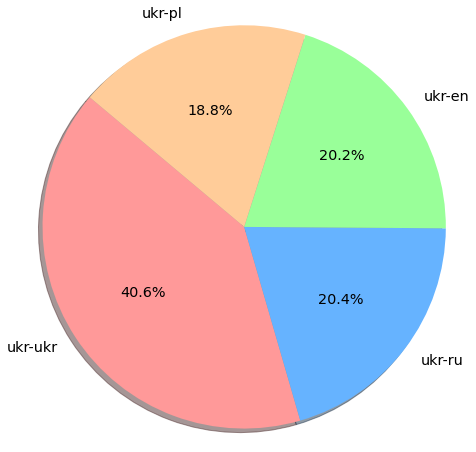

In [332]:
labels = dataset_anonymized["language_of_pair"].value_counts().index
sizes = dataset_anonymized["language_of_pair"].value_counts().values
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
explode = (0, 0, 0, 0)

# Plot
plt.figure(figsize=(8, 8))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140, labeldistance=1.1, wedgeprops = {'linewidth': 1}, textprops={'size':'x-large'})
plt.axis('equal')
plt.show()

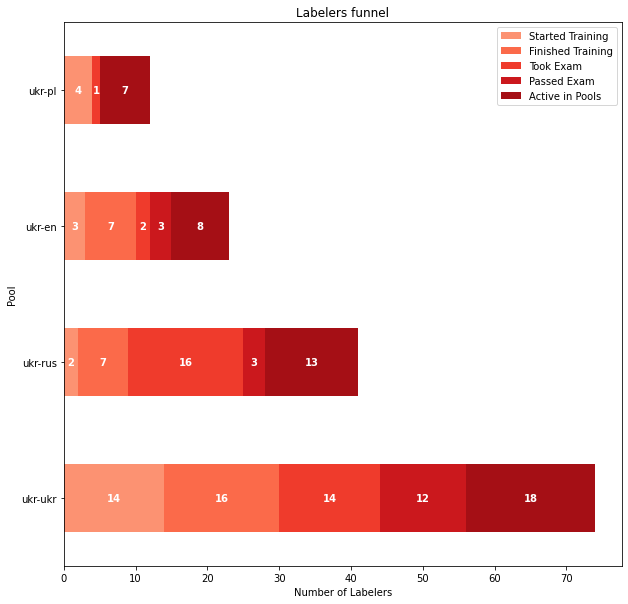

In [353]:
df = pd.DataFrame({
    'Started Training': [74, 41, 23, 12],
    'Finished Training': [60, 39, 20, 8],
    'Took Exam': [44, 32, 13, 8],
    'Passed Exam': [30, 16, 11, 7],
    'Active in Pools': [18, 13, 8, 7]
}, index=['ukr-ukr', 'ukr-rus', 'ukr-en', 'ukr-pl'])

fig, ax = plt.subplots(figsize=(10, 10))

df['Started Training'] -= df['Finished Training']
df['Finished Training'] -= df['Took Exam']
df['Took Exam'] -= df['Passed Exam']
df['Passed Exam'] -= df['Active in Pools']

flame_colors = [
    '#fc9272',  # soft red
    '#fb6a4a',  # medium red
    '#ef3b2c',  # deep red
    '#cb181d',  # darker red
    '#a50f15'   # darkest red
]

df.plot(kind='barh', stacked=True, ax=ax, color=flame_colors)

for row_number, (column, row) in enumerate(df.iterrows()):
    cumulative_size = 0
    for value in row:
        if value:
            cumulative_size += value
            ax.text(cumulative_size - value/2, row_number, f'{value}', ha='center', va='center', color='white', weight='semibold')

ax.set_xlabel('Number of Labelers')
ax.set_ylabel('Pool')

ax.set_title('Labelers funnel')
plt.show()

### Agreement-disagreement

In [20]:
def how_many_agreed(list_for_MV):
    word_counts = Counter(list_for_MV)
    frequency = word_counts.most_common(1)[0][1]
    return frequency

def agreement_label(list_for_MV):
    word_counts = Counter(list_for_MV)
    most_common_word, frequency = word_counts.most_common(1)[0]
    if frequency > 1:
        return most_common_word
    else:
        return 'disagreement'


grouped_1 = dataset.groupby('task_id').agg({
    'who_same': how_many_agreed,
    'where_same': how_many_agreed,
    'when_same': how_many_agreed,
    'what_same': how_many_agreed,
})

grouped_1.rename(columns={'who_same': 'who_agreed',
                        'what_same': 'what_agreed',
                        'when_same': 'when_agreed',
                        'where_same': 'where_agreed',
                       }, inplace=True)

grouped_2 = dataset.groupby('task_id').agg({
    'who_same': agreement_label,
    'where_same': agreement_label,
    'when_same': agreement_label,
    'what_same': agreement_label,
})

grouped_2.rename(columns={'who_same': 'aggregated_who',
                        'what_same': 'aggregated_what',
                        'when_same': 'aggregated_when',
                        'where_same': 'aggregated_where',
                       }, inplace=True)
    

agreement_stats = pd.merge(grouped_1, grouped_2, on='task_id', how='inner').reset_index()

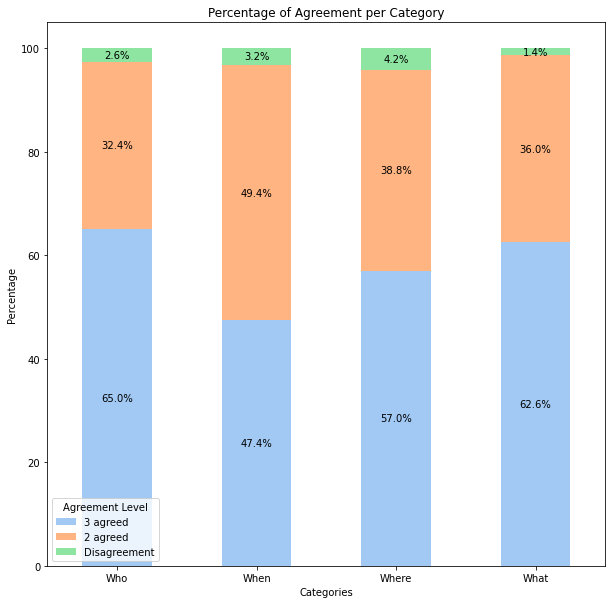

In [25]:
agreement_who = agreement_stats.who_agreed.value_counts() / 5
agreement_when = agreement_stats.when_agreed.value_counts() / 5
agreement_where = agreement_stats.where_agreed.value_counts() / 5
agreement_what = agreement_stats.what_agreed.value_counts() / 5

df = pd.DataFrame({
    'Categories': ['Who', 'When', 'Where', 'What'],
    '3 agreed': [agreement_who[3], agreement_when[3], agreement_where[3], agreement_what[3]],
    '2 agreed': [agreement_who[2], agreement_when[2], agreement_where[2], agreement_what[2]],
    'Disagreement': [agreement_who[1], agreement_when[1], agreement_where[1], agreement_what[1]],
})
df.set_index('Categories', inplace=True)

pastel_colors = [
    '#A1C9F4',
    '#FFB482',
    '#8DE5A1',
    '#FF9F9B',
    '#D0BBFF',
    '#FAB0E4',
]

fig, ax = plt.subplots(figsize=(10, 10))
df.plot(kind='bar', color=pastel_colors[:3], stacked=True, ax=ax)

for rect, label in zip(ax.patches, df.T.values.flatten()):
    height = rect.get_height()
    y = rect.get_y() + height / 2
    x = rect.get_x() + rect.get_width() / 2
    ax.text(x, y, f'{label:.1f}%', ha='center', va='center', color='black')


ax.set_ylabel('Percentage')
ax.set_title('Percentage of Agreement per Category')
ax.legend(title='Agreement Level')

plt.xticks(rotation=0)
plt.show()

In [27]:
news_agr = agreement_stats[(agreement_stats.aggregated_who != 'disagreement') & (agreement_stats.aggregated_when != 'disagreement') & (agreement_stats.aggregated_where != 'disagreement') & ((agreement_stats.aggregated_what != 'disagreement'))].shape[0]
print("News where all labels can be derived from agreement:", news_agr)
print(f'''That's **{news_agr/5}%**''')
      

News where all labels can be derived from agreement: 449
That's **89.8%**


Text(0.5, 1.0, 'What')

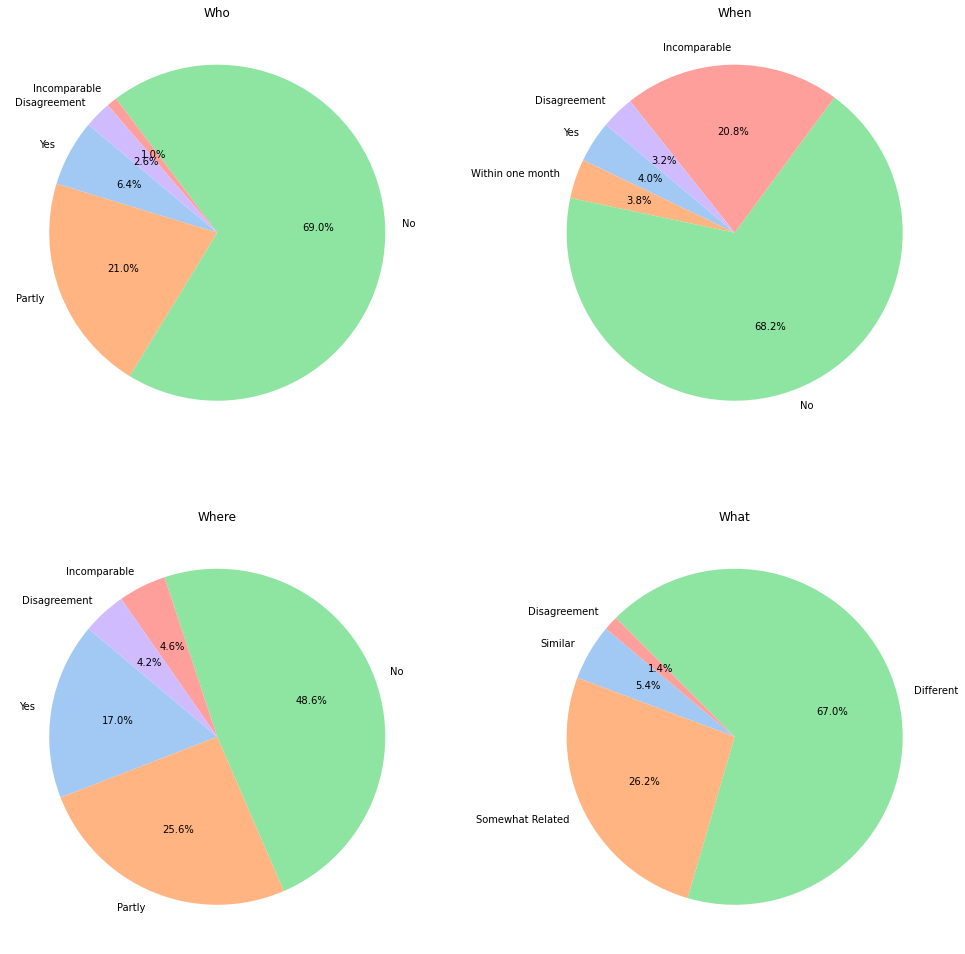

In [53]:
who_agg = agreement_stats.aggregated_who.value_counts() / 5
data_who = [who_agg['yes'], who_agg['partly'], who_agg['no'], who_agg['incomparable'], who_agg['disagreement']]
labels_who = ['Yes', 'Partly', 'No', 'Incomparable', 'Disagreement']

when_agg = agreement_stats.aggregated_when.value_counts() / 5
data_when = [when_agg['yes'], when_agg['partly'], when_agg['no'], when_agg['incomparable'], when_agg['disagreement']]
labels_when = ['Yes', 'Within one month', 'No', 'Incomparable', 'Disagreement']

where_agg = agreement_stats.aggregated_where.value_counts() / 5
data_where = [where_agg['yes'], where_agg['partly'], where_agg['no'], where_agg['incomparable'], where_agg['disagreement']] 
labels_where = ['Yes', 'Partly', 'No', 'Incomparable', 'Disagreement']

what_agg = agreement_stats.aggregated_what.value_counts() / 5
data_what = [what_agg['similar'], what_agg['somewhat_related'], what_agg['different'], what_agg['disagreement']]
labels_what = ['Similar', 'Somewhat Related', 'Different', 'Disagreement']

fig, axs = plt.subplots(2, 2, figsize=(17, 17))

axs[0, 0].pie(data_who, labels=labels_who, autopct='%1.1f%%', colors=pastel_colors, startangle=140)
axs[0, 0].set_title('Who')

axs[0, 1].pie(data_when, labels=labels_when, autopct='%1.1f%%', colors=pastel_colors, startangle=140)
axs[0, 1].set_title('When')

axs[1, 0].pie(data_where, labels=labels_where, autopct='%1.1f%%', colors=pastel_colors, startangle=140)
axs[1, 0].set_title('Where')

axs[1, 1].pie(data_what, labels=labels_what, autopct='%1.1f%%', colors=pastel_colors, startangle=140)
axs[1, 1].set_title('What')

## Words in comments

### Word cloud lemmatized

In [46]:
morph = pymorphy2.MorphAnalyzer(lang='uk')

stop_words = {word:1 for word in get_stop_words('uk')}
counter_wordcloud = defaultdict(int)

personal_stop_words = ('розповідатися', 'надто', 'розповідати', 'випадок', 'варіант', 'ситуація', 'стосуватися', 'йтися', 'новина', 'стаття', 'тема', 'різний', 'подія', 'загальний', 'пов\'язаний', '1', '2', '№', '3', '4', '5', '6', '7', '8', '9', '0', '-', '«', '»', 'й', 'свій', '2022', '2021', '2019', '2020-го', '1930-х', '2020', 'із', 'оскільки', 'даний', 'проте', 'ніяк', '2023', '2024', 'обоє', 'р', '-19', '.', '--', '–', ',', ':', ';', '?', '!', '"', 'а', 'щодо', 'перший', 'другий', 'обидва', '(', ')', 'один')
for row in dataset.what_comment_translated:
    for word in tokenize_uk.tokenize_words(row):
        word = word.lower()
        if word not in stop_words and word not in personal_stop_words:
            lemma = morph.parse(word)[0].normal_form
            if lemma not in stop_words and lemma not in personal_stop_words:
                counter_wordcloud[lemma] += 1

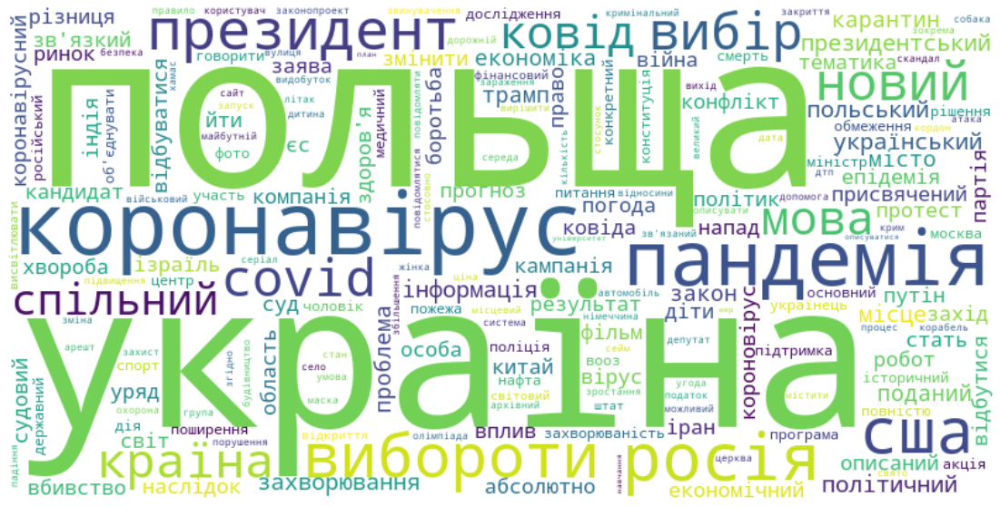

In [47]:
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(counter_wordcloud)
plt.figure(figsize=(20, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [48]:
def counter_of_words(what_comment):
    stop_symbols = ('1', '2', '№', '3', '4', '5', '6', '7', '8', '9', '0', '-', '«', '»', '.', '--', '–', ',', ':', ';', '?', '!', '"', '(', ')', '&', '+')
    words = 0
    for word in tokenize_uk.tokenize_words(what_comment):
        if word not in stop_symbols:
            words += 1
    return words

dataset["comment_length"] = dataset.what_comment_translated.apply(counter_of_words)

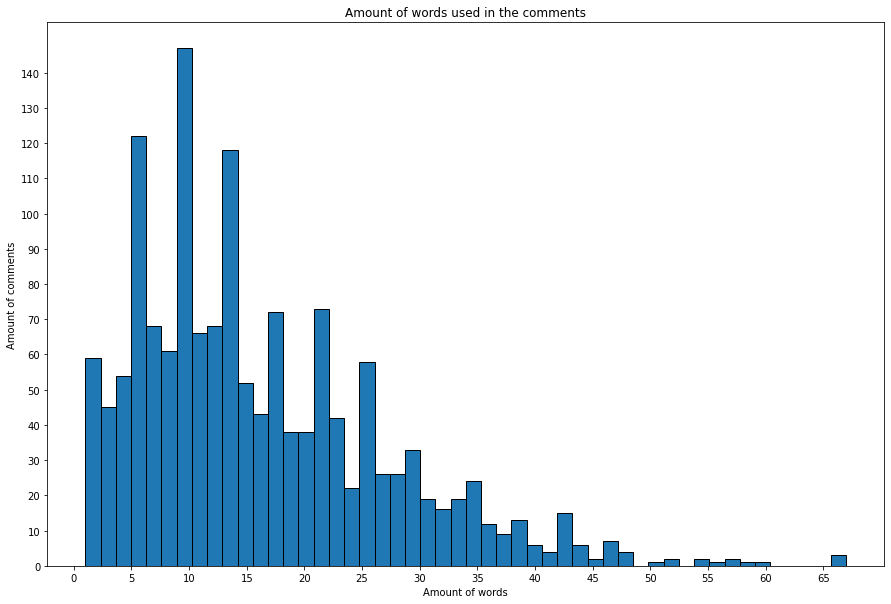

In [58]:
dataset["comment_length"].plot(kind='hist', bins=50, edgecolor='black', title='Amount of words used in the comments', figsize=(15, 10))
plt.xlabel('Amount of words')
plt.xticks(ticks=range(0, 70, 5)) 
plt.yticks(ticks=range(0, 145, 10)) 
plt.ylabel('Amount of comments')
plt.show()

### LLM False Positives level check
- Sample 50 comments which were accepted

In [100]:
dataset[dataset.comment_is_good == True].sample(n=50)[["what_same", "what_comment", "what_comment_translated"]].to_excel('check_llm_false_positives.xlsx')

In [93]:
checked_llm_false_positives = pd.read_excel('check_llm_false_positives.xlsx', index_col=0)
print("Accuracy:", checked_llm_false_positives[checked_llm_false_positives["actually_good"] == 'yes'].shape[0] / checked_llm_false_positives.shape[0])

Accuracy: 0.96


# Becnhmarks

In [16]:
headers = {'Content-type': 'application/json', "Authorization": (f"Bearer " + hf_key)}

def query_hugging_face(prompt, 
                       author, 
                       model,
                       parameters={}):
    options = {'use_cache': False, 'wait_for_model': True}
    payload = {'inputs': prompt,
               'parameters': parameters,
               'options': options}
    data = json.dumps(payload)
    response = requests.request("POST",
                                "https://api-inference.huggingface.co/models/" + author + "/" + model,
                                headers=headers,
                                data=data)
    try:
        print(json.loads(response.content.decode("utf-8")))
        return json.loads(response.content.decode("utf-8"))
    except Exception as e:
        print(response.content.decode("utf-8"))
    return 'Model error'

In [5]:
def compute_embeddings_encoder(texts, tokenizer, model, batch_size=5):
    embeddings_list = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i + batch_size]
        inputs = tokenizer(batch_texts, return_tensors="pt", padding=True)
        print("Tokenized batch", i//batch_size + 1)
        with torch.no_grad():
            encoder_outputs = model.encoder(input_ids=inputs.input_ids, attention_mask=inputs.attention_mask)
        print("Embedded batch", i//batch_size + 1)
        hidden_states = encoder_outputs.last_hidden_state
        embeddings = torch.sum(hidden_states * inputs.attention_mask.unsqueeze(-1), dim=1) / torch.sum(inputs.attention_mask.unsqueeze(-1), dim=1)
        embeddings_list.append(embeddings.cpu().numpy())
        del inputs
        del encoder_outputs
        del hidden_states
        gc.collect()
    all_embeddings = np.vstack(embeddings_list)
    return all_embeddings

def compute_embeddings(texts, tokenizer, model, model_name, batch_size=5):
    embeddings_list = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i + batch_size]
        inputs = tokenizer(batch_texts, return_tensors="pt", truncation=True, padding=True)
        print("Tokenized batch", i//batch_size + 1)
        with torch.no_grad():
            if model_name == "xml":
                outputs = model(**inputs, output_hidden_states=True)
            else:
                outputs = model(**inputs)
        print("Embedded batch", i//batch_size + 1)
        if model_name == "xml":
            hidden_states = outputs.hidden_states[0]
        else:
            hidden_states = outputs.last_hidden_state
        embeddings = torch.sum(hidden_states * inputs.attention_mask.unsqueeze(-1), dim=1) / torch.sum(inputs.attention_mask.unsqueeze(-1), dim=1)
        embeddings_list.append(embeddings.cpu().numpy())
        del inputs
        del outputs
        del hidden_states
        gc.collect()
    all_embeddings = np.vstack(embeddings_list)
    return all_embeddings

## Embeddings

### Splitting

In [316]:
def split(row, lang='uk'):
    if lang == 'uk':
        pattern = re.compile(r'ХТО:\s*(.*?)(?=КОЛИ:|$)КОЛИ:\s*(.*?)(?=ДЕ:|$)ДЕ:\s*(.*?)(?=ЩО:|$)ЩО:\s*(.*)', re.DOTALL | re.IGNORECASE)
    elif lang == 'ru':
        pattern = re.compile(r'КТО:\s*(.*?)(?=КОГДА:|$)КОГДА:\s*(.*?)(?=ГДЕ:|$)ГДЕ:\s*(.*?)(?=ЧТО:|$)ЧТО:\s*(.*)', re.DOTALL | re.IGNORECASE)
    elif lang == 'en':
        pattern = re.compile(r'WHO:\s*(.*?)(?=WHEN:|$)WHEN:\s*(.*?)(?=WHERE:|$)WHERE:\s*(.*?)(?=WHAT:|$)WHAT:\s*(.*)', re.DOTALL | re.IGNORECASE)
    elif lang == 'pl':
        pattern = re.compile(r'KTO:\s*(.*?)(?=KIEDY:|$)KIEDY:\s*(.*?)(?=GDZIE:|$)GDZIE:\s*(.*?)(?=CO:|$)CO:\s*(.*)', re.DOTALL | re.IGNORECASE)
    matches = pattern.search(row)
    try:
        return [matches.group(1).strip(), matches.group(2).strip(), matches.group(3).strip(), matches.group(4).strip()]
    except Exception as e:
        print(row)
    return ["", "", "", ""]

dataset_anonymized[["who_1", "when_1", "where_1", "what_1"]] = pd.DataFrame(dataset_anonymized.apply(lambda row: split(row.summ_with_documents_text1, row.url1_lang), axis=1).tolist(), columns=["who", "when", "where", "what"])
dataset_anonymized[["who_2", "when_2", "where_2", "what_2"]] = pd.DataFrame(dataset_anonymized.apply(lambda row: split(row.summ_with_documents_text2, row.url2_lang), axis=1).tolist(), columns=["who", "when", "where", "what"])

### e5
- https://huggingface.co/intfloat/multilingual-e5-large?text=hi
- 1024 embedding size

In [38]:
dataset_anonymized["who_1_e5"] = dataset_anonymized["who_1"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["who_2_e5"] = dataset_anonymized["who_2"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["when_1_e5"] = dataset_anonymized["when_1"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["when_2_e5"] = dataset_anonymized["when_2"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["where_1_e5"] = dataset_anonymized["where_1"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["where_2_e5"] = dataset_anonymized["where_2"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["what_1_e5"] = dataset_anonymized["what_1"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))
dataset_anonymized["what_2_e5"] = dataset_anonymized["what_2"].apply(lambda x: query_hugging_face("query: " + x, "intfloat", "multilingual-e5-large"))

[0.0125278877094388, -0.002097773365676403, -0.048244405537843704, -0.031201856210827827, 0.03008708916604519, -0.022635161876678467, -0.017369994893670082, 0.10926885157823563, 0.0720880851149559, -0.03248581290245056, 0.05727909505367279, 0.03484407439827919, -0.03521328046917915, -0.033660296350717545, -0.0006780656985938549, -0.030946390703320503, -0.03323868289589882, 0.02289195917546749, -0.0245607178658247, -0.01194352749735117, 0.04264020547270775, 0.009553356096148491, -0.058637943118810654, -0.020093457773327827, -0.033987704664468765, -0.04061977565288544, -0.006534276530146599, -0.024818751960992813, -0.027270037680864334, -0.046366170048713684, -0.020425694063305855, 0.0047812871634960175, -0.044494472444057465, -0.02146989479660988, 0.010167821310460567, 0.025107456371188164, 0.04865666851401329, 0.045771919190883636, -0.03018072247505188, 0.024885639548301697, -0.01274084858596325, 0.08554277569055557, -0.016134295612573624, -0.024314550682902336, 0.00620570732280612, -0

[0.006544826552271843, -0.025099877268075943, -0.02385333552956581, -0.036457184702157974, 0.005448664538562298, -0.004069490823894739, -0.021262692287564278, 0.0738871842622757, 0.05401305481791496, -0.013424593023955822, 0.030511099845170975, 0.0378265380859375, -0.05511700361967087, -0.05060185492038727, -0.05537230893969536, -0.05199536681175232, -0.002545800292864442, 0.018113309517502785, 0.0205549243837595, -0.03990091383457184, 0.021289898082613945, -0.02329231984913349, -0.05228898674249649, -0.034723471850156784, -0.031203828752040863, -0.005899540148675442, -0.03616752475500107, -0.013789338991045952, -0.020380007103085518, -0.026168977841734886, 0.005534319207072258, 0.015681741759181023, -0.02630545385181904, -0.027431275695562363, -0.04059223830699921, -0.0043397871777415276, 0.018185947090387344, 0.051662057638168335, -0.0470467135310173, -0.011783662252128124, -0.01574009284377098, 0.06186476722359657, -0.01576489396393299, -0.037688545882701874, -0.033086925745010376, 

[0.0434960201382637, -0.01164691150188446, -0.03766036778688431, -0.027286047115921974, 0.04338303953409195, 0.005649948958307505, -0.037665270268917084, 0.07234789431095123, 0.0462636761367321, -0.012403355911374092, 0.03731155022978783, 0.017043940722942352, -0.04673583805561066, -0.021917354315519333, -0.015809282660484314, -0.03487616032361984, -0.005689612124115229, 0.023991215974092484, -0.006372228730469942, -0.007501519750803709, 0.04718267545104027, 0.00133093714248389, -0.05451326444745064, -0.027475809678435326, -0.028946395963430405, -0.0193980410695076, -0.052649568766355515, -0.031325750052928925, -0.0340404249727726, -0.03356505557894707, -0.024251988157629967, 0.017038937658071518, -0.023629773408174515, -0.05284973978996277, 0.0059456732124090195, 0.03879384323954582, 0.04509497061371803, 0.032173726707696915, -0.038296982645988464, 0.018448421731591225, 0.0008473805501125753, 0.08808235824108124, -0.017876334488391876, -0.02621341310441494, -0.04494393244385719, 0.009

[0.0339764766395092, 0.001869761967100203, -0.032144829630851746, -0.02974778413772583, 0.04634490981698036, -0.03024275414645672, 0.004405910614877939, 0.060322605073451996, 0.05621770769357681, -0.017396675422787666, 0.02998480573296547, 0.0038544952403753996, -0.04312678426504135, -0.0024966683704406023, -0.045027829706668854, -0.009634051471948624, -0.01541240606456995, 0.03157806396484375, -0.00399320712313056, -0.0028208859730511904, 0.01959899440407753, -0.002657473785802722, -0.03212088346481323, -0.015768539160490036, -0.03302992135286331, 0.0011385998222976923, -0.028551412746310234, -0.009750145487487316, -0.035253819078207016, -0.04042622819542885, -0.011967834085226059, -0.0010902193607762456, -0.010831453837454319, 0.012559817172586918, -0.002631258452311158, 0.03701644390821457, 0.0489196702837944, -0.0012605919037014246, -0.04550458490848541, 0.025468384847044945, -0.002791299484670162, 0.04048765078186989, -0.017514364793896675, -0.0607738234102726, -0.0188178922981023

[0.012167172506451607, -0.015712345018982887, 3.507488509058021e-05, -0.003503803862258792, 0.025417586788535118, -0.03124954365193844, -0.01835140399634838, 0.08790750056505203, 0.02552647516131401, -0.025347447022795677, 0.04359316825866699, 0.0029194967355579138, -0.02000308968126774, -0.03977253660559654, -0.032097864896059036, -0.03681201487779617, 0.017764491960406303, 0.027419188991189003, -0.009990342892706394, -0.001483777305111289, 0.0390375591814518, -0.015446805395185947, 0.0010306586045771837, -0.03331834450364113, -0.037210654467344284, -0.029991745948791504, -0.02601742185652256, -0.031300947070121765, -0.01700221188366413, -0.04215399548411369, -0.03604624420404434, 0.01870953105390072, 0.025210514664649963, -0.014751216396689415, -0.04319030046463013, 0.025189725682139397, 0.04231322556734085, 0.009026525542140007, -0.04390258342027664, 0.03002842701971531, -0.03182940557599068, 0.06729350984096527, -0.03473041206598282, -0.047628022730350494, 0.008165314793586731, 0.0

[0.01743612065911293, -0.010356604121625423, -0.0029578760731965303, -0.01868688501417637, 0.04122127592563629, -0.031614240258932114, -0.013087953440845013, 0.05752748250961304, 0.004752438049763441, -0.041741661727428436, 0.023193109780550003, 0.025696100667119026, -0.0598331019282341, -0.01529728714376688, -0.04153174161911011, -0.02318376675248146, -0.006163019221276045, 0.04731881245970726, -0.009674976579844952, 0.014701899141073227, 0.05109236761927605, -0.014833472669124603, -0.023827867582440376, -0.03575017303228378, -0.0546482652425766, -0.016303326934576035, -0.014414886012673378, -0.021983718499541283, -0.011148039251565933, -0.03810296207666397, -0.04200458154082298, 0.0034862952306866646, -0.022110657766461372, 0.009611006826162338, 0.01210966520011425, 0.03724422678351402, 0.006799417547881603, 0.019550105556845665, -0.03225143626332283, 0.013762997463345528, 0.004141086246818304, 0.04897378385066986, -0.04072676971554756, -0.03916013613343239, -0.030595453456044197, 0.

[0.007982825860381126, -0.0005593241658061743, -0.020567813888192177, -0.025637561455368996, 0.018334900960326195, -0.011085315607488155, -0.01114953588694334, 0.04595833271741867, 0.037298962473869324, -0.019812118262052536, 0.03814057633280754, 0.010284354910254478, -0.040946684777736664, -0.029870139434933662, -0.022077640518546104, -0.021301014348864555, -0.018514374271035194, 0.019111812114715576, -0.007686085067689419, -0.004801786504685879, 0.061489153653383255, -0.006748993415385485, -0.047529034316539764, -0.03142085671424866, -0.017897458747029305, -0.04677189141511917, -0.0254493560642004, -0.04118750989437103, -0.0019438519375398755, -0.027885597199201584, -0.013178122229874134, 0.0028651899192482233, -0.005196983460336924, -0.03397365286946297, 0.013449852354824543, 0.0014439988881349564, 0.01804552599787712, 0.032562412321567535, -0.039896491914987564, 0.01761746220290661, -0.01898031122982502, 0.041150618344545364, -0.03447685390710831, -0.03743921220302582, -0.032092355

[0.02306843362748623, 0.0038911772426217794, -0.01696902886033058, -0.023656737059354782, 0.040829531848430634, -0.008446109481155872, -0.019131766632199287, 0.04831156134605408, 0.06918352097272873, -0.0063885473646223545, 0.04150957241654396, 0.02756071835756302, -0.01525239646434784, -0.029523193836212158, -0.03159056231379509, -0.04431299865245819, -0.013777502812445164, 0.033468056470155716, -0.022556645795702934, -0.009794075042009354, 0.04499218985438347, -0.005728758871555328, -0.03069295734167099, -0.05078041926026344, -0.01477318536490202, -0.03365156054496765, -0.015013495460152626, -0.012060439214110374, -0.04633944481611252, -0.04468242824077606, -0.018790822476148605, 0.03798871859908104, -0.023342402651906013, -0.019217470660805702, -0.023121172562241554, 0.05899763107299805, 0.04403955489397049, 0.0299452506005764, -0.03985057398676872, 0.017734456807374954, 0.011757900007069111, 0.04648163914680481, -0.010509847663342953, -0.06257995218038559, -0.0338783897459507, 0.00

[0.012379270978271961, 0.0016775428084656596, -0.018171992152929306, -0.051476020365953445, 0.01502944529056549, -0.041455525904893875, -0.016749678179621696, 0.061530742794275284, 0.037593185901641846, -0.044142864644527435, 0.018496865406632423, 0.017123764380812645, -0.05758211389183998, -0.013429035432636738, -0.03743347153067589, -0.03313623368740082, -0.03598560392856598, 0.01642931066453457, -0.020252646878361702, -0.01637398451566696, 0.03604545071721077, -0.021063100546598434, -0.028808534145355225, -0.04186258837580681, -0.038643840700387955, -0.01147189736366272, -0.04914119467139244, -0.02519424445927143, 0.0007323299651034176, -0.044559866189956665, -0.03672369569540024, 0.010330736637115479, -0.030362438410520554, -0.026327718049287796, -2.9680533771170303e-05, 0.008890443481504917, 0.027452614158391953, 0.036083851009607315, -0.05029793083667755, -0.009850284084677696, 0.005855826660990715, 0.05806621536612511, 0.0012213746085762978, -0.021906090900301933, -0.03172514960

[0.001527113956399262, -0.011852092109620571, -0.007603502366691828, -0.04045015946030617, 0.036417800933122635, 0.008088971488177776, -0.03135661035776138, 0.04565327987074852, 0.0689014121890068, -0.031852688640356064, 0.039753250777721405, -0.004112499766051769, -0.030809083953499794, -0.024761617183685303, -0.035410646349191666, -0.034794263541698456, -0.00350150465965271, 0.004844674840569496, -0.00019197100482415408, -0.006278518121689558, 0.045145921409130096, 0.004973697941750288, -0.04628347232937813, -0.013788260519504547, -0.025612954050302505, 0.0027530090883374214, -0.020380603149533272, -0.011779909953474998, -0.02029060572385788, -0.032618679106235504, -0.03231074661016464, 0.030852563679218292, -0.033074233680963516, -0.02947271056473255, -0.023318111896514893, 0.033241093158721924, 0.03977954015135765, 0.0035925607662647963, -0.043852150440216064, 0.021030157804489136, 0.006730248220264912, 0.046912338584661484, -0.0214359313249588, -0.03569775074720383, -0.03954594582

[0.006457699928432703, 0.010655060410499573, -0.026390675455331802, -0.0022306793835014105, -0.0011271171970292926, -0.011825837194919586, -0.015785790979862213, 0.06738433241844177, 0.0711599811911583, -0.036341968923807144, 0.023473577573895454, 0.03668326511979103, -0.04159007966518402, -0.010415883734822273, -0.03367001190781593, -0.023327186703681946, -0.03489582613110542, 0.004167963284999132, -0.017184359952807426, -0.01395708229392767, 0.06183815747499466, 0.005785710643976927, -0.050149694085121155, -0.034310564398765564, -0.039028462022542953, 0.005624169949442148, -0.024997476488351822, -0.03794926404953003, -0.02313375473022461, -0.019664105027914047, -0.0171580258756876, -0.010807597078382969, -0.03058517910540104, -0.007111981511116028, 0.0010828429367393255, 0.03242886811494827, 0.0006325752474367619, 0.019054699689149857, -0.04555891454219818, 0.007151356898248196, 0.007107955403625965, 0.045867569744586945, -0.01800067536532879, -0.0496760755777359, -0.0169690456241369

[0.002490872284397483, -0.012579679489135742, -0.011225407011806965, -0.024273086339235306, 0.016001204028725624, -0.040829598903656006, -0.02411571890115738, 0.06423217803239822, 0.0511796772480011, -0.02998928725719452, 0.04979177564382553, 0.019839387387037277, -0.02788916975259781, -0.02160649374127388, -0.03870900720357895, -0.0124823534861207, 0.03689783439040184, 0.04565438628196716, 0.023635134100914, -0.034916624426841736, 0.02203291654586792, -0.018475601449608803, -0.030260974541306496, -0.025175321847200394, -0.06110060587525368, -0.019839420914649963, -0.01499168947339058, -0.0387641042470932, -0.019786855205893517, -0.057999387383461, -0.0033544336911290884, 0.012078478932380676, -0.01803298108279705, -0.014362036250531673, -0.030943308025598526, -0.0003666113188955933, 0.05031882971525192, 0.02901778370141983, -0.04185091331601143, 0.0017028732690960169, -0.03424122557044029, 0.07221373170614243, -0.012070746161043644, -0.04569341242313385, -0.02365759387612343, 0.037908

[0.024191992357373238, -0.012426205910742283, -0.019700201228260994, -0.053047165274620056, 0.019495049491524696, -0.04493342339992523, -0.001882452517747879, 0.04031357169151306, 0.02837153896689415, -0.01344300713390112, 0.03686324506998062, 0.020674163475632668, -0.05528097599744797, -0.002518529538065195, -0.013186795637011528, -0.004647065419703722, -0.005511727649718523, 0.034047968685626984, -0.00036971369991078973, -0.025995010510087013, -0.008553271181881428, -0.016485825181007385, -0.0645701065659523, -0.03032650798559189, -0.03346360847353935, -0.028721528127789497, -0.00496931467205286, -0.0161161907017231, -0.018805822357535362, -0.05863850563764572, -0.042766693979501724, 0.01033532153815031, -0.018822981044650078, -0.0165964737534523, -0.030908839777112007, 0.022385694086551666, 0.05166791379451752, 0.01882733218371868, -0.0442979671061039, 0.01059744693338871, -0.02126769907772541, 0.03384656831622124, -0.03981553018093109, -0.050985947251319885, -0.019857274368405342, 

[0.03382064029574394, -0.022399529814720154, -0.013105887919664383, -0.03655318543314934, 0.03842136636376381, -0.036568112671375275, -0.014871337451040745, 0.050148215144872665, 0.055939532816410065, -0.0196719728410244, 0.06838478893041611, -0.007424309384077787, -0.05396980419754982, -0.015118064358830452, -0.0357854850590229, -0.0053173392079770565, -0.008190382272005081, -0.0013045434607192874, -0.004348094575107098, -0.010153830982744694, 0.02750566229224205, -0.019764140248298645, -0.02446524053812027, -0.048995502293109894, -0.019510449841618538, -0.030174506828188896, -0.034745123237371445, -0.0375247448682785, -0.0063761156052351, -0.05339507758617401, -0.037649814039468765, 0.027261311188340187, -0.03554181009531021, 0.004414029885083437, 0.008084750734269619, 0.007872049696743488, 0.03877663239836693, 0.02927730605006218, -0.05061783269047737, 0.026471838355064392, -0.01068644318729639, 0.030823947861790657, -0.0038140430115163326, -0.02432641014456749, -0.02676340192556381

[0.013791155070066452, 0.0003039503062609583, -0.004202158655971289, -0.03940628096461296, 0.015857189893722534, -0.04576775059103966, -0.005239834543317556, 0.028668392449617386, 0.005668936297297478, 0.005468966439366341, 0.034731119871139526, 0.04066053032875061, -0.04663057252764702, -0.013268779963254929, -0.03389004245400429, -0.023141874000430107, -0.01790407858788967, 0.02095935121178627, -0.009131603874266148, -0.019546665251255035, 0.04909353330731392, -0.02225458435714245, -0.0391094908118248, -0.039967771619558334, -0.015409491956233978, -0.02979000099003315, -0.021677445620298386, -0.04608170688152313, 0.006262353155761957, -0.040980368852615356, -0.02311507612466812, 0.020748620852828026, -0.04561816155910492, -0.022980747744441032, -0.04949945583939552, 0.009022297337651253, 0.02412477508187294, 0.042143162339925766, -0.03986424580216408, 0.006851969752460718, -0.022194858640432358, 0.060815129429101944, -0.026049476116895676, -0.03162548691034317, -0.025249825790524483,

[0.021000804379582405, 0.015348282642662525, -0.029307516291737556, -0.04259369894862175, 0.022424209862947464, -0.013888707384467125, -0.017283575609326363, 0.07170624285936356, 0.04141097143292427, 0.010229635052382946, 0.03798934817314148, 0.04558730125427246, -0.027816083282232285, -0.02905081957578659, -0.038346387445926666, -0.04853492230176926, 0.01973618008196354, 0.01463255099952221, -0.003237991128116846, -0.008653920143842697, 0.038273271173238754, -0.0008610744262114167, -0.008034160360693932, 0.007348258048295975, -0.033541642129421234, -0.019564487040042877, -0.03799498453736305, -0.023605365306138992, 0.009116250090301037, -0.02397756278514862, -0.009854107163846493, 0.008959071710705757, -0.025746047496795654, -0.021014533936977386, -0.013712638057768345, -0.004156890790909529, 0.029829973354935646, 0.01943831704556942, -0.03750281780958176, -0.004463051911443472, -0.020569859072566032, 0.06188759580254555, -0.015321718528866768, -0.027073705568909645, -0.00413490226492

[0.019752902910113335, 0.028112001717090607, -0.026167260482907295, -0.01107145007699728, 0.03692086413502693, -0.012042329646646976, -0.006073297467082739, 0.04611532762646675, 0.07070742547512054, -0.023299744352698326, 0.04889858514070511, 0.005366033408790827, -0.017585236579179764, 0.004649254493415356, -0.030261028558015823, -0.018007511273026466, -0.029096662998199463, 0.0005542493308894336, -0.002623454201966524, -0.0017871842719614506, 0.03933641314506531, 0.010233613662421703, -0.04207749664783478, -0.05340750887989998, -0.023252474144101143, -0.021179765462875366, -0.02585476078093052, -0.02259831130504608, -0.019875019788742065, -0.032434914261102676, -0.021091779693961143, 0.012990269809961319, -0.008426888845860958, -0.009677386842668056, -0.006303376983851194, 0.026485441252589226, 0.027165371924638748, 0.043848130851984024, -0.039143674075603485, -0.0015666186809539795, 0.0039486996829509735, 0.04630186781287193, -0.009746016003191471, -0.03748738765716553, -0.024813104

[0.02486417256295681, 0.00923625472933054, -0.012257388792932034, -0.028431983664631844, 0.040501486510038376, -0.028610441833734512, -0.021926168352365494, 0.06293042004108429, 0.011390027590095997, -0.043043844401836395, 0.03325635567307472, 0.014668009243905544, -0.045379020273685455, -0.005849520675837994, -0.041214946657419205, -0.024131448939442635, 0.002478074748069048, 0.039950497448444366, -0.019737230613827705, 0.0027997519355267286, 0.05089034512639046, -0.014327791519463062, -0.03437419980764389, -0.037456076592206955, -0.05424932762980461, -0.018382402136921883, -0.022323202341794968, -0.031365398317575455, -0.0039129843935370445, -0.031278517097234726, -0.041798681020736694, 0.007603680714964867, -0.01357828825712204, 0.013761006295681, 0.014486849308013916, 0.03791351616382599, 0.01112565491348505, 0.027052458375692368, -0.03926666080951691, 0.016127631068229675, 0.00585425179451704, 0.05388806015253067, -0.033627960830926895, -0.050453100353479385, -0.031606048345565796

[0.045778483152389526, 0.009065994992852211, -0.026508241891860962, -0.030483394861221313, 0.03404834866523743, -0.04065519943833351, -0.0036151502281427383, 0.06469424068927765, 0.04958352819085121, -0.03457706421613693, 0.04645325243473053, 0.018633348867297173, -0.03205270320177078, -0.016008365899324417, -0.03156853839755058, -0.004399850498884916, -0.0002718631876632571, 0.03890833631157875, -0.008883771486580372, -0.010197940282523632, 0.02496585063636303, 0.0032552697230130434, -0.052513957023620605, -0.0077054258435964584, -0.013209308497607708, -0.017159977927803993, -0.019858552142977715, -0.030912533402442932, -0.007591185159981251, -0.046672895550727844, -0.016254939138889313, 0.01895720325410366, -0.04039612412452698, -0.027831777930259705, -0.009455673396587372, 0.021006612107157707, 0.03381979465484619, 0.018699856474995613, -0.039131537079811096, 0.05250664800405502, 0.008769979700446129, 0.0582008995115757, -0.040921133011579514, -0.045322902500629425, -0.0105431945994

[0.0301679577678442, 0.006804400589317083, 0.0002253127604490146, -0.034006986767053604, 0.03337642550468445, -0.02559433877468109, -0.029532065615057945, 0.07455451041460037, 0.06486601382493973, 0.004233549814671278, -0.002201193943619728, 0.03244352713227272, -0.05461571365594864, -0.023770347237586975, -0.03655565530061722, -0.008060982450842857, -0.007172881625592709, 0.029760116711258888, 0.015343664214015007, -0.009324412792921066, 0.05432426929473877, -0.0073300814256072044, -0.02742922492325306, -0.02529197745025158, -0.009472951292991638, -0.047896645963191986, -0.025667721405625343, -0.04215190187096596, -0.035017091780900955, -0.019211607053875923, -0.0249235350638628, 0.019267261028289795, -0.04324625805020332, -0.01942124217748642, 0.013390186242759228, 0.03512686863541603, 0.028838925063610077, 0.02164105884730816, -0.04508047550916672, 0.010823795571923256, -0.030559508129954338, 0.036959778517484665, -0.009509962052106857, -0.0328390970826149, -0.034799762070178986, 0.

[0.008433572947978973, -0.015896044671535492, 0.0071264938451349735, -0.014690585434436798, 0.03373182564973831, -0.02113446034491062, -0.019253097474575043, 0.031570322811603546, 0.020936371758580208, -0.03446222096681595, 0.03891046345233917, 0.00903595145791769, -0.036583613604307175, 0.0017296822043135762, -0.053470391780138016, -0.03785623610019684, -0.007358573377132416, 0.043403010815382004, -0.013220320455729961, -0.004294785670936108, 0.0505191907286644, -0.009380269795656204, -0.0353718139231205, -0.06271395087242126, -0.03263598680496216, -0.020984264090657234, -0.040387481451034546, -0.020147301256656647, -0.024670200422406197, -0.03264490142464638, -0.04148518294095993, -0.004761842079460621, -0.018039289861917496, 0.010077684186398983, 0.004091160371899605, 0.05248098820447922, 0.019390109926462173, 0.026050470769405365, -0.03152291104197502, 0.03402489423751831, 0.012327457778155804, 0.048242516815662384, -0.040645331144332886, -0.0503208264708519, -0.04949155077338219, 

[0.0044283452443778515, -0.012259886600077152, -0.006110253278166056, -0.015692221000790596, 0.029471999034285545, -0.023633452132344246, -0.0014214153634384274, 0.047497790306806564, 0.021676916629076004, -0.04769859090447426, 0.033824287354946136, 0.013497592881321907, -0.036354873329401016, 0.012153591960668564, -0.04818350449204445, -0.030950495973229408, -0.013667960651218891, 0.027310367673635483, -0.012197206728160381, -0.008370162919163704, 0.06070452556014061, -0.018384773284196854, -0.03211888298392296, -0.05441888049244881, -0.03775085136294365, -0.014018082059919834, -0.037185344845056534, -0.027145041152834892, -0.031008996069431305, -0.024727968499064445, -0.028675859794020653, -0.004942113999277353, -0.021515026688575745, 0.012000925838947296, 0.017757093533873558, 0.05232250690460205, 0.013859746046364307, 0.032094959169626236, -0.03908783569931984, 0.0225762240588665, 0.0011594947427511215, 0.05375558137893677, -0.04578041285276413, -0.04885198175907135, -0.03165025264

[0.0056477924808859825, 0.008235972374677658, -0.006018315441906452, -0.004955274984240532, 0.036493077874183655, -0.015502694062888622, -0.019457394257187843, 0.051687758415937424, 0.030163535848259926, -0.020762765780091286, 0.04257895052433014, 0.03945150598883629, -0.024735892191529274, -0.021826395764946938, -0.017191605642437935, -0.0458766333758831, -0.012229894287884235, 0.023612607270479202, -0.01998886652290821, 0.00816251803189516, 0.05882745981216431, 0.004532127641141415, -0.04637233540415764, -0.019629275426268578, -0.023631414398550987, -0.028302423655986786, -0.05351074039936066, -0.030899273231625557, -0.03000069595873356, -0.041672177612781525, -0.014465020038187504, 0.0002571149670984596, -0.02589714154601097, -0.02096099592745304, -0.004672402981668711, 0.01525907777249813, 0.03890300542116165, 0.030806608498096466, -0.04297884181141853, 0.00018983313930220902, -0.03560302406549454, 0.05139359459280968, -0.02092292159795761, -0.03804333135485649, -0.0357152037322521

[0.021463431417942047, -0.014480366371572018, -0.002554518636316061, -0.05248585715889931, 0.05270610749721527, -0.025438690558075905, -0.012910476885735989, 0.07099266350269318, 0.03745138645172119, -0.035775888711214066, 0.05562629923224449, 0.01830451935529709, -0.03268025070428848, -0.04193415120244026, -0.03148815408349037, -0.016134077683091164, -0.0013815356651321054, 0.0371885746717453, -0.010469848290085793, -0.01264074258506298, 0.034672848880290985, 0.007033823058009148, -0.06082651764154434, -0.04648410528898239, -0.01897517405450344, -0.02064109966158867, -0.027698732912540436, -0.02234913781285286, -0.008902780711650848, -0.03037044033408165, -0.015476844273507595, 0.03965430334210396, -0.031138287857174873, -0.025119177997112274, 0.029101070016622543, 0.00118067127186805, 0.012392698787152767, 0.021390307694673538, -0.048027943819761276, 0.021339908242225647, -0.03429962694644928, 0.05030864104628563, -0.019398273900151253, -0.02956193871796131, -0.0002252924459753558, 0

[0.018164383247494698, -0.006793143227696419, -0.0017600259743630886, -0.021358316764235497, 0.03663434088230133, -0.013418606482446194, -0.02799738571047783, 0.04375128075480461, 0.036090120673179626, -0.010206528007984161, 0.043466128408908844, -0.0009194394224323332, -0.04964852333068848, -0.02482864074409008, -0.045388128608465195, -0.013674595393240452, -0.008760242722928524, 0.0236672256141901, 8.216515561798587e-05, -0.02494371496140957, 0.044069766998291016, -0.0059679485857486725, -0.04333179071545601, -0.016419194638729095, 0.0075373868457973, -0.0226584579795599, -0.04753490164875984, -0.021752890199422836, -0.028152886778116226, -0.02793245203793049, -0.008805254474282265, 0.0008603054448030889, -0.018383078277111053, -0.013094834983348846, -0.00036336970515549183, 0.0005689225508831441, 0.015880625694990158, 0.017302516847848892, -0.05283019691705704, 0.023831579834222794, -0.006530547980219126, 0.09146090596914291, -0.025238938629627228, -0.05270517244935036, -0.036487996

[0.006236618384718895, 0.008157188072800636, -0.010853320360183716, -0.011311409994959831, 0.01988871395587921, -0.04595563933253288, -0.026347123086452484, 0.0838913843035698, 0.046531617641448975, -0.014104134403169155, 0.06577202677726746, 0.03382758051156998, -0.05276085063815117, -0.03977866470813751, -0.02396775409579277, -0.0034721647389233112, -0.005460211541503668, 0.012838827446103096, -0.0061078197322785854, 8.752769645070657e-05, 0.03427053242921829, -0.02460389770567417, -0.07418575882911682, -0.00017123325960710645, -0.035516005009412766, -0.03747700899839401, -0.01229397114366293, -0.03315606713294983, -0.018566390499472618, -0.036844171583652496, -0.028241213411092758, 0.010622924193739891, -0.023031167685985565, -0.0033882269635796547, -0.038154203444719315, 0.014824235811829567, 0.04130532965064049, 0.028704319149255753, -0.03850562497973442, 0.037490520626306534, -0.011852916330099106, 0.054333996027708054, -0.036295194178819656, -0.05744627118110657, -0.021121466532

[-0.012601858004927635, -0.006258944980800152, 0.0046408516354858875, -0.05492019280791283, 0.01789570413529873, -0.024037322029471397, -0.03475155681371689, 0.04912591725587845, 0.01308959536254406, -0.0029668286442756653, 0.057427965104579926, 0.02118179015815258, -0.05002036690711975, -0.04121791571378708, -0.02312159165740013, -0.027508338913321495, 0.0053781503811478615, 0.022757770493626595, 0.02028687298297882, 0.03215157240629196, 0.03513157367706299, 0.005516234319657087, -0.026989949867129326, -0.01904767006635666, -0.030277706682682037, -0.018336927518248558, -0.042453333735466, -0.041801877319812775, -0.034828923642635345, -0.046479713171720505, -0.022315513342618942, 0.019252972677350044, -0.027306679636240005, -0.03308335691690445, -0.008234366774559021, 0.0029516983777284622, 0.05793485790491104, 0.025016581639647484, -0.06060471013188362, -0.005482860840857029, -0.000490245409309864, 0.0744369700551033, -5.816635530209169e-05, -0.0031187820713967085, -0.0295866020023822

[0.01275621447712183, 0.0004458055773284286, -0.0390980988740921, -0.02023610658943653, 0.038871001452207565, -0.005202788859605789, -0.04064236208796501, 0.08636793494224548, 0.03676781803369522, -0.0167146734893322, 0.021004417911171913, 0.03685302659869194, -0.026856709271669388, -0.0005175553960725665, -0.016544518992304802, -0.047206904739141464, -0.03788277506828308, 0.02896697446703911, -0.011825001798570156, -0.004607737995684147, 0.05277843773365021, -0.002734239213168621, -0.05021809786558151, -0.027851706370711327, -0.03963763266801834, -0.015345592983067036, -0.03302041068673134, -0.011899503879249096, -0.01509020570665598, -0.038106221705675125, -0.009205860085785389, 0.012747681699693203, -0.023315295577049255, -0.016699206084012985, -0.0017880955711007118, 0.011931711807847023, 0.03574242442846298, 0.020642099902033806, -0.04074752330780029, 0.001045343466103077, 0.00572216184809804, 0.06421907991170883, -0.012021290138363838, -0.059512414038181305, -0.015777362510561943

[0.01467035710811615, 0.004504004493355751, -0.008977850899100304, -0.018930086866021156, 0.04037407413125038, -0.009423231706023216, -0.0070942360907793045, 0.10480199754238129, 0.052596721798181534, -0.032342277467250824, 0.0395214818418026, 0.013302921317517757, -0.05827949568629265, -0.01927504688501358, -0.020743122324347496, -0.008818885311484337, -0.010371766984462738, 0.03128534182906151, -0.01615946926176548, -0.002617285121232271, 0.051463548094034195, 0.003665444441139698, -0.06178698316216469, -0.020888369530439377, -0.025842102244496346, -0.028331827372312546, -0.017382094636559486, -0.055728789418935776, -0.017732752487063408, -0.01652238517999649, -0.022827738896012306, 0.02093689516186714, -0.03455893695354462, -0.044113341718912125, 0.0025877119041979313, 0.026369472965598106, 0.032597772777080536, 0.05170807987451553, -0.02688031643629074, 0.05503743141889572, 0.007826955989003181, 0.04740066081285477, -0.041797738522291183, -0.06605077534914017, -0.02069973200559616,

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.028829894959926605, 0.0018205372616648674, -0.018231142312288284, -0.03939200937747955, 0.01013905555009842, -0.023968154564499855, -0.04316812753677368, 0.09167104959487915, 0.048515744507312775, -0.01269770972430706, 0.06460481137037277, 0.018555767834186554, -0.03872263431549072, -0.02981458604335785, -0.044783033430576324, -0.04657851904630661, -0.019414981827139854, 0.034135181456804276, -0.022992007434368134, -0.005267699249088764, 0.02751081995666027, -0.02137407287955284, -0.06727323681116104, -0.037535179406404495, -0.001234317314811051, -0.02870923839509487, -0.024327155202627182, -0.02762254886329174, -0.030810726806521416, -0.05545186996459961, 0.0006996135343797505, 0.023681310936808586, -0.052553944289684296, -0.021195098757743835, 0.013337410986423492, 0.022213280200958252, 0.0416126474738121, 0.07204236090183258, -0.04001660272479057, 0.025814220309257507, 0.008611238561570644, 0.04162021726369858, -0.015796829015016556, -0.010418081656098366, -0.030130360275506973, 

[0.034517690539360046, 0.0009845412569120526, 0.012577001005411148, -0.029769988730549812, 0.032180871814489365, -0.034615758806467056, -0.007661191280931234, 0.07690708339214325, 0.047118768095970154, -0.020552892237901688, 0.041744496673345566, -0.004018528386950493, -0.019464915618300438, -0.020284878090023994, -0.023126589134335518, -0.029739944264292717, 0.008310390636324883, 0.041262123733758926, -0.01342826895415783, 0.004434153437614441, 0.0742722749710083, 0.005194411147385836, -0.08607053011655807, -0.0187305249273777, 0.007318141870200634, -0.012615969404578209, -0.012367094866931438, -0.021279703825712204, -0.036743734031915665, -0.03561292216181755, -0.028297023847699165, 0.013361885212361813, -0.03851131722331047, -0.019788095727562904, -0.021069783717393875, 0.014591721817851067, 0.043258510529994965, 0.03645819053053856, -0.03746527433395386, 0.044924888759851456, 0.025308243930339813, 0.06480325758457184, -0.02657443657517433, -0.040055014193058014, -0.0046537681482732

[0.02051428332924843, -0.001360461232252419, -0.05081335827708244, -0.03869260475039482, 0.022661663591861725, -0.001929586404003203, -0.017169872298836708, 0.06846041977405548, 0.05384640395641327, -0.04320637881755829, 0.054975930601358414, 0.0184839628636837, -0.012904219329357147, -0.010267074219882488, -0.01688341051340103, -0.046524155884981155, -0.05994150787591934, 0.03474287688732147, -0.010683354921638966, 0.022757837548851967, 0.04865337163209915, 0.036381617188453674, -0.055291395634412766, -0.04148591309785843, -0.03726879879832268, -0.02472716197371483, -0.04507908225059509, -0.0019786071497946978, 0.0005251034162938595, -0.03239569813013077, -0.003409032942727208, 0.00960624124854803, -0.005364126525819302, -0.018467625603079796, 0.008009628392755985, 0.018421374261379242, 0.05364416539669037, 0.030913449823856354, -0.025009283795952797, 0.03288824483752251, 0.026626260951161385, 0.06360909342765808, -0.017296524718403816, -0.0370289646089077, -0.004711659625172615, 0.00

[0.013441616669297218, 0.029230386018753052, -0.01129650417715311, -0.043701477348804474, 0.015845119953155518, -0.011177265085279942, -0.010477676056325436, 0.06572092324495316, 0.026294970884919167, -0.008474040776491165, 0.04376089200377464, 0.030155327171087265, -0.030858704820275307, -0.061024125665426254, -0.04945564270019531, -0.018633414059877396, 0.009491034783422947, 0.022118808701634407, 0.014686650596559048, -0.003422322915866971, 0.03663340583443642, -0.015260218642652035, -0.06080465018749237, -0.019555771723389626, -0.018662607297301292, -0.02119958959519863, -0.03711036965250969, -0.027895310893654823, -0.0420074537396431, -0.017897119745612144, -0.015465237200260162, 0.026876283809542656, -0.028153177350759506, -0.04935445263981819, 0.02646249160170555, 0.0025569871068000793, 0.054960835725069046, 0.02555520087480545, -0.04319344088435173, 0.029921866953372955, -0.02589503303170204, 0.07258832454681396, -0.04168149083852768, -0.02908780612051487, -0.016053305938839912,

[0.013362342491745949, -0.005610921420156956, -0.01774231716990471, -0.0499936081469059, 0.01584796980023384, 4.878302206634544e-05, -0.014504223130643368, 0.0813755914568901, 0.04656234383583069, -0.007203001994639635, 0.026420380920171738, 0.01140154805034399, -0.04596324637532234, -0.0449022576212883, -0.011026054620742798, -0.033242445439100266, 0.02581600844860077, 0.022833816707134247, 0.0010542076779529452, -0.0013366134371608496, 0.03368096053600311, -0.014671267941594124, -0.051221974194049835, -0.044201191514730453, -0.021108485758304596, -0.016188515350222588, -0.0065748668275773525, -0.027635669335722923, -0.028608135879039764, -0.011436780914664268, -0.021298306062817574, 0.02472582645714283, -0.05080460011959076, -0.009013681672513485, -0.009577764198184013, 0.05212168022990227, 0.055762454867362976, 0.03687819838523865, -0.00980270467698574, 0.04487311467528343, -0.02500368095934391, 0.048199597746133804, -0.025621384382247925, -0.04833390936255455, -0.018941473215818405

[0.023527121171355247, -0.01896829716861248, -0.043196968734264374, -0.041096027940511703, 0.010729586705565453, -0.02135886810719967, -0.04242894425988197, 0.08664029091596603, 0.051486700773239136, -0.014710421673953533, 0.04922451078891754, 0.020363518968224525, -0.03922415152192116, -0.01792021095752716, -0.02400811016559601, -0.011301277205348015, -0.01798447221517563, -0.0008397685596719384, -0.009795639663934708, 0.004018267150968313, 0.05661260709166527, 0.017434945330023766, -0.06222629174590111, -0.015103342942893505, -0.02629704400897026, -0.00937118474394083, -0.013427795842289925, -0.0453810915350914, -0.023321323096752167, -0.03541000559926033, -0.019941000267863274, 0.00891110859811306, -0.017762403935194016, -0.030767202377319336, -0.03501162678003311, 0.0353185310959816, 0.027673136442899704, 0.04814169555902481, -0.03672211989760399, 0.017562905326485634, 0.008779077790677547, 0.09877384454011917, -0.029830394312739372, -0.03843751922249794, -0.018655885010957718, 0.0

[0.01472417451441288, 0.0020121783018112183, -0.01900114119052887, -0.022381998598575592, 0.01700354367494583, 0.008483575657010078, -0.02597515471279621, 0.09398746490478516, 0.04504799842834473, -0.010347701609134674, 0.029666684567928314, 0.027357473969459534, -0.05177556350827217, -0.015950199216604233, -0.026034537702798843, -0.02133544720709324, -0.005874897353351116, 0.02636304497718811, -0.007952731102705002, 0.010385597124695778, 0.042502086609601974, 0.004938017576932907, -0.059514325112104416, -0.014825431630015373, -0.015182733535766602, 0.002657077042385936, -0.02814827673137188, -0.05053416267037392, -0.026936866343021393, -0.03561481088399887, -0.03192685917019844, 0.01580987684428692, -0.027749165892601013, -0.02164597623050213, -0.017068851739168167, 0.02946692891418934, 0.049240656197071075, 0.03487243130803108, -0.03958872705698013, 0.035255879163742065, -0.008982791565358639, 0.05458724871277809, -0.006467577535659075, -0.0222808588296175, -0.004125696141272783, -0.

[0.034993357956409454, -0.01175709068775177, -0.0323370099067688, -0.053344886749982834, 0.023246796801686287, -0.029867686331272125, -0.028587963432073593, 0.06894532591104507, 0.07441191375255585, -0.014434203505516052, 0.05415504425764084, 0.024319898337125778, -0.008229406550526619, -0.016967231407761574, -0.023743296042084694, -0.060689978301525116, 0.002278062514960766, 0.003567062085494399, 0.00827826838940382, 0.04071785882115364, 0.02635374665260315, -0.01158886682242155, -0.06490064412355423, -0.03205319866538048, -0.013795093633234501, -0.030915047973394394, -0.02193356119096279, -0.024294346570968628, 0.0006297453073784709, -0.03299510106444359, -0.018117690458893776, 0.025714904069900513, -0.04420110955834389, -0.0206485316157341, 0.014533255249261856, 0.0252195056527853, 0.05624997988343239, 0.0459800623357296, -0.023805469274520874, 0.026875227689743042, -0.016155261546373367, 0.06398729234933853, -0.018793392926454544, -0.021579938009381294, 0.023054419085383415, -0.010

[0.015265792608261108, 0.0044702570885419846, -0.04486275464296341, -0.03174132481217384, 0.02616894245147705, -0.015252911485731602, -0.047263238579034805, 0.08386257290840149, 0.042002417147159576, -0.027666442096233368, 0.030688518658280373, 0.03127241134643555, -0.011233765631914139, 0.011474826373159885, -0.013762952759861946, -0.03629712015390396, -0.03070332482457161, 0.0295840073376894, -0.00423764530569315, 0.0016747618792578578, 0.05936305224895477, 0.027697769924998283, -0.05548721179366112, -0.02586747333407402, -0.046061474829912186, -0.02517400123178959, -0.012159802950918674, -0.06076323240995407, -0.031247882172465324, -0.05952208489179611, 0.002130169188603759, 0.021477453410625458, -0.04195293039083481, -0.021821824833750725, -0.008339500054717064, 0.03460320457816124, 0.051204029470682144, 0.038776494562625885, -0.028698202222585678, 0.043115776032209396, 0.007346665021032095, 0.058169201016426086, -0.02286854200065136, -0.04498780518770218, -0.005436273291707039, 0.

[0.046779830008745193, 0.014975241385400295, -0.025779517367482185, -0.03871524706482887, 0.0214767474681139, -0.03924388438463211, -0.020220907405018806, 0.09655677527189255, 0.04887602478265762, -0.015790468081831932, 0.018519649282097816, 0.03374048322439194, -0.03764084354043007, -0.04423094540834427, -0.027470676228404045, -0.001337289810180664, -0.04118325933814049, 0.021844370290637016, -0.0002528636541683227, 0.015086368657648563, 0.04414220154285431, -0.0034007763024419546, -0.06668893247842789, -0.020691659301519394, -0.021717039868235588, -0.019236132502555847, -0.03320635110139847, -0.05958154425024986, 0.018531328067183495, -0.02453761361539364, -0.026603873819112778, -0.003355818334966898, -0.03484111279249191, -0.035760268568992615, -0.005535723641514778, 0.008261986076831818, 0.04197153076529503, 0.05119336023926735, -0.026892289519309998, 0.048507969826459885, 0.0007106692646630108, 0.0413137786090374, -0.033315837383270264, -0.03410150483250618, -0.017575319856405258,

[0.028383973985910416, -0.019058391451835632, -0.015673857182264328, -0.04005881026387215, 0.038878750056028366, 0.007913020439445972, 0.011372863315045834, 0.07529376447200775, 0.05751316249370575, -0.04275950789451599, 0.033262621611356735, 0.015842869877815247, -0.04349410906434059, -0.03156951442360878, -0.0242022555321455, -0.02961903065443039, -0.0349433608353138, 0.026945507153868675, 0.003479898441582918, -0.031178513541817665, 0.049051810055971146, -0.010368100367486477, -0.03764459118247032, -0.03275875002145767, -0.011451111175119877, -0.028888002038002014, -0.02493909001350403, -0.03391610458493233, -0.0170228760689497, -0.041565556079149246, -0.010411634109914303, 0.00418249424546957, -0.04931481555104256, -0.024753114208579063, 0.005612618289887905, 0.003947338555008173, 0.014576369896531105, 0.027134794741868973, -0.03774188831448555, 0.018947239965200424, -0.0029711320530623198, 0.07217245548963547, -0.014852513559162617, -0.02989533357322216, -0.023808656260371208, 0.0

[0.02423505298793316, 0.007243662141263485, -0.028065180405974388, -0.055155348032712936, 0.030309488996863365, -0.027920687571167946, -0.03478928282856941, 0.0848705843091011, 0.05181422084569931, -0.014220924116671085, 0.03707551583647728, 0.026369359344244003, -0.031053325161337852, -0.018100198358297348, -0.02226644940674305, 0.004563875030726194, -0.037813104689121246, 0.029382744804024696, -0.017152909189462662, -0.0012493166141211987, 0.04165024310350418, 0.014098088257014751, -0.056756600737571716, -0.028857748955488205, -0.006066338624805212, -0.030164504423737526, -0.028073543682694435, -0.02006208710372448, 0.002533790422603488, -0.05317210778594017, -0.0201567355543375, 0.009545234963297844, -0.028140027076005936, -0.023163022473454475, 0.0023612421937286854, 0.01606152020394802, 0.0389057882130146, 0.049861591309309006, -0.026244232431054115, 0.05194916948676109, 0.010180069133639336, 0.035478636622428894, -0.013912948779761791, -0.019160503521561623, -0.025341283529996872

[0.007138787303119898, -0.0025439446326345205, -0.006609621923416853, -0.05096152052283287, 0.017341164872050285, -0.023497644811868668, -0.011854205280542374, 0.07108103483915329, 0.042347151786088943, -0.027432328090071678, 0.04410317912697792, 0.02077271044254303, -0.010067248716950417, -0.021222498267889023, -0.0321941040456295, -0.009077194146811962, -0.02118448168039322, 0.023798372596502304, -0.02268962562084198, 0.024246858432888985, 0.0706295296549797, -0.004528490826487541, -0.06651414185762405, -0.018280571326613426, -0.010728510096669197, -0.040668826550245285, -0.02787085808813572, -0.06334515661001205, -0.02207697369158268, -0.008953094482421875, 0.005661692935973406, 0.006594878621399403, -0.02035156823694706, -0.03271816670894623, -0.005359535571187735, 0.004485811572521925, 0.06262190639972687, 0.014326331205666065, -0.029489485546946526, 0.009800459258258343, 0.006523946300148964, 0.07418962568044662, -0.01960645243525505, -0.029756341129541397, -0.026121240109205246,

[0.03403720259666443, -0.004788625985383987, -0.004038195591419935, -0.0640755295753479, 0.033422671258449554, -0.009917838498950005, -0.0237265732139349, 0.07508525252342224, 0.04853397607803345, -0.0442168191075325, 0.060097116976976395, 0.022906608879566193, -0.06383491307497025, -0.009787370450794697, -0.04957686364650726, -0.030012216418981552, -0.013270976021885872, 0.006132811773568392, -0.0026250812225043774, -0.014871136285364628, 0.038200706243515015, -0.014293651096522808, -0.043286535888910294, -0.018422218039631844, -0.0027329977601766586, -0.02300042100250721, -0.03845401853322983, -0.018374960869550705, 0.005336113274097443, -0.021078549325466156, -0.01645832508802414, 0.026148010045289993, -0.04369345307350159, -0.025332946330308914, -0.012907693162560463, 0.01444484107196331, 0.028796304017305374, 0.04941770061850548, -0.028333494439721107, 0.041966214776039124, -0.0058558350428938866, 0.07191302627325058, -0.013571004383265972, -0.04053911566734314, -0.001056423876434

[0.022281847894191742, -0.027966393157839775, -0.012504233978688717, -0.056331876665353775, 0.010967329144477844, -0.0032691138330847025, -0.018373878672719002, 0.08237282931804657, 0.035786718130111694, -0.01983027718961239, 0.03609539195895195, 0.011567248962819576, -0.03071785159409046, 0.01003399956971407, -0.024923933669924736, -0.030043581500649452, -0.011259878054261208, 0.03223542124032974, -0.022696105763316154, -0.004316903650760651, 0.053348105400800705, -0.021249115467071533, -0.06170705333352089, -0.046515125781297684, -0.01970635913312435, -0.04777921736240387, -0.051001131534576416, -0.027095727622509003, -0.01259496808052063, -0.02806152030825615, 0.0038665132597088814, 0.003005782375112176, -0.04694782570004463, -0.021146897226572037, -0.007337273098528385, 0.019031621515750885, 0.06276595592498779, 0.04430846869945526, -0.028196167200803757, 0.02785325050354004, 0.026349510997533798, 0.04971649870276451, -0.02405373752117157, -0.029223542660474777, -0.0326969698071479

[0.02866668812930584, -0.012646475806832314, -0.04546934738755226, -0.03159070387482643, 0.025669584050774574, -0.009017146192491055, 0.004294064827263355, 0.05661593750119209, 0.0604906901717186, -0.015443271026015282, 0.05135880410671234, 0.029358437284827232, -0.022996166720986366, -0.019894452765583992, -0.02639736793935299, -0.013658113777637482, -0.0049387430772185326, 0.03729262202978134, 0.01767251454293728, 0.016263028606772423, 0.054915137588977814, -0.015017407014966011, -0.047278210520744324, -0.003652090672403574, -0.03092137724161148, 0.01891658827662468, -0.03804159164428711, -0.024455994367599487, -0.01715630106627941, -0.03167709708213806, -0.021891798824071884, 0.024426357820630074, -0.011113328859210014, -0.039704158902168274, -0.02413729950785637, 0.05339954048395157, 0.02872413769364357, 0.037484582513570786, -0.035481542348861694, 0.014112529344856739, -0.0056148916482925415, 0.06255898624658585, -0.03204673156142235, -0.061571985483169556, -0.012303330935537815, 

[0.021063556894659996, 0.024181459099054337, -0.027934091165661812, -0.048742637038230896, 0.020683931186795235, -0.006689881905913353, -0.014794616028666496, 0.07110539823770523, 0.053332749754190445, -0.026088161394000053, 0.053070466965436935, 0.011300471611320972, -0.04905686154961586, -0.022555913776159286, -0.01639098860323429, -0.02295864187180996, -0.013898498378694057, 0.030289560556411743, -0.002066970570012927, 0.01244279369711876, 0.06475204974412918, -0.012537160888314247, -0.0681447833776474, -0.021269986405968666, -0.006400158628821373, -0.04478296637535095, -0.00476267421618104, -0.019753187894821167, -0.020645488053560257, -0.028638562187552452, -0.030975939705967903, 0.010462646372616291, -0.06299744546413422, -0.03342752158641815, -0.006228020880371332, 0.03672916442155838, 0.0493023581802845, 0.032951101660728455, -0.03993869945406914, 0.018662532791495323, -0.013949458487331867, 0.026331139728426933, -0.023397427052259445, -0.02034994587302208, -0.00549426116049289

[0.016928404569625854, -0.0011785279493778944, -0.03097379393875599, -0.047418151050806046, 0.019742382690310478, 0.0010537448106333613, -0.008674832060933113, 0.07396470010280609, 0.05363188311457634, -0.032174333930015564, 0.049672652035951614, 0.02207503840327263, -0.05798718333244324, -0.023397253826260567, -0.02198724076151848, -0.03678091615438461, -0.013572829775512218, 0.0017062281258404255, -0.008633029647171497, 0.01606759987771511, 0.052403565496206284, 0.01161888986825943, -0.06377603113651276, -0.014230931177735329, -0.04284220188856125, -0.02694813907146454, -0.02311033383011818, -0.04365142807364464, -0.0014767361572012305, -0.014095568098127842, -0.04503961279988289, 0.01743379607796669, -0.011326142586767673, -0.031264420598745346, 0.015863049775362015, 0.018003927543759346, 0.051069390028715134, 0.01847083307802677, -0.026661928743124008, 0.05708350986242294, 0.022248389199376106, 0.06545795500278473, -0.022037308663129807, -0.05290084332227707, -0.029861830174922943,

[0.039616893976926804, -0.02375214174389839, -0.01845020428299904, -0.041874609887599945, 0.026798564940690994, -0.014485709369182587, -0.01410821732133627, 0.07277674973011017, 0.048603035509586334, -0.03611384332180023, 0.018598070368170738, 0.005690039601176977, -0.024398338049650192, -0.014918593689799309, -0.026969565078616142, -0.029129693284630775, -0.042308151721954346, 0.002795246196910739, 0.005680589471012354, -0.02301624044775963, 0.03915780410170555, 0.001293062581680715, -0.033532921224832535, -0.046746499836444855, 0.0065205334685742855, -0.04096173867583275, -0.004418968688696623, -0.025693660601973534, -0.015448614954948425, -0.01850266568362713, -0.013957577757537365, 0.02266005426645279, -0.024231823161244392, -0.03240499272942543, -0.022171437740325928, 0.0372791588306427, 0.0337844155728817, 0.025094950571656227, -0.039898186922073364, 0.00775490514934063, 0.02983463555574417, 0.058050017803907394, -0.0030498977284878492, -0.0724266842007637, -0.036685168743133545,

[-0.00805817823857069, 0.0048994445241987705, -0.013992472551763058, -0.044881679117679596, 0.028873659670352936, 0.0063844299875199795, -0.029846644029021263, 0.0912889689207077, 0.054218873381614685, -0.00783094298094511, 0.020804958418011665, -0.0022963271476328373, -0.03215281292796135, -0.02757987566292286, -0.055449601262807846, -0.05377895012497902, -0.0025608865544199944, 0.023976750671863556, 0.013135679997503757, -0.01122700423002243, 0.03680302947759628, -0.007767129689455032, -0.031178439036011696, -0.03582588955760002, -0.02651536464691162, -0.007424271199852228, -0.020135557278990746, -0.028160223737359047, -0.020105089992284775, -0.03279143199324608, -0.040290530771017075, 0.017389491200447083, -0.04591648280620575, -0.009436549618840218, -0.01270968932658434, 0.030457867309451103, 0.05167532339692116, 0.03524870425462723, -0.0499579980969429, 0.017915530130267143, 0.0011295205913484097, 0.07680178433656693, -0.023587018251419067, -0.05417165160179138, -0.017670189961791

[0.015321261249482632, -0.011325158178806305, 0.00045040782424621284, -0.028587494045495987, 0.010905789211392403, -0.020698152482509613, -0.033211223781108856, 0.021647056564688683, 0.034672971814870834, -0.030339805409312248, 0.0327862985432148, 0.004872386809438467, -0.05054229870438576, -0.005357889924198389, -0.0356612466275692, -0.04063990339636803, 0.02248370088636875, 0.018121544271707535, -0.009103890508413315, 0.011020632460713387, 0.017710313200950623, 0.026931453496217728, -0.026567690074443817, -0.06124253571033478, -0.026385366916656494, -0.04656105488538742, -0.0175822451710701, -0.023589380085468292, -0.032720040529966354, -0.035480450838804245, -0.018024137243628502, 0.015078584663569927, -0.036545611917972565, -0.0081420186907053, 0.023229165002703667, 0.035963792353868484, 0.03605765476822853, 0.0461021289229393, -0.05373450368642807, 0.020637812092900276, -0.01472862996160984, 0.06443323194980621, -0.006625120062381029, -0.02993331477046013, -0.051673661917448044, 0

[0.028063753619790077, 0.014916101470589638, 0.002319902181625366, -0.03728332743048668, 0.024756526574492455, -0.011594478972256184, 0.007193868048489094, 0.06075742095708847, 0.032199788838624954, 0.007950558327138424, 0.03570452332496643, 0.03650907427072525, -0.05637705698609352, -0.04902142658829689, -0.037372101098299026, -0.0047895521856844425, 0.03589313104748726, 0.028839020058512688, 0.01662054844200611, 0.008813852444291115, 0.05282506346702576, 0.00257558049634099, -0.004563278518617153, -0.006963090505450964, -0.010479702614247799, -0.02923647128045559, -0.037244878709316254, -0.009740478359162807, -0.030761800706386566, -0.03557371348142624, -0.021556513383984566, 0.012423166073858738, -0.04310460388660431, 0.007588543463498354, -0.00683085061609745, 0.0006127320230007172, 0.039599258452653885, 0.032380130141973495, -0.05584780499339104, 0.022327831014990807, 0.0022953704465180635, 0.0583622120320797, -0.0023350894916802645, -0.016221728175878525, -0.015019720420241356, 0

[-0.002882386092096567, 0.006950525566935539, 0.01136213168501854, -0.05518016964197159, 0.023353751748800278, 0.028072642162442207, -0.0021674379240721464, 0.028750065714120865, 0.04742235690355301, -0.0022906712256371975, 0.030019622296094894, 0.010299847461283207, -0.04941067099571228, -0.0026643616147339344, -0.029140552505850792, -0.03470788523554802, 0.019614124670624733, 0.004393001552671194, -0.0002753596636466682, 0.010638096369802952, 0.04856065288186073, -0.015731194987893105, -0.031151438131928444, -0.0452737919986248, -0.0056449249386787415, -0.01066476758569479, -0.03072378784418106, -0.012448248453438282, -0.00941415410488844, -0.009138451889157295, -0.03960737958550453, 0.034795574843883514, -0.04409301280975342, -0.02592802606523037, 0.01905478909611702, 0.04028114303946495, 0.04177744314074516, 0.021439211443066597, -0.06003076583147049, 0.019230861216783524, 0.004217999055981636, 0.06347628682851791, 0.012615803629159927, 0.00017072040645871311, -0.013800856657326221

[0.042230527848005295, -0.020478352904319763, -0.02116522751748562, -0.04411483183503151, 0.001816412666812539, 0.003364207223057747, -0.007387886755168438, 0.023432757705450058, 0.030376816168427467, -0.012401205487549305, 0.044361792504787445, 0.021873993799090385, -0.02164585515856743, -0.021409044042229652, -0.041678402572870255, -0.023114114999771118, -0.019517643377184868, 0.020057059824466705, 0.012734188698232174, -0.01726716384291649, 0.038276299834251404, -0.014949910342693329, -0.049547694623470306, -0.05142057314515114, 0.0012407134054228663, -0.011492813937366009, -0.050616875290870667, -0.04006965458393097, -0.02557516098022461, -0.03154606744647026, -0.011069783940911293, 0.019111638888716698, -0.026149805635213852, -0.030819199979305267, -0.01797272078692913, 0.02150564081966877, 0.022742627188563347, 0.029722074046730995, -0.06415817141532898, -0.011742155998945236, 0.019800085574388504, 0.08163701742887497, -0.016581706702709198, -0.025386683642864227, -0.028038654476

[0.024671489372849464, 0.020490994676947594, -0.03809254989027977, -0.05837065726518631, 0.05788104981184006, -0.04683343693614006, -0.0025427143555134535, 0.060578353703022, 0.07343405485153198, -0.02287774346768856, 0.03716270253062248, -0.006239851471036673, -0.060579583048820496, -0.050065573304891586, -0.016417784616351128, 0.00032278787693940103, 0.0021418356336653233, 0.024345794692635536, -0.005176912527531385, 0.0008970675407908857, 0.01685357838869095, 0.015537403523921967, -0.059230685234069824, 0.001209725858643651, -0.018814023584127426, -0.03417612612247467, -0.040983036160469055, -0.04076903685927391, -0.007277142722159624, -0.023955514654517174, -0.03168733790516853, 0.016182921826839447, -0.036920975893735886, -0.0029369147960096598, -0.014463081955909729, 0.03767235949635506, 0.03625313565135002, 0.03379066661000252, -0.04958491772413254, 0.030377566814422607, -0.010614721104502678, 0.06420723348855972, -0.04233580455183983, -0.02388487197458744, 0.014313330873847008,

[0.03071519359946251, 0.01749700866639614, 0.003155833575874567, -0.050428301095962524, 0.044635698199272156, -0.03672025725245476, -0.022098267450928688, 0.07208751887083054, 0.03061738796532154, 0.0015097311697900295, 0.045049332082271576, 0.04041314870119095, -0.01520045567303896, -0.038284678012132645, -0.020689450204372406, -0.0035167590249329805, 0.013791539706289768, 0.03136353939771652, 0.004963733721524477, -0.046299006789922714, 0.0041807848028838634, -0.008391454815864563, -0.028107037767767906, -0.03954179584980011, 0.003166769864037633, -0.00828584749251604, -0.03339948132634163, -0.016065815463662148, -0.024078775197267532, -0.052783820778131485, -0.02787673845887184, 0.03647693619132042, -0.03307608515024185, -0.014055382460355759, -0.007392107043415308, 0.0071007185615599155, 0.025957969948649406, 0.015646925196051598, -0.03432345762848854, -0.006774806883186102, 0.003769689705222845, 0.021939588710665703, -0.015459182672202587, -0.03590279072523117, -0.0370449274778366

[-0.008973564021289349, 0.012125148437917233, -0.01451054122298956, -0.02832172065973282, 0.04056195169687271, -0.018831798806786537, -0.035649266093969345, 0.03442010655999184, 0.008332520723342896, -0.009703508578240871, 0.061406269669532776, 0.025578869506716728, -0.05589863657951355, -0.017242223024368286, -0.006521266885101795, -0.029826775193214417, 0.011857474222779274, 0.03279851749539375, -0.022964609786868095, -0.0071648829616606236, 0.029074249789118767, -0.01973215863108635, -0.026476459577679634, -0.015927542001008987, -0.0030881112907081842, -0.029288068413734436, 0.003080749185755849, -0.03614243492484093, -0.037052903324365616, -0.06176171451807022, -0.01512930728495121, 0.04420209303498268, -0.06855550408363342, -0.0164084043353796, -0.005591061897575855, 0.024666115641593933, 0.03233394771814346, 0.04883961379528046, -0.06150870770215988, -0.010788111947476864, -0.014049715362489223, 0.05935778468847275, -0.01323377899825573, -0.02576039545238018, -0.03064590319991111

[0.01674322783946991, 0.00825438741594553, 0.003973191604018211, -0.0030468173790723085, 0.030774414539337158, -0.042805079370737076, -0.01695193536579609, 0.07827410846948624, 0.05565521493554115, -0.01741684414446354, 0.06763994693756104, 0.033691760152578354, -0.046415429562330246, -0.03337277099490166, -0.03163731098175049, -0.011428344994783401, -0.0013403252232819796, 0.01872287504374981, -0.016786346212029457, -0.0004641423875000328, 0.027526771649718285, -0.02236148528754711, -0.06902231276035309, -0.0004277368716429919, -0.025509564206004143, -0.032725054770708084, -0.0327211394906044, -0.04113336279988289, -0.018973423168063164, -0.02961907535791397, -0.03979345038533211, 0.02960858680307865, -0.03993688523769379, -0.007222308311611414, -0.02694518491625786, 0.02160588465631008, 0.038582898676395416, 0.017228607088327408, -0.033554889261722565, 0.0372445248067379, -0.01370253600180149, 0.057807859033346176, -0.04005410894751549, -0.0476214624941349, -0.019620727747678757, -0.

[-0.0011542068095877767, 0.0023369507398456335, -0.01767321676015854, -0.05815001577138901, 0.02316335216164589, -0.007351075764745474, -0.038952358067035675, 0.05469268187880516, 0.013093734160065651, -0.0022866250947117805, 0.04372372105717659, 0.018454894423484802, -0.04351689666509628, -0.0326121523976326, -0.017363348975777626, -0.012229482643306255, 0.003340955590829253, 0.0261855386197567, 0.01540637668222189, 0.02174406684935093, 0.03391475975513458, 0.022382330149412155, -0.03641527518630028, -0.028960105031728745, -0.01773783005774021, -0.01567108929157257, -0.045138731598854065, -0.04897572845220566, -0.0395132452249527, -0.03134022280573845, -0.03597734868526459, -0.006842118687927723, -0.027184320613741875, -0.04153502359986305, -0.020152997225522995, 0.01577604003250599, 0.07680517435073853, 0.02895595133304596, -0.061717160046100616, 0.005333182867616415, -0.015319866128265858, 0.06463897228240967, 0.0026879203505814075, -0.02959594875574112, -0.02760942652821541, 0.0103

[0.017342885956168175, -0.023009661585092545, -0.025641214102506638, -0.025892512872815132, 0.012545703910291195, 0.008421345613896847, -0.03162229806184769, 0.07110606133937836, 0.01972022093832493, -0.006953211966902018, 0.04137672111392021, 0.012450046837329865, -0.03219493478536606, -0.043219149112701416, -0.024148041382431984, -0.028186926618218422, -0.01438850536942482, 0.029021596536040306, -0.04074816778302193, 0.0065844678319990635, 0.0552353598177433, -0.004201509524136782, -0.0360015444457531, -0.008489508181810379, 0.006548120174556971, -0.03202032297849655, -0.00852264929562807, -0.05778638646006584, -0.019552869722247124, -0.03630739450454712, -0.022887106984853745, 0.015294909477233887, -0.005247266497462988, -0.019147904589772224, -0.00917977374047041, 0.01856604777276516, 0.040790531784296036, 0.025263680145144463, -0.027437003329396248, 0.013850129209458828, -0.010353205725550652, 0.08437331765890121, -0.025523917749524117, -0.0727553516626358, -0.028514839708805084, 

[0.008909470401704311, 0.015573970042169094, -0.04465705528855324, -0.054953157901763916, 0.044094156473875046, 0.00993883516639471, -0.034104570746421814, 0.060177501291036606, 0.03836911544203758, -0.0003089363453909755, 0.044807448983192444, 0.03401634842157364, -0.033246103674173355, -0.018581559881567955, -0.033049896359443665, -0.01954343356192112, -0.02524413913488388, 0.008624990470707417, -0.02938728779554367, -0.01747509464621544, 0.018369123339653015, -0.03388063609600067, -0.05712670460343361, 0.0069386716932058334, -0.04891983047127724, -0.05068998783826828, 0.019665097817778587, -0.035076264292001724, 0.007289880886673927, -0.06111879274249077, -0.015278414823114872, 0.039901163429021835, -0.01701066829264164, -0.02791583724319935, -0.018486246466636658, 0.02721836417913437, 0.012304466217756271, 0.06632661819458008, -0.03522871434688568, 0.024970419704914093, 0.008150306530296803, 0.05611349269747734, 0.006738737225532532, -0.04514661803841591, -0.00121145264711231, -0.0

[-0.0026790001429617405, -0.008025100454688072, -0.03138824552297592, -0.03563959151506424, 0.002376813441514969, 0.002159243216738105, -0.011933035217225552, 0.06539261341094971, 0.042992059141397476, -0.05347689241170883, 0.04971672594547272, 0.021704718470573425, -0.0588483102619648, -0.030027834698557854, -0.01769544929265976, -0.03430274873971939, -0.013479551300406456, 0.017323095351457596, -0.004022851120680571, 0.027008119970560074, 0.038514330983161926, -0.023140018805861473, -0.05306224152445793, -0.020270107313990593, -0.008133592084050179, -0.014658951200544834, -0.023322490975260735, -0.01070425659418106, 0.0015418718103319407, -0.014266042038798332, -0.025985097512602806, 0.016223566606640816, -0.04870917648077011, -0.03883632272481918, 0.009519082494080067, 0.02485961653292179, 0.029159409925341606, 0.0694531574845314, -0.01800796389579773, 0.011191533878445625, -0.000631995964795351, 0.0356828048825264, -0.017078770324587822, -0.0360146090388298, -0.016192372888326645, 

[0.015219418331980705, -0.010717540979385376, -0.013865831308066845, -0.034314174205064774, 0.030451497063040733, -0.014146647416055202, -0.02784118242561817, 0.0604441873729229, 0.06995431333780289, -0.020891239866614342, 0.04511115327477455, 0.012377835810184479, -0.03666142001748085, 0.008765378035604954, -0.048614706844091415, -0.010262532159686089, -0.02306307852268219, 0.031085271388292313, -0.011421706527471542, 0.01851867139339447, 0.04499939829111099, 0.00438567204400897, -0.051198702305555344, -0.02916451171040535, 0.001148453215137124, -0.02778761275112629, -0.029217787086963654, -0.04814475402235985, -0.0009586745291016996, -0.02477971650660038, 0.006922811735421419, 0.004569005686789751, -0.0415048822760582, -0.011987258680164814, 0.0014679665910080075, 0.0035882429219782352, 0.05113862454891205, 0.023157721385359764, -0.029525164514780045, 0.022972462698817253, 0.005550067406147718, 0.03509408235549927, -0.02165042795240879, -0.03395189344882965, -0.0038146483711898327, 0

[-0.011647754348814487, -0.008757593110203743, -0.00698844762519002, -0.022609245032072067, 0.036193691194057465, 0.009970790706574917, -0.03736485168337822, 0.06724284589290619, 0.06585954129695892, -0.02379363588988781, 0.029600344598293304, 0.027395015582442284, -0.0396096333861351, -0.023960694670677185, -0.06028205156326294, -0.04386300966143608, -0.016582205891609192, 0.024375777691602707, 0.017893793061375618, -0.008139042183756828, 0.016413286328315735, -0.03227213770151138, -0.0412110760807991, -0.03205578029155731, -0.01735106110572815, -0.020903918892145157, -0.01853419654071331, -0.03212732449173927, -0.017309339717030525, -0.010646997950971127, -0.03021002560853958, 0.019151464104652405, 0.011818813160061836, -0.02298055775463581, -0.007088568992912769, 0.019522951915860176, 0.038410529494285583, 0.033712077885866165, -0.047417689114809036, 0.019821777939796448, -0.003947039134800434, 0.08390101790428162, -0.017756542190909386, -0.03439030051231384, -0.01623736508190632, 0

[0.01702381856739521, 3.655041291494854e-05, -0.03851863369345665, -0.019189894199371338, 0.028987254947423935, -0.00936779286712408, -0.06565605849027634, 0.09742596745491028, 0.08001159876585007, -0.046370502561330795, 0.052966706454753876, 0.014392079785466194, -0.003350520972162485, -0.025901541113853455, -0.025434110313653946, -0.025284839794039726, -0.02533675730228424, 0.026463612914085388, -0.00637260265648365, -0.017613206058740616, 0.021838292479515076, -0.016795175150036812, -0.06580476462841034, 0.018216010183095932, 0.010096696205437183, -0.01034387107938528, -0.03212788328528404, -0.03631199896335602, -0.002422858728095889, -0.0284922756254673, -0.033947642892599106, 0.030804647132754326, -0.02473197691142559, -0.02741723507642746, 0.003967591095715761, 0.0073465825989842415, 0.03530645743012428, 0.028069864958524704, -0.04313310235738754, 0.03895960748195648, 0.000938529905397445, 0.056505464017391205, -0.021844986826181412, -0.03715843707323074, -0.02144584432244301, 0.

[0.003961711190640926, -0.028903568163514137, -0.03213529661297798, -0.029924064874649048, 0.01574673503637314, -0.010907556861639023, -0.02770053781569004, 0.07357577234506607, 0.07818366587162018, -0.01873704232275486, 0.05147256329655647, 0.017936550080776215, -0.039374858140945435, -0.010676427744328976, -0.04525844752788544, -0.016455676406621933, -0.03583071753382683, 0.030676450580358505, 0.01167307235300541, 0.009330726228654385, 0.057106759399175644, 0.02060285583138466, -0.06893747299909592, -0.059709951281547546, -0.011676169000566006, -0.039144594222307205, -0.04741179570555687, -0.039088308811187744, 0.007800053805112839, -0.04134470224380493, -0.018327821046113968, 0.015872232615947723, -0.034950364381074905, -0.015977466478943825, -0.001366114360280335, 0.0159528236836195, 0.05235352739691734, 0.019135722890496254, -0.040462322533130646, 0.04718255251646042, -0.0062354314140975475, 0.044529303908348083, -0.019077492877840996, -0.02439272589981556, -0.01030114945024252, 0

[0.02247588336467743, -0.00044455111492425203, -0.003105174982920289, -0.015638770535588264, 0.03075551427900791, 0.0016918907640501857, -0.03883436694741249, 0.07609287649393082, 0.0586211122572422, -0.02707330510020256, 0.043474748730659485, 0.020774545148015022, -0.023692455142736435, -0.0379234254360199, -0.03533096984028816, -0.017551029101014137, -0.0014771390706300735, 0.02821030095219612, -0.0018147322116419673, 0.015767907723784447, 0.030404821038246155, -0.019084574654698372, -0.054404858499765396, -0.026729626581072807, -0.010016106069087982, -0.04071526229381561, -0.02849695272743702, -0.029758615419268608, -0.005611517932265997, -0.03505396842956543, -0.04481508582830429, -0.002051513409242034, 0.008268676698207855, -0.04296897351741791, -0.010724370367825031, 0.01879134401679039, 0.05565358325839043, 0.05003587156534195, -0.043797511607408524, 0.038056880235672, 0.015317565761506557, 0.06832083314657211, -0.0261977631598711, -0.03125222027301788, -0.03118201717734337, -0.

[-0.008757444098591805, 0.01338318269699812, -0.03183634579181671, -0.055487170815467834, 0.033521153032779694, -0.012279454618692398, -0.011329488828778267, 0.06193941831588745, 0.021694783121347427, -0.019566409289836884, 0.045409902930259705, 0.02191830798983574, -0.0487571656703949, -0.03560444340109825, -0.03808862343430519, -0.027485903352499008, 0.002083153696730733, 0.03581622987985611, 0.010815092362463474, -0.0158658679574728, 0.03669688478112221, -0.004061439540237188, -0.044003430753946304, -0.056698642671108246, -0.03418328985571861, -0.005087804049253464, -0.008840308524668217, -0.030095795169472694, -0.01954267919063568, -0.061323679983615875, -0.020412985235452652, 0.02479599043726921, -0.02278241515159607, -0.029746554791927338, -0.0014796201139688492, 0.019777704030275345, 0.05628957599401474, 0.026423797011375427, -0.035021163523197174, 0.018579207360744476, -0.006669055204838514, 0.04617684334516525, -0.027643712237477303, -0.024680225178599358, -0.02513576857745647

[-0.0007638141978532076, -0.00639121001586318, -0.04088713601231575, -0.056302472949028015, 0.017150938510894775, 0.004092399496585131, -0.03739810734987259, 0.08772971481084824, 0.05433140695095062, -0.0006680248770862818, 0.03298009932041168, 0.021126529201865196, -0.014972388744354248, -0.0020394481252878904, -0.024085363373160362, -0.019791267812252045, -0.02213241718709469, 0.023996762931346893, 0.007384250871837139, -0.008249759674072266, 0.04191645607352257, 0.0015406960155814886, -0.042276766151189804, -0.01717350445687771, -0.019056374207139015, -0.02121591567993164, -0.027650170028209686, -0.015439392067492008, -0.014372230507433414, -0.03978434577584267, -0.030949536710977554, 0.019975097849965096, -0.013406856916844845, -0.04877249896526337, -0.02157561108469963, 0.030172938480973244, 0.04172232374548912, 0.03168250247836113, -0.0240500345826149, 0.008635466918349266, -0.002662237035110593, 0.07885849475860596, -0.03012150339782238, -0.036473438143730164, -0.030061276629567

[0.016510646790266037, 0.005483634769916534, -0.008851129561662674, -0.030395401641726494, 0.038173992186784744, -0.0025137129705399275, -0.015134050510823727, 0.08908328413963318, 0.04241015017032623, -0.006462555844336748, 0.041330594569444656, 0.021400148048996925, -0.031014280393719673, -0.035553012043237686, -0.036019835621118546, -0.02634194865822792, 0.010840252973139286, 0.04725867882370949, -0.0201733261346817, 0.011544827371835709, 0.022608913481235504, -0.014759449288249016, -0.055058907717466354, -0.023617805913090706, -0.02021494321525097, -0.01322158146649599, -0.035316046327352524, -0.028149692341685295, 0.00888130720704794, -0.041901614516973495, -0.04953045770525932, -0.001711737597361207, -0.015477235428988934, -0.013779415749013424, -0.0018595628207549453, 0.04584481939673424, 0.01839558221399784, 0.015226369723677635, -0.035774700343608856, 0.02078084647655487, 0.0014472879702225327, 0.014875124208629131, -0.032365042716264725, -0.05659304931759834, -0.0310704726725

[0.025326620787382126, -0.007652671076357365, -0.010476866737008095, -0.05469353869557381, 0.025653524324297905, -0.021658487617969513, -0.019672641530632973, 0.07608380913734436, 0.05761145055294037, -0.028714070096611977, 0.029190219938755035, 0.05376676842570305, -0.026906007900834084, -0.018545731902122498, -0.052908509969711304, -0.014274786226451397, -0.02218293771147728, 0.029522866010665894, -0.004975931718945503, 0.0032218664418905973, 0.030307143926620483, -0.0010351433884352446, -0.022150015458464622, -0.005904740653932095, -0.00645872438326478, -0.03150441497564316, -0.031190410256385803, -0.051778558641672134, -0.01855788566172123, -0.02802545391023159, -0.02635454386472702, 0.005235010292381048, -0.006564133334904909, -0.009776254184544086, -0.024890871718525887, 0.0009349196334369481, 0.04174957051873207, 0.02858979068696499, -0.047516435384750366, 0.021044928580522537, 0.009707002900540829, 0.052111051976680756, -0.008772549219429493, -0.04054633155465126, -0.0402020737

[0.00839161779731512, 0.017059609293937683, -0.01847420074045658, -0.026024676859378815, 0.000979946693405509, -0.02194058895111084, -0.01298727560788393, 0.06973962485790253, 0.030564647167921066, -0.028274549171328545, 0.04112337529659271, 0.01210230402648449, -0.010325116105377674, -0.02373695746064186, -0.04313816502690315, -0.04413742944598198, -0.017301267012953758, -0.0018620030023157597, -0.004912346601486206, 0.0074043418280780315, 0.033898547291755676, -0.014685776084661484, -0.02999425120651722, -0.01629648171365261, -0.009135891683399677, -0.012756455689668655, -0.03576783835887909, -0.02031831257045269, 0.019053589552640915, -0.015001876279711723, -0.03189421445131302, 0.015033002942800522, -0.018308762460947037, -0.020249826833605766, -0.022110573947429657, 0.010660280473530293, 0.015058849938213825, 0.04870346188545227, -0.054894715547561646, -0.002594178542494774, 0.0030458555556833744, 0.06903200596570969, -0.03667754307389259, -0.032011378556489944, -0.003008053638041

[0.011269113048911095, 0.0012178777251392603, -0.030152739956974983, -0.021075895056128502, 0.017453337088227272, -0.025489572435617447, -0.025189083069562912, 0.031624823808670044, 0.04687441512942314, -0.03134904056787491, 0.035818178206682205, 0.03288803994655609, -0.04677031561732292, 0.004519237671047449, -0.018793528899550438, -0.033470071852207184, -0.00871695764362812, 0.03380439430475235, -0.0215127132833004, 0.0012590896803885698, 0.06340671330690384, -0.01139050628989935, -0.033517781645059586, -0.018389545381069183, -0.01777058094739914, -0.015935784205794334, -0.06013256683945656, -0.017479170113801956, -0.03614335134625435, -0.038332004100084305, -0.007116114720702171, -0.0035841921344399452, -0.05162454769015312, -0.006724447011947632, -0.02836940437555313, 0.03586672246456146, 0.04606783762574196, 0.018529515713453293, -0.04605598375201225, 0.012252500280737877, -0.017736827954649925, 0.046960778534412384, -0.019305672496557236, -0.045034926384687424, -0.030118031427264

[0.016544708982110023, 0.014202489517629147, -0.027762627229094505, -0.02465381845831871, -0.004346779547631741, -0.028071323409676552, -0.03552553430199623, 0.08177884668111801, 0.054777488112449646, -0.03226727247238159, 0.04513727128505707, 0.004476685542613268, -0.01905466616153717, -0.04408732056617737, -0.03901471570134163, -0.031042572110891342, 0.000918466248549521, 0.05080503970384598, -0.04843566194176674, 0.012180650606751442, 0.046124864369630814, -0.020432468503713608, -0.061551112681627274, -0.02562498115003109, -0.048434656113386154, -0.027746787294745445, -0.009641850367188454, -0.039137449115514755, -0.049510657787323, -0.017406431958079338, -0.022299371659755707, 0.013528657145798206, -0.01943611353635788, -0.018848953768610954, 0.00019827770302072167, 0.04217815399169922, 0.039918866008520126, 0.04711609333753586, -0.04814288392663002, 0.019906552508473396, -0.023256493732333183, 0.05210507661104202, -0.03571540117263794, -0.04618305712938309, -0.03332025185227394, 0

[0.03909686207771301, -0.006693997420370579, -0.008099904283881187, -0.05299533158540726, 0.016110800206661224, -0.03791350498795509, -0.026183435693383217, 0.0408954881131649, 0.046693023294210434, -0.02555868588387966, 0.031148066744208336, 0.007990692742168903, -0.0644625723361969, -0.03463234752416611, -0.0457039512693882, -0.020058274269104004, -0.011400094255805016, 0.043586838990449905, -0.01656198687851429, 0.018999658524990082, 0.008572825230658054, -0.005844734609127045, -0.033395905047655106, -0.013910588808357716, -0.01090200338512659, -0.029178161174058914, 0.004766430705785751, -0.01645374856889248, -0.028316425159573555, -0.04288848862051964, -0.009364055469632149, -0.002051243092864752, -0.025179974734783173, -0.0170536357909441, -0.030416827648878098, 0.022553326562047005, 0.040484581142663956, 0.039549775421619415, -0.040764495730400085, 0.0166062843054533, -0.004551319871097803, 0.0581798180937767, -0.028561245650053024, -0.05030079185962677, -0.019274191930890083, 0

[-0.009307502768933773, -0.029534997418522835, -0.015608210116624832, -0.026465319097042084, 0.024301785975694656, 0.00820776354521513, -0.02560192532837391, 0.04788351058959961, 0.0331624411046505, -0.013778912834823132, 0.03308098018169403, 0.027638809755444527, -0.028884900733828545, -0.044659391045570374, -0.04230542108416557, -0.03627306967973709, -7.656779780518264e-05, -0.0004907867987640202, -0.01963753066956997, -0.017041098326444626, 0.04235559329390526, 0.012112953700125217, -0.0561344213783741, -0.0288956630975008, -0.031171174719929695, -0.017907891422510147, -0.01668975129723549, -0.03739495202898979, -0.016318857669830322, -0.0060105519369244576, -0.02081264927983284, 0.0033597976434975863, -0.015069844201207161, -0.003292871406301856, -0.013055250979959965, 0.018477797508239746, 0.028530914336442947, 0.02921377681195736, -0.050667159259319305, 0.001504088519141078, 0.010629944503307343, 0.0531182587146759, 0.0009528653463348746, -0.043952953070402145, -0.012277811765670

[0.009687364101409912, 0.012016833759844303, -0.029414184391498566, -0.03590792790055275, 0.015170960687100887, 0.00987677089869976, -0.02306527830660343, 0.06050699204206467, 0.054529622197151184, -0.015674099326133728, 0.031019527465105057, 0.029985830187797546, -0.02498340792953968, -0.04094567894935608, -0.02472175471484661, -0.03588138520717621, 0.00405373377725482, 0.007523213047534227, 0.03035637177526951, -0.002428680192679167, 0.03633662685751915, -0.021057432517409325, -0.03674463555216789, -0.044535983353853226, -0.01988457329571247, -0.026222094893455505, -0.016445236280560493, -0.02860051579773426, -0.018385479226708412, -0.014759660698473454, -0.024977535009384155, 0.022283904254436493, -0.027355287224054337, -0.026464859023690224, 0.005062543787062168, 0.04072868078947067, 0.07447035610675812, 0.02764219231903553, -0.04230818897485733, 0.02604377083480358, -0.0181522648781538, 0.04065551236271858, -0.013479509390890598, -0.030893607065081596, -0.014031642116606236, 0.008

[-0.008574646897614002, 0.011441920883953571, -0.015636060386896133, -0.010513081215322018, 0.009874735027551651, -0.0022467898670583963, -0.03515678644180298, 0.04178231209516525, 0.044310763478279114, -0.022268863394856453, 0.04904559254646301, 0.03707240894436836, -0.0643468052148819, -0.04958617314696312, -0.025311501696705818, -0.004776949528604746, -0.02438780665397644, 0.004850985016673803, 0.007300183642655611, -0.009072097949683666, 0.027745451778173447, -0.025415780022740364, -0.04823904111981392, -0.030169229954481125, 0.007147666998207569, -0.013826959766447544, -0.006842487026005983, -0.019020771607756615, -0.02705596759915352, -0.04071451723575592, -0.027490049600601196, 0.02083083987236023, -0.007684186566621065, -0.03093506209552288, -0.010295560583472252, 0.04944305494427681, 0.029087921604514122, 0.0460982583463192, -0.045179739594459534, 0.024226520210504532, 0.023677486926317215, 0.10203956067562103, -0.027544409036636353, -0.02029152400791645, -0.0104008624330163, 

[0.013286695815622807, -0.022505782544612885, -0.05311911180615425, -0.05424585938453674, 0.040946803987026215, -0.015416293404996395, -0.012216615490615368, 0.07419656217098236, 0.07187432050704956, -0.010153071954846382, 0.05858225375413895, 0.02682580053806305, -0.025307131931185722, -0.018877306953072548, -0.022310130298137665, -0.012922655791044235, -0.017958415672183037, 0.024673888459801674, 0.006612482015043497, 0.012023208662867546, 0.053849633783102036, -0.014875990338623524, -0.03370682895183563, -0.03646848350763321, -0.012166090309619904, -0.029763508588075638, -0.008852455765008926, -0.03056723065674305, -0.021793927997350693, -0.03103158250451088, -0.01234110165387392, 0.027953458949923515, -0.012864084914326668, -0.026973046362400055, 0.0027776530478149652, 0.02681747078895569, 0.06757442653179169, 0.023701664060354233, -0.03057558834552765, 0.0072543565183877945, 0.0029126477893441916, 0.05838901922106743, -0.010905229486525059, -0.017583584412932396, -0.01975979469716

[0.0021637962199747562, -0.030912073329091072, -0.039520006626844406, -0.05260360613465309, 0.033835336565971375, -0.002673862036317587, -0.030438819900155067, 0.06380338966846466, 0.05048508197069168, -0.01900479756295681, 0.055219072848558426, 0.04007676616311073, -0.05183732509613037, -0.020572209730744362, -0.049555402249097824, -0.004205736331641674, -0.02877376414835453, 0.018163355067372322, 0.014847403392195702, 0.01929912343621254, 0.0449800007045269, -0.010977320373058319, -0.04398273676633835, -0.030199535191059113, -0.014970612712204456, -0.017609765753149986, -0.0041982620023190975, -0.012686332687735558, -0.009744697250425816, -0.025667686015367508, -0.011146850883960724, 0.0033495924435555935, -0.004946254193782806, -0.009159689769148827, -0.00936521589756012, 0.017630888149142265, 0.059585846960544586, 0.025498520582914352, -0.046594034880399704, 0.0129591915756464, 0.0251559279859066, 0.05960938706994057, -0.013623236678540707, -0.036692939698696136, -0.028383480384945

[-0.012591101229190826, 0.003094774205237627, -0.056620240211486816, -0.02055540680885315, 0.020672529935836792, 0.003637216752395034, -0.03953050449490547, 0.09638054668903351, 0.055060796439647675, -0.016122855246067047, 0.037978965789079666, 0.03214898705482483, -0.01523627806454897, -0.04110584408044815, -0.018565300852060318, -0.012132205069065094, -0.016712961718440056, 0.011600948870182037, 0.0015199885237962008, 0.00235362839885056, 0.05210215225815773, -0.0022238234523683786, -0.047623760998249054, -0.0011282002087682486, -0.03684644401073456, -0.018823500722646713, -0.04883205145597458, -0.02207515388727188, -0.000728784070815891, -0.022380495443940163, -0.02705327607691288, 0.03181108087301254, -0.006764871533960104, -0.013085310347378254, -0.014254661276936531, 0.0448480099439621, 0.05818842723965645, 0.048772189766168594, -0.041703999042510986, 0.02161180041730404, 0.004116778261959553, 0.06441440433263779, -0.01709236018359661, -0.01879996992647648, -0.01659032329916954, 

[0.02147568017244339, 0.023182593286037445, -0.02961128205060959, -0.032224465161561966, 0.022087356075644493, -0.018942926079034805, -0.0089769521728158, 0.06718146055936813, 0.04875483736395836, -0.007340788375586271, 0.04529519006609917, 0.006534559652209282, -0.02935890294611454, -0.012873422354459763, -0.01884605921804905, -0.009247305803000927, -0.022356627508997917, 0.026035144925117493, -0.0033175128046423197, 0.053333740681409836, 0.048488833010196686, 0.0021770040038973093, -0.06564845889806747, -0.032661810517311096, -0.028958067297935486, -0.026140805333852768, -0.018549451604485512, -0.05645639821887016, -0.01684601791203022, -0.024469422176480293, -0.03303177282214165, 0.025753986090421677, 0.01749483309686184, -0.011041287332773209, -0.017683815211057663, 0.023238306865096092, 0.060721155256032944, 0.01251109130680561, -0.040715739130973816, 0.037467122077941895, 0.004458201117813587, 0.04786360636353493, -0.03423525393009186, -0.05516127124428749, -0.019202033057808876,

[0.019773513078689575, -0.006551018916070461, -0.030293459072709084, -0.019322078675031662, 0.03229750692844391, 0.0198256466537714, -0.006312703713774681, 0.08305732905864716, 0.05779875069856644, 0.024199077859520912, 0.06822799146175385, 0.02083476260304451, -0.01782471314072609, -0.04871440306305885, -0.0324961319565773, -0.010888641700148582, 0.0008458765223622322, 0.023249691352248192, -0.018399164080619812, -0.007115683984011412, 0.026200097054243088, 0.008121735416352749, -0.052074506878852844, -0.04348767176270485, -0.03208114206790924, -0.0008326814277097583, -0.023433802649378777, -0.02717001922428608, -0.025349555537104607, -0.031268410384655, -0.026071997359395027, 0.025380536913871765, -0.012140999548137188, -0.022003496065735817, 0.006243744865059853, 0.021585138514637947, 0.04978656396269798, -0.008816348388791084, -0.048813316971063614, 0.017668142914772034, -0.02089780941605568, 0.07433359324932098, -0.005967388395220041, -0.019847195595502853, -0.014124476350843906, 

[0.01689416728913784, -0.020552322268486023, -0.03460066020488739, -0.03964676335453987, 0.028143297880887985, -0.011478451080620289, 0.0015675235772505403, 0.07036395370960236, 0.060290295630693436, 0.0022656696382910013, 0.0537501759827137, 0.031849704682826996, -0.03525194898247719, -0.02107742428779602, -0.05839889869093895, -0.019396308809518814, -0.01404501497745514, 0.01907416619360447, 0.011299258098006248, 0.008204498328268528, 0.05961686745285988, -0.011190773919224739, -0.05098921060562134, -0.022533804178237915, -0.026887504383921623, -0.02993921749293804, -0.039675116539001465, -0.03380228951573372, -0.012906628660857677, -0.03710026666522026, -0.023389553651213646, 0.03565473109483719, -0.04179433360695839, -0.03599502146244049, 0.007524107117205858, 0.03064681962132454, 0.045259989798069, 0.031638238579034805, -0.03674736246466637, 0.01891660876572132, 5.559476630878635e-05, 0.0385972261428833, -0.01688779704272747, -0.04676244780421257, -0.025599949061870575, 0.01726277

[-0.00846103299409151, -0.006405584514141083, -0.036781925708055496, -0.040421925485134125, 0.03369016572833061, -0.0047961208038032055, -0.018566548824310303, 0.06367434561252594, 0.05288530886173248, -0.003961095120757818, 0.028964312747120857, 0.01920715905725956, -0.052326373755931854, -0.03475019708275795, -0.04320284351706505, -0.03231458738446236, 0.004667377565056086, 0.014332238584756851, 0.02712480165064335, -0.011769887991249561, 0.03235543891787529, -0.026068001985549927, -0.02470513992011547, -0.031306199729442596, -0.02029472403228283, -0.017618054524064064, -0.02583516202867031, -0.021215615794062614, -0.016957812011241913, -0.01870535872876644, -0.01691550575196743, 0.045302294194698334, -0.03884026035666466, -0.043816689401865005, -0.006674547679722309, 0.06095929443836212, 0.0716274082660675, 0.04539353772997856, -0.024979202076792717, 0.03875800222158432, -0.010752514936029911, 0.08997347205877304, -0.01993783563375473, -0.0024517446290701628, -0.020588800311088562, 

[0.0335477851331234, -0.011612717062234879, -0.015441649593412876, -0.04384172707796097, 0.030827173963189125, -0.03243473917245865, -0.018864911049604416, 0.08516993373632431, 0.0446181483566761, -0.016274841502308846, 0.05383053049445152, -0.004485725425183773, -0.044413067400455475, -0.026339540258049965, -0.011231034994125366, -0.009523987770080566, -0.011056950315833092, 0.03948025405406952, -0.009198838844895363, 0.008571755141019821, 0.05057229474186897, -0.014703819528222084, -0.06607339531183243, -0.049602460116147995, -0.017974698916077614, -0.03058180771768093, -0.025633394718170166, -0.03572661057114601, -0.020562155172228813, -0.04456081986427307, 0.001447781571187079, 0.026938453316688538, -0.027995232492685318, -0.022795304656028748, -0.010654643177986145, 0.026159469038248062, 0.044750284403562546, 0.04105950519442558, -0.03403526172041893, 0.017083236947655678, 0.008868090808391571, 0.03476255387067795, -0.03259328007698059, -0.027744607999920845, -0.000399484677473083

[0.01768418960273266, 0.028258271515369415, -0.029738683253526688, -0.03639090061187744, 0.04275548458099365, -0.006652780342847109, -0.03221109136939049, 0.05912627652287483, 0.04531744122505188, -0.031622596085071564, 0.041109271347522736, 0.051630325615406036, -0.02927250787615776, -0.030091671273112297, -0.016351640224456787, -0.02793746069073677, -0.03814973682165146, 0.0195603147149086, -0.002920650877058506, -0.002607480389997363, 0.07310870289802551, 0.005277038086205721, -0.06344699114561081, -0.02646316960453987, -0.01910681277513504, -0.036120668053627014, -0.018867991864681244, -0.037578314542770386, -0.02277558296918869, -0.03528031334280968, -0.01469327975064516, 0.0037276705261319876, -0.021418550983071327, -0.032612983137369156, -0.004990995861589909, 0.017039990052580833, 0.06802880018949509, 0.03414221107959747, -0.021981287747621536, 0.04845545440912247, -0.008451875299215317, 0.03567924350500107, -0.031316354870796204, -0.011341044679284096, -0.018970824778079987, 0

[-0.0030490064527839422, -0.02391146682202816, -0.0243573896586895, -0.030423074960708618, 0.04171570762991905, -0.016626104712486267, 0.0016659909160807729, 0.08136163651943207, 0.051798928529024124, -0.0426284559071064, 0.03807423636317253, 0.038207586854696274, -0.03509600833058357, -0.030444499105215073, 0.036432210355997086, -0.019718939438462257, -0.02330317348241806, 0.020004544407129288, -0.01222887821495533, 0.022432221099734306, 0.029316715896129608, -0.004575677216053009, -0.04041983187198639, -0.02146352082490921, -0.006832744460552931, -0.02609020285308361, -0.022621920332312584, -0.04352685436606407, -0.024575846269726753, -0.030701689422130585, -0.017029939219355583, 0.011041966266930103, -0.037535399198532104, -0.0087726516649127, -0.01586850918829441, 0.004307161085307598, 0.05414525792002678, 0.04046249017119408, -0.034988537430763245, 0.03392942622303963, 0.016351087018847466, 0.06491373479366302, -0.036293353885412216, -0.05406727269291878, -0.033348314464092255, 0.

[0.02522294595837593, -0.0061361766420304775, -0.008620868436992168, -0.028630591928958893, -0.001472358126193285, 0.005207525100558996, -0.01836051233112812, 0.058246877044439316, 0.04815572127699852, -0.0346560999751091, 0.03751131519675255, 0.015292470343410969, -0.013558825477957726, -0.031212786212563515, -0.04473642259836197, -0.024637237191200256, 0.011800941079854965, 0.013432959094643593, 0.028035180643200874, 0.01664610765874386, 0.04107113927602768, -0.01733623445034027, -0.04427887126803398, -0.03913452476263046, -0.0044288416393101215, -0.04720267653465271, -0.01262225117534399, -0.018507981672883034, -0.002372157294303179, -0.02615067921578884, -0.0363040566444397, 0.0019541059155017138, -0.05039902776479721, -0.013562244363129139, -0.004171597771346569, 0.028856033459305763, 0.03925873711705208, 0.022212769836187363, -0.033803798258304596, 0.013072813861072063, 0.025817764922976494, 0.09944621473550797, -0.014214571565389633, -0.05784355476498604, -0.013014215044677258, 

[0.004263205453753471, -0.005615000147372484, -0.03613875061273575, -0.009031831286847591, 0.034668341279029846, -0.015083204954862595, -0.03172961249947548, 0.0695325955748558, 0.04489098861813545, -0.03408804163336754, 0.04901575669646263, 0.01601610705256462, -0.053155846893787384, -0.014793417416512966, -0.018611714243888855, -0.02329178713262081, -0.028195463120937347, 0.023817842826247215, 0.0035891353618353605, -0.0013522615190595388, 0.0339474119246006, -0.059274978935718536, -0.05775894597172737, -0.012145064771175385, -0.003517560660839081, -0.054933562874794006, -0.0006236994522623718, -0.010135472752153873, -0.02339205890893936, -0.03529239818453789, -0.015531213954091072, -0.003919896204024553, -0.03770780190825462, 0.00340326433070004, -0.022758163511753082, 0.016399644315242767, 0.06106342747807503, 0.011823407374322414, -0.031605999916791916, 0.004321681801229715, 0.016459302976727486, 0.07715243101119995, -0.0039854152128100395, -0.04779858887195587, -0.012519309297204

[0.023082435131072998, -0.0016901062335819006, -0.03255605325102806, -0.03553806245326996, 0.0057709841057658195, -0.005887552164494991, -0.04077750816941261, 0.07553356885910034, 0.0691964253783226, 0.00865424145013094, 0.04212376847863197, 0.019573502242565155, -0.021292196586728096, -0.02193436771631241, -0.044452518224716187, -0.031774818897247314, 0.0030515105463564396, 0.015544034540653229, 0.0174297783523798, 0.006449713371694088, 0.05718286335468292, -0.017036546021699905, -0.03086227737367153, 0.006229403894394636, -0.025535497814416885, -0.02570059895515442, -0.041074931621551514, -0.03478705883026123, -0.014600276947021484, -0.029487211257219315, -0.01043938659131527, 0.02956552244722843, -0.017283227294683456, -0.03751818835735321, -0.01148569118231535, 0.031108058989048004, 0.06620731949806213, 0.009848739951848984, -0.04622974991798401, 0.009542513638734818, 0.002827705116942525, 0.10685576498508453, -0.02958442084491253, -0.02466336265206337, -0.035941701382398605, 0.037

[0.0162546094506979, 0.009445637464523315, -0.018619047477841377, -0.04683217406272888, 0.028617646545171738, -0.02048201486468315, -0.009760941378772259, 0.07058647274971008, 0.046481747180223465, -0.019799426198005676, 0.04642169550061226, 0.026343198493123055, -0.05179411545395851, -0.022913852706551552, -0.02939169853925705, -0.017107633873820305, -0.03411708399653435, 0.015862692147493362, 0.003409184981137514, 0.0053543890826404095, 0.05372583866119385, 0.010580304078757763, -0.06088075041770935, -0.022364364936947823, -0.015359959565103054, -0.01861565373837948, -0.02556920237839222, -0.05409718304872513, -0.03632831200957298, -0.05035710334777832, -0.030664639547467232, -0.006041135638952255, -0.012957226485013962, -0.023584475740790367, -0.016425207257270813, 0.008816559799015522, 0.039615072309970856, 0.04227517172694206, -0.04494998976588249, 0.046107400208711624, -0.010834590531885624, 0.047874566167593, -0.03362865000963211, -0.028202325105667114, -0.017251580953598022, 0.

[0.011433512903749943, -0.013216454535722733, -0.028621800243854523, -0.0182577446103096, 0.019018754363059998, 0.008168941363692284, -0.007116733118891716, 0.07294170558452606, 0.052010729908943176, -0.001426288508810103, 0.0495285838842392, 0.01100183092057705, -0.04773074761033058, -0.052721649408340454, -0.036826618015766144, -0.023498862981796265, 0.006056345533579588, 0.007950174622237682, -0.021187322214245796, -0.02137465961277485, 0.028981605544686317, -0.02930549532175064, -0.07835473120212555, -0.03143135830760002, -0.019169483333826065, -0.009055997245013714, -0.032714519649744034, -0.013775942847132683, -0.00028500647749751806, -0.043883856385946274, -0.01321810856461525, 0.005864485166966915, -0.033428024500608444, -0.020696643739938736, -0.04123803228139877, 0.02296297810971737, 0.010636871680617332, 0.01408043596893549, -0.04231502488255501, 0.0302717387676239, -0.0017531089251860976, 0.06593688577413559, -0.01786492019891739, -0.04934713989496231, -0.03683494031429291,

[0.00520805548876524, 0.015323085710406303, -0.021856918931007385, -0.037714071571826935, 0.011167878285050392, -0.02100229449570179, -0.018409857526421547, 0.058826886117458344, 0.05744410678744316, -0.029653752222657204, 0.04945749789476395, 0.031297191977500916, -0.03633968532085419, -0.012343265116214752, -0.047721266746520996, -0.025645894929766655, 0.029446516185998917, 0.025818759575486183, -0.01800687424838543, -0.012820402160286903, 0.018352309241890907, -0.01905926689505577, -0.06143498420715332, -0.014767548069357872, -0.057296983897686005, -0.027278346940875053, -0.030106637626886368, -0.013762061484158039, -0.05882338434457779, -0.041399259120225906, -0.00540311960503459, 0.04968396574258804, -0.00010250529885524884, -0.031152131035923958, -0.0010800603777170181, 0.024605581536889076, 0.06290885806083679, 0.030830685049295425, -0.04732777178287506, 0.004420293495059013, -0.02086068131029606, 0.03394477441906929, -0.008703095838427544, -0.039915408939123154, -0.016902690753

[0.00807213131338358, -0.022351685911417007, -0.003105005482211709, -0.03818348050117493, 0.01296453457325697, -0.018814250826835632, -0.022057972848415375, 0.05966627970337868, 0.03278520703315735, -0.02788865752518177, 0.028596658259630203, 0.03384310007095337, -0.036598172038793564, -0.0346514955163002, -0.006886047311127186, -0.023872010409832, 0.005434306338429451, 0.04579409211874008, -0.012806647457182407, -0.02742038480937481, 0.04183695465326309, -0.021152371540665627, -0.05973202362656593, -0.01909754052758217, -0.019673991948366165, -0.026521505787968636, -0.01759869046509266, -0.02491292916238308, -0.0501873753964901, -0.027581458911299706, -0.023080337792634964, 0.003820112207904458, -0.03754443675279617, -0.02192218415439129, -0.018449246883392334, 0.007478213403373957, 0.024563048034906387, 0.023436062037944794, -0.04469677433371544, -0.013609220273792744, -0.02461060881614685, 0.05979519709944725, -0.019919678568840027, -0.011531343683600426, -0.03164133056998253, 0.005

[0.01567421481013298, -0.01203102245926857, -0.024671200662851334, -0.06656576693058014, 0.03485911712050438, -0.04014113172888756, -0.020021187141537666, 0.07119984179735184, 0.013687323778867722, -0.019047683104872704, 0.06308455765247345, 0.02155141718685627, -0.026016857475042343, 0.005960389040410519, 0.004550514277070761, -0.007948456332087517, -0.019071219488978386, 0.03313324600458145, -0.026885416358709335, 0.020494071766734123, 0.0765441432595253, -0.026056233793497086, -0.07518187165260315, -0.00405134679749608, -0.023029789328575134, -0.014371292665600777, -0.02215038798749447, -0.0308400709182024, -0.036438897252082825, -0.015715738758444786, -0.003588135587051511, 0.016005100682377815, -0.02597060613334179, -0.01636524312198162, -0.037647657096385956, 0.035243257880210876, 0.041370708495378494, 0.031143266707658768, -0.012856884859502316, 0.036382049322128296, 0.02824573591351509, 0.06878804415464401, -0.034505244344472885, -0.049857866019010544, -0.01696014031767845, 0.0

[0.018476387485861778, -0.017409000545740128, -0.03622085601091385, -0.027922509238123894, 0.04095417633652687, -0.004880019463598728, -0.011294926516711712, 0.07975415140390396, 0.05529077723622322, 0.0033608353696763515, 0.038570936769247055, 0.0076652937568724155, -0.01604546792805195, -0.02287115529179573, -0.05264230817556381, -0.0152167659252882, -0.003731163451448083, 0.03065047413110733, 9.66875595622696e-05, -0.013027246110141277, 0.050700850784778595, -0.0061149317771196365, -0.04627450555562973, -0.027707520872354507, -0.023367810994386673, -0.020015496760606766, -0.03290841728448868, -0.02929571643471718, -0.02755500003695488, -0.020557476207613945, -0.024575304239988327, 0.026798628270626068, -0.01368689350783825, -0.026188887655735016, -0.0119087602943182, 0.01603301614522934, 0.05225062370300293, 0.017825733870267868, -0.03196781501173973, 0.013721102848649025, -0.009657465852797031, 0.08590827137231827, -0.015359010547399521, -0.02119964174926281, -0.013921698555350304,

[0.00016528344713151455, -0.003122721565887332, -0.02958551235496998, -0.03756485879421234, 0.027010943740606308, -0.002201157622039318, -0.007948744110763073, 0.07826992124319077, 0.05305346101522446, -0.03868406265974045, 0.033544544130563736, 0.01920337788760662, -0.05567309632897377, -0.029973456636071205, -0.017728019505739212, -0.03050607442855835, -0.01753843016922474, -0.002815761137753725, 0.009219891391694546, 0.0050337123684585094, 0.026649391278624535, 0.001640568021684885, -0.0618901289999485, -0.031087592244148254, -0.017845455557107925, -0.03334382176399231, -0.021526062861084938, -0.05284080654382706, -0.0048165577463805676, -0.023778535425662994, 0.013785102404654026, 0.017427721992135048, -0.0256081223487854, -0.03470193222165108, 0.0003303147677797824, 0.032482270151376724, 0.053682439029216766, 0.03764156624674797, -0.024978023022413254, 0.013832809403538704, 0.01582326553761959, 0.04970327019691467, -0.006463977508246899, -0.03661933168768883, -0.000634780735708773

[0.0030873019713908434, 0.014886928722262383, -0.020408030599355698, -0.04056081175804138, 0.04128032922744751, -0.007343100383877754, -0.030637800693511963, 0.05805658549070358, 0.04076037555932999, -0.007190313655883074, 0.04808986559510231, 0.017112867906689644, -0.02848777547478676, -0.006285117473453283, -0.0416514091193676, -0.015077300369739532, -0.021263685077428818, 0.029855698347091675, -0.0025202047545462847, 0.0010938197374343872, 0.03350813686847687, -0.014537462964653969, -0.08546317368745804, -0.026049034669995308, -0.010523391887545586, -0.01982339471578598, -0.0004952326416969299, -0.04794389382004738, -0.02440270222723484, -0.04142355918884277, -0.024874437600374222, -0.010064193047583103, -0.02873075008392334, -0.029267096891999245, -0.00027074653189629316, 0.0009318155935034156, 0.0596572607755661, 0.02851448953151703, -0.03577432781457901, 0.01340925507247448, 0.007523658219724894, 0.09488444775342941, -0.020853139460086823, -0.02143922634422779, -0.003321607364341

[0.006625671871006489, 0.009348059073090553, -0.02158670872449875, -0.03690408170223236, 0.035353053361177444, -0.025860166177153587, -0.018328845500946045, 0.03200739622116089, 0.022462673485279083, -0.02873263880610466, 0.016740674152970314, 0.03606577590107918, -0.040677934885025024, -0.01814817264676094, -0.04895966127514839, -0.003390731755644083, 0.014308023266494274, 0.0064706807024776936, 0.0025607242714613676, 0.009785488247871399, 0.0350387841463089, -0.013890963979065418, -0.04201700910925865, -0.05250547453761101, -0.04451930522918701, -0.02816059999167919, 0.008919022977352142, -0.03680528700351715, -0.015488206408917904, -0.03689952567219734, -0.02394818142056465, 0.021786751225590706, -0.0483003705739975, -0.013319063000380993, -3.860452852677554e-05, 0.023112677037715912, 0.04587225243449211, 0.003569538239389658, -0.03307842090725899, -0.003631867468357086, -0.031582944095134735, 0.06449665874242783, -0.03398674726486206, -0.038245465606451035, -0.03524475917220116, 0.

[0.03436960652470589, 0.024230357259511948, -0.04657038301229477, -0.03720761463046074, 0.035577062517404556, -0.03657449781894684, -0.01113840937614441, 0.04088202863931656, 0.04223311319947243, -0.013940257020294666, 0.030192673206329346, 0.04476865753531456, -0.05211344361305237, -0.02132972702383995, -0.017231334000825882, -0.03370683640241623, 0.021507926285266876, 0.04236161336302757, 0.022739285603165627, 0.006186482962220907, 0.04472799226641655, 0.0020063002593815327, -0.042648203670978546, -0.014255517162382603, -0.048917412757873535, -0.013303487561643124, -0.033977314829826355, -0.038498178124427795, -0.01921241730451584, -0.027561787515878677, -0.04325498640537262, -0.0028609067667275667, -0.019380467012524605, -0.055287498980760574, -0.015022863633930683, 0.020352046936750412, 0.05904778093099594, 0.028535710647702217, -0.02629481442272663, 0.02358725480735302, -0.004423029255121946, 0.06061302125453949, -0.028526144102215767, -0.0405937023460865, -0.00765607226639986, 0.

[0.025240600109100342, -0.005044955760240555, -0.017520790919661522, -0.055326227098703384, 0.03460843116044998, 0.010875492356717587, 0.0006626058602705598, 0.07410116493701935, 0.022735705599188805, -0.030063923448324203, 0.031051605939865112, 0.029383381828665733, -0.032497894018888474, -0.03653575852513313, -0.010510426014661789, 0.0010179292876273394, 0.00032403378281742334, 0.017096154391765594, 0.025408849120140076, 0.0040759555995464325, 0.02856527827680111, -0.010805869475007057, -0.04630500078201294, -0.03312698006629944, -0.02848774380981922, -0.016395941376686096, -0.031006740406155586, -0.019311988726258278, -0.0336068794131279, -0.02235260419547558, -0.03608885779976845, 0.014006166718900204, -0.016154497861862183, -0.04777451232075691, -0.010210812091827393, 0.03065583109855652, 0.033687520772218704, 0.03887466713786125, -0.02682284452021122, 0.03500474989414215, 0.004844478331506252, 0.03521053120493889, -0.03414145112037659, -0.03765665367245674, -0.014020029455423355,

[0.03157970681786537, 0.01284337230026722, -0.030955975875258446, -0.04785469174385071, 0.04541153088212013, -0.020734010264277458, -0.0002745595993474126, 0.03935319930315018, 0.052880045026540756, 0.0004316361737437546, 0.03237424045801163, 0.019859274849295616, -0.014892354607582092, -0.027209971100091934, -0.02169732376933098, -0.004216576926410198, -0.020860740914940834, 0.01251246314495802, 0.0013843949418514967, 0.00996348261833191, 0.04094424471259117, 0.004593544639647007, -0.038318488746881485, -0.034814950078725815, -0.022348662838339806, -0.02449743263423443, -0.024638064205646515, -0.03078293241560459, 0.0026957239024341106, -0.009721685200929642, -0.013555794954299927, 0.011697087436914444, -0.014566682279109955, -0.03625226393342018, -0.01964593678712845, 0.029946619644761086, 0.056015726178884506, 0.01664312556385994, -0.035365864634513855, 0.020846286788582802, 0.012480518780648708, 0.038776155561208725, -0.03300931677222252, -0.01581713557243347, 0.016902249306440353,

[0.01861514337360859, 0.014967022463679314, -0.03695797175168991, -0.04810098186135292, 0.03590129315853119, -0.04004353657364845, 0.0028214696794748306, 0.03952356055378914, 0.0413547083735466, 0.003311073873192072, 0.05827459692955017, 0.014580746181309223, -0.026746394112706184, -0.01915409043431282, -0.018152179196476936, -0.027202479541301727, -0.007027611136436462, 0.02153850719332695, 0.015036031603813171, 0.0014895022613927722, 0.0448615700006485, -0.005899077747017145, -0.030785338953137398, -0.05001929774880409, -0.02844105288386345, -0.0284888818860054, -0.03811328485608101, -0.019923100247979164, -0.021896883845329285, -0.028492646291851997, -0.016992002725601196, 0.029942169785499573, -0.018198544159531593, -0.05088892951607704, -0.02125190757215023, 0.031462810933589935, 0.05306212231516838, 0.05119244381785393, -0.03371139243245125, 0.023374930024147034, 0.020611869171261787, 0.0472881942987442, -0.010324387811124325, -0.014635312370955944, -0.0044290125370025635, 0.0031

[0.02642495557665825, 0.014681058935821056, -0.027650896459817886, -0.04613295570015907, 0.036252282559871674, -0.01032724417746067, 0.017236806452274323, 0.04718665033578873, 0.02839471958577633, -0.016377873718738556, 0.035019733011722565, 0.06828092038631439, -0.027417929843068123, -0.042400725185871124, -0.006534393411129713, -0.022297130897641182, 0.010171039029955864, 0.009528501890599728, 0.023024557158350945, 0.028222955763339996, 0.05742362141609192, 0.004650424234569073, -0.03832621872425079, -0.039673831313848495, -0.05137307569384575, -0.01073385402560234, -0.017176005989313126, -0.053672436624765396, -0.0016847114311531186, -0.03826180845499039, -0.013830672949552536, -0.009052443318068981, -0.044363878667354584, -0.0376257486641407, -0.0018544740742072463, 0.05147407576441765, 0.061810679733753204, 0.022870633751153946, -0.020383961498737335, 0.03765355050563812, -0.009639730677008629, 0.029704604297876358, -0.030420005321502686, -0.045350391417741776, -0.0084390537813305

[0.004173192661255598, 0.0068433149717748165, -0.04754320904612541, -0.0526103675365448, 0.016174985095858574, -0.03547748178243637, -0.0022832578979432583, 0.060454290360212326, 0.013493005186319351, -0.05109868571162224, 0.03540048748254776, 0.0476466529071331, -0.026114242151379585, -0.005221586208790541, -0.03029465489089489, 0.0009015098912641406, -0.016227025538682938, 0.030028438195586205, 0.004883826710283756, -0.003735531587153673, 0.04335392639040947, -0.018284142017364502, -0.03150821849703789, -0.00981177669018507, -0.030287854373455048, -0.033422134816646576, -0.019042443484067917, -0.043626099824905396, 0.006398499943315983, -0.00040341014391742647, 0.014970785938203335, 0.005264849402010441, -0.05449926108121872, -0.029996514320373535, 0.0019150262232869864, 0.018450560048222542, 0.03342894837260246, 0.025372212752699852, -0.02517150342464447, 0.009916299022734165, -0.0019338441779837012, 0.04263778775930405, -0.02540276199579239, -0.024062566459178925, -0.00156491575762

[0.028065383434295654, 0.016208147630095482, -0.039827194064855576, -0.059716980904340744, 0.02148561179637909, -0.01468103751540184, -0.007729130331426859, 0.06341459602117538, 0.05265917256474495, -0.03178531676530838, 0.056152962148189545, 0.014206234365701675, -0.05887729302048683, -0.013059074990451336, -0.0224961806088686, -0.013874399475753307, 0.020025376230478287, 0.043316882103681564, 0.01077012438327074, 0.024189716205000877, 0.04389086738228798, -0.01913417875766754, -0.03668178245425224, -0.008826077915728092, -0.05168239772319794, -0.02234620414674282, -0.0397728756070137, -0.039776962250471115, -0.02304123155772686, -0.025418967008590698, 0.008924799039959908, 0.03344133868813515, -0.04424230009317398, -0.033648762851953506, 0.0008560185669921339, 0.03204614296555519, 0.044236842542886734, 0.03578447923064232, -0.024629564955830574, 0.03760610520839691, 0.004818238317966461, 0.037559688091278076, -0.035823922604322433, -0.03222394362092018, -0.01761653460562229, 0.018572

[0.011565028689801693, 0.0023475084453821182, -0.036531202495098114, -0.03450817987322807, 0.04546620696783066, -0.015502331778407097, -0.005217282101511955, 0.0693942978978157, 0.06210024654865265, -0.016907107084989548, 0.03239649161696434, 0.042615968734025955, -0.023964611813426018, -0.007561026141047478, -0.027029387652873993, -0.009811769239604473, 0.00209984858520329, 0.011811641044914722, 0.006824093405157328, 0.009457727894186974, 0.03519177809357643, -0.004947946406900883, -0.03226815536618233, -0.025646576657891273, -0.044633373618125916, -0.02636723406612873, -0.03092101402580738, -0.02945324406027794, -0.02546265721321106, -0.015851717442274094, -0.0064778802916407585, 0.013162057846784592, -0.031033892184495926, -0.03848176822066307, -0.01404326967895031, 0.020816149190068245, 0.0426471009850502, 0.009061182849109173, -0.03723660111427307, 0.0030469950288534164, -0.0022826658096164465, 0.04653839394450188, -0.036309078335762024, -0.036429956555366516, -0.01824917644262314

[0.013555034063756466, -0.00845668837428093, -0.019975682720541954, -0.057546671479940414, 0.0251405481249094, -0.0444013848900795, -0.02610737830400467, 0.08190076053142548, 0.04503343999385834, -0.019325390458106995, 0.04444385692477226, 0.015831073746085167, -0.018227359279990196, -0.0333537794649601, -0.02249029465019703, -0.005848364904522896, 0.0001836383598856628, 0.02890029549598694, 0.019697489216923714, -0.012596076354384422, 0.03510090336203575, 0.001051549450494349, -0.06418848037719727, -0.019860783591866493, -0.02189258486032486, -0.012643066234886646, -0.014439025893807411, -0.05551622807979584, 0.0006918597500771284, -0.06009233370423317, 0.010569565929472446, 0.004839354194700718, -0.045765433460474014, -0.015504930168390274, 0.011483700014650822, 0.02265775203704834, 0.01882076822221279, 0.050255898386240005, -0.027808237820863724, 0.017985191196203232, 0.010348661802709103, 0.04037776216864586, -0.01386562641710043, -0.06527753174304962, 0.007385691162198782, 0.00841

[-0.0060294028371572495, -0.006981400307267904, -0.027404438704252243, -0.051366325467824936, 0.01599712483584881, 0.0052572982385754585, -0.00609976751729846, 0.062349170446395874, 0.011806856840848923, -0.03366272523999214, 0.03686826676130295, 0.012066719122231007, -0.05666126683354378, -0.01210155338048935, -0.04137011244893074, -0.027643389999866486, 0.005856658332049847, 0.03743104636669159, 0.005525477696210146, -0.0009460380533710122, 0.04348548501729965, -0.0017126617021858692, -0.03262987732887268, -0.04698134586215019, -0.04872309789061546, -0.028558775782585144, -0.013873638585209846, -0.04171270877122879, -0.02220291644334793, -0.036934398114681244, -0.014665164053440094, 0.004940882790833712, -0.023272594437003136, -0.057272087782621384, -0.010755815543234348, 0.022878771647810936, 0.05553700029850006, 0.02085377275943756, -0.03104671649634838, 0.02274739369750023, 0.01863611862063408, 0.046217698603868484, -0.025654418393969536, -0.032127413898706436, -0.0321831442415714

[0.04342525824904442, 0.0283669326454401, -0.046926915645599365, -0.06748585402965546, 0.025829117745161057, -0.03243057057261467, -0.02150418423116207, 0.06587747484445572, 0.031888000667095184, -0.04083578661084175, 0.0351286381483078, 0.03619016706943512, -0.03212863579392433, 0.007442467380315065, -0.01324727013707161, -0.029570063576102257, -0.01234705001115799, 0.03741862252354622, -0.004154853988438845, 0.014610843732953072, 0.047596778720617294, 0.00689237006008625, -0.0392240434885025, -0.04200299084186554, -0.021141132339835167, -0.031511835753917694, -0.019439518451690674, -0.030155198648571968, -0.00042140428558923304, -0.03559381887316704, -0.0010771633824333549, -0.026806876063346863, -0.018966080620884895, -0.03690241277217865, -0.021166963502764702, 0.012886254116892815, 0.06521855294704437, 0.027484344318509102, -0.04043939337134361, 0.00253478460945189, 0.017950592562556267, 0.03334934264421463, -0.02684555947780609, -0.05184748396277428, -0.022410791367292404, 0.0095

[0.0014054920757189393, 0.009142853319644928, -0.027595670893788338, -0.03697760030627251, 0.041010767221450806, -0.0072113932110369205, -0.015154413878917694, 0.030506307259202003, 0.042800866067409515, -0.0036428438033908606, 0.033002402633428574, 0.03542165830731392, -0.038475602865219116, -0.015029619447886944, -0.04327716678380966, -0.015215239487588406, 0.016505936160683632, 0.037735942751169205, 0.017677824944257736, 0.007351462263613939, 0.018473366275429726, 0.012673556804656982, -0.03891268000006676, -0.02686501294374466, -0.04440043866634369, -0.028774593025445938, -0.004760064650326967, -0.036882854998111725, -0.014772863127291203, -0.037598587572574615, -0.022607406601309776, 0.014796804636716843, -0.009542792104184628, -0.031226038932800293, -0.017799528315663338, 0.033107250928878784, 0.052240412682294846, 0.02783944644033909, -0.03741831332445145, 0.01188778318464756, 0.012049131095409393, 0.0480232834815979, -0.021981295198202133, -0.05669006332755089, -0.0122160594910

[0.020220885053277016, 0.02131844125688076, -0.03180820494890213, -0.06519308686256409, 0.03310561180114746, -0.02038929983973503, -0.013894280418753624, 0.05439320579171181, 0.04706858843564987, -0.023310374468564987, 0.05144418776035309, 0.030779629945755005, -0.03281061723828316, 0.002269856631755829, -0.015223407186567783, -0.03193046525120735, -0.022889602929353714, 0.02715471014380455, 0.0014364244416356087, 0.021743837743997574, 0.058801840990781784, 0.016490917652845383, -0.05805050581693649, -0.0347311794757843, -0.029700739309191704, -0.03257017955183983, -0.014134146273136139, -0.035162780433893204, -0.010199003852903843, -0.027308234944939613, 0.0010189558379352093, -0.008717896416783333, -0.03796367719769478, -0.046337395906448364, 0.002591454889625311, 0.0193434190005064, 0.05187198892235756, 0.040258072316646576, -0.029140589758753777, 0.01451037172228098, 0.024272726848721504, 0.033725835382938385, -0.024804335087537766, -0.04882171377539635, -0.01699782721698284, 0.024

[0.03186039254069328, 0.018657848238945007, -0.042663317173719406, -0.056302692741155624, 0.020919393748044968, 0.006365979555994272, -0.04732165485620499, 0.06583686172962189, 0.041385527700185776, -0.04442603141069412, 0.04325328767299652, 0.04816538468003273, -0.02618066407740116, -0.01707875356078148, -0.004733698908239603, -0.03958932310342789, -0.015577414073050022, 0.03298093378543854, 0.004092305898666382, 0.036904580891132355, 0.0456886813044548, 0.010362256318330765, -0.031199252232909203, -0.02803109958767891, -0.0336422473192215, -0.02504643425345421, -0.02719046175479889, -0.04364214092493057, -0.017168903723359108, -0.0267199520021677, 0.0183829627931118, 0.0074101341888308525, -0.03747192770242691, -0.01133777666836977, -0.012596271932125092, 0.025984041392803192, 0.06137256324291229, 0.0369439423084259, -0.02477290853857994, 0.0422201007604599, -0.01508624292910099, 0.020421698689460754, -0.03315411135554314, -0.04211963340640068, -0.00478770537301898, -0.00461433129385

[0.012582405470311642, -0.014315037056803703, -0.03471597284078598, -0.030733944848179817, 0.023822983726859093, -0.02811107598245144, 0.0011934064095839858, 0.04400181770324707, 0.029076367616653442, -0.005274866241961718, 0.04556717351078987, 0.027033761143684387, -0.0339965857565403, -0.0189515333622694, -0.015872785821557045, -0.008084629662334919, -0.008976622484624386, 0.03512553498148918, 0.039621785283088684, 0.015148998238146305, 0.02776927314698696, -0.04931408911943436, -0.05193169414997101, -0.025447150692343712, -0.04281601309776306, -0.017795106396079063, -0.05913274735212326, -0.03762694075703621, -0.01861904375255108, -0.038716308772563934, -0.0089475829154253, 0.007432419341057539, -0.04203066974878311, -0.03665716201066971, 0.0034962270874530077, 0.02610073797404766, 0.03869755193591118, 0.014268916100263596, -0.024142084643244743, 0.011846840381622314, -0.008092581294476986, 0.04414719343185425, -0.005201172549277544, -0.03401624783873558, -0.007809892762452364, 0.01

[0.021370867267251015, 0.002991531975567341, 0.0005584739265032113, -0.05491701513528824, 0.00821737665683031, -0.014442157000303268, -0.01783951371908188, 0.04429261013865471, 0.05220866948366165, -0.02895273268222809, 0.04059986770153046, 0.038944900035858154, -0.02126900851726532, -0.02258189208805561, -0.022255530580878258, -0.026192577555775642, 0.011046078987419605, 0.017949651926755905, 0.024657107889652252, 0.015165193006396294, 0.021175503730773926, -0.022215163335204124, -0.05893302336335182, -0.035488661378622055, -0.020332379266619682, -0.03651861846446991, -0.01943603903055191, -0.039388507604599, -0.013693013228476048, -0.037508442997932434, -0.01860254630446434, 0.024783561006188393, -0.02465406060218811, -0.04327097535133362, -0.009484472684562206, 0.011177612468600273, 0.03398485481739044, 0.005867086350917816, -0.039629869163036346, 0.021763263270258904, 0.012677703984081745, 0.050372738391160965, -0.02887601964175701, -0.04689939320087433, -0.03451170027256012, 0.018

[0.010071925818920135, -0.001992205623537302, -0.03199106082320213, -0.0631433054804802, 0.02607080154120922, 0.0021831339690834284, -0.035324208438396454, 0.0625707283616066, 0.043062783777713776, -0.020540466532111168, 0.042822904884815216, -0.000191374565474689, -0.05048934742808342, -0.007051557302474976, -0.022764530032873154, -0.020942099392414093, -0.007081289775669575, 0.03212784230709076, 0.007686175871640444, 0.020585471764206886, 0.03587547689676285, 0.01114409975707531, -0.0428326390683651, -0.02152225188910961, -0.030068006366491318, -0.016034668311476707, -0.04269006475806236, -0.04532571882009506, -0.003002029610797763, -0.04574687033891678, -0.006901364307850599, 0.02274405211210251, -0.015342241153120995, -0.044970959424972534, 0.011167794466018677, 0.01863018237054348, 0.012070469558238983, 0.06630977243185043, -0.027411142364144325, 0.04196230322122574, 0.02201049029827118, 0.032043296843767166, 0.005070804618299007, -0.05146709457039833, -0.010705307126045227, 0.023

[0.007068953476846218, 0.0004891875432804227, -0.04233533889055252, -0.05200614407658577, 0.030984021723270416, -0.02505773864686489, -0.03630737215280533, 0.07342354953289032, 0.032081566751003265, -0.030708428472280502, 0.04234030470252037, 0.03474236652255058, -0.01910037361085415, 0.004345066379755735, -0.019971832633018494, -0.04091368988156319, -0.03973576799035072, 0.023281265050172806, -0.02205573208630085, 0.012960230931639671, 0.05752432718873024, 0.006564534734934568, -0.041564010083675385, -0.011287146247923374, -0.036920301616191864, -0.02042986825108528, -0.042097628116607666, -0.06135786324739456, 0.006268804427236319, -0.03696503862738609, 0.014199023135006428, 0.00017252159886993468, -0.03395529091358185, -0.05987420678138733, 0.008311157114803791, 0.030880006030201912, 0.03866707533597946, 0.05216139182448387, -0.013577279634773731, 0.02025502733886242, -0.005605863407254219, 0.03812434524297714, -0.015470881015062332, -0.05489648878574371, -0.019153043627738953, 0.01

[0.01619676500558853, -0.0021074102260172367, -0.03423084318637848, -0.03941920027136803, 0.03417159989476204, 0.014041319489479065, -0.028101550415158272, 0.04738720506429672, 0.0489339716732502, -0.02608281932771206, 0.06693635880947113, 0.027114983648061752, -0.06428663432598114, -0.0044939154759049416, -0.04514230415225029, -0.028308039531111717, -0.00351653597317636, 0.004927005618810654, -0.003931773826479912, -0.0053254058584570885, 0.05930618196725845, -0.020021960139274597, -0.04090775176882744, -0.04257935658097267, -0.015120040625333786, -0.04892788082361221, -0.04486231505870819, -0.050928402692079544, -0.006784670986235142, -0.0409654825925827, 0.002922627842053771, 0.03313255310058594, 0.004496426321566105, -0.048197031021118164, -0.025080859661102295, 0.0017251810058951378, 0.04934363067150116, 0.040680017322301865, -0.01531403511762619, 0.03270702064037323, 0.004420029930770397, 0.05962735414505005, -0.0168733149766922, -0.06156822666525841, -0.02236086130142212, 0.0275

[0.015651674941182137, 0.008963627740740776, -0.03639090061187744, -0.04480120167136192, 0.004574208986014128, -0.012163801118731499, 0.00546852545812726, 0.06255870312452316, 0.046616699546575546, -0.009172429330646992, 0.05296250060200691, 0.03547441586852074, -0.025453617796301842, 0.014450122602283955, -0.024327291175723076, -0.02598690427839756, 0.008495595306158066, 0.02433471381664276, 0.005293898284435272, -0.006507302168756723, 0.03061605989933014, 0.01966203562915325, -0.05934199318289757, -0.030341623350977898, -0.041300155222415924, -0.020453762263059616, -0.014857272617518902, -0.05747096985578537, -0.01266784593462944, -0.04234019294381142, -0.0163563322275877, -0.017310552299022675, -0.030682330951094627, -0.03311753645539284, -0.01202323380857706, -0.01081454660743475, 0.03541478142142296, 0.04634147509932518, -0.030979780480265617, 0.02892322838306427, 0.0005896198563277721, 0.07167460769414902, -0.033505674451589584, -0.026287557557225227, -0.013548286631703377, 0.025

[0.024989770725369453, 0.017147736623883247, -0.029900498688220978, -0.043119173496961594, 0.02050921879708767, 0.0028140489012002945, -0.03413181006908417, 0.05382262542843819, 0.038157474249601364, -0.027153586968779564, 0.05076233297586441, 0.036221254616975784, -0.05274651199579239, -0.009688315913081169, -0.01270138006657362, -0.0009711800958029926, -0.028589976951479912, 0.025233523920178413, 0.00764287356287241, 0.01303862128406763, 0.04201171174645424, -0.001687025185674429, -0.041901782155036926, -0.0633189007639885, -0.00923995766788721, -0.030587902292609215, -0.014968585222959518, -0.06003949046134949, -0.01231093518435955, -0.049263257533311844, -0.006952900439500809, 0.011089257895946503, -0.03139456361532211, -0.04432244598865509, 0.02154747024178505, 0.008638644590973854, 0.045168884098529816, 0.046429917216300964, -0.019103650003671646, 0.01927703246474266, 0.0013717024121433496, 0.05232096463441849, -0.017960762605071068, 0.00031810053042136133, -0.007139887195080519,

[0.007990729063749313, 0.018704963847994804, -0.018521195277571678, -0.032144419848918915, 0.041260961443185806, 0.012724199332296848, -0.03636077046394348, 0.04436107724905014, 0.047765571624040604, -0.014900206588208675, 0.06457638740539551, 0.009919814765453339, -0.0008662706823088229, -0.003991003148257732, -0.03566133603453636, -0.03583907335996628, 0.00045124886673875153, 0.010349509306252003, 0.02875923179090023, -0.03279055655002594, 0.03991008177399635, -0.013660712167620659, -0.04503754898905754, -0.03866834565997124, -0.018316086381673813, -0.02444562129676342, -0.040089722722768784, -0.044278040528297424, 0.016261043027043343, -0.033776357769966125, -0.023357482627034187, 0.049404047429561615, 0.020704258233308792, -0.04103035107254982, -0.03336452320218086, 0.029500311240553856, 0.052093662321567535, 0.028495997190475464, -0.03177138417959213, 0.025596803054213524, 0.02000652439892292, 0.04535581171512604, -0.0029243952594697475, -0.025862490758299828, -0.02050732076168060

[0.023915966972708702, 0.024794235825538635, -0.014659833163022995, -0.029392359778285027, 0.030891932547092438, -0.031595341861248016, -0.019328424707055092, 0.03299177810549736, 0.038904815912246704, 0.0031383419409394264, 0.027217913419008255, 0.04104668274521828, -0.019389061257243156, 0.008699020370841026, -0.038474924862384796, -0.02915031835436821, 0.015476379543542862, 0.03874199464917183, 0.02311856858432293, -0.003940402064472437, 0.03389536589384079, 0.013049266301095486, -0.038514744490385056, -0.014927344396710396, -0.04104752838611603, -0.04102397337555885, -0.04297151789069176, -0.026057524606585503, 0.001633425708860159, -0.017739446833729744, -0.03616391494870186, -0.009188413619995117, -0.011800075881183147, -0.04129740968346596, -0.016894716769456863, -0.002161263721063733, 0.01993749290704727, 0.02655698172748089, -0.035393211990594864, 0.025116845965385437, 0.022360054776072502, 0.04766620695590973, -0.024833720177412033, -0.05001286789774895, -0.01610654592514038,

[0.0211117435246706, -0.017569849267601967, -0.03582951799035072, -0.05361991375684738, 0.02392745576798916, -0.007040638010948896, -0.004198914859443903, 0.06151662394404411, 0.05584729462862015, -0.010439812205731869, 0.05109145864844322, 0.03376741707324982, -0.008026635274291039, 0.0008827364654280245, -0.048719581216573715, -0.004306509625166655, -0.01623380184173584, 0.014309718273580074, -0.0074406638741493225, 0.0037995155435055494, 0.0394560806453228, -0.0038215615786612034, -0.029654555022716522, -0.03492758423089981, -0.03419838845729828, -0.03676413372159004, -0.02928152307868004, -0.03268042579293251, -0.00022082068608142436, -0.009922675788402557, -0.0005418105865828693, 0.026495827361941338, -0.00548470439389348, -0.039725568145513535, -0.004561168607324362, 0.02986089140176773, 0.056050337851047516, 0.002986946841701865, -0.023732172325253487, 0.020126372575759888, 0.0109116705134511, 0.03302541375160217, -0.00792278815060854, -0.02702604979276657, 0.00781406369060278, 

[0.008882134221494198, 0.0007584167760796845, -0.01861860603094101, -0.04247225075960159, 0.04461101442575455, 0.006111765280365944, -0.01762116700410843, 0.07696066051721573, 0.016788974404335022, -0.042115941643714905, 0.058092255145311356, -0.012520583346486092, -0.03588053584098816, -0.008963914588093758, -0.043952010571956635, -0.032920923084020615, -0.006780283059924841, 0.023527735844254494, 0.011471458710730076, -0.002883771900087595, 0.05699557438492775, 0.0002204129268648103, -0.05056675896048546, -0.04834465682506561, -0.021228311583399773, -0.026631824672222137, -0.01898299902677536, -0.02305920422077179, -0.023070478811860085, -0.06898048520088196, -0.021731344982981682, 0.0012301659444347024, -0.0279842521995306, -0.01521127950400114, 0.006992041599005461, 0.028598373755812645, 0.04379663243889809, 0.03570173308253288, -0.035741742700338364, 0.033733122050762177, -0.00422247126698494, 0.032671328634023666, -0.016369199380278587, -0.03236972168087959, -0.030507346615195274

[-0.011645025573670864, -0.014586191624403, -0.03898753225803375, -0.027597004547715187, 0.024098636582493782, 0.006838031113147736, -0.030634235590696335, 0.03720307722687721, 0.03553328663110733, -0.03142896294593811, 0.0514056533575058, -0.003289989661425352, -0.035611171275377274, -0.004745243117213249, -0.009156975895166397, -0.019222436472773552, -0.005084793083369732, -0.00984234269708395, 0.028621086850762367, 0.0031193275935947895, 0.036894816905260086, -0.027615291997790337, -0.0561312735080719, -0.05130685865879059, -0.014080352149903774, -0.050838619470596313, -0.017213663086295128, -0.05220666900277138, -0.03270040079951286, -0.03261289745569229, 0.008823392912745476, 0.03469744697213173, -0.05261607840657234, -0.03673621267080307, -0.004663758911192417, 0.008100687526166439, 0.03899576514959335, 0.026638668030500412, -0.04515307396650314, -0.001979821128770709, 0.01761673018336296, 0.04311312362551689, -0.03338290750980377, -0.0406365767121315, -0.020847974345088005, 0.02

[0.008181764744222164, -0.01139865443110466, -0.018871940672397614, -0.03127690777182579, 0.008120500482618809, 0.002762150252237916, 0.001698749023489654, 0.008779081515967846, 0.048884317278862, -0.0064814710058271885, 0.0347694456577301, 0.047688283026218414, -0.06615789234638214, -0.002093184506520629, -0.01847216486930847, -0.013215395621955395, -0.013525762595236301, 0.030833087861537933, 0.009481470100581646, -0.020435983315110207, 0.021238459274172783, -0.0028068022802472115, -0.054592933505773544, -0.04211344197392464, -0.0365128293633461, -0.02884185127913952, -0.04106105491518974, -0.03850461170077324, -0.009941968135535717, -0.029883187264204025, 0.01396539993584156, 0.01036089938133955, -0.012964637950062752, -0.010209998115897179, -0.014542726799845695, 0.027450712397694588, 0.042651113122701645, 0.06414812058210373, -0.02805929072201252, 0.04647665098309517, 0.023784887045621872, 0.03773391619324684, -0.00991208665072918, -0.049338117241859436, -0.014539621770381927, 0.0

[0.009370598942041397, -9.94514994090423e-05, -0.029072467237710953, -0.04233832657337189, 0.008711976930499077, -0.00660516694188118, -0.015293365344405174, 0.05504725128412247, 0.01057397946715355, -0.03816630691289902, 0.07027161121368408, 0.022856537252664566, -0.04219565913081169, -0.013675707392394543, -0.020941253751516342, 0.009456421248614788, -0.0015665697865188122, 0.03608107939362526, -0.0036146959755569696, 0.0025164734106510878, 0.05083341896533966, -0.023939285427331924, -0.046944525092840195, -0.05067998543381691, -0.04101894423365593, -0.031779058277606964, -0.027045944705605507, -0.04676463082432747, -0.009498774074018002, -0.05397626757621765, -0.022922443225979805, 0.023350296542048454, 0.001176286255940795, -0.03542085364460945, -0.027293922379612923, -0.004617610014975071, 0.04688958078622818, 0.01015614252537489, -0.030624952167272568, 0.0019769109785556793, 0.012776307761669159, 0.06365422904491425, -0.0409562885761261, -0.04473039135336876, -0.02100873738527298

[0.022961556911468506, 0.002102611120790243, -0.003248983295634389, -0.020151451230049133, 0.010445188730955124, -0.03494228422641754, -0.02382459118962288, 0.038784462958574295, 0.04995551332831383, -0.021586734801530838, 0.056302353739738464, 0.01876930519938469, -0.02538570761680603, 0.005427348893135786, -0.03478066995739937, -0.04052438214421272, 0.006307841278612614, 0.028727708384394646, 0.009815333411097527, -0.009808083064854145, 0.042728014290332794, 0.008531291037797928, -0.06414114683866501, -0.006212702952325344, -0.02113010548055172, -0.036041345447301865, -0.02764393389225006, -0.03964619338512421, -0.0022965888492763042, -0.021854080259799957, -0.012857725843787193, -0.005739958491176367, -0.022825343534350395, -0.028038736432790756, -0.013053802773356438, 0.0013824376510456204, 0.05116843432188034, 0.04353625327348709, -0.05668158456683159, 0.01550495345145464, 0.004141242243349552, 0.031803373247385025, -0.018732618540525436, -0.018383504822850227, -0.0228925645351409

[0.007292876485735178, 0.019301148131489754, -0.023395948112010956, -0.07318668067455292, 0.029685698449611664, -0.0036792615428566933, -0.04236903041601181, 0.039922796189785004, 0.022566623985767365, -0.028328606858849525, 0.03589252009987831, 0.043221089988946915, -0.0514308363199234, -0.025569435209035873, -0.02079714648425579, -0.04368425905704498, 0.009988964535295963, 0.003107252763584256, 0.013245642185211182, 0.004692006856203079, 0.027497267350554466, -0.003874838352203369, -0.02761637233197689, -0.029026154428720474, -0.025910871103405952, -0.018180539831519127, -0.01708660088479519, -0.030844304710626602, -0.027024300768971443, -0.013898246921598911, -0.022194670513272285, -0.006164940074086189, -0.03279212862253189, -0.06210782378911972, 0.006698350887745619, 0.011480262503027916, 0.05263811722397804, 0.05108894780278206, -0.03219731152057648, 0.014527020044624805, -0.010072469711303711, 0.0717560425400734, -0.017789877951145172, -0.044461894780397415, -0.02920752763748169

[0.0013765593757852912, 0.02474830113351345, -0.02602251060307026, -0.061509598046541214, 0.035463109612464905, -0.022805288434028625, -0.048757582902908325, 0.06284097582101822, 0.03579593449831009, -0.02798168919980526, 0.03087744675576687, 0.0509764738380909, -0.05381502956151962, 0.003134889993816614, 0.0023450921289622784, 0.005412368569523096, -0.00027690097340382636, 0.03210761025547981, 0.020147737115621567, -7.432104757754132e-05, 0.016007602214813232, 0.006859182380139828, -0.03341183438897133, -0.029913034290075302, -0.03344430401921272, -0.01738825999200344, -0.009683886542916298, -0.020397402346134186, -0.02248249761760235, -0.04712788015604019, 0.0008707180386409163, 0.0002764657838270068, -0.01733757182955742, -0.0347730778157711, -0.03411122411489487, 0.021168943494558334, 0.08408887684345245, 0.01954547129571438, -0.029862551018595695, 0.012688198126852512, -0.014499268494546413, 0.06280162930488586, -0.030269339680671692, -0.020635390654206276, -0.03225458785891533, 0

[-0.009509989991784096, 0.0037450145464390516, -0.026339007541537285, -0.021441323682665825, 0.025814179331064224, -0.0006721689715050161, -0.031944237649440765, 0.03297023847699165, 0.06227060407400131, -0.026569975540041924, 0.07140947878360748, 0.011470365338027477, -0.028650786727666855, 0.004028561525046825, -0.0399300642311573, -0.023259134963154793, 0.0035842922516167164, 0.03603223338723183, 0.03853475674986839, 0.006765673402696848, 0.003897929796949029, -0.0029727849178016186, -0.040786199271678925, -0.029591962695121765, -0.020137254148721695, -0.00027525503537617624, -0.020052345469594002, -0.030928896740078926, 0.005825167056173086, -0.018867013975977898, -0.02049964852631092, 0.008503245189785957, -0.009697990491986275, -0.025008711963891983, 0.00027975195553153753, 0.03589219972491264, 0.03509609401226044, 0.010367737151682377, -0.03911581262946129, 0.03735150396823883, 0.02009851485490799, 0.07131092995405197, -0.02329116314649582, -0.041214119642972946, -0.025825191289

[0.02159983292222023, 0.00978974811732769, -0.02602006308734417, -0.04698287695646286, 0.016981683671474457, -0.005735612008720636, -0.02807459607720375, 0.09366822987794876, 0.05246696248650551, -0.011446517892181873, 0.03702295199036598, 0.017567312344908714, -0.03257923573255539, -0.0419095903635025, -0.01380477286875248, -0.0480828657746315, -0.02286285161972046, 0.006596770603209734, 0.013782186433672905, 0.007204330526292324, 0.04549748823046684, -0.02519725263118744, -0.07259155064821243, -0.02121259830892086, -0.02818773314356804, -0.029551541432738304, -0.03678658977150917, -0.03024606592953205, -0.006599545478820801, -0.024711547419428825, -0.030077418312430382, -0.014629068784415722, -0.04850976914167404, -0.04517350718379021, -0.011850130744278431, 0.003072210820391774, 0.03256026282906532, 0.05216454714536667, -0.033754292875528336, 0.03869016095995903, 0.02024082839488983, 0.03168149292469025, -0.02210899069905281, -0.03158508986234665, -0.0003821574791800231, 0.012673001

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.0037880297750234604, 0.0007555025513283908, -0.04510053992271423, -0.049498267471790314, 0.045043546706438065, -0.011980012990534306, -0.03415805473923683, 0.09445308148860931, 0.06932118535041809, -0.03805110603570938, 0.02138049528002739, 0.033812738955020905, -0.03520625829696655, -0.01085021160542965, -0.019779721274971962, -0.014494877308607101, -0.035827189683914185, 0.03146229311823845, -0.025293562561273575, 0.00697088660672307, 0.03738466650247574, 0.001135486178100109, -0.07425329834222794, -0.007911870256066322, -0.021224699914455414, -0.02773713693022728, -0.026317588984966278, -0.024800561368465424, -0.029686376452445984, 4.196866575512104e-05, -0.012115580961108208, -0.01234397105872631, -0.026146719232201576, -0.020582668483257294, -0.015869436785578728, 0.012038899585604668, 0.048190318048000336, 0.025453120470046997, -0.036212291568517685, 0.016338523477315903, 0.007089866325259209, 0.03503376618027687, -0.002016047714278102, -0.033673495054244995, -0.00476254429668

[0.026624109596014023, -0.010144978761672974, -0.020378809422254562, -0.02669723890721798, 0.015113363973796368, -0.006030795630067587, -0.01650126837193966, 0.07277653366327286, 0.0723106637597084, -0.027143320068717003, 0.030375134199857712, 0.03167887404561043, -0.043750979006290436, -0.021242836490273476, -0.018027618527412415, -0.01583179272711277, -0.00979828741401434, 0.016831109300255775, -0.021384501829743385, -0.002094918629154563, 0.03762660175561905, 0.003655469510704279, -0.05849912390112877, -0.03068339079618454, -0.015764154493808746, -0.04097633808851242, -0.028686031699180603, -0.036929573863744736, -0.02445937693119049, -0.05397647246718407, -0.03400786966085434, 0.0012940452434122562, -0.030985912308096886, -0.024109605699777603, 0.010331794619560242, 0.02782418020069599, 0.04113110899925232, 0.03949999436736107, -0.04159899801015854, 0.05575433745980263, 0.026734618470072746, 0.030285274609923363, -0.01220641378313303, -0.03891633078455925, -0.027861449867486954, 0.

[0.006318220403045416, 0.006429147906601429, -0.037685371935367584, -0.047685831785202026, 0.03517550230026245, -0.01036643423140049, -0.014487063512206078, 0.05185852572321892, 0.04020758345723152, -0.0007958731730468571, 0.03494054824113846, 0.04746587201952934, -0.03489124774932861, -0.0169240552932024, -0.015959717333316803, -0.005999861750751734, -0.013859801925718784, 0.009163075126707554, 0.015056622214615345, -0.0010039580520242453, 0.0491834320127964, -0.008354474790394306, -0.02976945973932743, -0.02759779617190361, -0.020733721554279327, -0.009651586413383484, -0.023141974583268166, -0.04550475627183914, -0.026559798046946526, -0.02480255253612995, -0.027446825057268143, 0.002919444814324379, -0.0029109581373631954, -0.049659255892038345, -0.015071820467710495, 0.026359425857663155, 0.06723977625370026, 0.025815168395638466, -0.040022823959589005, 0.02368823066353798, -0.015182886272668839, 0.07326876372098923, -0.01771409995853901, -0.038138799369335175, -0.0193166192620992

[0.02051428332924843, -0.001360461232252419, -0.05081335827708244, -0.03869260475039482, 0.022661663591861725, -0.001929586404003203, -0.017169872298836708, 0.06846041977405548, 0.05384640395641327, -0.04320637881755829, 0.054975930601358414, 0.0184839628636837, -0.012904219329357147, -0.010267074219882488, -0.01688341051340103, -0.046524155884981155, -0.05994150787591934, 0.03474287688732147, -0.010683354921638966, 0.022757837548851967, 0.04865337163209915, 0.036381617188453674, -0.055291395634412766, -0.04148591309785843, -0.03726879879832268, -0.02472716197371483, -0.04507908225059509, -0.0019786071497946978, 0.0005251034162938595, -0.03239569813013077, -0.003409032942727208, 0.00960624124854803, -0.005364126525819302, -0.018467625603079796, 0.008009628392755985, 0.018421374261379242, 0.05364416539669037, 0.030913449823856354, -0.025009283795952797, 0.03288824483752251, 0.026626260951161385, 0.06360909342765808, -0.017296524718403816, -0.0370289646089077, -0.004711659625172615, 0.00

[0.018736056983470917, 0.0060721635818481445, -0.02105715312063694, -0.06422111392021179, 0.03184450417757034, 0.0008238173322752118, -0.022831963375210762, 0.06230410933494568, 0.04252443462610245, -0.012270398437976837, 0.04236665368080139, 0.04533578082919121, -0.029225565493106842, -0.026460962370038033, -0.03122604265809059, -0.011956662870943546, -0.023771902546286583, 0.007689077407121658, 0.0014911035541445017, 0.004676921758800745, 0.05624409019947052, -0.01948605477809906, -0.033077433705329895, -0.016273226588964462, -0.029309604316949844, -0.01740102656185627, -0.0116195073351264, -0.053017619997262955, -0.023172032088041306, -0.02000199258327484, -0.011016677133738995, 0.01597755216062069, -0.000719832896720618, -0.05780399218201637, -0.025060391053557396, 0.03812818229198456, 0.062246087938547134, 0.03340378776192665, -0.0407651923596859, 0.025721559301018715, 0.0086061405017972, 0.0674070343375206, -0.020793259143829346, -0.049600668251514435, -0.029415076598525047, 0.01

[0.006395450793206692, 0.03010866604745388, -0.015233486890792847, -0.05156715586781502, 0.03413427993655205, 0.01689794473350048, -0.023050328716635704, 0.06045541912317276, 0.05234162136912346, -0.006399949546903372, 0.040538884699344635, 0.031724557280540466, -0.03457332029938698, -0.018476245924830437, -0.01834816299378872, -0.024156225845217705, -0.002071085851639509, 0.00695058424025774, -0.022645484656095505, 0.001176701975055039, 0.05706389993429184, -0.012475465424358845, -0.06218850240111351, -0.037178583443164825, -0.010680776089429855, -0.03464081883430481, -0.013923905789852142, -0.036679428070783615, -0.0260176919400692, -0.008156148716807365, -0.03633655607700348, 0.021001234650611877, -0.025165993720293045, -0.03351433202624321, 0.009750994853675365, 0.008516203612089157, 0.06568727642297745, 0.03817339986562729, -0.03302071616053581, 0.020277906209230423, -0.012139013037085533, 0.0590955950319767, -0.02939099259674549, -0.004779244773089886, -0.019975757226347923, -0.0

[0.016565151512622833, 0.006460387259721756, -0.04333318769931793, -0.05750748887658119, 0.04292081668972969, -0.02970980294048786, -0.02623702958226204, 0.08328957855701447, 0.04226480796933174, -0.03480216860771179, 0.02967367321252823, 0.02249757945537567, -0.03082304261624813, -0.007395334076136351, -0.008662923239171505, -0.014879890717566013, -0.03437744081020355, 0.005285304039716721, -0.029674222692847252, 0.018305689096450806, 0.05501265451312065, -0.007229074835777283, -0.08100590854883194, -0.02298327535390854, -0.01661721244454384, -0.03058125078678131, -0.03470948338508606, -0.03687554597854614, -0.0005725813680328429, -0.05302327126264572, -0.0052598766051232815, 0.019320307299494743, -0.029132435098290443, -0.02143317461013794, -0.010021132417023182, 0.03692382574081421, 0.03762025013566017, 0.04012584686279297, -0.018895229324698448, 0.02635776996612549, -0.013053248636424541, 0.050631508231163025, -0.04401339218020439, -0.050215233117341995, -0.015887951478362083, 0.02

[0.008380348794162273, 0.0034518286120146513, -0.00795515812933445, -0.0038912605959922075, 0.022633524611592293, -0.02263527549803257, -0.009434551000595093, 0.08942807465791702, 0.04331013187766075, 0.003915527835488319, 0.058101411908864975, 0.029859090223908424, -0.05507328733801842, -0.013884691521525383, -0.02583106979727745, -0.06269620358943939, -0.004699526354670525, 0.020313965156674385, 0.003697528736665845, 0.015180742368102074, 0.032284174114465714, -0.0021692614536732435, -0.08204364031553268, -0.033720340579748154, -0.024292917922139168, -0.0457255095243454, -0.010385321453213692, -0.056902170181274414, -0.01155353058129549, -0.035936594009399414, -0.005807936191558838, -0.004046513698995113, -0.048037029802799225, -0.012353064492344856, 0.030458597466349602, -0.003072891617193818, 0.02734808437526226, 0.029322370886802673, -0.022756988182663918, 0.019176192581653595, 0.024278881028294563, 0.0773020014166832, -0.014919175766408443, -0.023955529555678368, -0.0264919381588

[0.014948819763958454, 0.003624820848926902, -0.023519067093729973, -0.027758989483118057, 0.028760438784956932, -0.017770282924175262, -0.01759432442486286, 0.09380311518907547, 0.05859797075390816, -0.0026539636310189962, 0.033547669649124146, 0.02412363328039646, -0.04212470352649689, -0.03616263344883919, -0.026398194953799248, -0.04622482508420944, 0.0016895473236218095, 0.02441498264670372, -0.0010184113634750247, 0.010789602063596249, 0.06559247523546219, 0.004254039376974106, -0.06842898577451706, -0.03182733803987503, -0.03676747903227806, -0.03481103107333183, -0.03741033002734184, -0.04051317274570465, -0.019251050427556038, -0.015335466712713242, -0.028175801038742065, 0.009845156222581863, -0.03940698131918907, -0.01966075599193573, -0.0069404649548232555, 0.011815354228019714, 0.061405833810567856, 0.042562033981084824, -0.03541902080178261, 0.01531161181628704, 0.012848214246332645, 0.0503656342625618, -0.015793997794389725, -0.0398988351225853, 0.0046600704081356525, 0.

[0.01831761747598648, 0.01762419380247593, -0.033778440207242966, -0.039872173219919205, 0.02867629937827587, 0.006722253281623125, -0.05041596665978432, 0.09363294392824173, 0.04760824143886566, -0.03543420135974884, 0.050698138773441315, 0.03581727668642998, -0.030236592516303062, -0.013777388259768486, -0.02248021773993969, -0.02555575780570507, -0.030421389266848564, 0.011514130048453808, 0.008067985065281391, -0.007975079119205475, 0.047760628163814545, 0.024096503853797913, -0.052652351558208466, -0.0494704395532608, -0.015672003850340843, -0.0530381016433239, -0.021039040759205818, -0.03127101808786392, -0.004664068575948477, -0.052191112190485, -0.013577247969806194, 0.009124255739152431, -0.04198354482650757, -0.047140296548604965, 0.006504380609840155, -0.0206935852766037, 0.04442298412322998, 0.03787485510110855, -0.034205611795186996, 0.048573072999715805, 0.017113905400037766, 0.0685391053557396, -0.03831459581851959, -0.027075165882706642, 0.0026826695539057255, -0.024863

[0.018653584644198418, 0.004088529851287603, -0.0353667326271534, -0.030328819528222084, 0.029039449989795685, -0.006892084144055843, -0.013750964775681496, 0.06743808090686798, 0.05600041151046753, -0.003800974227488041, 0.04122510924935341, 0.02344500459730625, -0.023538485169410706, -0.0074355932883918285, -0.011760633438825607, -0.03541164845228195, -0.028768343850970268, 0.01933765783905983, 0.005796126089990139, 0.01583653874695301, 0.057437747716903687, 0.005518708843737841, -0.0539485439658165, -0.026578232645988464, -0.015616054646670818, -0.025786142796278, -0.019549233838915825, -0.045416466891765594, -0.046906065195798874, -0.04147636890411377, -0.005106021650135517, 0.002679675118997693, -0.030362257733941078, -0.0006768152234144509, 0.0153195820748806, 0.004998528864234686, 0.06646375358104706, 0.04122932627797127, -0.04204660654067993, 0.006465473212301731, 0.0005053473287262022, 0.05610080808401108, -0.02027803286910057, -0.0264990646392107, -0.017512371763586998, 0.013

[0.018653584644198418, 0.004088529851287603, -0.0353667326271534, -0.030328819528222084, 0.029039449989795685, -0.006892084144055843, -0.013750964775681496, 0.06743808090686798, 0.05600041151046753, -0.003800974227488041, 0.04122510924935341, 0.02344500459730625, -0.023538485169410706, -0.0074355932883918285, -0.011760633438825607, -0.03541164845228195, -0.028768343850970268, 0.01933765783905983, 0.005796126089990139, 0.01583653874695301, 0.057437747716903687, 0.005518708843737841, -0.0539485439658165, -0.026578232645988464, -0.015616054646670818, -0.025786142796278, -0.019549233838915825, -0.045416466891765594, -0.046906065195798874, -0.04147636890411377, -0.005106021650135517, 0.002679675118997693, -0.030362257733941078, -0.0006768152234144509, 0.0153195820748806, 0.004998528864234686, 0.06646375358104706, 0.04122932627797127, -0.04204660654067993, 0.006465473212301731, 0.0005053473287262022, 0.05610080808401108, -0.02027803286910057, -0.0264990646392107, -0.017512371763586998, 0.013

[0.009958271868526936, -0.0015779848909005523, -0.03713374212384224, -0.06387707591056824, 0.02768932655453682, -0.010182107798755169, -0.04406946152448654, 0.07350710034370422, 0.046541016548871994, -0.01911628246307373, 0.03445514291524887, 0.03241497278213501, -0.02332363650202751, -0.007478490471839905, -0.007859739474952221, -0.019708728417754173, -0.028440624475479126, 0.026129113510251045, -0.022223105654120445, 0.0043867104686796665, 0.05776254087686539, -0.006706960033625364, -0.05438636615872383, -0.024771802127361298, -0.025276144966483116, -0.019934337586164474, -0.035505011677742004, -0.04081827029585838, -0.01498545240610838, -0.029260622337460518, -0.013852382078766823, 0.026433687657117844, -0.04331887140870094, -0.0391346774995327, -0.005359495058655739, 0.03831828758120537, 0.04233106970787048, 0.029754111543297768, -0.015233796089887619, 0.0223959069699049, -0.0028411932289600372, 0.04363273084163666, -0.04717396944761276, -0.029837608337402344, -0.02531048096716404,

[0.005214758682996035, 0.014166612178087234, -0.03958973288536072, -0.03404329717159271, 0.010960688814520836, -0.0018565024947747588, 0.0028743084985762835, 0.04179074987769127, 0.057589251548051834, -0.013908836990594864, 0.02916567027568817, 0.033357709646224976, -0.021695788949728012, -0.061354976147413254, -0.03510823845863342, -0.040509164333343506, 0.013314641080796719, 0.01636183075606823, 0.01538033876568079, -0.0012977783335372806, 0.01971597969532013, -0.0106200585141778, -0.04699631780385971, -0.03270534425973892, -0.03343157097697258, -0.026613809168338776, -0.022601639851927757, -0.030728699639439583, -0.025778135284781456, -0.03170059248805046, -0.01109076663851738, 0.05801565945148468, -0.036108966916799545, -0.03140530735254288, -0.00029518784140236676, 0.014991944655776024, 0.03997718542814255, 0.041274599730968475, -0.0294196717441082, 0.009962857700884342, -0.019261501729488373, 0.08546878397464752, -0.001383691094815731, -0.02225298061966896, -0.007422327063977718,

[0.015435905195772648, -0.027795039117336273, -0.008859646506607533, -0.0571012981235981, 0.018884114921092987, 0.008374069817364216, -0.029893208295106888, 0.09517309069633484, 0.03828006610274315, -0.013188840821385384, 0.028349827975034714, 0.05465521290898323, -0.06988169997930527, -0.020711883902549744, -0.009976395405828953, -0.014062992297112942, -0.002850988646969199, 0.011726673692464828, 0.002143481280654669, -0.013483824208378792, 0.035579510033130646, 0.002653618576005101, -0.05288323014974594, -0.04618072137236595, -0.013725479133427143, -0.037188492715358734, -0.008767957799136639, -0.057697027921676636, -0.0029783525969833136, -0.049697596579790115, -0.020758694037795067, -0.0070528751239180565, -0.025514984503388405, -0.03552426025271416, 0.0010557555360719562, 0.019765490666031837, 0.04963860288262367, 0.04307695850729942, -0.01702263206243515, 0.019405115395784378, 0.01975458301603794, 0.05121965706348419, -0.033239491283893585, -0.020867178216576576, -0.0155782066285

[0.004015128593891859, 0.0018826420418918133, -0.02073041908442974, -0.042538609355688095, 0.03254241123795509, 0.015861760824918747, -0.03265039622783661, 0.07545635104179382, 0.03652957081794739, -0.009482244960963726, 0.047550372779369354, 0.024390321224927902, -0.04849643632769585, -0.010333165526390076, -0.02200547605752945, -0.010995876044034958, 0.010976037010550499, 0.02122235670685768, -0.009948227554559708, -0.016559485346078873, 0.062132325023412704, -0.010643534362316132, -0.06050221994519234, -0.024352023378014565, -0.0014723417116329074, -0.04548124223947525, -0.0008753290167078376, -0.03643663972616196, -0.016312619671225548, -0.026191681623458862, -0.003213229589164257, -0.0023822630755603313, -0.06133849173784256, -0.022926613688468933, -0.004215751774609089, 0.02840791456401348, 0.05271957069635391, 0.027218425646424294, -0.04192376509308815, 0.02179717645049095, 0.02423957735300064, 0.0688222348690033, -0.024954339489340782, -0.04572306573390961, -0.02527464739978313

[0.008223318494856358, 0.004561249632388353, -0.037479061633348465, -0.03905221074819565, 0.024517955258488655, -0.017694152891635895, -0.038678817451000214, 0.09683932363986969, 0.05595611408352852, -0.018305309116840363, 0.0304586049169302, 0.030475981533527374, -0.023564793169498444, -0.025147469714283943, -0.014457992278039455, -0.0283164344727993, -0.024456461891531944, 0.026924990117549896, 0.0012019587447866797, -0.0019704685546457767, 0.03932452201843262, 0.01516023464500904, -0.061149612069129944, -0.016377553343772888, -0.008710913360118866, -0.01969953253865242, -0.03268736973404884, -0.0434352271258831, -0.02530992217361927, -0.021745268255472183, -0.03209569305181503, 0.010435770265758038, -0.03729730844497681, -0.014760189689695835, -0.01652093417942524, 0.008893500082194805, 0.048574768006801605, 0.03625722974538803, -0.029437368735671043, 0.04930855333805084, 0.005833575502038002, 0.05701996013522148, -0.02880147472023964, -0.047550641000270844, -0.01691742055118084, -0

[-0.003986883908510208, 0.007177839055657387, -0.017097119241952896, -0.012364338152110577, 0.020385712385177612, 0.00957056786864996, -0.04977382346987724, 0.09479165822267532, 0.06166256219148636, -0.004662672057747841, 0.024649841710925102, 0.021066049113869667, -0.020883239805698395, -0.020382048562169075, -0.03739403188228607, -0.03684701398015022, -0.02980918437242508, 0.00703675951808691, -0.011327767744660378, -0.012406965717673302, 0.05999036878347397, -0.0047497558407485485, -0.06201197952032089, -0.03136895224452019, -0.03319006785750389, -0.03505110368132591, -0.02437671646475792, -0.04921133443713188, -0.020556673407554626, -0.02100919373333454, -0.011136415414512157, 0.0024987042415887117, -0.036414965987205505, -0.009108128026127815, -0.02004682831466198, 0.02930108830332756, 0.04997430741786957, 0.023936817422509193, -0.05889255180954933, -0.00255645252764225, 0.0018326230347156525, 0.04493222013115883, -0.0068569788709282875, -0.03232256695628166, -0.014849350787699223

[0.032570164650678635, 0.0005745409289374948, -0.033515915274620056, -0.04276777803897858, 0.04252941906452179, 0.005809984635561705, -0.03858402371406555, 0.03162117674946785, 0.03286333754658699, 0.00032267544884234667, 0.05559680610895157, 0.03489987924695015, -0.040241073817014694, -0.005150576122105122, -0.03959096223115921, -0.03407398611307144, -0.025862714275717735, -0.005273869261145592, -0.009307977743446827, -0.0030738201458007097, 0.05651510879397392, -0.019104503095149994, -0.029975304380059242, -0.047446366399526596, -0.029648516327142715, -0.015202815644443035, -0.018666643649339676, -0.02297070436179638, -0.019465891644358635, -0.035530976951122284, -0.04199650511145592, 0.003401997033506632, -0.0007586341816931963, -0.036584820598363876, 0.007705252151936293, 0.0254881139844656, 0.06110966205596924, 0.009167768061161041, -0.046635184437036514, 0.028408553451299667, 0.0009665389079600573, 0.07689438760280609, 0.001170573872514069, -0.0003045302291866392, -0.014106499031

[0.012289169244468212, 0.001485133427195251, -0.035666655749082565, -0.047254398465156555, 0.03459992632269859, 0.001163927256129682, -0.030109865590929985, 0.07670378684997559, 0.02925270050764084, -0.011533220298588276, 0.042330384254455566, 0.015041127800941467, -0.07147476077079773, -0.0058887312188744545, -0.0493650808930397, -0.031028373166918755, -0.022697240114212036, 0.013532902114093304, 0.005865606479346752, 0.012441837228834629, 0.0366428904235363, -0.03154964745044708, -0.039611220359802246, -0.061152685433626175, -0.01563243195414543, -0.037552088499069214, 0.013758859597146511, -0.010720244608819485, 0.01081910915672779, -0.042550165206193924, -0.004285548347979784, -0.0007439387845806777, -0.020908772945404053, -0.020639363676309586, 0.01865238882601261, 0.020894696936011314, 0.07777701318264008, 0.03410874679684639, -0.042724624276161194, -0.0060792299918830395, 0.0036358411889523268, 0.03774305805563927, -0.021449260413646698, -0.024634789675474167, -0.007421911228448

[0.003171372227370739, 0.02282964251935482, -0.048311956226825714, -0.02007448673248291, 0.022222260013222694, -0.004713794216513634, -0.036659445613622665, 0.02643495425581932, 0.030201246961951256, -0.02602016180753708, 0.0656941831111908, 0.04251708462834358, -0.03213690593838692, 0.005059301853179932, -0.032376728951931, -0.019635604694485664, 0.002417763229459524, 0.024693209677934647, 0.043308187276124954, 0.017897695302963257, 0.041522249579429626, 0.012269257567822933, -0.05907773971557617, -0.017656393349170685, -0.026212068274617195, -0.027612321078777313, -0.02055615931749344, -0.02071463316679001, -0.008400031365454197, -0.015654543414711952, -0.020656364038586617, 0.01642208732664585, -0.04580054432153702, -0.016128884628415108, -0.004814514424651861, 0.04152628779411316, 0.05805210396647453, 0.024436092004179955, -0.03802470490336418, 0.011078384704887867, -0.005791833624243736, 0.06912295520305634, -0.025818493217229843, -0.0565730445086956, -0.011056846007704735, -0.001

[0.02507147379219532, -0.010832617059350014, -0.022618373855948448, -0.05882204696536064, 0.032721083611249924, -0.03806988149881363, -0.007863628678023815, 0.07560473680496216, 0.05956350639462471, -0.009605469182133675, 0.041594769805669785, 0.017996173352003098, -0.03877637907862663, -0.006992369890213013, 0.0025806271005421877, 0.0040255519561469555, -0.004061696585267782, 0.015690309926867485, 0.011274682357907295, -0.008339335210621357, 0.015815144404768944, 0.019017625600099564, -0.06014788895845413, -0.036760520190000534, -0.04743338003754616, -0.022356120869517326, -0.012311102822422981, -0.06392274051904678, 0.012591131962835789, -0.03614916279911995, 0.0016893863212317228, -0.0020515115465968847, -0.031051626428961754, -0.028517283499240875, 0.00465342728421092, 0.040714163333177567, 0.036441292613744736, 0.031277015805244446, -0.0424308180809021, 0.027472548186779022, 0.01340617798268795, 0.06576863676309586, -0.02455766871571541, -0.04718337580561638, -0.016726229339838028

[0.014585786499083042, 0.031180253252387047, -0.011120104230940342, -0.028709085658192635, 0.03435063734650612, 0.002412077970802784, -0.01305517740547657, 0.03955792263150215, 0.03612467274069786, -0.024567734450101852, 0.027777303010225296, 0.011425524950027466, -0.04504145681858063, -0.005337288603186607, -0.024547886103391647, -0.014457671903073788, -0.015240689739584923, -0.004198295995593071, 0.017057199031114578, -0.0026392806321382523, 0.043173640966415405, 0.03377800062298775, -0.047947272658348083, -0.026936111971735954, -0.037774406373500824, -0.021476291120052338, -0.030171576887369156, -0.025387568399310112, -0.0013415600406005979, -0.027040552347898483, -0.008379759266972542, 0.012169450521469116, -0.025525640696287155, -0.01325059961527586, -0.00816286914050579, 0.03356071561574936, 0.034678950905799866, 0.040503986179828644, -0.03429097309708595, 0.03411099687218666, 0.015452999621629715, 0.05310020223259926, -0.02493095025420189, -0.04985007271170616, -0.01223734300583

[0.0038119598757475615, 0.024847479537129402, -0.03300913795828819, -0.06032945215702057, 0.04048020392656326, -0.023014092817902565, -0.0500587597489357, 0.05438500642776489, 0.03955519199371338, -0.026485992595553398, 0.030237505212426186, 0.05429592728614807, -0.05152378976345062, 0.002313998993486166, -0.0004657174285966903, 0.011080970987677574, 0.002222913783043623, 0.034469641745090485, 0.021902766078710556, 0.010363567620515823, 0.02287978306412697, 0.005757995415478945, -0.031197331845760345, -0.03954281285405159, -0.03128044307231903, -0.015131375752389431, -0.004936862736940384, -0.023333948105573654, -0.022715769708156586, -0.05326419323682785, 0.004429035820066929, 0.003629396203905344, -0.022177213802933693, -0.03235941007733345, -0.029510460793972015, 0.01818695478141308, 0.08786208927631378, 0.018474338576197624, -0.03435942903161049, 0.008928516879677773, -0.012261695228517056, 0.05496881529688835, -0.027371259406208992, -0.019488854333758354, -0.028952715918421745, 0.

[0.02982073277235031, 0.027418050915002823, -0.05210873857140541, -0.02951660007238388, 0.03973232954740524, -0.03744880110025406, -0.023372139781713486, 0.02390884794294834, 0.0245938990265131, -0.0198816005140543, 0.021296080201864243, 0.03284825384616852, -0.053854554891586304, 0.0018677543848752975, -0.007149707525968552, -0.0060173687525093555, -0.03161608800292015, 0.015389475971460342, 0.02248324826359749, 0.0014112762873992324, 0.031837958842515945, 0.010115004144608974, -0.06260620057582855, 0.0029978747479617596, -0.015332658775150776, -0.03843328729271889, -0.01764991506934166, -0.04167836531996727, -0.004818823654204607, -0.020956574007868767, -0.013777602463960648, -0.02152237482368946, -0.019280575215816498, -0.018393076956272125, -0.00925432238727808, 0.020075589418411255, 0.07336961477994919, 0.04329953342676163, -0.04975030571222305, 0.04052651673555374, -0.00947478786110878, 0.022474128752946854, -0.021100396290421486, -0.026416881009936333, -0.02873290702700615, -0.0

[0.04283151030540466, -0.0065026902593672276, -0.026911549270153046, -0.03707098960876465, 0.04137808829545975, -0.002898979699239135, -0.02940508909523487, 0.0863029733300209, 0.04675653204321861, -0.0022265021689236164, 0.03429800271987915, 0.02087564393877983, -0.030426807701587677, -0.02196909487247467, -0.03133548051118851, -0.015470781363546848, -0.026876434683799744, 0.00453980965539813, -0.020543746650218964, -0.005135263316333294, 0.029114967212080956, 0.030602917075157166, -0.05673372372984886, -0.03151778504252434, -0.035252515226602554, -0.015592833049595356, -0.015662431716918945, -0.042693495750427246, -0.0061663417145609856, -0.028605831786990166, -0.0342315249145031, 0.008977356366813183, -0.026370838284492493, -0.04239653795957565, -0.00939161516726017, 0.013261299580335617, 0.038389645516872406, 0.041965097188949585, -0.0546455904841423, 0.03001249209046364, -0.018511079251766205, 0.0527690090239048, 0.0027385996654629707, -0.02912023849785328, -0.012724805623292923, 

[0.017749223858118057, 0.005942284129559994, -0.016955776140093803, -0.034405726939439774, 0.023614337667822838, -0.017955316230654716, -0.006344988010823727, 0.08281077444553375, 0.016613248735666275, -0.019424771890044212, 0.040783267468214035, 0.018908314406871796, -0.03742615878582001, -0.033391792327165604, -0.02754715085029602, -0.033290691673755646, -0.021889638155698776, 0.02938043139874935, -0.011852739378809929, -0.0008750418783165514, 0.06304024904966354, 0.0014260262250900269, -0.04978662356734276, -0.04447226971387863, -0.028115754947066307, -0.061688680201768875, -0.020965201780200005, -0.033072661608457565, 0.00678055826574564, -0.030021188780665398, -0.005123574286699295, 0.03342781588435173, -0.014817498624324799, -0.016759570688009262, -0.013824088498950005, 0.037859730422496796, 0.04239950701594353, 0.046956952661275864, -0.030459202826023102, 0.018952062353491783, 0.023833656683564186, 0.06887701153755188, -0.010623854584991932, -0.020488185808062553, -0.01357476506

[0.020631199702620506, 0.017317799851298332, -0.03860754892230034, -0.05030658468604088, 0.016513366252183914, -0.003969934303313494, -0.030446158722043037, 0.05828167125582695, 0.06425333023071289, -0.011581276543438435, 0.061870746314525604, 0.041150275617837906, -0.040637873113155365, -0.02541494369506836, -0.01055130921304226, -0.03168727830052376, 0.012280738912522793, 0.035733576864004135, -0.005043197423219681, 0.018651455640792847, 0.061453115195035934, -0.013762676157057285, -0.042720768600702286, -0.039448607712984085, -0.03376533463597298, -0.025455810129642487, -0.011827866546809673, -0.04816260561347008, -0.016032865270972252, -0.04112604260444641, -0.02339944802224636, 0.014646455645561218, -0.006990859750658274, -0.028856176882982254, -0.008630042895674706, 0.01365733239799738, 0.04221601411700249, 0.04517808184027672, -0.03872653469443321, 0.020881028845906258, -0.0037067376542836428, 0.05840034782886505, -0.026719992980360985, -0.014608561992645264, -0.0111415348947048

[-0.0034084643702954054, -0.003079790621995926, -0.019081899896264076, -0.05840037390589714, 0.013539648614823818, -0.003093632636591792, 0.0007687833858653903, 0.05997656285762787, 0.02419273741543293, -0.023392632603645325, 0.053345996886491776, 0.0325314886868, -0.03491213917732239, -0.016976527869701385, -0.04772316664457321, -0.04049282521009445, 0.015279111452400684, 0.011585274711251259, 0.0452193059027195, 0.026920797303318977, 0.029648365452885628, -0.016442667692899704, -0.0270221047103405, -0.04126625135540962, -0.02265675738453865, -0.03661489486694336, -0.027130378410220146, -0.0327201746404171, 0.00029952795011922717, -0.005324619822204113, -0.01223735325038433, 0.01953062415122986, -0.0028766521718353033, -0.022142432630062103, -0.03553229942917824, 0.026868682354688644, 0.06067550182342529, 0.038326188921928406, -0.018276752904057503, 0.01888945885002613, 0.004098289180546999, 0.04081818833947182, -0.0221461933106184, -0.06418627500534058, -0.02422209456562996, 0.025468

[0.025188608095049858, -0.00013064411177765578, -0.04404817894101143, -0.023601597175002098, 0.026130421087145805, -0.022535214200615883, -0.017392626032233238, 0.03088187612593174, 0.049237996339797974, -0.017919478937983513, 0.046785060316324234, 0.013685181736946106, -0.07138766348361969, -0.010473198257386684, -0.027800610288977623, -0.018231049180030823, 0.034008726477622986, 0.03580540046095848, 0.025173773989081383, 0.0062856851145625114, 0.03316114842891693, -0.016950448974967003, -0.0561172217130661, -0.012194180861115456, -0.0395938977599144, -0.013461554422974586, -0.02844749204814434, -0.03622590750455856, -0.02078641764819622, -0.0348752960562706, 0.027914173901081085, 0.023498279973864555, -0.027746913954615593, -0.022309433668851852, -0.003144380869343877, 0.03835853561758995, 0.056410420686006546, 0.032248735427856445, -0.04108501225709915, 0.020924871787428856, -0.013658316805958748, 0.04499370977282524, -0.0014070551842451096, -0.04777385666966438, -0.0221156775951385

[0.012259529903531075, 0.020807012915611267, -0.02646305039525032, -0.052191462367773056, 0.03487493097782135, 0.003323595505207777, -0.01292406115680933, 0.05806922912597656, 0.039213042706251144, -0.0063486406579613686, 0.027737263590097427, 0.025700265541672707, -0.04530971869826317, -0.03378188610076904, -0.02830774523317814, -0.02123441733419895, 0.01226368173956871, 0.030171768739819527, 0.006166807841509581, -0.0056206039153039455, 0.0469299852848053, -0.004361857660114765, -0.04041340574622154, -0.038294777274131775, -0.020781826227903366, -0.02813487872481346, -0.024619949981570244, -0.028201526030898094, 0.00040167212137021124, -0.0027842302806675434, 0.009999902918934822, 0.0192563533782959, -0.042665451765060425, -0.02676781825721264, -0.014734632335603237, 0.043976079672575, 0.05074508860707283, 0.02066824585199356, -0.03191037103533745, 0.008332759141921997, 0.02216026373207569, 0.05102694034576416, -0.01720792055130005, -0.07051248848438263, -0.020412223413586617, 0.0312

[-0.014822838827967644, -0.004416090436279774, -0.053002286702394485, -0.05802304297685623, 0.02440601773560047, -0.014720960520207882, -0.03886639326810837, 0.03962080180644989, 0.031521521508693695, -0.015333261340856552, 0.06868501007556915, 0.022376615554094315, -0.019017111510038376, -0.016017477959394455, -0.006023015361279249, -0.02657364308834076, 0.029546845704317093, 0.04728308320045471, 0.012577660381793976, 0.01345171220600605, 0.05433377996087074, 0.016663527116179466, -0.03178811073303223, -0.018974892795085907, -0.03160594776272774, -0.02254112809896469, -0.035606738179922104, -0.031098822131752968, 0.002536288695409894, -0.03798167407512665, -0.02321166917681694, 0.011163598857820034, -0.022174227982759476, -0.03427758067846298, -0.011086947284638882, 0.01851561851799488, 0.042714741080999374, 0.010356981307268143, -0.026900166645646095, 0.04123396426439285, 0.007300016935914755, 0.06326588988304138, -0.008374211378395557, -0.06628981977701187, 0.006372580770403147, 0.0

[0.005487186834216118, 0.007301938254386187, -0.025382578372955322, -0.0521492063999176, 0.01332506537437439, -0.0035644378513097763, -0.02391522191464901, 0.04723316803574562, 0.028370952233672142, -0.001664310460910201, 0.05888499319553375, 0.028206493705511093, -0.03963976725935936, -0.017778243869543076, -0.025316273793578148, -0.034947603940963745, 0.003569761523976922, 0.02793668583035469, -0.008693275041878223, 0.0009393445798195899, 0.0172510277479887, -0.0022982382215559483, -0.049807410687208176, -0.03000614605844021, -0.005865636747330427, -0.035144466906785965, -0.022397607564926147, -0.028798047453165054, -0.005576244555413723, -0.024082353338599205, -0.010347316041588783, 0.018684161826968193, -0.04582548141479492, -0.026122404262423515, -0.005610813852399588, 0.009738145396113396, 0.036321960389614105, 0.027651362121105194, -0.025042271241545677, 0.01922796107828617, 0.01483966689556837, 0.07412648946046829, -0.024556931108236313, -0.055032141506671906, -0.04050925001502

[0.02690001018345356, -0.0007562029059045017, -0.012926994822919369, -0.057202376425266266, 0.040786001831293106, -0.011735666543245316, -0.029728896915912628, 0.0503450371325016, 0.044974517077207565, -0.021917041391134262, 0.051574744284152985, 0.01766771264374256, -0.0358734168112278, 0.00812359619885683, -0.038359642028808594, -0.02913316898047924, -0.019840842112898827, 0.0163213349878788, -0.010630536824464798, 0.015365253202617168, 0.05469190329313278, 0.014598574489355087, -0.04725108668208122, -0.015814896672964096, -0.02027161419391632, -0.011386591009795666, -0.02189120650291443, -0.05044994503259659, -0.011824519373476505, -0.041837677359580994, 0.005084711592644453, -0.019598426297307014, -0.023642856627702713, -0.06577961891889572, -0.012788290157914162, 0.02406212128698826, 0.05715319886803627, 0.036623984575271606, -0.037078358232975006, 0.03101683035492897, 0.012637844309210777, 0.050507284700870514, -0.013136245310306549, -0.022741107270121574, 0.001274521928280592, 0

[0.006486238446086645, 0.01349563803523779, -0.020844556391239166, -0.048715684562921524, 0.014341486617922783, -0.01573735661804676, -0.004913286305963993, 0.06063474714756012, 0.04375229403376579, -0.02685919776558876, 0.056600455194711685, 0.022478541359305382, -0.0462077334523201, 5.100689668324776e-05, -0.030935265123844147, -0.007097484543919563, 0.000873921497259289, 0.043510641902685165, -0.001213563373312354, 0.019685907289385796, 0.04016447439789772, -0.010051566176116467, -0.03542490676045418, -0.05131681263446808, -0.047382086515426636, -0.02484232559800148, -0.023777492344379425, -0.05567318946123123, -0.01853000372648239, -0.02300080470740795, 0.008092867210507393, 0.01398070901632309, -0.016326379030942917, -0.0411381833255291, 0.0073586017824709415, 0.02098432183265686, 0.04136374965310097, 0.010964199900627136, -0.032501667737960815, 0.0077684298157691956, 0.013591916300356388, 0.055959783494472504, -0.0023638035636395216, -0.07619185000658035, -0.0015607746317982674, 

[0.0030983267351984978, 0.0025608022697269917, -0.02119625359773636, -0.024174336344003677, 0.02194022759795189, -0.013797405175864697, -0.05434978008270264, 0.03772316873073578, 0.055197823792696, -0.003240566933527589, 0.034193698316812515, 0.01675613783299923, -0.05081261694431305, -0.013743970543146133, -0.006836343090981245, 0.003330991370603442, -0.015245826914906502, 0.01839686930179596, 0.0061053866520524025, 0.015121955424547195, 0.06278201192617416, -0.017827432602643967, -0.05119878798723221, -0.009533637203276157, -0.041412074118852615, -0.01822054572403431, -0.012803584337234497, -0.04508880525827408, -0.01781909167766571, -0.029546204954385757, -0.019195839762687683, 0.0008201132877729833, -0.0636579841375351, -0.022229429334402084, -0.01892024278640747, 0.04327943176031113, 0.044259559363126755, 0.0038046222180128098, -0.03088267147541046, 0.01424356084316969, -0.0022919555194675922, 0.01715867593884468, 0.0016518677584826946, -0.04490061104297638, -0.016253182664513588,

[0.023006614297628403, 0.005920447409152985, -0.04233158007264137, -0.0471540167927742, 0.016580086201429367, 0.017359450459480286, -0.018623335286974907, 0.0617639534175396, 0.05980128422379494, -0.02095291018486023, 0.045987874269485474, 0.04437519237399101, -0.04017676040530205, -0.01321188174188137, -0.017503771930933, -0.029493315145373344, 0.01849701814353466, 0.031056184321641922, 0.02131609432399273, 0.005921165458858013, 0.010261180810630322, 0.0004928311100229621, -0.04013883322477341, -0.020040929317474365, -0.034792713820934296, -0.021456612274050713, -0.03385339304804802, -0.05008316785097122, -0.016472479328513145, -0.050155092030763626, -0.023994751274585724, 0.015641629695892334, -0.02191227860748768, -0.04179345443844795, -0.0012802797136828303, 0.03650442138314247, 0.061479389667510986, 0.04991636797785759, -0.02072298340499401, 0.026556136086583138, -7.90883568697609e-05, 0.03838599473237991, -0.03540676087141037, -0.033577434718608856, -0.015559469349682331, 0.02896

[0.01854783482849598, 0.007662766147404909, -0.023761391639709473, -0.03341680392622948, 0.01566862314939499, 0.007636816706508398, -0.010562757961452007, 0.06495348364114761, 0.04513810947537422, -0.006463979836553335, 0.036795224994421005, 0.04040654003620148, -0.025345878675580025, -0.03892497345805168, -0.014119604602456093, -0.03817647695541382, -0.005222009494900703, 0.013993766158819199, -0.0048799361102283, 0.013983066193759441, 0.048987843096256256, -0.006308229640126228, -0.03559593856334686, -0.04562652111053467, -0.02415875345468521, -0.015435165725648403, -0.0339990071952343, -0.02768540382385254, 0.0010747489286586642, -0.022480573505163193, -0.03733591362833977, 0.03755023702979088, -0.029780611395835876, -0.02193867415189743, 0.003137327264994383, 0.04238033667206764, 0.0583772249519825, 0.015265759080648422, -0.035780034959316254, 0.007000152952969074, 0.002068359637632966, 0.08251883089542389, -0.012372132390737534, -0.011972948908805847, -0.019644515588879585, 0.0313

[-0.009010064415633678, 0.024115823209285736, -0.03568871691823006, -0.028112174943089485, 0.04596961289644241, -0.0009553799754939973, -0.017536811530590057, 0.06215828284621239, 0.05112972483038902, 0.0006077447906136513, 0.040132977068424225, 0.016865549609065056, -0.033247604966163635, -0.028035743162035942, -0.0005297419847920537, -0.025441642850637436, -0.020042449235916138, 0.022840751335024834, -0.0005990387871861458, 0.0496315099298954, 0.060674555599689484, 0.011212274432182312, -0.06894274055957794, -0.023480253294110298, -0.020787423476576805, -0.01928769238293171, -0.015999291092157364, -0.04738069698214531, -0.019498124718666077, -0.03281980752944946, -0.03325043246150017, 0.0024432914797216654, -0.0009091546526178718, -0.027814336121082306, -0.018006864935159683, 0.03280308470129967, 0.06385967135429382, 0.044848304241895676, -0.03800413757562637, 0.015255032107234001, -0.005376449320465326, 0.041176069527864456, -0.017362749204039574, -0.017695553600788116, -0.024512877

[-0.0033520758152008057, -0.025129422545433044, -0.045492999255657196, -0.04016215354204178, 0.01773715950548649, -0.012075431644916534, -0.029708227142691612, 0.09059266746044159, 0.035597190260887146, -0.025199778378009796, 0.056426286697387695, 0.027368290349841118, -0.035098083317279816, -0.021063080057501793, -0.014352189376950264, -0.023725463077425957, -0.014625230804085732, 0.04304595664143562, -0.025715963914990425, 0.022204473614692688, 0.0572846494615078, -0.024199698120355606, -0.04219381511211395, -0.011264580301940441, -0.03714020922780037, -0.025530241429805756, -0.0117881428450346, -0.04048297554254532, -0.021473824977874756, -0.04634862765669823, -0.0208570659160614, 0.021748561412096024, -0.017983298748731613, -0.022355765104293823, -0.015986550599336624, 0.015549425967037678, 0.04594841226935387, 0.032562386244535446, -0.03311746194958687, 0.02707250602543354, -0.018538646399974823, 0.0721655786037445, -0.04713769629597664, -0.04290026053786278, -0.017577536404132843

[0.008644155226647854, -0.0009765652939677238, -0.04030153900384903, -0.018184831365942955, 0.019938422366976738, -0.014596709050238132, 0.006866245996206999, 0.03757615014910698, 0.03258799761533737, -0.005277023650705814, 0.030557023361325264, 0.026043998077511787, -0.05446622148156166, -0.041019976139068604, -0.0333787240087986, -0.004889444913715124, 0.0015612279530614614, 0.02003597654402256, -0.0033942442387342453, 0.022641999647021294, 0.05271733179688454, -0.02888769470155239, -0.040468282997608185, -0.012001818977296352, 0.006118944380432367, -0.03981751203536987, -0.021787432953715324, -1.0108854439749848e-05, -0.020771421492099762, -0.015326210297644138, -0.01524233166128397, -0.007220159750431776, -0.040598101913928986, -0.029827915132045746, 0.0009387715253978968, 0.04155530408024788, 0.04538317024707794, 0.03742271289229393, -0.031648553907871246, -0.010045892558991909, 0.0016326761106029153, 0.07652856409549713, -0.0033556243870407343, -0.033451881259679794, -0.029413102

[0.00817243941128254, -0.00020764301007147878, -0.038323238492012024, -0.036951471120119095, 0.03206578269600868, -0.005864421371370554, -0.006604787893593311, 0.06941696256399155, 0.04680189490318298, -0.003911894746124744, 0.04266666620969772, 0.052850142121315, -0.030663231387734413, -0.013719338923692703, -0.03335659205913544, -0.025382697582244873, -0.01022064033895731, 0.03477686271071434, 0.010538500733673573, 0.01603354513645172, 0.06670236587524414, 0.007107106503099203, -0.05284526199102402, -0.027445530518889427, -0.04256843775510788, -0.038809653371572495, -0.02459009550511837, -0.04546554386615753, -0.02030380815267563, -0.02207396738231182, -0.029856935143470764, 0.014959185384213924, -0.003765806322917342, -0.03897152096033096, -0.011858384124934673, 0.017331954091787338, 0.06771848350763321, 0.022492602467536926, -0.027859440073370934, 0.027150020003318787, 0.009353257715702057, 0.07344019412994385, -0.024422792717814445, -0.04000810161232948, -0.025634555146098137, 0.0

[0.009934225119650364, 0.0012223842786625028, -0.021950773894786835, -0.04152229055762291, 0.0165791567414999, 0.015913736075162888, -0.02341589704155922, 0.06608441472053528, 0.061239395290613174, -0.010790696367621422, 0.04348370060324669, 0.025813831016421318, -0.01392824575304985, -0.024072302505373955, -0.05451815575361252, -0.021562421694397926, -0.0015798697713762522, 0.0013389973901212215, 0.01457523088902235, 0.004782211501151323, 0.043238986283540726, 0.01884722337126732, -0.07688766717910767, -0.03727729246020317, -0.030904248356819153, -0.03991032764315605, -0.008341376669704914, -0.04093073680996895, -0.0303433109074831, -0.030017562210559845, -0.02404751256108284, 0.0471021868288517, -0.03195907175540924, -0.045196425169706345, 0.017310936003923416, 0.03709083050489426, 0.03678710013628006, 0.015195291489362717, -0.034911297261714935, 0.016613759100437164, 0.017411649227142334, 0.05228646844625473, -0.02167663164436817, -0.04479696601629257, -0.009934581816196442, 0.01425

[0.00032331538386642933, -0.0031029880046844482, -0.03727367892861366, -0.04299796000123024, 0.030048683285713196, -0.018994426354765892, -0.03753038868308067, 0.08958661556243896, 0.05092942342162132, -0.025889534503221512, 0.0270217452198267, 0.02510550618171692, -0.025570187717676163, -0.0034760551061481237, -0.011370666325092316, -0.03190390765666962, -0.01632128842175007, 0.013732055202126503, -0.04167627543210983, 0.012477045878767967, 0.047768767923116684, 0.005174336954951286, -0.08511056751012802, -0.024620002135634422, -0.03851001337170601, -0.028966670855879784, -0.03357141092419624, -0.03737117722630501, -0.028971446678042412, -0.025961609557271004, -0.03287676349282265, -0.009594792500138283, -0.033192239701747894, -0.020593978464603424, -0.004225476644933224, 0.025304941460490227, 0.030242307111620903, 0.033682066947221756, -0.02095208130776882, 0.029221776872873306, -0.004963339306414127, 0.0562482625246048, -0.04516736790537834, -0.052344366908073425, -0.009644106030464

[0.024588318541646004, -0.006640818435698748, -0.006854225881397724, -0.042657241225242615, 0.022075962275266647, 0.001144416513852775, -0.026267502456903458, 0.09702608734369278, 0.04255768656730652, -0.033080942928791046, 0.03381434828042984, 0.0024797411169856787, -0.02441166713833809, -0.029942482709884644, -0.04462540149688721, -0.017615769058465958, -0.045063089579343796, 0.007987300865352154, -0.004338424652814865, -0.02744988538324833, 0.030218997970223427, -0.005483525805175304, -0.05692329257726669, -0.017316238954663277, -0.02054593525826931, -0.025868745520710945, -0.019489848986268044, -0.026720859110355377, -0.016831181943416595, -0.03343506157398224, -0.04978001490235329, 0.008841358125209808, -0.03646358847618103, -0.02394362911581993, -0.014006889425218105, 0.02762872539460659, 0.01747647486627102, 0.048518937081098557, -0.020491091534495354, 0.03818489983677864, 0.022935736924409866, 0.06823389232158661, -0.0068420362658798695, -0.05849591642618179, -0.001774186384864

[0.02627740241587162, 0.007249738555401564, -0.012217685580253601, -0.02253086119890213, 0.01578545570373535, 0.002393783535808325, -0.02857115864753723, 0.08639853447675705, 0.040971145033836365, -0.035130057483911514, 0.030029911547899246, 0.02128143422305584, -0.023140408098697662, -0.035697806626558304, -0.04058811813592911, -0.017935670912265778, -0.030519817024469376, 0.016880005598068237, -0.0032065582927316427, -0.012490818277001381, 0.021135160699486732, 0.002754135988652706, -0.04514845833182335, -0.00466465437784791, -0.023075830191373825, -0.03106589987874031, -0.006892782635986805, -0.037627462297677994, 0.004631980787962675, -0.03150008246302605, -0.034939590841531754, -0.0005623288452625275, -0.03115794248878956, -0.02658790349960327, -0.010347903706133366, 0.028193335980176926, 0.011110060848295689, 0.04638861119747162, -0.024296201765537262, 0.038321904838085175, 0.016277624294161797, 0.06496359407901764, -0.007704695221036673, -0.05540120601654053, 0.00569018116220831

[0.021096687763929367, -0.0005569190834648907, -0.03375307098031044, -0.03497867286205292, 0.033299390226602554, -0.005042786244302988, 0.012066139839589596, 0.07947709411382675, 0.05518991872668266, -0.024442382156848907, 0.03626224026083946, 0.02557607740163803, -0.05682476982474327, -0.009878840297460556, -0.057343464344739914, -0.009791238233447075, -0.02162766642868519, 0.01744985766708851, -0.010631009005010128, 0.019222481176257133, 0.028178023174405098, -0.004064897540956736, -0.05751263350248337, -0.014263282530009747, -0.010316168889403343, -0.026860076934099197, -0.02526852861046791, -0.02682633325457573, 0.02725975215435028, -0.023143401369452477, -0.041271813213825226, -0.010940810665488243, -0.031067578122019768, -0.019201410934329033, -0.0110646216198802, 0.025067003443837166, 0.029720105230808258, 0.02718278020620346, -0.025120193138718605, 0.04349397495388985, 0.00824833381921053, 0.04990097135305405, -0.015856672078371048, -0.014251011423766613, -0.006462497171014547,

[0.01551868673413992, 0.004506256897002459, -0.03444891795516014, -0.02124948985874653, 0.02357751689851284, -0.03561942279338837, -0.019409779459238052, 0.05777314305305481, 0.05181114748120308, 0.0039057054091244936, 0.05419879034161568, 0.0023899213410913944, -0.06312595307826996, -0.021110575646162033, -0.005450373515486717, -0.025164764374494553, -0.014504460617899895, 0.02843264490365982, 0.022801661863923073, 0.026623647660017014, 0.04827612265944481, -0.013811156153678894, -0.06593915075063705, -0.03884570300579071, -0.028069883584976196, -0.027171313762664795, -0.004534582141786814, -0.035127848386764526, -0.028886640444397926, -0.053832996636629105, -0.02270798571407795, 0.014255471527576447, 0.006797487381845713, -0.033125847578048706, -0.01712295226752758, 0.04733659327030182, 0.05082470178604126, 0.0510086789727211, -0.046473897993564606, 0.014633327722549438, -0.0033188031520694494, 0.0444597564637661, -0.012709302827715874, -0.00343344290740788, -0.02089790068566799, 0.0

[0.006140609737485647, -0.024969760328531265, -0.047625016421079636, -0.04814108833670616, 0.04243974760174751, -0.013604693114757538, -0.005298933945596218, 0.07679324597120285, 0.06606262922286987, -0.007419389206916094, 0.061058785766363144, 0.025972193107008934, -0.024867376312613487, -0.012196333147585392, -0.02276851236820221, -0.012932115234434605, -0.02103678695857525, 0.028723448514938354, 0.0021408083848655224, 0.012931110337376595, 0.052765265107154846, -0.017258135601878166, -0.04193860664963722, -0.024079961702227592, -0.02857820875942707, -0.02555588074028492, -0.0160372331738472, -0.03172898665070534, -0.017201848328113556, -0.02353205531835556, -0.020320402458310127, 0.0256157536059618, -0.011769425123929977, -0.030744044110178947, -0.010074928402900696, 0.028212949633598328, 0.063755102455616, 0.017322499305009842, -0.024785013869404793, 0.009979765862226486, -0.002444604644551873, 0.062331754714250565, -0.014201520010828972, -0.031010672450065613, -0.01846360601484775

[0.010081044398248196, 0.009477687999606133, -0.02741224132478237, -0.03161422163248062, 0.026922862976789474, -0.000520858506206423, -0.015517706982791424, 0.06457848101854324, 0.04995742067694664, -0.01746952533721924, 0.044042110443115234, 0.022820649668574333, -0.049418896436691284, -0.028871536254882812, -0.03203057870268822, -0.019643940031528473, -0.02360224537551403, 0.009520255029201508, -0.011947938241064548, 0.004836466163396835, 0.05541562661528587, 0.019866306334733963, -0.06646338105201721, -0.028972426429390907, -0.03323942795395851, -0.014751901850104332, -0.02125396765768528, -0.031917694956064224, -0.0321936197578907, -0.019628401845693588, -0.01956881955265999, -0.02228025533258915, -0.017523285001516342, -0.006420229095965624, -0.01231494452804327, 0.017087407410144806, 0.04562373459339142, 0.04578731581568718, -0.026052404195070267, 0.010424706153571606, -0.00723862461745739, 0.04475845396518707, -0.02609480544924736, -0.03287804499268532, -0.006874424405395985, -0

[0.0072936550714075565, 0.0020213753450661898, -0.030138717964291573, -0.07609871029853821, 0.017600832507014275, -0.003742307424545288, -0.017488282173871994, 0.06763461977243423, 0.03565748408436775, -0.005232530180364847, 0.036157771944999695, 0.03248431161046028, -0.04124853387475014, -0.007284423336386681, 0.014739301055669785, -0.005714411847293377, -0.012260252609848976, 0.030421484261751175, -0.0018541391473263502, 0.01601395383477211, 0.04362917318940163, 0.02350836805999279, -0.0442403107881546, -0.024520887061953545, -0.03873644769191742, -0.03054431639611721, -0.015142621472477913, -0.04878082126379013, -0.04831521213054657, -0.037476032972335815, -0.011283990927040577, 0.019860070198774338, -0.01284260768443346, -0.010385540314018726, -0.014383887872099876, 0.031653668731451035, 0.051271695643663406, 0.0314338281750679, -0.02204209566116333, 0.036985598504543304, 0.009877013973891735, 0.05817648768424988, -0.03840983286499977, -0.0413154773414135, -0.022997984662652016, 0.

[0.004596823826432228, -0.0011150859063491225, -0.009910918772220612, -0.052960943430662155, 0.00013876591401640326, 0.015656279399991035, -0.0058505660854279995, 0.0415617972612381, 0.04085811227560043, 0.0037147391121834517, 0.027327055111527443, 0.0044976333156228065, -0.030600961297750473, -0.025468677282333374, 0.001276681199669838, -0.04811062663793564, 0.026708589866757393, 0.02089487574994564, 0.022365663200616837, -0.006680878344923258, 0.02941843494772911, 0.0028568620327860117, -0.04724983498454094, -0.06750493496656418, -0.020899387076497078, -0.031916651874780655, 0.0003756392397917807, -0.0353272370994091, -0.02390308491885662, -0.018039315938949585, -0.005219430662691593, 0.026584239676594734, -0.03539297357201576, -0.024364318698644638, -0.005745787173509598, 0.05180097743868828, 0.047922685742378235, 0.024655058979988098, -0.012964088469743729, 0.03344748914241791, -0.015411116182804108, 0.04930361360311508, -0.020901650190353394, -0.030071744695305824, -0.011182634159

[0.00187812396325171, -0.0059608472511172295, -0.038607820868492126, -0.04744986444711685, 0.02480781078338623, -0.0008535865345038474, -0.022926494479179382, 0.0327388271689415, 0.038485702127218246, -0.01413695141673088, 0.052710358053445816, 0.051289841532707214, -0.038985397666692734, -0.009505094960331917, -0.016992349177598953, -0.030449235811829567, -0.009923957288265228, 0.028539033606648445, 0.009022451005876064, -0.011890826746821404, 0.04289441555738449, -0.029972944408655167, -0.029446639120578766, -0.025570642203092575, -0.01205354742705822, -0.0227250624448061, -0.02832469344139099, -0.03425167128443718, -0.03929370641708374, -0.029166676104068756, 0.0011381235672160983, 0.014293808490037918, -0.02357534132897854, -0.019346434623003006, -0.024125289171934128, 0.02044825255870819, 0.0509532168507576, 0.021854218095541, -0.01796996407210827, 0.023611294105648994, 0.003698657499626279, 0.05667482316493988, -0.023434694856405258, -0.05593021586537361, -0.016403164714574814, 0

[0.007787320297211409, 0.0056724464520812035, -0.04498843103647232, -0.041642650961875916, 0.04710181802511215, -0.006563619710505009, -0.03147156909108162, 0.05912476405501366, 0.02771751396358013, -0.013880986720323563, 0.028431661427021027, 0.015272327698767185, -0.03601823374629021, -0.025712355971336365, -0.0033455160446465015, -0.01037572231143713, -0.023129098117351532, 0.02515571378171444, -0.011853186413645744, -0.0013813034165650606, 0.05230232700705528, -0.002830710494890809, -0.04831365495920181, -0.03989145904779434, -0.037020422518253326, -0.02675742655992508, -0.009144598618149757, -0.039651110768318176, -0.03468555212020874, -0.023355813696980476, -0.006287434604018927, 0.004338155500590801, -0.02362809143960476, -0.0358329676091671, 0.007371135056018829, 0.032087333500385284, 0.0479639396071434, 0.04203610122203827, -0.026495790109038353, 0.02045866660773754, 0.01840844191610813, 0.047403935343027115, -0.004801735747605562, -0.04348846524953842, -0.013882813975214958, 

[0.03050013817846775, 0.0017687318613752723, -0.0095707718282938, -0.04749220237135887, 0.039456285536289215, -0.01865847222507, -0.023242656141519547, 0.061708420515060425, 0.02564074657857418, -0.01570175215601921, 0.030860135331749916, 0.03048749640583992, -0.04670501500368118, -0.0234962310642004, -0.016881156712770462, -0.015168080106377602, 0.008366551250219345, 0.01639866828918457, 0.02473698928952217, 0.0005861962563358247, 0.017282573506236076, -0.010922073386609554, -0.007320429664105177, -0.019369816407561302, -0.04721857234835625, -0.02396455965936184, -0.022393351420760155, -0.024101298302412033, -0.0021184850484132767, -0.005801857449114323, -0.019730383530259132, 0.009606942534446716, -0.01202902290970087, -0.04934436082839966, -0.011285709217190742, 0.026958882808685303, 0.04522658884525299, 0.020293500274419785, -0.035441089421510696, 0.006626626010984182, 0.01966056227684021, 0.046744901686906815, -0.020702775567770004, -0.05939992517232895, -0.005635345354676247, 0.0

[0.017488759011030197, -0.002100750571116805, -0.02980964630842209, -0.0320926234126091, 0.0315631702542305, -0.021913006901741028, -0.014541744254529476, 0.06295761466026306, 0.05451097711920738, -0.009228626266121864, 0.03310413286089897, 0.023759178817272186, -0.03919711336493492, -0.03152480721473694, -0.018785206601023674, -0.023110074922442436, -0.011063107289373875, 0.01829339936375618, 0.006999798584729433, 0.027513111010193825, 0.045842841267585754, 0.003339665476232767, -0.05337652564048767, -0.03291906788945198, -0.02602197229862213, -0.026480015367269516, -0.022989952936768532, -0.04086493328213692, -0.020496994256973267, -0.02396007999777794, -0.013354758732020855, 0.024735240265727043, -0.03759607672691345, -0.010693764314055443, 0.0037681737449020147, 0.04344949126243591, 0.07496131211519241, 0.013433120213449001, -0.03426102176308632, 0.029421493411064148, 0.0025524043012410402, 0.03506898507475853, -0.031147437170147896, -0.03044964000582695, -0.03929733857512474, 0.02

[0.03242935612797737, 0.01246600691229105, -0.03329658880829811, -0.030899858102202415, 0.04222362861037254, -0.022115927189588547, -0.03664913401007652, 0.08666053414344788, 0.04267371445894241, -0.028616610914468765, 0.024049002677202225, 0.03695332631468773, -0.04306567832827568, -0.032862868160009384, -0.02178720198571682, -0.031288471072912216, -0.055041082203388214, 0.017410796135663986, -0.008530277758836746, -0.002056047087535262, 0.05200985074043274, 0.017503373324871063, -0.06729235500097275, -0.009636994451284409, -0.04628083482384682, -0.034701280295848846, -0.022374967113137245, -0.021595334634184837, -0.023019641637802124, -0.04087496176362038, -0.012257073074579239, 0.011247029528021812, 0.001994138117879629, -0.0050666918978095055, 0.0069150421768426895, 0.008627491071820259, 0.03951095789670944, 0.040971361100673676, -0.025986280292272568, 0.03829685598611832, -0.018776653334498405, 0.0595129020512104, -0.029296867549419403, -0.02748558670282364, 0.00246295309625566, 0

[-0.007514606695622206, -0.007818998768925667, -0.040408194065093994, -0.03260289877653122, -0.0008603525348007679, 0.0185837522149086, -0.016686713322997093, 0.0694674476981163, 0.04703018069267273, -0.003565142396837473, 0.05328749120235443, 0.028898613527417183, -0.05079938843846321, -0.01691947691142559, -0.041244711726903915, -0.006438114680349827, 0.010745253413915634, 0.04736574366688728, 0.010934673249721527, 0.004261689726263285, 0.05645991489291191, -0.024917911738157272, -0.021516554057598114, -0.035232607275247574, -0.03598068654537201, -0.02195376344025135, -0.012937690131366253, -0.04617180675268173, -0.015230809338390827, -0.05145040154457092, -0.0312727615237236, 0.0185466930270195, -0.026068788021802902, -0.03365815803408623, 0.0013445646036416292, 0.030751124024391174, 0.0931955948472023, 0.0065698763355612755, -0.03105992078781128, 0.036874279379844666, 0.02166607789695263, 0.07049825042486191, -0.009318882599473, -0.027293309569358826, -0.025454889982938766, 0.03714

[0.03117486461997032, 0.007941623218357563, -0.036797236651182175, -0.045157887041568756, 0.026851939037442207, -0.02223951183259487, -0.020327730104327202, 0.0797908678650856, 0.05136851221323013, -0.0526898130774498, 0.04487159103155136, 0.015963735058903694, -0.03659538924694061, -0.000211518447031267, -0.0012176427990198135, -0.022568924352526665, -0.020167600363492966, 0.028005680069327354, -0.026895156130194664, 0.015656987205147743, 0.055233411490917206, 0.000764103198889643, -0.04007244110107422, -0.021170426160097122, -0.028609562665224075, -0.027077369391918182, -0.04459742084145546, -0.030941180884838104, 0.008019496686756611, -0.04268950596451759, -0.03198057785630226, 0.010306643322110176, -0.02825244329869747, -0.03566289693117142, -0.0008377222693525255, 0.04517653211951256, 0.05981440469622612, 0.05162478983402252, -0.005666736047714949, 0.02871771529316902, -0.0019518283661454916, 0.06037820503115654, -0.028177421540021896, -0.03833191096782684, -0.013835432007908821, 

[0.012291147373616695, -0.005064552649855614, -0.02081855945289135, -0.03808873891830444, 0.029663069173693657, 0.00029843722586520016, -0.025735775008797646, 0.08875695616006851, 0.04185168817639351, -0.04838108643889427, 0.03050141967833042, 0.019930070266127586, -0.028228100389242172, -0.023486273363232613, -0.01394547987729311, -0.02533700503408909, -0.02864365093410015, 0.014528808183968067, -0.016373688355088234, 0.00293480372056365, 0.0504584014415741, 0.006198730319738388, -0.04464384540915489, -0.024927152320742607, -0.004117670934647322, -0.034807976335287094, -0.03671378642320633, -0.04048175737261772, -0.027110779657959938, -0.03405322507023811, -0.02238813415169716, 0.010382265783846378, -0.04451069235801697, -0.005709834396839142, -0.005629658233374357, 0.004286631941795349, 0.051829706877470016, 0.054794978350400925, -0.02871742844581604, 0.023360196501016617, 0.004307696130126715, 0.05635618045926094, -0.031650692224502563, -0.033063776791095734, -0.022102953866124153, 

[0.027233976870775223, -0.009990310296416283, -0.030287712812423706, -0.02764623612165451, 0.018930578604340553, -0.008385482244193554, -0.03950228542089462, 0.06428822129964828, 0.026567628607153893, -0.039765484631061554, 0.06392080336809158, 0.0018881174037232995, -0.04784764349460602, -0.014920307323336601, -0.040319666266441345, -0.0018105353228747845, -0.009531982243061066, 0.02665857784450054, -0.017214186489582062, 0.013966556638479233, 0.04117522016167641, -0.011507079936563969, -0.07934951782226562, -0.01199352741241455, -0.006555832456797361, -0.008322554640471935, -0.006516484543681145, -0.013474111445248127, -0.0013190187746658921, -0.035560786724090576, -0.029489604756236076, 0.019581815227866173, -0.028709089383482933, -0.05411653220653534, -0.009901474229991436, 0.013090322725474834, 0.0664486363530159, 0.02135479263961315, -0.03849618136882782, 0.019452467560768127, -0.0015853398945182562, 0.04138560965657234, -0.04333975538611412, -0.03006875514984131, -0.017982386052

[0.013257424347102642, -0.0031568550039082766, -0.0181729719042778, -0.03505276143550873, 0.02932480350136757, -0.0073387762531638145, -0.015481999143958092, 0.073023721575737, 0.07378997653722763, -0.018600810319185257, 0.05139276757836342, 0.028829189017415047, -0.03711317479610443, -0.01723993942141533, -0.01670290343463421, -0.01159726269543171, 0.013356141746044159, 0.039864543825387955, 0.0172127578407526, -0.011681564152240753, 0.030807672068476677, -0.04050945118069649, -0.05994386598467827, -0.005123082548379898, -0.0031894620042294264, -0.029818212613463402, 1.5596117009408772e-05, -0.03557736054062843, -0.010703381150960922, -0.025032998993992805, -0.015128884464502335, 0.01746273599565029, -0.01315605454146862, -0.033620476722717285, -0.039979517459869385, 0.023507092148065567, 0.045585572719573975, 0.017100634053349495, -0.04068857803940773, 0.04718640074133873, -0.005120866931974888, 0.06673801690340042, -0.03186338022351265, -0.049376145005226135, -0.02757212333381176, 0

[0.02385396510362625, 0.012220238335430622, -0.022310450673103333, -0.04134344309568405, 0.022225243970751762, -0.012504247948527336, -0.0316748209297657, 0.06080447882413864, 0.03611258789896965, -0.01639598421752453, 0.03631190210580826, 0.020075516775250435, -0.030804067850112915, -0.0036704554222524166, -0.003488619579002261, -0.019850293174386024, -0.017038656398653984, 0.004493470769375563, -0.024165429174900055, 0.02810552902519703, 0.06965119391679764, 0.00207839859649539, -0.05207913741469383, -0.02229335531592369, -0.01517440751194954, -0.013609809800982475, -0.0077401078306138515, -0.04931120574474335, -0.040549587458372116, -0.029168805107474327, -0.026022272184491158, -0.0061099231243133545, -0.02668857015669346, -0.0051663401536643505, -0.006598745472729206, 0.029738783836364746, 0.03468520566821098, 0.035530995577573776, -0.0154408048838377, 0.02660822868347168, -0.0008082419517450035, 0.05103098601102829, -0.02484622597694397, -0.02704298123717308, -0.003280644770711660

[0.020195402204990387, 0.009149466641247272, -0.03489534556865692, -0.026679400354623795, 0.013968107290565968, -0.031069202348589897, -0.02872023917734623, 0.07562686502933502, 0.03417355939745903, -0.018658040091395378, 0.05272859334945679, 0.033487897366285324, -0.02785983867943287, 0.005345773883163929, -0.015965279191732407, -0.035653188824653625, -0.03494267538189888, 0.03980458527803421, -0.013631939888000488, 0.025365358218550682, 0.03185597062110901, 0.011859066784381866, -0.08619050681591034, -0.014829429797828197, -0.004121184814721346, -0.019304728135466576, -0.029453696683049202, -0.04739401862025261, -0.028923090547323227, -0.0297662653028965, -0.02474418841302395, 0.019936472177505493, -0.030070485547184944, -0.02617887407541275, -0.002672692760825157, 0.01859225519001484, 0.0410568043589592, 0.045129261910915375, -0.03598526492714882, 0.03234124928712845, 0.024738671258091927, 0.05256802588701248, -0.029347117990255356, -0.034441400319337845, -0.005164857488125563, 0.01

[-0.008979827165603638, 0.01274668239057064, -0.022834353148937225, -0.0214720256626606, 0.028174670413136482, 0.00947357714176178, -0.021937821060419083, 0.053521811962127686, 0.047089796513319016, 0.0021751958411186934, 0.05934983864426613, 0.037584591656923294, -0.0326656736433506, -0.012082109227776527, 0.005488742142915726, -0.017580928280949593, -0.014128418639302254, 0.022005245089530945, -0.01687750779092312, -0.0008752734283916652, 0.03923970088362694, -0.021213114261627197, -0.05440507084131241, -0.04410045966506004, -0.021304599940776825, -0.02095656841993332, -0.024128507822752, -0.038517437875270844, -0.04168872535228729, -0.05720337852835655, -0.04759805276989937, 0.023125866428017616, -0.015027079731225967, -0.01682019606232643, -0.0036378789227455854, 0.03308864310383797, 0.05859847366809845, 0.020500367507338524, -0.03347183018922806, 0.02639993652701378, -0.003240831894800067, 0.08273369818925858, -0.018136808648705482, -0.03275582939386368, -0.022296812385320663, 0.0

[-0.009088177233934402, -0.009197216480970383, -0.02516743168234825, -0.05150926858186722, 0.0044669099152088165, -0.01236053742468357, -0.017247026786208153, 0.06348449736833572, 0.058314062654972076, -0.01956954225897789, 0.07332117110490799, 0.033462900668382645, -0.010125244967639446, -0.03897659853100777, -0.023079106584191322, -0.010035889223217964, -0.02469315566122532, 0.02968394011259079, -0.00015153663116507232, 0.00827861949801445, 0.057949189096689224, -0.007538768462836742, -0.052247826009988785, -0.011466508731245995, -0.013505739159882069, -0.026423204690217972, -0.022883975878357887, -0.013902992010116577, 0.007522651460021734, -0.027072669938206673, -0.033548615872859955, -0.004850754048675299, -0.02221621945500374, -0.042659249156713486, -0.020798727869987488, -0.02665887027978897, 0.04270770028233528, 0.05017315596342087, -0.038960106670856476, 0.02169458568096161, -0.008723322302103043, 0.045265745371580124, -0.03769649937748909, -0.02262646146118641, -0.00663191638

[0.015640445053577423, -0.006476322188973427, -0.014543773606419563, -0.03386496752500534, 0.029789527878165245, -0.04592322185635567, -0.01935746520757675, 0.09733115136623383, 0.06254676729440689, -0.042609184980392456, 0.030377820134162903, 0.010089725255966187, -0.044463787227869034, -0.011133718304336071, -0.007450244855135679, -0.01804598979651928, -0.038518790155649185, 0.03431622311472893, -0.020495327189564705, 0.008016069419682026, 0.05683736503124237, 0.008821934461593628, -0.06629011034965515, -0.02940535359084606, -0.03520304337143898, -0.017770271748304367, -0.030156763270497322, -0.03294110670685768, -0.0026413891464471817, -0.04099862650036812, -0.007050297688692808, -4.4214197259861976e-05, -0.047698378562927246, -0.033246960490942, 0.004662763327360153, 0.0348561555147171, 0.02989252097904682, 0.05278261378407478, -0.018764495849609375, 0.03586067259311676, -0.001169724971987307, 0.054316628724336624, -0.017686260864138603, -0.0410739965736866, -0.023293599486351013, 

[0.01425161026418209, -0.02098221890628338, -0.023586023598909378, -0.05640161409974098, 0.03829504922032356, 0.0077262758277356625, -0.023598715662956238, 0.08857474476099014, 0.051438841968774796, -0.017202626913785934, 0.044922467321157455, 0.024043748155236244, -0.014809162355959415, -0.025105349719524384, -0.03280079364776611, -0.029373327270150185, -0.005545350257307291, 0.02243257500231266, -0.013433189131319523, -0.001480161095969379, 0.04119362682104111, 0.005833552684634924, -0.05408954620361328, -0.00793912447988987, -0.007619538810104132, -0.03740741312503815, -0.020893776789307594, -0.027920523658394814, -0.0034395570401102304, -0.0466720350086689, -0.03384016081690788, 0.018824754282832146, -0.06995750963687897, -0.024709444493055344, 0.0018116376595571637, 0.007623984478414059, 0.04951159283518791, 0.040546078234910965, -0.03527936711907387, 0.033708807080984116, -0.001382078742608428, 0.019582584500312805, -0.01838698983192444, -0.030393237248063087, -0.0061363875865936

[0.030280878767371178, 0.008196420967578888, -0.029727978631854057, -0.05322131887078285, 0.029540959745645523, -0.0005664751515723765, -0.01970331370830536, 0.06372716277837753, 0.058015376329422, -0.02237679436802864, 0.05755043029785156, 0.054837800562381744, -0.040960125625133514, -0.022956080734729767, -0.03349614143371582, -0.013586019165813923, -0.027058446779847145, 0.00564583158120513, -0.008973818272352219, -0.004509895108640194, 0.053768739104270935, 0.011322121135890484, -0.03322693333029747, -0.024352330714464188, -0.024100810289382935, -0.016176927834749222, -0.004597917199134827, -0.036979176104068756, -0.017581557855010033, -0.018828224390745163, -0.01279765460640192, 0.0126783587038517, -0.012595115229487419, -0.03907741606235504, -0.015022269450128078, 0.033535704016685486, 0.0716666653752327, 0.018180079758167267, -0.030392106622457504, 0.029376845806837082, -0.00734275346621871, 0.06471812725067139, -0.026172777637839317, -0.03362512215971947, -0.012635274790227413,

[0.02024174854159355, -6.784378638258204e-05, -0.04180794209241867, -0.04641663655638695, 0.022758465260267258, -0.0012975820573046803, -0.0338808037340641, 0.07804792374372482, 0.031222175806760788, -0.030214065685868263, 0.017745234072208405, 0.03564407676458359, -0.013027258217334747, -0.026269620284438133, -0.014652601443231106, -0.022742297500371933, -0.014635197818279266, 0.02213713712990284, -0.0028477904852479696, -0.00405238289386034, 0.06354612112045288, 0.0031439787708222866, -0.03653178736567497, -0.009340100921690464, -0.00958012230694294, -0.027769846841692924, -0.020071472972631454, -0.02551264874637127, -0.01606070064008236, -0.020045137032866478, -0.014502838253974915, -0.0059530772268772125, -0.0695294439792633, -0.03271307051181793, -0.008796235546469688, 0.013925706967711449, 0.06593415141105652, 0.036733757704496384, -0.02502724714577198, 0.03481317311525345, 0.023662596940994263, 0.09722859412431717, -0.029721850529313087, -0.07590990513563156, -0.0260212477296590

[0.05069698020815849, -0.01199533510953188, -0.026953330263495445, -0.04071784019470215, 0.02644258551299572, -0.004771954845637083, -0.0034291918855160475, 0.060394980013370514, 0.05957086384296417, -0.03392627462744713, 0.03418684005737305, 0.01840679533779621, -0.027639662846922874, -0.04102423042058945, -0.04652930051088333, 0.0022049082908779383, -0.02010302245616913, 0.022280538454651833, 0.020247463136911392, -0.005704991519451141, 0.02392355352640152, 0.004251814913004637, -0.04699581488966942, -0.043779850006103516, -0.012380894273519516, -0.03173898905515671, -0.02329149655997753, -0.013506127521395683, -0.0163155198097229, -0.06526143848896027, -0.024378132075071335, 0.020294303074479103, -0.03360152989625931, -0.010414397343993187, -0.0002320846833754331, 0.051398467272520065, 0.02704189158976078, 0.03928853198885918, -0.03434078022837639, 0.03421689197421074, -0.0003997555759269744, 0.04059272259473801, -0.01376733835786581, -0.03996478393673897, -0.0186449084430933, 0.028

[-0.00031509940163232386, 0.007311619818210602, -0.03528769314289093, -0.02606469765305519, 0.03452504426240921, 0.002071255585178733, -0.04148586839437485, 0.0710119977593422, 0.0554376021027565, -0.01909242942929268, 0.06892043352127075, 0.026989178732037544, -0.01915755309164524, -0.027415823191404343, -0.031695298850536346, -0.01337598916143179, -0.0181442704051733, 0.02996770106256008, -0.02438550814986229, -0.001987815834581852, 0.04805159196257591, -0.014536050148308277, -0.07566831260919571, -0.017482152208685875, -0.01737542264163494, -0.02185608632862568, -0.012570644728839397, -0.026432890444993973, -0.030995488166809082, -0.03581887111067772, -0.0212186798453331, 0.028966495767235756, -0.01817687228322029, -0.028703317046165466, 0.004651489667594433, 0.026784004643559456, 0.039642710238695145, 0.042666640132665634, -0.035690080374479294, 0.042108986526727676, -0.0032602555584162474, 0.05608007684350014, -0.027020027860999107, -0.0665692612528801, -0.03254168853163719, 0.012

[0.01558616477996111, 0.0015550217358395457, -0.017502855509519577, -0.06469250470399857, 0.014599393121898174, -0.0042360215447843075, -0.027215631678700447, 0.10907988995313644, 0.055062178522348404, -0.00921896193176508, 0.03877396881580353, 0.006313987076282501, -0.01860450580716133, -0.02857108600437641, -0.025433581322431564, -0.027629872784018517, -0.0010368144139647484, 0.026753349229693413, -0.010591899044811726, 0.0024986693169921637, 0.047237858176231384, 0.01499135885387659, -0.06530246138572693, -0.040557339787483215, -0.012208504602313042, -0.023959551006555557, -0.02014334686100483, -0.03116382099688053, -0.010680980049073696, -0.04245414957404137, -0.03354805335402489, 0.006872347556054592, -0.01383196096867323, -0.01200128998607397, 0.004055743105709553, 0.03727426752448082, 0.04546787217259407, 0.060632891952991486, -0.026835277676582336, 0.03823767229914665, -0.0028715564403682947, 0.07160179316997528, -0.027915051206946373, -0.005709060467779636, -0.0086713200435042

[0.0027464008890092373, -0.001792907016351819, -0.027311284095048904, -0.054992567747831345, 0.023173918947577477, 0.005550232715904713, -0.006235103122889996, 0.0697198361158371, 0.03745865076780319, 0.0011478859232738614, 0.0191565603017807, 0.0072038727812469006, -0.05074241757392883, -0.03929479420185089, -0.012991857714951038, -0.04461329057812691, 0.02627825178205967, 0.029712455347180367, 0.012284239754080772, -0.013793988153338432, 0.034930601716041565, -0.024312956258654594, -0.04079240560531616, -0.03186196833848953, -0.0051832254976034164, -0.014606366865336895, 0.006767375394701958, -0.01888418383896351, -0.03094232827425003, -0.02265647053718567, -0.017888931557536125, 0.04204613342881203, -0.04152519255876541, -0.010879669338464737, -0.007496995851397514, 0.0441642627120018, 0.06161774694919586, 0.027864260599017143, -0.015223830938339233, 0.028276443481445312, -0.024707777425646782, 0.05526858940720558, -0.01949469745159149, -0.035765986889600754, -0.02067328244447708, 0

[0.040783196687698364, 0.0055434745736420155, -0.003952746745198965, -0.03871454671025276, 0.020198924466967583, -0.04584834724664688, -0.013898074626922607, 0.08785854279994965, 0.04701222479343414, -0.031916528940200806, 0.05423617362976074, 0.03189994394779205, -0.019071068614721298, -0.0053280978463590145, -0.044749949127435684, -0.015174301341176033, -0.002594983670860529, 0.029836947098374367, -0.0168724674731493, 0.02492959424853325, 0.06484435498714447, -0.016688283532857895, -0.08689091354608536, -0.033812008798122406, -0.0031815634574741125, -0.02534441091120243, -0.03235947713255882, -0.022500239312648773, -0.011802245862782001, -0.013705004006624222, -0.010487955063581467, 0.04654797166585922, -0.03668796643614769, -0.02985716238617897, -0.022299116477370262, 0.0013229899341240525, 0.030886897817254066, 0.04310121759772301, -0.03444515913724899, 0.028944849967956543, 0.041917379945516586, 0.028745630756020546, -0.04823567718267441, -0.008954623714089394, -0.0073968549259006

[0.01331935916095972, 0.01595020852982998, -0.018335038796067238, -0.03156737610697746, 0.0116055803373456, -0.005203502718359232, -0.025214271619915962, 0.05331382900476456, 0.05518301948904991, -0.00322998920455575, 0.016217201948165894, 0.011805741116404533, -0.04336392134428024, -0.013966480270028114, -0.03836842626333237, -0.022896254435181618, -0.030522644519805908, 0.003948375582695007, -0.0036926574539393187, 0.021455204114317894, 0.05674712732434273, 0.0006501661264337599, -0.0532207265496254, -0.028121700510382652, -0.023079194128513336, -0.01487926859408617, -0.020737145096063614, -0.03795923292636871, -0.023962223902344704, -0.022288912907242775, -0.011160365305840969, 0.014639466069638729, -0.017725879326462746, -0.031547389924526215, -0.018068162724375725, 0.01862247847020626, 0.06712401658296585, 0.003607774619013071, -0.03607659414410591, 0.01892111264169216, 0.004290366545319557, 0.059205811470746994, -0.013771314173936844, -0.06891005486249924, -0.004902886692434549, 

[0.019439030438661575, -0.019806500524282455, -0.0210107509046793, -0.045906540006399155, 0.009048501960933208, -0.025778619572520256, -0.014881621114909649, 0.08748416602611542, 0.051773957908153534, -0.044619616121053696, 0.05097154527902603, 0.018126949667930603, -0.038570478558540344, 0.008104970678687096, -0.020637748762965202, -0.010612722486257553, -0.04064300283789635, 0.022471485659480095, -0.046026453375816345, 0.02463645488023758, 0.06608032435178757, 0.015460019931197166, -0.051556702703237534, -0.024155018851161003, -0.03039131686091423, -0.03687567636370659, -0.020986337214708328, -0.04158854857087135, -0.015387077815830708, -0.025106558576226234, -0.006519556511193514, -0.0009936378337442875, -0.07422341406345367, -0.026913700625300407, -0.013835673220455647, 0.017410095781087875, 0.029041713103652, 0.017506282776594162, -0.00983345229178667, 0.04181155934929848, 0.01343656424432993, 0.04395313560962677, -0.02776065468788147, -0.03788469731807709, -0.02307635359466076, -

[0.014196735806763172, 0.00886213406920433, -0.03301716968417168, -0.0479474738240242, 0.025775408372282982, -0.006137176416814327, -0.04547868296504021, 0.0660395473241806, 0.044386524707078934, -0.02166091650724411, 0.04796797037124634, 0.012669292278587818, -0.02615993656218052, -0.007666765246540308, 0.005837078206241131, -0.014062250964343548, -0.021934693679213524, 0.015948781743645668, -0.028664950281381607, 0.017836440354585648, 0.0553506501019001, -0.004069790709763765, -0.06273764371871948, -0.014122908934950829, -0.021062083542346954, -0.021840354427695274, -0.006863581482321024, -0.0338142029941082, -0.0391920804977417, -0.05272023007273674, -0.009948687627911568, -0.00479832524433732, -0.0383085235953331, -0.01374316681176424, 0.0017049877205863595, 0.017203154042363167, 0.036430954933166504, 0.03583670035004616, -0.01968834176659584, 0.02043655700981617, -0.005576698109507561, 0.05968189984560013, -0.029010210186243057, -0.017101161181926727, -0.015617451630532742, 0.0064

[0.01692741923034191, -0.000687178282532841, -0.047554049640893936, -0.03879452496767044, 0.03595452010631561, -0.006519156042486429, -0.04170762374997139, 0.08488459140062332, 0.05927935242652893, -0.031813930720090866, 0.04937022551894188, 0.03537498041987419, -0.0283795353025198, -0.017146699130535126, 0.0037397826090455055, -0.02092093788087368, -0.03301834315061569, 0.014111394062638283, -0.019867336377501488, 0.022273022681474686, 0.037673477083444595, -0.008920406922698021, -0.06213787943124771, -0.02690814435482025, -0.04756198450922966, -0.012006552889943123, -0.03307134658098221, -0.06318623572587967, -0.026877321302890778, -0.03861106187105179, 0.012320661917328835, 0.0022095302119851112, -0.026509681716561317, -0.006177576258778572, -0.015106200240552425, 0.02872968278825283, 0.04202226176857948, 0.02537979930639267, -0.023103836923837662, 0.03817480057477951, -0.01535506546497345, 0.07279239594936371, -0.019956693053245544, -0.05445047467947006, 0.005890915635973215, 0.003

[-0.011152214370667934, 0.021921785548329353, -0.027692925184965134, -0.03474200889468193, 0.03915120288729668, -0.004429296590387821, -0.01014611218124628, 0.07267574220895767, 0.05725044757127762, -0.009752172976732254, 0.03656831011176109, 0.03721005097031593, -0.03745154291391373, -0.01964624784886837, -0.01637178659439087, -0.0287781972438097, -0.001902367570437491, 0.03141412138938904, 0.011063557118177414, 0.008987697772681713, 0.03780100494623184, -0.006283840164542198, -0.05281602963805199, -0.008063608780503273, -0.014067275449633598, -0.024780219420790672, -0.011364229954779148, -0.02806761860847473, -0.04022934287786484, -0.020162474364042282, -0.029483800753951073, 0.009442407637834549, -0.0342378132045269, -0.0029307533986866474, -0.024009859189391136, 0.012708458118140697, 0.06897596269845963, 0.031263045966625214, -0.03727817162871361, 0.03316232189536095, 0.001711430260911584, 0.055343691259622574, -0.033974844962358475, -0.01978643797338009, -0.004375607240945101, 0.0

[0.008854248560965061, -0.00167586759198457, -0.03174252063035965, -0.045853354036808014, 0.033489059656858444, -0.01785663701593876, -0.03573878854513168, 0.0798363909125328, 0.055107567459344864, -0.01036837138235569, 0.04758802428841591, 0.028201458975672722, -0.007688481360673904, -0.010128729976713657, 0.015920497477054596, -0.019059346988797188, 0.00021723078680224717, 0.029184995219111443, -0.025943906977772713, 0.032389361411333084, 0.034443993121385574, -0.010766358114778996, -0.06662508100271225, -0.002204383723437786, -0.010809952393174171, -0.01903437450528145, -0.009884221479296684, -0.034314077347517014, -0.01604505255818367, -0.03927476331591606, -0.030679572373628616, 0.01811264455318451, -0.030467892065644264, -0.025067050009965897, -0.02437518909573555, 0.02236674539744854, 0.05372586473822594, 0.03798653930425644, -0.020864201709628105, 0.035495441406965256, -0.00831241998821497, 0.0551302395761013, -0.015779322013258934, -0.0181663166731596, -0.007059735246002674, 0

[0.025129614397883415, 0.013669462874531746, -0.00842752680182457, -0.03916038200259209, 0.025376301258802414, -0.0006836221436969936, -0.018235957249999046, 0.06488535553216934, 0.04396200180053711, -0.013306387700140476, 0.03800559788942337, 0.022112717851996422, -0.03592472895979881, -0.00737089104950428, -0.03372669219970703, -0.0028011782560497522, -0.004622894339263439, 0.005175874102860689, -0.00236707367002964, -0.0035654266830533743, 0.0278445016592741, 0.009714036248624325, -0.052133239805698395, -0.03853507339954376, -0.007121732924133539, -0.05838676169514656, -0.02714872732758522, -0.034204527735710144, -0.006200436502695084, -0.0382523350417614, -0.0007511784206144512, 0.040354326367378235, -0.04017328843474388, -0.036080148071050644, 0.003270682878792286, 0.044978804886341095, 0.04338577389717102, 0.005913674831390381, -0.01994633488357067, 0.03605638071894646, 0.015053880400955677, 0.060934752225875854, -0.0347747728228569, -0.03517724946141243, -0.03064834512770176, 0.

[-0.00944596715271473, -0.00964407343417406, -0.03175434097647667, -0.040756989270448685, 0.04161791503429413, 0.009347845800220966, -0.038484517484903336, 0.07040514051914215, 0.04163607582449913, -0.040195416659116745, 0.022715862840414047, 0.02126564458012581, -0.025821205228567123, -0.03220834210515022, -0.02646981179714203, -0.044440463185310364, -0.048047494143247604, 0.012731150723993778, -0.011487331241369247, 0.005335184279829264, 0.04233110696077347, -0.0028817018028348684, -0.07385079562664032, -0.03383762761950493, -0.017414294183254242, -0.03737197071313858, -0.026030724868178368, -0.02694065496325493, -0.022045928984880447, -0.02360009215772152, -0.03071683645248413, 0.004646281711757183, -0.0048295012675225735, -0.022914696484804153, 0.0032029817812144756, 0.02532595582306385, 0.041879285126924515, 0.026369307190179825, -0.032434362918138504, 0.032616470009088516, 0.007446927949786186, 0.07552442699670792, -0.017185943201184273, -0.026587534695863724, -0.0237120743840932

[-0.0014608579222112894, -0.010505834594368935, -0.03827625885605812, -0.024051224812865257, 0.030796613544225693, -0.0071364413015544415, -0.02498200349509716, 0.07475432008504868, 0.06304261088371277, -0.012994914315640926, 0.07379710674285889, 0.023570792749524117, -0.01739291287958622, -0.035519443452358246, -0.04335339739918709, -0.008544118143618107, -0.013554166071116924, 0.04182063788175583, -0.01138418447226286, -0.006107841152697802, 0.044919099658727646, -0.004407922271639109, -0.07200517505407333, -0.015269855968654156, -0.02134130895137787, -0.008138804696500301, -0.00918319821357727, -0.036294206976890564, -0.034371890127658844, -0.038088906556367874, -0.016499387100338936, 0.04011881351470947, -0.008184349164366722, -0.03720245137810707, -0.007908623665571213, 0.01672643981873989, 0.04397272691130638, 0.03607244789600372, -0.022112959995865822, 0.03358976170420647, -0.010128144174814224, 0.059355318546295166, -0.02000376582145691, -0.06492925435304642, -0.035113066434860

[0.014409463852643967, 0.0071656773798167706, -0.024765221402049065, -0.03927211835980415, 0.02685208059847355, -0.010573707520961761, -0.020925085991621017, 0.09314943104982376, 0.035458941012620926, -0.01512437779456377, 0.05286623537540436, 0.014809198677539825, -0.018232153728604317, -0.019131023436784744, -0.03993409126996994, -0.017026333138346672, -0.013469408266246319, 0.02321919985115528, -0.00014120021660346538, -0.00984842050820589, 0.051423437893390656, -0.013156747445464134, -0.04865306615829468, 0.00108846346847713, -0.015126013197004795, -0.02333621121942997, -0.01635371893644333, -0.02184447832405567, -0.009738768450915813, -0.024249941110610962, -0.01782946102321148, 0.022083250805735588, -0.02390669472515583, -0.03188755363225937, -0.024647174403071404, 0.021525545045733452, 0.04417433962225914, -0.008438016287982464, -0.04314590245485306, 0.014632047154009342, -0.02048511989414692, 0.07339970022439957, -0.01375741045922041, -0.018740886822342873, -0.02221255749464035

[0.009411522187292576, -0.034070368856191635, -0.025411641225218773, -0.019185075536370277, 0.03817310184240341, -0.0012456986587494612, -0.0437263660132885, 0.08194537460803986, 0.05956640839576721, -0.018855243921279907, 0.044364701956510544, 0.012878223322331905, -0.025196099653840065, -0.017867112532258034, -0.02522083930671215, -0.015847811475396156, -0.02967841736972332, 0.009916706010699272, -0.008248166181147099, -0.00429947767406702, 0.045968811959028244, 0.005731402896344662, -0.07510172575712204, -0.02320183254778385, -0.028526250272989273, -0.009462416172027588, -0.0476134791970253, -0.037579577416181564, -0.030271098017692566, -0.0453435480594635, 0.0007553017931059003, 0.009036206640303135, -0.007497510872781277, -0.021938832476735115, -0.03380544111132622, 0.04102911800146103, 0.024102870374917984, 0.050290659070014954, -0.03498920798301697, 0.034370772540569305, 0.00854208879172802, 0.05174323171377182, -0.028418520465493202, -0.06052231416106224, -0.005817554425448179,

[0.024767939001321793, 0.008755956776440144, -0.025137964636087418, -0.03911229595541954, 0.02748279832303524, -0.03814176097512245, -0.011571863666176796, 0.07482984662055969, 0.04127770662307739, -0.023276014253497124, 0.03890257701277733, 0.012403537519276142, -0.030273251235485077, -0.013453040271997452, -0.0415990948677063, -0.021117886528372765, -0.01349485944956541, 0.044043391942977905, -0.015718981623649597, -0.005828774534165859, 0.06793925166130066, -0.004717882722616196, -0.08952625095844269, -0.03342701122164726, 0.012510734610259533, -0.023457860574126244, -0.04441016912460327, -0.026810165494680405, 0.0016578023787587881, -0.04016554355621338, -0.008049540221691132, 0.03505878895521164, -0.027657894417643547, -0.020377907902002335, -0.02655685693025589, 0.02658332884311676, 0.05026189610362053, 0.04788624495267868, -0.023211482912302017, 0.029474318027496338, 0.021748898550868034, 0.05267782136797905, -0.03784356638789177, 0.0027660515625029802, -0.016060911118984222, 0.

[-0.0005493958597071469, 0.0007519792416132987, -0.021422741934657097, -0.04625517129898071, 0.043117113411426544, -0.0005735658924095333, -0.026310456916689873, 0.08747932314872742, 0.04596327245235443, -0.01845286786556244, 0.034291964024305344, 0.03948494791984558, -0.025254663079977036, -0.022550879046320915, -0.008082299493253231, -0.03456772118806839, -0.013571162708103657, 0.030111512169241905, -0.004099324811249971, 0.011702845804393291, 0.06273403763771057, -0.01080566830933094, -0.056868359446525574, -0.020828375592827797, -0.015028418973088264, -0.026918848976492882, -0.021160060539841652, -0.040061064064502716, -0.02628518082201481, -0.025263547897338867, -0.03124329447746277, 0.022638611495494843, -0.02342412993311882, -0.017483171075582504, -0.022599071264266968, -0.013025147840380669, 0.07288005948066711, 0.03017311356961727, -0.03433778136968613, 0.03188346326351166, -0.013687364757061005, 0.05974613130092621, -0.03724655881524086, -0.02759496122598648, -0.0148660726845

[0.0033309292048215866, 0.008741803467273712, -0.023387664929032326, -0.04031668230891228, 0.039735086262226105, -0.001238290686160326, -0.02508777379989624, 0.08821508288383484, 0.07317539304494858, 0.006933826021850109, 0.040589407086372375, 0.016270369291305542, -0.03943946212530136, -0.004037394654005766, -0.009201963432133198, -0.01861211098730564, -0.007516725920140743, 0.01302922423928976, -0.03298377990722656, 0.0215512216091156, 0.05494377762079239, 0.0002703481586650014, -0.06391965597867966, -0.0039297244511544704, -0.007407863158732653, -0.018524158746004105, -0.019700901582837105, -0.041654668748378754, 0.0035608408506959677, -0.04404200240969658, -0.03074066899716854, -0.0023024913389235735, -0.04351659491658211, -0.03373266011476517, -0.008453698828816414, 0.014371996745467186, 0.03289400413632393, 0.03937443718314171, -0.0168254803866148, 0.03568131849169731, 0.014749421738088131, 0.026874540373682976, -0.009032449685037136, -0.007095846813172102, -0.019801078364253044,

[-0.0009450616780668497, 0.0172252357006073, -0.01109796017408371, -0.017564844340085983, 0.03834068030118942, -0.023799508810043335, -0.039135999977588654, 0.06159725785255432, 0.04153263941407204, -0.03211728483438492, 0.04200195148587227, 0.023589832708239555, -0.04450589045882225, -0.01312270388007164, -0.021475568413734436, -0.04246879741549492, -0.011507200077176094, -0.0038946401327848434, -0.014345445670187473, -0.0087415911257267, 0.02977803722023964, -0.011553960852324963, -0.046774063259363174, -0.0367487333714962, 0.00598831195384264, -0.03196774050593376, -0.029263898730278015, -0.030274229124188423, -0.021058687940239906, -0.018972693011164665, -0.016676217317581177, 0.02118613012135029, -0.00031041185138747096, -0.02774144522845745, 0.012646399438381195, 0.013906033709645271, 0.03741684556007385, 0.05199965462088585, -0.03527436777949333, 0.020503243431448936, 0.0043495879508554935, 0.05399760603904724, -0.023804564028978348, -0.030546683818101883, -0.01807311736047268, 

[0.02995871938765049, -0.005059094168245792, -0.00645219162106514, -0.04032497480511665, 0.02695729024708271, -0.032666824758052826, -0.012375347316265106, 0.049549128860235214, 0.05274282023310661, -0.04808957129716873, 0.035165634006261826, 0.010635070502758026, -0.057038161903619766, -0.026740994304418564, -0.02441236935555935, -0.009247934445738792, 0.010248422622680664, 0.02799682505428791, -0.00048405840061604977, 0.013360283337533474, 0.032914899289608, -0.03323378413915634, -0.0480777844786644, -0.02947055734694004, -0.005458224564790726, -0.05038013681769371, -0.01490280032157898, -0.02167695388197899, -0.005471799988299608, -0.08997569233179092, -0.00509986188262701, 0.015442944131791592, -0.028617819771170616, -0.020008016377687454, -0.022245606407523155, 0.044488292187452316, 0.06401620805263519, 0.024253427982330322, -0.039945024996995926, 0.03822236508131027, -0.02258324809372425, 0.05821886286139488, -0.035305190831422806, -0.04480655491352081, -0.024137219414114952, 0.0

[0.01153348758816719, -0.0062888003885746, -0.024539941921830177, -0.053392715752124786, 0.0293240025639534, -0.032369840890169144, -0.020240215584635735, 0.08128029853105545, 0.03244282677769661, -0.028507573530077934, 0.049247290939092636, 0.01792154833674431, -0.03780622407793999, -0.035724129527807236, -0.016428105533123016, -0.021967250853776932, -0.009640545584261417, 0.010751981288194656, 0.011257740668952465, 0.005508830305188894, 0.058714382350444794, 0.019556976854801178, -0.049407269805669785, -0.024513008072972298, -0.009414715692400932, -0.02679922617971897, -0.03820374235510826, -0.038839489221572876, -0.016414962708950043, -0.012757540680468082, -0.04264199733734131, -0.013006567023694515, -0.029507426545023918, -0.034127891063690186, -0.02047286368906498, 0.004275524523109198, 0.04625280946493149, 0.02124589867889881, -0.032372113317251205, 0.05213345214724541, 0.002105875639244914, 0.07686667889356613, -0.029714565724134445, -0.045722659677267075, -0.012332111597061157

[-0.004258784465491772, 0.008819902315735817, -0.03252876549959183, -0.05352558195590973, 0.024790918454527855, -0.017550218850374222, -0.022137058898806572, 0.09653247147798538, 0.049012720584869385, -0.02682444639503956, 0.037350818514823914, 0.028617555275559425, -0.029414428398013115, -0.015477735549211502, -0.019190143793821335, -0.01562746800482273, -0.038633108139038086, 0.029042044654488564, -0.04003486782312393, 0.0012204870581626892, 0.038284216076135635, 0.0015338931698352098, -0.06735505163669586, -0.017955170944333076, -0.02737942710518837, -0.018985914066433907, -0.031435079872608185, -0.033152490854263306, -0.023738553747534752, -0.034484513103961945, 0.0006958545418456197, 0.011224650777876377, -0.027869760990142822, -0.04025157168507576, -0.01301964744925499, 0.017818253487348557, 0.05594728887081146, 0.04289371520280838, -0.021548369899392128, 0.023381460458040237, -0.005529496353119612, 0.07939335703849792, -0.041009701788425446, -0.030177505686879158, -0.02187046781

[-5.73002289456781e-05, 0.024994943290948868, -0.022502077743411064, -0.027121609076857567, 0.03402728959918022, -0.002742392709478736, -0.034428760409355164, 0.08172284066677094, 0.046753376722335815, -0.019084185361862183, 0.03761918097734451, 0.006275001913309097, -0.04823034256696701, -0.014633824117481709, -0.005831214599311352, -0.035461392253637314, -0.004896370694041252, 0.010309712029993534, -0.010688762180507183, -0.008954633958637714, 0.02445880137383938, 0.012588734738528728, -0.045255936682224274, -0.0606759674847126, -0.06591935455799103, -0.007962595671415329, -0.026224840432405472, -0.03635934367775917, -0.011790355667471886, -0.048199061304330826, -0.030809061601758003, 0.006297125946730375, -0.010207128711044788, -0.0211471039801836, 0.013391806744039059, 0.01144266314804554, 0.03370072320103645, 0.05297605320811272, -0.030415169894695282, 0.038460783660411835, -0.010098984465003014, 0.06554075330495834, -0.014383378438651562, -0.042350560426712036, 0.0068910825066268

[0.04659666493535042, -0.007573693059384823, -0.031336668878793716, -0.03304507955908775, 0.044593676924705505, 0.010204269550740719, -0.02765274979174137, 0.051749713718891144, 0.04771222919225693, -0.009571985341608524, 0.042662154883146286, 0.022101813927292824, -0.04149961099028587, -0.022836897522211075, -0.012123963795602322, -0.008013534359633923, -0.0018111414974555373, 0.016228683292865753, -0.010427978821098804, -0.013163012452423573, 0.04194188863039017, 0.006047827657312155, -0.0655338317155838, -0.025237426161766052, -0.012429065071046352, -0.02895505353808403, -0.008652039803564548, -0.04232863709330559, -0.026184212416410446, -0.041304588317871094, 0.0018969204975292087, 0.02106379345059395, -0.03664889931678772, -0.046955570578575134, 0.00043712975457310677, 0.06439433991909027, 0.0352209247648716, 0.01913934014737606, -0.048494599759578705, 0.029765702784061432, 0.006779335904866457, 0.07490676641464233, -0.02713007852435112, -0.04946938529610634, -0.02148641087114811,

[0.005514491815119982, 0.012998728081583977, -0.022182157263159752, -0.027194323018193245, 0.04701767861843109, -0.004422696307301521, -0.02356928400695324, 0.07575902342796326, 0.05703584849834442, -0.025460341945290565, 0.04998917505145073, 0.012863093055784702, -0.03324323520064354, -0.02469431422650814, -0.04668837785720825, -0.02155456505715847, -0.014587151817977428, 0.027753841131925583, 0.021187903359532356, 0.01157705020159483, 0.05002852529287338, -0.026426110416650772, -0.06500647217035294, -0.03635196015238762, -0.012559490278363228, -0.027169691398739815, -0.03843899071216583, -0.034770555794239044, -0.0002741072385106236, -0.04495283216238022, -0.02198583260178566, 0.030140377581119537, -0.01033049076795578, -0.03944208845496178, -0.0022180352825671434, 0.011558766476809978, 0.035873688757419586, 0.05114627629518509, -0.04996822401881218, 0.017201745882630348, 0.0251480620354414, 0.0640377551317215, -0.01092215534299612, -0.032554835081100464, -0.020369524136185646, 0.016

[0.00682107824832201, -0.006921693682670593, -0.017821049317717552, -0.03658423200249672, 0.034624602645635605, 0.015350397676229477, -0.01673448458313942, 0.08118927478790283, 0.06830322742462158, -0.027581775560975075, 0.045447468757629395, 0.025213191285729408, -0.037475816905498505, -0.027767304331064224, -0.023661937564611435, -0.022975118830800056, 0.02296401374042034, -0.007442673668265343, -0.004670761991292238, -0.006979675963521004, 0.03818807750940323, -0.017014147713780403, -0.08496929705142975, -0.0445253923535347, 0.00697700958698988, -0.02815191075205803, -0.018854470923542976, -0.04541138559579849, -0.013357372023165226, -0.01987166330218315, 0.00433140154927969, 0.0018454893724992871, -0.04429590702056885, -0.034828316420316696, 0.017382323741912842, 0.0366457961499691, 0.06095562130212784, 0.038464345037937164, -0.018405970185995102, 0.02632918208837509, -0.0024996651336550713, 0.029677679762244225, -0.008827941492199898, -0.04686829075217247, -0.005764291621744633, 0

[0.0037266414146870375, 0.016040997579693794, -0.023188769817352295, -0.02213059552013874, 0.012086006812751293, -0.010253703221678734, -0.024402376264333725, 0.0881464034318924, 0.05777165666222572, -0.03013947419822216, 0.03522145375609398, 0.0417548343539238, -0.04066965728998184, -0.022914869710803032, 0.015305916778743267, -0.04958271235227585, -0.014133578166365623, 0.030228126794099808, -0.008517881855368614, 0.022240251302719116, 0.06457851082086563, -0.0023100224789232016, -0.04909603297710419, -0.026929067447781563, -0.04222564399242401, -0.03725026920437813, -0.0013570351293310523, -0.02227494865655899, -0.02264283411204815, -0.03261711448431015, 0.0006353523349389434, -0.007313160225749016, -0.04723944142460823, -0.03528860583901405, 0.015732960775494576, 0.023543350398540497, 0.05518067628145218, 0.04583769664168358, -0.03832988068461418, 0.03805290907621384, 0.007415170315653086, 0.056286826729774475, -0.03303234651684761, -0.028362149372696877, -0.013640150427818298, 0.0

[0.009739099070429802, -0.013838052749633789, -0.043248821049928665, -0.010297992266714573, 0.026553813368082047, -0.01995808817446232, -0.012184739112854004, 0.09407714754343033, 0.06787718087434769, -0.022779691964387894, 0.01389523595571518, 0.021061239764094353, -0.02845197170972824, -0.008196057751774788, -0.03602200374007225, -0.0035134218633174896, -0.005625269841402769, 0.03005490079522133, 0.0032145469449460506, 0.026397917419672012, 0.04847007617354393, -0.014683994464576244, -0.052736446261405945, -0.03502193093299866, -0.021098695695400238, -0.016182366758584976, -0.010184894315898418, -0.04779943823814392, -0.024809563532471657, -0.03136062994599342, -0.017570024356245995, 0.01593443565070629, -0.009682276286184788, -0.005975482985377312, -0.014359441585838795, 0.03460383042693138, 0.022374732419848442, 0.06827414035797119, -0.035784877836704254, 0.029103612527251244, 0.027801409363746643, 0.029128609225153923, -0.028530968353152275, -0.010242034681141376, -0.0235504433512

[0.008098186925053596, -0.014599783346056938, -0.03167466074228287, -0.06759625673294067, 0.02425173483788967, -0.03237498924136162, -0.009667376056313515, 0.05833818390965462, 0.007768070325255394, 0.0004656957171391696, 0.02958223596215248, 0.020360857248306274, -0.044009916484355927, -0.007625850848853588, 0.005004001781344414, -0.04413346201181412, -0.0066636428236961365, 0.015444083139300346, -0.006950904615223408, 0.02188265696167946, 0.06664486229419708, 0.005632210522890091, -0.05745341256260872, -0.020213468000292778, -0.02011936716735363, -0.027807485312223434, -0.008314855396747589, -0.01902942545711994, -0.030619719997048378, -0.03059460036456585, -0.010283240117132664, 0.011373881250619888, -0.029874878004193306, -0.022882403805851936, -0.013653235509991646, 0.029909569770097733, 0.06820465624332428, 0.04168516397476196, -0.026725728064775467, 0.018389688804745674, 0.015944909304380417, 0.08110423386096954, -0.04194103926420212, -0.03563392907381058, -0.020382003858685493,

[0.035921256989240646, 0.011216526851058006, -0.00805974192917347, -0.01776045374572277, 0.012944676913321018, 0.005455250386148691, 0.016498643904924393, 0.09019441157579422, 0.054396454244852066, -0.01809382624924183, 0.028231555595993996, 0.01997213065624237, -0.03648654744029045, -0.04402240365743637, -0.00757571728900075, -0.04270767793059349, 0.017979467287659645, 0.021105248481035233, 0.013003060594201088, -0.0020443820394575596, 0.030932437628507614, 0.0036464782897382975, -0.048332445323467255, -0.01477294135838747, -0.01019253209233284, -0.034303855150938034, -0.05733557790517807, -0.025212042033672333, -0.02439075894653797, -0.03055468574166298, -0.038554541766643524, 0.02343607321381569, -0.03954094648361206, -0.030418263748288155, -0.0007776828715577722, 0.01882653869688511, 0.02278834953904152, 0.039422981441020966, -0.029925016686320305, 0.029345137998461723, -0.015389468520879745, 0.05074166879057884, -0.03555607050657272, -0.004226362332701683, 0.0005690596881322563, 0

[0.01924506202340126, 0.002637801691889763, -0.012747731059789658, -0.037120092660188675, 0.03347454592585564, 0.0008171516819857061, -0.0197216235101223, 0.07920177280902863, 0.03531663864850998, -0.014032830484211445, 0.044196128845214844, 0.021096007898449898, -0.05412720888853073, -0.03797135129570961, -0.033444106578826904, -0.030925313010811806, 0.010183189064264297, -0.004233990330249071, 0.003140342654660344, -0.011677433736622334, 0.07752618193626404, -0.012137264013290405, -0.08494998514652252, -0.044753674417734146, -0.01222829706966877, -0.026271071285009384, -0.023583242669701576, -0.006848095916211605, -0.04242517799139023, -0.05430057272315025, -0.002359856851398945, 0.013066417537629604, -0.05297055467963219, -0.03573448956012726, -0.01863812655210495, 0.04390460252761841, 0.04012681171298027, 0.059176381677389145, -0.022370047867298126, 0.03893574699759483, 0.02869723178446293, 0.05163239687681198, -0.023027785122394562, -0.044314101338386536, -0.013915373012423515, -0

[0.01634056866168976, 0.009226183407008648, -0.02555752918124199, -0.029980188235640526, 0.019481942057609558, 0.0019719775300472975, -0.010523567907512188, 0.06973174214363098, 0.05660228058695793, -0.02312977984547615, 0.04729381948709488, 0.011017813347280025, -0.01983509212732315, -0.0047609866596758366, -0.010016662068665028, -0.03633826971054077, 0.017638562247157097, 0.0168239064514637, 0.002141338773071766, -0.001300010597333312, 0.041286829859018326, 0.015499443747103214, -0.05401119589805603, -0.020728008821606636, -0.037784308195114136, -0.03151741623878479, -0.029168998822569847, -0.033858608454465866, -0.02044651284813881, -0.03920457884669304, 0.007114082109183073, 0.020510170608758926, -0.03125469386577606, -0.009859833866357803, -0.015430948697030544, 0.019381340593099594, 0.05689520016312599, 0.04876989871263504, -0.0208194050937891, 0.026567356660962105, -0.015115121379494667, 0.0838531106710434, -0.044437091797590256, -0.044158317148685455, -0.01573219522833824, 0.00

[0.01693245954811573, -0.003959705121815205, -0.011898985132575035, -0.037510886788368225, 0.042999252676963806, -0.006858581677079201, -0.03974448889493942, 0.05935552343726158, 0.034153763204813004, -0.03253375366330147, 0.055348727852106094, 0.01770959049463272, -0.019294317811727524, 0.0019151030573993921, -0.031315356492996216, 0.00018965608614962548, -0.05555472522974014, 0.020267881453037262, 0.006873499136418104, -0.010063007473945618, 0.06800071150064468, 0.013064583763480186, -0.04874607175588608, -0.0207691453397274, -0.01230279728770256, -0.024974379688501358, -0.026227576658129692, -0.00987427867949009, -0.024973036721348763, -0.011013983748853207, -0.010379008948802948, 0.021405531093478203, -0.05087365582585335, -0.002460099756717682, -0.03182639181613922, 0.0010315171675756574, 0.03311130031943321, 0.016490807756781578, -0.04939910024404526, 0.03371592238545418, 0.024863824248313904, 0.05888879671692848, -0.0068831597454845905, -0.01515772845596075, -0.02682921290397644

[0.01639644429087639, 0.013931814581155777, -0.026879195123910904, -0.05622241273522377, 0.03561599552631378, -0.029858971014618874, -0.03664616867899895, 0.09087315201759338, 0.048945244401693344, -0.051906388252973557, 0.04714779928326607, 0.0037363877054303885, -0.05068882182240486, -0.024376550689339638, -0.008210890926420689, -0.014791696332395077, -0.030692387372255325, 0.017025265842676163, -0.0361257828772068, -0.009482902474701405, 0.02456517331302166, 0.005531769245862961, -0.04386467859148979, -0.038285620510578156, 0.012153593823313713, 0.011580339632928371, -0.01584409922361374, -0.019037842750549316, -0.03460638225078583, -0.05506807193160057, -0.04382242262363434, 0.022074826061725616, -0.036331165581941605, -0.0276066605001688, -0.01399316731840372, 0.032209936529397964, 0.06165111064910889, 0.043103013187646866, -0.0416148416697979, 0.008427176624536514, 0.0012515734415501356, 0.035350337624549866, -0.026332655921578407, -0.04191366583108902, 0.00905865989625454, 0.004

[0.004777730442583561, -0.00902912300080061, -0.04507656395435333, 0.011469274759292603, 0.030372999608516693, -0.0112180570140481, -0.0055627161636948586, 0.10198438167572021, 0.06163075193762779, -0.024528631940484047, 0.01927255280315876, 0.010749991983175278, -0.04136991873383522, -0.013274146243929863, -0.05013009160757065, -0.007913547568023205, 0.0029723928309977055, 0.020931467413902283, 0.007859082892537117, 0.016179002821445465, 0.041703030467033386, -0.010398093611001968, -0.05592021346092224, -0.03427785634994507, -0.021467704325914383, -0.020013438537716866, -0.006494682747870684, -0.04212086647748947, -0.03656512126326561, -0.03165324777364731, -0.020221775397658348, 0.01365832518786192, -0.013978319242596626, 0.0021515972912311554, -0.007108084391802549, 0.033343058079481125, 0.02724160999059677, 0.04833286255598068, -0.03763512149453163, 0.03978157415986061, 0.02876148372888565, 0.04044913500547409, -0.03957187384366989, -0.024947527796030045, -0.03727692365646362, 0.00

[0.01585487276315689, 0.012705347500741482, 0.00022906941012479365, -0.01666502095758915, 0.010211803950369358, -0.006942300591617823, -0.03360772505402565, 0.07520223408937454, 0.051819369196891785, -0.0366738922894001, 0.048887841403484344, 0.028591861948370934, -0.011449143290519714, -0.01711161620914936, -0.02166678197681904, -0.012728089466691017, -0.005169205367565155, 0.045319948345422745, 0.00170903408434242, -0.02963920496404171, 0.058339521288871765, -0.0023734173737466335, -0.06934168189764023, -0.03052355907857418, -0.0062797786667943, -0.01706364005804062, -0.02363603562116623, -0.03413867950439453, -0.00929318182170391, -0.043910566717386246, -0.026080863550305367, 0.01563597284257412, -0.04219169542193413, -0.020509224385023117, -0.03032359853386879, 0.011918598785996437, 0.05809110030531883, 0.05161819979548454, -0.04531292989850044, 0.0109507255256176, 0.011546950787305832, 0.04592059552669525, -0.0368502214550972, -0.020152900367975235, 0.0027604985516518354, 0.016317

[0.018119413405656815, -0.010137646459043026, -0.015350011177361012, -0.019567620009183884, 0.04739968478679657, 0.007295362185686827, -0.026272207498550415, 0.07194145768880844, 0.08675792068243027, -0.02337687648832798, 0.031019369140267372, 0.015899240970611572, -0.010518752969801426, -0.03149489313364029, -0.019882455468177795, -0.02736467495560646, -0.03624361753463745, 0.00016398122534155846, -0.012860511429607868, -0.02042216621339321, 0.0314059779047966, -0.01294885203242302, -0.060752514749765396, -0.0032245665788650513, 0.009758749976754189, -0.0366634763777256, -0.005207417532801628, -0.05594358593225479, 0.024826914072036743, 0.005925419740378857, -0.03855389729142189, -0.007405548822134733, -0.026878243312239647, -0.02553681656718254, -0.025705236941576004, 0.0256043691188097, 0.03349378705024719, 0.02229001373052597, -0.04589630663394928, 0.015735702589154243, 0.046407636255025864, 0.017751211300492287, 0.012496176175773144, -0.05029456317424774, -0.0182388536632061, 0.01

[0.008310521952807903, -0.002951073693111539, -0.030979886651039124, -0.03419903665781021, 0.052764490246772766, -0.008228830993175507, -0.007686587981879711, 0.06809132546186447, 0.04478556662797928, -0.009308730252087116, 0.05856334790587425, 0.038839880377054214, -0.035504087805747986, -0.01972816325724125, -0.025576991960406303, -0.01786888763308525, -0.014080746099352837, 0.02651158720254898, 0.011692311614751816, -0.003242464503273368, 0.049692243337631226, -0.008489335887134075, -0.06280893087387085, -0.03176025673747063, 0.0009032360976561904, -0.035868942737579346, -0.020444924011826515, -0.04198640212416649, -0.02967766299843788, -0.052775539457798004, -0.015176416374742985, 0.0011679292656481266, -0.04689643159508705, -0.046976082026958466, -0.024204246699810028, 0.005845296196639538, 0.04263400658965111, 0.038802314549684525, -0.03354349732398987, 0.03520830348134041, 0.0062887342646718025, 0.05172183737158775, -0.0189286507666111, -0.02952897734940052, -0.02261468581855297

[0.008409593254327774, 0.016617560759186745, -0.01615319214761257, -0.06335696578025818, 0.031416743993759155, -0.012252075597643852, 0.0027214577421545982, 0.06795492768287659, 0.0522114560008049, -0.004653307609260082, 0.035558197647333145, 0.030085641890764236, -0.05229150876402855, -0.007924912497401237, -0.03699465095996857, -0.005886012222617865, -0.02860863134264946, 0.02493417076766491, 0.015796802937984467, -0.010639975778758526, 0.06242241710424423, 0.018489256501197815, -0.02173432894051075, -0.0463608093559742, -0.020198261365294456, -0.024892903864383698, -0.014404443092644215, -0.034454021602869034, -0.006608554627746344, -0.029401520267128944, -0.015703100711107254, 0.029993612319231033, -0.02200218476355076, -0.0454675555229187, -0.013043979182839394, -0.018016748130321503, 0.05329303443431854, 0.02461007423698902, -0.04761616513133049, 0.03575950488448143, 0.021345926448702812, 0.04539833962917328, -0.029355958104133606, -0.019204653799533844, -0.009222033433616161, 0.

[0.031504951417446136, 0.017606571316719055, -0.01426892913877964, -0.03704940155148506, 0.017557401210069656, 0.01328259240835905, 0.0017642168095335364, 0.07261551171541214, 0.05714115500450134, -0.015175573527812958, 0.031138725578784943, 0.011979453265666962, -0.04619361460208893, -0.018482573330402374, -0.003179427469149232, -0.04338179901242256, 0.003981769550591707, -0.002996189286932349, 0.002613473916426301, -0.001815567258745432, 0.03234956040978432, -0.011939897201955318, -0.05572717264294624, -0.030202943831682205, -0.020600469782948494, -0.046455129981040955, -0.04170752316713333, -0.04213400185108185, -0.038254622370004654, -0.020837951451539993, -0.0018826095620170236, 0.015650542452931404, -0.036333270370960236, -0.03884177282452583, -0.0010883606737479568, 0.030483568087220192, 0.03948096185922623, 0.03509841859340668, -0.026733770966529846, 0.03116622567176819, -0.006919483654201031, 0.0832551047205925, -0.040815792977809906, -0.007512100972235203, 0.00028491363627836

[0.0017297407612204552, -0.010004311800003052, -0.016457093879580498, -0.032527897506952286, 0.03761577233672142, -0.0033531254157423973, -0.01194430235773325, 0.08927883207798004, 0.030703924596309662, -0.028754830360412598, 0.04966558516025543, 0.010055066086351871, -0.007836313918232918, -0.0146412905305624, -0.017930658534169197, -0.024626241996884346, -0.01857285387814045, 0.016109822317957878, 0.016053052619099617, -0.01910807378590107, 0.04541686922311783, -0.020827641710639, -0.043482422828674316, -0.016529038548469543, 0.013305872678756714, -0.019995836541056633, -0.03736268728971481, -0.011220349930226803, -0.015054882504045963, -0.0588294193148613, -0.0007792149554006755, -0.010089320130646229, -0.03027053363621235, -0.026343652978539467, -0.0301629938185215, 0.011129708029329777, 0.04517273232340813, 0.009877873584628105, -0.03982039913535118, 0.018591977655887604, 0.01473858579993248, 0.0770106390118599, -0.04162559658288956, -0.05658514425158501, -0.013770340010523796, 0.

[0.007727660704404116, -0.0012126551009714603, -0.019931185990571976, -0.0037472990807145834, 0.02228204905986786, -0.004465577192604542, -0.02838381938636303, 0.08470062911510468, 0.05205223336815834, -0.013527724891901016, 0.06811357289552689, 0.037356551736593246, -0.04588736966252327, -0.011050519533455372, -0.026104746386408806, -0.012281647883355618, 0.003808562643826008, 0.021741719916462898, -0.0021289177238941193, 0.009638534858822823, 0.0421527624130249, -0.011319278739392757, -0.04980507120490074, -0.014117654412984848, -0.028962576761841774, -0.01203148439526558, -0.012855643406510353, -0.019519681110978127, -0.0220283642411232, -0.04622485861182213, -0.017595937475562096, 0.021806687116622925, -0.03137411177158356, -0.025669466704130173, -0.019734947010874748, 0.006716553121805191, 0.0411091111600399, 0.0525960698723793, -0.024901749566197395, 0.025701716542243958, 0.027329733595252037, 0.060676209628582, -0.02192513830959797, -0.059133805334568024, -0.017763933166861534, 

[0.0023070890456438065, -0.013351584784686565, -0.04065916687250137, -0.006084059830754995, 0.026615571230649948, -0.01231406256556511, -0.013399066403508186, 0.08422950655221939, 0.04406620189547539, -0.027916615828871727, 0.03271786496043205, 0.009947543032467365, -0.028872717171907425, -0.018914727494120598, -0.029235033318400383, -0.012253805994987488, -0.007059290073812008, 0.030912017449736595, 0.008859490975737572, 0.02268390730023384, 0.054558392614126205, -0.024820972234010696, -0.06059251353144646, -0.028551043942570686, -0.016532139852643013, -0.010988138616085052, -0.006596019491553307, -0.026387205347418785, -0.02201886475086212, -0.040089234709739685, -0.018238425254821777, 0.020207548514008522, -0.0034038391895592213, 0.008883941918611526, -0.0006891932571306825, 0.0535145066678524, 0.04109420254826546, 0.05995680019259453, -0.041785918176174164, 0.028564903885126114, 0.00641312962397933, 0.03627155348658562, -0.052022431045770645, -0.026581862941384315, -0.0286604892462

[0.006852844730019569, 0.017979519441723824, -0.020572571083903313, -0.03432752192020416, 0.02074473164975643, -0.04307907447218895, -0.03492980822920799, 0.0737735852599144, 0.05301867052912712, -0.012455955147743225, 0.05025748535990715, 0.04152493178844452, -0.05671996995806694, -0.0017655784031376243, -0.02583014965057373, -0.004825423005968332, -0.02355274371802807, 0.03570595011115074, -0.04974101483821869, 0.013791033998131752, 0.041352786123752594, 0.0027714029420167208, -0.0818290188908577, -0.03692787140607834, -0.019205298274755478, -0.02530343271791935, 0.0050879232585430145, -0.01988546922802925, -0.030693983659148216, -0.0075583732686936855, -0.02836349420249462, -0.004120054189115763, -0.04498369246721268, -0.04457620531320572, -0.0352884940803051, -0.006068403832614422, 0.03479190170764923, 0.051774635910987854, -0.047704923897981644, 0.022217262536287308, 0.03295157849788666, 0.05825880542397499, -0.015632808208465576, -0.03255591168999672, -0.0003935379791073501, 0.00

[0.007349323946982622, -0.008091726340353489, -0.024163855239748955, -0.028125615790486336, 0.030747925862669945, 0.01774740219116211, -0.02045820653438568, 0.06502874195575714, 0.03301159664988518, -0.005454724654555321, 0.027464991435408592, 0.031207453459501266, -0.04054861515760422, -0.03381636366248131, -0.04036645591259003, -0.021576806902885437, -0.004703165963292122, 0.03463268652558327, 0.0018478180281817913, -0.02114931121468544, 0.04610575735569, -0.04097813740372658, -0.05292084440588951, -0.009317967109382153, -0.010379969142377377, -0.04614567011594772, -0.008572562597692013, -0.007640189491212368, -0.03411269560456276, -0.029737796634435654, -0.003261569421738386, 0.0033075481187552214, -0.04679251089692116, -0.01926475204527378, -0.009713509120047092, 0.04924868792295456, 0.05491279065608978, 0.03389911353588104, -0.029430478811264038, 0.018233569338917732, -0.011083289049565792, 0.072134830057621, -0.01690017059445381, -0.07356378436088562, -0.041356053203344345, -0.00

[0.03171920403838158, -0.015212655998766422, -0.034819960594177246, -0.013987241312861443, 0.02063140459358692, -0.01779358834028244, -0.00976212602108717, 0.05505499616265297, 0.03442670404911041, -0.026606343686580658, 0.049921244382858276, 0.002037197118625045, -0.030966976657509804, -0.019215546548366547, -0.039045169949531555, -0.03863447159528732, -0.023679548874497414, 0.017161810770630836, 0.026816939935088158, 0.013124039396643639, 0.05016092583537102, 0.0016023311764001846, -0.05886552482843399, -0.04311423748731613, -0.015195803716778755, -0.02305946871638298, -0.01774422638118267, -0.029771272093057632, -0.012021826580166817, -0.025023270398378372, -0.029137182980775833, 0.012670105323195457, -0.011547982692718506, -0.01952863670885563, -0.007833844982087612, 0.006475078407675028, 0.039904605597257614, 0.022122463211417198, -0.033622294664382935, 0.04121135547757149, 0.004730729386210442, 0.06521560996770859, -0.017502380535006523, -0.03431599959731102, -0.03028079681098461

[0.02597988396883011, -0.0011708491947501898, -0.031525563448667526, -0.031332239508628845, 0.015612015500664711, -0.03126315027475357, -0.02075973153114319, 0.09439967572689056, 0.06150869280099869, -0.030231261625885963, 0.031874772161245346, 0.020710008218884468, -0.0424385592341423, -0.009118159301578999, -0.026372868567705154, -0.02245335467159748, -0.03045813739299774, 0.02177898958325386, -0.029449790716171265, 0.013575952500104904, 0.04726460948586464, -0.005359545815736055, -0.05664466321468353, -0.03846651688218117, -0.02135366015136242, -0.012799239717423916, -0.03485783562064171, -0.05663222447037697, -0.010568290948867798, -0.05034422129392624, -0.012941728346049786, 0.015342669561505318, -0.016418620944023132, -0.017911504954099655, -0.011907020583748817, 0.012168753892183304, 0.042902737855911255, 0.03772503882646561, -0.021837102249264717, 0.035542234778404236, 0.02743701823055744, 0.037069205194711685, -0.01853310689330101, -0.036429811269044876, -0.03377573564648628, 

[0.04562314227223396, 0.004965381231158972, -0.0034050634130835533, -0.03348700329661369, 0.027771316468715668, -0.012164070270955563, -0.02449709363281727, 0.0847347155213356, 0.050914015620946884, -0.03158203139901161, 0.018258189782500267, 0.028880788013339043, -0.03477447107434273, -0.012944729067385197, -0.04031763970851898, -0.03568143770098686, -0.036442141979932785, 0.021328933537006378, -0.013941781595349312, 0.008816692046821117, 0.02699417620897293, 0.028559088706970215, -0.0769442468881607, -0.021748792380094528, -0.03477538004517555, -0.012018352746963501, -0.05916931852698326, -0.029566174373030663, -0.020376596599817276, -0.03744451329112053, -0.024982569739222527, 0.024829698726534843, -0.027009762823581696, 0.0013581839157268405, 0.020921524614095688, 0.023496072739362717, 0.03846157342195511, 0.043536145240068436, -0.03264916315674782, 0.03616247698664665, -0.006832190789282322, 0.044697895646095276, -0.010915537364780903, -0.025385607033967972, -0.023222673684358597,

[0.01786980777978897, 0.03006124310195446, -0.016626501455903053, -0.042765382677316666, 0.009906783699989319, -0.0068763261660933495, 0.005992342717945576, 0.05977090448141098, 0.025869963690638542, -0.01255634892731905, 0.038459114730358124, 0.021671541035175323, -0.0364503413438797, -0.03396359831094742, -0.021088646724820137, -0.032188329845666885, -0.030815470963716507, 0.009313340298831463, 0.010643668472766876, 0.02152317576110363, 0.05130473151803017, 0.007835164666175842, -0.018509117886424065, -0.0328725166618824, -0.0238665621727705, -0.014969678595662117, -0.021130386739969254, -0.03410603851079941, 0.0008273343555629253, -0.03326919302344322, -0.03066216967999935, 0.037893373519182205, -0.00027198251336812973, -0.025001658126711845, -0.026124535128474236, 0.04340796545147896, 0.0628357008099556, 0.015128630213439465, -0.03178267180919647, 0.011075827293097973, 0.001601185998879373, 0.08397098630666733, -0.02306327410042286, -0.020094582810997963, -0.03007861040532589, 0.03

[0.030301988124847412, -0.0037286742590367794, -0.020038427785038948, -0.02226250246167183, 0.019322501495480537, -0.025547049939632416, 0.00909112486988306, 0.08128287643194199, 0.041393570601940155, -0.03134100139141083, 0.04207516834139824, 0.03452032804489136, -0.02929830364882946, -0.01765301823616028, -0.026415837928652763, -0.018176289275288582, 0.011857547797262669, 0.023205464705824852, 0.014323384501039982, 0.016445277258753777, 0.048989951610565186, -0.01592094637453556, -0.03910992667078972, -0.027776598930358887, 0.0069628809578716755, -0.04991075396537781, -0.000803826202172786, -0.02806766703724861, -0.006841019261628389, -0.029378095641732216, -0.03569572791457176, 0.023991724476218224, -0.02990548498928547, -0.024533452466130257, -0.026864223182201385, 0.009496265091001987, 0.05225371941924095, 0.05620528757572174, -0.051079750061035156, 0.026030192151665688, 0.01563177816569805, 0.07292129099369049, -0.047322921454906464, -0.054577626287937164, -0.03214767575263977, 0

[-0.003907283302396536, -0.006436630617827177, -0.01082332618534565, -0.03130842372775078, 0.022800955921411514, -0.009106012992560863, -0.008903774432837963, 0.0770881175994873, 0.048911064863204956, -0.039834197610616684, 0.05224740505218506, 0.04458137974143028, -0.013074218295514584, -0.028389664366841316, -0.03261365368962288, -0.02735821157693863, 0.00518038310110569, 0.021221503615379333, -0.006026538088917732, 0.014496052637696266, 0.04039416462182999, -0.022964956238865852, -0.05727194622159004, -0.006702082231640816, 0.006700059864670038, -0.04024919122457504, -0.03503235802054405, -0.05861780419945717, 0.008588708937168121, -0.0013508034171536565, -0.013206345960497856, 0.030093511566519737, -0.03514448180794716, -0.03058643639087677, -0.03821338713169098, 0.008633186109364033, 0.0402505099773407, 0.04237062484025955, -0.022315096110105515, 0.01954474486410618, 0.01638045161962509, 0.055628735572099686, -0.028413238003849983, -0.05354573577642441, -0.028764614835381508, 0.01

[0.03169625997543335, -0.0005438080406747758, -0.023854009807109833, -0.03690560534596443, 0.03137838840484619, -0.005865521263331175, -0.00483429292216897, 0.09219237416982651, 0.06249060109257698, -0.023517735302448273, 0.045699719339609146, 0.04030802845954895, -0.031114833429455757, -0.01330887246876955, -0.03203937038779259, -0.03554069250822067, 0.007014745380729437, 0.019669249653816223, 0.012933320365846157, 0.011752544902265072, 0.033313967287540436, -0.021365398541092873, -0.0577276386320591, -0.020509375259280205, 0.007643979042768478, -0.02036568708717823, -0.020784758031368256, -0.03196204826235771, 0.015994366258382797, -0.03496910259127617, -0.029346881434321404, 0.04468928650021553, -0.017502889037132263, -0.028591854497790337, -0.009011071175336838, 0.02828427217900753, 0.04219292104244232, 0.06108516454696655, -0.028514260426163673, 0.03694942593574524, 0.004419386386871338, 0.07225357741117477, -0.008360345847904682, -0.026827765628695488, -0.008427094668149948, 0.01

[-0.008903746493160725, 0.009602357633411884, -0.028720131143927574, -0.03132258355617523, 0.03987649828195572, -0.017581576481461525, -0.038334645330905914, 0.10435350984334946, 0.027484090998768806, -0.05551301687955856, 0.040092989802360535, 0.006443930324167013, -0.054513994604349136, -0.02739340253174305, -0.009185155853629112, -0.008395930752158165, -0.026630379259586334, 0.008693322539329529, -0.020349422469735146, 0.0009596699965186417, 0.0354853980243206, -0.008502854965627193, -0.05014760047197342, -0.016064103692770004, -0.025387141853570938, -0.006677755620330572, -0.018285851925611496, -0.014798587188124657, 0.013234087266027927, -0.035607971251010895, -0.04787825793027878, 0.012504161335527897, -0.0189192071557045, -0.014622925780713558, -0.016105785965919495, 0.011525953188538551, 0.0487576462328434, 0.020580191165208817, -0.01774074137210846, 0.022886736318469048, 0.012726265005767345, 0.06284577399492264, -0.02331480383872986, -0.03869817405939102, -0.03051943145692348

[0.0043729315511882305, -0.012389367446303368, -0.048657841980457306, 0.006128937005996704, 0.03301848843693733, -0.01011852640658617, -0.010439232923090458, 0.08749517798423767, 0.061236537992954254, -0.02278815396130085, 0.012270435690879822, 0.013904388062655926, -0.047498464584350586, -0.014654003083705902, -0.04297458380460739, -0.0091917235404253, 0.0042320359498262405, 0.024900298565626144, 0.011963235214352608, 0.02876332774758339, 0.04935966804623604, -0.024816401302814484, -0.04747200757265091, -0.03386511281132698, -0.02752079628407955, -0.016504980623722076, -0.01472525205463171, -0.02907179854810238, -0.01931496523320675, -0.03650624305009842, -0.021226180717349052, 0.014434784650802612, -0.01777801848948002, -0.0014491314068436623, -0.014445965178310871, 0.04015415161848068, 0.020885389298200607, 0.06490013748407364, -0.040370550006628036, 0.02842405065894127, 0.015224149450659752, 0.02473127283155918, -0.03272274509072304, -0.008787412196397781, -0.02688623033463955, 0.0

[0.009626872837543488, -0.013342369347810745, -0.033611953258514404, -0.03177274763584137, 0.009647944010794163, -0.02395281381905079, -0.05207585543394089, 0.06749439984560013, 0.05122416466474533, -0.015743151307106018, 0.025149738416075706, 0.025931507349014282, -0.03933708742260933, -0.0212540365755558, -0.019927777349948883, -0.024833591654896736, -0.01632503978908062, 0.014031292870640755, 0.0004560474772006273, 0.0036541724111884832, 0.03262633457779884, -0.015674831345677376, -0.03475290536880493, -0.041662104427814484, -0.00913788191974163, -0.0380825512111187, -0.021768620237708092, -0.046673182398080826, -0.017311561852693558, -0.03909511864185333, -0.009182020090520382, 0.022368857637047768, -0.0571279413998127, -0.011461414396762848, -0.0008340578060597181, 0.018337523564696312, 0.05843782052397728, 0.05735841765999794, -0.03549947217106819, 0.01645614579319954, 0.00909002311527729, 0.044805001467466354, -0.009953797794878483, -0.016411688178777695, -0.0037146094255149364,

[0.010054130107164383, 0.011687804944813251, -0.046449121087789536, -0.033702023327350616, 0.039654091000556946, -0.007806385401636362, 0.004083211999386549, 0.08198578655719757, 0.06204470992088318, -0.0027212202548980713, 0.028387704864144325, 0.00759362755343318, -0.04776911437511444, -0.03541462495923042, -0.019583074375987053, -0.037981461733579636, -0.009352480992674828, 0.009697578847408295, 0.016835892572999, 0.0370781235396862, 0.06068370118737221, -0.007610003929585218, -0.0631512776017189, -0.016693076118826866, -0.0118241673335433, -0.026288975030183792, -0.03482266888022423, -0.024141453206539154, -0.0027188477106392384, -0.013237763196229935, -0.03399401530623436, 0.0020375316962599754, -0.037746019661426544, -0.03937143832445145, -0.0025333049707114697, 0.024833548814058304, 0.0591399110853672, 0.05090245604515076, -0.03634943068027496, 0.014709429815411568, 0.03280443698167801, 0.06500262022018433, -0.03871018812060356, -0.05635696277022362, -0.006633935030549765, 0.035

[0.01880313642323017, -0.02518899366259575, -0.03910432383418083, 0.00045921606943011284, 0.03039679303765297, -0.020204542204737663, -0.01576998643577099, 0.10117477923631668, 0.06524794548749924, -0.0205508042126894, 0.021162796765565872, 0.01042779628187418, -0.04468671604990959, -0.008796658366918564, -0.04684365540742874, -0.005552071612328291, -0.0020091491751372814, 0.03322264924645424, 0.015248773619532585, 0.020396413281559944, 0.05931057408452034, -0.013452528044581413, -0.05895621329545975, -0.040226049721241, -0.023582054302096367, -0.017521288245916367, -0.012415687553584576, -0.05733032524585724, -0.03473198413848877, -0.04134295508265495, -0.010930856689810753, 0.01277188304811716, -0.011274474672973156, 0.005025834776461124, -0.011879290454089642, 0.03629711642861366, 0.03258216381072998, 0.04830446094274521, -0.0337119959294796, 0.032256513833999634, 0.03586344048380852, 0.03808959573507309, -0.03670481592416763, -0.03495888411998749, -0.03645654022693634, 0.0032159818

[0.00071791309164837, -0.013166151940822601, -0.04687183350324631, -0.0004367311776150018, 0.0256884153932333, -0.023720916360616684, -0.018807819113135338, 0.09149117022752762, 0.04894828051328659, -0.030936477705836296, 0.023163268342614174, 0.010812983848154545, -0.03714505210518837, -0.015183950774371624, -0.02891131490468979, -0.010996993631124496, -0.0024520165752619505, 0.0409240685403347, 0.014692045748233795, 0.016094662249088287, 0.055775828659534454, -0.026379738003015518, -0.06150180473923683, -0.029932137578725815, -0.016183381900191307, -0.010522662661969662, -0.009505154564976692, -0.026751933619379997, -0.022241860628128052, -0.04379461705684662, -0.018532415851950645, 0.02149979956448078, -0.009820563718676567, -0.00013204514107201248, 0.007144537288695574, 0.04913033917546272, 0.04437524080276489, 0.061151228845119476, -0.044013481587171555, 0.029162736609578133, 0.0024015482049435377, 0.03772751986980438, -0.04532387852668762, -0.025059068575501442, -0.03248404338955

[0.0009332268382422626, -0.01327079813927412, -0.04500427469611168, -0.0018276708433404565, 0.020012011751532555, -0.019587384536862373, -0.019353758543729782, 0.08865032345056534, 0.04872298613190651, -0.031421273946762085, 0.027548808604478836, 0.013813097029924393, -0.0352766178548336, -0.013292878866195679, -0.029921745881438255, -0.012474294751882553, -0.004574235994368792, 0.03805127739906311, 0.012746470980346203, 0.018758499994874, 0.055841296911239624, -0.025859998539090157, -0.06224202737212181, -0.03347768262028694, -0.01748177781701088, -0.013452614657580853, -0.009603696875274181, -0.030764874070882797, -0.02354498952627182, -0.04515894502401352, -0.018674764782190323, 0.02180051989853382, -0.008023560047149658, -0.00022964463278185576, 0.006199519615620375, 0.047131314873695374, 0.039858706295490265, 0.0641510859131813, -0.04078005999326706, 0.02801848202943802, 0.002964855870231986, 0.03510270640254021, -0.04750654473900795, -0.01389407180249691, -0.030725590884685516, 0

[0.004104426596313715, 0.00720945792272687, -0.03859097510576248, -0.052881188690662384, 0.028970792889595032, -0.017210105434060097, -0.01163992378860712, 0.09198293834924698, 0.04240865260362625, -0.01925591006875038, 0.04310784116387367, 0.024484947323799133, -0.036116231232881546, 0.0032967738807201385, -0.02397262491285801, -0.016000553965568542, -0.04507287219166756, 0.025628983974456787, -0.04042097181081772, 0.012537357397377491, 0.06135827675461769, 0.0014450214803218842, -0.053363364189863205, -0.025157086551189423, -0.02898705005645752, -0.028715655207633972, -0.025712378323078156, -0.047474395483732224, -0.006787724327296019, -0.03921496123075485, -0.010579212568700314, 0.015298254787921906, -0.03956793248653412, -0.025894751772284508, -0.014828305691480637, 0.016757521778345108, 0.04620687663555145, 0.032523855566978455, -0.017107713967561722, 0.04351555183529854, 0.0007720429566688836, 0.05287240073084831, -0.0268075130879879, -0.02598544768989086, -0.021145373582839966, 

[0.03226825222373009, 0.008156354539096355, -0.023088501766324043, -0.03900858387351036, 0.028337569907307625, -0.02445007860660553, -0.03490915894508362, 0.08856327086687088, 0.03824745491147041, -0.0005511303315870464, 0.03233420476317406, 0.0158209428191185, -0.04844064265489578, -0.009216269478201866, -0.044209420680999756, -0.008403955027461052, -0.04657615348696709, 0.019768746569752693, -0.008239484392106533, 0.004857046063989401, 0.03660433366894722, 0.005458091851323843, -0.05229853838682175, -0.026785315945744514, -0.001701439032331109, -0.023564767092466354, -0.052614834159612656, -0.03964703902602196, -0.027880588546395302, -0.029922736808657646, -0.022112565115094185, 0.03325619921088219, -0.023813610896468163, -0.01761537976562977, -0.016935257241129875, -0.008653140626847744, 0.03936082869768143, 0.026174580678343773, -0.04718352109193802, 0.0028610031586140394, 0.034293849021196365, 0.06028561294078827, -0.03174600750207901, -0.03418233245611191, -0.018401024863123894, 

[-0.002925934735685587, -0.03862797096371651, -0.026244625449180603, -0.043185506016016006, 0.02948499284684658, 0.0027413535863161087, -0.020096277818083763, 0.09596630185842514, 0.010989917442202568, -0.01187292393296957, 0.01732645556330681, 0.045571666210889816, -0.03471347317099571, -0.03264031559228897, -0.03287704661488533, -0.03724662959575653, -0.012477741576731205, 0.024871831759810448, 0.010603384114801884, -0.015574960969388485, 0.033775098621845245, -0.028613122180104256, -0.04577065631747246, -0.012834555469453335, 0.02046816237270832, -0.04043332859873772, -0.012537555769085884, -0.01936057209968567, -0.005294004455208778, -0.046444427222013474, -0.005425791256129742, -0.003098546527326107, -0.04939666762948036, -0.02576425112783909, -0.022072788327932358, 0.0034929942339658737, 0.05707629770040512, 0.04249180853366852, -0.03100336715579033, 0.04081447049975395, -0.023415392264723778, 0.06375886499881744, -0.012061776593327522, -0.047140080481767654, -0.02563943713903427

[0.005251437891274691, -0.011483658105134964, -0.03070829249918461, -0.045170050114393234, 0.029528629034757614, -0.009213144890964031, -0.00862644799053669, 0.08287878334522247, 0.05970108136534691, -0.029065260663628578, 0.04725506901741028, 0.01563958078622818, -0.044917214661836624, -0.016403304412961006, -0.008969542570412159, -0.03512469306588173, -0.0322207473218441, -0.0019258398097008467, -0.03250648453831673, 0.015751395374536514, 0.04715593159198761, -0.005064936354756355, -0.057959720492362976, -0.04688830301165581, -0.010697259567677975, -0.021504292264580727, -0.0143884951248765, -0.04907182604074478, -0.012699955143034458, -0.03648087754845619, -0.01839594729244709, 0.006551242899149656, -0.004938254598528147, -0.036180995404720306, -0.010128721594810486, 0.024288635700941086, 0.030434058979153633, 0.043621502816677094, -0.029259327799081802, 0.013202453963458538, 0.030450046062469482, 0.06023217737674713, -0.0199532862752676, -0.025070246309041977, -0.015326494351029396

[0.02271904982626438, -0.007014293689280748, -0.042941171675920486, -0.04406091570854187, 0.03903089091181755, -0.012697400525212288, -0.006199106108397245, 0.09451040625572205, 0.04483799636363983, -0.013470418751239777, 0.047897275537252426, 0.023096028715372086, -0.04049196094274521, -0.0246740635484457, -0.06821005046367645, -0.017117569223046303, -0.01831047423183918, 0.05354435741901398, 0.0033329566940665245, 0.011971665546298027, 0.041572265326976776, -0.019662870094180107, -0.06736423075199127, 0.0037411670200526714, 0.020271368324756622, -0.015796905383467674, -0.046521950513124466, -0.014912075363099575, -0.012036782689392567, 0.0012213666923344135, -0.008219525218009949, 0.013864008709788322, -0.04337147995829582, -0.024832749739289284, 0.03153001517057419, -0.008397440426051617, 0.04476740211248398, 0.041205789893865585, -0.04075954481959343, 0.0302995927631855, 0.010491948574781418, 0.04571188613772392, -0.03861330449581146, -0.057402681559324265, -0.018716230988502502, 0

[-0.005866479594260454, -0.008355451747775078, -0.017310259863734245, -0.019231241196393967, 0.04059193655848503, -0.017407968640327454, -0.033635463565588, 0.045357171446084976, 0.033777277916669846, -0.011092623695731163, 0.05597411096096039, 0.0405435785651207, -0.05550183355808258, -0.024174407124519348, -0.027683114632964134, -0.04486127197742462, -0.03504813462495804, 0.02823670580983162, -0.025093207135796547, -0.014022444374859333, 0.034934598952531815, -0.013920759782195091, -0.03023751638829708, -0.03306324779987335, -0.002602155087515712, -0.018259773030877113, -0.020646752789616585, -0.02063334546983242, -0.0020518924575299025, -0.056415949016809464, -0.023144720122218132, 0.026438342407345772, -0.030118368566036224, -0.042189810425043106, -0.004228800069540739, 0.024026470258831978, 0.0493609681725502, 0.05909641087055206, -0.028679627925157547, 0.04617050662636757, 0.0014290350954979658, 0.08190175890922546, -0.03539961948990822, -0.03178449720144272, -0.03233923390507698

[0.017851628363132477, 0.008011115714907646, -0.029818084090948105, -0.06713071465492249, 0.04821627214550972, 0.014186703599989414, -0.0161366555839777, 0.07214045524597168, 0.024249326437711716, -0.008262339979410172, 0.024480978026986122, 0.024915125221014023, -0.035583093762397766, -0.012857462279498577, -0.006648634560406208, -0.017872581258416176, -0.022534409537911415, -0.0005059178802184761, 0.02156444825232029, 0.02609257586300373, 0.061421263962984085, -0.01934823952615261, -0.018827857449650764, -0.0014646793715655804, 0.017418382689356804, -0.01631021499633789, -0.017094900831580162, -0.030864784494042397, -0.0060386862605810165, -0.025670941919088364, -0.019758181646466255, 0.013067232444882393, -0.02391132339835167, -0.02157248929142952, -0.028746509924530983, 0.03397633135318756, 0.05183352902531624, 0.032989054918289185, -0.03479274362325668, 0.015688613057136536, 0.012742755003273487, 0.08193664997816086, -0.024589985609054565, -0.02628714218735695, -0.0116961002349853

[-0.008351104333996773, 0.005793015472590923, -0.029461298137903214, -0.03903796151280403, 0.03508336842060089, 0.002094899071380496, -0.011557552963495255, 0.07292535901069641, 0.05001148208975792, -0.009305674582719803, 0.04954897239804268, 0.026419196277856827, -0.04327484220266342, -0.02133115381002426, 0.00408147880807519, -0.021714501082897186, -0.036370523273944855, -0.0023086220026016235, -0.0210099034011364, 0.019239097833633423, 0.05019661784172058, 0.011236630380153656, -0.069391630589962, -0.024030571803450584, 0.0027332925237715244, -0.015155359171330929, -0.01643822342157364, -0.0435287207365036, -0.01519743725657463, -0.03520394489169121, -0.005331625230610371, -0.015818243846297264, -0.0034186607226729393, -0.03890860825777054, 0.003523615887388587, 0.034894973039627075, 0.04592830687761307, 0.02911941334605217, -0.02230939082801342, 0.023025909438729286, 0.02517525665462017, 0.058718472719192505, -0.024996884167194366, -0.009554252959787846, -0.01294153556227684, -0.00

[0.025977186858654022, -0.014113910496234894, -0.0326131172478199, -0.03918588533997536, 0.03052181750535965, -0.003893512999638915, -0.009378463961184025, 0.027005141600966454, 0.0567004568874836, 0.0144803486764431, 0.034274160861968994, 0.044084545224905014, -0.037170130759477615, -0.008248895406723022, -0.051959358155727386, -0.01031465083360672, -0.03160642459988594, 0.004415468778461218, 0.0203318540006876, 0.019513249397277832, 0.046439819037914276, 0.01642676256597042, -0.05512569472193718, -0.01875232718884945, -0.028099095448851585, -0.0474475659430027, -0.0037635297048836946, -0.028352724388241768, -0.03467174619436264, -0.03366653993725777, -0.0374622568488121, 0.016518250107765198, -0.021653950214385986, -0.011768976226449013, -0.016269709914922714, 0.05074118822813034, 0.06299236416816711, 0.01147703267633915, -0.03285623714327812, 0.008694678544998169, 0.036231108009815216, 0.06726163625717163, -0.021994655951857567, -0.039725832641124725, -0.018405934795737267, 0.019974

[0.028399741277098656, 0.021738195791840553, -0.024227702990174294, -0.0516495406627655, 0.009065226651728153, 0.01126718521118164, -0.010473602451384068, 0.08507709950208664, 0.030316155403852463, -0.011359467171132565, 0.036410752683877945, 0.002698746044188738, -0.03656074404716492, -0.04470321536064148, -0.0222803745418787, -0.024248896166682243, 0.00718484865501523, 0.015839645639061928, -0.016108551993966103, 0.0024678546469658613, 0.058304328471422195, 0.0013836284633725882, -0.029041126370429993, -0.01558923814445734, 0.009569263085722923, -0.027880938723683357, -0.00044556689681485295, -0.027055703103542328, 0.005883542355149984, -0.036946650594472885, -0.030380042269825935, 0.008933731354773045, -0.020856130868196487, -0.03227918967604637, -0.007286518346518278, 0.03995026648044586, 0.033338382840156555, 0.04698283225297928, -0.024679694324731827, 0.009765119291841984, 0.0010735699906945229, 0.061063800007104874, -0.008623607456684113, -0.041065316647291183, -0.01318115834146

[0.010486015118658543, -0.009254219941794872, -0.02411351166665554, -0.04269856959581375, 0.025939658284187317, -0.010314488783478737, -0.033704500645399094, 0.08066689968109131, 0.03605206310749054, 0.0013449311954900622, 0.054239481687545776, 0.0072120195254683495, -0.032892122864723206, 0.001235548290424049, -0.03264589607715607, -0.02482440136373043, -0.011002860032022, 0.0255291685461998, 0.004641109146177769, -0.0030621776822954416, 0.057187315076589584, -0.002483139280229807, -0.05253514274954796, -0.030012812465429306, -0.016319504007697105, -0.019183451309800148, -0.04318239912390709, -0.015754498541355133, -0.032004933804273605, -0.052976273000240326, -0.03225307911634445, 0.016151990741491318, -0.027522817254066467, -0.03311935067176819, -0.037796713411808014, 0.03281133249402046, 0.036980293691158295, 0.03009091690182686, -0.0442812442779541, 0.009479794651269913, -0.008913597092032433, 0.07320946455001831, -0.023369623348116875, 0.0026256234850734472, 0.004584198817610741,

[-0.007900873199105263, -0.0013064274098724127, -0.029802441596984863, -0.06181882321834564, 0.02839580364525318, 0.0029297361616045237, -0.0413551963865757, 0.07451054453849792, 0.06621353328227997, -0.03215270861983299, 0.040575988590717316, -0.013063131831586361, -0.04662680998444557, -0.002645133063197136, -0.013785287737846375, -0.02725960500538349, -0.019974827766418457, 0.011747574433684349, -0.04393240436911583, 0.02169562317430973, 0.0646570697426796, 0.0016570452135056257, -0.07867912203073502, -0.009112508036196232, -0.018219443038105965, -0.02165709249675274, -0.024851541966199875, -0.039603665471076965, -0.019841721281409264, -0.026774175465106964, -0.033659905195236206, 0.008864405564963818, -0.04623015224933624, -0.05913230776786804, -0.011283701285719872, 0.034774355590343475, 0.039020635187625885, 0.03637484461069107, -0.011193769983947277, 0.009025368839502335, 0.0010253166547045112, 0.039060864597558975, -0.029787199571728706, -0.03696317598223686, -0.017414795234799

[0.004760940093547106, 0.012647729367017746, -0.03057979792356491, -0.038865942507982254, 0.02353724092245102, -0.017343975603580475, -0.022041447460651398, 0.1063195988535881, 0.05923282727599144, -0.02521054819226265, 0.03689991682767868, 0.01935596764087677, -0.04658788442611694, -0.01617071032524109, -0.02969260700047016, -0.025051577016711235, -0.046440109610557556, 0.019550226628780365, -0.026515688747167587, 0.010265682823956013, 0.0491555854678154, -0.0038320268504321575, -0.05591446906328201, -0.01927885040640831, -0.012258490547537804, -0.027065696194767952, -0.023506471887230873, -0.036539964377880096, -0.01173468679189682, -0.038191284984350204, -0.028589410707354546, 0.002857231767848134, -0.02071845717728138, -0.04902156442403793, 0.011833450756967068, 0.01970444992184639, 0.054815199226140976, 0.03285651281476021, -0.03213280811905861, 0.030872387811541557, 0.016315806657075882, 0.04123817756772041, -0.03754547983407974, -0.028396891430020332, -0.00817189086228609, 0.001

[0.008585628122091293, -0.004799013491719961, -0.015008289366960526, -0.03180069103837013, 0.039604268968105316, -0.021472269669175148, -0.021278612315654755, 0.07670260965824127, 0.051246192306280136, -0.016954388469457626, 0.04354757443070412, 0.04244372621178627, 0.0012552326079457998, -0.004750004969537258, -0.013802814297378063, -0.0286346934735775, 0.016961615532636642, 0.024469472467899323, 0.01638372428715229, 0.0006600745837204158, 0.06741610914468765, -0.016881771385669708, -0.050277166068553925, -0.021686308085918427, -0.0027299837674945593, -0.03638361394405365, 0.009836895391345024, -0.023653844371438026, 4.248298137099482e-05, -0.03568738326430321, -0.029105976223945618, 0.03725289925932884, -0.016429314389824867, -0.00015796348452568054, -0.026979541406035423, 0.021237416192889214, 0.05922820046544075, 0.029253527522087097, -0.0411379300057888, 0.037295449525117874, 0.001928576733916998, 0.05189497396349907, -0.021321672946214676, -0.025197627022862434, -0.01331637427210

[0.02160809375345707, 0.011505147442221642, -0.018636971712112427, -0.0233289934694767, 0.029516449198126793, -0.014421455562114716, -0.014596659690141678, 0.09566324949264526, 0.06222821772098541, -0.0021007712930440903, 0.04600506275892258, 0.015784405171871185, -0.032353006303310394, -0.013345913961529732, -0.02626616880297661, -0.010968188755214214, -0.013169596903026104, 0.015968892723321915, -0.02037074603140354, 0.019497999921441078, 0.05406215786933899, 0.008956159465014935, -0.06733575463294983, -0.01847277209162712, -0.00022061093477532268, -0.022336112335324287, -0.014304227195680141, -0.04482113569974899, -0.004691548179835081, -0.04465940594673157, -0.027491357177495956, 0.0019020064501091838, -0.03462018445134163, -0.03768645226955414, 0.006882358808070421, 0.014718645252287388, 0.04095238447189331, 0.0334300622344017, -0.02089788392186165, 0.03810035064816475, 0.016335373744368553, 0.03606614097952843, -0.023171115666627884, -0.0027265746612101793, -0.0007160726236179471

[0.01365289743989706, -0.015118477866053581, -0.022948691621422768, -0.016070518642663956, 0.035320546478033066, -0.0007402606424875557, -0.021633939817547798, 0.07822071760892868, 0.06701676547527313, -0.02650919184088707, 0.051137372851371765, 0.025610756129026413, -0.04884453862905502, -0.0279939454048872, -0.032718073576688766, -0.001585092511959374, -0.017853552475571632, 0.024771537631750107, -0.008680621162056923, 0.0031514903530478477, 0.0372142568230629, -0.031083082780241966, -0.05885976180434227, -0.026709793135523796, -0.00032061408273875713, -0.016625212505459785, -0.019540289416909218, -0.043502554297447205, -0.02532772906124592, -0.05630706623196602, -0.01695880852639675, 0.0271832924336195, 0.0032357012387365103, -0.02302936092019081, -0.037023354321718216, 0.03390004113316536, 0.04374752193689346, 0.0136840445920825, -0.04693453386425972, 0.037706565111875534, 0.014226376079022884, 0.03852298855781555, -0.027566777542233467, -0.05784657225012779, -0.021069442853331566,

[-0.0021654521115124226, -0.00865225214511156, -0.03259555250406265, -0.056297216564416885, 0.03009595349431038, -0.03996521234512329, -0.02115706354379654, 0.07298532128334045, 0.02932729572057724, -0.019095472991466522, 0.058152440935373306, 0.028509750962257385, -0.02435237169265747, 0.0013606977881863713, -0.02507953718304634, -0.02274472452700138, -0.03226960077881813, 0.037920352071523666, -0.03689432144165039, 0.03371806815266609, 0.07245916873216629, -0.0048585087060928345, -0.059777576476335526, -3.727027797140181e-05, -0.018222875893115997, -0.0251076128333807, -0.028464529663324356, -0.03568286448717117, -0.02208322286605835, -0.019939661026000977, -0.012529955245554447, 0.012299804016947746, -0.03631560504436493, -0.003634562250226736, -0.015621436759829521, 0.02795463055372238, 0.04164377227425575, 0.01087643951177597, -0.026284700259566307, 0.03223811835050583, 0.03153476119041443, 0.06295016407966614, -0.01692037656903267, -0.042930904775857925, 0.0006652384763583541, 0.

[0.009068533778190613, 0.022313404828310013, -0.013904272578656673, -0.018449895083904266, 0.02791602350771427, -0.021196043118834496, -0.01836853101849556, 0.06586255133152008, 0.0412023589015007, -0.023808013647794724, 0.040882408618927, 0.020499685779213905, -0.0343216210603714, -0.02683177776634693, -0.023356303572654724, -0.020932050421833992, -0.013024027459323406, 0.023898812010884285, -0.017779147252440453, -0.008619774132966995, 0.06408511847257614, -0.015296435914933681, -0.05004380643367767, -0.035927556455135345, -0.011316701769828796, -0.022534571588039398, 0.00939329992979765, -0.021830089390277863, -0.017151838168501854, -0.03743807226419449, 0.00870815385133028, 0.021060030907392502, -0.009815436787903309, -0.0027433899231255054, -0.022407639771699905, 0.022316360846161842, 0.057992737740278244, 0.040933337062597275, -0.027519116178154945, 0.03471459448337555, 0.011330759152770042, 0.06801978498697281, -0.033457498997449875, -0.054562006145715714, -0.02826237678527832, 

[0.008048366755247116, -0.006238993722945452, -0.004016779828816652, -0.033363647758960724, 0.020573996007442474, -0.0002475176297593862, 0.003781989449635148, 0.05844194442033768, 0.028701744973659515, -0.026256831362843513, 0.04847932606935501, 0.009206080809235573, -0.05363408103585243, -0.03840511292219162, -0.029621627181768417, -0.014349606819450855, -0.015002422034740448, 0.019383369013667107, -0.007810107432305813, 0.0022228932939469814, 0.045960865914821625, 0.03273981809616089, -0.0746210590004921, -0.02465316653251648, -0.0021744058467447758, -0.02807658351957798, -0.010716100223362446, -0.03668064624071121, -0.005157079081982374, -0.04121289774775505, -0.033311910927295685, -0.008058612234890461, -0.026145173236727715, -0.0266256183385849, -0.003918618895113468, 0.014441430568695068, 0.010334686376154423, 0.04400547221302986, -0.03674130514264107, 0.023989006876945496, 0.013590783812105656, 0.0730551928281784, -0.017804143950343132, -0.07381835579872131, -0.0261786635965108

[0.00547257112339139, 0.019845526665449142, -0.016256753355264664, -0.023816386237740517, 0.045402176678180695, -0.0259078536182642, -0.03390408307313919, 0.06861665844917297, 0.05045133829116821, -0.023680536076426506, 0.0378241129219532, 0.027726350352168083, -0.043847598135471344, -0.009042350575327873, -0.016074031591415405, -0.03480956330895424, -0.016902944073081017, 0.0003867751802317798, -0.0047365459613502026, -0.00854469183832407, 0.03617721423506737, -0.015646452084183693, -0.04141141474246979, -0.03820466250181198, -0.006621405016630888, -0.03007090650498867, -0.020200835540890694, -0.0357348658144474, -0.017431702464818954, -0.01898493804037571, -0.0120376106351614, 0.02169876918196678, -0.005417115520685911, -0.03279245272278786, 0.020045103505253792, 0.018130704760551453, 0.0398000068962574, 0.04520472139120102, -0.03620663657784462, 0.028828652575612068, 0.0013727187179028988, 0.04360588267445564, -0.021290281787514687, -0.02259087562561035, -0.016838228330016136, 0.013

[0.0018157155718654394, -0.0035528934095054865, -0.019748391583561897, -0.060385942459106445, 0.021344240754842758, -0.0035597055684775114, -0.016790982335805893, 0.10639303177595139, 0.03244157135486603, -0.002774627413600683, -0.0012770978501066566, 0.027899356558918953, -0.06225155293941498, -0.04315682128071785, -0.022574493661522865, -0.003195630619302392, 0.02019493468105793, 0.0333317369222641, 0.003027462400496006, 0.009940234012901783, 0.04552779719233513, 0.002052108058705926, -0.07238102704286575, -0.03297718986868858, -0.015461070463061333, -0.001157914288341999, -0.028326494619250298, -0.04124885052442551, -0.013284021057188511, -0.015819614753127098, -0.018223082646727562, 0.007992197759449482, -0.007346164435148239, -0.03963321074843407, 0.0027638361789286137, 0.03940141201019287, 0.036528103053569794, 0.03484109789133072, -0.024195760488510132, 0.017785808071494102, 0.01348675973713398, 0.055407293140888214, -0.00935459230095148, -0.05216119438409805, -0.034906864166259

[-0.0003410014323890209, 0.008491958491504192, -0.02324574813246727, -0.057576026767492294, 0.005973363295197487, -0.038706276565790176, -0.04726330190896988, 0.07887039333581924, 0.04445049166679382, -0.032447777688503265, 0.03826553001999855, 0.030737459659576416, -0.04370863363146782, -0.0011514280922710896, -0.018210377544164658, 0.002414703369140625, -0.01142544113099575, 0.010297046042978764, 0.014836326241493225, -0.003460807492956519, 0.03575879707932472, -0.034496206790208817, -0.04791964963078499, -0.043061818927526474, -0.016575006768107414, -0.025974731892347336, -0.007971684448421001, -0.037887975573539734, -0.022678308188915253, -0.02803221344947815, 0.01505867950618267, 0.02514333464205265, -0.04153105989098549, -0.012893026694655418, -0.03066663071513176, 0.010135913267731667, 0.06838735938072205, 0.048016633838415146, -0.03871598839759827, 0.028579097241163254, 0.011961782351136208, 0.060857780277729034, -0.017260342836380005, -0.04126235470175743, -0.02077446505427360

[0.009261367842555046, 0.020627515390515327, -0.021939678117632866, -0.022661246359348297, 0.033072419464588165, -0.007076812442392111, -0.04866950586438179, 0.0732441172003746, 0.05347621068358421, -0.029901178553700447, 0.03591115027666092, 0.04004871845245361, -0.04770310968160629, -0.003954816143959761, -0.04104816913604736, -0.04500932618975639, -0.010948319919407368, 0.013958954252302647, -0.016116084530949593, -0.0028923368081450462, 0.0708891823887825, 0.00678082462400198, -0.06787027418613434, -0.030888328328728676, -0.008749179542064667, -0.01326819509267807, -0.02422945201396942, -0.025756824761629105, -0.02232702262699604, -0.03726442903280258, -0.025082804262638092, 0.02225116826593876, -0.030364835634827614, -0.00761721795424819, -0.023489251732826233, 0.009402881376445293, 0.05482377111911774, 0.011969903483986855, -0.027213186025619507, 0.041043657809495926, 0.0032857488840818405, 0.049602210521698, -0.018626589328050613, -0.04019996151328087, -0.007372037973254919, 0.0

[-0.00018274558533448726, -0.013973483815789223, -0.05184754729270935, -0.03320639580488205, 0.040080808103084564, 0.02058391086757183, -0.030042726546525955, 0.10720556974411011, 0.08593961596488953, -0.017534008249640465, 0.028610531240701675, 0.030180172994732857, -0.029208922758698463, -0.0018519932636991143, -0.02394365705549717, -0.02488386072218418, -0.024418745189905167, 0.01798851042985916, -0.016887640580534935, -0.001776648685336113, 0.0456814281642437, -0.02958732657134533, -0.053331661969423294, -0.04442574456334114, 0.004965437110513449, -0.04175221174955368, -0.04911206662654877, 0.004869555123150349, 0.006412986665964127, -0.03514387086033821, -0.011585230007767677, 0.03904494643211365, -0.02116101048886776, -0.003232213668525219, -0.022492164745926857, 0.017284110188484192, 0.054115209728479385, 0.02549901232123375, -0.04347926750779152, 0.0383654460310936, 0.017179587855935097, 0.054494451731443405, -0.00817333534359932, -0.045626938343048096, 0.016295157372951508, 0.

[-0.0018761224346235394, 0.005771809257566929, -0.034503787755966187, -0.05500936135649681, 0.036765336990356445, -0.042607761919498444, -0.01660367101430893, 0.06994879245758057, 0.03126903250813484, -0.022439543157815933, 0.05406687781214714, 0.022961841896176338, -0.02650805190205574, -0.0013549297582358122, -0.02531616948544979, -0.022508205845952034, -0.029675226658582687, 0.03465549647808075, -0.03030698001384735, 0.035931337624788284, 0.09036929905414581, -0.007866368629038334, -0.06158526986837387, -0.01781386323273182, -0.019288092851638794, -0.021282602101564407, -0.0236253309994936, -0.032220590859651566, -0.0334448479115963, -0.024875160306692123, -0.008632229641079903, 0.016612662002444267, -0.04506156966090202, -0.002112283604219556, -0.013402835465967655, 0.034028925001621246, 0.044200800359249115, 0.02320738136768341, -0.023648645728826523, 0.03320133313536644, 0.037134818732738495, 0.05203819274902344, -0.026230832561850548, -0.04041849821805954, -0.007929084822535515,

[0.028441620990633965, -0.003105880692601204, -0.011783496476709843, -0.04988778382539749, 0.035988520830869675, 0.010109067894518375, -0.02754783071577549, 0.07773572206497192, 0.037560928612947464, -0.01161221507936716, 0.04848871007561684, 0.0019169313600286841, -0.03974005952477455, -0.0368015356361866, -0.026091070845723152, -0.038156524300575256, -0.04631248489022255, 0.013851040042936802, -0.030722813680768013, -0.011506084352731705, 0.033918969333171844, -0.013106503523886204, -0.06402771174907684, -0.029440660029649734, -0.008187643252313137, -0.033230189234018326, -0.04311632364988327, -0.015583249740302563, 0.010376987047493458, -0.03856861591339111, -0.021704716607928276, -0.0220364760607481, -0.007106731180101633, -0.055884119123220444, 0.012477200478315353, 0.0149666927754879, 0.04778960347175598, 0.04069886356592178, -0.0460687130689621, 0.0020820426288992167, 0.014703644439578056, 0.05856281891465187, -0.007037486415356398, -0.05105084925889969, -0.002637641504406929, 0

[-0.0080396868288517, 0.012331780046224594, -0.014322865754365921, -0.01489986665546894, 0.013412338681519032, -0.003270074026659131, -0.04915682598948479, 0.052988532930612564, 0.03340940549969673, -0.03362123668193817, 0.02979186363518238, -0.004388519562780857, -0.026996897533535957, -0.02154766023159027, -0.020091166719794273, -0.03342156857252121, -0.010746514424681664, 0.04274659603834152, -0.027765659615397453, 0.019015207886695862, 0.06849460303783417, -0.027833659201860428, -0.07062727957963943, -0.026494449004530907, -0.006148164626210928, -0.008819368667900562, -0.021132932975888252, -0.01728084497153759, -0.014452135190367699, -0.03531818091869354, -0.03512444719672203, 0.022963576018810272, -0.03728310018777847, -0.022406380623579025, 0.014807178638875484, 0.02752603404223919, 0.0460067093372345, 0.03516487404704094, -0.032438136637210846, 0.029730644077062607, 0.004366617184132338, 0.058385420590639114, -0.021160077303647995, -0.04047705978155136, -0.01112924050539732, 0.

[0.02186235599219799, -0.0013586172135546803, -0.026426082476973534, -0.07187701761722565, 0.01646847277879715, 5.301243800204247e-05, -0.011020547710359097, 0.09969832748174667, 0.05724083632230759, -0.028480149805545807, 0.0316118486225605, 0.02118816412985325, -0.04878105968236923, -0.030101388692855835, -0.029477890580892563, 0.008853352628648281, 0.01135997660458088, 0.018991781398653984, 0.0022037492599338293, -0.029806161299347878, 0.041322287172079086, 0.001493882155045867, -0.056663427501916885, -0.01277413871139288, -0.0033156005665659904, -0.03694085404276848, -0.01704220473766327, -0.03282953053712845, -0.0009555073920637369, -0.02720746025443077, -0.006052897311747074, 0.010675547644495964, -0.01859729178249836, -0.03676820546388626, -0.015560348518192768, 0.022588318213820457, 0.050946060568094254, 0.03141901269555092, -0.028818834573030472, 0.026179231703281403, 0.010837353765964508, 0.06175003945827484, -0.03266904875636101, -0.03806951642036438, -0.025509389117360115, 

[-0.0009557849843986332, -0.012768255546689034, -0.03669628128409386, -0.06795980036258698, 0.014846806414425373, -0.005244127940386534, -0.03408529609441757, 0.09606418758630753, 0.05356371030211449, -0.014596249908208847, 0.05221882089972496, 0.01612073928117752, -0.0315176285803318, -0.014662645757198334, -0.020371656864881516, -0.030374519526958466, -0.006322201807051897, 0.011186298914253712, -0.003564888145774603, -0.001320547191426158, 0.025954166427254677, 0.019549617543816566, -0.06400663405656815, -0.022477859631180763, -0.018051885068416595, -0.019853847101330757, -0.04135701805353165, -0.032265555113554, -0.018585126847028732, -0.025973379611968994, -0.019782470539212227, 0.012788832187652588, -0.03890242427587509, -0.03975582495331764, 0.03264080733060837, 0.017108889296650887, 0.034675151109695435, 0.058608852326869965, -0.025628218427300453, 0.044031333178281784, 0.01136498712003231, 0.05681481584906578, -0.044573135673999786, -0.0210452601313591, 0.01008426584303379, -0

[0.01815112866461277, 0.007620612625032663, -0.03398336097598076, -0.020115738734602928, 0.032230980694293976, -0.005443365313112736, 0.015157463029026985, 0.08172933012247086, 0.05716757848858833, -0.016016744077205658, 0.026136908680200577, 0.0008074594661593437, -0.04856216534972191, -0.04544245824217796, -0.018997635692358017, -0.041165828704833984, -0.004937238059937954, 0.0073080966249108315, 0.015627657994627953, 0.040504083037376404, 0.05108928680419922, -0.00369570916518569, -0.056294482201337814, -0.021648265421390533, -0.011284437961876392, -0.019483717158436775, -0.04162604734301567, -0.020674854516983032, -0.006161265075206757, -0.013867330737411976, -0.03599149361252785, 0.00272082700394094, -0.028974434360861778, -0.030104484409093857, 0.0021377389784902334, 0.021310213953256607, 0.05661351606249809, 0.05231041461229324, -0.031101657077670097, 0.021472614258527756, 0.027940813452005386, 0.06846005469560623, -0.025034189224243164, -0.05333083122968674, -0.0090135904029011

[0.038550104945898056, 0.02847943641245365, -0.03035501204431057, -0.029760725796222687, 0.012256829999387264, 0.0034920054022222757, -0.043258603662252426, 0.07157503068447113, 0.05255907028913498, -0.030738098546862602, 0.022061195224523544, 0.032776590436697006, -0.021412067115306854, -0.02846764773130417, -0.042767949402332306, -0.007583598140627146, -0.025081371888518333, 0.025954682379961014, -0.00472950330004096, 0.0023939122911542654, 0.04233890399336815, -0.017144521698355675, -0.05863293632864952, -0.020419280976057053, -0.02476954646408558, -0.037307366728782654, -0.02646067552268505, -0.048909951001405716, -0.013296116143465042, -0.016716688871383667, -0.039924975484609604, 0.013871493749320507, -0.05380838364362717, -0.02610115334391594, -0.0012306994758546352, 0.032291993498802185, 0.057320475578308105, 0.06751986593008041, -0.050840236246585846, 0.044380053877830505, -0.0025696009397506714, 0.07469888031482697, -0.014809650368988514, -0.05240795388817787, -0.013562731444

[0.016662532463669777, -0.01923181302845478, -0.010504201054573059, -0.026387672871351242, 0.017639346420764923, -0.022952977567911148, -0.04277217760682106, 0.0805802047252655, 0.0566948726773262, -0.02949526347219944, 0.033673349767923355, 0.022498788312077522, -0.03879213705658913, -0.022527139633893967, -0.030733119696378708, -0.031199751421809196, 0.002905849600210786, 0.031103895977139473, 0.019467175006866455, -0.00819366704672575, 0.030540013685822487, -0.018731700256466866, -0.051160331815481186, -0.03372322767972946, -0.019813064485788345, -0.024054640904068947, -0.02136811800301075, -0.03857100009918213, -0.025951577350497246, -0.03419904783368111, -0.009143209084868431, 0.005439893342554569, -0.01629626378417015, -0.019351722672581673, -0.014240317977964878, 0.014010734856128693, 0.06276942789554596, 0.05025724321603775, -0.03634924441576004, 0.01585182175040245, -0.0022881608456373215, 0.05743647739291191, -0.01684556156396866, -0.048215825110673904, -0.02194509655237198, 

[-0.002170209540054202, -0.01648007519543171, -0.008810278959572315, -0.04098498821258545, 0.02274301089346409, -0.01963847130537033, -0.028768999502062798, 0.06276113539934158, 0.0478476881980896, -0.035222288221120834, 0.03427455201745033, 0.011698130518198013, -0.029579052701592445, -0.04596785828471184, -0.016335003077983856, -0.032782845199108124, -0.022211534902453423, 0.007888433523476124, -0.025098806247115135, 0.0025573275052011013, 0.049555063247680664, -0.01825896091759205, -0.08654388040304184, -0.018426068127155304, 0.008465814404189587, -0.018122881650924683, -0.028343722224235535, -0.023593321442604065, -0.013866494409739971, -0.03853963688015938, -0.012691004201769829, -0.024265557527542114, -0.029749218374490738, -0.020724214613437653, 0.002484172349795699, 0.02958507277071476, 0.032212577760219574, 0.05909976735711098, -0.031469400972127914, 0.018490184098482132, -0.007754286751151085, 0.033426109701395035, 0.0036007307935506105, -0.049728430807590485, -0.004560590256

[0.027020800858736038, 0.013824965804815292, -0.004212369676679373, -0.046160321682691574, 0.026080509647727013, 0.002512121805921197, -0.014071175828576088, 0.0693637877702713, 0.03183525800704956, -0.03296786919236183, 0.016221635043621063, 0.014024813659489155, -0.05030186101794243, -0.02670833095908165, -0.034924786537885666, -0.02353861927986145, 0.0018943160539492965, 0.0252313781529665, -0.003055840265005827, 0.008684733882546425, 0.04725400358438492, -0.028969550505280495, -0.051895830780267715, -0.011667583137750626, 0.017254028469324112, -0.05094163492321968, -0.026872806251049042, -0.022269848734140396, -0.014509478583931923, -0.07126621901988983, -0.030152076855301857, 0.01987081952393055, -0.02303018607199192, -0.020033199340105057, 0.014089199714362621, 0.03669806569814682, 0.051587626338005066, 0.013124309480190277, -0.050275176763534546, 0.03278296813368797, -0.01667901687324047, 0.06711331009864807, -0.03240109235048294, -0.03159717097878456, -0.035205740481615067, 0.0

[0.024794302880764008, -0.001319776987656951, -0.017663436010479927, -0.06370166689157486, 0.033870626240968704, -0.019684024155139923, -0.021138686686754227, 0.11297087371349335, 0.043812450021505356, -0.03089294210076332, 0.02193187177181244, -0.004959703888744116, -0.03920333459973335, -0.022242266684770584, -0.019499341025948524, -0.02072504349052906, 0.019433047622442245, 0.014720932580530643, 0.00805801060050726, 0.004354376345872879, 0.03851389139890671, 0.009266662411391735, -0.06293735653162003, -0.017559269443154335, -0.009473234415054321, -0.028848977759480476, -0.011413540691137314, -0.030512439087033272, -0.0063440026715397835, -0.04021049663424492, -0.007166730705648661, -0.007400593254715204, -0.029727838933467865, -0.027463898062705994, -0.006443855352699757, 0.037976305931806564, 0.06915513426065445, 0.04683217778801918, -0.035920970141887665, 0.022424649447202682, 0.006359725259244442, 0.0610896460711956, -0.013576503843069077, -0.05820157006382942, -0.017201585695147

[1.6213127310038544e-05, 0.005934430751949549, -0.012529585510492325, -0.015537425875663757, 0.027008896693587303, 0.006769631989300251, -0.028024133294820786, 0.047543495893478394, 0.0557900071144104, -0.02784961275756359, 0.040014561265707016, 0.03488859534263611, -0.029473042115569115, -0.03713154047727585, -0.014024359174072742, -0.020255254581570625, -0.030820950865745544, 0.007128099910914898, -0.0016908216057345271, -0.019180098548531532, 0.04720035940408707, -0.01438931468874216, -0.04001564159989357, -0.05057048797607422, 0.0004174690111540258, -0.041751667857170105, -0.025964288040995598, -0.036670174449682236, -0.008410876616835594, -0.014820560812950134, -0.010952756740152836, 0.017133142799139023, -0.04639199376106262, -0.029903437942266464, -2.393511385889724e-05, 0.01815006695687771, 0.041670892387628555, 0.04212706536054611, -0.03224650025367737, 0.050979431718587875, 0.012439481914043427, 0.055568404495716095, -0.01322098821401596, -0.021352341398596764, -0.02570937946

[0.0309109129011631, -0.00039857972296886146, -0.002800879767164588, -0.03775949776172638, 0.023508165031671524, -0.021305793896317482, -0.016986656934022903, 0.09846461564302444, 0.042449552565813065, -0.012029600329697132, 0.034784894436597824, 0.012450466863811016, -0.02578705921769142, -0.04587229713797569, -0.04355665296316147, -0.03933124616742134, -0.007891588844358921, 0.025483811274170876, -0.004587059840559959, 0.0072007509879767895, 0.03925338014960289, 0.007836814038455486, -0.06491895765066147, -0.020793186500668526, -0.032790374010801315, -0.012940730899572372, -0.019434424117207527, -0.02993198297917843, -0.03440405800938606, -0.05320219695568085, -0.016755934804677963, 0.022121716290712357, -0.0239105187356472, -0.028436675667762756, 0.005707516800612211, 0.06165012717247009, 0.031991519033908844, 0.039166055619716644, -0.0226733535528183, 0.02504725195467472, 0.017076436430215836, 0.03921781852841377, -0.03642302751541138, -0.02247481420636177, -0.02390240505337715, 0.

[0.02103344164788723, -0.007454944308847189, -0.02495088241994381, -0.03366297855973244, 0.019910743460059166, -0.03522583469748497, -0.013779609464108944, 0.05963362008333206, 0.05107844993472099, -0.016497204080224037, 0.05586446449160576, 0.007603303994983435, -0.05924445763230324, -0.030826296657323837, -0.01933586597442627, -0.0156997237354517, 0.006803701166063547, 0.014333042316138744, 0.009588346816599369, 0.008664628490805626, 0.04337264224886894, 0.006385067943483591, -0.02950514853000641, -0.05773003026843071, -0.012682663276791573, -0.01438811607658863, -0.033308230340480804, -0.03379717841744423, -0.031622420996427536, -0.037234384566545486, -0.009437228552997112, -0.008651663549244404, -0.034875623881816864, -0.007181904744356871, -0.004134286195039749, 0.01166786253452301, 0.06973884254693985, 0.0350584015250206, -0.03566779941320419, 0.04937058314681053, -0.013038870878517628, 0.039762504398822784, -0.015714893117547035, -0.04803435131907463, -0.02449916861951351, 0.010

[0.02096690610051155, -0.021173862740397453, -0.0006044889451004565, -0.03249058872461319, 0.030696706846356392, -0.009343181736767292, -0.03095879778265953, 0.08819786459207535, 0.05735300853848457, -0.01831064186990261, 0.03842852637171745, 0.00481196166947484, -0.05585431680083275, -0.013887621462345123, -0.022355761379003525, -0.015425273217260838, -0.021607112139463425, 0.03745326027274132, 0.0031264398712664843, 0.011985777877271175, 0.054862234741449356, -0.011146475560963154, -0.053555700927972794, -0.023366903886198997, -0.020366542041301727, -0.02385304868221283, -0.02546321041882038, -0.052406564354896545, -0.01408714521676302, -0.03013814426958561, -0.015830151736736298, 0.015322649851441383, -0.0193659458309412, -0.006250378675758839, -0.018225353211164474, 0.015260813757777214, 0.049177587032318115, 0.030566852539777756, -0.04415527731180191, 0.04635125398635864, 0.01680850237607956, 0.05910606309771538, -0.018070315942168236, -0.03226076811552048, -0.03263731673359871, 0

[0.01937473565340042, 0.0008964766748249531, -0.003984392620623112, -0.04721195995807648, 0.03599436953663826, -0.013115080073475838, -0.02416856214404106, 0.08695802092552185, 0.05395515635609627, -0.01483255997300148, 0.03928272798657417, 0.008153360337018967, -0.040433064103126526, -0.004599889274686575, -0.027599947527050972, -0.007748215924948454, -0.02192123606801033, 0.004704647697508335, 0.003665491007268429, -0.02420193701982498, 0.04182283580303192, -0.011239751242101192, -0.07334741204977036, -0.015088748186826706, -0.0065607610158622265, -0.01864832639694214, -0.011477086693048477, -0.03620428219437599, 0.007876528427004814, -0.02119305729866028, -0.0016895773587748408, 0.0041737305000424385, -0.023936016485095024, -0.02230672724545002, -0.019469818100333214, 0.02851422131061554, 0.04702159762382507, 0.02545228600502014, -0.041690804064273834, 0.017894279211759567, 0.013440079055726528, 0.06657598167657852, -0.03444336727261543, -0.03248421102762222, -0.00555430818349123, 0

[0.020989730954170227, -0.013630491681396961, -0.017232049256563187, -0.022741001099348068, 0.005393390543758869, -0.015523613430559635, -0.0155887296423316, 0.0762956365942955, 0.04250795766711235, -0.00929178111255169, 0.033839959651231766, 0.010725258849561214, -0.05728853866457939, -0.030620351433753967, -0.02650958113372326, -0.023295840248465538, 0.015850219875574112, 0.027779867872595787, 0.016423799097537994, 0.00062590092420578, 0.0205143503844738, -0.01310468278825283, -0.051252108067274094, -0.026600312441587448, -0.019309066236019135, -0.017013130709528923, -0.009751650504767895, -0.02801445871591568, -0.030343305319547653, -0.0399792306125164, -0.022188223898410797, 0.025912582874298096, -0.03332836925983429, -0.02476116269826889, 0.010549450293183327, 0.021946623921394348, 0.04916505143046379, 0.06646773964166641, -0.031209368258714676, 0.03481637313961983, 0.010091631673276424, 0.05034942552447319, -0.01552314218133688, -0.04627503454685211, 0.02004207670688629, 0.019314

[0.026829492300748825, 0.006606201641261578, -0.023304859176278114, -0.02846210077404976, 0.028087612241506577, -0.012728648260235786, -0.018724709749221802, 0.09336297959089279, 0.05649764835834503, -0.008395809680223465, 0.03156284987926483, 0.029207924380898476, -0.018751176074147224, -0.0025528434198349714, -0.0279874037951231, -0.01871524564921856, -0.006307803560048342, 0.037854183465242386, 0.0019985369872301817, -0.007575306575745344, 0.04350309073925018, 0.002670964691787958, -0.05074822157621384, -0.001174633507616818, -0.016264934092760086, -0.0393170565366745, -0.025462592020630836, -0.0325930081307888, -0.03416094556450844, -0.04265356808900833, -0.02941829152405262, 0.0027283281087875366, -0.01898476853966713, -0.041329726576805115, -0.021830309182405472, 0.023373056203126907, 0.04266728460788727, 0.023429373279213905, -0.039725665003061295, 0.018120696768164635, 0.010224008932709694, 0.07469580322504044, -0.03894159197807312, -0.053389791399240494, -0.02193705178797245, 

[0.009302845224738121, -0.019031338393688202, -0.0027490893844515085, -0.04551522806286812, 0.043068092316389084, 0.01926008239388466, -0.030612919479608536, 0.08984232693910599, 0.038500986993312836, 0.007901116274297237, 0.03233139216899872, 0.01237480528652668, -0.04056975990533829, -0.020680556073784828, -0.046563535928726196, -0.028680792078375816, 0.006622650194913149, 0.020482443273067474, -0.004101546015590429, -0.0029393460135906935, 0.0558585450053215, -0.003825238673016429, -0.05574591085314751, -0.033349212259054184, -0.009261233732104301, -0.020400308072566986, -0.019046060740947723, -0.016943655908107758, -0.03544415533542633, -0.03762973099946976, 0.00014790197019465268, 0.0011481523979455233, -0.05425053462386131, -0.01944289356470108, -0.009486776776611805, 0.013943512924015522, 0.05515652522444725, 0.02093173936009407, -0.03783687204122543, 0.014440421015024185, -0.00979264359921217, 0.062217868864536285, -0.029006659984588623, -0.05763223022222519, -0.022828035056591

[0.005331485532224178, 0.019119659438729286, -0.013175074942409992, -0.054186806082725525, 0.020838655531406403, -0.020828964188694954, -0.01756838895380497, 0.093514584004879, 0.04616241157054901, -0.024841681122779846, 0.04256287217140198, 0.0017969091422855854, -0.027198409661650658, -0.012839148752391338, -0.0102878138422966, -0.022663725540041924, -0.0278652124106884, 0.014456401579082012, -0.042548440396785736, 0.01753236912190914, 0.06219489499926567, -0.014897024258971214, -0.05633489415049553, -0.010069485753774643, 0.004782871808856726, -0.03186843916773796, -0.03412216156721115, -0.05201778560876846, -0.020006127655506134, -0.0014356436440721154, -0.004776662681251764, -0.016861414536833763, -0.01081329770386219, -0.038913462311029434, -0.02158791571855545, 0.014056702144443989, 0.06512019783258438, 0.028280124068260193, -0.02221010811626911, 0.004005903378129005, 0.018806304782629013, 0.08297169953584671, -0.031411148607730865, -0.04716861993074417, -0.013947575353085995, 0

[0.010822516866028309, 0.0019817373249679804, -0.03357020393013954, -0.025381427258253098, -0.011457477696239948, 0.01551301870495081, 0.0031278894748538733, 0.08537504822015762, 0.04742402583360672, -0.011596744880080223, 0.03719312697649002, 0.03563208505511284, -0.047776348888874054, -0.016598789021372795, -0.02427958883345127, -0.04446518048644066, -0.007118877489119768, 0.016311150044202805, 0.015050193294882774, 0.013492502272129059, 0.04887429252266884, 0.0030618186574429274, -0.04789228364825249, -0.028405748307704926, -0.04572664946317673, -0.019945498555898666, -0.014267041347920895, -0.04322139918804169, -0.031070096418261528, -0.028236301615834236, -0.01944897510111332, 0.01181002613157034, -0.025164281949400902, -0.04823547229170799, -0.006007849704474211, 0.025134926661849022, 0.06225723400712013, 0.022524969652295113, -0.03527200594544411, 0.004707328509539366, 0.016136005520820618, 0.07467872649431229, -0.03234246000647545, -0.03737073391675949, -0.015974359586834908, -

[0.01777815818786621, -0.010232586413621902, -0.01910003088414669, -0.05144050344824791, 0.014737619087100029, 0.01551408413797617, -0.007795417215675116, 0.09270348399877548, 0.033792585134506226, -0.008846687152981758, 0.04111454263329506, 0.02826005220413208, -0.03231220319867134, -0.02953389286994934, -0.030664419755339622, -0.010268067009747028, 0.028981806710362434, 0.016207469627261162, -0.002224606927484274, 0.004106353502720594, 0.0431533083319664, -0.0032174030784517527, -0.058408189564943314, -0.016975121572613716, -0.03455815091729164, -0.04333491623401642, -0.0002431550674373284, -0.018206926062703133, -0.02214868552982807, -0.021430039778351784, -0.05536004900932312, 0.031477607786655426, -0.03270959109067917, -0.024938803166151047, 0.005646131467074156, 0.03306520730257034, 0.07457031309604645, 0.023561911657452583, -0.02435208298265934, 0.03064766153693199, -0.008832515217363834, 0.07384765893220901, -0.00753468181937933, -0.03430868685245514, -0.027401123195886612, 0.0

[0.012413076125085354, -0.0210732351988554, -0.022776177152991295, -0.047310661524534225, 0.04532710090279579, 0.0018161061452701688, -0.03616541624069214, 0.06786470860242844, 0.05323491990566254, -0.02952556498348713, 0.045339372009038925, 0.02521812543272972, -0.027781330049037933, -0.0466417595744133, -0.024893205612897873, -0.022012516856193542, -0.013047129847109318, 0.026874393224716187, -0.005725670140236616, 0.015740126371383667, 0.06334871053695679, -0.015153673477470875, -0.05343019962310791, -0.009372803382575512, -0.007312964182347059, -0.022883234545588493, -0.046258121728897095, -0.02733660489320755, -0.031603917479515076, -0.025017153471708298, -0.014830198138952255, -0.007248330861330032, -0.04697302728891373, -0.028055571019649506, 0.009138397872447968, 0.00872915517538786, 0.057024452835321426, 0.045353010296821594, -0.03766661137342453, 0.02566007897257805, -0.008699594996869564, 0.06305930763483047, -0.022153306752443314, -0.04891877993941307, -0.024882705882191658

[0.009747219271957874, 0.008277839981019497, -0.019181298092007637, -0.04110907390713692, 0.02483483962714672, -0.009768258780241013, -0.03963688760995865, 0.0856141522526741, 0.04103223234415054, -0.005319282412528992, 0.027481963858008385, 0.01815638691186905, -0.05200863629579544, -0.02181178703904152, -0.017000379040837288, -0.045091357082128525, -0.001260315184481442, -0.007842980325222015, 0.006616224534809589, -0.004248453304171562, 0.0518374890089035, -0.024325208738446236, -0.06297130882740021, -0.05710742622613907, -0.012527593411505222, -0.01995696872472763, -0.027122652158141136, -0.02845190092921257, 0.010146956890821457, -0.023199258372187614, -0.00940979365259409, 0.013045375235378742, -0.03055178001523018, -0.016706280410289764, 0.007293127477169037, 0.02724079228937626, 0.05615396052598953, 0.0021721215452998877, -0.0283285453915596, 0.031703200191259384, -0.02270304597914219, 0.05668194591999054, -0.01883316971361637, -0.029623109847307205, -0.015190529637038708, -0.0

[0.013769690878689289, -0.004418208729475737, -0.03186587989330292, -0.03365033119916916, 0.01652960292994976, -0.005276890937238932, -0.020932510495185852, 0.06555431336164474, 0.052155088633298874, 0.0011673050466924906, 0.028369521722197533, 0.020489780232310295, -0.04846144840121269, -0.03910810500383377, -0.045195288956165314, -0.007417548913508654, -0.0159371979534626, 0.02622772566974163, 0.012583211995661259, 0.00778965326026082, 0.04043862223625183, -0.0009481597226113081, -0.07951090484857559, -0.03934037312865257, -0.028185121715068817, -0.026094047352671623, -0.010516834445297718, -0.035845499485731125, -0.021926552057266235, -0.01576852612197399, -0.03078574128448963, 0.015128692612051964, -0.02940066158771515, -0.036564841866493225, -0.004161386284977198, 0.0471576526761055, 0.061197515577077866, 0.019057270139455795, -0.03763135150074959, 0.02704639919102192, 0.0002435666974633932, 0.05518105998635292, -0.007186989299952984, -0.0357443243265152, -0.006593805272132158, -0

[-0.0011618309654295444, -0.006981732323765755, -0.012032617814838886, -0.05549764260649681, 0.01818130910396576, 0.018728135153651237, -0.0378248356282711, 0.05998356640338898, 0.0466868132352829, 0.00842166505753994, 0.03324081748723984, 0.013125330209732056, -0.011319587007164955, -0.018867570906877518, -0.030048469081521034, -0.007930508814752102, -0.0032326369546353817, 0.02616219036281109, -0.014007177203893661, 0.012842422351241112, 0.058743465691804886, -0.016013987362384796, -0.060782961547374725, -0.027595553547143936, 0.001080651767551899, -0.037699632346630096, -0.011316919699311256, -0.03357785940170288, -0.020112793892621994, -0.02360992133617401, -0.006074049044400454, 0.022195279598236084, -0.04833786562085152, -0.02027428150177002, -0.010201293043792248, 0.0256809052079916, 0.07280054688453674, 0.04608266428112984, -0.025149120017886162, 0.020988281816244125, 0.0027438905090093613, 0.050756849348545074, -0.035576675087213516, -0.04782817140221596, -0.005194386001676321

[0.017203981056809425, -0.021603386849164963, -0.03351825475692749, -0.039589881896972656, 0.03348546475172043, 0.004129848442971706, -0.013305315747857094, 0.09190733730792999, 0.06002621352672577, -0.0036933347582817078, 0.04904990643262863, 0.02286984771490097, -0.02655649743974209, -0.010146760381758213, -0.03556709736585617, -0.020218895748257637, -0.020970389246940613, 0.02136647328734398, 0.01775450073182583, 0.002195406472310424, 0.04780227318406105, 0.00041726831113919616, -0.03374701738357544, -0.010600601322948933, -0.024567853659391403, -0.017625663429498672, -0.047250088304281235, -0.05049693211913109, 0.010616978630423546, -0.028967993333935738, -0.023451535031199455, 0.00584641145542264, -0.014542654156684875, -0.045691195875406265, 0.0028370427899062634, 0.02455764077603817, 0.024518022313714027, 0.03394974768161774, -0.0506259948015213, 0.032151248306035995, 0.002093351911753416, 0.05622078850865364, -0.01213163509964943, -0.06344772130250931, -0.020130883902311325, 0.

[0.0011696959845721722, -0.004257919732481241, -0.013096011243760586, -0.03373400866985321, 0.0159977488219738, -0.026812495663762093, -0.007096902001649141, 0.05035444721579552, 0.06513969600200653, -0.025957951322197914, 0.049703486263751984, 0.025601767003536224, -0.04472534731030464, -0.015389853157103062, -0.03582640737295151, -0.027936628088355064, -0.025556089356541634, 0.014150150120258331, -0.01309944223612547, -0.017773650586605072, 0.036168940365314484, -0.02740122564136982, -0.07297848165035248, -0.03380763530731201, 0.0049100820906460285, -0.051033880561590195, -0.012709262780845165, -0.06265418976545334, 0.0035220016725361347, -0.047937165945768356, 0.002238798188045621, 0.0031133892480283976, -0.03644295781850815, -0.04174650460481644, 0.013231975957751274, 0.020466038957238197, 0.04288617894053459, 0.05305777117609978, -0.04112197458744049, 0.003245895728468895, 0.02617211639881134, 0.05176819860935211, -0.006823156960308552, -0.03687462583184242, -0.01655578427016735, 

[0.0033628232777118683, -0.003647549543529749, -0.009744235314428806, -0.059570521116256714, 0.027651386335492134, -0.029192663729190826, -0.03275422006845474, 0.07576563954353333, 0.06230410933494568, -0.02257695235311985, 0.0388031005859375, 0.03182808309793472, -0.01438338402658701, -0.02900683507323265, -0.03153805434703827, 0.00316064665094018, -0.039883144199848175, 0.02850593812763691, 0.0013758442364633083, 0.02166835218667984, 0.05194734036922455, -0.0016204764833673835, -0.05057388171553612, -0.02668052352964878, 0.009710652753710747, -0.04115758091211319, -0.010043703950941563, -0.022975225001573563, -0.04058436304330826, -0.02982659637928009, -0.00015036934928502887, 0.015123813413083553, -0.039793066680431366, -0.019143860787153244, -0.007649712730199099, -0.009082849137485027, 0.05566612258553505, 0.032209210097789764, -0.04685579985380173, -0.007010431960225105, -0.0032423119992017746, 0.05361458659172058, -0.023416398093104362, -0.04036414250731468, -0.01688401587307453

[0.016827449202537537, -0.0053764632903039455, -0.042887382209300995, -0.03301206976175308, 0.01953613944351673, -0.054032497107982635, -0.016909176483750343, 0.05913703516125679, 0.051055680960416794, -0.031062178313732147, 0.043130941689014435, 0.026469746604561806, -0.01652650721371174, -0.021924827247858047, -0.03823980316519737, -0.02694259211421013, -0.01909824088215828, 0.051962919533252716, -0.027371030300855637, 0.011541123501956463, 0.06835881620645523, -0.027593180537223816, -0.10051393508911133, -0.04757184535264969, -0.022001907229423523, -0.00876607932150364, -0.03209945559501648, -0.022562406957149506, -0.031634967774152756, -0.03761466220021248, -0.015855034813284874, 0.02448219619691372, -0.03859015181660652, -0.019360415637493134, -0.015489045530557632, 0.007678051013499498, 0.03840770944952965, 0.05294191464781761, -0.03283678740262985, 0.015256148763000965, 0.03556098788976669, 0.029241299256682396, -0.02294202893972397, -0.001572549226693809, -0.0008743810467422009

[0.006787425372749567, 0.005716416053473949, -0.015907075256109238, -0.0446753054857254, 0.033186543732881546, -0.017118876799941063, -0.02643570490181446, 0.08744370192289352, 0.051752373576164246, -0.018449213355779648, 0.03226250037550926, 0.03567906841635704, -0.026016365736722946, -0.0508965440094471, -0.003062367206439376, -0.030338160693645477, -0.00928499549627304, 0.013470768928527832, -0.000691486697178334, 0.019073745235800743, 0.045081838965415955, -0.009976436384022236, -0.0711187869310379, -0.021965857595205307, -0.0030022957362234592, -0.023330997675657272, -0.03182399272918701, -0.018296226859092712, -0.009545624256134033, -0.0374455489218235, -0.013744034804403782, -0.019572194665670395, -0.04358707368373871, -0.036262817680835724, 0.0037683104164898396, 0.018118463456630707, 0.038268350064754486, 0.042903248220682144, -0.024004695937037468, 0.026971939951181412, -0.024399250745773315, 0.07125359773635864, -0.025610845535993576, -0.04877752065658569, -0.010251774452626

[0.015623998828232288, -0.0061134337447583675, -0.04266141727566719, -0.037140779197216034, 0.0077676549553871155, -0.006110041867941618, -0.014857443049550056, 0.06549618393182755, 0.04801401123404503, -0.016796313226222992, 0.05585038661956787, 0.030767593532800674, -0.03829292207956314, -0.019028451293706894, -0.0346372164785862, -0.009558829478919506, -0.01623949594795704, 0.028948381543159485, 0.014051164500415325, 0.019380291923880577, 0.046787988394498825, -0.021347925066947937, -0.06439155340194702, -0.037016380578279495, -0.027468593791127205, -0.0259772427380085, -0.028603343293070793, -0.04081980511546135, -0.007379559800028801, -0.013517002575099468, -0.02456735633313656, 0.02900482900440693, -0.0039484817534685135, -0.03201074153184891, -0.022171873599290848, 0.021334325894713402, 0.07743479311466217, 0.022335654124617577, -0.03935083746910095, 0.03653230145573616, -0.004317823331803083, 0.06804054230451584, -0.01692897640168667, -0.061450567096471786, -0.00825471337884664

[0.03170166537165642, 0.012254675850272179, -0.0027347346767783165, -0.018591497093439102, 0.013783341273665428, -0.018061257898807526, 0.004763126373291016, 0.05622750520706177, 0.053491946309804916, -0.01183164119720459, 0.0379173643887043, 0.02431904710829258, -0.03143914416432381, -0.03495044261217117, -0.027763424441218376, -0.04830915853381157, -0.003853362752124667, 0.0023452038876712322, 0.016553794965147972, 0.02511618658900261, 0.04083826020359993, -0.014297837391495705, -0.05948609113693237, -0.03246774151921272, -0.012623320333659649, -0.011765455827116966, -0.020643386989831924, -0.03926827758550644, -0.002990834414958954, -0.024654828011989594, -0.03957396000623703, 0.02693806029856205, -0.02894347719848156, -0.01593889854848385, -0.023441845551133156, 0.02994188293814659, 0.05723695084452629, 0.0032279174774885178, -0.01885782741010189, 0.037835415452718735, -0.00495830737054348, 0.06902164965867996, -0.018997306004166603, -0.031073322519659996, -0.007894112728536129, 0.

[0.02928994409739971, 0.009932909160852432, -0.008425922133028507, -0.023038404062390327, 0.01517816074192524, -0.005986660253256559, -0.04959016293287277, 0.08533990383148193, 0.04066348075866699, -0.020694240927696228, 0.03400881588459015, 0.007565364707261324, -0.04252607002854347, -0.03507715091109276, -0.036164138466119766, -0.019975239410996437, -0.018199503421783447, 0.023607375100255013, -0.0027840984985232353, -0.012636353261768818, 0.028986461460590363, 0.023617930710315704, -0.0560937225818634, -0.024285046383738518, -0.03657764568924904, -0.004998271353542805, -0.02562537044286728, -0.030766945332288742, -0.012604725547134876, -0.057686105370521545, -0.005246389657258987, 0.01889096572995186, -0.03733550384640694, -0.047434002161026, 0.006682186853140593, 0.00820701103657484, 0.045207444578409195, 0.04442868009209633, -0.023614654317498207, 0.013078765012323856, 0.003303241217508912, 0.07605265825986862, 0.002342967316508293, -0.002059344435110688, -0.038066208362579346, 0.

[0.038941215723752975, -0.005925069563090801, -0.04333534464240074, -0.008115517906844616, 0.03477795794606209, -0.007998120039701462, 0.012092892080545425, 0.07104359567165375, 0.07167212665081024, -0.0358031690120697, 0.014703736640512943, 0.0104787927120924, -0.028370879590511322, -0.034868258982896805, -0.03342335671186447, -0.027945980429649353, -0.012859010137617588, 0.02625017613172531, -0.008168578147888184, 0.010173333808779716, 0.02516990341246128, -0.025067828595638275, -0.046331193298101425, -0.038034021854400635, -0.008171030320227146, -0.044155921787023544, -0.01785273291170597, -0.019354267045855522, -0.013060664758086205, -0.024722537025809288, -0.010917268693447113, 0.010286280885338783, -0.02324495278298855, -0.003911369480192661, 0.027751358225941658, 0.05578377842903137, 0.05645306035876274, 0.027321290224790573, -0.025169603526592255, 0.026827454566955566, 0.011772542260587215, 0.04680792614817619, -0.02867988497018814, -0.03393670171499252, -0.009568478912115097, 

[0.009878421202301979, 0.020111173391342163, -0.028794459998607635, -0.03140028566122055, 0.041230056434869766, -0.011937876231968403, -0.020813001319766045, 0.07982423901557922, 0.053991738706827164, -0.0044216495007276535, 0.03309740871191025, 0.02849242277443409, -0.0383896566927433, -0.042795006185770035, -0.02928585186600685, -0.01200274657458067, -0.006676803342998028, 0.013295349664986134, -0.004810580518096685, -0.005791553296148777, 0.03692391887307167, 0.00561234587803483, -0.07189133763313293, -0.01616060547530651, -0.025037402287125587, -0.013855732046067715, -0.025890300050377846, -0.05245129391551018, -0.03998972475528717, -0.04366014152765274, -0.04625973850488663, 0.008736368268728256, -0.0376574881374836, -0.02054772712290287, -0.020875390619039536, 0.03197149932384491, 0.03939780592918396, 0.05076897516846657, -0.032232362776994705, 0.02761281095445156, -0.00791116338223219, 0.06151587888598442, -0.04116475209593773, -0.05509144440293312, -0.01636979542672634, 0.00495

[0.0028640783857554197, 0.012549711391329765, -0.025416148826479912, -0.025811536237597466, 0.013102664612233639, -0.0048365043476223946, 0.006370182614773512, 0.03901063650846481, 0.06484406441450119, -0.03385172784328461, 0.05715000256896019, 0.03142102435231209, -0.06045129895210266, -0.009970159269869328, -0.027256794273853302, -0.019401270896196365, -0.027836257591843605, 0.006442447192966938, -0.02278689667582512, -0.004164912272244692, 0.0492362417280674, -0.01821589656174183, -0.06482428312301636, -0.03757321834564209, 0.004811991937458515, -0.04876295104622841, -0.023729734122753143, -0.04129558429121971, -0.013363705947995186, -0.028698226436972618, -0.00933690182864666, 0.0021228271070867777, -0.03663192689418793, -0.05442662164568901, 0.009939336217939854, 0.023918358609080315, 0.04264206439256668, 0.05865781754255295, -0.04419184848666191, 0.007212853524833918, 0.017473293468356133, 0.06295530498027802, -0.019542554393410683, -0.05270664021372795, -0.020923515781760216, -0

[0.0024542089086025953, -0.006058226339519024, -0.04840579628944397, -0.02724439650774002, 0.028899818658828735, -0.008030257187783718, -0.02155504934489727, 0.08307906240224838, 0.038243625313043594, -0.03645442798733711, 0.05074198916554451, 0.030481236055493355, -0.019859733060002327, -0.025563836097717285, -0.02950207330286503, -0.013769729994237423, 0.0010616469662636518, 0.019294053316116333, 0.032987888902425766, 0.008519014343619347, 0.04271448776125908, 0.012719660997390747, -0.03859729319810867, -0.002833866747096181, -0.026364343240857124, -0.028704175725579262, -0.043069180101156235, -0.01910383068025112, -0.009982863441109657, -0.06019343435764313, -0.029158977791666985, 0.004947333130985498, -0.00865947175770998, -0.04326610267162323, -0.007563234306871891, 0.025202127173542976, 0.04481491446495056, 0.03311500325798988, -0.04256363585591316, 0.025674544274806976, 0.015266363508999348, 0.06563981622457504, -0.021860770881175995, -0.04626354202628136, -0.007426237687468529,

[0.010372938588261604, -0.01352347619831562, -0.02948768250644207, -0.031518638134002686, 0.01567114144563675, 0.0007395070279017091, -0.022896215319633484, 0.0653490498661995, 0.06190288066864014, 0.005228080786764622, 0.04035104066133499, 0.0250491201877594, -0.012759644538164139, -0.016128286719322205, -0.032020941376686096, -0.015552201308310032, 0.00423105014488101, 0.027672505006194115, 0.014720506966114044, 0.007317124865949154, 0.051046863198280334, -0.01219213753938675, -0.05974430590867996, -0.03123025968670845, -0.012833296321332455, -0.02473972737789154, -0.011947683058679104, -0.02971792407333851, -0.03838473930954933, -0.005330193787813187, -0.022032860666513443, 0.04188309982419014, -0.0008270490798167884, -0.03392559662461281, 0.003118009539321065, 0.05944772809743881, 0.0511598065495491, -0.006794912740588188, -0.03713574633002281, 0.004544700961560011, 0.0073198312893509865, 0.07987288385629654, -0.013261299580335617, -0.045130856335163116, -0.012817916460335255, 0.02

[0.024315550923347473, -0.008513413369655609, -0.04801929369568825, -0.01770084537565708, 0.028272025287151337, -0.03657129034399986, -0.0004865582741331309, 0.045864298939704895, 0.051914043724536896, 0.004335747566074133, 0.04039578139781952, 0.029246067628264427, -0.0351058691740036, -0.0028728190809488297, -0.0561155341565609, -0.037851013243198395, 0.02357296086847782, 0.00546012818813324, 0.0028279961552470922, 0.010448995046317577, 0.058558300137519836, -0.02109690010547638, -0.0372585728764534, -0.0361325666308403, -0.01133087556809187, -0.009954096749424934, -0.017399219796061516, -0.026817908510565758, -0.02348201535642147, -0.03228617459535599, -0.039634935557842255, 0.02291141450405121, -0.02866603620350361, -0.011222615838050842, -0.019079823046922684, 0.030851993709802628, 0.051424793899059296, 0.040463417768478394, -0.030292460694909096, 0.01789095811545849, 0.0007669914630241692, 0.1071239709854126, -0.014316977933049202, -0.043947622179985046, -0.003406807081773877, 0.

[0.0037949325051158667, 0.012613391503691673, -0.043758802115917206, -0.039979275315999985, 0.02182837389409542, -0.020459415391087532, -0.025210924446582794, 0.08881090581417084, 0.056775275617837906, -0.006987822707742453, 0.02990650199353695, 0.014703760854899883, -0.03535657748579979, -0.030820975080132484, -0.03264468163251877, -0.01469616312533617, -0.0004786120553035289, 0.047897741198539734, -0.01407685037702322, 0.0172433964908123, 0.03661273047327995, 0.003287208965048194, -0.08525574952363968, -0.020953543484210968, -0.02866945043206215, -0.016172725707292557, -0.011058470234274864, -0.04892173036932945, -0.022612985223531723, -0.01940682902932167, -0.016289297491312027, 0.024334633722901344, -0.046967506408691406, -0.021826429292559624, 0.0024966145865619183, 0.013307781890034676, 0.051934801042079926, 0.0596691258251667, -0.01699833944439888, 0.03284883499145508, 0.007288756314665079, 0.02936396934092045, -0.016601262614130974, -0.05953659862279892, -0.001149481162428856, 

[0.008864590898156166, -0.025435589253902435, -0.01717008277773857, -0.04390588030219078, 0.02761617861688137, -0.01008697785437107, -0.03588218241930008, 0.045184314250946045, 0.05511157587170601, -0.017652269452810287, 0.04440930113196373, 0.04015070199966431, -0.023952927440404892, -0.01600143499672413, -0.025359155610203743, -0.054228074848651886, 0.013720874674618244, 0.00773920863866806, 0.001605340512469411, 0.001622927375137806, 0.04774750396609306, -0.01919429749250412, -0.05865742638707161, -0.023611387237906456, -0.023699205368757248, -0.025364525616168976, 0.011513426899909973, -0.020769242197275162, -0.002390831708908081, -0.03478691726922989, -0.0235427338629961, 0.0493050254881382, -0.07311311364173889, -0.03610016405582428, 0.013430490158498287, 0.013097815215587616, 0.04126781225204468, 0.039472926408052444, -0.039637546986341476, 0.0323282815515995, -0.027275074273347855, 0.051521822810173035, -0.016607124358415604, -0.04106120020151138, 0.021205181255936623, 0.009261

[0.03078080154955387, -0.02410132996737957, -0.021128805354237556, -0.05622568354010582, 0.0007486680988222361, -0.011457497254014015, 0.0023957027588039637, 0.07840823382139206, 0.06322167068719864, -0.008384870365262032, 0.04279465600848198, 0.017333336174488068, -0.03240247443318367, -0.039185166358947754, -0.043003253638744354, -0.021976910531520844, 0.001756977871991694, 0.03573096916079521, 0.0010595256462693214, 0.0015514480182901025, 0.04879371449351311, -0.011067332699894905, -0.07766605168581009, -0.024901224300265312, -0.028724297881126404, -0.01423729583621025, -0.03669705241918564, -0.031494077295064926, -0.007280982099473476, -0.013148725032806396, -0.010591402649879456, 0.0164723489433527, -0.0477239266037941, -0.019769199192523956, -0.007252352312207222, 0.022001028060913086, 0.07025306671857834, 0.036874353885650635, -0.023126263171434402, 0.026310212910175323, -0.003086304059252143, 0.046426597982645035, -0.035533055663108826, -0.06535462290048599, -0.0096145588904619

[0.005686935503035784, 0.012069569900631905, -0.019966479390859604, -0.03808955103158951, 0.030361056327819824, -0.017322346568107605, -0.011487139388918877, 0.06936579197645187, 0.056348565965890884, -0.02793733961880207, 0.047607503831386566, 0.023090269416570663, -0.04097454622387886, -0.029904523864388466, -0.016115395352244377, -0.017282769083976746, -0.038977935910224915, 0.024677583947777748, -0.004752497188746929, 0.02709277719259262, 0.06427065283060074, 0.00268228049390018, -0.058515939861536026, -0.03478659316897392, -0.00660515995696187, -0.04125146567821503, -0.016810106113553047, -0.051294099539518356, -0.016260536387562752, -0.03308219462633133, -0.011276391334831715, 0.0004955221083946526, -0.017595067620277405, -0.03732384368777275, -0.0025335249956697226, 0.019062839448451996, 0.061177413910627365, 0.03770579397678375, -0.030277734622359276, 0.033138707280159, 0.0064097517170012, 0.04296433553099632, -0.035321373492479324, -0.01237011794000864, -0.0214838869869709, 0.

[0.02097323164343834, 0.015155601315200329, -0.03402811288833618, -0.04503992199897766, 0.017294282093644142, -0.0063904630951583385, -0.02435842715203762, 0.07891538739204407, 0.04474738612771034, -0.013096514157950878, 0.03462813049554825, 0.03888009861111641, -0.01399414986371994, -0.013227032497525215, 0.007558702491223812, -0.030522726476192474, -0.03828968107700348, 0.00801828596740961, -0.04735077917575836, 0.027691559866070747, 0.048215873539447784, 0.004054454155266285, -0.06924823671579361, -0.02764800935983658, -0.015282848849892616, -0.01705118641257286, -0.02952026203274727, -0.03210335597395897, -0.018373636528849602, -0.043234117329120636, -0.033376168459653854, 0.010848323814570904, -0.02293018251657486, -0.042249470949172974, -0.0030545645859092474, 0.03579411283135414, 0.04014098271727562, 0.04350057244300842, -0.0346086211502552, 0.02252284623682499, -0.009738925844430923, 0.06837895512580872, -0.03197643160820007, -0.028630560263991356, -0.012866072356700897, 0.0180

[0.004174824804067612, -0.011388414539396763, -0.025069400668144226, -0.040129270404577255, 0.018491951748728752, -0.030348820611834526, 0.015430244617164135, 0.081139475107193, 0.04516202211380005, -0.004109152592718601, 0.05383790656924248, 0.035199251025915146, -0.03738599270582199, -0.01100139506161213, -0.018987849354743958, -0.026965735480189323, 0.018039314076304436, 0.031633343547582626, 0.012764793820679188, 0.024216506630182266, 0.030333753675222397, -0.002519521163776517, -0.0486125610768795, -0.015666833147406578, -0.027809947729110718, -0.03712799772620201, -0.015075510367751122, -0.04721469804644585, -0.020601825788617134, -0.014663849957287312, -0.032299622893333435, -0.012612496502697468, -0.02267685905098915, -0.030341416597366333, -0.020468542352318764, 0.009477716870605946, 0.05001574009656906, 0.01794389635324478, -0.035968419164419174, 0.03334560990333557, 0.007433208171278238, 0.08449447900056839, -0.017703427001833916, -0.04613285884261131, 0.0003280290402472019,

[0.016586439684033394, 5.2132327255094424e-05, -0.0401562824845314, -0.040633637458086014, 0.03497956693172455, -0.0017850062577053905, -0.020178521052002907, 0.07161217927932739, 0.05406054109334946, -0.03129846975207329, 0.03716132417321205, 0.04054456204175949, -0.030728846788406372, -0.022678902372717857, -0.014242406003177166, -0.03932081162929535, -0.01699439063668251, 0.019665716215968132, 0.009666762314736843, -0.008134757168591022, 0.04559873417019844, 0.017980895936489105, -0.052366580814123154, -0.02458806335926056, -0.03323604539036751, -0.025544317439198494, -0.030206581577658653, -0.03907795250415802, -0.015034659765660763, -0.02964905835688114, -0.0187729150056839, 0.004738846328109503, -0.020005853846669197, -0.04001559317111969, -0.0016820194432511926, 0.015451605431735516, 0.07688851654529572, 0.026436788961291313, -0.02928883023560047, 0.03490455821156502, -0.004452947992831469, 0.061493419110774994, -0.02594316191971302, -0.02816350758075714, -0.027449997141957283, 

[0.015244693495333195, 0.017934422940015793, -0.029440490528941154, -0.019556311890482903, 0.02252122014760971, -0.00043577098404057324, -0.001293259672820568, 0.0693906769156456, 0.04357878491282463, -0.0013150880113244057, 0.052589721977710724, 0.025688208639621735, -0.042131975293159485, -0.027759974822402, -0.04230671748518944, -0.015116293914616108, 0.0012915816623717546, 0.026894308626651764, 0.021243777126073837, 0.014459270983934402, 0.04699898511171341, -0.020855911076068878, -0.04723460599780083, -0.01631896197795868, -0.03374091908335686, -0.006498055998235941, -0.017164308577775955, -0.021059896796941757, -0.02990552969276905, -0.05856817960739136, -0.019643301144242287, 0.031805042177438736, -0.01765807904303074, -0.02213140018284321, -0.010896652936935425, 0.034948933869600296, 0.04035106301307678, 0.03091014176607132, -0.022585134953260422, 0.011589931324124336, 0.00014512779307551682, 0.09215927124023438, -0.03058750554919243, -0.056032389402389526, -0.03678794577717781

[0.006392243318259716, 0.015117045491933823, -0.025340592488646507, -0.0396728478372097, 0.017003150656819344, 0.005997606553137302, 0.010457616299390793, 0.07272809743881226, 0.05253642424941063, -0.008025538176298141, 0.02276798151433468, 0.013887994922697544, -0.026368731632828712, -0.024884065613150597, -0.032877448946237564, -0.010548947378993034, -0.014612015336751938, 0.024253953248262405, -0.006800726521760225, 0.0166306309401989, 0.04015331715345383, -0.01928386278450489, -0.06640162318944931, -0.028576141223311424, -0.012677805498242378, -0.04270588234066963, -0.04370884969830513, -0.05118899047374725, 0.0019118995405733585, -0.020244402810931206, -0.031461916863918304, -0.0039003111887723207, -0.03140232712030411, -0.03486498072743416, -0.005560062825679779, 0.025730375200510025, 0.07299584895372391, 0.043314896523952484, -0.03770524635910988, 0.031812410801649094, 0.0178842693567276, 0.05112103745341301, -0.03230442851781845, -0.03917950764298439, -0.020202461630105972, 0.0

[0.009926628321409225, 0.00724682817235589, -0.03837599977850914, -0.0439533069729805, 0.026285991072654724, -0.03453301265835762, 0.005953600630164146, 0.08105306327342987, 0.04736390337347984, -0.03483228012919426, 0.035425398498773575, 0.02449624054133892, -0.04304755479097366, -0.023278316482901573, -0.018004510551691055, -0.04117222875356674, -0.04733506962656975, 0.020921669900417328, -0.019345825538039207, 0.01924743689596653, 0.052682917565107346, 0.014182912185788155, -0.06344426423311234, -0.008983666077256203, -0.016753075644373894, -0.028407951816916466, -0.021625591441988945, -0.02765689045190811, -0.029046187177300453, -0.01908370852470398, -0.047070130705833435, -0.0027856589294970036, -0.03470610827207565, -0.017414163798093796, 0.002820754423737526, 0.02244238741695881, 0.04679017513990402, 0.03860044479370117, -0.019506465643644333, 0.04095615819096565, -0.009044576436281204, 0.04468214139342308, -0.05214250087738037, -0.04576198011636734, -0.022211696952581406, -0.00

[0.01403792668133974, -0.00833317544311285, -0.006260710768401623, -0.05432604253292084, 0.03885149955749512, 0.004248762037605047, -0.03143797069787979, 0.07029712945222855, 0.051062826067209244, -0.0305089820176363, 0.03299912437796593, 0.02998325228691101, -0.013542992994189262, -0.02822532318532467, -0.050097834318876266, -0.02683459036052227, 0.011081484146416187, 0.009302734397351742, 0.00750926835462451, 0.007680913899093866, 0.059294261038303375, -0.005142355803400278, -0.053169671446084976, -0.013625952415168285, 0.00520225940272212, -0.03512543812394142, -0.04724310711026192, -0.01833942160010338, 0.017545323818922043, -0.05618900805711746, -0.010192598216235638, 0.01326105184853077, -0.03898431733250618, -0.00991055928170681, 0.00591817032545805, 0.015777554363012314, 0.05926939472556114, 0.027195101603865623, -0.030894894152879715, 0.03679410368204117, -0.010739563964307308, 0.06399771571159363, -0.03611426427960396, -0.030150005593895912, -0.03740314394235611, 0.0138069679

[0.018244529142975807, -0.013895335607230663, -0.013350914232432842, -0.059805311262607574, 0.013810370117425919, -0.012145607732236385, -0.007209112402051687, 0.06303566694259644, 0.05838019773364067, -0.003039743285626173, 0.03776024654507637, 0.01130290050059557, -0.030316077172756195, -0.007575233466923237, -0.03987174481153488, -0.020539097487926483, -0.009200096130371094, 0.00778017146512866, -0.0007283419836312532, 0.01712496019899845, 0.04098721221089363, -0.002217313274741173, -0.07078804075717926, -0.024568043649196625, -0.023293251171708107, -0.024540700018405914, -0.024781132116913795, -0.054069507867097855, -0.006843323819339275, -0.019254008308053017, -0.0043731690384447575, 0.021251102909445763, -0.020000526681542397, -0.0431680865585804, -0.008516442030668259, 0.03788648545742035, 0.05918283015489578, 0.019654011353850365, -0.041057080030441284, 0.017134621739387512, 0.0048064119182527065, 0.0825471505522728, -0.027945181354880333, -0.060022518038749695, -0.020657040178

[0.015627875924110413, 0.007378507871180773, -0.0255277119576931, -0.040536727756261826, 0.021289872005581856, -0.001986512215808034, -0.006388396490365267, 0.08897489309310913, 0.043591901659965515, -0.003239189740270376, 0.016997186467051506, 0.02987004816532135, -0.03729651868343353, -0.010255006141960621, -0.026471512392163277, -0.025789862498641014, 0.01493061799556017, 0.01452801562845707, 0.007772217970341444, -0.0004982920945622027, 0.036992162466049194, -0.01680310070514679, -0.05221214145421982, -0.017673572525382042, -0.031707245856523514, -0.04821333661675453, -0.012051618658006191, -0.04368366673588753, -0.02450820989906788, 0.0008779715280979872, -0.03165677934885025, 0.021423345431685448, -0.04689425602555275, -0.04364082217216492, -0.008245714008808136, 0.021204721182584763, 0.07854807376861572, 0.0265305507928133, -0.01423579640686512, -0.0030084180179983377, 0.009436157532036304, 0.07886648923158646, -0.01940915547311306, -0.08294759690761566, -0.011992794461548328, 0

[0.023215141147375107, -0.007225895766168833, -0.03869224339723587, -0.05076228827238083, 0.034968163818120956, -0.01246566604822874, -0.007524967659264803, 0.1015511080622673, 0.046028777956962585, -0.014608058147132397, 0.05055936053395271, 0.015201959758996964, -0.04097273573279381, -0.020834311842918396, -0.06850703060626984, -0.017843805253505707, -0.01166263036429882, 0.05469546467065811, -0.007985610514879227, 0.01026746816933155, 0.04749586060643196, -0.015609967522323132, -0.06783758103847504, 0.0021916376426815987, 0.013831879943609238, -0.019266849383711815, -0.04804369807243347, -0.0012397802202031016, -0.017176641151309013, 0.0020429478026926517, -0.011956531554460526, 0.00031564885284751654, -0.04916239529848099, -0.023137075826525688, 0.03754808381199837, -0.003953143488615751, 0.05361729487776756, 0.03505167365074158, -0.034991394728422165, 0.026562731713056564, 0.012510844506323338, 0.05699090287089348, -0.0385277196764946, -0.06566324084997177, -0.02268962189555168, 0

[0.04562092199921608, 0.0066255261190235615, -0.027709104120731354, -0.00923718512058258, 0.015037233009934425, -0.002692366251721978, 0.00765987066552043, 0.07571259140968323, 0.022472845390439034, -0.042942117899656296, 0.07305997610092163, 0.02706778608262539, -0.043556373566389084, 0.006513584870845079, -0.012583769857883453, -0.006205130368471146, -0.022149814292788506, -0.009054270572960377, -0.02452368475496769, -0.008659797720611095, 0.03289732336997986, -0.009416645392775536, -0.04316095635294914, -0.018204782158136368, -0.009181509725749493, -0.016156669706106186, -0.004765994846820831, -0.04493118077516556, -0.021659718826413155, -0.01693151332437992, -0.03389176353812218, 0.01974823884665966, -0.05173537880182266, -0.039606258273124695, -0.004060080274939537, 0.044326797127723694, 0.04189010709524155, 0.04672300070524216, -0.01819058321416378, 0.01783307082951069, 0.029446443542838097, 0.07362355291843414, -0.005469147581607103, -0.03278769925236702, -0.03785184398293495, -

[0.00979781337082386, 0.002902379259467125, -0.005635027773678303, -0.040487464517354965, 0.03751315549015999, -0.005522088147699833, -0.015621134079992771, 0.08261661976575851, 0.04105328023433685, 0.0003742380940821022, 0.04276580363512039, 0.015276085585355759, -0.03371066600084305, -0.008820226415991783, -0.040867287665605545, -0.001241691643372178, 0.003522185841575265, 0.03364134579896927, -0.004791381303220987, 0.015235140919685364, 0.046647652983665466, -0.002202868228778243, -0.06561896204948425, -0.01252785511314869, -0.013211683370172977, -0.030254745855927467, -0.018162166699767113, -0.05654642730951309, -0.011708853766322136, -0.018236590549349785, -0.01893862709403038, 0.014077025465667248, -0.04631131887435913, -0.013666942715644836, -0.031085727736353874, 0.023919235914945602, 0.03216283768415451, -0.0007631813059560955, -0.030362555757164955, 0.03118709847331047, 0.011594722978770733, 0.05125869810581207, -0.025442296639084816, -0.054379843175411224, -0.004164798185229

[0.025255262851715088, -0.019838305190205574, -0.029530953615903854, -0.033584482967853546, 0.0188655573874712, -0.030906913802027702, -0.02300252765417099, 0.07544431835412979, 0.049544356763362885, -0.011614913120865822, 0.031048037111759186, 0.03172988444566727, -0.03691871464252472, -0.0017966754967346787, -0.012525955215096474, -0.03617583587765694, -0.021055255085229874, 0.05332832410931587, -0.01273769699037075, 0.015102262608706951, 0.06151149794459343, -0.007915636524558067, -0.06756317615509033, -0.027194127440452576, -0.029810743406414986, -0.016271840780973434, -0.040886152535676956, -0.03777143731713295, -0.0431700125336647, -0.03958290070295334, 0.0018972964026033878, 0.010921846143901348, -0.02052822709083557, -0.013065090402960777, -0.019410448148846626, 0.00849455501884222, 0.056054797023534775, 0.03657123073935509, -0.02463535964488983, 0.035918790847063065, -0.01481691375374794, 0.06772101670503616, -0.025750836357474327, -0.041664402931928635, -0.021747251972556114,

[0.0016479166224598885, 0.003710468066856265, -0.012532887980341911, -0.04371906444430351, 0.0480971559882164, 0.0006868536002002656, 0.0031503504142165184, 0.071964792907238, 0.066544309258461, -0.01144335325807333, 0.056050557643175125, 0.029685502871870995, -0.03701907768845558, -0.005745288450270891, -0.03140006214380264, -0.02043774537742138, -0.03440069407224655, 0.03246098756790161, -0.017364999279379845, 0.015043731778860092, 0.03403698652982712, 0.021775972098112106, -0.05999376252293587, -0.04034467041492462, -0.01634853705763817, -0.04844967648386955, -0.0319388285279274, -0.040499236434698105, -0.026140162721276283, -0.026173433288931847, -0.016178768128156662, -0.013137411326169968, -0.024130528792738914, -0.02956121601164341, -0.010329201817512512, 0.023143744096159935, 0.025208966806530952, 0.04257386550307274, -0.035015203058719635, 0.03155706077814102, -0.0014859004877507687, 0.04737463966012001, -0.026928557083010674, -0.016585785895586014, 0.008756735362112522, -0.01

[0.011427313089370728, -0.0012809346662834287, -0.0354459285736084, -0.038318928331136703, 0.04296089708805084, -0.0016544475220143795, -0.033357493579387665, 0.09066559374332428, 0.04457218572497368, -0.020269261673092842, 0.05889313295483589, -0.00112218561116606, -0.04297953471541405, -0.036234792321920395, -0.04031102731823921, -0.009013504721224308, -0.0024407284799963236, 0.042604707181453705, 0.002130970824509859, -0.007464563939720392, 0.038499865680933, 0.014376790262758732, -0.10965463519096375, -0.035551778972148895, -0.008447283878922462, -0.02985362708568573, -0.019093995913863182, -0.022569578140974045, -0.0185078214854002, -0.061364538967609406, -0.0024205376394093037, -0.0038371628616005182, -0.020584022626280785, -0.013400044292211533, -0.013900727964937687, 0.01016917172819376, 0.04605207219719887, 0.03436397761106491, -0.01727522909641266, 0.01246784906834364, 0.033557143062353134, 0.04344083368778229, -0.005018537398427725, -0.039267268031835556, -0.0294830147176980

[0.0074106561951339245, -0.01750977151095867, -0.009671283885836601, -0.05091668292880058, 0.021016649901866913, -0.020083952695131302, -0.026468535885214806, 0.07326118648052216, 0.05914405733346939, -0.008736289106309414, 0.02647370658814907, 0.025216761976480484, -0.033015962690114975, -0.01720574125647545, -0.015400081872940063, -0.03618385270237923, 0.004182412754744291, 0.019866405054926872, 0.007805007975548506, 0.03044416382908821, 0.04784267395734787, -0.010757268406450748, -0.08095905184745789, -0.07831426709890366, -0.010633747093379498, -0.027912456542253494, -0.025906285271048546, -0.0633159801363945, -0.016366850584745407, -0.02968595363199711, -0.007630656473338604, 0.010567929595708847, -0.02773059718310833, -0.021681562066078186, -0.0025414894334971905, 0.01593284122645855, 0.03728730231523514, 0.05485417693853378, -0.03681665658950806, 0.017801441252231598, 0.00034406365011818707, 0.0572335422039032, 0.004361126571893692, -0.056529805064201355, -0.00015852577053010464

[0.024614674970507622, 0.0017101825214922428, -0.01644582487642765, -0.05822484940290451, 0.01863613910973072, 0.001266100094653666, 0.006907020229846239, 0.08141681551933289, 0.04082866385579109, -0.022156935185194016, 0.05399041250348091, 0.03534822538495064, -0.03538420796394348, -0.012766722589731216, -0.01543993316590786, -0.004194044508039951, -0.009072281420230865, 0.011772996746003628, -0.015755031257867813, 0.01058101374655962, 0.06053123250603676, 0.004163558594882488, -0.04712099954485893, -0.014548977836966515, 0.0006457056151703, -0.0186910480260849, -0.010980743914842606, -0.03523993119597435, -0.0131674874573946, -0.029002565890550613, -0.011737239547073841, 0.007921789772808552, -0.04436264932155609, -0.044004276394844055, -0.009174657054245472, 0.017064830288290977, 0.020700229331851006, 0.03545217588543892, -0.021849093958735466, 0.034442488104104996, 0.018004169687628746, 0.0562882125377655, -0.025120293721556664, -0.029189784079790115, -0.01221543550491333, 0.016568

[0.012061852030456066, -0.006059682462364435, -0.016106778755784035, -0.0254033412784338, 0.022818980738520622, -0.006986685562878847, -0.023031124845147133, 0.07893364876508713, 0.05557491257786751, 0.005151865538209677, 0.026949172839522362, 0.019372325390577316, -0.030719824135303497, -0.013038027100265026, -0.014518286101520061, -0.003656496526673436, 0.006043724715709686, 0.02928640879690647, -0.0028561651706695557, 0.002078613732010126, 0.031856268644332886, -0.010253805667161942, -0.04702376574277878, -0.037009622901678085, -0.030779823660850525, -0.035623107105493546, -0.02492791786789894, -0.0326572023332119, -0.026026438921689987, -0.03293880075216293, -0.007695646490901709, 0.00603049760684371, -0.046867817640304565, -0.032095346599817276, -0.023686686530709267, 0.01850210316479206, 0.0483914390206337, 0.030889317393302917, -0.0425260029733181, 0.029093744233250618, 0.01092473790049553, 0.08648525923490524, -0.023467114195227623, -0.033858589828014374, -0.03413602337241173, 

[-0.02288849465548992, -0.00839951541274786, -0.021039500832557678, -0.030353007838129997, 0.024870634078979492, -0.01543447282165289, -0.020229922607541084, 0.05727938935160637, 0.08267135918140411, -0.0008557545952498913, 0.0522184818983078, 0.019438276067376137, -0.0456494502723217, -0.007855448871850967, -0.02593877911567688, -0.020350106060504913, 0.0024196177255362272, 0.018878784030675888, 0.007652981672435999, -0.004120381083339453, 0.05282031372189522, -0.02174377627670765, -0.055978551506996155, -0.04083017259836197, -0.03201032802462578, -0.006534195970743895, -0.03690429776906967, -0.049123696982860565, -0.018784984946250916, -0.0503331758081913, -0.018997421488165855, 0.03736453130841255, -0.03746694326400757, -0.04349648579955101, 0.006142901256680489, 0.032290246337652206, 0.047627370804548264, 0.020944399759173393, -0.03407600522041321, 0.012610970996320248, 0.019127963110804558, 0.0459134504199028, -0.008114932104945183, -0.034344859421253204, -0.005190019030123949, 0.

[0.0037607653066515923, -0.02777102403342724, -0.02305779792368412, -0.031301356852054596, 0.0055800084955990314, -0.005913364700973034, -0.023089226335287094, 0.08036728948354721, 0.06121458485722542, -0.007827443070709705, 0.038907069712877274, 0.0387878492474556, -0.03471357002854347, -0.031788118183612823, -0.029242800548672676, 0.0012836121022701263, 0.014566384255886078, 0.04311032593250275, 0.016536228358745575, 0.0038218898698687553, 0.06411340832710266, -0.0011536901583895087, -0.03949049115180969, -0.005236302502453327, 0.00643545389175415, -0.012963729910552502, 0.005803392734378576, -0.029731880873441696, -0.02026272937655449, -0.02539670094847679, -0.005598981864750385, -0.00451705465093255, -0.01896546222269535, -0.03010622411966324, 0.009603963233530521, 0.02390741929411888, 0.033595118671655655, 0.048156097531318665, -0.025706198066473007, 0.013525182381272316, 0.021712208166718483, 0.0585816465318203, -0.024058407172560692, -0.03352053463459015, -0.02644975297152996, 0

[0.01603562943637371, 0.006258861627429724, -0.01157426368445158, -0.0415087528526783, 0.013521123677492142, -0.005586107727140188, -0.026888525113463402, 0.09382069110870361, 0.04245057329535484, -0.030585331842303276, 0.06319288164377213, 0.018493197858333588, -0.04726691171526909, -0.012969388626515865, -0.03490212559700012, -0.006016517523676157, 0.016291575506329536, 0.016100812703371048, -0.006692228838801384, -0.0016823250334709883, 0.060568515211343765, 0.00311876367777586, -0.05830206349492073, -0.01079533714801073, -0.007002739701420069, -0.0313858725130558, -0.02283259481191635, -0.029971426352858543, 0.001010722597129643, -0.03302234783768654, -0.013781939633190632, 0.011661832220852375, -0.04151487350463867, -0.011183761060237885, 0.0018903078744187951, 0.019320514053106308, 0.05141903832554817, 0.040965452790260315, -0.04309815540909767, 0.013483095914125443, 0.016073161736130714, 0.06027325987815857, -0.03590059280395508, -0.04692736268043518, -0.021514125168323517, 0.00

[0.03133019059896469, -0.027636464685201645, -0.02701246552169323, -0.04623989760875702, 0.021098164841532707, 0.039860788732767105, -0.03470106050372124, 0.09382524341344833, 0.033683229237794876, -0.007067563943564892, 0.038116175681352615, -0.004895235411822796, -0.04055056348443031, -0.059055499732494354, -0.03939838707447052, -0.019291335716843605, 0.008542191237211227, 0.01794048771262169, 0.009692937135696411, 0.007525239605456591, 0.05384216830134392, 0.005079188849776983, -0.045911435037851334, -0.027990268543362617, -0.03140527755022049, -0.028787663206458092, -0.01514635980129242, -0.03469276428222656, -0.038703568279743195, -0.030093757435679436, -0.018710967153310776, 0.035046759992837906, -0.02008715085685253, -0.03177833929657936, 0.027210908010601997, 0.04589949920773506, 0.04779763147234917, 0.052609898149967194, -0.02921256609261036, 0.021518608555197716, 0.0007031792774796486, 0.08006303757429123, -0.01549205370247364, -0.02185363695025444, -0.008341866545379162, 0.0

[0.022456327453255653, -0.020622961223125458, -0.03245832398533821, -0.03430018201470375, 0.022849442437291145, -0.037740692496299744, -0.032491087913513184, 0.07261022925376892, 0.04763929545879364, -0.016556665301322937, 0.03947033733129501, 0.034607384353876114, -0.022493017837405205, -0.014479071833193302, -0.008022586815059185, -0.017701085656881332, -0.025568626821041107, 0.006871162448078394, 0.025556161999702454, 0.012211190536618233, 0.03999418765306473, -0.0038230386562645435, -0.07019727677106857, -0.013428782112896442, -0.0056039984337985516, -0.013084747828543186, -0.006787910126149654, -0.05299048498272896, -0.0021940346341580153, -0.018831545487046242, -0.021456701681017876, 0.0023238807916641235, -0.012070846743881702, -0.011363727040588856, -0.0064528509974479675, -0.0035371382255107164, 0.032083287835121155, 0.0577923059463501, -0.022135602310299873, 0.015688424929976463, 0.005756450816988945, 0.04466759040951729, -0.02217252179980278, -0.04376220703125, -0.0170969534

[0.019376344978809357, 0.013855726458132267, -0.016508547589182854, -0.06255720555782318, 0.04195496812462807, -0.04276895150542259, -0.01511668972671032, 0.07095257192850113, 0.04473365098237991, -0.03607287257909775, 0.048288002610206604, 0.002647425513714552, -0.030978361144661903, -0.0004797448345925659, -0.026605334132909775, -0.03459513932466507, -0.026753339916467667, 0.029063845053315163, -0.03576216846704483, 0.02942793071269989, 0.07717760652303696, 0.0003457895654719323, -0.06778567284345627, -0.0286418404430151, -0.0048300642520189285, -0.02683594636619091, -0.03389053791761398, -0.059764448553323746, -0.04350917413830757, -0.02776907943189144, -0.016609877347946167, 0.010465332306921482, -0.030234504491090775, -0.03864118456840515, -0.003498686011880636, 0.010499462485313416, 0.049834590405225754, 0.00650232145562768, -0.024014009162783623, 0.023629426956176758, 0.041408881545066833, 0.08576663583517075, -0.02582520991563797, -0.02704624831676483, -0.0036936888936907053, 0

[0.020492861047387123, 0.010131177492439747, -0.010651581920683384, -0.032933447510004044, 0.015208647586405277, 0.003604732919484377, -0.03638061136007309, 0.06730455905199051, 0.035268042236566544, -0.020351486280560493, 0.05350249633193016, 0.03352130204439163, -0.035902708768844604, -0.008106990717351437, -0.01986406184732914, -0.01850455440580845, -0.0010541790397837758, 0.016940219327807426, -0.0034390680957585573, 0.016383273527026176, 0.039754532277584076, -0.024733826518058777, -0.0412999764084816, -0.04587387666106224, -0.045892104506492615, -0.04630499705672264, -0.02605041302740574, -0.030664945021271706, 0.0031015260610729456, -0.029898347333073616, -0.030598608776926994, 0.03166191652417183, -0.03720095753669739, -0.021944653242826462, -0.0054634008556604385, 0.03573116287589073, 0.05425192415714264, 0.02020305022597313, -0.04092850908637047, 0.033609937876462936, -0.0018719362560659647, 0.05169772729277611, -0.018527232110500336, -0.041501305997371674, -0.011883406899869

[0.003484448418021202, 0.011622711084783077, -0.029995620250701904, -0.05440796539187431, 0.012958451174199581, 0.01852218434214592, 0.011201569810509682, 0.05059386044740677, 0.05402915179729462, 0.010389677248895168, 0.03862980380654335, 0.008471409790217876, -0.05652566999197006, -0.036468882113695145, 0.0027276582550257444, -0.028608504682779312, 0.01914358325302601, 0.04041258618235588, 0.020836172625422478, -0.008759860880672932, 0.043166060000658035, -0.02203730307519436, -0.038169488310813904, -0.024638809263706207, -0.008996786549687386, -0.02399023436009884, -0.023973263800144196, -0.01342238299548626, -0.03450658917427063, -0.005343451630324125, 0.0011426855344325304, 0.01925269514322281, -0.027014020830392838, -0.031090956181287766, -0.0020057745277881622, 0.044319115579128265, 0.04509441554546356, 0.0321507602930069, -0.031922705471515656, 0.025044947862625122, -0.03294460102915764, 0.06419918686151505, -0.016659868881106377, -0.022295081987977028, -0.02422400750219822, 0.

[0.030767077580094337, 0.0004343150358181447, -0.03007609024643898, -0.059117358177900314, 0.029496019706130028, -0.03316185995936394, -0.029103146865963936, 0.06768547743558884, 0.04816989600658417, -0.016691477969288826, 0.05204024165868759, 0.03147963434457779, -0.022015195339918137, -0.01307406835258007, -0.022476984187960625, -0.021289071068167686, -0.007779219187796116, 0.022790804505348206, -0.006376416422426701, 0.01704232022166252, 0.06718851625919342, 0.00519406795501709, -0.0814213976264, -0.04842015728354454, -0.00484008714556694, -0.027171367779374123, -0.024210775271058083, -0.04479922354221344, -0.03446837142109871, -0.01857716590166092, -0.016653655096888542, 0.007838960736989975, -0.0344914086163044, -0.01752464659512043, 0.01291029341518879, -0.0228725578635931, 0.054297029972076416, 0.044247135519981384, -0.04135097935795784, 0.03048633225262165, -0.01160281989723444, 0.052212297916412354, -0.03155586123466492, -0.01755535416305065, -0.021238038316369057, 0.020580366

[0.010056664235889912, -0.0005835485062561929, -0.03546348214149475, -0.052430011332035065, 0.028796957805752754, -0.0014168897178024054, -0.01707238145172596, 0.06284122169017792, 0.04286165162920952, 0.00787415262311697, 0.04612855985760689, 0.013022707775235176, -0.04279917851090431, -0.02776215970516205, -0.04085430130362511, -0.015347478911280632, -0.009649211540818214, 0.02274262346327305, 0.03110886737704277, 0.015110486187040806, 0.04830316826701164, 0.014109288342297077, -0.054540812969207764, -0.0502714104950428, -0.02206249162554741, -0.024656962603330612, -0.013571120798587799, -0.033159203827381134, -0.019943125545978546, -0.018935592845082283, -0.029600635170936584, 0.017360035330057144, 0.0008774089510552585, -0.04484771937131882, -0.01350349374115467, 0.030660182237625122, 0.05647493526339531, 0.013850320130586624, -0.038005806505680084, 0.0028995811007916927, -0.006514579989016056, 0.0677645355463028, -0.01389014907181263, -0.0393332913517952, -0.02136893756687641, 0.0

[-0.002948376350104809, -0.005194228608161211, -0.03666052222251892, -0.05134063586592674, 0.04119613394141197, -0.006324184127151966, -0.007281435187906027, 0.0782722756266594, 0.04892566055059433, -0.01844392530620098, 0.02131037972867489, 0.052561208605766296, -0.018070684745907784, -0.020280536264181137, -0.029746683314442635, -0.041337255388498306, -0.002550288336351514, 0.040399231016635895, -0.007675941102206707, 0.001443539629690349, 0.05465221405029297, -0.017103929072618484, -0.029517797753214836, -0.013754332438111305, -0.021708767861127853, -0.034220609813928604, -0.008726905100047588, -0.02420036680996418, -0.030472515150904655, -0.024156207218766212, -0.0015655423048883677, 0.001117210602387786, -0.05884595587849617, -0.01924627646803856, -0.010903524234890938, -0.0072652376256883144, 0.06564219295978546, 0.03026578389108181, -0.022619768977165222, 0.04258096218109131, -0.011222214438021183, 0.06576401740312576, -0.0318988598883152, -0.04743324965238571, -0.00662935106083

[0.025140957906842232, -0.012703374959528446, -0.012954573146998882, -0.03624885901808739, 0.0374562069773674, 0.003335934365168214, -0.03333202004432678, 0.06829991936683655, 0.027644352987408638, -0.020581156015396118, 0.044557832181453705, 0.041108690202236176, -0.05243374779820442, -0.010403485968708992, -0.02981189638376236, -0.01941242255270481, -0.03342265263199806, 0.010310334153473377, 0.010582058690488338, -0.021430252119898796, 0.054222337901592255, -0.006428536958992481, -0.05591628700494766, -0.058140601962804794, 0.0009151855483651161, -0.05124471336603165, -0.03570471331477165, -0.027030007913708687, 0.01775483600795269, -0.029451128095388412, -0.0316946804523468, 0.0024762037210166454, -0.028987880796194077, -0.032438404858112335, -0.020337853580713272, 0.006723490078002214, 0.035102199763059616, 0.04199005663394928, -0.03208060935139656, 0.021728990599513054, 0.023931125178933144, 0.06161800026893616, -0.004853118676692247, -0.0395379476249218, -0.003441193141043186, 0

[0.014848409220576286, -0.001594136469066143, -0.044413428753614426, -0.03987700492143631, 0.025739915668964386, -0.010694951750338078, -0.035450246185064316, 0.0744595006108284, 0.0625082403421402, -0.010680293664336205, 0.06959301233291626, -0.0038053039461374283, -0.03458872437477112, -0.015597013756632805, -0.005666084121912718, 0.0032430056016892195, -0.008918321691453457, 0.012253209948539734, 0.00993681326508522, -0.00435304082930088, 0.03495798632502556, 0.0025632616598159075, -0.07751623541116714, -0.016016459092497826, -0.006340903230011463, -0.02472115494310856, -0.009622273966670036, -0.048599280416965485, -0.009431043639779091, -0.03106743097305298, 0.000466739758849144, 0.005189354531466961, -0.023181842640042305, -0.03711094707250595, -0.016392899677157402, 0.022703489288687706, 0.03829566761851311, 0.04701465368270874, -0.03989563509821892, 0.03361550346016884, 0.040164753794670105, 0.053935326635837555, -0.03160027042031288, -0.04417309910058975, -0.007228564936667681,

[0.007150088902562857, -0.0017558700637891889, -0.03636249154806137, -0.03613043576478958, 0.027207892388105392, 0.019856389611959457, -0.040489453822374344, 0.08680885285139084, 0.04973597079515457, -0.011358211748301983, 0.05339578911662102, 0.038075126707553864, -0.037816863507032394, -0.019034501165151596, -0.03118967078626156, -0.025612691417336464, 0.011969231069087982, 0.028996730223298073, -0.021897975355386734, -0.02171250805258751, 0.04403284937143326, -0.033317193388938904, -0.07332055270671844, -0.059764109551906586, -0.022030329331755638, -0.009068443439900875, -0.016318829730153084, -0.02436949498951435, -0.023228714242577553, -0.05950580909848213, -0.010456434451043606, 0.03542294725775719, -0.027764303609728813, -0.01992320641875267, -0.013438813388347626, -0.004026966169476509, 0.03590758517384529, 0.042026031762361526, -0.03463379293680191, 0.015059427358210087, -0.0003378479741513729, 0.04395228251814842, -0.002672902774065733, -0.035120926797389984, -0.0221918132156

[0.014430299401283264, -0.008576166816055775, -0.04242662712931633, -0.04286041110754013, 0.022612836211919785, -0.0032419722992926836, 0.0031497415620833635, 0.06181880831718445, 0.04799707606434822, -0.00688591692596674, 0.037554431706666946, 0.03600143641233444, -0.026771778240799904, -0.04331735149025917, -0.03459334000945091, -0.020322130993008614, 0.0038338759914040565, 0.010304747149348259, 0.01901828870177269, 0.01637132652103901, 0.04715314507484436, -0.01305652130395174, -0.05528460443019867, -0.02987716533243656, -0.04854367673397064, -0.02568615972995758, -0.013044700026512146, -0.023274628445506096, -0.005545325111597776, -0.011555081233382225, -0.02574194222688675, 0.0019288480980321765, -0.0026297345757484436, -0.030469344928860664, -0.010365608148276806, 0.025132019072771072, 0.06834046542644501, 0.01796743832528591, -0.024420224130153656, 0.016483323648571968, 0.0009698728681541979, 0.06281882524490356, -0.031090877950191498, -0.04723485931754112, -0.023862071335315704

[0.03888192027807236, -0.01027046237140894, -0.026616938412189484, -0.06905093789100647, 0.025284944102168083, -0.01800529472529888, -0.024199746549129486, 0.08267061412334442, 0.03363313153386116, -0.033205922693014145, 0.025758519768714905, 0.0055394102819263935, -0.03974691033363342, -0.010941787622869015, -0.016212482005357742, -0.033271197229623795, -0.020858023315668106, 0.014529642648994923, 0.0010704180458560586, 0.02030029147863388, 0.03636383265256882, -0.01501309685409069, -0.08601641654968262, -0.04788680374622345, -0.0361783541738987, -0.039659567177295685, -0.02874785102903843, -0.02769314870238304, -0.02545652911067009, -0.055490363389253616, -0.008498502895236015, 0.012768295593559742, -0.009847894310951233, -0.057617224752902985, -0.002629662863910198, 0.025609249249100685, 0.058468181639909744, 0.04242699220776558, -0.033400822430849075, 0.025541864335536957, -0.016039935871958733, 0.05138973519206047, -0.027563387528061867, -0.025039615109562874, -0.0167426485568285,

[0.015492084436118603, -0.008777046576142311, -0.019906101748347282, -0.05592053383588791, 0.019768966361880302, -0.02112589031457901, -0.003424688708037138, 0.050186701118946075, 0.03307057544589043, -0.01092609018087387, 0.0418769009411335, 0.021025901660323143, -0.026302943006157875, -0.023901356384158134, -0.03310447186231613, -0.0351005420088768, 0.014860769733786583, 0.017143797129392624, -0.005383441224694252, 0.008163613267242908, 0.04803697392344475, -0.03763935714960098, -0.06638830900192261, -0.023329345509409904, -0.009488667361438274, -0.021050624549388885, -0.023356446996331215, -0.01279247086495161, -0.03338426724076271, -0.02448105998337269, -0.016428230330348015, 0.02300426736474037, -0.03320951759815216, -0.026132633909583092, -0.010391526855528355, 0.026021871715784073, 0.06429039686918259, 0.03596615418791771, -0.020744992420077324, 0.019130906090140343, 0.015800707042217255, 0.06288500130176544, -0.04587748646736145, -0.023869691416621208, -0.015211748890578747, 0.

[0.001365508185699582, -0.01297946460545063, -0.014421654865145683, -0.021881086751818657, 0.019428132101893425, 0.004341381136327982, -0.002874087542295456, 0.08677013963460922, 0.0526159293949604, -0.015457616187632084, 0.043684784322977066, 0.008121039718389511, -0.026553653180599213, 0.019638534635305405, -0.009030451066792011, -0.040317270904779434, -0.00496400473639369, 0.003608308034017682, -0.012636428698897362, -0.013263086788356304, 0.0435120165348053, -0.018902845680713654, -0.06684943288564682, -0.009705529548227787, -0.007575453724712133, -0.03721308708190918, -0.02396421693265438, -0.020037760958075523, -0.0026100382674485445, -0.028614448383450508, -0.03235342726111412, 0.0049155703745782375, -0.019702155143022537, -0.038908589631319046, -0.03503638878464699, 0.01834072917699814, 0.044101614505052567, 0.02960461564362049, -0.03886626660823822, 0.02854955941438675, 0.023154307156801224, 0.057301681488752365, -0.0048558153212070465, -0.054545968770980835, -0.02460380457341

[-0.00722547248005867, 0.0027055684477090836, -0.008837658911943436, -0.022430118173360825, 0.018884556367993355, -0.022107653319835663, -0.03793158754706383, 0.05566471070051193, 0.0370168499648571, -0.02234017290174961, 0.03694961592555046, 0.016947081312537193, -0.04568414390087128, -0.010084946639835835, -0.040965013206005096, -0.01637943647801876, -0.01258826069533825, 0.036052193492650986, 0.005390551406890154, -0.006020203698426485, 0.044074803590774536, -0.034328170120716095, -0.03711852431297302, -0.047942958772182465, -0.0017983876168727875, -0.03290268033742905, -0.013363197445869446, -0.06151152774691582, -0.007505909539759159, -0.024347862228751183, -0.02238730527460575, 0.03028477169573307, -0.030422603711485863, -0.04293512552976608, -0.0011331256246194243, 0.01657724753022194, 0.013352231122553349, 0.05679314583539963, -0.04502064734697342, -0.0004898144397884607, -0.00625547394156456, 0.0703859031200409, -0.012601461261510849, -0.019649911671876907, -0.0452193617820739

[0.018583044409751892, -0.008570153266191483, -0.04027293249964714, -0.056913822889328, 0.018371451646089554, -0.004166835453361273, -0.026586800813674927, 0.08603210747241974, 0.054128166288137436, -0.02154875360429287, 0.04380930960178375, 0.021795867010951042, -0.032064300030469894, 0.0035392828285694122, -0.005963998381048441, -0.012255744077265263, -0.03900786116719246, 0.02285687066614628, -0.021907566115260124, 0.027154892683029175, 0.0569908544421196, 0.010718180797994137, -0.05741961672902107, -0.01490272581577301, -0.032325830310583115, -0.02321123704314232, -0.025966523215174675, -0.06830532103776932, -0.03227752447128296, -0.03380509093403816, -0.026095999404788017, 0.008169401437044144, -0.03926044702529907, -0.021188292652368546, 0.00706667173653841, 0.009698412381112576, 0.04151381552219391, 0.0301448293030262, -0.023828066885471344, 0.002699964214116335, 0.023656053468585014, 0.05729127675294876, -0.026414308696985245, -0.02950829453766346, 0.001208778820000589, -0.0057

[0.012797737494111061, 0.0022035918664187193, -0.026679420843720436, -0.04927743598818779, 0.03072933293879032, -0.0037036698777228594, -0.002915867604315281, 0.062380507588386536, 0.059335846453905106, -0.013432095758616924, 0.04619630426168442, 0.04399886354804039, -0.031000129878520966, -0.019820531830191612, -0.03688594326376915, -0.009604213759303093, -0.018924100324511528, 0.0024612094275653362, 0.004566488787531853, -0.009061917662620544, 0.04480995237827301, 0.02345365658402443, -0.05234067887067795, -0.03172939643263817, -0.020778147503733635, -0.014491762034595013, -0.00523401889950037, -0.0443701446056366, -0.02687414363026619, -0.01959269493818283, -0.0325809121131897, 0.009607772342860699, -0.007896299473941326, -0.030549896880984306, -0.012340547516942024, 0.03710794448852539, 0.07775053381919861, 0.021623166278004646, -0.02877139300107956, 0.03019808791577816, 0.0031499711330980062, 0.0731910914182663, -0.02032202109694481, -0.03548077493906021, -0.024878479540348053, 0.

[0.03268452361226082, 0.007495121099054813, 0.0001635299704503268, -0.030483419075608253, 0.019708113744854927, -0.01896512694656849, -0.009921647608280182, 0.056919798254966736, 0.03233411908149719, -0.03424482420086861, 0.06560533493757248, 0.006195706780999899, -0.009388182312250137, -0.04216897115111351, -0.031023824587464333, -0.01476059015840292, -0.012363198213279247, 0.008472655899822712, 0.001362939365208149, -0.003919385373592377, 0.04752127453684807, -0.0018358874367550015, -0.029900752007961273, -0.022569386288523674, -0.016287676990032196, -0.01839582994580269, -0.03988789767026901, -0.04626963287591934, -0.022135527804493904, -0.04347629472613335, -0.03356591984629631, 0.013490856625139713, -0.051543526351451874, -0.028717579320073128, 0.017685074359178543, 0.001011730171740055, 0.03655027970671654, 0.047077447175979614, -0.027337437495589256, -0.0064485445618629456, 0.0037317397072911263, 0.12254004925489426, -0.024413716048002243, -0.05274911969900131, -0.00439387885853

[0.03365720435976982, -0.008610746823251247, -0.025754757225513458, -0.042824018746614456, 0.015156169421970844, -0.005888245068490505, -0.03285813704133034, 0.08415147662162781, 0.03701917454600334, -0.047015074640512466, 0.03501122072339058, 0.013693039305508137, -0.0720181092619896, -0.00879240594804287, -0.03075021132826805, -0.008939940482378006, -0.019932549446821213, 0.03488815575838089, 0.01199156604707241, 0.007545026019215584, 0.05162934586405754, 0.006909689866006374, -0.0499965101480484, -0.03145312890410423, -0.02309645526111126, 0.009895231574773788, -0.03089742921292782, -0.01911299116909504, -0.05305944010615349, -0.06860767304897308, -0.014811331406235695, 0.012592900544404984, 0.00117619545198977, -0.021572817116975784, 0.011876648291945457, -0.0013962233206257224, 0.04383118450641632, 0.0494282990694046, -0.024603312835097313, 0.055459246039390564, 0.025039222091436386, 0.05560567229986191, -0.0027983058243989944, -0.0658513605594635, -0.023006122559309006, -0.002945

[0.029837388545274734, -0.026712827384471893, -0.02950606681406498, -0.045476071536540985, 0.016316711902618408, -0.010985497385263443, -0.03706379979848862, 0.06719741970300674, 0.038676667958498, -0.004498791415244341, 0.026288554072380066, 0.025187214836478233, -0.05765068903565407, -0.004951841197907925, -0.029097307473421097, -0.0213928259909153, 0.0027830444741994143, 0.025428825989365578, -0.018185561522841454, -0.012525913305580616, 0.05570010095834732, 0.021126490086317062, -0.053061556071043015, -0.01327503938227892, -0.05348438397049904, -0.02237646095454693, -0.01920665241777897, -0.04075771942734718, -0.004867036826908588, -0.04438300058245659, -0.02518434450030327, 0.02120550535619259, -0.01181584969162941, -0.030102059245109558, -0.01352240052074194, 0.029707403853535652, 0.05442304164171219, 0.0359809473156929, -0.028890185058116913, 0.01789882779121399, 0.0034426164347678423, 0.09087798744440079, -0.022530831396579742, -0.06660901755094528, -0.03254995122551918, 0.0261

[0.021361276507377625, 0.020581427961587906, -0.036183346062898636, -0.030016673728823662, 0.03796609863638878, -0.017381222918629646, -0.04533740133047104, 0.08905219286680222, 0.041997648775577545, -0.010642994195222855, 0.03617778792977333, 0.027179228141903877, -0.01670367270708084, -0.005598593968898058, -0.009079541079699993, -0.03393363580107689, -0.009975175373256207, 0.01595296338200569, -0.02224898897111416, -0.010803374461829662, 0.03885025531053543, -0.024699917063117027, -0.05325618386268616, 0.01659695990383625, -0.00800826121121645, -0.019363006576895714, 0.0033103323075920343, -0.012598840519785881, -0.01761818677186966, -0.04285058006644249, -0.001041096169501543, -0.02831893414258957, -0.02573614940047264, -0.011822834610939026, -0.003908350132405758, 0.04154762998223305, 0.0509563647210598, 0.03750386834144592, -0.0383019894361496, 0.04298970103263855, 0.008870354853570461, 0.058390356600284576, -0.01200575940310955, -0.00474719051271677, -0.01563386619091034, -0.001

[0.010112353600561619, 0.005594656337052584, -0.019147375598549843, -0.061932697892189026, 0.029779909178614616, -0.003432539291679859, -0.021708816289901733, 0.08650729060173035, 0.030363311991095543, -0.023297064006328583, 0.028463860973715782, 0.03240612894296646, -0.030245056375861168, -0.014506842941045761, -0.008955724537372589, -0.043245039880275726, -0.01220492459833622, 0.02922697924077511, 0.004471396561712027, 0.02231154963374138, 0.058876510709524155, -0.005672159139066935, -0.06471958011388779, -0.03312067314982414, -0.017949361354112625, -0.02354445494711399, -0.03489045053720474, -0.02242210879921913, -0.023500241339206696, -0.04881689324975014, -0.01943601667881012, 0.012168440967798233, -0.04281196370720863, -0.023606138303875923, -0.017146386206150055, 0.012332700192928314, 0.059362590312957764, 0.028938060626387596, -0.026186853647232056, 0.0347476601600647, -0.007551460526883602, 0.05444306135177612, -0.03896789997816086, -0.03972693905234337, -0.02476614899933338, 

[-0.0007680440321564674, 0.001202152343466878, -0.02913924679160118, -0.011697831563651562, 0.030590293928980827, -0.002045211847871542, -0.002363796578720212, 0.06995702534914017, 0.05544985458254814, -0.007815235294401646, 0.02299470826983452, 0.019200699403882027, -0.041190240532159805, -0.020496435463428497, -0.0336526520550251, -0.03772710636258125, -0.00944510754197836, 0.006077473051846027, 0.015915505588054657, 0.006045880261808634, 0.04177026450634003, 0.010134170763194561, -0.05950219929218292, -0.021184366196393967, -0.01578996516764164, -0.03894955292344093, -0.019184892997145653, -0.010987558402121067, -0.008457011543214321, -0.01863917149603367, -0.01729998178780079, 0.0008930498734116554, -0.02872219868004322, -0.03675869107246399, 0.008004711009562016, 0.03220997378230095, 0.06739504635334015, 0.013854928314685822, -0.04091477766633034, 0.019081631675362587, 0.0002567003248259425, 0.07397107779979706, -0.002172284759581089, -0.05228152126073837, -0.02082066982984543, 0.

[0.006976913195103407, 0.012181795202195644, -0.024611273780465126, -0.018067773431539536, 0.028429843485355377, 0.005611515138298273, -0.03695601969957352, 0.07762452214956284, 0.03264857456088066, -0.004662797786295414, 0.05324214696884155, 0.04307692497968674, -0.04399791359901428, -0.03362119942903519, -0.021709706634283066, -0.020891906693577766, 0.004818551242351532, 0.0196387842297554, -0.014906891621649265, -0.0010175977367907763, 0.04270702600479126, -0.022176111117005348, -0.05657032132148743, -0.007066619582474232, -0.03358820080757141, -0.021865542978048325, 0.008126779459416866, -0.025016197934746742, -0.033344440162181854, -0.0556131973862648, -0.02632022276520729, 0.022716766223311424, -0.022022856399416924, -0.03600815683603287, -0.014243393205106258, 0.023122042417526245, 0.036003224551677704, 0.03707601875066757, -0.02972244657576084, 0.028235875070095062, 0.02160828188061714, 0.07624900341033936, -0.02409442886710167, -0.062306392937898636, -0.030367136001586914, 0.0

[0.014647367410361767, -0.0013957468327134848, 0.0006068435613997281, -0.028195763006806374, 0.025810524821281433, -0.026928110048174858, 0.0008771114517003298, 0.07290410995483398, 0.052784841507673264, -0.018528899177908897, 0.05042096599936485, 0.02948520891368389, -0.022418225184082985, -0.030885934829711914, -0.020524857565760612, -0.022162029519677162, -0.015817848965525627, 0.03918563947081566, 0.020601218566298485, 0.026859458535909653, 0.041461341083049774, 0.0022244444116950035, -0.06219891086220741, -0.023909348994493484, -0.0069967471063137054, -0.03308791294693947, -0.024009976536035538, -0.04109794646501541, -0.004371935501694679, -0.04391253739595413, -0.017034245654940605, -0.004229716956615448, -0.00599457835778594, -0.02169501595199108, -0.042109012603759766, 0.02600657381117344, 0.0609574057161808, 0.028177915140986443, -0.04160924255847931, 0.02477019466459751, -0.002529013203456998, 0.07574930042028427, -0.021485881879925728, -0.012743176892399788, -0.0183436330407

[-0.006365097593516111, -0.020582599565386772, -0.017201054841279984, -0.04921025410294533, 0.004158745054155588, -0.030458232387900352, -0.016236990690231323, 0.070503368973732, 0.045967698097229004, 0.0014607353368774056, 0.037056539207696915, 0.01574868895113468, -0.042915455996990204, -0.016235867515206337, -0.01581941731274128, -0.00830585602670908, -0.011371582746505737, 0.03745989128947258, 0.004099918529391289, 0.012491589412093163, 0.049839578568935394, -0.001326941535808146, -0.07957065105438232, -0.0382552295923233, -0.016743822023272514, -0.010638401843607426, -0.018104184418916702, -0.051447927951812744, -0.027412787079811096, -0.03978107497096062, -0.012059970758855343, 0.030712252482771873, -0.028420334681868553, -0.02713383175432682, -0.00799720548093319, 0.03900376707315445, 0.026340540498495102, 0.06045810505747795, -0.033413857221603394, 0.04183397442102432, 0.01704869605600834, 0.05527759715914726, -0.019494984298944473, -0.060101237148046494, -0.004418482072651386,

[0.003502527019008994, 0.010050514712929726, 6.938088336028159e-05, -0.0379674918949604, 0.03367546945810318, 0.0304842758923769, -0.012401399202644825, 0.0841754823923111, 0.05044841393828392, -0.032612405717372894, 0.05144898593425751, 0.02768353372812271, -0.05791414529085159, -0.031776122748851776, -0.03982013091444969, -0.029830586165189743, -0.0038913432508707047, 0.03962795436382294, -0.007840096019208431, -0.007838020101189613, 0.04212060570716858, -0.011499607935547829, -0.05907968431711197, -0.012951487675309181, -0.020279807969927788, -0.018232036381959915, -0.01407605316489935, -0.01943032257258892, -0.003366282442584634, -0.027893098071217537, -0.028446044772863388, 0.02353082038462162, -0.031975846737623215, -0.013324180617928505, 0.0036115110851824284, 0.0010409971000626683, 0.06554137170314789, 0.017144188284873962, -0.021245937794446945, 0.04583580791950226, -0.011211398988962173, 0.03203614428639412, -0.04561914876103401, -0.044301483780145645, -0.003069241065531969, 

[0.015322443097829819, 0.017019838094711304, -0.010043801739811897, -0.027596890926361084, 0.01694132387638092, -0.006870084907859564, -0.006983053404837847, 0.07966974377632141, 0.05197656899690628, -0.024569885805249214, 0.04994143545627594, 0.000729537510778755, -0.03846513479948044, -0.019981244578957558, -0.0302065908908844, -0.04336698725819588, -0.023574011400341988, 0.030906381085515022, -0.010445012710988522, 0.013336403295397758, 0.044860295951366425, -0.016377730295062065, -0.03543334826827049, -0.05228232964873314, -0.007836274802684784, -0.02191375009715557, -0.03304795175790787, -0.030155429616570473, 0.0075570372864604, -0.030391914770007133, -0.015448584221303463, 0.01702648587524891, 0.013913214206695557, 0.0029243286699056625, -0.01308735366910696, 0.0306100957095623, 0.061042577028274536, 0.0146479532122612, -0.03988444060087204, 0.0049176085740327835, 0.028835028409957886, 0.066775843501091, -0.005290160421282053, -0.012654220685362816, -0.03480080887675285, 0.01744

[0.026690984144806862, 0.0026220788713544607, -0.008960585109889507, -0.02623899281024933, 0.02296312153339386, 0.006091334391385317, -0.03618166223168373, 0.07316041737794876, 0.05257135629653931, -0.026737231761217117, 0.027581611648201942, 0.03234303370118141, -0.05079500004649162, -0.043827228248119354, -0.0420633964240551, -0.009463349357247353, -0.009903838858008385, 0.013710281811654568, -0.011026660911738873, 0.0009949200320988894, 0.030053164809942245, -2.7175039576832205e-05, -0.06443425267934799, -0.046183109283447266, -0.02497866563498974, -0.027880383655428886, -0.01782105304300785, -0.04134044423699379, -0.01652180776000023, -0.04712561517953873, -0.016648095101118088, 0.014819285832345486, -0.04102802276611328, -0.0550631619989872, 0.014177140779793262, -0.007039566058665514, 0.03332695737481117, 0.05178289860486984, -0.030608251690864563, 0.03117639198899269, -0.007259668316692114, 0.06868594884872437, -0.019688397645950317, -0.03128867223858833, -0.011128521524369717, 

[0.014670307748019695, 0.018886439502239227, -0.023975709453225136, -0.0382252037525177, 0.02001502551138401, -0.020537838339805603, -0.027525408193469048, 0.09948300570249557, 0.04987865686416626, -0.0270067248493433, 0.04360558092594147, 0.027851736173033714, -0.047382473945617676, -0.02132461592555046, -0.02552694082260132, -0.024502085521817207, -0.005912494380027056, 0.029100021347403526, -0.01804978959262371, -0.012649133801460266, 0.060328636318445206, -0.02137248031795025, -0.03163933753967285, -0.019141312688589096, -0.009095941670238972, -0.031101876869797707, -0.019206764176487923, -0.00415597902610898, -0.0022347206249833107, -0.02251117117702961, -0.014214537106454372, 0.007758437655866146, -0.024050267413258553, 0.006487022154033184, -0.00022922201605979353, 0.026005936786532402, 0.04687891900539398, 0.04163133352994919, -0.043749283999204636, 0.03925737366080284, 0.023784440010786057, 0.049361590296030045, -0.0032955023925751448, -0.022546321153640747, -0.029816368594765

[0.014282196760177612, 0.011385168880224228, -0.006025348789989948, -0.058833666145801544, 0.03871488198637962, 0.005907490383833647, -0.027156205847859383, 0.05360323563218117, 0.022524498403072357, 0.01210088562220335, 0.03252393752336502, 0.022496230900287628, -0.030309559777379036, -0.007143890019506216, -0.03497879207134247, -0.024917349219322205, -0.005911605898290873, 0.023661859333515167, -0.03381870314478874, 0.004002918489277363, 0.0577872060239315, -0.026914281770586967, -0.07128186523914337, -0.044725243002176285, -0.00046327957534231246, -0.04474606364965439, -0.008186638355255127, -0.028660515323281288, -0.03192230314016342, -0.026290005072951317, -0.004510785453021526, -0.004080039914697409, -0.036299750208854675, -0.03548293933272362, -0.004846875090152025, 0.020191101357340813, 0.049333974719047546, 0.03240837901830673, -0.0253277737647295, 0.012858106754720211, 0.021748965606093407, 0.06184135377407074, -0.029571639373898506, -0.05995330959558487, -0.00974877271801233

[0.004334397614002228, -0.001979775493964553, -0.014397225342690945, -0.030756894499063492, 0.019526999443769455, 0.005639333743602037, -0.013426793739199638, 0.09105697274208069, 0.04293983802199364, -0.009675663895905018, 0.021970711648464203, 0.027793176472187042, -0.032901614904403687, -0.035373661667108536, -0.04445517808198929, -0.02905743010342121, 0.025109484791755676, 0.02658092975616455, -0.00600093137472868, -0.003107172204181552, 0.04548949748277664, -0.02577412687242031, -0.04619264975190163, 0.004971249494701624, -0.03533366695046425, -0.0451589860022068, -0.010208734311163425, -0.03207802399992943, -0.0047724866308271885, -0.011858307756483555, -0.03892439603805542, 0.012988542206585407, -0.058000557124614716, -0.05472715198993683, 0.0009311652393080294, 0.017105156555771828, 0.07393671572208405, 0.02236744575202465, -0.016225945204496384, 0.0037424650508910418, 0.007524823769927025, 0.06728443503379822, -0.03547639027237892, -0.06304456293582916, -0.015420894138514996, 

[-0.005038770381361246, -0.005806115921586752, -0.010997472330927849, -0.015612279996275902, 0.01793631725013256, -0.01576002687215805, 0.0021090616937726736, 0.046366021037101746, 0.07633046805858612, -0.019139450043439865, 0.051844339817762375, 0.018028246238827705, -0.0351228192448616, -0.01138973981142044, -0.020527873188257217, -0.021024251356720924, -0.023240966722369194, 0.010834326036274433, 6.089894668548368e-05, -0.010209419764578342, 0.037463560700416565, -0.028520092368125916, -0.0716436579823494, -0.04517005383968353, 0.006100700702518225, -0.05273011326789856, -0.01358561310917139, -0.07077331840991974, -0.010761009529232979, -0.03981000557541847, -0.004787482786923647, 0.015317165292799473, -0.036338504403829575, -0.045896753668785095, 0.0018279083305969834, 0.03849567845463753, 0.04941732436418533, 0.04897134751081467, -0.04138091951608658, 0.010769359767436981, 0.018408074975013733, 0.05909809470176697, -0.015607769601047039, -0.04310603439807892, -0.02764424867928028,

[0.01370900496840477, -3.991893754573539e-05, -0.028466125950217247, -0.024165373295545578, 0.026899520307779312, -0.014175116084516048, -0.01100101787596941, 0.08926790207624435, 0.05936205014586449, -0.0022671353071928024, 0.0402953214943409, 0.02206435799598694, -0.028013456612825394, -0.028136076405644417, -0.02916475012898445, -0.022295178845524788, 0.016407951712608337, 0.03876236081123352, 0.001270132139325142, 0.004115349147468805, 0.041041892021894455, 0.00040832007653079927, -0.06727301329374313, -0.016139965504407883, -0.027419764548540115, -0.014864831231534481, -0.049688003957271576, -0.03400957211852074, -0.027621738612651825, -0.055587075650691986, -0.035579632967710495, 0.03375575318932533, -0.035026147961616516, -0.04863802716135979, -0.010238181799650192, 0.023311635479331017, 0.057260800153017044, 0.031969133764505386, -0.02123691327869892, 0.05681155249476433, -0.01431317813694477, 0.05589933320879936, -0.028879757970571518, -0.017130549997091293, -0.014846984297037

[0.03161283954977989, 0.025615302845835686, -0.02990514226257801, -0.049017976969480515, 0.016801003366708755, -0.01857469230890274, -0.009886424988508224, 0.0687628835439682, 0.0520985946059227, -0.03304251283407211, 0.045265160501003265, 0.03990994766354561, -0.02441280148923397, 0.005752910859882832, -0.007145168725401163, -0.04297608137130737, -0.011120345443487167, 0.028012849390506744, -0.022059241309762, 0.015149380080401897, 0.05426279827952385, 0.015501599758863449, -0.06480378657579422, -0.03268778696656227, 0.0004843026981689036, -0.03614027798175812, -0.042353060096502304, -0.03637658804655075, -0.024600718170404434, -0.03130479156970978, -0.020781010389328003, 0.017362549901008606, -0.02873212844133377, -0.04216556251049042, 0.0032410500571131706, 0.019976356998085976, 0.06086641550064087, 0.026019666343927383, -0.021793538704514503, 0.051513757556676865, 0.009448198601603508, 0.08496810495853424, -0.05648813396692276, -0.018711211159825325, -0.01868203654885292, 0.0024639

[0.0010589060839265585, -0.008045992814004421, -0.028988800942897797, -0.034078892320394516, 0.014044209383428097, -0.010604673996567726, -0.0338192917406559, 0.07611773163080215, 0.06235557794570923, -0.01990492269396782, 0.03212951868772507, 0.038802098482847214, -0.013606884516775608, -0.013967269100248814, -0.01798318326473236, -0.013747639022767544, -0.013150956481695175, 0.02771632745862007, -0.023334981873631477, 0.022343283519148827, 0.05371365696191788, -0.0066300686448812485, -0.08216937631368637, -0.01864604838192463, -0.020766055211424828, -0.013724643737077713, 0.008002984337508678, -0.04340391978621483, -0.031098606064915657, -0.015650196000933647, -0.005927359219640493, -0.010421385988593102, -0.04292663186788559, -0.005856070201843977, -0.012526973150670528, 0.007703149691224098, 0.06046013534069061, 0.03064151480793953, -0.024841496720910072, 0.053021274507045746, -0.005488239694386721, 0.03941000998020172, -0.031348638236522675, -0.03588654473423958, -0.00545885972678

[0.015477185137569904, 0.018859215080738068, -0.00782008282840252, -0.0630059614777565, 0.023861533030867577, -0.012907871976494789, -0.010679314844310284, 0.0838506892323494, 0.062130145728588104, -0.02836780808866024, 0.04705934226512909, 0.037612028419971466, -0.03984669968485832, -0.019973237067461014, -0.014622233808040619, -0.03802720457315445, -0.02632165141403675, 0.021494058892130852, -0.023650478571653366, 0.007687895558774471, 0.059567563235759735, -0.006005851086229086, -0.050852928310632706, -0.03091132640838623, -0.005691869650036097, -0.012266786769032478, -0.026718605309724808, -0.028423070907592773, -0.03130914643406868, -0.03131861612200737, -0.013745489530265331, -0.005527562461793423, -0.012174960225820541, -0.03873458504676819, -0.011397363618016243, 0.005081863608211279, 0.0535661056637764, 0.02597937360405922, -0.02663002908229828, 0.01888244040310383, 0.01938079483807087, 0.06514230370521545, -0.027745163068175316, -0.02044653333723545, -0.01772533357143402, 0.0

[-0.00032933414331637323, -0.0016821827739477158, -0.015731273218989372, -0.038225334137678146, 0.024179017171263695, -0.005238685756921768, -0.030137596651911736, 0.09381099045276642, 0.05058249458670616, -0.017972296103835106, 0.04320695623755455, 0.017639337107539177, -0.029322102665901184, -0.01567370630800724, -0.0035494251642376184, -0.005063499789685011, -0.007842241786420345, 0.03308545798063278, -0.03146469593048096, 0.016121627762913704, 0.04026059806346893, 0.004234910011291504, -0.08291804790496826, -0.040051642805337906, -0.01158195175230503, -0.003634957829490304, -0.015027523040771484, -0.029614640399813652, -0.03769967705011368, -0.045867789536714554, -0.03998589143157005, -0.004781072027981281, -0.03833337128162384, -0.014778222888708115, 0.007227796129882336, 0.01763034239411354, 0.03900962695479393, 0.029164478182792664, -0.031618207693099976, 0.017658626660704613, -0.0009452002705074847, 0.062470536679029465, -0.02807534858584404, -0.0340392030775547, -0.00936582870

[-0.001007914892397821, 0.015471736900508404, -0.020207613706588745, -0.04906052350997925, 0.01767384074628353, -0.005705474875867367, -0.009664880111813545, 0.07069012522697449, 0.04470524564385414, 0.007145174778997898, 0.04208177328109741, 0.030369332060217857, -0.03544492647051811, -0.019887031987309456, -0.04293017089366913, -0.007242558058351278, -0.009155092760920525, 0.019814161583781242, 0.025224847719073296, 0.0191580168902874, 0.04774252697825432, -0.01758670248091221, -0.04379262030124664, -0.030680956318974495, -0.031541746109724045, -0.026816025376319885, 0.004863671027123928, -0.03813952952623367, -0.03217868506908417, -0.026532405987381935, -0.012915588915348053, 0.022983964532613754, -0.016046792268753052, -0.04403247311711311, -0.019133461639285088, 0.038423262536525726, 0.06797551363706589, 0.015470609068870544, -0.029337015002965927, 0.006899665575474501, 0.006684461608529091, 0.0825205147266388, -0.028779590502381325, -0.05518735200166702, -0.006869766395539045, 0.

[-0.004788265097886324, -0.01588343270123005, -0.008764323778450489, -0.016200758516788483, 0.023731106892228127, -0.004331088624894619, -0.014122172258794308, 0.07117730379104614, 0.045385152101516724, -0.011292408220469952, 0.03975803032517433, 0.04584696143865585, -0.040422093123197556, -0.02862847037613392, -0.01893545314669609, -0.002559562912210822, 0.01325229275971651, 0.035637017339468, 0.013496777042746544, -0.005550537258386612, 0.049443505704402924, -0.027845900505781174, -0.052692968398332596, -0.03696966543793678, -0.025268156081438065, -0.027222931385040283, -0.023363647982478142, -0.03807453811168671, -0.047525279223918915, -0.02535637840628624, -0.010327902622520924, 0.03363167122006416, -0.01984705775976181, -0.011957377195358276, -0.021623948588967323, 0.03819344937801361, 0.04851071536540985, 0.012718264013528824, -0.03296715393662453, 0.03762136399745941, 0.005200391635298729, 0.06722880899906158, -0.015157836489379406, -0.04711829870939255, -0.002123316051438451, 0

[-0.0008258741581812501, -0.009047864936292171, -0.030619919300079346, -0.04831194505095482, 0.030871400609612465, -0.0018800572725012898, -0.03807142749428749, 0.08771147578954697, 0.04533977061510086, -0.0009746440919116139, 0.03457905352115631, 0.019805224612355232, -0.04343019425868988, -0.020874539390206337, -0.02773326076567173, -0.012430859729647636, 0.015201356261968613, 0.03885362297296524, -0.013419077731668949, 0.030127577483654022, 0.047208547592163086, 0.0030911085195839405, -0.06393621116876602, -0.03410739451646805, -0.028508679941296577, -0.010648777708411217, -0.008953295648097992, -0.04018848016858101, -0.03375335410237312, -0.0296135526150465, -0.01964908093214035, 0.010491466149687767, -0.012272968888282776, -0.023512180894613266, -0.013589238747954369, 0.03355277329683304, 0.04500440135598183, 0.019897110760211945, -0.02754913829267025, 0.02482658624649048, 0.004579785745590925, 0.07182274758815765, -0.016119245439767838, -0.054012857377529144, -0.01878451555967331

[0.04301618039608002, 0.007130305748432875, -0.03020470030605793, -0.04572787508368492, 0.013034673407673836, 0.009648626670241356, -0.015245954506099224, 0.09575807303190231, 0.04130351170897484, -0.05033046752214432, 0.0471133254468441, 0.05325228348374367, -0.04203271120786667, 0.006782407872378826, -0.04809927940368652, -0.024884480983018875, -0.0018398456741124392, 0.017502347007393837, 0.004016137216240168, 0.0048509943298995495, 0.04833859205245972, 0.0057001868262887, -0.0429622158408165, -0.01458438765257597, -0.013532948680222034, -0.012839101254940033, -0.03403375670313835, -0.029574131593108177, 0.00013565356493927538, -0.026469813659787178, -0.0071976883336901665, -0.006404534913599491, -0.038032036274671555, -0.0401051826775074, -0.04563284292817116, 0.0058513847179710865, 0.05294039472937584, 0.04412633180618286, -0.03034956194460392, 0.02719944342970848, 0.008071129210293293, 0.05351756885647774, -0.03800465539097786, -0.05271318927407265, -0.004140210337936878, -0.0030

[0.017926465719938278, -0.008561362512409687, -0.03387816995382309, -0.022309940308332443, 0.02758411318063736, -0.01306089572608471, -0.04614834487438202, 0.11191888153553009, 0.021111398935317993, -0.04032621905207634, 0.05100267380475998, 0.0448174886405468, -0.039274051785469055, 0.015260214917361736, -0.0045668636448681355, -0.04271930083632469, -0.018118634819984436, 0.042419902980327606, -0.009437666274607182, 0.013479546643793583, 0.04269681125879288, -0.002671833848580718, -0.053039051592350006, -0.03458918258547783, -0.02293773926794529, -0.027539769187569618, -0.037231527268886566, -0.055945660918951035, -0.014747312292456627, -0.03680972009897232, 0.006509402766823769, 0.0036736885085701942, -0.03920136019587517, -0.0022598535288125277, -0.030432388186454773, 0.026304366067051888, 0.039929866790771484, 0.03624727949500084, -0.024735527113080025, 0.02532304637134075, 0.010000670328736305, 0.0676397755742073, -0.02946324460208416, -0.05764543637633324, -0.012062698602676392, 

[0.0025124787352979183, -0.013628794811666012, -0.01781023107469082, -0.042038995772600174, 0.05380973964929581, 0.0025260515976697206, -0.03482220321893692, 0.10277401655912399, 0.043457526713609695, -0.0024448027834296227, 0.053744085133075714, 0.017004745081067085, -0.05521222949028015, -0.02953101135790348, -0.02463415078818798, -0.023319659754633904, -0.008092168718576431, 0.038177695125341415, -0.025197576731443405, 0.014940689317882061, 0.041784729808568954, -0.00550545658916235, -0.05356523394584656, -0.03709976747632027, -0.0005818282952532172, -0.03725345805287361, -0.007145949639379978, -0.04634257033467293, 0.0025440885219722986, -0.040388066321611404, -0.004232496023178101, -0.00121697795111686, -0.03389778733253479, -0.03512932360172272, -0.00811384804546833, 0.0028646725695580244, 0.053341493010520935, 0.04486791417002678, -0.028964020311832428, 0.04891052097082138, 0.020930210128426552, 0.07260766625404358, -0.00532830785959959, -0.05137823522090912, -0.0135949738323688

[0.012729055248200893, 0.00021218438632786274, -0.0341777503490448, -0.035395316779613495, 0.03870261833071709, -0.008531664498150349, -0.026927579194307327, 0.08771592378616333, 0.051953501999378204, -0.01797414757311344, 0.057414185255765915, 0.022529542446136475, -0.029437819495797157, -0.01135638915002346, -0.012237632647156715, -0.0102860601618886, -0.03546307981014252, 0.04671711474657059, -0.011655195616185665, 0.0028751709032803774, 0.043412405997514725, 0.0009817368118092418, -0.05727294087409973, -0.04321165755391121, -0.03364454209804535, -0.025459399446845055, -0.03547491505742073, -0.05473752319812775, 0.006864076945930719, -0.04930799454450607, -0.014003800228238106, 0.023363981395959854, -0.05449888855218887, -0.013659033924341202, -0.02981741912662983, -0.004636766389012337, 0.022497668862342834, 0.04001253470778465, -0.05080316588282585, 0.04415774345397949, 0.002758751856163144, 0.0408049002289772, -0.014256253838539124, -0.02633325383067131, -0.02139693684875965, 0.0

[-0.013738872483372688, -0.0223409254103899, -0.025732677429914474, -0.05652755871415138, 0.026866480708122253, 0.0038778935559093952, -0.013053742237389088, 0.10834957659244537, 0.04834895208477974, -0.02353477291762829, 0.04745498299598694, 0.029489116743206978, -0.04260409623384476, -0.01946483738720417, -0.030883127823472023, -0.03496534377336502, -0.019400812685489655, 0.02857152745127678, -0.022559337317943573, 0.00867727305740118, 0.048812177032232285, 0.0053026555106043816, -0.04096006974577904, -0.026848364621400833, -0.03178676962852478, -0.021756617352366447, -0.03506254777312279, -0.05542003735899925, -0.003413727506995201, -0.005837751552462578, -0.004443788435310125, -0.001149671385064721, -0.028415510430932045, -0.0429917611181736, -0.012900118716061115, 0.013608226552605629, 0.037018872797489166, 0.03046601265668869, -0.019936302676796913, 0.02622067555785179, 0.011880737729370594, 0.06349437683820724, -0.04058752954006195, -0.05376704782247543, -0.003817268181592226, 0

[0.036506105214357376, -0.0006692524184472859, -0.026860428974032402, -0.06377077847719193, 0.03364918753504753, -0.009139654226601124, -0.014839595183730125, 0.08367098122835159, 0.043704885989427567, -0.033635303378105164, 0.030730178579688072, 0.004891058895736933, -0.04652484506368637, -0.020614992827177048, -0.011034327559173107, -0.02214253507554531, -0.014887201599776745, 0.0056086210533976555, -0.004453724250197411, 0.007768713403493166, 0.032260362058877945, -0.02041412889957428, -0.07695223391056061, -0.04638974741101265, -0.033503457903862, -0.03655420243740082, -0.0360121950507164, -0.02459145151078701, -0.02271062135696411, -0.058136872947216034, -0.011438091285526752, 0.014338337816298008, -0.010202729143202305, -0.04896734282374382, 0.012928830459713936, 0.05415312945842743, 0.046841301023960114, 0.05069899931550026, -0.02789498120546341, 0.02649044245481491, -0.01132792979478836, 0.04672683775424957, -0.02832222357392311, -0.02122398465871811, 0.010220821015536785, 0.00

[0.016719814389944077, -0.008734374307096004, -0.02161962352693081, -0.0456012561917305, 0.02284000813961029, 0.0021012851502746344, -0.031742967665195465, 0.10779199004173279, 0.04079434648156166, -0.040004875510931015, 0.03160376846790314, 0.0469420924782753, -0.013971652835607529, -0.028486188501119614, -0.0267432052642107, -0.02713000774383545, 0.01853073760867119, 0.03156624361872673, -0.014052430167794228, 0.01976027712225914, 0.025108013302087784, -0.00555613124743104, -0.04696349427103996, -0.020526185631752014, -0.0037196646444499493, -0.022639596834778786, -0.044472288340330124, -0.016146298497915268, -0.007103684823960066, -0.029784075915813446, -0.017534568905830383, 0.006855866406112909, -0.053904127329587936, -0.03227725252509117, -0.005494208540767431, 0.03034682758152485, 0.05195356905460358, 0.05322125181555748, -0.034836363047361374, 0.036029212176799774, -0.016465410590171814, 0.06446680426597595, -0.02427499368786812, -0.040865860879421234, -0.007962496019899845, 0.

[0.014714310877025127, 0.0006323452107608318, -0.03872426971793175, -0.03129100799560547, 0.030034711584448814, -0.01974148489534855, -0.005985206458717585, 0.09806915372610092, 0.0564705953001976, -0.02013513073325157, 0.04244499281048775, 0.06811923533678055, -0.024063682183623314, -0.0014600141439586878, -0.021385982632637024, -0.03458310291171074, -0.03775028511881828, 0.05114677548408508, -0.01028219610452652, 0.018482986837625504, 0.008854911662638187, 0.006871421355754137, -0.04932254180312157, -0.0010442198254168034, -0.015033216215670109, -0.027486838400363922, -0.019561192020773888, -0.016226982697844505, -0.006986791733652353, -0.019246110692620277, -0.005898396018892527, -0.018437467515468597, -0.054905373603105545, -0.009861256927251816, -0.015021697618067265, 0.008985151536762714, 0.04070353880524635, 0.059259235858917236, -0.03458724543452263, 0.03424122929573059, 0.007757232058793306, 0.05995139852166176, -0.018419979140162468, -0.031960245221853256, 0.00741654122248292

[-0.0035475881304591894, -0.014537157490849495, -0.020493943244218826, -0.02666488289833069, 0.03271842375397682, -0.00510045699775219, -0.02663320302963257, 0.11063367128372192, 0.03749759867787361, -0.008788791485130787, 0.04913116991519928, 0.04865766689181328, -0.005346160382032394, -0.03787272423505783, -0.011983747594058514, -0.02467513270676136, 0.005323376040905714, 0.03929037228226662, -0.008942421525716782, -0.01126018911600113, 0.030382275581359863, -0.013342982158064842, -0.05781208723783493, -0.012013597413897514, -0.05168980360031128, -0.013451658189296722, -0.023590177297592163, -0.035569675266742706, -0.038353193551301956, -0.05943559110164642, -0.03741517290472984, 0.017168913036584854, -0.007800262421369553, -0.03642667084932327, -0.021343877539038658, 0.023530151695013046, 0.04558134078979492, 0.0411139577627182, -0.04110651835799217, 0.010517419315874577, -0.026677774265408516, 0.053714100271463394, -0.021903498098254204, -0.049678415060043335, 0.0003886086051352322

[-0.002220003865659237, 0.03265072777867317, -0.03327210620045662, -0.04873357340693474, 0.04823283478617668, -0.03463848680257797, 0.0013275204692035913, 0.05494233965873718, 0.06342801451683044, -0.028254926204681396, 0.029809540137648582, 0.023953689262270927, -0.02151377499103546, 0.0028397724963724613, -0.02287079393863678, -0.022038986906409264, -0.01100674644112587, 0.04043315723538399, -0.00035143145942129195, 0.03396827355027199, 0.02558724954724312, 0.006357960402965546, -0.04011097922921181, -0.021704109385609627, -0.03833125904202461, -0.02360326610505581, -0.023988498374819756, -0.02873789519071579, 0.002435359638184309, -0.041956424713134766, -0.030359437689185143, 0.02885621041059494, -0.04991855099797249, -0.01813625358045101, -0.0015221539651975036, 0.024977415800094604, 0.0665910467505455, 0.046249255537986755, -0.04420585557818413, 0.016801314428448677, -0.028034886345267296, 0.05952737480401993, -0.028090832754969597, -0.039568766951560974, -0.02377796731889248, 0.0

[0.026683799922466278, 0.011244233697652817, -0.01972452737390995, -0.055386077612638474, 0.02286570705473423, -0.0033995178528130054, -0.04423050209879875, 0.11205152422189713, 0.038875434547662735, -0.031780146062374115, 0.03644964471459389, 0.027480853721499443, -0.024176020175218582, -0.02297322079539299, -0.0040597678162157536, -0.028445903211832047, 0.010085705667734146, 0.009927728213369846, -0.025951869785785675, -0.007550436537712812, 0.05093981698155403, 0.004650243557989597, -0.063055120408535, -0.020554814487695694, -0.01395690068602562, -0.026988308876752853, -0.0319795124232769, -0.02916514314711094, -0.015993788838386536, -0.04893496260046959, -0.022788291797041893, 0.006223451346158981, -0.05387890338897705, -0.03442033380270004, -0.023408252745866776, -0.007594922091811895, 0.029272986575961113, 0.04649217799305916, -0.02576819248497486, 0.03131978213787079, 0.00664709834381938, 0.05611496791243553, -0.03403569757938385, -0.05649707093834877, -0.004176987800747156, -0.

[0.011708772741258144, -0.0018864700105041265, -0.0300695039331913, -0.03534898906946182, 0.04079311713576317, -0.018209971487522125, -0.02292226441204548, 0.09489136934280396, 0.04611607640981674, -0.025278225541114807, 0.04911075904965401, 0.020048856735229492, -0.0357067696750164, -0.011334526352584362, -0.021672025322914124, -0.01136087253689766, -0.0036287454422563314, 0.0436667837202549, -0.016641657799482346, 0.008348135277628899, 0.04278752580285072, 0.030219461768865585, -0.04880902171134949, -0.024514952674508095, -0.011880348436534405, -0.01863848604261875, -0.04519876837730408, -0.038631800562143326, -0.012437570840120316, -0.03454255312681198, -0.033295340836048126, 0.0015039503341540694, -0.029866989701986313, -0.02835683710873127, -0.007087895646691322, 0.019982915371656418, 0.03416595607995987, 0.022830922156572342, -0.029011189937591553, 0.030866283923387527, 0.0023010040167719126, 0.03294278308749199, -0.03551451116800308, -0.0578421950340271, -0.006422155071049929, 0

[0.007799134589731693, 0.008201861754059792, -0.026586292311549187, -0.05154741182923317, 0.04896035045385361, -0.003926324192434549, -0.009874801151454449, 0.08558444678783417, 0.06264334172010422, -0.02856368198990822, 0.03485842049121857, 0.041349366307258606, -0.04426269605755806, -0.0013576827477663755, -0.005730847362428904, -0.027430472895503044, 0.0036379671655595303, 0.036267682909965515, -0.007497276645153761, -0.0063955350778996944, 0.051933836191892624, -0.016811532899737358, -0.04982218146324158, -0.014169272966682911, -0.007982972078025341, -0.032613467425107956, -0.02593144215643406, -0.02389739640057087, -0.020709635689854622, -0.018435994163155556, 0.012119493447244167, -0.011172101832926273, -0.051390644162893295, -0.014120783656835556, -0.03457113727927208, 0.010190542787313461, 0.05127923563122749, 0.04167364165186882, -0.03434303402900696, 0.051073573529720306, -0.01923893205821514, 0.035546835511922836, -0.0379498191177845, -0.03822270408272743, -0.012216933071613

[0.03755009546875954, 0.00591080728918314, -0.036562349647283554, -0.03498673066496849, 0.030578797683119774, -0.009157346561551094, -0.00044460585922934115, 0.08168119937181473, 0.05054255947470665, -0.014275843277573586, 0.034514930099248886, 0.03608693927526474, -0.03139865770936012, -0.04403834417462349, -0.025206174701452255, 0.003650058526545763, -0.01663809083402157, 0.023636220023036003, 0.000566186907235533, -0.014933961443603039, 0.03987722471356392, -0.014510635286569595, -0.05246352404356003, -0.02537291869521141, -0.005893340799957514, -0.03531956672668457, -0.032178979367017746, -0.03941762074828148, 0.016575170680880547, -0.042842864990234375, -0.030719472095370293, -0.008373308926820755, -0.029488826170563698, -0.032734934240579605, -0.04340791329741478, 0.05148188769817352, 0.05812592804431915, 0.05368313565850258, -0.044576872140169144, 0.048578761518001556, -0.012232555076479912, 0.048198867589235306, -0.039117928594350815, -0.05384666100144386, 4.820243702852167e-06

[0.02996966801583767, -0.0067047239281237125, -0.04958723485469818, -0.04648715257644653, 0.02268311381340027, -0.03683058172464371, -0.022713547572493553, 0.12706641852855682, 0.0566360168159008, -0.03413568437099457, 0.02715674228966236, 0.02297861874103546, -0.037664253264665604, -0.015151377767324448, -0.027023565024137497, -0.028994429856538773, -0.056813012808561325, 0.025568369776010513, -0.0024243441876024008, -0.008001269772648811, 0.03327826410531998, 0.0041075716726481915, -0.054627444595098495, -0.026783177629113197, 0.010539053939282894, -0.011069010011851788, -0.00722489133477211, -0.043177783489227295, -0.01021709106862545, -0.015985962003469467, -0.028922712430357933, -0.0036204035859555006, -0.027509445324540138, -0.030894216150045395, -0.012229212559759617, 0.009224810637533665, 0.03404170274734497, 0.05027328059077263, -0.026475733146071434, 0.043182339519262314, -0.00058986886870116, 0.03305210545659065, -0.016926372423768044, -0.03959842771291733, 0.005659385584294

[0.0547185018658638, -0.007609211839735508, -0.011626298539340496, -0.03392540290951729, 0.0392412506043911, -0.006076923105865717, -0.014370188117027283, 0.09982426464557648, 0.050427284091711044, -0.031513724476099014, 0.027878984808921814, 0.02665414661169052, -0.03595295920968056, -0.03124227002263069, -0.014624128118157387, -0.014146799221634865, 0.02992630936205387, 0.023349622264504433, 0.004732569679617882, 0.003200506092980504, 0.05671565234661102, -0.04806141555309296, -0.046824656426906586, -0.017199058085680008, 0.010152433067560196, -0.07040268927812576, -0.022451309487223625, -0.028719883412122726, 0.012782159261405468, -0.04268043488264084, -0.005890562664717436, -0.02511666528880596, -0.06523487716913223, -0.027827879413962364, -0.03947608917951584, -0.00048681331099942327, 0.05979475751519203, 0.042080409824848175, -0.037343356758356094, 0.04637821018695831, -0.020357690751552582, 0.0460764579474926, -0.023671714588999748, -0.07772070169448853, -0.02221088856458664, 0.

[0.02915884554386139, -1.5437116189787048e-06, -0.013690492138266563, -0.03174855560064316, 0.040567561984062195, -0.029476888477802277, -0.046454641968011856, 0.11307752132415771, 0.04637818783521652, -0.020705880597233772, 0.041031353175640106, 0.03557679057121277, -0.04822920635342598, -0.029614005237817764, -0.02070637233555317, -0.0019134851172566414, 0.02213079296052456, 0.04356946423649788, -0.008493202738463879, 0.0009219298954121768, 0.04254058748483658, 0.028027433902025223, -0.042477622628211975, -0.03654780611395836, 0.0028326953761279583, -0.021856609731912613, -0.0006940611056052148, -0.05784954875707626, -0.0033808709122240543, -0.07754386216402054, -0.03193916380405426, -0.008182643912732601, -0.047229569405317307, -0.028222432360053062, -0.02762189880013466, 0.01391854602843523, 0.04577024653553963, 0.02640576660633087, -0.04383533075451851, 0.0510406419634819, 0.004120302852243185, 0.05528939515352249, -0.030791878700256348, -0.05224711447954178, -0.017495671287178993

[0.0008754815207794309, -0.020973628386855125, -0.02820533700287342, -0.06226290017366409, 0.034123774617910385, -0.0024843758437782526, -0.04096350073814392, 0.09805027395486832, 0.05534113943576813, -0.01611790619790554, 0.05558018758893013, 0.0355687215924263, -0.05075064301490784, -0.03730001300573349, -0.016134709119796753, -0.02379656955599785, -0.009225798770785332, 0.006911540869623423, 0.007178281433880329, -0.028781358152627945, 0.030023951083421707, 0.00986771285533905, -0.0758303627371788, -0.025357063859701157, -0.011676738038659096, -0.029913995414972305, -0.01548824179917574, -0.017553791403770447, -0.012706335633993149, -0.03998160362243652, -0.013909473083913326, 0.005307639949023724, 0.012937821447849274, -0.02086830697953701, -0.048225563019514084, 0.020071575418114662, 0.03970247134566307, 0.018559874966740608, -0.03548959270119667, 0.022146455943584442, 0.0015105132479220629, 0.07369586825370789, -0.03481793776154518, -0.04355517402291298, -0.01914171874523163, 0.0

[0.00020218816644046456, -0.0021342220716178417, -0.020337853580713272, -0.06237397715449333, 0.03479897975921631, 0.022707505151629448, -0.04652624577283859, 0.09988147765398026, 0.03924405202269554, -0.008668174035847187, 0.04734424874186516, 0.037840068340301514, -0.0581427700817585, -0.012685566209256649, -0.0285047497600317, -0.011258536018431187, 0.028485171496868134, 0.02821749448776245, -0.02591938152909279, 0.014437206089496613, 0.046370673924684525, -0.027632001787424088, -0.03528890758752823, -0.018832016736268997, -0.005346978548914194, -0.03991316631436348, -0.023113926872611046, -0.0060943602584302425, -0.001219844096340239, -0.0677967369556427, -0.009454055689275265, 0.021411897614598274, -0.030503960326313972, -0.0077246748842298985, -0.04813277721405029, 0.037911247462034225, 0.058215249329805374, 0.04672172665596008, -0.03600141778588295, 0.023893792182207108, -0.008635652251541615, 0.060932110995054245, -0.001907344558276236, -0.051617331802845, -0.020407559350132942

[0.019739042967557907, -0.010342113673686981, -0.03445706143975258, -0.04610572010278702, 0.03129439428448677, -0.02193748764693737, -0.035027313977479935, 0.1165589913725853, 0.05108795687556267, -0.018517175689339638, 0.04057402163743973, 0.053705405443906784, -0.027394818142056465, 0.005240432918071747, -0.006316641345620155, 0.00205696071498096, 0.01087308768182993, 0.047838881611824036, -0.004448645748198032, -0.010390226729214191, 0.04249735549092293, -0.004149850457906723, -0.026874279603362083, -0.004859844222664833, -0.005394510459154844, -0.049980200827121735, -0.02125583216547966, -0.022277716547250748, 0.0006356654339469969, -0.02824793942272663, 0.006635669153183699, 0.004150869324803352, -0.04306313395500183, -0.02007412537932396, -0.0438622310757637, 0.016538986936211586, 0.06480716168880463, 0.017565755173563957, -0.02950863353908062, 0.052617330104112625, -0.003872939385473728, 0.07431771606206894, -0.03316210210323334, -0.03713957965373993, -0.01909390091896057, -0.00

[0.016944730654358864, 0.0030822125263512135, -0.010259798727929592, -0.06078788638114929, 0.025081735104322433, -0.012672975659370422, -0.027309373021125793, 0.11570188403129578, 0.03745431452989578, -0.056258268654346466, 0.03417005017399788, 0.029838962480425835, -0.050126563757658005, -0.021054698154330254, -0.029875047504901886, -0.030012069270014763, 0.003365812124684453, 0.04274708032608032, -0.013310462236404419, -0.00319646205753088, 0.0542781688272953, 0.021358732134103775, -0.05387117713689804, -0.01887512020766735, -0.018723459914326668, -0.04043453559279442, -0.04746948927640915, -0.021096743643283844, -0.009092574939131737, -0.05627914145588875, -0.0024388330057263374, -0.026424655690789223, -0.0074354419484734535, -0.023947520181536674, -0.016955437138676643, 0.010661020874977112, 0.038974739611148834, 0.04268759861588478, -0.027650954201817513, 0.042870499193668365, -0.021860748529434204, 0.03311998024582863, -0.031014256179332733, -0.04569388926029205, -0.0244544725865

[0.009054743684828281, -0.014855267480015755, -0.03186294436454773, -0.028671249747276306, 0.01774800941348076, -0.027392981573939323, -0.009933342225849628, 0.11795928329229355, 0.03995165973901749, -0.018764173611998558, 0.055592130869627, 0.02646784298121929, -0.03787128999829292, -0.028227105736732483, -0.023108510300517082, -0.028824256733059883, 0.0036192312836647034, 0.054239097982645035, -0.02045079506933689, 0.010460296645760536, 0.04256982356309891, -0.01350417360663414, -0.06427323818206787, -0.016882669180631638, -0.01271985936909914, -0.008402620442211628, -0.026571400463581085, -0.0037321995478123426, -0.01660848967730999, -0.08464279770851135, -0.021255582571029663, 0.012190728448331356, 0.003513289848342538, -0.006060331128537655, -0.02880210615694523, 0.027522744610905647, 0.03438643366098404, 0.04411520063877106, -0.02020035684108734, 0.020409949123859406, -0.0021739869844168425, 0.06591696292161942, -0.01851215586066246, -0.05582493171095848, -0.019016999751329422, 0

[0.04354076832532883, -0.010200073011219501, -0.02418779395520687, -0.02618909813463688, 0.024709928780794144, -0.00762938242405653, -0.03228681907057762, 0.09327948093414307, 0.059152815490961075, -0.042288586497306824, 0.037593524903059006, 0.03051474317908287, -0.02249320037662983, -0.0039044064469635487, -0.024335695430636406, -0.04160165786743164, -0.008805490098893642, 0.03750935196876526, 0.01651507429778576, -0.006586060393601656, 0.027499252930283546, -0.02240787446498871, -0.04941181093454361, -0.032415568828582764, 9.491571836406365e-05, -0.025501597672700882, -0.021462326869368553, -0.02911015786230564, -0.022754685953259468, -0.05097133293747902, -0.007811141200363636, 0.01691867597401142, -0.04996257647871971, -0.007001096848398447, -0.02699005790054798, 0.016706356778740883, 0.0592726394534111, 0.043032433837652206, -0.04557538405060768, 0.0223072562366724, 0.0026572782080620527, 0.019802838563919067, -0.003973426762968302, -0.04611826688051224, -0.03838939592242241, 0.0

[-0.0012162372004240751, -0.012719446793198586, -0.05181794986128807, -0.057208187878131866, 0.018704134970903397, 0.027606941759586334, -0.013296442106366158, 0.10399317741394043, 0.03346257284283638, 0.0009816173696890473, 0.031784676015377045, 0.030804308131337166, -0.039179325103759766, -0.0042998031713068485, -0.027980633080005646, -0.01781051978468895, -0.02757973037660122, 0.0292278453707695, 0.003296889131888747, -0.003308770479634404, 0.05319686606526375, 0.011379379779100418, -0.03943871706724167, -0.04316464439034462, -0.017436278983950615, -0.028617745265364647, -0.002262367634102702, -0.03000909835100174, 0.012383941560983658, -0.02057429775595665, -0.008434712886810303, 0.020776141434907913, -0.04307589307427406, -0.039615534245967865, -0.0334341824054718, 0.01932234689593315, 0.049412231892347336, 0.034222107380628586, -0.02728401869535446, 0.02306235209107399, -0.0007808449445292354, 0.06840988993644714, -0.0071123824454844, -0.05976433679461479, 0.012505772523581982, -

[-0.010377950966358185, -0.033327676355838776, -0.030552301555871964, -0.026980947703123093, 0.036686040461063385, 0.0390753298997879, -0.049680765718221664, 0.11283615231513977, 0.07163657993078232, 0.0007044217782095075, 0.020667916163802147, 0.018876543268561363, -0.03859773278236389, 0.016533248126506805, -0.033234477043151855, -0.04089784622192383, -0.016172049567103386, 0.02213013358414173, -0.004445990547537804, 0.007894081994891167, 0.04800861328840256, 0.026372773572802544, -0.07574061304330826, -0.02790049836039543, -0.010887444019317627, -0.037375304847955704, -0.067984938621521, -0.03554779663681984, 0.003757805796340108, -0.054430726915597916, -0.009833304211497307, 0.0016364628681913018, -0.04114270955324173, -0.008571723476052284, -0.05209195241332054, -0.0018306294223293662, 0.025158118456602097, 0.027966322377324104, -0.03641774505376816, 0.02776268497109413, 0.037018708884716034, 0.0029338656459003687, -0.007394797634333372, -0.0588516928255558, -0.013767318800091743,

[0.013090603053569794, 0.029088957235217094, -0.04527885094285011, -0.05009295418858528, 0.021829532459378242, 0.003736387472599745, -0.036665067076683044, 0.11304835230112076, 0.05890754610300064, -0.003988659009337425, 0.053620725870132446, 0.010958884842693806, -0.032874416559934616, 0.002092860173434019, -0.011638105846941471, -0.04639478772878647, -0.00745118735358119, 0.048274874687194824, -0.008412733674049377, 0.010021830908954144, 0.040697865188121796, -0.013014755211770535, -0.0501595139503479, -0.0589851476252079, -0.004451624117791653, -0.028620369732379913, -0.020111767575144768, -0.05663129314780235, -0.009699046611785889, -0.04758564382791519, -0.0023229203652590513, 0.007670989725738764, -0.05599631741642952, -0.03364437073469162, -0.015452146530151367, 0.02192971669137478, 0.06593190133571625, 0.056825801730155945, -0.03893490135669708, 0.039466165006160736, 0.01141534373164177, 0.03641948476433754, -0.012026645243167877, -0.036326535046100616, -0.007101126946508884, 0

[0.016350774094462395, 0.006460575852543116, -0.025221779942512512, -0.032880160957574844, 0.04355931282043457, -0.009107871912419796, -0.015653280541300774, 0.1142471507191658, 0.05078927055001259, -0.025022130459547043, 0.03576544672250748, 0.01565365493297577, -0.028713908046483994, -0.017968909814953804, -0.016932055354118347, -0.036759477108716965, 0.002330903895199299, 0.04418297857046127, -0.0094569968059659, 0.008795438334345818, 0.04210009053349495, -0.010412579402327538, -0.06723225861787796, -0.004178907256573439, -0.006447916384786367, -0.027535591274499893, -0.03419500216841698, -0.03680875524878502, 0.008137636817991734, -0.031812883913517, -0.023889781907200813, 0.0032976604998111725, -0.026600688695907593, -0.013057074509561062, -0.025166461244225502, 0.047238077968358994, 0.04017214477062225, 0.041902218014001846, -0.03737426549196243, 0.022139310836791992, 0.013753649778664112, 0.06568486988544464, -0.0025543803349137306, -0.031323015689849854, -0.008428610861301422, 

[0.005028553307056427, 0.006365105509757996, -0.04081088304519653, -0.049280572682619095, 0.017999079078435898, 0.013351894915103912, -0.027010789141058922, 0.12089091539382935, 0.04780614748597145, -0.014248155988752842, 0.03682418912649155, 0.027104536071419716, -0.02471271902322769, -0.024810636416077614, -0.010301771573722363, -0.039533551782369614, -0.0108011644333601, 0.04144483059644699, 0.014484158717095852, 0.009941688738763332, 0.04026593267917633, -0.002377511467784643, -0.03688187524676323, 0.009728947654366493, -0.003391069592908025, -0.031691018491983414, -0.019809693098068237, -0.02238970622420311, -0.01628098078072071, -0.01904621720314026, -0.024607647210359573, 0.01565634272992611, -0.06133482605218887, -0.022173652425408363, -0.016048021614551544, -0.0058869607746601105, 0.03819826617836952, 0.027949897572398186, -0.04682116210460663, 0.02704644948244095, -0.007512520533055067, 0.05013591796159744, -0.01915796846151352, -0.025115614756941795, -0.026519373059272766, 0

[0.026386287063360214, 0.0032259668223559856, -0.03008049540221691, -0.04193601757287979, 0.024634603410959244, -0.01745622605085373, -0.03707215562462807, 0.09975040704011917, 0.047071974724531174, -0.0197441428899765, 0.036463238298892975, 0.01717350073158741, -0.026487773284316063, -0.01141403242945671, 0.012303715571761131, -0.04579896107316017, -0.016367580741643906, 0.03201327845454216, -0.000168274826137349, 0.0247811246663332, 0.061591506004333496, 0.012686352245509624, -0.0543057806789875, -0.021924098953604698, 0.008714733645319939, -0.024218302220106125, -0.028239678591489792, -0.04507236182689667, 0.0036293556913733482, -0.015264743007719517, -0.02001732774078846, -0.0010972669115290046, -0.05846796929836273, -0.02207213081419468, -0.0051600937731564045, -0.011547730304300785, 0.04782111570239067, 0.04967079684138298, -0.04448671638965607, 0.03311724215745926, 0.006456166971474886, 0.017537705600261688, -0.008070466108620167, -0.03316042572259903, -0.028032336384058, 0.0103

[0.00934663973748684, 0.019711792469024658, -0.021994497627019882, -0.0399315319955349, 0.016770435497164726, -0.018826227635145187, -0.041645873337984085, 0.07757208496332169, 0.04821241274476051, -0.013589504174888134, 0.038355063647031784, 0.019589103758335114, -0.03575971722602844, -0.003215460805222392, 0.0013303265441209078, -0.02034066990017891, -0.003178550396114588, 0.0163712240755558, -0.032636113464832306, 0.03201254829764366, 0.05349847301840782, -0.015369524247944355, -0.06443709135055542, -0.015509740449488163, -0.03077740967273712, -0.009781666100025177, 0.0004472344007808715, -0.03945619612932205, -0.03558393940329552, -0.05768681690096855, -0.012645605951547623, -0.00044124125270172954, -0.035813260823488235, -0.009483076632022858, -0.02253405749797821, 0.03823893517255783, 0.04339424520730972, 0.03053535893559456, -0.019631098955869675, 0.033026762306690216, -0.009039400145411491, 0.07003775984048843, -0.03862258046865463, -0.027129339054226875, -0.002449209336191416,

[0.005279835779219866, -0.017540961503982544, -0.03779635950922966, -0.04593268036842346, 0.025370923802256584, 0.02957725338637829, -0.011949733830988407, 0.10072150826454163, 0.05150516703724861, 0.006542759481817484, 0.040794435888528824, 0.027146289125084877, -0.05329129472374916, -0.008563689887523651, -0.022692585363984108, 0.00794240366667509, 0.007437156047672033, 0.020035887137055397, -0.0016929900739341974, 0.017878472805023193, 0.05255771055817604, 0.026126757264137268, -0.03667686879634857, -0.011330446228384972, -0.025601347908377647, -0.026243602856993675, -0.0247487872838974, -0.024632103741168976, -0.02111683413386345, -0.014108221977949142, 0.00889311172068119, 0.008336680941283703, -0.05910624563694, -0.01996978372335434, -0.006436514668166637, 0.04178138077259064, 0.04535556212067604, 0.052173323929309845, -0.034835536032915115, 0.0475413016974926, -0.00034071929985657334, 0.09406238794326782, -0.0339033380150795, -0.04232200235128403, -0.017826693132519722, 0.004829

[-0.002392512746155262, -0.013674279674887657, -0.016265716403722763, -0.05920577049255371, 0.016035303473472595, -0.021011758595705032, -0.04556766897439957, 0.08614377677440643, 0.04110417887568474, -0.0019259530818089843, 0.031063182279467583, 0.019846130162477493, -0.03940879926085472, -0.03442801162600517, -0.02007649652659893, -0.05185583233833313, -0.015376648865640163, 0.020858284085989, 0.005113086197525263, 0.01460154540836811, 0.032464850693941116, -0.010294570587575436, -0.05323370173573494, -0.01914910413324833, 0.02134157158434391, -0.040603045374155045, -0.014224962331354618, -0.050591424107551575, -0.007237833458930254, -0.038203462958335876, -0.022143658250570297, 0.002552860416471958, -0.05936505272984505, -0.018976345658302307, -0.02145533636212349, -0.007166903931647539, 0.046355586498975754, 0.05114864185452461, -0.02067527361214161, 0.01976371929049492, 0.03582495078444481, 0.06638401746749878, -0.014839932322502136, -0.03412409871816635, -0.01725943386554718, 0.0

[0.01565980166196823, 0.018114406615495682, -0.020324505865573883, -0.035637643188238144, 0.03138130530714989, -0.0035109526943415403, -0.01681511290371418, 0.07970153540372849, 0.03658432886004448, -0.009265720844268799, 0.03907601907849312, 0.01746816188097, -0.04356377571821213, -0.044558096677064896, -0.03429247438907623, -0.03462572395801544, 0.009439606219530106, 0.018936384469270706, 0.005334494169801474, 0.0014595645479857922, 0.045648977160453796, -0.01675175130367279, -0.06219136342406273, -9.109828533837572e-05, -0.010617997497320175, -0.014141079969704151, -0.031156152486801147, -0.02516257017850876, -0.003251630812883377, -0.04036131873726845, -0.044110383838415146, 0.01918087527155876, -0.06016569212079048, -0.03117138333618641, -0.005769628565758467, 0.04215112328529358, 0.04158903285861015, 0.018502118065953255, -0.03203659504652023, 0.02172086201608181, -0.018629414960741997, 0.03783140704035759, -0.01364761870354414, -0.034846533089876175, -0.004136112984269857, 0.021

[0.024785367771983147, -0.006269351579248905, 0.008671107701957226, -0.0281330905854702, 0.03697242587804794, 0.0006275413907133043, -0.00944630429148674, 0.07934337109327316, 0.030792759731411934, -0.03889872878789902, 0.040376901626586914, 0.028180057182908058, -0.08038334548473358, -0.03176822140812874, -0.013311962597072124, -0.007922204211354256, -0.010582976043224335, 0.017472822219133377, -0.0067306505516171455, -0.009138479828834534, 0.03018796071410179, 0.007080647628754377, -0.04389005899429321, -0.03226218372583389, -0.03638593107461929, -0.03265821933746338, 0.013504457660019398, -0.039646584540605545, 0.002836238592863083, -0.033994123339653015, -0.01611829735338688, 0.008483192883431911, -0.03299061208963394, -0.03287569433450699, -0.005736511200666428, 0.029159879311919212, 0.057245515286922455, 0.049106303602457047, -0.02678774483501911, 0.05500554293394089, 0.007927294820547104, 0.0640798807144165, -0.021551895886659622, -0.042532194405794144, -0.0381225049495697, -0.0

[-0.0024012092035263777, -0.012663672678172588, -0.03863076493144035, -0.06242908164858818, 0.025911329314112663, 0.01215310301631689, -0.0221174918115139, 0.07965850830078125, 0.06286292523145676, -0.02217259258031845, 0.0182908046990633, 0.042114365845918655, -0.017299581319093704, -0.01979088969528675, -0.014035345055162907, -0.02880624122917652, 0.014981633983552456, 0.02687907963991165, 0.01091836392879486, -0.022079426795244217, 0.0648886188864708, -0.018793024122714996, -0.07073810696601868, -0.010305630043148994, -0.004710283130407333, -0.03808087855577469, -0.03597930818796158, -0.03132816031575203, -0.027693111449480057, -0.0075114998035132885, -0.034757908433675766, -0.013128119520843029, -0.028755024075508118, -0.002340952167287469, -0.007657383568584919, 0.000780940055847168, 0.06913510710000992, 0.03215208649635315, -0.024086346849799156, 0.04861312359571457, -0.011078263632953167, 0.06518278270959854, -0.041454702615737915, -0.04376887157559395, -0.02841940149664879, -0.

[-0.015979163348674774, 0.013063471764326096, -0.014951851218938828, -0.0278550423681736, 0.0436779223382473, -0.03504142537713051, -0.030515242367982864, 0.08650475740432739, 0.041748203337192535, -0.016226662322878838, 0.05026323348283768, 0.03389766812324524, -0.024449413642287254, -0.01163912657648325, -0.024502716958522797, -0.022880790755152702, -0.022591575980186462, 0.025850044563412666, -0.02014967054128647, 0.012293283827602863, 0.04433158412575722, -0.018783899024128914, -0.06403271853923798, -0.004370426293462515, -0.009833176620304585, -0.020474210381507874, 0.004127946682274342, -0.027429908514022827, -0.019688641652464867, -0.05662421137094498, -0.016939708963036537, 0.006777043454349041, -0.033530864864587784, -0.01326822116971016, -0.013294489122927189, 0.030133984982967377, 0.04699614271521568, 0.03039921447634697, -0.021982576698064804, 0.0409054160118103, -0.002406541258096695, 0.04792584106326103, -0.011146743781864643, -0.037107955664396286, -0.00951239001005888, 

[0.006390520371496677, 0.003194167511537671, -0.047159042209386826, -0.055476926267147064, 0.03042425774037838, -0.0007370128878392279, -0.033584482967853546, 0.08940408378839493, 0.04648130014538765, -0.008675813674926758, 0.009903647936880589, 0.030729500576853752, -0.03533369302749634, -0.005130622535943985, -0.016152307391166687, -0.01579679362475872, -0.018273700028657913, 0.01149312499910593, -0.023607533425092697, 0.022723648697137833, 0.061420172452926636, 0.014621086418628693, -0.07188638299703598, -0.022667082026600838, -0.023548416793346405, -0.027513407170772552, -0.01602764055132866, -0.04344852641224861, -0.03117445856332779, -0.021243834868073463, -0.005790153052657843, -0.01283997856080532, -0.029824737459421158, -0.016920747235417366, -0.008193663321435452, 0.015885137021541595, 0.047294437885284424, 0.023811619728803635, -0.016936350613832474, 0.018017012625932693, 0.0387914814054966, 0.06166822835803032, -0.02810463309288025, -0.0632711797952652, -0.00764131313189864

[0.042014673352241516, -0.007635879330337048, -0.027275674045085907, -0.05735061317682266, 0.027462666854262352, -0.007282701786607504, -0.020776433870196342, 0.09520695358514786, 0.038899846374988556, -0.017310183495283127, 0.03483050689101219, 0.019234642386436462, -0.02994220331311226, -0.019944854080677032, -0.02864852547645569, -0.0263690073043108, -0.001049751415848732, 0.018364278599619865, -0.002713835099712014, 0.010124728083610535, 0.058289848268032074, -0.0170588381588459, -0.09984325617551804, -0.03855887055397034, 0.0005502019776031375, -0.01196244452148676, -0.022811399772763252, -0.007050920743495226, -0.018213734030723572, -0.012481974437832832, -0.025875944644212723, 0.03514965623617172, -0.014308402314782143, -0.028395840898156166, -0.0033805351704359055, 0.03366672247648239, 0.041415635496377945, 0.04166554659605026, -0.033694420009851456, 0.028632624074816704, 0.02670881897211075, 0.042317431420087814, -0.019880902022123337, -0.014222177676856518, -0.030095806345343

[0.018980253487825394, 0.018240122124552727, -0.03465975448489189, -0.007519632112234831, 0.03252948820590973, 0.002203844953328371, -0.02809583768248558, 0.04953546077013016, 0.07089105248451233, -0.029508670791983604, 0.04921445623040199, 0.004415839444845915, -0.061515673995018005, -0.006080867722630501, -0.014137555845081806, -0.018554385751485825, -0.0010891950223594904, 0.02151041105389595, 0.006238647270947695, 0.012266458943486214, 0.057816680520772934, -0.004022560082376003, -0.059627506881952286, -0.005771426018327475, -0.005069638602435589, -0.03395789861679077, -0.000830750388558954, -0.03272541984915733, -0.011335887014865875, -0.02089388482272625, -0.008411413058638573, -0.009447487071156502, -0.02581728808581829, -0.02774795889854431, -0.011344634927809238, 0.034657515585422516, 0.06005289405584335, 0.04570537433028221, -0.03900310769677162, 0.04397935792803764, 0.007806151174008846, 0.05929749459028244, -0.009735442698001862, -0.030681505799293518, -0.001701653003692627

[0.020763596519827843, 0.017251063138246536, -0.015617655590176582, -0.03846074640750885, 0.02780756726861, 0.0011091337073594332, -0.012507845647633076, 0.0801721066236496, 0.03924695774912834, -0.02084890939295292, 0.023905089125037193, 0.03810526803135872, -0.03428742662072182, -0.03958087041974068, -0.019599925726652145, -0.04020068421959877, -0.0153345363214612, 0.04563714191317558, -0.025342412292957306, 0.02865348942577839, 0.051179736852645874, -0.0016094218008220196, -0.07162384688854218, -0.008104351349174976, -0.015962498262524605, -0.027774743735790253, -0.02546428143978119, -0.03369530662894249, -0.02164551429450512, -0.013338621705770493, -0.025105686858296394, -0.009729990735650063, -0.025114474818110466, -0.011776828207075596, -0.0032562182750552893, 0.021967150270938873, 0.06480047851800919, 0.04542282223701477, -0.024681951850652695, 0.043410591781139374, -0.016988957300782204, 0.06636305153369904, -0.03671110048890114, -0.026228897273540497, -0.01948777586221695, -0.

[0.0029052516911178827, -0.027830692008137703, -0.030681073665618896, -0.03263021260499954, 0.009273500181734562, -0.01749584451317787, -0.005748311057686806, 0.08499349653720856, 0.04879491403698921, -0.0065916613675653934, 0.03101925365626812, 0.01750580407679081, -0.04681604355573654, -0.010780948214232922, -0.024862630292773247, -0.0076356446370482445, -0.020128462463617325, 0.02417633682489395, -0.0049171787686645985, 0.0017777227330952883, 0.035469282418489456, -0.019060403108596802, -0.06221000477671623, -0.03330892696976662, -0.010572744533419609, -0.027555495500564575, -0.005171306896954775, -0.030728494748473167, -0.04320826381444931, -0.030990594998002052, -0.023338278755545616, 0.0014295375440269709, -0.022399812936782837, -0.012201821431517601, -0.029708154499530792, 0.03164418414235115, 0.04564058035612106, 0.04895178601145744, -0.030261952430009842, 0.025290675461292267, 0.0057028718292713165, 0.08599358052015305, -0.03170693665742874, -0.052775099873542786, -0.028523933

[0.01697969064116478, -0.008564927615225315, -0.02574951760470867, -0.04053252562880516, 0.026324743404984474, -0.03085329756140709, -0.021848715841770172, 0.08116200566291809, 0.07557472586631775, -0.03130703046917915, 0.030877860262989998, 0.05050574988126755, -0.029713649302721024, -0.03671462833881378, -0.005237399600446224, -0.03577977046370506, -0.029049159958958626, 0.010726544074714184, -0.00928457174450159, 0.01638699695467949, 0.051818862557411194, -0.02043990232050419, -0.04060935601592064, -0.027216721326112747, -0.033202819526195526, -0.020648237317800522, -0.03518176078796387, -0.0194744523614645, 0.012430340051651001, -0.03244270756840706, -0.018190978094935417, 0.005750390700995922, -0.05004054680466652, -0.009565869346261024, -0.01201997883617878, 0.03193911164999008, 0.061133045703172684, 0.04716832935810089, -0.027960915118455887, 0.03728298470377922, -0.030659476295113564, 0.05939031392335892, -0.0392424538731575, -0.032994095236063004, -0.004063965752720833, 0.0044

[0.0027226218953728676, 0.003756201360374689, -0.03490345552563667, -0.04403136670589447, 0.013960043899714947, -0.010790292173624039, -0.03486521169543266, 0.09152724593877792, 0.06313201785087585, -0.02477896586060524, 0.032868336886167526, 0.03462015092372894, -0.018389195203781128, -0.00534134590998292, -0.009143899194896221, -0.03359238803386688, -0.023152759298682213, 0.026091402396559715, -0.007577990647405386, 0.00029724196065217257, 0.043217431753873825, 0.009645171463489532, -0.06869432330131531, -0.021451853215694427, -0.01899312436580658, -0.03244096413254738, -0.02826637588441372, -0.04591054469347, -0.03270873799920082, -0.028672311455011368, -0.031164206564426422, -0.014465796761214733, -0.04072340950369835, -0.02220461331307888, 0.005326339043676853, 0.011440189555287361, 0.0291573628783226, 0.047735489904880524, -0.02185218781232834, 0.03775954246520996, 0.001230958616361022, 0.06527391821146011, -0.032845064997673035, -0.05115512013435364, -0.022137291729450226, 0.008

[0.012092221528291702, 0.011360603384673595, -0.011962623335421085, -0.0674365758895874, 0.03201601281762123, -0.0045330398716032505, -0.023848798125982285, 0.1148952916264534, 0.040207456797361374, -0.016153942793607712, 0.013296476565301418, 0.009821721352636814, -0.04575803875923157, -0.03737759217619896, -0.01953139714896679, -0.06082887947559357, 0.001263189478777349, 0.033481664955616, 0.0056642284616827965, 0.005971900653094053, 0.044014822691679, 0.011085396632552147, -0.044068701565265656, -0.05346883088350296, -0.01609829254448414, -0.017313720658421516, -0.03129344433546066, -0.012914634309709072, -0.024270376190543175, -0.026404382660984993, -0.03439977020025253, -0.013890395872294903, -0.015656955540180206, -0.017480285838246346, -0.0022296030074357986, 0.01160542294383049, 0.05778247490525246, 0.04748840630054474, -0.02027216926217079, 0.03366637974977493, -0.002477580914273858, 0.07569742947816849, -0.022190801799297333, -0.0480942577123642, -0.011116765439510345, 0.0139

[0.016116978600621223, -0.017968494445085526, -0.009292489849030972, -0.024200191721320152, 0.006152331363409758, -0.02473374269902706, -0.01428944244980812, 0.10414406657218933, 0.0465146005153656, -0.015976062044501305, 0.048038773238658905, 0.026019545271992683, -0.04363928362727165, -0.023419123142957687, -0.034625016152858734, -0.008982858620584011, 0.010090190917253494, 0.04105149582028389, -0.007148889824748039, -0.014931071549654007, 0.037691954523324966, -0.0034814525861293077, -0.0663544163107872, -0.020558662712574005, -0.001354397740215063, -0.007988318800926208, -0.03429003804922104, -0.03599647432565689, -0.005391725338995457, -0.04923161491751671, -0.0028377624694257975, 0.016539791598916054, -0.024632273241877556, -0.023403970524668694, -0.014561884105205536, 0.02971009537577629, 0.056536946445703506, 0.022181082516908646, -0.031072737649083138, 0.024439247325062752, -0.018062476068735123, 0.03327326849102974, -0.03508457913994789, -0.0695333480834961, -0.04131504893302

[0.014521031640470028, -0.005763893947005272, -0.02456950768828392, -0.04370427876710892, 0.03056081011891365, -0.016136107966303825, -0.026287321001291275, 0.07668453454971313, 0.03908466547727585, -0.03040950372815132, 0.07491213083267212, 0.012505844235420227, -0.035088688135147095, 0.0003053750260733068, 0.006056864745914936, -0.045187998563051224, 0.0006774714565835893, 0.03332141786813736, -0.009317993186414242, 0.014699744991958141, 0.055580515414476395, -0.0216070543974638, -0.0385248139500618, -0.02583196945488453, 0.006104186177253723, -0.054846860468387604, -0.03435826674103737, -0.0328698568046093, 0.014459781348705292, -0.023061560466885567, -0.0165693536400795, 0.009815357625484467, -0.048022154718637466, -0.03797540068626404, -0.02044275961816311, 0.02833343856036663, 0.058990560472011566, 0.04768853634595871, -0.056992389261722565, 0.0075256358832120895, 0.0231030210852623, 0.06244730204343796, -0.008895074017345905, -0.03815839812159538, -0.02761154994368553, 0.0169076

[0.01296329591423273, -0.006161423400044441, -0.04379032924771309, -0.04459592327475548, 0.03407471626996994, -0.0003394489176571369, -0.012452187947928905, 0.10834993422031403, 0.04986125975847244, -0.011850795708596706, 0.04188640043139458, 0.03369712829589844, -0.0261642187833786, -0.0110022546723485, -0.014969144947826862, 0.004134700633585453, -0.0026155656669288874, 0.037288907915353775, -0.0049465373158454895, -0.015153891406953335, 0.04500465840101242, -0.00013589233276434243, -0.04316285252571106, -0.018521025776863098, 0.013081971555948257, -0.050013940781354904, -0.035023752599954605, -0.029512355104088783, -0.008126702159643173, -0.03867369517683983, -0.022052695974707603, -0.002518541645258665, -0.033942826092243195, -0.010943720117211342, -0.0449698306620121, 0.028489375486969948, 0.03803114593029022, 0.014012470841407776, -0.04043026641011238, 0.010720428079366684, 0.014176002703607082, 0.03916291147470474, -0.021067362278699875, -0.018475843593478203, -0.021685052663087

[0.02115374058485031, 0.010630598291754723, -0.024582743644714355, -0.03525317832827568, 0.02113526500761509, -0.003071381477639079, -0.04527454078197479, 0.104779914021492, 0.04721999540925026, -0.01785268820822239, 0.03705769032239914, 0.00425906153395772, -0.02613724209368229, 0.008195235393941402, -0.009372965432703495, -0.027292143553495407, 0.0004783307667821646, 0.03264318034052849, 0.010827024467289448, -0.00729870842769742, 0.052777647972106934, 0.004160383250564337, -0.04493138939142227, -0.03175807744264603, 0.017525095492601395, -0.027936549857258797, -0.011474823579192162, -0.042773451656103134, 0.016752421855926514, -0.03962302953004837, -0.035223763436079025, 0.04076485335826874, -0.053070247173309326, -0.019742630422115326, -0.023771142587065697, 0.02922683395445347, 0.06275754421949387, 0.013975595124065876, -0.04148487001657486, 0.017936522141098976, 0.012872993014752865, 0.03760543838143349, -0.02262726239860058, -0.01303875632584095, -0.01973775215446949, 0.03206967

[0.0039666201919317245, -4.100009391549975e-05, -0.009664565324783325, -0.03339112922549248, 0.03525447100400925, -0.016712309792637825, -0.023207014426589012, 0.09348266571760178, 0.06246615946292877, -0.015180391259491444, 0.03470182046294212, 0.035851359367370605, -0.03440573811531067, -0.021994050592184067, -0.03640269488096237, -0.048096682876348495, 0.014371289871633053, 0.05721765384078026, -0.016468016430735588, 0.0004989167209714651, 0.026832375675439835, -0.003802676685154438, -0.052303995937108994, -0.025143953040242195, -0.009157679975032806, -0.04298311471939087, -0.015979666262865067, -0.036847252398729324, -0.012725722044706345, -0.03227084130048752, -0.019279127940535545, 0.00880613923072815, -0.038578957319259644, -0.017208268865942955, -0.03457871451973915, -0.0013160391245037317, 0.05535159260034561, 0.017133748158812523, -0.025689590722322464, 0.04040120914578438, -0.023404870182275772, 0.060329508036375046, -0.029369952157139778, -0.05050913989543915, -0.0049540149

[-0.026047825813293457, -0.0008544404990971088, -0.012485348619520664, -0.044388119131326675, 0.03303953632712364, 0.014300791546702385, -0.020093364641070366, 0.07942862063646317, 0.03555971011519432, -0.031179022043943405, 0.0303068645298481, 0.008891311474144459, -0.008852550759911537, -0.0060178665444254875, -0.024370165541768074, -0.03297783434391022, -0.010158121585845947, 0.021730588749051094, 0.01806928776204586, 0.003232200164347887, 0.04824212193489075, -0.008982769213616848, -0.04780305176973343, -0.045661911368370056, -0.006637266371399164, -0.03638554364442825, -0.01206753496080637, -0.019783595576882362, -0.014838465489447117, -0.0488150529563427, -0.03256015107035637, 0.039814166724681854, -0.02032577618956566, -0.04034622386097908, -0.019622458145022392, 0.024330442771315575, 0.05039163678884506, 0.01804482750594616, -0.036342911422252655, 0.01338263601064682, 0.006306083407253027, 0.0801176130771637, -0.007785864640027285, -0.06692555546760559, -0.022257305681705475, -

[0.034031037241220474, 0.0048270937986671925, -0.016108771786093712, -0.0634937584400177, 0.05310915410518646, 0.0011925541330128908, -0.01845146156847477, 0.09987542778253555, 0.056904036551713943, -6.578493866982171e-06, 0.0443054735660553, 0.02995849959552288, -0.05706772953271866, -0.008360016159713268, 0.0033863219432532787, 0.0062352330423891544, 0.00949864648282528, 0.01756046526134014, -0.029613474383950233, -0.009079827927052975, 0.036563973873853683, 0.006936175748705864, -0.03931239992380142, -0.0003572522255126387, -0.009550612419843674, -0.018231067806482315, -0.007977748289704323, -0.06041842699050903, 0.008736216463148594, -0.04124196246266365, 0.007847309112548828, -0.0006563232163898647, -0.04009683430194855, -0.03969825804233551, -0.01364628691226244, 0.037494972348213196, 0.05504962056875229, 0.029629480093717575, -0.02795964479446411, 0.04992971569299698, -0.014725075103342533, 0.0724562555551529, -0.029266253113746643, -0.03161664307117462, 0.0045020184479653835, 0

[-0.00738892937079072, 0.0005561625002883375, -0.015555095858871937, -0.018410537391901016, 0.03150199353694916, -0.019220823422074318, -0.033077891916036606, 0.09055506438016891, 0.06005674600601196, -0.025275789201259613, 0.045278921723365784, 0.015105591155588627, -0.06078838184475899, -0.0020817099139094353, -0.0335070975124836, -0.042871829122304916, 0.008304379880428314, 0.046781472861766815, 0.011475080624222755, -0.02904248610138893, 0.03868274390697479, -0.007594205904752016, -0.050050027668476105, -0.022029515355825424, -0.013877619989216328, -0.011283770203590393, -0.03719112649559975, -0.04013397544622421, 0.013401355594396591, -0.03580734506249428, -0.029219714924693108, -0.0013961611548438668, -0.035439733415842056, -0.030831769108772278, -0.04955413565039635, 0.011114384979009628, 0.06969690322875977, 0.0011662860633805394, -0.04138140007853508, 0.011230564676225185, 0.007547064684331417, 0.06462911516427994, -0.014413425698876381, -0.005352244712412357, -0.0207932423800

[0.03954290598630905, 0.006232860963791609, -0.028492143377661705, -0.0365561805665493, 0.023425307124853134, -0.0014626359334215522, -0.016871489584445953, 0.08804420381784439, 0.072270467877388, -0.03325545787811279, 0.03352624550461769, 0.047373831272125244, -0.05744539946317673, -0.008547293953597546, -0.023425770923495293, -0.021429479122161865, 0.0040074004791677, 0.03819825500249863, -0.014007441699504852, 0.012685082852840424, 0.04813634976744652, 0.009674595668911934, -0.07911361008882523, 0.004788460209965706, -0.00828390009701252, -0.02438407391309738, -0.04897625744342804, -0.023612862452864647, -0.0014318890171125531, -0.0459885373711586, -0.007743317633867264, -0.024392159655690193, -0.024307431653141975, -0.013511769473552704, -0.026883048936724663, 0.04776348918676376, 0.05998457968235016, 0.034864991903305054, -0.037663448601961136, 0.04781149700284004, -0.017370490357279778, 0.06430312991142273, -0.031861066818237305, -0.006937138736248016, -0.008777067996561527, 0.00

[0.015301664359867573, -0.028625261038541794, -0.034338850528001785, -0.026456663385033607, 0.026398753747344017, -0.009857636876404285, -0.03842799365520477, 0.10883793234825134, 0.06171267107129097, -0.004070130176842213, 0.046851832419633865, 0.03732217848300934, -0.03683498501777649, -0.030539358034729958, -0.03219194337725639, -0.03142022714018822, -0.009105806238949299, 0.04664505273103714, 0.008032144047319889, 0.018126510083675385, 0.018360117450356483, -0.011848004534840584, -0.049066513776779175, 0.0030795300845056772, 0.009057505987584591, -0.03210723027586937, -0.006537454202771187, -0.03239430859684944, -0.00673130014911294, -0.022802801802754402, -0.011710081249475479, 0.02738204412162304, -0.0488504022359848, -0.01472941879183054, -0.02672714926302433, 0.03409752622246742, 0.03745459392666817, 0.03318323567509651, -0.03467193990945816, 0.021819863468408585, -0.003795494558289647, 0.011818498373031616, -0.04554985836148262, -0.054723795503377914, 0.004107344895601273, 0.0

[0.018261972814798355, -0.002332940697669983, -0.016713280230760574, -0.04196339100599289, 0.028644876554608345, -0.0014204110484570265, -0.016366247087717056, 0.07952918857336044, 0.06464899331331253, 0.0019244628492742777, 0.04620371386408806, 0.03234478086233139, -0.016800841316580772, 0.007839838042855263, -0.04123153164982796, -0.02737240307033062, 0.008678712882101536, 0.03498876094818115, 0.008528388105332851, 0.0006785633158870041, 0.043743155896663666, -0.015455624088644981, -0.08689431846141815, -0.04461617395281792, 0.0007994902553036809, -0.0370669923722744, -0.011831565760076046, -0.023539358749985695, -0.022749315947294235, -0.050076719373464584, -0.034208085387945175, 0.0013979652430862188, -0.0660645067691803, -0.033703241497278214, -0.04733986407518387, 0.0029119430109858513, 0.03387982398271561, 0.034736450761556625, -0.03691258653998375, 0.02394998073577881, -0.004269186872988939, 0.03893568739295006, -0.011502797715365887, -0.012236158363521099, -0.00714115658774972

[-0.0032605163287371397, -0.013460438698530197, -0.0319705605506897, -0.03995811194181442, 0.02749733068048954, 0.010327240452170372, -0.003988043405115604, 0.10128964483737946, 0.05156305804848671, -0.005881145130842924, 0.036201201379299164, 0.03983767330646515, -0.03167657554149628, -0.03308563679456711, -0.024992508813738823, -0.03137607499957085, 0.028928007930517197, 0.04684322327375412, -0.013902105391025543, -0.014020121656358242, 0.0372350849211216, -0.016553696244955063, -0.028360210359096527, -0.024240653961896896, -0.04949900507926941, -0.006449081003665924, -0.040250908583402634, -0.0217734482139349, -0.004945963155478239, -0.024145344272255898, -0.04264020547270775, 0.026622246950864792, -0.04383540526032448, -0.0034092103596776724, -0.006720216944813728, 0.026430834084749222, 0.07318335026502609, 0.024301821365952492, -0.03423392027616501, 0.011281564831733704, -0.03128640353679657, 0.05783964321017265, -0.003144101705402136, -0.0384298712015152, -0.0016668183961883187, 

[0.002429489977657795, 0.007691753096878529, -0.02529335394501686, -0.04703378304839134, 0.024165285751223564, -0.013328525237739086, -0.010794881731271744, 0.07682627439498901, 0.04992789775133133, -0.023404130712151527, 0.028097597882151604, 0.02043185941874981, -0.06395906209945679, -0.004515520762652159, -0.027095654979348183, -0.021596843376755714, -0.01344818901270628, 0.03168438747525215, -0.0004821771872229874, -0.005533577874302864, 0.040792252868413925, 0.0011874481569975615, -0.048851631581783295, -0.03579220175743103, -0.015899186953902245, -0.031070474535226822, -0.019351180642843246, -0.013200190849602222, -0.014845001511275768, -0.035842180252075195, 0.006649008020758629, 0.01855919323861599, -0.04981619492173195, -0.04973554238677025, -0.054915428161621094, 0.022893700748682022, 0.05552184209227562, 0.01876409724354744, -0.03264046460390091, 0.026411859318614006, 0.02230803109705448, 0.03555547818541527, -0.033396974205970764, -0.061205361038446426, -0.01433804538100957

[-0.02021060138940811, -0.005681923124939203, -0.035224128514528275, -0.06544598937034607, 0.01918851211667061, -0.017932476475834846, -0.01636066660284996, 0.10898646712303162, 0.03689836710691452, -0.028668707236647606, 0.06977465748786926, 0.01959453523159027, -0.04807215929031372, -0.0066373166628181934, -0.051163386553525925, -0.01979748159646988, 0.006463260855525732, 0.05204632878303528, -0.004368555266410112, 6.223733362276107e-05, 0.030388517305254936, -0.021996131166815758, -0.051145073026418686, -0.01827680692076683, -0.005316389724612236, -0.03854814171791077, -0.025636082515120506, -0.04576326161623001, 0.014248630963265896, -0.02153453230857849, -0.004477656912058592, -0.003917334135621786, -0.05640145018696785, -0.026021262630820274, -0.04863690212368965, -0.005521086975932121, 0.06372301280498505, 0.022653819993138313, -0.03396397829055786, 0.004890904296189547, 0.023734066635370255, 0.07084145396947861, -0.022018324583768845, -0.07290500402450562, -0.016421077772974968

[-0.004867925774306059, 0.0303080715239048, -0.03102564439177513, -0.03696614131331444, 0.05770665779709816, 0.008924435824155807, -0.02038906142115593, 0.09901178628206253, 0.04918846860527992, -0.0190326739102602, 0.02690293826162815, 0.06869519501924515, -0.028546832501888275, -0.01692817360162735, -0.01726018264889717, -0.024904724210500717, -0.01785065419971943, 0.036288898438215256, -0.002927172929048538, 0.008847718127071857, 0.02890954166650772, 0.021912969648838043, -0.07396122813224792, -0.03335082158446312, -0.0005178715800866485, -0.04086193069815636, -0.02989061549305916, -0.05353707820177078, 0.00279597332701087, -0.04166627675294876, -0.0132039999589324, -0.002734985202550888, -0.008736560121178627, -0.0266736913472414, -0.03551196679472923, 0.0024317586794495583, 0.05644490569829941, 0.0412626639008522, -0.034865960478782654, 0.0612429641187191, -0.0008208813378587365, 0.04583756625652313, -0.021972976624965668, -0.04569433256983757, -0.0011564645683392882, 0.0017831097

[0.013690526597201824, -0.008110332302749157, -0.022432943806052208, -0.06702912598848343, 0.03306623548269272, -0.014097555540502071, 0.004050781484693289, 0.08272921293973923, 0.023438457399606705, -0.019640108570456505, 0.02998524345457554, 0.01870514638721943, -0.04955349862575531, -0.002027722541242838, -0.0077825929038226604, -0.004935805220156908, -0.026605941355228424, 0.04712509363889694, -0.005909667816013098, -0.008241543546319008, 0.050137169659137726, -0.011987234465777874, -0.0745149627327919, -0.01581455022096634, 0.009038025513291359, -0.031056974083185196, -0.018224211409687996, -0.028434157371520996, -0.024840962141752243, -0.05167076736688614, -0.008810199797153473, 0.0005864209379069507, -0.04997442662715912, -0.017634660005569458, -0.021082278341054916, 0.02581363171339035, 0.030266065150499344, 0.038068339228630066, -0.0399971567094326, 0.014850901439785957, -0.002922373590990901, 0.02703019417822361, -0.010127196088433266, -0.019064072519540787, -0.02498508058488

[0.0164948720484972, -0.015331353060901165, -0.0183368232101202, -0.03351251408457756, 0.02669663168489933, -0.001597421825863421, -0.033650901168584824, 0.10277913510799408, 0.05987659841775894, 0.0022801500745117664, 0.04097045958042145, 0.04311826452612877, -0.016082199290394783, -0.0160793699324131, -0.003881804645061493, 0.0026668065693229437, -0.022889835759997368, 0.04256158694624901, -0.018150754272937775, 0.0015659909695386887, 0.03519883379340172, -0.029352817684412003, -0.04419334605336189, -0.039321303367614746, -0.013889196328818798, -0.03389444947242737, -0.019702527672052383, -0.039212100207805634, 0.0008251268300227821, -0.020133044570684433, -0.01436552032828331, 0.017940297722816467, -0.061219483613967896, -0.04289154335856438, -0.026427417993545532, 0.016362862661480904, 0.04863937199115753, 0.03953837230801582, -0.03275039792060852, 0.017852913588285446, 0.00634063920006156, 0.05369817093014717, -8.827188867144287e-05, -0.04830747842788696, -0.015720278024673462, 0.

[-0.02436746098101139, -0.002864039270207286, -0.026783578097820282, -0.054160989820957184, 0.02782265841960907, -0.0033634540159255266, -0.029244836419820786, 0.09889239072799683, 0.04061232507228851, -0.008164403960108757, 0.06148586794734001, 0.03941596671938896, -0.026639757677912712, -0.012073812074959278, -0.0009997992310672998, -0.02853066846728325, -0.004070588853210211, 0.03552517294883728, -0.005914625246077776, -0.012958966195583344, 0.030216768383979797, 0.003055647714063525, -0.03825017064809799, 0.018271997570991516, -0.014682717621326447, -0.04107458516955376, -0.0327867791056633, -0.029160257428884506, -0.0034066790249198675, -0.03298615291714668, -0.018460767343640327, -0.016418488696217537, -0.03145512938499451, -0.019266456365585327, -0.047405242919921875, 0.007242122665047646, 0.04653055593371391, 0.03254814073443413, -0.03863254189491272, 0.04921905696392059, 0.001722958986647427, 0.05825500935316086, -0.021314183250069618, -0.02985185757279396, -0.0076424512080848

[0.03643520548939705, -0.005158174317330122, -0.010835275985300541, -0.020275479182600975, 0.01740153506398201, 0.03279833868145943, -0.03317471593618393, 0.09984016418457031, 0.04334036260843277, -0.010624435730278492, 0.014292198233306408, 0.0058183069340884686, -0.0007558537181466818, -0.030251145362854004, -0.024426216259598732, -0.010328088887035847, -0.010695272125303745, 0.028323274105787277, 0.005043358542025089, -0.01540159061551094, 0.039309509098529816, -0.00704654585570097, -0.0657937228679657, -0.030526120215654373, 0.011949107050895691, -0.01593097113072872, -0.031231092289090157, -0.03337941691279411, 0.003774236422032118, -0.05573776364326477, -0.017501968890428543, 0.012819644063711166, -0.044397737830877304, -0.017535343766212463, -0.030608350411057472, 0.02590266242623329, 0.03893391788005829, 0.010891635902225971, -0.036973029375076294, 0.02144000679254532, -0.019084898754954338, 0.06235280632972717, -0.025892330333590508, -0.057456593960523605, -0.01027209591120481

[0.018281174823641777, -0.0003701648092828691, -0.03934279456734657, -0.038041312247514725, 0.013204758055508137, -0.006099298130720854, -0.009931006468832493, 0.06471295654773712, 0.047645144164562225, -0.029735350981354713, 0.03194243833422661, 0.03268703818321228, -0.026582878082990646, -0.003640587441623211, -0.015134125016629696, -0.003119531786069274, 0.00392769742757082, 0.02641735039651394, 0.004606700502336025, -0.018045270815491676, 0.043843455612659454, -0.01981533318758011, -0.03963814675807953, -0.004286452662199736, 0.005596166010946035, -0.027779122814536095, -0.04015558212995529, 0.026941007003188133, 9.016948752105236e-05, -0.04584183171391487, -0.02434420771896839, 0.01381685584783554, -0.032708585262298584, -0.006699590012431145, -0.026984181255102158, 0.01766408048570156, 0.05828505754470825, 0.0313711017370224, -0.027890978381037712, 0.033036138862371445, 0.02129482850432396, 0.07614118605852127, -0.019048944115638733, -0.06486593931913376, -0.02613370679318905, 0.

[0.029900556430220604, 0.003587234066799283, -0.011312008835375309, -0.02090238220989704, 0.012337327003479004, -0.014457064680755138, -0.0014094107318669558, 0.08104303479194641, 0.05671464279294014, -0.006792071275413036, 0.030895261093974113, 0.04583200067281723, -0.028806470334529877, -0.026345206424593925, -0.018714139237999916, -0.011758842505514622, 0.01110796071588993, 0.02672751434147358, -0.004545587580651045, 0.023146657273173332, 0.056500036269426346, 0.0014881632523611188, -0.08119245618581772, -0.024719884619116783, -0.0023373086005449295, -0.021496811881661415, -0.042072124779224396, -0.023318884894251823, -0.028889430686831474, -0.027984002605080605, -0.016553135588765144, 0.0057298908941447735, -0.04628560319542885, -0.01609976217150688, -0.0007938392227515578, 0.013071156106889248, 0.02630774863064289, 0.011236828751862049, -0.03101668693125248, 0.02453417144715786, -0.005440413951873779, 0.04790206626057625, -0.038098886609077454, -0.041290707886219025, -0.0004861595

[0.013475545682013035, 0.025187751278281212, -0.0077729797922074795, -0.01997750997543335, 0.018318668007850647, -0.004586261231452227, -0.024938281625509262, 0.06271636486053467, 0.05681289732456207, -0.014542915858328342, 0.038045939058065414, 0.03599758446216583, -0.045297637581825256, -0.025367647409439087, -0.013154551386833191, -0.0055277603678405285, -0.0009533570264466107, 0.015203768387436867, -0.02062445692718029, 0.011104317381978035, 0.06441359966993332, -0.004254745319485664, -0.08317480981349945, -0.03048674203455448, 0.00027506498736329377, -0.01659148558974266, -0.024767059832811356, -0.012820606119930744, -0.010614166967570782, -0.022718477994203568, -0.0055465977638959885, -0.022577468305826187, -0.04190387204289436, -0.029107246547937393, -0.0024379731621593237, 0.021645015105605125, 0.046519774943590164, 0.044570498168468475, -0.027414964511990547, 0.03969728946685791, -0.020786292850971222, 0.03700830042362213, -0.02840152010321617, -0.042931679636240005, -0.018111

[0.009557005949318409, -0.0073727504350245, -0.03436572104692459, -0.04603859782218933, 0.026914143934845924, 0.022296834737062454, -0.018873710185289383, 0.07189350575208664, 0.05872879922389984, 0.003110386896878481, 0.044065214693546295, 0.03190913796424866, -0.031027501448988914, -0.041669897735118866, -0.045004285871982574, -0.0121750608086586, -0.01036009006202221, 0.021197272464632988, -0.007421191781759262, 0.016206419095396996, 0.03201455622911453, 0.012922123074531555, -0.06738468259572983, -0.03805449232459068, -0.0210107509046793, -0.0297382865101099, -0.0326828807592392, -0.04467230662703514, 0.0012768920278176665, -0.042397391051054, -0.0402553491294384, 0.04751154035329819, -0.005280958954244852, -0.03590184450149536, -0.010544165968894958, 0.03019152395427227, 0.0466470941901207, 0.005766585934907198, -0.03653057664632797, 0.011267066933214664, -0.002303691813722253, 0.07493595033884048, -0.011094169691205025, -0.04212209954857826, -0.015208887867629528, 0.0222054868936

[0.020242054015398026, -0.02237323671579361, -0.031929634511470795, -0.03311237320303917, 0.02940409816801548, -0.005849192850291729, -0.033336091786623, 0.0880144014954567, 0.06160299479961395, -0.03359290584921837, 0.046190328896045685, 0.040068455040454865, -0.03950197249650955, -0.03616901859641075, -0.0345526859164238, -0.0029023580718785524, -0.017169835045933723, 0.03535837307572365, -0.003461083397269249, -0.004460714757442474, 0.05990514159202576, -0.027992719784379005, -0.04517124593257904, -0.03588585928082466, -0.010372592136263847, -0.03337390720844269, -0.029056120663881302, -0.013950263150036335, -0.0132047850638628, -0.033309828490018845, 0.004073433578014374, -0.012209704145789146, -0.018310153856873512, -0.044079042971134186, -0.018422000110149384, 0.01386009156703949, 0.05603303015232086, 0.04728296399116516, -0.038223132491111755, 0.0355096273124218, -0.019687434658408165, 0.04502938687801361, -0.041693300008773804, -0.059104274958372116, -0.041898809373378754, 0.03

[0.00490555027499795, 0.019525539129972458, -0.038465991616249084, -0.04890742152929306, 0.025161903351545334, -0.023214302957057953, -0.024806790053844452, 0.059566110372543335, 0.07681117951869965, -0.002993415342643857, 0.04481777548789978, 0.014603588730096817, -0.017876457422971725, -0.003020176198333502, -0.05125236511230469, -0.021168256178498268, -0.03904642164707184, 0.017954392358660698, 0.011661024764180183, 0.018814507871866226, 0.04234033823013306, 0.009069516323506832, -0.037397973239421844, -0.026915237307548523, -0.005111258011311293, -0.028928644955158234, -0.013366598635911942, -0.026731107383966446, 0.011828136630356312, -0.01893925853073597, -0.01765848882496357, 0.03210850805044174, -0.04735396057367325, -0.026189051568508148, -0.013228206895291805, 0.03058898262679577, 0.06755457073450089, 0.020711101591587067, -0.04092034697532654, 0.026999637484550476, 0.025520887225866318, 0.04160883650183678, -0.009639468044042587, -0.0344683974981308, -0.010208630003035069, 0

[0.008221400901675224, -0.009166363626718521, -0.01284952275454998, -0.04997377097606659, 0.03229905664920807, -0.007605535909533501, -0.0053155734203755856, 0.08504847437143326, 0.045918893069028854, -0.011503047309815884, 0.008231965824961662, 0.03508283570408821, -0.05311864987015724, -0.01895028166472912, -0.03222384303808212, -0.008530951105058193, 0.0056489696726202965, 0.02774662896990776, 0.007113092578947544, 0.011846039444208145, 0.0493723601102829, 0.0036436354275792837, -0.0636729747056961, -0.023171184584498405, -0.004140864592045546, -0.03882971405982971, -0.011026233434677124, -0.045247770845890045, -0.014019659720361233, -0.025791199877858162, -0.02660033106803894, 0.02308383211493492, -0.04443981871008873, -0.056833114475011826, -0.0031303479336202145, 0.028466762974858284, 0.06422551721334457, 0.04414451867341995, -0.01352885365486145, 0.013502572663128376, 0.010899050161242485, 0.05369485914707184, -0.026036327704787254, -0.07100217789411545, -0.01298389583826065, 0.

[0.004867796320468187, 0.01831408590078354, -0.04015154764056206, -0.04968927800655365, 0.012614132836461067, -0.00523576932027936, -0.016962168738245964, 0.0823560282588005, 0.05091313645243645, -0.008493239991366863, 0.04724918678402901, -0.004286745097488165, -0.026814064010977745, -0.0348963662981987, -0.028624774888157845, -0.01020902395248413, 0.014241510070860386, 0.03175707533955574, -0.005698512773960829, -0.0009686322882771492, 0.049159519374370575, 0.011854235082864761, -0.059910789132118225, -0.019685061648488045, -0.015802333131432533, -0.007273226510733366, -0.016398103907704353, -0.04798763990402222, -0.02886626124382019, -0.03144631162285805, -0.029978381469845772, 0.004047860857099295, -0.050948940217494965, -0.021012283861637115, 0.009345448575913906, 0.016529764980077744, 0.06284426897764206, 0.04465615749359131, -0.020972760394215584, 0.038170408457517624, -0.009999342262744904, 0.04457817226648331, -0.01471965853124857, -0.023881835862994194, -0.003173548262566328,

[0.012854661792516708, -0.013968135230243206, -0.02940296195447445, -0.036755841225385666, 0.021163320168852806, -0.01183808408677578, -0.009465356357395649, 0.07584936171770096, 0.050060681998729706, -0.019651105627417564, 0.05143607780337334, 0.005580118857324123, -0.02169678919017315, -0.006701303645968437, -0.05564507097005844, 0.0038906617555767298, -0.041682168841362, 0.03126930817961693, 0.007540751714259386, 0.010475166141986847, 0.050079263746738434, -0.0003146594681311399, -0.0404200404882431, -0.0425289086997509, 0.005298061762005091, -0.01113138534128666, -0.03065016306936741, -0.03862898424267769, -0.0026374468579888344, -0.01799425669014454, -0.01855977065861225, -0.009930955246090889, -0.031122304499149323, -0.008372330106794834, -0.004394988529384136, 0.04120761528611183, 0.027879394590854645, 0.046758923679590225, -0.030632656067609787, 0.010127593763172626, 0.014862200245261192, 0.06558842957019806, 0.00017921165272127837, -0.029163304716348648, -0.010606144554913044,

[0.02700444869697094, 0.021724296733736992, -0.01729966327548027, -0.04728957265615463, 0.02154674381017685, 0.009376133792102337, -0.01549538690596819, 0.08329015225172043, 0.06408558040857315, -0.025324223563075066, 0.03355760872364044, 0.021130457520484924, -0.028263099491596222, -0.018617428839206696, -0.024615004658699036, -0.018281681463122368, 0.015553254634141922, 0.021193111315369606, -0.006639346946030855, 0.006633030250668526, 0.04661451280117035, -0.003601257223635912, -0.0448443666100502, -0.05068931728601456, -0.025437919422984123, -0.023482784628868103, -0.01621447131037712, -0.011801140382885933, -0.019973328337073326, -0.01483042910695076, -0.029271645471453667, -0.0081173749640584, -0.012981767766177654, -0.007345246151089668, 0.00840479414910078, 0.014513404108583927, 0.037485767155885696, 0.04215075075626373, -0.03815170377492905, 0.0305912047624588, -0.011645585298538208, 0.06067477539181709, 0.0014279517345130444, -0.034305963665246964, -0.018033862113952637, 0.01

[-0.004462605342268944, -0.006300928071141243, -0.04358235001564026, -0.016615677624940872, 0.026483653113245964, -0.013181253336369991, 0.005988138262182474, 0.037119731307029724, 0.06308186054229736, -0.000795104424469173, 0.032838061451911926, 0.01503874734044075, -0.01644698530435562, -0.01726650260388851, -0.03030806966125965, -0.031955115497112274, 0.0032211074139922857, 0.024769388139247894, 0.002064164960756898, 0.003795584896579385, 0.03590017929673195, -0.01363147608935833, -0.03633323684334755, -0.02017051912844181, 0.014046253636479378, -0.025596797466278076, -0.0056197382509708405, -0.012281602248549461, -0.0243682824075222, -0.033686377108097076, -0.01612245850265026, 0.01215056050568819, -0.03530561923980713, -0.03879125043749809, -0.0070719472132623196, 0.0008971000206656754, 0.04162227734923363, 0.04804665967822075, -0.04516245052218437, 0.022179309278726578, 0.0011539419647306204, 0.07333020865917206, -0.028666075319051743, -0.02119305357336998, -0.006780079100281, 0.

[0.010385638102889061, 0.020865753293037415, -0.020640145987272263, -0.03360692411661148, 0.028879286721348763, -0.027080148458480835, -0.02356085181236267, 0.08534277975559235, 0.05098038539290428, -0.04568784683942795, 0.04728763550519943, 0.02242969162762165, -0.03741832450032234, -0.013760833069682121, -0.01583646982908249, -0.02462468482553959, -0.020893454551696777, 0.017032047733664513, -0.008163973689079285, 0.0037393514066934586, 0.05283098667860031, -0.011894971132278442, -0.05790075287222862, -0.03209690377116203, -0.02212192676961422, -0.059224359691143036, -0.029400836676359177, -0.03917216882109642, -0.013139315880835056, -0.028718477115035057, -0.013708469457924366, -0.009336874820291996, -0.024211669340729713, -0.02827257663011551, 0.0050186957232654095, 0.011907531879842281, 0.06764252483844757, 0.052346937358379364, -0.021197935566306114, 0.022228768095374107, 0.015388209372758865, 0.05346325784921646, -0.018937693908810616, -0.0010535912588238716, -0.0342307500541210

[0.0077054463326931, -0.02066989243030548, -0.03857315704226494, -0.045885033905506134, 0.015813302248716354, 0.0018189141992479563, -0.023082487285137177, 0.07707548886537552, 0.051653940230607986, -0.008017739281058311, 0.021514181047677994, 0.019791925325989723, -0.06389642506837845, -0.024684136733412743, -0.0263548381626606, -0.03387794271111488, 0.005129034165292978, 0.016754085198044777, 0.0010641053086146712, 0.012808027677237988, 0.03846004232764244, -0.009702733717858791, -0.06920834630727768, -0.03847750648856163, 0.008588658645749092, -0.027426142245531082, -0.018664687871932983, -0.031318821012973785, -0.014154445379972458, -0.02684568427503109, -0.013269560411572456, 0.013370334170758724, -0.04559985548257828, -0.04122867435216904, -0.009136232547461987, 0.020784134045243263, 0.05395704135298729, 0.026780711486935616, -0.03991065174341202, -0.009033781476318836, -0.008689828217029572, 0.051360972225666046, -0.01007965486496687, -0.02759847417473793, -0.021465176716446877,

[0.004228833597153425, 0.012884208001196384, -0.015198579989373684, -0.03334028273820877, 0.004981506150215864, -0.04297919198870659, -0.02346334420144558, 0.06495902687311172, 0.05222366750240326, -0.022137731313705444, 0.039423439651727676, 0.008522102609276772, -0.027848750352859497, -0.004310540854930878, -0.026272235438227654, -0.032670971006155014, -0.010637091472744942, 0.03232244774699211, 0.024510696530342102, 0.02811373397707939, 0.05231903865933418, -0.0017921985127031803, -0.059245795011520386, -0.01543620228767395, -0.014840830117464066, -0.03840196877717972, -0.02014562301337719, -0.03730984777212143, 0.0015193819999694824, -0.00873388908803463, -0.035875674337148666, 0.00670270062983036, -0.03840947896242142, -0.018594970926642418, 0.008050193078815937, -0.002767251105979085, 0.04127565026283264, 0.048208579421043396, -0.03871863707900047, 0.023121273145079613, 0.03566070646047592, 0.058027371764183044, -0.022983457893133163, -0.03562930226325989, -0.01802126131951809, 0

[0.015486924909055233, -0.00868442002683878, -0.030012961477041245, -0.02811451628804207, 0.03896261751651764, -0.00788278691470623, -0.0101246302947402, 0.07899066805839539, 0.05243731662631035, -0.006634085439145565, 0.04912441223859787, 0.033217933028936386, -0.0291508249938488, -0.012766864150762558, -0.04301264509558678, 0.010417919605970383, -0.011318010278046131, 0.029532181099057198, -0.01432502456009388, 0.02566523663699627, 0.035806454718112946, 0.02401331625878811, -0.04308256134390831, -0.0006444868631660938, -0.040138453245162964, -0.046085622161626816, -0.02065536379814148, -0.016158562153577805, -0.011248448863625526, -0.03229169547557831, -0.0320122167468071, 0.020370757207274437, -0.02370367757976055, -0.015920059755444527, -0.016316553577780724, 0.03768673539161682, 0.049597471952438354, 0.02274896763265133, -0.03357439115643501, 0.02576523832976818, 0.010149933397769928, 0.05319235473871231, -0.016216209158301353, -0.03742273896932602, -0.016377761960029602, 0.012950

[0.013570612296462059, -0.01453009620308876, -0.035316064953804016, -0.050802815705537796, 0.022230615839362144, -0.0352325402200222, -0.018129432573914528, 0.09099480509757996, 0.04854612424969673, -0.01870010234415531, 0.04873771220445633, 0.031147463247179985, -0.05722900107502937, -0.0076299202628433704, -0.031539469957351685, -0.018142124637961388, -0.02077793888747692, 0.02537120133638382, -0.01732642762362957, 0.002913728589192033, 0.05225129425525665, -0.0010988046415150166, -0.059843990951776505, -0.0262313112616539, -0.023933200165629387, -0.012307988479733467, -0.02510659210383892, -0.03100520931184292, -0.021287307143211365, -0.04068499058485031, -0.021794892847537994, 0.00036822390393354, -0.045692358165979385, -0.017485318705439568, -0.011044163256883621, 0.003892988432198763, 0.04989578202366829, 0.031342122703790665, -0.019785141572356224, 0.04847189038991928, 0.0048109665513038635, 0.07967797666788101, -0.031180836260318756, -0.04301188141107559, -0.0075897215865552425

[0.010863162577152252, -0.014185016974806786, -0.004285313189029694, -0.039440494030714035, 0.023959308862686157, -0.03001909703016281, -0.022338807582855225, 0.06693996489048004, 0.05392925441265106, -0.012749153189361095, 0.03837944194674492, -0.008434996008872986, -0.03109920211136341, -0.0039890180341899395, -0.0353044718503952, -0.02063407376408577, -0.014282663352787495, 0.02710138075053692, -0.0007292291847988963, 0.007177638355642557, 0.0488293282687664, 0.009185012429952621, -0.0537605881690979, -0.04451129585504532, -0.012869562953710556, -0.0320635586977005, -0.023158857598900795, -0.05619017779827118, -0.009253466501832008, -0.031258855015039444, 0.0007499525672756135, 0.013733497820794582, -0.022918617352843285, -0.022129001095891, 0.0012532694963738322, 0.004035649821162224, 0.04728168621659279, 0.021662071347236633, -0.03249158710241318, 0.030829964205622673, 0.009250200353562832, 0.055224064737558365, -0.033204708248376846, -0.04577718302607536, -0.013783270493149757, 0

[0.049786243587732315, 0.004283702000975609, -0.024927295744419098, -0.047294218093156815, 0.032728713005781174, 0.01296552550047636, -0.022391606122255325, 0.07553885877132416, 0.05583922937512398, -0.018629837781190872, 0.046561628580093384, 0.008598883636295795, -0.03906963765621185, -0.030863914638757706, -0.02725929766893387, 0.0009725206764414907, 0.003408473450690508, -0.0016263033030554652, 0.01236134022474289, 0.007423048373311758, 0.04130902513861656, -0.0023713286500424147, -0.057944756001234055, -0.024700922891497612, -0.004351594485342503, 0.002947804983705282, -0.005952909123152494, -0.042162638157606125, -0.00014604823081754148, -0.022981123998761177, -0.041780631989240646, -0.004922348540276289, -0.010195515118539333, -0.01946891099214554, -0.004095885436981916, 0.005342516116797924, 0.025138109922409058, 0.04297545179724693, -0.03902542591094971, 0.05375334993004799, 0.003941211383789778, 0.07636009156703949, -0.03792116045951843, -0.05517150089144707, -0.0076626404188

[0.049225807189941406, 0.011161254718899727, -0.041924234479665756, -0.04342932999134064, 0.043200019747018814, -0.0043989261612296104, -0.026004983112215996, 0.0632978081703186, 0.0509871281683445, -0.020061148330569267, 0.03210994601249695, 0.03780493512749672, -0.03447267413139343, -0.030983420088887215, -0.03496439754962921, -0.038033414632081985, 0.006594588980078697, 0.0031679412350058556, -0.012174549512565136, -0.0024233779404312372, 0.043971408158540726, 0.004127787426114082, -0.06967391818761826, -0.02515740506350994, -0.024133317172527313, -0.041038092225790024, -0.036128487437963486, -0.013407285325229168, -0.019170889630913734, -0.030212778598070145, -0.02392493560910225, 0.014451738446950912, -0.044731467962265015, -0.01535006333142519, 0.01436293963342905, 0.02823754958808422, 0.028577081859111786, 0.03794031962752342, -0.029935043305158615, 0.03890630975365639, 0.009987435303628445, 0.06904317438602448, -0.03243756294250488, -0.03118601255118847, -0.030516207218170166, 

[0.022172100841999054, 0.008613846264779568, -0.003729547606781125, -0.04044543579220772, 0.02836897410452366, -0.02561267651617527, -0.015548724681138992, 0.1051894798874855, 0.04645377770066261, -0.013197032734751701, 0.0509616956114769, 0.026304282248020172, -0.049815014004707336, -0.05448625609278679, -0.017499299719929695, -0.028494389727711678, -0.0077139344066381454, 0.042232695966959, -0.004333129618316889, -0.009593048132956028, 0.050140511244535446, 0.0027773610781878233, -0.04808133840560913, -0.03471919894218445, -0.024156032130122185, -0.019916808232665062, -0.01953143998980522, -0.007492057513445616, -0.032776571810245514, -0.02901296876370907, -0.019299468025565147, -0.0033970950171351433, -0.03219873830676079, -0.008608120493590832, -0.0042646052315831184, 0.03680894151329994, 0.05646100640296936, 0.038443729281425476, -0.029455989599227905, 0.028891103342175484, 0.02064383774995804, 0.0779445543885231, -0.028651738539338112, -0.03373325988650322, -0.007318675052374601,

[0.014491894282400608, 0.014751438051462173, -0.02625322714447975, -0.02758457325398922, 0.04315181076526642, 0.0022614961490035057, -0.0022986428812146187, 0.08597513288259506, 0.053084369748830795, -0.0055550322867929935, 0.03338875621557236, 0.019169675186276436, -0.033177219331264496, -0.06450890749692917, -0.0235140398144722, -0.03464631363749504, -0.006884870585054159, 0.022907143458724022, -0.009300549514591694, -0.0030400697141885757, 0.03738909587264061, -0.005995766259729862, -0.04057997092604637, -0.020767293870449066, -0.040247611701488495, -0.01430170051753521, -0.035191360861063004, -0.041371628642082214, -0.02841375768184662, -0.021656222641468048, -0.03483882546424866, 0.044450875371694565, -0.00836055539548397, -0.028385519981384277, -0.00018738815560936928, 0.021083548665046692, 0.052646297961473465, 0.045146699994802475, -0.02347097173333168, -0.0003235184703953564, -0.00752486614510417, 0.08696593344211578, -0.030784262344241142, -0.037987351417541504, -0.0162549335

[0.016672885045409203, -0.006366194691509008, -0.028070183470845222, -0.035072725266218185, 0.023728227242827415, 0.014314468950033188, -0.03386329486966133, 0.07930628955364227, 0.054114632308483124, -0.003090912476181984, 0.018614858388900757, 0.03252657875418663, -0.05538731440901756, -0.010703310370445251, -0.027026653289794922, -0.020835643634200096, 0.01576213911175728, -5.2202525694156066e-05, 0.004808932077139616, -0.011154468171298504, 0.0572228841483593, -0.010494930669665337, -0.07505534589290619, -0.023925986140966415, -0.0024926920887082815, -0.03089878335595131, -0.017296554520726204, -0.02157442457973957, -0.019357984885573387, -0.029199054464697838, -0.010449317283928394, -0.0038240496069192886, -0.03973730653524399, -0.0022014558780938387, -0.0023229278158396482, 0.0369831807911396, 0.050285112112760544, 0.034128930419683456, -0.02927618846297264, 0.026015207171440125, 0.008444910869002342, 0.05243728309869766, -0.02304754965007305, -0.06475722044706345, -0.00064942165

[0.02941184490919113, 0.008116696961224079, -0.042944613844156265, -0.03961968421936035, 0.03915301337838173, -0.001799916266463697, -0.012643578462302685, 0.06539785861968994, 0.04447626695036888, -0.004434273112565279, 0.0493326373398304, 0.0009030000073835254, -0.057478781789541245, -0.046260204166173935, -0.047396861016750336, -0.02635149098932743, -0.0057706222869455814, 0.008940237574279308, 0.009034091606736183, -0.01049040723592043, 0.029108406975865364, -0.014901157468557358, -0.027986738830804825, -0.0344674214720726, -0.013905884698033333, -0.021037649363279343, -0.03511589765548706, -0.027103343978524208, -0.024104369804263115, -0.060672394931316376, -0.017106030136346817, 0.035870008170604706, -0.03103681467473507, -0.021469654515385628, -0.023361999541521072, 0.02143862098455429, 0.03720458224415779, 0.02501235157251358, -0.04479002207517624, 0.003091001184657216, 0.012456540949642658, 0.07440740615129471, -0.01041238009929657, -0.017473600804805756, 0.005502824671566486,

[0.014100086875259876, 0.006895053666085005, -0.03566848114132881, -0.033118732273578644, 0.04382271319627762, -0.02047744207084179, -0.028019122779369354, 0.09376289695501328, 0.049210917204618454, -0.025037124752998352, 0.04883137717843056, 0.027580099180340767, -0.003999563865363598, -0.0043762121349573135, -0.004016165155917406, -0.032908499240875244, -0.012362638488411903, 0.01658899337053299, -0.024822860956192017, -0.004993054084479809, 0.03002423793077469, -0.03225709870457649, -0.05313294008374214, 0.024483561515808105, -0.0002329663111595437, -0.011394776403903961, 0.0009020660654641688, -0.0195547416806221, -0.017196180298924446, -0.0411982424557209, -0.006644768174737692, -0.025942321866750717, -0.026822000741958618, -0.010816514492034912, -0.0023903220426291227, 0.039204809814691544, 0.0483492873609066, 0.040464747697114944, -0.035732705146074295, 0.05176350101828575, 0.014273544773459435, 0.059052251279354095, -0.010321812704205513, -0.010221092961728573, -0.0109414421021

[0.013037610799074173, 0.018648631870746613, -0.041466157883405685, -0.03462111949920654, 0.04181428626179695, -0.012266620062291622, -0.04186886548995972, 0.0918036699295044, 0.053580887615680695, -0.022724587470293045, 0.03303728625178337, 0.027135463431477547, -0.017140401527285576, -0.0034320096019655466, -0.008695106022059917, -0.04395725205540657, -0.014802934601902962, 0.018981151282787323, -0.018288111314177513, -0.010666945949196815, 0.03963153064250946, -0.02673598751425743, -0.05477587878704071, 0.013206202536821365, -0.001376525149680674, -0.021973684430122375, -0.0011007756693288684, -0.01363515667617321, -0.018458638340234756, -0.037178896367549896, 0.0018494882388040423, -0.019985726103186607, -0.031457092612981796, -0.01830187626183033, 0.005180038046091795, 0.04194924980401993, 0.04858723655343056, 0.04708850756287575, -0.03692655637860298, 0.04821430519223213, 0.005435779690742493, 0.05881340429186821, -0.017873631790280342, -0.011356942355632782, -0.01905650645494461

[0.0023873227182775736, 0.0010543642565608025, -0.03523962199687958, -0.036178335547447205, 0.009759095497429371, -0.008768012747168541, -0.045921266078948975, 0.09123800694942474, 0.0689009577035904, -0.038170620799064636, 0.053686026483774185, 0.013396316207945347, -0.023664208129048347, -0.015271243639290333, -0.012510424479842186, -0.02564271166920662, -0.026912406086921692, 0.03751307725906372, -0.03068712167441845, 0.025792483240365982, 0.05050075799226761, 0.005251049995422363, -0.04734693095088005, -0.02333306334912777, -0.012693293392658234, -0.03872229903936386, -0.018176211044192314, -0.018320219591259956, 0.004214006010442972, -0.02231205441057682, -0.03472171351313591, -0.022016283124685287, -0.02377448044717312, -0.023622332140803337, -0.03785053640604019, 0.013790056109428406, 0.05421731621026993, 0.04537079483270645, -0.02925340086221695, 0.017887888476252556, 0.00954603124409914, 0.053718067705631256, -0.009564392268657684, -0.036921754479408264, 0.00906522385776043, 0

[-0.02395661175251007, -0.006782721262425184, -0.009108498692512512, -0.0526905432343483, 0.02666097693145275, 0.006623195484280586, -0.028682563453912735, 0.10009138286113739, 0.04895816743373871, -0.005239170975983143, 0.04779442027211189, 0.030802562832832336, -0.023459449410438538, 0.0020403889939188957, 0.0067947497591376305, -0.03396245464682579, -0.011133470572531223, 0.0329071581363678, -0.021185051649808884, 0.0035059673245996237, 0.05241736024618149, -0.0019382836762815714, -0.05670486390590668, -0.025975191965699196, -0.01202093530446291, -0.03864683955907822, 0.012654639780521393, -0.031319499015808105, -0.00932159461081028, -0.02794109471142292, -0.0068639907985925674, 0.01928946003317833, -0.039118677377700806, -0.01607123762369156, -0.03481446951627731, 0.027219103649258614, 0.04116389527916908, 0.03985144570469856, -0.023267371580004692, 0.031115280464291573, 0.0058066146448254585, 0.0298868827521801, -0.011504784226417542, -0.03538148105144501, -0.005751213990151882, 0

[0.01978568360209465, 0.007674572989344597, -0.030195211991667747, -0.05803890526294708, 0.03583977743983269, 0.012064977549016476, -0.009360643103718758, 0.06889371573925018, 0.0716114342212677, -0.020425256341695786, 0.04443991556763649, 0.029821699485182762, -0.015881700441241264, -0.03701180964708328, -0.006782212760299444, -0.027827832847833633, 0.024653026834130287, 0.046754542738199234, -0.009747403673827648, 0.0035979696549475193, 0.06037794426083565, -0.03590552881360054, -0.07347504794597626, -0.0361299104988575, 0.0011281397892162204, -0.0539703443646431, -0.023466559126973152, -0.021380959078669548, -0.0294368714094162, -0.025612525641918182, -0.021985094994306564, 0.02441834844648838, -0.05611693859100342, -0.014206565916538239, -0.01278801541775465, 0.006731829605996609, 0.07127509266138077, 0.045645251870155334, -0.02810194529592991, 0.0363592766225338, -0.015649672597646713, 0.04009672626852989, -0.02507750876247883, -0.028910359367728233, -0.0076833502389490604, 0.0016

[0.015250420197844505, 0.004304993432015181, -0.019580744206905365, -0.03127910569310188, 0.029606550931930542, 0.012511715292930603, -0.025397159159183502, 0.11944247037172318, 0.05402160808444023, -0.0013961304211989045, 0.045551106333732605, 0.013830452226102352, -0.05525974556803703, -0.018669260665774345, -0.03048234060406685, -0.02341453544795513, 0.006139722187072039, 0.025585675612092018, -0.01055821031332016, 0.02071322686970234, 0.02832203358411789, 0.016410760581493378, -0.07268602401018143, -0.02367323264479637, -0.011443916708230972, -0.03200575336813927, -0.02744254283607006, -0.04667986184358597, -0.007216526195406914, -0.007152370177209377, -0.016659270972013474, 0.04370309039950371, -0.026400210335850716, -0.021694457158446312, 0.0022390903905034065, 0.016627708449959755, 0.04134160652756691, 0.03352419659495354, -0.030174829065799713, 0.026884518563747406, -0.003629610175266862, 0.05100856348872185, -0.01658451184630394, -0.02394198440015316, -0.009875952266156673, 0.

[0.012613069266080856, -0.013281760737299919, -0.03042524680495262, -0.04183414205908775, 0.020102856680750847, -0.007779375649988651, 0.0026056328788399696, 0.07502476871013641, 0.050348661839962006, -0.035221923142671585, 0.033881690353155136, 0.02297867089509964, -0.026178233325481415, -0.00887898076325655, -0.0004357474681455642, -0.04455295577645302, 0.029507875442504883, 0.030187096446752548, 0.009685457684099674, 0.006254006642848253, 0.024876398965716362, -0.033133696764707565, -0.07209327816963196, 0.0014653820544481277, 0.0030068892519921064, -0.04135087877511978, -0.03232269361615181, -0.01866927370429039, 0.008426141925156116, -0.042625464498996735, -0.015193457715213299, 0.02390013262629509, -0.0496063269674778, -0.02886246144771576, -0.017507271841168404, 0.021459760144352913, 0.06368014216423035, 0.03416964411735535, -0.02183898538351059, 0.03197240084409714, -0.01745733991265297, 0.053084347397089005, -0.029988370835781097, -0.05955851078033447, -0.015936600044369698, 0

[0.03255457431077957, 0.014495296403765678, -0.009291263297200203, -0.03715774044394493, 0.04505728930234909, -0.006760117597877979, -0.032372936606407166, 0.09397994726896286, 0.043680109083652496, -0.024336017668247223, 0.040581878274679184, 0.04004156216979027, -0.05673613399267197, -0.014733281917870045, -0.034991782158613205, -0.035695966333150864, -0.02804381772875786, 0.018159594386816025, -0.014990502968430519, 0.008859410881996155, 0.03612957522273064, 0.0036211407277733088, -0.06524553149938583, -0.026083357632160187, 0.0009206592221744359, -0.029246553778648376, -0.05706634372472763, -0.016996266320347786, -0.021075554192066193, -0.04099375382065773, -0.007125230971723795, -0.026052523404359818, -0.04764094948768616, -0.008768466301262379, -0.003740956075489521, 0.028225483372807503, 0.03553088381886482, 0.034738168120384216, -0.0282191950827837, 0.037123966962099075, -0.012061732821166515, 0.0427730530500412, -0.017023175954818726, -0.03062288649380207, -0.02843443490564823

[0.0059786150231957436, -0.019492967054247856, -0.02156860940158367, -0.02519262582063675, 0.01233265083283186, 0.017471298575401306, -0.04642527177929878, 0.09065720438957214, 0.03571696951985359, -0.003383559873327613, 0.034212127327919006, 0.04992344230413437, -0.04577202349901199, -0.025083106011152267, -0.02641143463551998, -0.029014216735959053, -0.021638764068484306, 0.0092056505382061, 0.0029546599835157394, -0.003498505102470517, 0.05932452902197838, -0.0012666209368035197, -0.057250265032052994, -0.05040375515818596, -0.021441085264086723, -0.030474143102765083, -0.03574681282043457, -0.044483356177806854, -0.027015158906579018, -0.05252819508314133, -0.019301390275359154, -0.0004391204856801778, -0.031380198895931244, -0.03182709589600563, -0.02829805389046669, 4.078869096701965e-05, 0.04026526212692261, 0.07949044555425644, -0.042382773011922836, 0.020872319117188454, -0.003922478761523962, 0.06642306596040726, -0.030182771384716034, -0.06295008957386017, -0.004563980270177

[0.008010038174688816, -0.025019073858857155, -0.02337062731385231, -0.04536882042884827, 0.02328525297343731, -0.003421709407120943, -0.02383662760257721, 0.07777497172355652, 0.04449298605322838, -0.03270842134952545, 0.05746716260910034, 0.03515550121665001, -0.010311752557754517, -0.04761136323213577, -0.03180893138051033, -0.056458983570337296, -0.015770673751831055, 0.026143668219447136, 0.01298827026039362, -0.017288312315940857, 0.018216917291283607, -0.02548978291451931, -0.05105747655034065, -0.02537592127919197, 0.02327725663781166, -0.0033993765246123075, -0.034137826412916183, -0.03881468623876572, -0.014404955320060253, -0.025869272649288177, -0.008996391668915749, 0.027139270678162575, -0.039055150002241135, -0.02207551710307598, -0.01585325598716736, -0.013310158625245094, 0.05941806733608246, 0.0503600537776947, -0.03989115729928017, 0.010043767280876637, -0.02081277035176754, 0.06309044361114502, -0.01752813719213009, -0.03603030741214752, -0.013889187946915627, 0.032

[0.02504950761795044, -0.01982307992875576, -0.04056760296225548, -0.0439809113740921, 0.022492894902825356, -0.006298563908785582, -0.0291886068880558, 0.0786457285284996, 0.06139402464032173, -0.025793375447392464, 0.02531473897397518, 0.04607837647199631, -0.037185776978731155, -0.0193412397056818, -0.029472356662154198, -0.028379397466778755, -0.026189373806118965, 0.0012169434921815991, 0.0020749601535499096, 0.0062153153121471405, 0.06816277652978897, 0.005051138810813427, -0.08797430992126465, -0.043186601251363754, -0.055495526641607285, -0.0018804596038535237, -0.02210346609354019, -0.029089799150824547, -0.017620349302887917, -0.033942773938179016, -0.006105674430727959, 0.007133536506444216, -0.026800934225320816, -0.04406317323446274, 0.010845488868653774, 0.03501750901341438, 0.057156067341566086, 0.041585322469472885, -0.03499756008386612, 0.010724627412855625, 0.015478155575692654, 0.043852947652339935, -0.04307135194540024, -0.025720810517668724, -0.020240789279341698, 

[0.020591802895069122, -0.01872900128364563, -0.020504865795373917, -0.02539016865193844, 0.025000793859362602, -0.008948985487222672, -0.02393100969493389, 0.07349421828985214, 0.045031946152448654, -0.01706906408071518, 0.04805334284901619, 0.025596970692276955, -0.02168099395930767, -0.0498197078704834, -0.027346856892108917, -0.04109770432114601, -0.006768662016838789, 0.029643582180142403, -0.00016137804777827114, -0.015217765234410763, 0.04576481133699417, -0.010391384363174438, -0.044284552335739136, -0.03495785593986511, -0.0209527388215065, -0.0219655130058527, -0.022017700597643852, -0.02639002352952957, -0.03072616644203663, -0.05801646038889885, -0.026494663208723068, 0.035809144377708435, -0.035331983119249344, -0.01744270510971546, -0.03676315397024155, 0.01799217239022255, 0.0655822604894638, 0.027504397556185722, -0.022564701735973358, 0.04080013185739517, 0.007353154476732016, 0.050027646124362946, 0.0006729500601068139, 0.0021320569794625044, -0.0008949249750003219, -

[0.023373886942863464, -0.018478307873010635, -0.04889427870512009, -0.03237958252429962, 0.04333174601197243, -0.030289139598608017, -0.014712527394294739, 0.0685918927192688, 0.04497555270791054, 0.0005713710561394691, 0.04718466103076935, 0.025857288390398026, -0.024328818544745445, -0.023203087970614433, -0.0411507748067379, -0.05739351361989975, -0.017827652394771576, 0.05417872220277786, -0.0019434854621067643, -0.024078350514173508, 0.051436156034469604, -0.024051522836089134, -0.05923173949122429, -0.014602789655327797, -0.01943383552134037, -0.015058779157698154, -0.023062923923134804, -0.03008526936173439, -0.022622214630246162, -0.03457697108387947, -0.031023694202303886, 0.01138912234455347, -0.027486376464366913, -0.0409332700073719, -0.007787864655256271, -0.0007784187910147011, 0.04686233401298523, 0.024566741660237312, -0.028927622362971306, 0.031579602509737015, -0.0029908567667007446, 0.058092497289180756, -0.041257139295339584, -0.06244963780045509, -0.02192924544215

[0.01518256589770317, -0.02940896339714527, -0.010432655923068523, -0.026611292734742165, 0.02280084602534771, -0.01625669188797474, -0.015816543251276016, 0.07590940594673157, 0.0551128126680851, -0.017806891351938248, 0.03791708126664162, 0.012740778736770153, -0.04652475565671921, -0.0041688792407512665, -0.018927155062556267, -0.05197669938206673, -0.02717558853328228, 0.03320182114839554, -0.005434580147266388, 0.015696043148636818, 0.056946657598018646, -0.012394831515848637, -0.06332572549581528, -0.006446977145969868, -0.007336089387536049, -0.03951500728726387, -0.02124270237982273, -0.05773882940411568, -0.015967335551977158, -0.04201855883002281, -0.023140104487538338, 0.024368220940232277, -0.0371939018368721, -0.028174467384815216, -0.01566813327372074, 0.025330504402518272, 0.05187232047319412, 0.03683634474873543, -0.03671437129378319, 0.03648563474416733, -0.0007658112444914877, 0.031199920922517776, -0.02814374305307865, -0.015502352267503738, -0.04024365171790123, 0.0

[0.001259130542166531, 0.005404770839959383, -0.01338465791195631, -0.04246605187654495, 0.005047430284321308, -0.02384631149470806, -0.005320186726748943, 0.07902908325195312, 0.06343580782413483, -0.02507695183157921, 0.045256976038217545, 0.014300926588475704, -0.029980221763253212, -0.0234688688069582, -0.014269978739321232, -0.04676789790391922, 0.0005519388942047954, 0.021857693791389465, 0.004133859183639288, -0.003618603805080056, 0.028336722403764725, -0.02457738295197487, -0.06071603298187256, -0.03779018670320511, -0.011302010156214237, -0.02777078002691269, -0.003691744292154908, -0.040702082216739655, 0.014618485234677792, -0.0354132354259491, -0.013663331978023052, 0.037238530814647675, -0.025310270488262177, -0.025039689615368843, -0.009415033273398876, 0.02323635295033455, 0.07191266119480133, 0.016604192554950714, -0.034555114805698395, 0.03706812486052513, -0.018488487228751183, 0.0561196394264698, -0.012620913796126842, -0.02806464023888111, -0.024446403607726097, 0.

[0.003243697341531515, -0.002290652133524418, -0.02468622289597988, -0.039244625717401505, 0.017923835664987564, -0.002147742547094822, -0.027007877826690674, 0.06502384692430496, 0.043777842074632645, -0.03534027934074402, 0.0680093914270401, 0.014752669259905815, -0.03753599524497986, -0.0018680033972486854, -0.003350617829710245, -0.03878400847315788, -0.01088560838252306, -0.002825860632583499, -0.0028097745962440968, 0.003083297749981284, 0.02781941369175911, 0.006674339063465595, -0.07672504335641861, -0.033627454191446304, -0.0289134681224823, -0.022242505103349686, -0.020057637244462967, -0.02520839311182499, -0.03213142976164818, -0.06317798048257828, -0.003277948359027505, 0.037264104932546616, -0.04392296448349953, -0.030179092660546303, -0.004351338837295771, 0.03667382523417473, 0.02288750559091568, 0.054937124252319336, -0.017316415905952454, 0.04051811620593071, 0.004125754348933697, 0.08125439286231995, -0.016470151022076607, -0.034285686910152435, -0.013422506861388683

[0.02387315034866333, 0.0009051226079463959, -0.004367525223642588, -0.04152954742312431, 0.02855098620057106, -0.03704902529716492, -0.012779437936842442, 0.0811648964881897, 0.010580507107079029, -0.03331025689840317, 0.025204628705978394, 0.0055310227908194065, -0.04975573346018791, 0.004689885303378105, -0.035659223794937134, 0.0014091627672314644, -0.01037852093577385, 0.05146948993206024, -0.00135627796407789, -0.019921137019991875, 0.023329520598053932, -0.02238934487104416, -0.053391482681035995, -0.03109022229909897, -0.008267435245215893, -0.022795455530285835, -0.025872915983200073, -0.013905147090554237, 0.030821410939097404, -0.039325207471847534, -0.010232591070234776, 0.005429979879409075, -0.030895967036485672, -0.004972958005964756, -0.019223205745220184, 0.012098077684640884, 0.007746891584247351, 0.016364166513085365, -0.041864823549985886, 0.019555091857910156, -0.004459867253899574, 0.04103141650557518, -0.035525791347026825, -0.057781122624874115, -0.0400109551846

[0.03606310114264488, -0.0007937241462059319, 0.009211953729391098, -0.01547129824757576, 0.03839997947216034, -0.0036345089320093393, -0.017237313091754913, 0.08502919971942902, 0.05428574979305267, -0.023082666099071503, 0.033307209610939026, 0.024207700043916702, -0.0434701181948185, -0.006048700772225857, -0.007002363447099924, -0.013878983445465565, -0.04556954279541969, 0.005777261219918728, -0.010756020434200764, 0.021513815969228745, 0.030687803402543068, -0.005881337448954582, -0.07105179131031036, -0.017852341756224632, -0.007886363193392754, -0.029870325699448586, -0.03557257354259491, -0.04300060495734215, -0.005299686919897795, -0.05631328374147415, -0.033760543912649155, 0.013757416047155857, -0.04045693576335907, -0.037697236984968185, 0.005719495937228203, 0.03735726326704025, 0.031788744032382965, 0.040481820702552795, -0.029490891844034195, 0.03447981923818588, 0.016302352771162987, 0.05274396389722824, -0.006143252830952406, -0.051995668560266495, -0.0137528432533144

[0.035832684487104416, -0.008009413257241249, -0.02646990865468979, -0.01883520744740963, 0.0013396719004958868, -0.03948011249303818, -0.015113594010472298, 0.05921061336994171, 0.03128240630030632, -0.03687647357583046, 0.048735152930021286, 0.007926602847874165, -0.02091226354241371, -0.037699174135923386, -0.031003884971141815, -0.03335666283965111, 0.023067515343427658, 0.05215824022889137, -0.011759413406252861, 0.051931317895650864, 0.02905145287513733, -0.02578863315284252, -0.04298155754804611, -0.040863726288080215, -0.02490214630961418, -0.028229156509041786, -0.025032656267285347, -0.013798162341117859, -0.019702911376953125, -0.04534675553441048, -0.02751915715634823, 0.02749471180140972, -0.04004315286874771, -0.0027510947547852993, -0.00422776909545064, 0.04666248336434364, 0.05142809450626373, 0.05883803218603134, -0.026514846831560135, 0.02951826900243759, -0.004625963047146797, 0.06656565517187119, -0.0072026848793029785, -0.028244391083717346, -0.00656434241682291, 0

[0.012518707662820816, -0.006846916396170855, -0.016488708555698395, -0.021215148270130157, 0.0364733524620533, -0.0021550492383539677, -0.023278245702385902, 0.06914301216602325, 0.03398756682872772, 0.0006178462062962353, 0.030838971957564354, 0.02718198299407959, -0.06021278724074364, -0.023098863661289215, -0.042438991367816925, -0.010843471623957157, 0.009693439118564129, 0.022802982479333878, 0.003068078076466918, 0.000253830075962469, 0.051111508160829544, -0.008020673878490925, -0.05257442221045494, -0.0015178791945800185, -0.0325905978679657, -0.025867002084851265, -0.01595648005604744, -0.024175651371479034, -0.0008459304226562381, -0.049451831728219986, -0.030715888366103172, 0.007151683326810598, -0.022810975089669228, -0.0391293540596962, -0.02204645238816738, 0.030064726248383522, 0.05597275495529175, 0.039563439786434174, -0.021519150584936142, 0.006453982088714838, 0.006729432847350836, 0.07166129350662231, -0.028713533654808998, -0.06580067425966263, -0.042381737381219

[0.003949702251702547, 0.004517063964158297, -0.020820094272494316, -0.04816753789782524, 0.025151660665869713, -0.0023805575910955667, -0.03110533393919468, 0.06290504336357117, 0.051071543246507645, -0.008283846080303192, 0.04207926616072655, 0.02877422608435154, -0.03716409206390381, -0.029063517227768898, -0.04957357048988342, -0.016026513651013374, -0.0028543102089315653, 0.02971753664314747, -0.015610994771122932, -0.014308864250779152, 0.05925620719790459, 0.00965445302426815, -0.024673469364643097, -0.015099876560270786, -0.0320763923227787, -0.022588327527046204, -0.03510122373700142, -0.028751252219080925, -0.008036226034164429, -0.033850036561489105, -0.04462696611881256, 0.05185788869857788, -0.024508439004421234, -0.03964028134942055, -0.025950493291020393, 0.012585044838488102, 0.05121675878763199, 0.04085468128323555, -0.03203714266419411, 0.03238072618842125, 0.0046319495886564255, 0.08584196120500565, -0.03661684691905975, -0.05265805125236511, -0.03684708848595619, 0.

[0.03075576387345791, -0.0072701917961239815, -0.030131379142403603, -0.04797086864709854, 0.02765650674700737, 0.010932871140539646, -0.025953931733965874, 0.07799278944730759, 0.021137351170182228, -0.028765974566340446, 0.0447910912334919, 0.006948323454707861, -0.01529735792428255, -0.023449113592505455, -0.03845120966434479, -0.012896054424345493, 0.004845581017434597, 0.02002215012907982, -0.0012948940275236964, -0.009148722514510155, 0.07186693698167801, -0.013401199132204056, -0.04732779413461685, -0.02551971934735775, -0.011540613137185574, -0.0168643556535244, -0.01920907385647297, -0.040774647146463394, -0.0095283268019557, -0.03051820397377014, 0.0025544350501149893, 0.021003298461437225, -0.02911284565925598, -0.019892597571015358, -0.011222177185118198, 0.030959539115428925, 0.056990206241607666, 0.04051497206091881, -0.038562752306461334, 0.020108662545681, -0.0094416793435812, 0.06227125599980354, -0.02953192964196205, -0.0200355127453804, -0.002800346352159977, 0.00450

[0.009033882059156895, -0.01813737116754055, -0.036194559186697006, -0.049534641206264496, 0.03017428144812584, -0.013456764630973339, -0.014649586752057076, 0.06845022737979889, 0.03869892656803131, -0.01675909385085106, 0.03901703655719757, 0.01728619635105133, -0.060650844126939774, -0.025750629603862762, -0.03781038522720337, -0.01348934043198824, -0.025492358952760696, 0.0078092580661177635, -0.005349631421267986, 0.006756145041435957, 0.039383430033922195, 0.018129901960492134, -0.039311133325099945, -0.013646005652844906, -0.03722181171178818, -0.025040771812200546, -0.024551698938012123, -0.05480736866593361, 0.0029986451845616102, -0.026856256648898125, -0.03564025089144707, 0.023620251566171646, -0.020369840785861015, -0.01852118782699108, 0.007635727059096098, 0.00858788937330246, 0.024909622967243195, 0.0449347048997879, -0.029329143464565277, 0.03318432345986366, -0.010656960308551788, 0.0593322329223156, -0.02839169092476368, -0.027120191603899002, -0.006750280503183603, 

[-0.0008096200763247907, 0.008118104189634323, -0.010928272269666195, -0.017946584150195122, 0.03721097111701965, -0.014065435156226158, -0.03073619119822979, 0.07923005521297455, 0.05356382578611374, -0.0033119802828878164, 0.045839786529541016, 0.015041770413517952, -0.060546085238456726, -0.0335964560508728, -0.05072838440537453, -0.03408427909016609, -0.03759727627038956, 0.024478426203131676, -0.006452650763094425, 0.00918749812990427, 0.02843310311436653, -0.01106132660061121, -0.045607153326272964, -0.05578691512346268, -0.01476822979748249, -0.0359368696808815, -0.03744415566325188, -0.0401802621781826, -0.016976529732346535, -0.04831857606768608, -0.011038366705179214, 0.011225949041545391, -0.017791008576750755, -0.013919291086494923, 0.0058379401452839375, 0.03674580156803131, 0.052211694419384, 0.03915763646364212, -0.027583593502640724, 0.03840731829404831, 0.016706181690096855, 0.04672158509492874, -0.01876445673406124, -0.05239871144294739, -0.027035288512706757, 0.02377

[0.017894266173243523, 0.0002688361273612827, -0.011850623413920403, -0.046894147992134094, 0.022176513448357582, -0.01898886263370514, -0.022385356947779655, 0.10308101773262024, 0.06350912898778915, -0.016488198190927505, 0.04079684615135193, 0.02807861566543579, -0.045418187975883484, -0.021710889413952827, -0.0340699627995491, -0.0028252615593373775, -0.03640717640519142, 0.02432953007519245, 0.0020846794359385967, 0.007668237667530775, 0.05662212520837784, -0.008475004695355892, -0.05046498775482178, -0.03222045302391052, -0.011178583838045597, -0.025465896353125572, -0.03208165615797043, -0.058106664568185806, -0.007474629208445549, -0.04070728272199631, -0.036590784788131714, -0.005987338721752167, -0.037896834313869476, -0.042699720710515976, -0.0023630671203136444, 0.014714691787958145, 0.03130681440234184, 0.07819484174251556, -0.012362460605800152, 0.042410384863615036, 0.010806918144226074, 0.04507042467594147, -0.02227477729320526, -0.042511459439992905, -0.028434479609131

[0.008062900975346565, -0.008930452167987823, -0.017759982496500015, -0.0390898734331131, 0.05184980481863022, -0.002553046215325594, -0.01575242169201374, 0.08620068430900574, 0.06830883771181107, -0.018757278099656105, 0.04855844005942345, 0.018726499751210213, -0.052452102303504944, -0.0277733001857996, -0.03346719965338707, -0.017330830916762352, -0.023761902004480362, 0.021788273006677628, -0.0041303811594843864, 0.008125899359583855, 0.045748695731163025, -0.012013300321996212, -0.06437171995639801, -0.00867187138646841, -0.04420861974358559, -0.025548353791236877, -0.03561082482337952, -0.030492553487420082, 0.005201885476708412, -0.04826375097036362, -0.028722532093524933, 0.006940648891031742, -0.007227822206914425, -0.031489383429288864, -0.0242781825363636, 0.02246110513806343, 0.014708703383803368, 0.01372317224740982, -0.012990164570510387, 0.03872642293572426, -0.01435872446745634, 0.056046534329652786, -0.02513483166694641, -0.04242073372006416, -0.022421855479478836, 0.

[0.04322224482893944, 0.020619072020053864, -0.021171698346734047, -0.041878845542669296, 0.030397938564419746, -0.026397455483675003, -0.029156848788261414, 0.07267376035451889, 0.048479147255420685, -0.03481531888246536, 0.030421758070588112, 0.0051518455147743225, -0.024404311552643776, -0.013341112062335014, -0.041826553642749786, -0.020684199407696724, -0.0021232394501566887, 0.018843302503228188, 0.005967079661786556, 0.0013936127070337534, 0.04762740433216095, 0.013032939285039902, -0.09184211492538452, -0.04087558016180992, -0.041485272347927094, -0.03247329965233803, -0.01750357821583748, 0.0018259392818436027, 0.01600385271012783, -0.019759144634008408, -0.021646620705723763, 0.024688586592674255, -0.012895876541733742, -0.02797076664865017, -0.01970599591732025, -0.00026517975493334234, 0.028692029416561127, 0.042228177189826965, -0.03367913141846657, 0.0256370659917593, 0.03567381575703621, 0.04285266250371933, -0.015013651922345161, -0.01603834517300129, -0.002819477114826

[0.047661494463682175, -0.004198360722512007, -0.03053128533065319, -0.008445336483418941, -0.001448807306587696, 0.005229963455349207, -0.04206524044275284, 0.08000338822603226, 0.07896210998296738, -0.018037788569927216, 0.04355764016509056, 0.017358573153614998, -0.03657948225736618, -0.03600860387086868, -0.04216991737484932, -0.014135059900581837, -0.005459861364215612, -0.0003744495625142008, 0.01461083348840475, -0.00759780453518033, 0.038843296468257904, 0.0015615622978657484, -0.04854961857199669, -0.015301520936191082, 0.0032470670994371176, -0.044014472514390945, -0.01578974537551403, -0.04695213958621025, -0.015399743802845478, -0.04880113899707794, -0.015871886163949966, 0.02019452303647995, -0.0013583684340119362, -0.03314778208732605, 0.023762362077832222, 0.041067998856306076, 0.02130766585469246, 0.052138928323984146, -0.05279872938990593, 0.03883807733654976, 0.0002732850844040513, 0.07028865814208984, -0.04165051132440567, -0.03555092588067055, 0.002745774807408452, 

[0.028767617419362068, 0.02810026705265045, -0.0317264162003994, -0.0517127625644207, 0.050846073776483536, -0.03854481503367424, -0.006640162318944931, 0.07444854825735092, 0.0494648739695549, -0.025961484760046005, 0.02930227294564247, 0.04084263741970062, -0.07851190119981766, -0.02831857092678547, -0.03987262025475502, -0.005396368447691202, -0.06044326350092888, 0.015105459839105606, -0.0177704319357872, -0.012661158107221127, 0.056520938873291016, 0.004907330498099327, -0.05746365711092949, -0.013028952293097973, -0.032893020659685135, -0.014356709085404873, -0.023791354149580002, -0.0463496632874012, -0.022069549188017845, -0.0248973798006773, -0.042734015733003616, 0.007804220076650381, -0.03679388388991356, -0.05671396851539612, 0.0014393862802535295, 0.0028764610178768635, 0.05922358110547066, 0.049564480781555176, -0.024114282801747322, 0.020514851436018944, 0.011525408364832401, 0.04595717042684555, -0.019400516524910927, -0.02538815140724182, -0.0135891018435359, 0.0091090

[0.013916857540607452, 0.010838169604539871, -0.027377361431717873, -0.03584304079413414, 0.021953992545604706, -0.010773987509310246, -0.026916565373539925, 0.07576856762170792, 0.06358397006988525, -0.013989261351525784, 0.03899688646197319, 0.01286366768181324, -0.05079774186015129, -0.0014506371226161718, -0.045778486877679825, -0.011447959579527378, -0.024822663515806198, 0.016332942992448807, 0.014483642764389515, -0.03464851900935173, 0.05985698476433754, -0.023547271266579628, -0.060732074081897736, -0.04738627374172211, -0.022847963497042656, -0.01419663242995739, -0.02912619337439537, -0.04325185343623161, -0.0067499964497983456, -0.014889009296894073, -0.049615826457738876, -0.0021732449531555176, 0.005757455248385668, -0.042986106127500534, -0.013451172970235348, 0.011547278612852097, 0.0669771209359169, 0.047746431082487106, -0.04623381793498993, 0.0369652584195137, 0.022527875378727913, 0.058771997690200806, -0.018471231684088707, -0.01817232556641102, -0.0201677381992340

[0.029150614514946938, 0.0055032819509506226, -0.008137458004057407, -0.0411069430410862, 0.029375312849879265, -0.039975687861442566, -0.013233045116066933, 0.08595247566699982, 0.021010899916291237, -0.021751979365944862, 0.02787148393690586, 0.031452443450689316, -0.05271519348025322, -0.01443385612219572, -0.021471550688147545, -0.00297317816875875, -0.04790749028325081, 0.004801773466169834, -0.02486579865217209, 0.003287853905931115, 0.04858935996890068, -0.005891906563192606, -0.056420136243104935, -0.06295053660869598, -0.02531830221414566, -0.023710327222943306, -0.02386164292693138, -0.033592719584703445, -0.0009412219515070319, -0.03558957949280739, -0.04023539274930954, 0.014682617969810963, -0.04800304025411606, -0.03309951722621918, 0.012839381583034992, 0.011223331093788147, 0.0395994558930397, 0.021330563351511955, -0.01905078999698162, 0.021980442106723785, 0.005259988829493523, 0.07232753187417984, -0.016736630350351334, -0.022799424827098846, -0.023835867643356323, 0

[-0.0015052054077386856, 0.0034608461428433657, -0.022119447588920593, -0.040820784866809845, 0.038561124354600906, -0.023269612342119217, -0.007868057116866112, 0.08666937053203583, 0.0718948170542717, -0.01763097196817398, 0.02838432788848877, 0.027054117992520332, -0.03602218255400658, -0.029954610392451286, -0.021969584748148918, -0.0322224386036396, 0.0022308791521936655, 0.0312153659760952, 0.0015150123508647084, 0.008090203627943993, 0.05445007607340813, 0.001960684545338154, -0.04409235715866089, -0.027942713350057602, -0.02074112929403782, -0.023118726909160614, -0.02700038254261017, -0.054616354405879974, -0.027195565402507782, -0.003741368418559432, -0.011195438914000988, 0.010428505949676037, -0.03615768998861313, -0.01813553273677826, -0.01909947767853737, 0.007416424807161093, 0.06757204234600067, 0.03417805954813957, -0.05037105455994606, -0.004130178596824408, -0.005299336276948452, 0.07194029539823532, 0.0024000946432352066, -0.03210306540131569, -0.002386361826211214,

[-0.0063089048489928246, 0.01257404312491417, -0.03146238997578621, -0.04204939678311348, 0.04011840000748634, 0.015445292927324772, -0.03647451847791672, 0.09476291388273239, 0.05712136998772621, -0.007325463928282261, 0.044132452458143234, 0.04343191161751747, -0.04365532100200653, -0.024632573127746582, -0.012047529220581055, -0.035641223192214966, 0.0033481307327747345, 0.02851187065243721, -0.015474875457584858, -0.00041924024117179215, 0.0437479130923748, 0.020499635487794876, -0.05387543886899948, -0.020124219357967377, -0.0032240445725619793, -0.012328611686825752, -0.015088532119989395, -0.03714524582028389, -0.0340409092605114, -0.041509561240673065, -0.02747175469994545, 0.005588426720350981, -0.00870771985501051, -0.01942319981753826, -0.011550183407962322, 0.016923433169722557, 0.06822866201400757, 0.03798583522439003, -0.03309876471757889, 0.01897539384663105, -0.0038394632283598185, 0.058799102902412415, -0.014889407902956009, -0.00948789156973362, 0.0037327969912439585,

[-0.003679877147078514, -0.0025862259790301323, -0.026994049549102783, -0.018706871196627617, 0.017526188865303993, -0.012562466785311699, -0.03543192148208618, 0.05812462046742439, 0.047395091503858566, -0.006823266390711069, 0.0472293421626091, 0.03518424555659294, -0.050440285354852676, -0.026705661788582802, -0.04611368104815483, -0.009812558069825172, 0.009098023176193237, 0.05176452919840813, -0.0007462439243681729, -0.023996440693736076, 0.06209385767579079, -0.016958152875304222, -0.04920098930597305, -0.010040633380413055, -0.03200062736868858, -0.022902293130755424, -0.003952438477426767, -0.03138047829270363, -0.034775178879499435, -0.04163961112499237, -0.02879311703145504, 0.0188161451369524, -0.039233651012182236, -0.023782789707183838, -0.027135904878377914, 0.014112305827438831, 0.050627052783966064, 0.04107562080025673, -0.038317274302244186, 0.0334804467856884, 0.008471280336380005, 0.07603415101766586, -0.025409843772649765, -0.04003287851810455, -0.02860830910503864

[0.03982694074511528, 1.3271036550577264e-05, -0.01690530963242054, -0.04461877793073654, 0.059832748025655746, 0.014111540280282497, -0.029855431988835335, 0.07635948061943054, 0.047503892332315445, -0.03872770443558693, 0.04509742185473442, 0.025294281542301178, -0.04385179281234741, -0.03277679532766342, 0.0008918308885768056, -0.031473275274038315, -0.0008892426849342883, 0.017729181796312332, -0.009853133000433445, 0.0015132998814806342, 0.03916501998901367, -0.015732796862721443, -0.07594764977693558, -0.013691063970327377, 0.01595700904726982, -0.034468986093997955, -0.0022885906510055065, -0.033170733600854874, 0.009061837568879128, -0.024986334145069122, -0.04005046933889389, 0.007884838618338108, -0.04790776968002319, -0.0422775074839592, 0.007113994564861059, 0.047597747296094894, 0.04018031805753708, 0.022471915930509567, -0.0285215824842453, 0.030072439461946487, 0.017588477581739426, 0.072904072701931, -0.038378603756427765, -0.025542089715600014, -0.02583729289472103, 0.

[0.009205877780914307, -0.020305294543504715, 0.00970331858843565, -0.046574920415878296, 0.031217962503433228, 0.029227420687675476, -0.03759579360485077, 0.07501717656850815, 0.03901124745607376, -0.005051071289926767, 0.033465974032878876, 0.03631048649549484, -0.021147171035408974, -0.032432932406663895, -0.016658833250403404, -0.009437061846256256, -0.01565578207373619, 0.0332137867808342, -0.016490254551172256, 0.005782323889434338, 0.06599010527133942, -0.012454017996788025, -0.021898988634347916, -0.028458846732974052, -0.016534019261598587, -0.051452841609716415, -0.01976063661277294, -0.04451664537191391, -0.008518369868397713, -0.03199257329106331, -0.01511597353965044, 0.008869942277669907, -0.04255698621273041, -0.042338788509368896, -0.009960344061255455, 0.011145264841616154, 0.04136857017874718, 0.038316816091537476, -0.03180806711316109, 0.016951264813542366, 0.011390158906579018, 0.028213797137141228, -0.011881306767463684, -0.07239701598882675, -0.01586732268333435, 

[0.013425826095044613, 0.0075040957890450954, -0.028550095856189728, -0.008230464532971382, 0.017123429104685783, -0.0027584179770201445, -0.03875191509723663, 0.07317615300416946, 0.047864921391010284, -0.006576937157660723, 0.061177730560302734, 0.03042425587773323, -0.04049244523048401, -0.034629810601472855, -0.023696312680840492, -0.02348490059375763, -0.013648522086441517, 0.015506666153669357, -0.012517370283603668, -0.005848620552569628, 0.033555060625076294, 0.007413457613438368, -0.013991639018058777, -0.021841812878847122, -0.0050767892971634865, -0.021575117483735085, -0.02134544961154461, -0.02541516162455082, -0.024305494502186775, -0.03987123817205429, -0.026692593470215797, 0.012865724042057991, -0.01489989086985588, -0.04758989438414574, -0.023404013365507126, 0.021389422938227654, 0.04100843518972397, 0.048870258033275604, -0.03280390053987503, 0.03606599196791649, 0.0060205706395208836, 0.09221342206001282, -0.004635870456695557, -0.04085518419742584, -0.005519950296

[-0.00046844841563142836, -0.004470482934266329, -0.02855168655514717, -0.06060049682855606, 0.0277086328715086, -0.002279851119965315, -0.025013059377670288, 0.11377950012683868, 0.025646915659308434, -0.03838649019598961, 0.030849400907754898, 0.03154444321990013, -0.02790922299027443, -0.01823926344513893, -0.010184885002672672, -0.04412752389907837, -0.01791870780289173, 0.02873884327709675, -0.022107131779193878, 0.013763133436441422, 0.04686421528458595, 0.002502238377928734, -0.06580543518066406, -0.005587408319115639, -0.008776003494858742, -0.04551559314131737, 0.00584858562797308, -0.05259266123175621, -0.027782225981354713, -0.06208442524075508, -0.0036768829450011253, -0.006234514061361551, -0.03377851843833923, -0.031002826988697052, -0.008251496590673923, 0.0374789796769619, 0.0581931434571743, 0.0274931900203228, -0.025055982172489166, 0.020736142992973328, -0.020441211760044098, 0.04772770404815674, -0.03001389093697071, -0.01501349825412035, -0.0320981927216053, -0.004

[-0.0005637261201627553, -0.015219268389046192, -0.009333903901278973, -0.031206907704472542, 0.007752086967229843, 0.005899711977690458, -0.01972775161266327, 0.09478504955768585, 0.04661336913704872, -0.013652341440320015, 0.04295314475893974, 0.04003814235329628, -0.056181494146585464, -0.03634333983063698, -0.014303499832749367, -0.024722948670387268, -0.05379211902618408, 0.024196580052375793, 0.006677937228232622, 0.011664165183901787, 0.023338327184319496, 0.012791160494089127, -0.07513954490423203, -0.025409584864974022, -0.0046919239684939384, -0.04340124502778053, -0.028376610949635506, -0.04067925363779068, -0.015083800069987774, -0.036022890359163284, -0.027856649830937386, -0.012373172678053379, -0.03575434535741806, -0.010002230294048786, 0.014243070967495441, -0.003762738313525915, 0.01378114428371191, 0.06790479272603989, -0.029069941490888596, 0.049136001616716385, 0.017440255731344223, 0.034735407680273056, -0.01848457008600235, -0.04449016973376274, -0.00579545414075

[0.014412491582334042, 0.01322818174958229, -0.02074042707681656, -0.03209679573774338, 0.03417837992310524, 0.012732145376503468, -0.0215867031365633, 0.06782747060060501, 0.03772452846169472, -0.015127783641219139, 0.05365462601184845, 0.019481074064970016, -0.042615726590156555, -0.01866714097559452, -0.04543896019458771, -0.02764393948018551, -0.011455614119768143, 0.017130602151155472, -0.007746975868940353, -0.004624304361641407, 0.020343894138932228, -0.02066853828728199, -0.05875237658619881, -0.04828181490302086, 0.015716757625341415, -0.024128759279847145, -0.015116030350327492, -0.020132988691329956, -0.030568379908800125, -0.06519167870283127, -0.025179725140333176, 0.020245496183633804, -0.030207214877009392, -0.018140457570552826, -0.010096188634634018, 0.004459519404917955, 0.040479592978954315, 0.044731255620718, -0.023019833490252495, 0.038351450115442276, -0.000974281458184123, 0.0409967266023159, -0.0035941374953836203, -0.02238483726978302, -0.015886811539530754, -0

[0.008923721499741077, -0.0025256704539060593, -0.025849297642707825, -0.029383137822151184, 0.03941234573721886, 0.003978169523179531, -0.018611732870340347, 0.07760682702064514, 0.04571074619889259, -0.016440527513623238, 0.054152391850948334, 0.045138657093048096, -0.034422099590301514, -0.03073994442820549, -0.028015416115522385, -0.02343788743019104, 0.004415856208652258, 0.023297563195228577, 0.007385981734842062, -0.028082722797989845, 0.05441289395093918, -0.005814921576529741, -0.07954967767000198, 0.006831734906882048, -0.017042487859725952, -0.02130386419594288, -0.016321098431944847, -0.04799850657582283, -0.008080228231847286, -0.027919918298721313, -0.04115121439099312, 0.029362205415964127, -0.04706800356507301, -0.018400950357317924, -0.03716900572180748, 0.04085898399353027, 0.047983624041080475, 0.05742703005671501, -0.036156654357910156, 0.026467472314834595, 0.010837447829544544, 0.05090578645467758, -0.013508333824574947, -0.02092699706554413, -0.040201302617788315

[0.017102668061852455, -0.0004999071825295687, -0.011877927929162979, -0.028081011027097702, 0.030109751969575882, 0.0012338205706328154, -0.02252575196325779, 0.0694127306342125, 0.018924420699477196, -0.019115939736366272, 0.04561140015721321, -0.005127439741045237, -0.025116590782999992, -0.017376765608787537, -0.031387344002723694, -0.04643118754029274, -0.0028312511276453733, 0.028584174811840057, -0.01195205096155405, -0.007252268027514219, 0.07708896696567535, -0.03669130057096481, -0.08935531228780746, -0.0236943569034338, -0.01635865308344364, -0.04101996123790741, -0.019287336617708206, -0.05571796000003815, -0.00982911977916956, -0.0373871773481369, -0.018978599458932877, -0.002389860339462757, -0.03400791436433792, -0.039648957550525665, -0.011811482720077038, 0.0036384074483066797, 0.04803227633237839, 0.02661920338869095, -0.039867665618658066, 0.04471540451049805, -0.002351292409002781, 0.04948759451508522, -0.02835519053041935, -0.04449528455734253, -0.03963587805628776

[0.018656013533473015, -0.001317968824878335, -0.012278914451599121, -0.03536788746714592, 0.033934399485588074, 0.009827947244048119, -0.03729552403092384, 0.08053978532552719, 0.06721866875886917, -0.045283809304237366, 0.0600067563354969, 0.00603407621383667, -0.04104995355010033, -0.049036722630262375, -0.021334273740649223, -0.033294934779405594, -0.042635805904865265, 0.013355597853660583, -0.03118228353559971, -0.004106620792299509, 0.03053496591746807, 0.0007899111369624734, -0.05387592315673828, -0.04331278055906296, -0.006953360978513956, -0.024069324135780334, -0.025231458246707916, -0.0384070985019207, -0.01792023703455925, -0.04041523113846779, -0.018399639055132866, 0.022392896935343742, -0.04240937903523445, -0.029148312285542488, 0.01853334717452526, 0.010333609767258167, 0.03446445241570473, 0.04700040817260742, -0.018181603401899338, 0.04063321277499199, 0.005178884137421846, 0.06640362739562988, -0.024131042882800102, -0.015478452667593956, -0.021597901359200478, -0.

[0.03964247182011604, 0.025873564183712006, -0.037128251045942307, -0.008263166062533855, 0.0398424006998539, -0.004163859412074089, -0.039387304335832596, 0.06305631995201111, 0.047062527388334274, -0.03750178590416908, 0.0471627414226532, 0.03214716166257858, -0.015408770181238651, -0.032127030193805695, -0.028521839529275894, -0.026005562394857407, -0.005915690679103136, 0.02869122475385666, -0.021127261221408844, -0.012678500264883041, 0.047295454889535904, -0.02299157902598381, -0.04159778729081154, -0.036680687218904495, -0.020687991753220558, -0.021593628451228142, -0.006826716009527445, -0.033073101192712784, -0.02633158676326275, -0.03697039186954498, 0.007073371205478907, -0.01008366234600544, -0.030358348041772842, -0.04334558546543121, 0.014046835713088512, -0.004181346856057644, 0.022667312994599342, 0.04412228241562843, -0.04151954874396324, 0.039166901260614395, -0.03204146400094032, 0.038449451327323914, -0.02166968211531639, -0.01404749508947134, -0.002677185693755746,

[0.005450967233628035, 0.006995399948209524, -0.011833650059998035, -0.04240187630057335, 0.03870082646608353, 0.007951918989419937, -0.020895162597298622, 0.06226877123117447, 0.06726595014333725, -0.02323845587670803, 0.055955711752176285, 0.02578948251903057, -0.010343202389776707, -0.04801464453339577, -0.030396733433008194, -0.04462072625756264, -0.022965524345636368, 0.03440774232149124, -0.030951451510190964, 0.0014017218491062522, 0.03633386269211769, -0.017874998971819878, -0.045704036951065063, -0.0425274595618248, -0.0050700027495622635, -0.021776029840111732, -0.030229542404413223, -0.02223190665245056, -0.02997172623872757, -0.033431001007556915, -0.038248274475336075, 0.0070989434607326984, -0.00902062188833952, -0.021051669493317604, -0.006866683717817068, 0.011268040165305138, 0.01241809967905283, 0.04579920694231987, -0.030685005709528923, 0.034622352570295334, -0.013092752546072006, 0.06721839308738708, -0.004365852102637291, -0.04292208328843117, -0.01786358095705509

[0.008960952050983906, -0.010325764305889606, -0.008790976367890835, -0.019283493980765343, 0.040485866367816925, -0.029157979413866997, -0.018874311819672585, 0.03704105690121651, 0.020729102194309235, -0.0402383878827095, 0.03148028999567032, 0.0162282083183527, -0.039099302142858505, 0.002523263916373253, -0.052980437874794006, -0.03562384843826294, -0.009463818743824959, 0.025936845690011978, -0.015633614733815193, -0.006958496756851673, 0.0687924474477768, -0.018992790952324867, -0.03171300143003464, -0.05259781703352928, -0.042420122772455215, -0.03208951652050018, -0.032749321311712265, -0.024792611598968506, -0.02592134103178978, -0.03730476275086403, -0.03650125861167908, 0.004512228071689606, -0.02201034314930439, 0.015464861877262592, 0.016175391152501106, 0.03517729416489601, -0.0033724247477948666, 0.029128560796380043, -0.03296096250414848, 0.026100430637598038, 0.009326671250164509, 0.05556415766477585, -0.04770434647798538, -0.05065843090415001, -0.0327477902173996, 0.0

[0.007070201449096203, 0.0037960766348987818, -0.02128710225224495, -0.03612599894404411, 0.005220042075961828, -0.02928132936358452, -0.02399243414402008, 0.06471067667007446, 0.020861931145191193, -0.02034764364361763, 0.03663669899106026, 0.021167634055018425, -0.01858358271420002, -0.004789489321410656, -0.030634738504886627, -0.027932150289416313, 0.0011165463365614414, 0.03172497823834419, -0.01985238865017891, -0.013496206142008305, 0.02724933996796608, 0.006058537866920233, -0.04347341135144234, -0.03956339508295059, -0.005098847206681967, 0.010081453248858452, -0.027821218594908714, -0.01091474574059248, -0.02699417807161808, -0.05948278307914734, -0.012389341369271278, -0.0035226773470640182, -0.0276179276406765, -0.014287479221820831, 0.00568039808422327, 0.021452631801366806, 0.021192407235503197, 0.04086732491850853, -0.030748866498470306, 0.011064624413847923, -0.011104944162070751, 0.06784997135400772, -0.008440901525318623, -0.0215745959430933, -0.0029747355729341507, 0

[0.0072669340297579765, 0.001850426197052002, -0.03128508850932121, -0.039268165826797485, 0.024583807215094566, -0.035055726766586304, -0.02405828796327114, 0.07371045649051666, 0.017138080671429634, -0.027099937200546265, 0.04345240816473961, 0.04054223746061325, -0.042366426438093185, -0.025190798565745354, -0.014353220351040363, -0.036061834543943405, 0.019482290372252464, 0.04539572075009346, 0.006179477088153362, -0.026592988520860672, 0.043331410735845566, -0.02744506672024727, -0.04514722898602486, -0.005158213432878256, -0.026217011734843254, -0.010863762348890305, -0.0119628282263875, -0.016860784962773323, -0.034627512097358704, -0.02091718092560768, -0.008058286271989346, -0.011523287743330002, -0.028579210862517357, -0.026732446625828743, -0.0075062294490635395, -0.013484642840921879, 0.02934073843061924, 0.035562239587306976, -0.041486628353595734, 0.025260137394070625, -0.02213248237967491, 0.07891027629375458, -0.0301525816321373, -0.030460679903626442, -0.0413397960364

[0.018831193447113037, 0.00832806620746851, -0.012809640727937222, -0.015561486594378948, 0.04847579821944237, -0.031113307923078537, -0.016482850536704063, 0.04394862800836563, 0.028601882979273796, -0.03302433714270592, 0.04202776402235031, -0.0027279884088784456, -0.04011443257331848, -0.008180031552910805, -0.04574849456548691, -0.022787272930145264, -0.0022199968807399273, 0.034195832908153534, -0.012573589570820332, 0.00275730574503541, 0.03788153454661369, -0.025732941925525665, -0.052859000861644745, -0.03967733681201935, -0.036543697118759155, -0.016157550737261772, -0.031289659440517426, -0.015347978100180626, -0.012695405632257462, -0.052060578018426895, -0.04338367283344269, 0.0012819655239582062, -0.011749515309929848, -0.024393390864133835, 0.00535815441980958, 0.04613972082734108, 0.03115781955420971, 0.04186790809035301, -0.04597097262740135, 0.027967732399702072, 0.010196441784501076, 0.0368342287838459, -0.04724281653761864, -0.04470020532608032, -0.03895265981554985,

[0.02132839523255825, 0.005155568942427635, -0.028761528432369232, -0.04239571467041969, 0.019180258736014366, -0.036212388426065445, -0.015486878342926502, 0.07193626463413239, 0.03092191368341446, -0.013815728016197681, 0.04477371275424957, 0.03822818025946617, -0.04313713684678078, -0.03313271701335907, -0.027585003525018692, -0.011539123952388763, -0.03202758729457855, 0.023720987141132355, -0.007510322146117687, -0.014100808650255203, 0.03609871491789818, 0.005170150194317102, -0.026858694851398468, 0.007989334873855114, -0.04176639765501022, -0.011520061641931534, -0.024960726499557495, -0.024740274995565414, -0.04800254479050636, -0.01894930750131607, -0.027443991973996162, 0.005314384121447802, -0.036700788885354996, -0.0199529267847538, 0.02585134468972683, -0.0022973360028117895, 0.03997061774134636, 0.03929389640688896, -0.02691063843667507, 0.010356143116950989, -0.022101158276200294, 0.07613649219274521, -0.022891269996762276, -0.014440517872571945, -0.009721210226416588, 

[0.009786687791347504, 0.01798836886882782, -0.034562885761260986, -0.00043550715781748295, 0.032194141298532486, -0.03842528164386749, -0.010757284238934517, 0.016057027503848076, 0.06333110481500626, -0.035891469568014145, 0.06173926591873169, 0.0029115162324160337, -0.051461558789014816, -0.004014017526060343, -0.02449990250170231, -0.021564748138189316, 0.025363055989146233, 0.02904313988983631, -0.011233012191951275, 0.00957889761775732, 0.04308951646089554, -0.01155171450227499, -0.04709251970052719, -0.009804951958358288, -0.04274028539657593, -0.03839438781142235, -0.026279281824827194, -0.028870180249214172, -0.0198668260127306, -0.02736368030309677, -0.004286430776119232, 0.0029384763911366463, -0.02491900883615017, -0.02101968601346016, -0.010926134884357452, 0.02652449905872345, 0.042267587035894394, 0.01742205023765564, -0.045125436037778854, 0.015778733417391777, -0.023554770275950432, 0.05380686745047569, -0.025273874402046204, -0.009342407807707787, -0.03446768969297409

[0.020478874444961548, 0.005208452232182026, 0.0020613151136785746, -0.06399045139551163, 0.004812239669263363, 0.011785327456891537, 0.0017777765169739723, 0.039283979684114456, 0.016770029440522194, -0.01382600050419569, 0.02997503988444805, 0.02091013826429844, -0.06675004959106445, -0.03900938481092453, -0.04120887815952301, -0.027576394379138947, 0.057143524289131165, 0.008876441977918148, 0.012599296867847443, -0.012020427733659744, 0.035814788192510605, -0.039955079555511475, -0.025589363649487495, -0.03702029958367348, 0.016235580667853355, -0.029568064957857132, -0.010614263825118542, -0.0227280892431736, -0.021566538140177727, 0.00048343653907068074, -0.004019353538751602, 0.02545381709933281, -0.05769480764865875, -0.048396069556474686, -0.020510530099272728, 0.028888361528515816, 0.022773602977395058, 0.018258586525917053, -0.05147305130958557, 0.02758273109793663, -0.01362222246825695, 0.07264330238103867, -0.01287365984171629, -0.052436236292123795, -0.03450018912553787, 

[0.04234346002340317, -0.0024712334852665663, -0.020922640338540077, -0.04866725578904152, 0.035079438239336014, -0.026523439213633537, -0.0152748366817832, 0.06427039206027985, 0.044080883264541626, -0.011127800680696964, 0.039696283638477325, -0.0026225594338029623, -0.031039860099554062, -0.03512800857424736, -0.02134728990495205, -0.00829215720295906, -0.005964556243270636, 0.015942523255944252, -0.00039089893107302487, 0.006079855840653181, 0.045362234115600586, -0.009757308289408684, -0.038291893899440765, -0.012350068427622318, -0.02030777931213379, -0.025006070733070374, -0.02954147569835186, -0.051403120160102844, 0.01130317710340023, -0.013147354125976562, -0.013848366215825081, 0.003940143622457981, -0.024058064445853233, -0.028585275635123253, -0.03353114053606987, 0.03060084581375122, 0.03264613822102547, 0.021904798224568367, -0.03397148475050926, -0.007069341838359833, -0.000630256487056613, 0.0775107592344284, -0.039443522691726685, -0.059281013906002045, -0.03541308268

[-0.002420536009594798, 0.017587676644325256, -0.043766338378190994, -0.01589970849454403, 0.031071575358510017, 0.002561916597187519, -0.03875952586531639, 0.0653417780995369, 0.04178069531917572, -0.02264983393251896, 0.038803521543741226, 0.04006677865982056, -0.02982030063867569, -0.026103774085640907, -0.004179707262665033, -0.021681025624275208, 0.008552965708076954, 0.03464922308921814, 0.004477422684431076, -0.005575780291110277, 0.0447416715323925, -0.007987734861671925, -0.03897363319993019, -0.027972519397735596, -0.01864766888320446, -0.020953692495822906, -0.016493234783411026, -0.0003012707456946373, -0.030314991250634193, -0.025011558085680008, -0.02957163378596306, 0.023348350077867508, -0.03583724424242973, 0.012756888754665852, -0.03143846616148949, 0.02218533121049404, 0.03709397092461586, 0.012306107208132744, -0.05302751809358597, 0.0008901222026906908, -0.01603046804666519, 0.032076433300971985, -0.028711644932627678, -0.019785763695836067, -0.003830013796687126, 

[-0.005487987771630287, -0.0013464640360325575, -0.04129907116293907, -0.01847945898771286, 0.017781609669327736, 0.00678973039612174, -0.010248556733131409, 0.06237988919019699, 0.03986518830060959, 0.004801061470061541, 0.06291797757148743, 0.035465408116579056, -0.05230800062417984, -0.037431180477142334, -0.043106015771627426, -0.03299214690923691, 0.020339788869023323, 0.026333583518862724, 0.010998830199241638, -0.018735714256763458, 0.035775743424892426, -0.04108476638793945, -0.03788139671087265, -0.023023413494229317, -0.0390954464673996, 0.01930871605873108, -0.0609685517847538, -0.02668856270611286, -0.0037334272637963295, -0.027026403695344925, -0.008883177302777767, 0.03705703094601631, -0.03713282570242882, -0.03907870128750801, 0.01922375150024891, 0.01735086366534233, 0.0429941862821579, 0.004575883504003286, -0.027604490518569946, 0.007319420576095581, -0.03431909158825874, 0.02447943575680256, -0.022474776953458786, -0.059925377368927, -0.019666966050863266, 0.0344561

[0.032899413257837296, 0.0010243727592751384, -0.028594229370355606, 0.008837924338877201, 0.040611691772937775, -0.025523805990815163, -0.033854614943265915, 0.053035613149404526, 0.034970786422491074, -0.029763489961624146, 0.031981486827135086, 0.0353492833673954, -0.037432994693517685, -0.019661961123347282, -0.037090104073286057, -0.0532100573182106, -0.006466172635555267, 0.03199898824095726, -0.0071667395532131195, 0.0008717321907170117, 0.04329167678952217, 0.002742647659033537, -0.0435057133436203, -0.025064118206501007, -0.03254646435379982, -0.03604593873023987, -0.01353529840707779, -0.015351093374192715, -0.018383480608463287, -0.03318285569548607, -0.007317250594496727, -0.030035849660634995, -0.036136068403720856, -0.005397334229201078, -0.03239777311682701, 0.04970194026827812, 0.041482795029878616, -0.004308498464524746, -0.04536762833595276, 0.04241255670785904, -0.0024130824021995068, 0.049149706959724426, -0.016079016029834747, -0.03732279688119888, -0.0326877161860

[0.06566186994314194, -0.007495622616261244, -0.004409403074532747, -0.017322100698947906, 0.02274092473089695, -0.016606664285063744, -0.0044181146658957005, 0.07241050153970718, 0.04537348449230194, -0.008672267198562622, 0.018313298001885414, 0.01751028560101986, -0.05038020759820938, -0.03221462294459343, -0.02064727246761322, -0.015797529369592667, -0.007658457849174738, 0.03736737743020058, 0.0024422062560915947, -0.0030427260790020227, 0.03195841982960701, -0.0007095427135936916, -0.03085309825837612, -0.05991654843091965, -0.020511569455266, -0.056407321244478226, -0.02816012129187584, -0.026999294757843018, 0.0007441284833475947, -0.057823143899440765, -0.036515746265649796, 0.006042068358510733, -0.03710112348198891, -0.02596360631287098, -0.00998701248317957, 0.031690217554569244, 0.011519117280840874, 0.03216859698295593, -0.04700791835784912, 0.04490087926387787, 0.015507930889725685, 0.020968837663531303, -0.0016511246794834733, -0.05545933544635773, -0.028449755162000656

[0.03344423323869705, -0.014257351867854595, -0.0014832206070423126, -0.04189959168434143, 0.03957447037100792, -0.02157972753047943, -0.0023177361581474543, 0.037047870457172394, 0.025954345241189003, 0.009365729056298733, 0.04445943236351013, 0.020520567893981934, -0.03844339773058891, -0.048713937401771545, -0.010200944729149342, -0.008189092390239239, -0.003833614755421877, 0.0340425968170166, -0.0014913080958649516, -0.03438425064086914, 0.034688085317611694, -0.014175022952258587, -0.04195545241236687, -0.02682233601808548, 0.009854413568973541, -0.011511709541082382, -0.038492247462272644, -0.04075461998581886, -0.028981255367398262, -0.029899530112743378, -0.03857056424021721, 0.02418467029929161, -0.030499568209052086, -0.02931186743080616, -0.03341337665915489, 0.04487205296754837, 0.039165351539850235, 0.028264692053198814, -0.058523159474134445, -0.0031023831106722355, -0.0184763316065073, 0.04954333230853081, -0.01209427323192358, -0.02557719685137272, -0.03614190220832825

[0.02653440646827221, 0.014661245979368687, -0.01759461499750614, -0.03888038918375969, 0.01575349271297455, -0.021184248849749565, -0.03280987590551376, 0.060857970267534256, 0.048347778618335724, -0.0123974634334445, 0.039408184587955475, 0.023629512637853622, -0.025521941483020782, -0.001335218083113432, -0.047015149146318436, -0.0242531169205904, 0.011723452247679234, 0.014325631782412529, 0.010304421186447144, -0.01542451698333025, 0.044568032026290894, 0.017711717635393143, -0.055684495717287064, -0.03831956908106804, -0.011844308115541935, -0.03763049095869064, -0.029454726725816727, -0.019380973652005196, -0.02259490080177784, -0.025600088760256767, -0.014777795411646366, -0.007469417527318001, -0.03870358318090439, -0.014754345640540123, -0.026335084810853004, 0.0038862107321619987, 0.01949683576822281, 0.028528595343232155, -0.04476743936538696, 0.024515019729733467, 0.0002964911109302193, 0.025341568514704704, -0.022502971813082695, -0.010976128280162811, -0.0428208559751510

[0.007050710264593363, 0.014025837182998657, -0.02651253715157509, -0.04123484343290329, 0.030296938493847847, 0.0029577736277133226, -0.019767293706536293, 0.052200667560100555, 0.014326524920761585, -0.007271242793649435, 0.03844543173909187, 0.06293231248855591, -0.009093917906284332, -0.02654743567109108, -0.010966502130031586, -0.055661387741565704, 0.009103799238801003, 0.04669636860489845, -0.002019093371927738, -0.02603207714855671, 0.03060287795960903, -0.007995650172233582, -0.03646140545606613, -0.02428318001329899, 0.011870783753693104, -0.02034194953739643, -0.01901218481361866, -0.01605655997991562, -0.028770694509148598, -0.015934700146317482, 0.024185769259929657, -0.005800503306090832, -0.04693034663796425, -0.01868659071624279, -0.0006644235691055655, 0.014230020344257355, 0.04182090982794762, 0.04134726896882057, -0.0381336435675621, -0.003516742028295994, -0.03412483632564545, 0.05946485325694084, -0.012568999081850052, -0.041178736835718155, -0.02866809442639351, -

[0.03183019906282425, -0.03360102325677872, -8.77268030308187e-05, -0.030355554074048996, 0.002777807181701064, -0.024251263588666916, 0.0009377223905175924, 0.07054337114095688, 0.0376945436000824, -0.015794787555933, 0.04358375445008278, 0.05077608302235603, -0.04790943115949631, -0.026416651904582977, -0.054193172603845596, -0.02879214845597744, 0.015032583847641945, 0.020853552967309952, 0.008101674728095531, -0.011681691743433475, 0.052559785544872284, -0.030864078551530838, -0.03157564252614975, -0.03581773489713669, -0.03872133791446686, -0.04390574246644974, -0.013960032723844051, -0.021739430725574493, -0.031060904264450073, -0.03824372589588165, -0.01740463264286518, 0.03987850621342659, -0.016931749880313873, -0.03304016590118408, -0.013964535668492317, 0.03419390693306923, 0.0487297959625721, 0.030061380937695503, -0.035478487610816956, 0.03742796555161476, -0.0007102979579940438, 0.06090887263417244, -0.004612122196704149, -0.03525356948375702, -0.023839665576815605, 0.013

[0.020417198538780212, -0.007243940141052008, -0.00512579595670104, -0.02029477432370186, 0.017020229250192642, -0.009444547817111015, 0.024722972884774208, 0.03423493355512619, 0.02252454124391079, 0.0022445491049438715, 0.011116757988929749, 0.011020833626389503, -0.0320885069668293, -0.034336138516664505, -0.02315608039498329, -0.024081839248538017, 0.00969250313937664, 0.03514769673347473, 0.0009876391850411892, -0.0087917260825634, 0.043324362486600876, -0.030295228585600853, -0.05019631236791611, -0.05572355166077614, -0.02536194771528244, -0.03547026589512825, -0.02629038505256176, -0.024279450997710228, -0.053416907787323, -0.019464435055851936, -0.0014076053630560637, 0.001148489653132856, -0.04612231254577637, -0.014764891006052494, 0.0013890378177165985, 0.019641686230897903, 0.05736364796757698, 0.01908525638282299, -0.0473325215280056, 0.014420092105865479, -0.009996401146054268, 0.061230000108480453, -0.013628656044602394, -0.035767052322626114, -0.04076887667179108, 0.00

[0.01027887687087059, 0.014499424025416374, -0.04526004195213318, -0.05236327275633812, 0.010505234822630882, -0.019079741090536118, 0.029284868389368057, 0.03791886568069458, 0.04735282436013222, -0.005988837219774723, 0.023600861430168152, 0.018902916461229324, -0.023956386372447014, -0.02205311879515648, -0.03365049138665199, -0.00851633120328188, -0.0030839198734611273, 0.025503531098365784, 0.01808352582156658, 0.004752775188535452, 0.03763046860694885, -0.003898060182109475, -0.02431114763021469, -0.045794833451509476, -0.03452339023351669, -0.028738083317875862, -0.02991437539458275, -0.01586335524916649, -0.017939690500497818, -0.024520419538021088, -0.016996221616864204, 0.009171376936137676, -0.006017280742526054, -0.046600740402936935, -0.013220633380115032, 0.039486587047576904, 0.05155003070831299, 0.023574432358145714, -0.05577459931373596, -0.011254671961069107, -0.010860866867005825, 0.058433208614587784, -0.010857929475605488, -0.013342210091650486, -0.0109663866460323

[0.022246383130550385, 0.007325903978198767, 0.007063454482704401, -0.04719593748450279, 0.030229687690734863, 0.0002061974082607776, -0.015682963654398918, 0.06368578225374222, 0.047647662460803986, -0.028068065643310547, 0.03766128420829773, 0.013447553850710392, -0.03167194500565529, -0.04281532019376755, -0.02275053597986698, -0.03083609603345394, 0.010871539823710918, 0.009332801215350628, -0.011735918931663036, -0.019616173580288887, 0.016694201156497, -0.031547095626592636, -0.06518956273794174, -0.027346430346369743, -0.024724287912249565, -0.01623629964888096, -0.04923149198293686, -0.029696252197027206, -0.010428421199321747, -0.02957247570157051, -0.029558653011918068, 0.021152889356017113, -0.026910265907645226, -0.010910681448876858, 0.006551000289618969, 0.021106626838445663, 0.04810485243797302, 0.011564844287931919, -0.029479529708623886, -0.0014442703686654568, -0.01173690427094698, 0.036918628960847855, -0.021629631519317627, -0.07480893284082413, 0.002554811304435134

[0.029244378209114075, -0.02026662789285183, -0.016509996727108955, -0.045969754457473755, 0.007771576289087534, -0.03122362308204174, 0.01687030680477619, 0.05910772457718849, 0.0494796559214592, -0.039203941822052, 0.041404109448194504, 0.0336981825530529, -0.054075900465250015, -0.02285074256360531, -0.03015156462788582, -0.04075832664966583, -0.008781138807535172, 0.028037577867507935, -0.019510803744196892, 0.013570006005465984, 0.02227308601140976, -0.024974854663014412, -0.04102596640586853, -0.015904197469353676, -0.013566945679485798, -0.0455344021320343, -0.01630658470094204, -0.03622133657336235, -0.03830369561910629, -0.042205363512039185, -0.03490971401333809, -0.008929326198995113, -0.01930389553308487, -0.01400294154882431, 0.008211216889321804, 0.03841447830200195, 0.053685128688812256, 0.014909302815794945, -0.03439139574766159, 0.027736220508813858, 0.0041709099896252155, 0.05040772631764412, -0.01771949604153633, -0.0161586981266737, -0.03351057320833206, 0.019236259

[0.006175288464874029, -0.01505548506975174, -0.009797363542020321, -0.03665100783109665, 0.04161172732710838, -0.023102013394236565, -0.0018343273550271988, 0.0317990742623806, 0.03533121570944786, -0.012474380433559418, 0.025206860154867172, 0.019726283848285675, -0.02884300798177719, -0.01931420899927616, -0.056471869349479675, -0.0373602919280529, -0.012787285260856152, 0.03171457722783089, 0.0020939514506608248, 0.013776970095932484, 0.05719941109418869, -0.005852078553289175, -0.04963954910635948, -0.04167182743549347, -0.0031355866231024265, -0.018236452713608742, -0.027195310220122337, -0.02056361548602581, -0.021608617156744003, -0.04096030443906784, -0.03364602103829384, 0.018417682498693466, -0.04089566692709923, -0.015128151513636112, -0.00809586700052023, 0.00819344911724329, 0.01154491025954485, 0.033943869173526764, -0.042368244379758835, 0.03271441161632538, -0.001187406131066382, 0.017811866477131844, 0.010670476593077183, -0.035722967237234116, -0.028547130525112152, 

[0.03626785799860954, -0.007795003242790699, -0.0367765873670578, -0.05585784465074539, 0.03982328251004219, -0.023307688534259796, -0.01912877894937992, 0.037751659750938416, 0.08852387964725494, 0.003105049254372716, 0.0449032261967659, 0.016399584710597992, -0.0397096648812294, -0.01916508935391903, -0.009952154941856861, -0.006424597464501858, 0.0033446834422647953, 0.013044536113739014, -0.010134566575288773, -0.026394328102469444, 0.02678963541984558, 0.011557982303202152, -0.06440419703722, 0.002306537004187703, 0.004162859637290239, 0.0030571292154490948, -0.04041002318263054, -0.052697841078042984, -0.008294790983200073, -0.02753339149057865, -0.023113833740353584, -0.011841796338558197, -0.023503322154283524, -0.009326940402388573, -0.03648637235164642, 0.049029603600502014, 0.030407465994358063, 0.013869084417819977, -0.05903639271855354, 0.02992364577949047, -0.007847731001675129, 0.06519376486539841, -0.014208406209945679, -0.025916747748851776, -0.0118098808452487, 0.0114

[0.012421940453350544, 0.00999407097697258, -0.012936444021761417, -0.02159024216234684, 0.020714810118079185, -0.008800312876701355, -0.02961728163063526, 0.07086361199617386, 0.03214636072516441, -0.017230795696377754, 0.030431823804974556, 0.019285747781395912, -0.03477368876338005, -0.04853741452097893, -0.00983323436230421, -0.014112722128629684, -0.0032768475357443094, 0.023294862359762192, -0.011626172810792923, 0.004951775074005127, 0.06264124065637589, -0.043889597058296204, -0.0489153116941452, -0.030391309410333633, -0.012232366017997265, -0.030080435797572136, -0.03193136304616928, -0.02033894695341587, -0.010394996032118797, -0.03855448216199875, -0.029615793377161026, 0.009876104071736336, -0.01559178251773119, 0.019642705097794533, -0.01656315103173256, 0.028028355911374092, 0.0562133863568306, 0.04711650311946869, -0.02503853105008602, 0.017103398218750954, -0.012823885306715965, 0.08686503022909164, -0.025077132508158684, -0.028983641415834427, -0.009389818646013737, 0

[-0.0051607415080070496, -0.028460495173931122, -0.006356147583574057, -0.028013354167342186, 0.009336904622614384, -0.021708013489842415, 0.0045744869858026505, 0.04792863503098488, 0.04458504170179367, 0.0021215269807726145, 0.031227918341755867, -0.000818858970887959, -0.06244920194149017, -0.022997237741947174, -0.012186357751488686, -0.021169418469071388, 0.015630725771188736, 0.008917420171201229, -0.006754158064723015, -0.0013052993454039097, 0.0681752860546112, -0.017197296023368835, -0.03217686712741852, -0.039397943764925, -0.03707946091890335, -0.03248893469572067, -0.024111082777380943, -0.020182855427265167, -0.031924620270729065, -0.03419109061360359, -0.032515253871679306, 0.040472377091646194, -0.031342312693595886, -0.025396497920155525, -0.012742025777697563, 0.044336240738630295, 0.04736180603504181, 0.024029014632105827, -0.03297924995422363, 0.01796315424144268, -0.02631194144487381, 0.09638646990060806, -0.012523838318884373, -0.01466093584895134, -0.0169338416308

[0.03879851847887039, -0.0161089226603508, -0.01515145506709814, -0.03939894214272499, 0.029349444434046745, 0.01225470844656229, 0.014143549837172031, 0.056292105466127396, 0.04096973314881325, 0.0038205746095627546, 0.039354003965854645, 0.0067373174242675304, -0.05125454440712929, -0.036742404103279114, -0.035593319684267044, -0.00666588032618165, 0.017999842762947083, 0.008256635628640652, 0.022805005311965942, -0.008330775424838066, 0.06708800047636032, -0.014802106656134129, -0.060550957918167114, -0.06406432390213013, -0.0014783154474571347, -0.017893647775053978, -0.03349347785115242, -0.024685915559530258, -0.0172538161277771, -0.039962735027074814, -0.029710594564676285, 0.010486779734492302, -0.0308541189879179, -0.01632503606379032, -0.0013069644337520003, 0.0330611951649189, 0.060640349984169006, 0.03207337483763695, -0.048434920608997345, 0.01725795865058899, -0.010934748686850071, 0.053148988634347916, -0.026752155274152756, -0.045480526983737946, -0.011848974972963333, 

[0.022144511342048645, -0.009258861653506756, -0.017579540610313416, -0.03759041801095009, 0.014049725607037544, -0.009615660645067692, -0.03277510032057762, 0.06710628420114517, 0.05630674958229065, -0.004684505984187126, 0.03132040426135063, 0.017113247886300087, -0.030162813141942024, -0.005512218922376633, -0.02708463929593563, -0.033734485507011414, -0.0061283414252102375, 0.025768475607037544, 0.001970177749171853, -0.007885338738560677, 0.03833036497235298, -0.00553982425481081, -0.05304227024316788, -0.015904640778899193, -0.000644664338324219, -0.016370024532079697, -0.019606228917837143, -0.03958424553275108, -0.032067250460386276, -0.03574562817811966, -0.027088355273008347, 0.02359975501894951, -0.003141130553558469, -0.04499544948339462, -0.00026171389617957175, -0.005245592445135117, 0.04119688645005226, 0.009612763300538063, -0.0380682609975338, 0.014893785119056702, -0.004862569738179445, 0.08580026030540466, -0.03249278664588928, -0.028433354571461678, -0.0129978479817

[0.0015710334992036223, -0.003467012196779251, -0.02586929127573967, -0.03569244220852852, 0.038620512932538986, 0.008503932505846024, -0.007030797190964222, 0.07676133513450623, 0.041493963450193405, -0.031342051923274994, 0.023923762142658234, 0.029273338615894318, -0.0583830401301384, -0.019002089276909828, -0.0005532988579943776, -0.0296720489859581, -0.02335190214216709, 0.0032170661725103855, 0.025837130844593048, 0.002933890325948596, 0.05816227197647095, -0.04314602538943291, -0.05521238222718239, -0.021813027560710907, -0.029195629060268402, -0.03207959234714508, -0.025862695649266243, -0.027072487398982048, -0.021680504083633423, -0.03565477207303047, -0.03524189814925194, 0.020473474636673927, -0.034405793994665146, -0.012283490039408207, -0.00021949404617771506, 0.02450198121368885, 0.04098086804151535, 0.01651422679424286, -0.032595016062259674, 0.021183166652917862, 0.012144309468567371, 0.04694459214806557, -0.020801374688744545, -0.0375959686934948, -0.03091838024556636

[0.038631685078144073, 0.00592802232131362, -0.026250649243593216, -0.03217390179634094, 0.028240030631422997, -0.010444045066833496, -0.027649736031889915, 0.04532387852668762, 0.0430007241666317, -0.02265940047800541, 0.0481041744351387, 0.033227644860744476, -0.03865329548716545, -0.01665370538830757, -0.02354542538523674, -0.015481563284993172, 0.004501545336097479, 0.0256376713514328, -0.027444688603281975, -0.01193308923393488, 0.04950612783432007, -0.019982678815722466, -0.07443837076425552, -0.02152331918478012, 0.009472363628447056, -0.042884744703769684, -0.036090705543756485, -0.035104572772979736, -0.0305470060557127, -0.05439545586705208, -0.0025847824290394783, 0.019475413486361504, -0.023106016218662262, -0.030808858573436737, -0.009011144749820232, 0.02843301184475422, 0.012691130861639977, 0.030587567016482353, -0.05524979531764984, 0.009955511428415775, -0.01548843178898096, 0.07167528569698334, -0.011017189361155033, -0.02680760994553566, -0.01475509162992239, 0.0013

[0.014806598424911499, 0.006526448763906956, -0.0201057568192482, -0.036175020039081573, 0.01744810864329338, -0.01422006357461214, -0.013121047988533974, 0.08839379996061325, 0.0606827549636364, -0.03139878809452057, 0.0574355386197567, 0.007094406522810459, -0.01955757662653923, -0.0024170975666493177, -0.004354517906904221, -0.04260466992855072, -0.02713675983250141, 0.0016473286086693406, -0.018862038850784302, 0.0050626033917069435, 0.054126691073179245, -0.018447287380695343, -0.05418367311358452, -0.010973788797855377, -0.021229909732937813, -0.02519846148788929, -0.02339746057987213, -0.020069945603609085, 0.003134674858301878, -0.032596901059150696, -0.0514175109565258, -0.010750609450042248, -0.05610676482319832, -0.04503943398594856, -0.005315699614584446, 0.02018047496676445, 0.055478133261203766, 0.04532245919108391, -0.03911877050995827, 0.016964519396424294, 0.003827025881037116, 0.06930030882358551, -0.02483978308737278, -0.022599708288908005, -0.016505274921655655, 0.0

[0.026738064363598824, 0.020465213805437088, -0.008488018997013569, -0.04101045802235603, 0.052206359803676605, 0.004100453108549118, -0.02846027910709381, 0.06124672293663025, 0.041650086641311646, -0.024219706654548645, 0.05713970959186554, -0.001448677503503859, -0.038276560604572296, -0.021311284974217415, -0.03259053826332092, -0.022467635571956635, -0.022963380441069603, 0.014507581479847431, -0.028568243607878685, -0.013436302542686462, 0.04314398765563965, -0.016164831817150116, -0.07057312875986099, -0.01145113818347454, -0.0160139761865139, -0.02297336794435978, -0.027173198759555817, -0.04200910031795502, -0.001896766945719719, -0.030820652842521667, -0.02744705229997635, 0.03318936377763748, -0.012135453522205353, -0.048136208206415176, -0.017517469823360443, 0.007982240058481693, 0.036618221551179886, 0.011665603145956993, -0.041176289319992065, 0.023813527077436447, 0.02123844437301159, 0.06517666578292847, -0.01829652674496174, -0.034808799624443054, -0.02103344164788723

[0.004858742468059063, -0.02870902605354786, -0.019176911562681198, -0.020107131451368332, 0.007482862565666437, -0.014329979196190834, -0.01770392805337906, 0.09008179605007172, 0.019841911271214485, -0.024310238659381866, 0.021855926141142845, 0.03061755932867527, -0.023999648168683052, -0.019293025135993958, -0.024149246513843536, -0.010549330152571201, -0.011762636713683605, 0.016443179920315742, 0.004954538308084011, 0.0114618930965662, 0.044569604098796844, -0.0026020281948149204, -0.0776461511850357, -0.02871442399919033, -0.01926559954881668, -0.030820108950138092, -0.008086550049483776, -0.06296971440315247, -0.024895571172237396, -0.04957321286201477, -0.020544053986668587, -0.011368336156010628, -0.00804176740348339, -0.018667198717594147, -0.022142788395285606, 0.021378695964813232, 0.03297492116689682, 0.05793051794171333, -0.02304154634475708, 0.02938714437186718, 0.02705870382487774, 0.03461337834596634, -0.017047343775629997, -0.027197392657399178, -0.017568688839673996

[0.020546631887555122, -0.016580995172262192, -0.0238854568451643, -0.054584797471761703, 0.010007799603044987, -0.019221961498260498, -0.02197134494781494, 0.06143325939774513, 0.022334106266498566, -0.01438476238399744, 0.045991357415914536, 0.022564761340618134, -0.043605007231235504, -0.044660262763500214, -0.055170636624097824, -0.04200444370508194, -0.00814156886190176, 0.032824333757162094, -0.02550843171775341, -0.01396120898425579, 0.05153392255306244, -0.0249638631939888, -0.03056756779551506, -0.03373558819293976, -0.019596194848418236, -0.04168100655078888, -0.06475883722305298, -0.026087263599038124, -0.037725649774074554, -0.042928311973810196, -0.009615758433938026, -0.000597325386479497, -0.009489763528108597, -0.017354486510157585, -0.025116749107837677, 0.027830665931105614, 0.040804024785757065, 0.034808579832315445, -0.043398045003414154, 0.009691966697573662, -0.0056032841093838215, 0.08064138889312744, 0.014035092666745186, -0.061220910400152206, -0.05947522073984

[-0.001674633240327239, 0.010415814816951752, -0.0046682278625667095, -0.033641792833805084, 0.029430558905005455, -0.03392043337225914, -0.021353676915168762, 0.07911530137062073, 0.01257409155368805, 0.012539058923721313, 0.038156624883413315, 0.0260035190731287, -0.0300943274050951, -0.0457778126001358, -0.06544363498687744, -0.04677928611636162, -0.011295869015157223, 0.04957127571105957, 0.018921811133623123, -0.007858292199671268, 0.05865263566374779, -0.006283944472670555, -0.032616592943668365, -0.05898968502879143, -0.021822122856974602, -0.013181665912270546, -0.030521210283041, -0.008721387945115566, 0.011597787030041218, -0.03527092933654785, -0.008323047310113907, 0.03564021736383438, -0.039471372961997986, -0.023375200107693672, -0.022278456017374992, 0.01607716828584671, 0.055075809359550476, 0.033148154616355896, -0.05313687026500702, 0.014728878624737263, -0.020662561058998108, 0.037978410720825195, -0.02176610752940178, -0.05209453031420708, -0.02113891951739788, 0.02

[0.001891003455966711, -0.013015375472605228, -0.000959128956310451, -0.024260342121124268, 0.024180008098483086, -0.026681408286094666, -0.028829054906964302, 0.05444332957267761, 0.030306534841656685, -0.0073531814850866795, 0.045981429517269135, 0.028902078047394753, -0.03552266210317612, -0.03037087433040142, -0.0172527264803648, -0.03228276968002319, -0.005663168150931597, 0.020386558026075363, 0.004117461387068033, -0.005119078326970339, 0.0351802259683609, -0.016842765733599663, -0.05674845352768898, -0.0049437847919762135, -0.001277861651033163, -0.020732611417770386, -0.029562469571828842, -0.034821681678295135, -0.017567172646522522, -0.04038739576935768, -0.020422091707587242, 0.004010450094938278, -0.02735859528183937, -0.019936976954340935, -0.04467322677373886, 0.04419976472854614, 0.03640766069293022, 0.01422660518437624, -0.04537709802389145, 0.005371037870645523, -0.005327042657881975, 0.04961332306265831, -0.029941178858280182, -0.07257697731256485, -0.016554413363337

[0.004186700098216534, -0.004285304341465235, 0.002092734444886446, -0.03576869145035744, 0.010063891299068928, 0.003085526404902339, -0.009412562474608421, 0.012634527869522572, 0.02985108643770218, -0.00445356871932745, 0.024876806885004044, 0.03034658543765545, -0.03350163251161575, 0.00712217902764678, -0.02597704343497753, -0.016443224623799324, 0.004588911775499582, 0.0220696572214365, 0.004747587256133556, -0.004062928259372711, 0.037839557975530624, 0.030920367687940598, -0.03232621029019356, -0.06815843284130096, -0.0038234556559473276, -0.04283655062317848, -0.0024863281287252903, -0.03353603184223175, -0.005105976946651936, -0.021406518295407295, -0.012406525202095509, 0.0005352504085749388, -0.029732894152402878, -0.03284581005573273, -0.019706949591636658, 0.018784048035740852, 0.05458202213048935, 0.01205727644264698, -0.056147363036870956, 0.044628024101257324, -0.005799547303467989, 0.03193949908018112, -0.009076694026589394, -0.010165128856897354, -0.04385783523321152,

[0.010660538449883461, -0.0022606716956943274, -0.009750764816999435, -0.036297835409641266, 0.017350921407341957, -0.008111455477774143, -0.02912875823676586, 0.044765062630176544, 0.033247265964746475, -0.018365444615483284, 0.04709096997976303, -0.00046320396359078586, -0.05102764442563057, -0.03595379739999771, -0.03554939478635788, -0.04560670256614685, 0.0033143118489533663, -0.0026061164680868387, -0.004401495214551687, -0.01594383269548416, 0.017636558040976524, -0.007818949408829212, -0.03532355651259422, -0.028369132429361343, -0.012743685394525528, -0.03485846519470215, -0.025982188060879707, -0.02116752415895462, -0.04650691896677017, -0.01527720969170332, -0.0173635371029377, 0.018311534076929092, -0.0034618156496435404, -0.015116460621356964, -0.00983225367963314, 0.016053330153226852, 0.07139355689287186, 0.028763897716999054, -0.047497451305389404, 0.004296439234167337, -0.019141899421811104, 0.07483919709920883, -0.028663448989391327, -0.04325154423713684, -0.038852822

[0.005618540570139885, 0.010427583940327168, -0.03286673128604889, -0.021844416856765747, 0.04040705785155296, -0.04491623118519783, -0.03130524232983589, 0.06317540258169174, 0.0756949856877327, -0.0073276711627841, 0.039300307631492615, -0.015843426808714867, -0.025858724489808083, -0.029730618000030518, -0.02065768837928772, -0.016437098383903503, -0.02384248934686184, 0.015407517552375793, -0.04585694149136543, -0.0021709452848881483, 0.01611429452896118, 0.006888498552143574, -0.062307052314281464, -0.02039162628352642, -0.04295046627521515, -0.0012560210889205337, -0.023421477526426315, -0.05254577845335007, -0.036940447986125946, -0.036030981689691544, -0.023593945428729057, 0.02428937703371048, -0.03362680599093437, -0.040545862168073654, -0.032354019582271576, 0.01121730636805296, 0.03840837627649307, 0.026906495913863182, -0.048782333731651306, 0.0271152313798666, 0.016321543604135513, 0.02288651466369629, -0.009411187842488289, -0.03559431433677673, -0.008978770114481449, 0.

[0.0011679535964503884, 0.00753274979069829, -0.04719140753149986, -0.022982783615589142, 0.042214877903461456, -0.01336163841187954, -0.01984434202313423, 0.04876767471432686, 0.017299802973866463, -0.015593627467751503, 0.026724673807621002, 0.035394031554460526, -0.02957199513912201, -0.03153619170188904, -0.025643842294812202, -0.0166489090770483, -0.01606319099664688, 0.030631328001618385, -0.001095040119253099, -0.012039333581924438, 0.06450846046209335, -0.0030958126299083233, -0.04130333289504051, -0.04310585930943489, -0.03548438847064972, -0.026773205026984215, -0.020296171307563782, -0.045053720474243164, -0.015213715843856335, -0.027383867651224136, -0.030016334727406502, 0.017680145800113678, -0.06735784560441971, -0.02106628008186817, -0.010130413807928562, 0.024739839136600494, 0.055854152888059616, 0.024236880242824554, -0.05845224857330322, 0.005610236432403326, -0.015569235198199749, 0.06551732867956161, -0.026124807074666023, -0.012772043235599995, -0.025021443143486

[0.004394466057419777, 0.01750575564801693, -0.023724805563688278, -0.02340116538107395, 0.023315414786338806, -0.05613398551940918, -0.019510038197040558, 0.07935982942581177, 0.07834172248840332, -0.015609689056873322, 0.048208557069301605, 0.05029609799385071, -0.045522965490818024, -0.02407176047563553, -0.018265530467033386, -0.004063853528350592, 0.00024759379448369145, 0.05420564115047455, -0.0012572426348924637, 0.004041098989546299, 0.025686820968985558, -0.00038567782030440867, -0.040699295699596405, -0.017888769507408142, -0.011208882555365562, -0.032757192850112915, -0.01410411112010479, -0.04147038981318474, -0.011541545391082764, -0.01780751161277294, -0.01818113960325718, 0.02142837829887867, -0.03330567851662636, -0.0029680116567760706, -0.039623428136110306, 0.002052588853985071, 0.049964554607868195, 0.024192584678530693, -0.04139258712530136, 0.032722461968660355, -0.009546080604195595, 0.03221717104315758, -0.02706945687532425, -0.023247454315423965, -0.016159575432

[0.032715052366256714, 0.0050862873904407024, 0.005239435471594334, -0.01987684704363346, 0.03468455374240875, -0.02994103543460369, 0.003704173257574439, 0.03681283816695213, 0.051544513553380966, -0.02693316899240017, 0.04821352660655975, 0.032789330929517746, -0.03990091755986214, -0.019074374809861183, -0.03193718194961548, -0.009678579866886139, -0.012536018155515194, 0.03517391160130501, 0.0006859481218270957, -0.021540237590670586, 0.0388987697660923, -0.0029003035742789507, -0.02102711796760559, -0.03858261927962303, -0.010295000858604908, -0.024746937677264214, -0.02645822800695896, -0.020909305661916733, -0.02409585937857628, -0.042515188455581665, -0.01055420283228159, 0.03001435659825802, -0.04933272302150726, -0.00910502765327692, -0.01631411351263523, -0.0021778626833111048, 0.02449374459683895, 0.028579294681549072, -0.04829484224319458, 0.02572116255760193, -0.004736334551125765, 0.059212882071733475, -0.01709335669875145, -0.03390617296099663, -0.005436846986413002, -0

[0.008848290890455246, 0.022546866908669472, -0.02932346798479557, -0.012750696390867233, 0.015137594193220139, -0.034082166850566864, -0.011648530140519142, 0.05904563516378403, 0.06622442603111267, -0.012284462340176105, 0.060853928327560425, 0.02085685543715954, -0.058585312217473984, -0.023269018158316612, -0.009291527792811394, -0.014676382765173912, -0.012436967343091965, 0.03594336658716202, 0.01945582963526249, -0.018348300829529762, 0.020413292571902275, 0.0048732454888522625, -0.04244604706764221, -0.02065405808389187, -0.014285166747868061, -0.03692822903394699, -0.03233898803591728, -0.033184412866830826, -0.04031232371926308, -0.025426609441637993, -0.007085484452545643, -0.025212176144123077, -0.04645293205976486, -0.002795010106638074, -0.00644958158954978, 0.020058225840330124, 0.04673437774181366, 0.03346927836537361, -0.0482124499976635, 0.024536630138754845, -0.019214875996112823, 0.04257078096270561, -0.031404245644807816, -0.02587985433638096, -0.013236516155302525

[-0.0078270323574543, -0.026923755183815956, 0.00047668657498434186, -0.03468703851103783, 0.00882756058126688, 0.010322480462491512, -0.02694184146821499, 0.05265895277261734, 0.05842072144150734, -0.011134806089103222, 0.024694224819540977, 0.002282423200085759, -0.021777180954813957, 0.003647654317319393, -0.019953208044171333, -0.0035368038807064295, -0.01655317284166813, 0.0033489842899143696, 0.004882310517132282, -0.0024751746095716953, 0.05272172763943672, 0.008944165892899036, -0.03360191360116005, -0.026363538578152657, 0.019418682903051376, -0.028395622968673706, -0.03240447863936424, -0.04380152001976967, -0.023529116064310074, -0.03569859638810158, -0.022126633673906326, 0.010577590204775333, -0.0401931069791317, -0.03159908577799797, -0.019072839990258217, 0.01195899210870266, 0.05292047560214996, 0.040004268288612366, -0.017122047021985054, 0.03952502831816673, 0.011740586720407009, 0.035423919558525085, -0.017755405977368355, -0.041463516652584076, -0.022548725828528404

[0.0033229643013328314, 0.007095929700881243, -0.017853468656539917, -0.020945822820067406, 0.02476184070110321, -0.020487556234002113, -0.02118958905339241, 0.08203141391277313, 0.04606077820062637, -0.015973199158906937, 0.04561962932348251, 0.02576744556427002, -0.0322021022439003, -0.02883625403046608, 0.0020524682477116585, -0.022008979693055153, -0.012379116378724575, 0.010565921664237976, 0.00312234740704298, 0.0028564443346112967, 0.052279893308877945, -0.004053694661706686, -0.04943489655852318, -0.012443927116692066, -0.029391027987003326, -0.03950502350926399, -0.002974283881485462, -0.04966321215033531, -0.030389348044991493, -0.014308207668364048, -0.02516830898821354, 0.007729654666036367, -0.0233228150755167, -0.018262948840856552, -0.00765817379578948, 0.013812701217830181, 0.05383383855223656, 0.030636634677648544, -0.025888044387102127, 0.00844545103609562, 0.001658370834775269, 0.053120993077754974, -0.009277785196900368, -0.034529589116573334, -0.021181020885705948,

[0.02900397777557373, 0.02126988023519516, -0.03029957041144371, -0.03425363078713417, 0.03755123168230057, 0.007236941251903772, -0.015597089193761349, 0.06595984101295471, 0.05185497924685478, -0.05067164823412895, 0.025819985195994377, 0.021934134885668755, -0.035790544003248215, -0.02801779843866825, -0.02055918239057064, -0.026280617341399193, -0.04252470284700394, 0.022869296371936798, -0.011556519195437431, 0.015283139422535896, 0.044034648686647415, -0.007050378248095512, -0.060030825436115265, -0.026866847649216652, 0.0030451638158410788, -0.025445444509387016, -0.008119018748402596, -0.03463368117809296, 0.005526463035494089, -0.0136215565726161, -0.008052561432123184, 0.0057581034488976, -0.021611547097563744, -0.019403789192438126, -0.0022290872875601053, 0.028496108949184418, 0.021057790145277977, 0.02560821920633316, -0.0336768664419651, 0.02133529633283615, 0.011836552061140537, 0.0430116280913353, -0.026265591382980347, -0.053134508430957794, -0.0006859786808490753, 0.0

[0.02182096242904663, -0.005618259776383638, -0.008289461024105549, -0.02381400391459465, 0.02983160689473152, -0.020054316148161888, -0.029602915048599243, 0.0680961012840271, 0.027047086507081985, 0.0007495397003367543, 0.04258054122328758, 0.02166569046676159, -0.03817100077867508, 0.005406455136835575, -0.0345948189496994, -0.02024499699473381, -0.01803048886358738, 0.027597270905971527, 0.020335327833890915, 0.006599637679755688, 0.04637996852397919, 0.012194011360406876, -0.04770522564649582, -0.02005024068057537, -0.013382560573518276, -0.02275930717587471, -0.00025486567756161094, -0.03218686208128929, -0.0045882523991167545, -0.04015523940324783, -0.012105475179851055, -0.0119372783228755, -0.004771472420543432, -0.025704991072416306, 0.008246888406574726, 0.029939137399196625, 0.0356546975672245, 0.0441407635807991, -0.05562014505267143, 0.05141281709074974, 0.020923282951116562, 0.06623183190822601, -0.04547974094748497, -0.03242017328739166, -0.024257391691207886, 0.0062424

[0.01005014218389988, -0.024691322818398476, -0.026280827820301056, -0.04130005091428757, 0.026103440672159195, -0.015847472473978996, -0.020991209894418716, 0.07127875834703445, 0.044304054230451584, -0.01857519894838333, 0.029624907299876213, 0.02055015228688717, -0.03829819709062576, -0.0015236667823046446, -0.028486227616667747, -0.0241293553262949, 0.015608892776072025, 0.025254113599658012, -0.021809160709381104, 0.006949285976588726, 0.044988565146923065, -0.02412344701588154, -0.0437064953148365, -0.01841706410050392, -0.021140605211257935, -0.02652852050960064, -0.014922070316970348, -0.02217104844748974, -0.020578179508447647, -0.03995086997747421, -0.021059220656752586, -0.0009880600264295936, -0.034627124667167664, -0.02239086478948593, -0.0009134759893640876, 0.01712184213101864, 0.052647702395915985, 0.040860939770936966, -0.028284957632422447, 0.040765903890132904, 0.00464608846232295, 0.060176339000463486, -0.02748572826385498, -0.06445003300905228, -0.01721325702965259

[0.025067048147320747, -0.0038626836612820625, -0.017476458102464676, -0.018184956163167953, 0.0026076710782945156, -0.021312551572918892, 0.0088602090254426, 0.0837329551577568, 0.0427040234208107, -0.029734328389167786, 0.03163526952266693, 0.02194424718618393, -0.06240487098693848, -0.019692914560437202, -0.035331547260284424, -0.03207977116107941, -0.003112584352493286, -0.009481099434196949, 0.023661240935325623, 0.01148933358490467, 0.0359559990465641, -0.015862245112657547, -0.06312315911054611, -0.03689403086900711, -0.02152188867330551, -0.01349851954728365, -0.03238638490438461, -0.054258793592453, 0.0010383919579908252, -0.04636118933558464, -0.002027433831244707, -0.011167301796376705, 0.010131509974598885, -0.0062691522762179375, 0.006510748527944088, 0.030995488166809082, 0.02110043354332447, 0.053005751222372055, -0.032899871468544006, 0.02696833573281765, 0.016555890440940857, 0.05023040622472763, 0.0033190345857292414, -0.030061958357691765, -0.02760409377515316, 0.043

[-0.002662389073520899, -0.018859626725316048, 0.0021286585833877325, -0.038850270211696625, 0.01816670596599579, -0.002817324362695217, -0.03141610696911812, 0.07979569584131241, 0.06844174861907959, -0.02203463204205036, 0.030079785734415054, 0.056996699422597885, -0.04355700686573982, -0.002316500060260296, -0.011296818032860756, -0.008112157694995403, -0.03615939989686012, 0.0232404638081789, 0.028214719146490097, 0.020103903487324715, 0.018523991107940674, -0.008173951879143715, -0.05852830037474632, -0.03519600257277489, -0.004479904659092426, -0.02012779749929905, -0.023860983550548553, -0.057706259191036224, -0.015360856428742409, -0.020873289555311203, -0.0030833056662231684, 0.024229129776358604, -0.021370800212025642, -0.03223423287272453, -0.008783024735748768, 0.022700076922774315, 0.03815428167581558, 0.04799230396747589, -0.035767894238233566, 0.031047476455569267, 0.0151804955676198, 0.06926124542951584, -0.02313467487692833, -0.03648148477077484, -0.02382885478436947, 

[0.028367338702082634, -0.009691599756479263, -0.01558161061257124, -0.039789337664842606, 0.01301251258701086, -0.011127171106636524, 0.04423825070261955, 0.031306732445955276, 0.033228933811187744, -0.007077706977725029, 0.04857466369867325, 0.03050117753446102, -0.04001643508672714, -0.03787842392921448, -0.05109650269150734, -0.0013693777145817876, 0.01627655327320099, 0.028049161657691002, 0.02203144133090973, -0.007985254749655724, 0.021186690777540207, -0.027716293931007385, -0.04194352775812149, -0.03686131164431572, -0.03249651938676834, -0.009989818558096886, -0.048746246844530106, -0.01758670061826706, 0.0029290574602782726, 0.00212092068977654, -0.00818138662725687, 0.03588023781776428, -0.018081095069646835, 0.012977237813174725, 0.01734364591538906, 0.032971907407045364, 0.057351816445589066, 0.02072768285870552, -0.032072436064481735, 0.003440054366365075, -0.03238074108958244, 0.04493087902665138, -0.009464189410209656, -0.02731812745332718, -0.030309412628412247, 0.024

[0.008924882858991623, 0.03437957912683487, -0.016911789774894714, -0.01815618947148323, 0.05061691254377365, -0.032065048813819885, -0.03436198830604553, 0.06875164061784744, 0.07337713986635208, -0.026688870042562485, 0.0513424314558506, 0.020395176485180855, -0.038971010595560074, -0.05462901294231415, -0.0442548468708992, -0.024168064817786217, 0.017151402309536934, 0.04491981118917465, 0.024994827806949615, -0.019319981336593628, 0.03466415032744408, -0.019161444157361984, -0.06071583181619644, -0.03716424107551575, -0.02021780237555504, -0.024390162900090218, 0.016970941796898842, -0.0323653444647789, -0.04855819791555405, -0.041825126856565475, -0.004318026825785637, 0.022405393421649933, -0.026879826560616493, -0.01780187524855137, 0.016742492094635963, 0.027452964335680008, 0.03951486572623253, 0.01914822869002819, -0.051535073667764664, 0.02575293369591236, -0.005612248554825783, 0.06492811441421509, -0.012224916368722916, -0.0284770168364048, 0.015711255371570587, 0.00292151

[0.0196946170181036, -0.004807537421584129, -0.044791899621486664, -0.045107536017894745, 0.03025391884148121, -0.015354841947555542, 0.024549398571252823, 0.05064502730965614, 0.05447881296277046, -0.02345212921500206, 0.017745312303304672, 0.01950877532362938, -0.018962638452649117, -0.016194863244891167, -0.026442501693964005, -0.016159581020474434, 0.004088412970304489, 0.020486537367105484, 0.020775310695171356, -0.0027439617551863194, 0.0604119673371315, -0.007279723882675171, -0.032971616834402084, -0.03812519833445549, -0.017570843920111656, -0.03095240890979767, -0.03113493323326111, -0.020897671580314636, -0.023693673312664032, -0.0214492566883564, -0.01946304924786091, 0.013877199962735176, -0.017396919429302216, -0.045839715749025345, -0.023514900356531143, 0.035270772874355316, 0.04004492238163948, 0.005647568963468075, -0.04979661479592323, -0.0021674521267414093, -0.012370094656944275, 0.06506028026342392, -0.02168358862400055, -0.008076137863099575, 0.004609959200024605

[0.01651827059686184, 0.010874874889850616, -0.03822707012295723, -0.04528108984231949, 0.02481747604906559, -0.02335464023053646, 0.019748302176594734, 0.05394155532121658, 0.056519102305173874, -0.006588004529476166, 0.024818453937768936, 0.023351047188043594, -0.028142234310507774, -0.022046424448490143, -0.026422226801514626, -0.007774219382554293, 0.0025861584581434727, 0.02925839275121689, 0.0060705868527293205, 0.008156581781804562, 0.044398609548807144, -0.016841327771544456, -0.033240724354982376, -0.03196459263563156, -0.03305421769618988, -0.03567810729146004, -0.028210313990712166, -0.01860884018242359, -0.025966284796595573, -0.017955133691430092, -0.02248382940888405, 0.016218001022934914, -0.018204715102910995, -0.04701514169573784, -0.023269355297088623, 0.025826646015048027, 0.04378850385546684, 0.0010589086450636387, -0.05097905546426773, -0.008790325373411179, -0.01599942520260811, 0.05484521761536598, -0.012780879624187946, -0.019171638414263725, -0.0049257744103670

[0.020886443555355072, 0.0035631780046969652, -0.026858586817979813, -0.017671726644039154, 0.027223970741033554, -0.028963543474674225, 0.0022839701268821955, 0.05718797445297241, 0.0742715522646904, -0.006254100240767002, 0.042602941393852234, 0.0337863489985466, -0.001138510531745851, -0.01480373740196228, -0.04616951569914818, -0.0257753673940897, -0.005825838074088097, 0.04925285652279854, -0.025005623698234558, -0.003093855222687125, 0.04464637115597725, -0.020924227312207222, -0.03597834333777428, -0.014215758070349693, -0.03610280528664589, -0.019180485978722572, -0.058386653661727905, -0.023047685623168945, -0.037915103137493134, -0.033206503838300705, -0.0202083308249712, 0.0025715192314237356, -0.027969039976596832, -0.013409703969955444, -0.01970682293176651, 0.016097143292427063, 0.048699092119932175, 0.017655452713370323, -0.02911422960460186, 0.029244521632790565, -0.00475115654990077, 0.04346098378300667, -0.011837923899292946, -0.03696097433567047, -0.02751847542822361

[0.012325736694037914, 0.015297720208764076, -0.03230338543653488, -0.048256564885377884, 0.015147259458899498, -0.019398003816604614, 0.017519313842058182, 0.04176017642021179, 0.0617838092148304, -0.010047458112239838, 0.027444729581475258, 0.013209953904151917, -0.020976677536964417, -0.026709523051977158, -0.026636041700839996, -0.013974850997328758, -0.004116581752896309, 0.019015634432435036, 0.00970437377691269, -0.0018492307281121612, 0.04718373343348503, -0.012112907133996487, -0.029617873951792717, -0.031150665134191513, -0.03578817844390869, -0.03072216548025608, -0.032940834760665894, -0.017143480479717255, -0.03585901856422424, -0.02663188986480236, -0.011445833370089531, 0.018565909937024117, -0.011386776342988014, -0.04665904864668846, -0.018488142639398575, 0.03831234574317932, 0.027362855151295662, 0.013600165024399757, -0.055811379104852676, -0.007162655238062143, -0.009853823110461235, 0.06119659170508385, -0.023662419989705086, -0.017281999811530113, -0.005879567936

[-0.011335005052387714, -0.006065117195248604, -0.0012268106220290065, -0.05342841148376465, 0.014765825122594833, 0.00813231524080038, -0.0006141015328466892, 0.03264933079481125, 0.016171561554074287, 0.004780762363225222, 0.03863901272416115, 0.048762246966362, -0.054477330297231674, -0.015754835680127144, -0.0065844254568219185, -0.017979443073272705, 0.009702770039439201, 0.0394001305103302, -0.0005929891485720873, -0.02782190963625908, 0.02279569022357464, -0.012061490677297115, -0.011862106621265411, -0.00840483233332634, -0.019209161400794983, -0.00343552534468472, -0.034711822867393494, -0.005976075306534767, -0.02386542223393917, -0.02975034900009632, -0.043028295040130615, 0.01136771123856306, -0.03040854074060917, -0.00998721644282341, -0.02194712683558464, 0.021160250529646873, 0.041769422590732574, 0.010339096188545227, -0.04941432923078537, 0.018189312890172005, -0.005491121672093868, 0.09533105045557022, -0.01753077656030655, 0.00025212045875377953, -0.01018564961850643

[0.007414072286337614, 0.01938621886074543, -0.03070039488375187, -0.04966803640127182, 0.004514134023338556, -0.011991004459559917, 0.016427388414740562, 0.03667469695210457, 0.05757873132824898, -0.012285017408430576, 0.02910616062581539, 0.015201437287032604, -0.030177978798747063, -0.01778024435043335, -0.03759205713868141, 0.002417136449366808, 0.005478226114064455, 0.02933717705309391, -0.0008702385821379721, -0.007681494578719139, 0.04831598326563835, -0.01818910613656044, -0.03925251588225365, -0.029890721663832664, -0.025275109335780144, -0.015674926340579987, -0.027776429429650307, -0.030556781217455864, -0.030215585604310036, -0.01986831985414028, -0.015156223438680172, 0.031118733808398247, -0.016941985115408897, -0.042937591671943665, -0.0193206574767828, 0.03190191090106964, 0.0377846285700798, 0.014890050515532494, -0.0568319670855999, -0.010555175133049488, -0.012692988850176334, 0.061952561140060425, -0.01311818789690733, -0.021654117852449417, -0.0067137726582586765, 

[0.004223326221108437, 0.017505012452602386, -0.01972544565796852, -0.03526144474744797, 0.0325123630464077, -0.02154475636780262, -0.01949230208992958, 0.058995626866817474, 0.05118374899029732, -0.004865317605435848, 0.05211474001407623, -0.0029100063256919384, -0.058174584060907364, -0.04012129828333855, -0.03227919340133667, -0.015420651063323021, 0.017088549211621284, -0.0041587757878005505, -0.03001827746629715, 0.0012202193029224873, 0.039268165826797485, 0.0005268362583592534, -0.03058473765850067, -0.008340070024132729, -0.029373276978731155, -0.03696656599640846, -0.03798467665910721, -0.03162654489278793, -0.004062522202730179, -0.031111743301153183, -0.02253008633852005, 0.03270215168595314, -0.014863627031445503, -0.03215933218598366, 0.002199847949668765, 0.016674883663654327, 0.04235786199569702, 0.055854663252830505, -0.04605032876133919, 0.012943459674715996, 0.003434736281633377, 0.04111107811331749, -0.013525937683880329, -0.053486526012420654, -0.020132016390562057,

[0.030581241473555565, 0.004139674361795187, -0.004576453007757664, -0.036375533789396286, 0.010147026740014553, -0.02993548847734928, -0.013423383235931396, 0.0653901994228363, 0.03545676916837692, -0.022453710436820984, 0.04508912190794945, 0.019482195377349854, -0.02168368361890316, -0.03154763951897621, -0.029667282477021217, -0.02885853499174118, 0.015084325335919857, 0.056268952786922455, -0.004335968289524317, -0.0038969703018665314, 0.03150057792663574, -0.00447459751740098, -0.0636509582400322, -0.04727492481470108, -0.05427885055541992, -0.02293478511273861, -0.011898086406290531, -0.026990249752998352, -0.05603249371051788, -0.04598545283079147, -0.01191406324505806, 0.007016376126557589, -0.033224500715732574, -0.0055420114658772945, -0.00965515524148941, 0.04157957434654236, 0.03612072765827179, 0.035063669085502625, -0.060747064650058746, 0.005428698845207691, -0.03956599906086922, 0.03645368665456772, -0.022788450121879578, -0.010997871868312359, -0.024498917162418365, 0

[0.017982542514801025, 0.006122006569057703, -0.03491928428411484, -0.0132947051897645, 0.046228621155023575, -0.020799878984689713, -0.008042572997510433, 0.06426846235990524, 0.05525576323270798, -0.031110012903809547, 0.0486784428358078, 0.034310054033994675, -0.03814274072647095, -0.018338549882173538, -0.013327599503099918, -0.01864546164870262, -0.04044328257441521, 0.03478505462408066, -0.013414023444056511, 0.00227831257507205, 0.050180867314338684, -0.006612739991396666, -0.02934618853032589, -0.009676557034254074, -0.03838625177741051, -0.010935282334685326, -0.04781755059957504, -0.029161320999264717, -0.02528338134288788, -0.021519700065255165, -0.02096106857061386, -0.007950740866363049, -0.03110523708164692, -0.011511550284922123, -0.019341260194778442, 0.009891822002828121, 0.037291593849658966, 0.025643860921263695, -0.035072483122348785, 0.012911545112729073, -0.024606676772236824, 0.044088736176490784, -0.038658611476421356, -0.015246184542775154, -0.03860544413328171

[0.012184815481305122, -0.024416737258434296, -0.028334880247712135, -0.017385732382535934, 0.033977556973695755, -0.055798158049583435, -0.005228538066148758, 0.06882957369089127, 0.07006959617137909, -0.03175385668873787, 0.055869199335575104, 0.050908930599689484, -0.04274371266365051, -0.004861957859247923, -0.027654236182570457, -0.029563911259174347, -0.01159418560564518, 0.03189190849661827, -0.0015375276561826468, -0.010576579719781876, 0.03780117258429527, -0.00639081746339798, -0.039157431572675705, -0.037513818591833115, -0.024884633719921112, -0.027677088975906372, -0.039453670382499695, -0.03532472625374794, -0.025906821712851524, -0.037414807826280594, -0.012793274596333504, 0.019325440749526024, -0.05361071974039078, -0.0007782040629535913, 0.0038154253270477057, 0.02545166015625, 0.07131503522396088, 0.017116384580731392, -0.03728359192609787, 0.03891700133681297, -0.010100887157022953, 0.053394343703985214, -0.01745545119047165, -0.049983128905296326, -0.02782028913497

[0.025201251730322838, -0.009865202941000462, -0.005804398097097874, -0.041182566434144974, 0.018589043989777565, -0.04880829527974129, 0.006817550398409367, 0.0452139787375927, 0.025688687339425087, -0.00566956028342247, 0.04257723316550255, 0.03278184309601784, -0.023203469812870026, -0.052880916744470596, -0.06812018156051636, -0.047697097063064575, -0.008528893813490868, 0.019920332357287407, 0.013210413977503777, -0.01872747577726841, 0.02648083120584488, -0.022599343210458755, -0.024839168414473534, -0.03420284017920494, -0.02016546204686165, 0.003199651138857007, -0.0178071316331625, -0.0350789800286293, -0.013111216016113758, -0.04687145724892616, -0.023981476202607155, 0.02393246628344059, -0.055356163531541824, -0.0315123051404953, -0.007446915376931429, 0.04537827521562576, 0.0541708879172802, 0.01758180558681488, -0.04148821160197258, -0.00395783269777894, -0.02362341247498989, 0.08276493102312088, -0.011310226283967495, -0.04783715307712555, -0.0414089560508728, 0.00321380

[0.02432135120034218, -0.02269521914422512, -0.012746334075927734, -0.03456777706742287, 0.03451254963874817, -0.00847720354795456, 0.001415806240402162, 0.04996670410037041, 0.04183592274785042, -0.011203433386981487, 0.038632676005363464, 0.008038821630179882, -0.054443519562482834, -0.03576144948601723, -0.04832618311047554, -0.017335139214992523, 0.003974955528974533, 0.01165239792317152, 0.007544245105236769, 0.00204887380823493, 0.01963941566646099, -0.028113463893532753, -0.0399903766810894, -0.016405781731009483, -0.016924677416682243, -0.032765891402959824, -0.006817646324634552, -0.03607804328203201, -0.01755770854651928, -0.044553130865097046, -0.043454643338918686, 0.026155374944210052, -0.03038431704044342, -0.007249488495290279, -0.03119112364947796, 0.04362225532531738, 0.032728493213653564, 0.01893889531493187, -0.044943105429410934, 0.022345587611198425, -0.011577259749174118, 0.03190470114350319, -0.01799224689602852, -0.05044843256473541, -0.037841565907001495, 0.006

[0.009218674153089523, 0.01627659797668457, -0.009069422259926796, -0.029988471418619156, 0.04205235093832016, -0.039055243134498596, -0.01777477003633976, 0.06399379670619965, 0.042162176221609116, -6.400544225471094e-05, 0.05044111609458923, 0.014888051897287369, -0.031038256362080574, -0.04468845576047897, -0.02331525832414627, -0.02581826038658619, 0.0035163736902177334, 0.04623115807771683, -0.006979073863476515, -0.0006937715224921703, 0.027992747724056244, -0.01970186084508896, -0.040193479508161545, -0.032794464379549026, -0.026996897533535957, -0.01651025377213955, -0.0246546920388937, -0.03921020030975342, -0.03356856852769852, -0.040603529661893845, -0.03180183842778206, 0.0014739729231223464, -0.04360799118876457, -0.027289101853966713, 0.00027482345467433333, 0.034141913056373596, 0.04648760333657265, 0.03688324987888336, -0.039463672786951065, 0.009524851106107235, -0.025582775473594666, 0.07175548374652863, -0.0288503710180521, -0.03197062015533447, -0.010625913739204407

[0.037037257105112076, -0.02275930903851986, -0.002265696646645665, -0.049253858625888824, 0.03459353372454643, -0.02272670343518257, -0.024010000750422478, 0.06194480508565903, 0.04993916302919388, -0.0009065822814591229, 0.04443853721022606, 0.026631785556674004, -0.04068348556756973, -0.015361174941062927, -0.02131362073123455, -0.017921747639775276, -0.036895960569381714, 0.021616535261273384, -0.023726588115096092, -0.005475616082549095, 0.05697985365986824, -0.0050948127172887325, -0.06769472360610962, -0.021931761875748634, -0.023974157869815826, -0.038572441786527634, -0.014818062074482441, -0.02332087606191635, -0.024206867441534996, -0.026155320927500725, -0.036596283316612244, 0.004545778036117554, -0.034546174108982086, -0.014563244767487049, -0.009776807390153408, 0.029949989169836044, 0.04520716145634651, 0.019217243418097496, -0.03718411549925804, 0.01580548658967018, -0.007352216634899378, 0.05074124410748482, -0.022689029574394226, -0.034272950142621994, -0.04443657770

[0.01371856965124607, 0.011591126210987568, -0.007366633508354425, -0.01895095221698284, 0.036197733134031296, 0.0035497841890901327, -0.03251540660858154, 0.06765612959861755, 0.05453716218471527, -0.014148328453302383, 0.033678531646728516, 0.004114663694053888, -0.021048879250884056, -0.006692514289170504, -0.0446908064186573, -0.024732083082199097, -0.01811976358294487, 0.02426503412425518, -0.012876402586698532, -0.003728295909240842, 0.030058449134230614, -0.012049880810081959, -0.10059840977191925, -0.0431886725127697, -0.006040351465344429, -0.023684587329626083, 0.020801851525902748, -0.034542568027973175, -0.02837877720594406, -0.03571127727627754, -0.02524256892502308, 0.030036214739084244, -0.01740930788218975, -0.03126411885023117, -0.022187352180480957, 0.008674796670675278, 0.05493943765759468, 0.05021711438894272, -0.0412382073700428, 0.04487151280045509, 0.02666846103966236, 0.055611468851566315, -0.00984340813010931, -0.012930847704410553, -0.03214998543262482, 0.0020

[-0.014739718288183212, -0.017832932993769646, -0.019309435039758682, -0.0445372574031353, 0.018268583342432976, 0.022111106663942337, -0.0014616005355492234, 0.05871674418449402, 0.0378270260989666, -0.01567416824400425, 0.030280310660600662, 0.0145089291036129, -0.040071599185466766, -0.04149957746267319, -0.06749431043863297, -0.030978523194789886, -0.015057295560836792, -0.0002548859629314393, -0.022249266505241394, -0.012381908483803272, 0.03312695771455765, -0.002767156809568405, -0.048263587057590485, -0.0450090728700161, -0.02729276940226555, -0.0020304082427173853, -0.018435528501868248, -0.02775842510163784, -0.037525177001953125, -0.02221887931227684, -0.017606409266591072, 0.041805390268564224, -0.013209122233092785, 0.002522600581869483, 0.012069173157215118, 0.020535295829176903, 0.045220427215099335, 0.035516876727342606, -0.04519836977124214, 0.011471625417470932, -0.00385137926787138, 0.06031806766986847, -0.011587589047849178, -0.023393969982862473, 0.0251267217099666

[0.03165287524461746, 0.0031466458458453417, -0.03026503138244152, -0.038109589368104935, 0.03571425750851631, -0.018003549426794052, -0.03965086117386818, 0.0955210030078888, 0.04177488759160042, -0.0015237258048728108, 0.036828842014074326, 0.02855045162141323, -0.020326178520917892, -0.051715463399887085, -0.025005880743265152, -0.05559518188238144, -0.014112566597759724, 0.040289685130119324, 0.015867089852690697, -0.0030110282823443413, 0.04698904603719711, -0.0020900045055896044, -0.05923180282115936, -0.014667509123682976, -0.012553459033370018, -0.014235849492251873, -0.03811103478074074, -0.016753962263464928, -0.03446579352021217, -0.04627745598554611, -0.02640533447265625, 0.009099828079342842, -0.03517238423228264, -0.030858442187309265, -0.0036930623464286327, 0.007345884572714567, 0.05155280977487564, 0.045411188155412674, -0.039083331823349, 0.017595581710338593, -0.016273222863674164, 0.0784766748547554, -0.0408446304500103, -0.011532650329172611, -0.027620866894721985,

[0.010930322110652924, -0.007021796423941851, -0.02663976326584816, -0.03893376514315605, 0.020124169066548347, -0.03764805942773819, -0.011475776322185993, 0.07060141116380692, 0.0201141107827425, -0.020334752276539803, 0.024686047807335854, 0.03512530401349068, -0.013209777884185314, -0.03032701276242733, -0.02082129381597042, -0.029835214838385582, -0.024702180176973343, 0.005947843659669161, -0.01670430600643158, -0.012127546593546867, 0.025280365720391273, -0.0063414424657821655, -0.044946957379579544, -0.027909042313694954, -0.005499732214957476, -0.03279927745461464, -0.04217236116528511, -0.011342287063598633, -0.030629869550466537, -0.01957748271524906, -0.01583915203809738, 0.010928276926279068, -0.04105661064386368, -0.004919527098536491, 0.013114227913320065, 0.02790912427008152, 0.027860121801495552, 0.03207006677985191, -0.04245281592011452, -0.000945230305660516, -0.004267255309969187, 0.03400895744562149, -0.0015988784143701196, -0.024285802617669106, -0.010717691853642

[0.0510447658598423, -0.01928514800965786, -0.041159968823194504, -0.026316091418266296, 0.03437914326786995, -0.046707525849342346, 0.0045562745071947575, 0.0783458724617958, 0.05351100489497185, -0.007008696906268597, 0.03662841394543648, 0.026679089292883873, -0.005740401800721884, -0.01567886769771576, -0.04961780831217766, -0.020613888278603554, -0.013874649070203304, 0.04730749875307083, -0.016508622094988823, -0.02366882748901844, 0.05983775481581688, 0.0008570843492634594, -0.049003809690475464, 0.0025664768181741238, -0.004724143072962761, -0.011124612763524055, -0.010661089792847633, -0.017820140346884727, -0.018713729456067085, -0.05170905962586403, -0.023962093517184258, 0.004318115301430225, -0.04273175448179245, -0.03347480297088623, -0.04645594209432602, 0.02201618254184723, 0.04163915291428566, 0.030696559697389603, -0.03296375647187233, 0.04025082290172577, -0.012310068123042583, 0.05550471693277359, -0.015094058588147163, -0.061097338795661926, 0.011805214919149876, 0

[0.047735098749399185, 0.001781962811946869, -0.025682751089334488, -0.03481369838118553, 0.02721463516354561, -0.030433055013418198, -0.02921869605779648, 0.06974338740110397, 0.03841487690806389, -0.022186359390616417, 0.04333443194627762, 0.04336283355951309, -0.07172968983650208, -0.03835996240377426, -0.0378643237054348, -0.01804320141673088, 0.009425175376236439, 0.04112296551465988, 0.016838286072015762, -0.023776276037096977, 0.03672201931476593, -0.02677956037223339, -0.01618049666285515, -0.051791612058877945, -0.020094219595193863, -0.025838352739810944, -0.04297145456075668, -0.01851639710366726, -0.007179706823080778, -0.04009493067860603, 0.013270325027406216, 0.023601319640874863, -0.004618633072823286, -0.01529583428055048, -0.008193019777536392, 0.0056150262244045734, 0.004832188133150339, 0.021844394505023956, -0.04885721206665039, 0.01767631247639656, -0.011849806644022465, 0.05958455055952072, -0.01459870021790266, -0.03898870572447777, -0.0100785493850708, 0.001223

[0.03425723686814308, 0.01833234541118145, -0.025872502475976944, -0.023922869935631752, 0.025068651884794235, -0.03733866289258003, -0.024602919816970825, 0.051679838448762894, 0.04410868510603905, -0.03707725182175636, 0.05154217407107353, 0.03589987754821777, -0.049465786665678024, -0.035358183085918427, -0.014212923124432564, -0.0037772790528833866, -0.0037456322461366653, 0.041750095784664154, -0.02181687392294407, -0.011836929246783257, 0.02606186456978321, -0.025662867352366447, -0.052679579704999924, -0.017873821780085564, -0.014596723951399326, -0.04447086900472641, -0.036645449697971344, 0.002030065516009927, 0.006779357325285673, -0.03890995681285858, -0.03009571135044098, 0.011152027174830437, -0.018300684168934822, -0.03764116391539574, -0.04065566882491112, 0.0063584186136722565, 0.04143678396940231, 0.023656640201807022, -0.029657110571861267, 0.023405971005558968, -0.024738475680351257, 0.07802832871675491, -0.01985592022538185, -0.03317321091890335, 0.00930735934525728

[0.03553449362516403, -0.006044075358659029, -0.03610735014081001, -0.03206608444452286, 0.04286392033100128, -0.044927824288606644, -0.0073686931282281876, 0.04690529406070709, 0.0639827772974968, -0.023203421384096146, 0.04391694441437721, -0.0013184967683628201, -0.041434261947870255, 0.007156479172408581, -0.03672289848327637, -0.013013552874326706, -0.019470609724521637, 0.018191955983638763, -0.018158894032239914, 0.012254633940756321, 0.031601060181856155, -0.008090384304523468, -0.0540996678173542, -0.02954169362783432, -0.0106134545058012, -0.013629539869725704, -0.0011618282878771424, -0.013976234011352062, -0.017668092623353004, -0.04073618724942207, -0.0038324075285345316, -0.012801176868379116, -0.021677259355783463, -0.004667921457439661, -0.028307655826210976, 0.03840053454041481, 0.030163491144776344, 0.021573498845100403, -0.023741960525512695, 0.04235592111945152, 0.010316762141883373, 0.03946718946099281, -0.0055794548243284225, -0.05580826848745346, -0.0062699117697

[-0.013200267218053341, 0.024897100403904915, -0.028694462031126022, -0.028420276939868927, 0.02783857472240925, -0.00662219850346446, -0.00994730181992054, 0.047796014696359634, 0.04994402825832367, 0.0027545050252228975, 0.03616872429847717, 0.043638452887535095, -0.04594491794705391, -0.017773345112800598, -0.023335622623562813, -0.013216789811849594, -0.018185265362262726, 0.013499156571924686, 0.005677992478013039, 0.018485533073544502, 0.04553363844752312, 0.011915072798728943, -0.0318380668759346, -0.024646703153848648, -0.03363058716058731, -0.028109697625041008, -0.013384412042796612, -0.038151197135448456, -0.02560071460902691, -0.021553702652454376, -0.01462945993989706, 0.009124196134507656, -0.007484680972993374, -0.040942173451185226, -0.03367386385798454, 0.029903089627623558, 0.06587700545787811, 0.013572268187999725, -0.03819172456860542, 0.01934237778186798, -0.0055625177919864655, 0.07937914878129959, -0.026002593338489532, -0.0395376980304718, -0.029222356155514717,

[-0.013200267218053341, 0.024897100403904915, -0.028694462031126022, -0.028420276939868927, 0.02783857472240925, -0.00662219850346446, -0.00994730181992054, 0.047796014696359634, 0.04994402825832367, 0.0027545050252228975, 0.03616872429847717, 0.043638452887535095, -0.04594491794705391, -0.017773345112800598, -0.023335622623562813, -0.013216789811849594, -0.018185265362262726, 0.013499156571924686, 0.005677992478013039, 0.018485533073544502, 0.04553363844752312, 0.011915072798728943, -0.0318380668759346, -0.024646703153848648, -0.03363058716058731, -0.028109697625041008, -0.013384412042796612, -0.038151197135448456, -0.02560071460902691, -0.021553702652454376, -0.01462945993989706, 0.009124196134507656, -0.007484680972993374, -0.040942173451185226, -0.03367386385798454, 0.029903089627623558, 0.06587700545787811, 0.013572268187999725, -0.03819172456860542, 0.01934237778186798, -0.0055625177919864655, 0.07937914878129959, -0.026002593338489532, -0.0395376980304718, -0.029222356155514717,

[0.018728384748101234, 0.014717621728777885, -0.03301331773400307, -0.045298825949430466, 0.028088711202144623, 0.0005371261504478753, -0.008097594603896141, 0.04784264788031578, 0.04996037855744362, -0.016618557274341583, 0.04343261942267418, 0.0548715740442276, -0.03310128301382065, -0.02265697531402111, -0.042098548263311386, -0.017232466489076614, -0.017295507714152336, 0.007925739511847496, 0.004559820052236319, -0.007734477985650301, 0.058620523661375046, 0.016896927729249, -0.03709246218204498, -0.03270851820707321, -0.03018200397491455, -0.01644601859152317, -0.009431899525225163, -0.04678051918745041, -0.025033840909600258, -0.023842401802539825, -0.0309700109064579, 0.019662190228700638, -0.013068288564682007, -0.03016112931072712, 0.0033486338797956705, 0.03175308182835579, 0.07746201753616333, 0.028478262946009636, -0.028438612818717957, 0.027071988210082054, 0.00019243586575612426, 0.06719934195280075, -0.016217796131968498, -0.0357985720038414, -0.01931723952293396, 0.002

[0.018728384748101234, 0.014717621728777885, -0.03301331773400307, -0.045298825949430466, 0.028088711202144623, 0.0005371261504478753, -0.008097594603896141, 0.04784264788031578, 0.04996037855744362, -0.016618557274341583, 0.04343261942267418, 0.0548715740442276, -0.03310128301382065, -0.02265697531402111, -0.042098548263311386, -0.017232466489076614, -0.017295507714152336, 0.007925739511847496, 0.004559820052236319, -0.007734477985650301, 0.058620523661375046, 0.016896927729249, -0.03709246218204498, -0.03270851820707321, -0.03018200397491455, -0.01644601859152317, -0.009431899525225163, -0.04678051918745041, -0.025033840909600258, -0.023842401802539825, -0.0309700109064579, 0.019662190228700638, -0.013068288564682007, -0.03016112931072712, 0.0033486338797956705, 0.03175308182835579, 0.07746201753616333, 0.028478262946009636, -0.028438612818717957, 0.027071988210082054, 0.00019243586575612426, 0.06719934195280075, -0.016217796131968498, -0.0357985720038414, -0.01931723952293396, 0.002

[0.013059254735708237, 0.003012336092069745, -0.014669939875602722, -0.034358132630586624, 0.022999750450253487, 0.007824826054275036, -0.022037707269191742, 0.06219637766480446, 0.04474480450153351, -0.0003536351432558149, 0.05045352131128311, 0.04331907629966736, -0.04386115074157715, -0.01781119778752327, -0.022002344951033592, -0.029510287567973137, -0.026977621018886566, 0.018515633419156075, -0.00937237311154604, 0.011985361576080322, 0.04480726644396782, 0.01678219437599182, -0.04489201679825783, -0.039269909262657166, -0.049028411507606506, -0.020407002419233322, -0.012356862425804138, -0.02088935300707817, 0.012697833590209484, -0.03637826070189476, -0.0371750108897686, 0.011111368425190449, -0.008390272036194801, -0.02302616648375988, -0.019863596186041832, 0.02919953688979149, 0.06754279136657715, 0.012505270540714264, -0.028369996696710587, 0.03133707121014595, 0.020942287519574165, 0.07458096742630005, -0.023574912920594215, -0.019587192684412003, -0.008141647092998028, 0.

[0.011913396418094635, -0.004842747468501329, -0.04402221739292145, -0.027422217652201653, 0.026360131800174713, -0.02202126570045948, -0.00794337410479784, 0.09654274582862854, 0.0469084195792675, -0.019451411440968513, 0.06205129623413086, 0.03645530715584755, -0.010998068377375603, -0.011037719435989857, -0.0008248231606557965, -0.037162717431783676, -0.03430161625146866, 0.0630352571606636, 0.006235273089259863, 0.024263998493552208, 0.05179785192012787, -0.019878696650266647, -0.0410635732114315, 0.005654364824295044, -0.019100356847047806, -0.021820906549692154, -0.01921907253563404, -0.03900540620088577, -0.006917607970535755, -0.026432648301124573, -0.008038710802793503, 0.012276328168809414, -0.03076770156621933, -0.0228938739746809, -0.020938822999596596, 0.01790119893848896, 0.06269965320825577, 0.037355367094278336, -0.04084308445453644, 0.015559838153421879, -0.0031070266850292683, 0.06376246362924576, -0.013039641082286835, -0.030031949281692505, -0.007901224307715893, 8.

[0.027554066851735115, 0.0031672262120991945, -0.028620470315217972, -0.053801294416189194, 0.031072290614247322, 0.0026420103386044502, -0.009346656501293182, 0.07821983844041824, 0.06056863069534302, -0.033699531108140945, 0.06148887425661087, 0.0046601202338933945, -0.05641744285821915, -0.022792242467403412, -0.043763648718595505, -0.019632410258054733, 0.005316601600497961, 0.01720566302537918, -0.012252634391188622, -0.0018485498148947954, 0.04622335731983185, -0.015966081991791725, -0.046312082558870316, -0.021354975178837776, -0.02480260841548443, -0.013803614303469658, -0.035388536751270294, -0.04793767258524895, -0.03256423398852348, -0.04035568982362747, -0.0055498951114714146, 0.026150308549404144, -0.0322066992521286, -0.01821771264076233, 0.006878658197820187, 0.022363165393471718, 0.07288312911987305, 0.03325807303190231, -0.024429859593510628, 0.027276499196887016, -0.006274687126278877, 0.07436981797218323, -0.03056650049984455, -0.018491359427571297, -0.02114649862051

[-0.007026288658380508, -0.01323801651597023, -0.019500955939292908, -0.033934906125068665, 0.027864541858434677, -0.006647484842687845, -0.02024545706808567, 0.08013831079006195, 0.07026023417711258, -0.004761392716318369, 0.05637018010020256, 0.025811484083533287, -0.02943241596221924, -0.010216321796178818, -0.03293672204017639, -0.009777880273759365, -0.01825031451880932, 0.027806274592876434, -0.0008570363279432058, 0.01568514294922352, 0.047790613025426865, -0.004150912631303072, -0.059468042105436325, -0.030401797965168953, -0.03296989947557449, -0.018589653074741364, -0.014742015860974789, -0.048963382840156555, -0.016920071095228195, -0.023752184584736824, -0.021676016971468925, 0.04161493107676506, -0.025292648002505302, -0.04233642295002937, -0.004944611806422472, 0.03488197550177574, 0.041143957525491714, 0.023018483072519302, -0.036362048238515854, 0.021817272529006004, 0.0025532422587275505, 0.05889521539211273, -0.018611963838338852, -0.03808988258242607, -0.011257718317

[0.024510568007826805, 0.0009153398568741977, -0.010852235369384289, -0.030065525323152542, 0.02166883274912834, -0.0077104573138058186, -0.0151791051030159, 0.08220306783914566, 0.04749137535691261, -0.004899635910987854, 0.02707383781671524, 0.03161800652742386, -0.0278326366096735, -0.0195173192769289, -0.004461717791855335, -0.03762098029255867, -0.02286505699157715, 0.006710173096507788, 0.034917593002319336, -0.0067746881395578384, 0.04879067838191986, -0.012041299603879452, -0.05065805837512016, -0.029195865616202354, -0.031731873750686646, -0.03852606192231178, -0.003879643976688385, -0.02886958047747612, -0.0255386084318161, -0.019458407536149025, -0.017089176923036575, 0.01194175984710455, -0.03179807588458061, -0.027586406096816063, 0.0022134226746857166, 0.02206430770456791, 0.060098350048065186, 0.03376133367419243, -0.034165915101766586, 0.0017914437921717763, 0.002169776475057006, 0.03390798345208168, -0.018715353682637215, -0.038095489144325256, -0.010895384475588799, -

[0.04548636078834534, -0.0037513738498091698, -0.04185555502772331, -0.04219406470656395, 0.03311562538146973, -0.008252532221376896, -0.023386485874652863, 0.0816623866558075, 0.061681877821683884, -0.009697926230728626, 0.03543335199356079, 0.0369517058134079, -0.03524954989552498, -0.03906486928462982, -0.036248188465833664, -0.012001536786556244, -0.005567872431129217, 0.023368382826447487, 0.038966406136751175, -0.011050662957131863, 0.05144110694527626, -0.016744403168559074, -0.021446632221341133, -0.03585648536682129, -0.009380906820297241, -0.0335298515856266, -0.00804835930466652, -0.03859778866171837, -0.03613286465406418, -0.048574015498161316, -0.03749299794435501, 0.027394292876124382, -0.03171536326408386, -0.053544361144304276, -0.01629490964114666, 0.013640415854752064, 0.054133523255586624, 0.03636820986866951, -0.03793047368526459, 0.009498393163084984, 0.006661145482212305, 0.049040719866752625, -0.026960339397192, -0.0493163987994194, -0.017048800364136696, 0.00754

[0.01148801576346159, -0.024493679404258728, -0.04060259461402893, -0.0413171723484993, 0.01743318699300289, -0.025942526757717133, -0.016148101538419724, 0.07811269909143448, 0.05722005292773247, -0.025700826197862625, 0.05124089866876602, 0.03105483204126358, -0.04023147001862526, -0.005456544924527407, -0.029042862355709076, -0.021179458126425743, -0.04318162426352501, 0.022330129519104958, -0.04068024083971977, 0.009116340428590775, 0.053329210728406906, 0.017896810546517372, -0.06827353686094284, -0.03169512748718262, -0.02770184725522995, -0.019367266446352005, -0.025614667683839798, -0.04420306161046028, -0.01586945541203022, -0.02249603159725666, -0.003489351598545909, -0.02317311055958271, -0.019539406523108482, -0.04651034623384476, 0.00028049651882611215, 0.005401207599788904, 0.04846848547458649, 0.029190119355916977, -0.002490081824362278, 0.03279685229063034, 0.02536790445446968, 0.04852526634931564, -0.0035231360234320164, -0.04373323544859886, -0.01926366053521633, 0.00

[0.02031644806265831, -0.011512515135109425, -0.02614167332649231, -0.022796841338276863, 0.026174886152148247, -0.009750748053193092, -0.008604893460869789, 0.04580556973814964, 0.0491923913359642, -0.01845027133822441, 0.04394761845469475, 0.05293349549174309, -0.03013838455080986, -0.026622191071510315, -0.035094115883111954, -0.0387456938624382, -0.005875871051102877, 0.023443171754479408, 0.025676600635051727, -0.0001330269151367247, 0.05765984579920769, -0.004248031415045261, -0.035442057996988297, -0.026965642347931862, -0.05007931962609291, -0.0423312745988369, -0.006940681952983141, -0.022553158923983574, 0.0025137444026768208, -0.0068100495263934135, -0.0238338615745306, 0.023885175585746765, -0.01637238822877407, -0.036540642380714417, -0.015484399162232876, 0.032068293541669846, 0.06528206169605255, 0.03502273187041283, -0.03285388648509979, 0.0326961949467659, 0.018168969079852104, 0.05392557010054588, -0.030505608767271042, -0.025516584515571594, -0.02725168876349926, -0.

[0.0046805692836642265, 0.024270188063383102, -0.0156838521361351, -0.05546160414814949, 0.01685381308197975, -0.033418919891119, -0.02082643285393715, 0.07845588773488998, 0.04198693856596947, -0.03505788743495941, 0.049360767006874084, 0.022792093455791473, -0.040098417550325394, -0.012815220281481743, -0.018377289175987244, -0.017863642424345016, -0.03290414437651634, 0.0065735322423279285, -0.019602453336119652, 0.0016628593439236283, 0.040037378668785095, -0.009531499817967415, -0.06269875913858414, -0.030132664367556572, -0.017855504527688026, -0.030256889760494232, -0.039117202162742615, -0.04980809614062309, -0.00106497248634696, -0.04386588931083679, -0.016850311309099197, -0.007787428330630064, -0.04113386571407318, -0.027787694707512856, 0.01837080530822277, 0.022644108161330223, 0.04843144118785858, 0.049720603972673416, -0.014185999520123005, 0.04953634738922119, -0.0169783104211092, 0.04759906977415085, -0.03019113652408123, -0.02034982293844223, -0.02558731660246849, 0.0

[0.016639485955238342, -0.009696117602288723, -0.0472693033516407, -0.02256040833890438, 0.022862691432237625, -0.0389348641037941, -0.012782015837728977, 0.08592518419027328, 0.05421511456370354, 0.000761557137593627, 0.025679921731352806, 0.02539694681763649, -0.05148904398083687, -0.008742163889110088, -0.03998442366719246, -0.015384743921458721, -0.010317647829651833, 0.03317055478692055, -0.008543790318071842, 0.011724913492798805, 0.04537326470017433, 9.696702181827277e-05, -0.05039741098880768, -0.013734589330852032, -0.009201833978295326, 0.002089296467602253, -0.0026269659865647554, -0.04243772104382515, -0.0205459576100111, 0.0003775978402700275, -0.02946368418633938, -0.01169579103589058, -0.03426606208086014, -0.0033670407719910145, -0.011619767174124718, 0.03562469407916069, 0.05812983587384224, 0.02734648808836937, -0.04530024155974388, 0.023278573527932167, -0.005501121748238802, 0.04363302141427994, -0.01128834392875433, -0.029102638363838196, -0.01585554890334606, 0.02

[-0.003308776533231139, -0.009036632254719734, -0.01573616825044155, -0.0337265282869339, 0.03298011049628258, 0.006273507606238127, -0.0081814955919981, 0.08228703588247299, 0.061115287244319916, -0.021090613678097725, 0.017859747633337975, 0.03618612512946129, -0.049733735620975494, -0.021867435425519943, -0.014279250986874104, -0.027126263827085495, -0.03522942215204239, 0.0006568793905898929, -0.0017744047800078988, -0.009309428744018078, 0.04836259409785271, -0.015745092183351517, -0.04212341085076332, -0.05957896262407303, -0.01005948893725872, -0.03138627111911774, -0.003987119533121586, -0.04671838507056236, -0.002651758724823594, -0.0394882969558239, -0.023532604798674583, 0.009407457895576954, -0.034765832126140594, -0.03919927030801773, -0.007449334487318993, 0.003089476842433214, 0.03750191256403923, 0.03264240920543671, -0.03362106904387474, 0.024559954181313515, 0.015112838707864285, 0.03299548104405403, -0.01431330107152462, -0.03967439755797386, -0.016972016543149948, 0

[0.0144371772184968, 0.006954222451895475, -0.01758621074259281, -0.012453058734536171, 0.013819891959428787, -0.02373947575688362, -0.04167996346950531, 0.08024010807275772, 0.04101615026593208, -0.007554206531494856, 0.007733719423413277, 0.05209236964583397, -0.024350427091121674, -0.027312280610203743, -0.0196608267724514, -0.003992567770183086, -0.02483733929693699, 0.021459560841321945, 0.0163409486413002, 0.021189413964748383, 0.03733019903302193, -0.026756651699543, -0.04154704883694649, -0.03458124399185181, 0.001329365186393261, -0.02509942650794983, -0.001766640692949295, -0.04819730296730995, -0.008223924785852432, -0.03385547176003456, -0.018362078815698624, 0.014446113258600235, -0.034582141786813736, -0.022736623883247375, -0.02044212818145752, 0.03814389556646347, 0.058091841638088226, 0.04660896956920624, -0.035253096371889114, 0.021925542503595352, 0.01933201029896736, 0.04769833758473396, -0.026012759655714035, -0.06178531050682068, -0.014725761488080025, 0.014354003

[0.008256283588707447, 0.004518850240856409, -0.014820820651948452, -0.02564876340329647, 0.012028912082314491, -0.03800656273961067, -0.008989421650767326, 0.050156012177467346, 0.02869701199233532, -0.021619101986289024, 0.03126872703433037, 0.020314380526542664, -0.038259636610746384, -0.003337741829454899, -0.030011804774403572, -0.0003259542863816023, -0.014483521692454815, 0.018320390954613686, 0.012706233188509941, 0.0072491709142923355, 0.04827628657221794, -0.002298726700246334, -0.05393555760383606, -0.02225653827190399, -0.01728684827685356, -0.03854415565729141, -0.032468393445014954, -0.05702958628535271, -0.007552093826234341, -0.03925907239317894, -0.010854539461433887, 0.02075214870274067, -0.04550102725625038, -0.020844368264079094, -0.005128233693540096, 0.029351307079195976, 0.01712144911289215, 0.06952359527349472, -0.007705844007432461, 0.0344582125544548, 0.025466663762927055, 0.05893456190824509, -0.00787910632789135, -0.031565111130476, -0.005454667843878269, 0.

[0.03657335042953491, 0.010722718201577663, -0.02451477386057377, -0.051264334470033646, 0.0259809922426939, -0.003211255883798003, -0.037396691739559174, 0.06876977533102036, 0.04346324875950813, -0.014482680708169937, 0.03063815087080002, 0.010693692602217197, -0.017935432493686676, -0.006797026377171278, -0.005931612104177475, -0.02631673403084278, -0.002098961966112256, 0.03774083033204079, -0.014550674706697464, 0.014904308132827282, 0.05618960037827492, -0.00937191303819418, -0.05030529201030731, -0.0006569112883880734, -0.02003609761595726, -0.026857376098632812, -0.023833347484469414, -0.06338495761156082, -0.019494391977787018, -0.020432014018297195, -0.03254546597599983, 0.0006791911437176168, -0.04366430267691612, -0.02082577720284462, 0.005992981139570475, 0.018575519323349, 0.03332213684916496, 0.024481151252985, -0.03946105018258095, 0.02193531207740307, -0.006407199427485466, 0.049582600593566895, -0.02150833047926426, -0.019825689494609833, -0.03198263421654701, 0.02747

[0.0073283351957798, 0.03653813898563385, -0.031773731112480164, -0.023095523938536644, 0.038210444152355194, 0.018391717225313187, -0.04489252343773842, 0.07332680374383926, 0.052162863314151764, -0.030337603762745857, 0.04167698323726654, 0.043231721967458725, -0.02687850408256054, -0.03607224300503731, -0.014206253923475742, -0.03635745868086815, -0.020407354459166527, 0.012359881773591042, -0.016830498352646828, -0.003983758389949799, 0.053572047501802444, -0.011081940494477749, -0.06177479773759842, -0.023920303210616112, -0.04564036801457405, -0.015530967153608799, -0.021155353635549545, -0.045330241322517395, -0.0278029665350914, -0.029029404744505882, -0.009492052718997002, -0.005171989090740681, -0.027969075366854668, -0.01857433281838894, -0.0004650562477763742, 0.022560492157936096, 0.06075216457247734, 0.03248533979058266, -0.037571437656879425, 0.034973472356796265, 0.001726846327073872, 0.0738050639629364, -0.03456294909119606, -0.015826687216758728, 0.004916903097182512,

[0.0017788957338780165, 0.0008666219655424356, -0.0162546094506979, -0.04487909749150276, 0.02027684450149536, -0.004065967630594969, -0.018324924632906914, 0.07007487863302231, 0.04652143642306328, -0.014494800940155983, 0.04417973384261131, 0.028385860845446587, -0.04038447514176369, -0.012852328829467297, -0.010037731379270554, -0.006427079904824495, -0.03476263955235481, -0.007069945801049471, -0.000539507600478828, -0.004185532219707966, 0.0348326601088047, 0.011694574728608131, -0.05480984225869179, -0.06335310637950897, 0.009412323124706745, -0.03502459451556206, -0.014931903220713139, -0.04462899640202522, -0.003292737528681755, -0.019045012071728706, -0.017745178192853928, 0.0036239526234567165, -0.010387969203293324, -0.03189506754279137, -0.02109207585453987, 0.0351337231695652, 0.03912446275353432, 0.01474577933549881, -0.01409407053142786, 0.020444195717573166, 0.019295459613204002, 0.05963873863220215, -0.02409137599170208, -0.02600253000855446, -0.020750191062688828, 0.0

[0.01598670519888401, 0.02558806538581848, -0.0316721647977829, -0.041418492794036865, 0.013645091094076633, -0.0026432243175804615, -0.02035541832447052, 0.10093005746603012, 0.04699913412332535, -0.03759731724858284, 0.0548521988093853, 0.014693272300064564, -0.05304577574133873, -0.009020797908306122, -0.013198267668485641, -0.006289490032941103, -0.045652084052562714, 0.026611169800162315, -0.014352839440107346, 0.02712617814540863, 0.04379890859127045, -0.003058898262679577, -0.05228462070226669, -0.014930947683751583, -0.02476264350116253, -0.010047422721982002, -0.022022468969225883, -0.028898436576128006, -0.018832571804523468, -0.04649176821112633, -0.03247921168804169, -0.00863769743591547, -0.027036819607019424, -0.03477554768323898, 0.002384173683822155, 0.023661157116293907, 0.00999426655471325, 0.035770535469055176, -0.0124854426831007, 0.02748044766485691, 0.0249172430485487, 0.04971134290099144, -0.03562060743570328, -0.03765251487493515, -0.020624013617634773, 0.025218

[0.01458529382944107, 0.017426514998078346, -0.016450051218271255, -0.005819214973598719, 0.022139418870210648, 0.0012963773915544152, -0.029002612456679344, 0.07121042907238007, 0.06915499269962311, -0.012482432648539543, 0.0316544771194458, 0.0027358231600373983, -0.02609635517001152, -0.010957300662994385, -0.026996199041604996, -0.026318274438381195, -0.04152228683233261, 4.232864739606157e-05, -0.008717862889170647, 0.020462151616811752, 0.05940864607691765, -0.003263251157477498, -0.04931603744626045, -0.0006712801405228674, -0.022222116589546204, -0.03133596479892731, -0.011316812597215176, -0.04158151149749756, -0.018460597842931747, -0.0311107374727726, -0.029809553176164627, -0.0044655585661530495, -0.039616093039512634, -0.029408160597085953, -0.018178757280111313, 0.028799017891287804, 0.04895005747675896, 0.02710905112326145, -0.03298806771636009, 0.030731160193681717, 0.025534840300679207, 0.046099819242954254, -0.018128467723727226, -0.054837536066770554, -0.032869797199

[0.025101343169808388, -0.00011882075341418386, -0.03364521637558937, -0.021135248243808746, 0.008621709421277046, 0.001246368745341897, 0.0009277287754230201, 0.06538737565279007, 0.055517710745334625, -0.0343811996281147, 0.07284645736217499, 0.025020314380526543, -0.03848123177886009, -0.023874808102846146, -0.03721224516630173, -0.006769901141524315, -0.009801429696381092, 0.009925789199769497, 0.00528384605422616, 0.007575067225843668, 0.04151610657572746, -0.016178322955965996, -0.05835124850273132, -0.031007660552859306, -0.026979371905326843, -0.02680211327970028, -0.04022098332643509, -0.019554661586880684, -0.01661732792854309, -0.03890799358487129, -0.028489185497164726, 0.0037188464775681496, -0.02291112206876278, -0.029811564832925797, -0.01631237007677555, 0.033623602241277695, 0.05310443043708801, 0.017090164124965668, -0.03607641160488129, 0.015802251175045967, -0.00750751281157136, 0.06352608650922775, -0.004061657469719648, -0.06274015456438065, -0.04063566401600838, 

[0.017508074641227722, 0.005342116113752127, -0.021839706227183342, -0.06397063285112381, 0.030800623819231987, 0.0013269450282678008, -0.024356037378311157, 0.07109738141298294, 0.04310774803161621, -0.014326656237244606, 0.04421841353178024, 0.047750845551490784, -0.027922248467803, -0.029277587309479713, -0.03103562816977501, -0.011795240454375744, -0.021529899910092354, 0.004844225477427244, 0.0016627893783152103, 0.00492436857894063, 0.055608637630939484, -0.01850486733019352, -0.03609034791588783, -0.01955709420144558, -0.031233463436365128, -0.018689071759581566, -0.009892015717923641, -0.054038502275943756, -0.02437342330813408, -0.018576717004179955, -0.010999261401593685, 0.015425854362547398, -0.0038676990661770105, -0.056481458246707916, -0.023632094264030457, 0.040409937500953674, 0.06197196990251541, 0.033201806247234344, -0.03879532590508461, 0.021776936948299408, 0.009657963179051876, 0.06451892107725143, -0.01825982891023159, -0.05024164170026779, -0.03183549642562866,

[0.008093543350696564, 0.0023337258026003838, -0.006224255543202162, -0.02992296777665615, 0.022306028753519058, -0.02106545679271221, -0.022068794816732407, 0.07010305672883987, 0.062070414423942566, -0.014611994847655296, 0.044010043144226074, 0.05109504610300064, -0.018816063180565834, -0.030958939343690872, -0.012736700475215912, -0.032571785151958466, -0.01523583009839058, 0.014792942441999912, -0.009265538305044174, 0.012243624776601791, 0.03726084157824516, 0.008671511895954609, -0.0761694684624672, -0.027341336011886597, -0.015045658685266972, -0.012296082451939583, -0.029354700818657875, -0.039833374321460724, -0.028194425627589226, -0.023433616384863853, -0.015845101326704025, 0.015012730844318867, -0.042308785021305084, -0.03187735751271248, -0.010357731021940708, 0.021270478144288063, 0.07991746813058853, 0.02088378556072712, -0.01943456381559372, 0.04185009375214577, -0.015470362268388271, 0.05837228521704674, -0.02679726667702198, -0.03245275095105171, -0.0243041645735502

[0.03147090971469879, 0.010275483131408691, -0.03199511021375656, -0.048187848180532455, 0.03409114480018616, -0.007615517824888229, -0.021002402529120445, 0.06047895550727844, 0.019431347027420998, -0.030230164527893066, 0.03625244274735451, 0.027047328650951385, -0.0175840612500906, -0.003118557622656226, -0.008678246289491653, -0.044544465839862823, -0.0222818274050951, 0.025444917380809784, 0.004227682016789913, 0.025599965825676918, 0.0663985162973404, 0.0029831724241375923, -0.049077779054641724, -0.01860125921666622, -0.025887537747621536, -0.03768318146467209, -0.021888023242354393, -0.04688359051942825, -0.011199316009879112, -0.03768235445022583, -0.03082164004445076, 0.007922948338091373, -0.02833043411374092, -0.028984561562538147, -0.0040353103540837765, 0.028402211144566536, 0.05794183164834976, 0.03108213096857071, -0.03454582020640373, 0.02687961980700493, 0.011588199995458126, 0.06039930880069733, -0.03848990052938461, -0.018121464177966118, -0.010297114960849285, 0.00

[0.022068293765187263, -0.0018388802418485284, -0.023426292464137077, -0.03421414643526077, 0.025401605293154716, -0.010841915383934975, -0.03147011995315552, 0.05525865778326988, 0.0589914433658123, -0.022649386897683144, 0.02541101537644863, 0.029750587418675423, -0.013566181994974613, -0.008964790031313896, -0.022738764062523842, -0.019751040264964104, -0.03708188235759735, 0.01946989633142948, -0.01731261983513832, 0.009136300534009933, 0.057913895696401596, -0.0065840366296470165, -0.07317828387022018, -0.047743357717990875, -0.027538523077964783, -0.039161164313554764, -0.01158763188868761, -0.04425233602523804, -0.018125690519809723, -0.02267085574567318, -0.011899970471858978, 0.006556367035955191, -0.010290419682860374, -0.02667291648685932, -0.009344923309981823, 0.032132890075445175, 0.03286267817020416, 0.028426799923181534, -0.0320722721517086, 0.0267029982060194, 0.03267199173569679, 0.052042510360479355, -0.012528619728982449, -0.02252020500600338, -0.014338602311909199,

[0.012606850825250149, 0.003116215579211712, -0.025370577350258827, -0.054102398455142975, 0.024383993819355965, 0.0010345532791689038, 0.012868090532720089, 0.08046432584524155, 0.028257789090275764, -0.03676504269242287, 0.05074993893504143, 0.014880741015076637, -0.0506645105779171, -0.0342978797852993, -0.04270324110984802, -0.0160567257553339, 0.0035417324397712946, 0.017176590859889984, 0.04675685241818428, 0.001044879318214953, 0.04816991463303566, -0.01402308139950037, -0.03936249017715454, -0.025334538891911507, -0.01961006596684456, -0.029056254774332047, -0.012812616303563118, -0.017439354211091995, -0.024646826088428497, -0.03513867408037186, -0.00957553368061781, 0.003836676711216569, -0.0076540447771549225, -0.042879868298769, -0.007357823196798563, 0.03360772132873535, 0.0631079450249672, 0.014016853645443916, -0.031924061477184296, -0.00636156415566802, 0.02483188733458519, 0.06732629984617233, -0.0223099272698164, -0.033807214349508286, -0.009930905885994434, 0.0325268

[-0.002517302520573139, 0.00990654993802309, -0.0057549322955310345, -0.00630483403801918, 0.025695456191897392, -0.005015374161303043, -0.030084185302257538, 0.08993953466415405, 0.04578673467040062, 0.00779865263029933, 0.03532866761088371, 0.026728039607405663, -0.03868564963340759, -0.014296757988631725, -0.0319252647459507, -0.04797610640525818, 0.001957123866304755, 0.030232718214392662, 0.009583073668181896, 0.011572268791496754, 0.04709624499082565, 0.004263050388544798, -0.08640511333942413, -0.030415570363402367, -0.037071593105793, -0.03810373693704605, -0.019993266090750694, -0.059020739048719406, -0.003941327333450317, -0.020649805665016174, -0.03375626355409622, 0.00042930469498969615, -0.029050325974822044, 0.0057543423026800156, 0.01764853671193123, 0.026281608268618584, 0.01564505323767662, 0.05295230820775032, -0.033043280243873596, 0.016331519931554794, 0.007630940526723862, 0.06844387203454971, -0.005272755865007639, -0.032143764197826385, -0.0053754872642457485, 0.

[-0.002857420826330781, 0.0008982478175312281, -0.011075237765908241, -0.047411877661943436, 0.014864476397633553, 0.00034705191501416266, -0.024334972724318504, 0.0616895817220211, 0.040427181869745255, -0.0029571547638624907, 0.027929790318012238, 0.0470571406185627, -0.034438468515872955, -0.04096101224422455, -0.01753098890185356, -0.008864274248480797, 0.01677578128874302, -0.010384968481957912, 0.00651604263111949, 0.004896670114248991, 0.04344882443547249, 0.00040169735439121723, -0.060215894132852554, -0.01860702969133854, -0.01883169449865818, -0.033611662685871124, -0.0019870512187480927, -0.0340091846883297, -0.03147202730178833, -0.02980627492070198, -0.027542391791939735, 0.02012949250638485, -0.02320168912410736, -0.039778079837560654, -0.010326085612177849, 0.056695662438869476, 0.05018586292862892, 0.032005421817302704, -0.043793581426143646, -0.01593235321342945, 0.00961369089782238, 0.05206569284200668, 0.0051699792966246605, -0.03059626929461956, -0.00233719614334404

[0.014437252655625343, 0.004045973997563124, -0.014206727035343647, -0.06748972833156586, 0.036878425627946854, 0.008080597035586834, -0.01087097730487585, 0.061650317162275314, 0.04213446006178856, -0.03580966219305992, 0.03695451095700264, 0.033487360924482346, -0.035783443599939346, -0.02178078517317772, -0.008383743464946747, -0.0006257622153498232, -0.007926277816295624, 0.017416533082723618, -0.0015135870780795813, 0.0016017417656257749, 0.06345131248235703, -0.016253478825092316, -0.062354668974876404, -0.006214491557329893, 0.012432580813765526, -0.043639495968818665, -0.022037645801901817, -0.024447856470942497, -0.004294550511986017, -0.049479998648166656, 0.0011129489867016673, 0.010866932570934296, -0.023777348920702934, -0.019858282059431076, -0.04468975588679314, 0.009362519718706608, 0.05068487673997879, 0.03199915960431099, -0.031805239617824554, 0.004730656743049622, 0.04034063592553139, 0.05305308476090431, -0.006924916990101337, -0.030420571565628052, -0.016317829489

[0.017514366656541824, -0.01989874243736267, -0.033809594810009, -0.02500114031136036, 0.04038092866539955, -0.02925999090075493, -0.011466952972114086, 0.05576610565185547, 0.0760156437754631, -0.031112315133213997, 0.06729301810264587, 0.039949942380189896, -0.04630117490887642, -0.024601954966783524, -0.019973015412688255, -0.0484485849738121, -0.0016502623911947012, 0.018565263599157333, 0.015845751389861107, 0.005857259035110474, 0.045411527156829834, -0.021620526909828186, -0.0480300597846508, -0.041844502091407776, -0.017677506431937218, -0.04480291157960892, -0.02755737118422985, -0.04164612293243408, -0.018645470961928368, -0.0575726144015789, -0.014878778718411922, 0.04590870440006256, 0.006933177355676889, -0.053152937442064285, -0.014611337333917618, 0.016991019248962402, 0.055815067142248154, 0.060990553349256516, -0.03667614236474037, 0.024418268352746964, -0.00268713035620749, 0.04993293434381485, -0.006468062289059162, -0.05096004158258438, -0.01584562472999096, -0.0008

[0.023034898564219475, 0.03250270336866379, -0.02646116353571415, -0.04556705430150032, 0.01833091862499714, -0.010046565905213356, -0.030457379296422005, 0.05344143509864807, 0.042346831411123276, -0.02414011023938656, 0.053780946880578995, 0.029125886037945747, -0.03390112146735191, -0.003055461449548602, -0.02553873509168625, -0.02580420672893524, -0.010662279091775417, 0.004251660779118538, 0.027908608317375183, -0.00633845804259181, 0.03558531031012535, -0.02312641777098179, -0.054941512644290924, -0.02619825303554535, -0.03315114229917526, -0.04013926163315773, -0.010318011045455933, -0.04424767941236496, 0.012376820668578148, -0.006059357430785894, -0.012911281548440456, -0.025506405159831047, -0.021541520953178406, -0.04687872529029846, -0.006120160222053528, 0.022577252238988876, 0.04840543866157532, 0.04432295635342598, -0.04183197021484375, 0.016133489087224007, 0.043061885982751846, 0.01523058395832777, -0.035070523619651794, -0.03117368184030056, -0.03576456755399704, 0.00

[0.03527387976646423, 0.015339827165007591, -0.00255192001350224, -0.03968283161520958, 0.03134718909859657, -0.013172835111618042, -0.028341256082057953, 0.02596912533044815, 0.027828533202409744, -0.027544446289539337, 0.0529058575630188, 0.02308613434433937, -0.04140045866370201, -0.015980137512087822, -0.04179142042994499, -0.037676095962524414, -0.004024581518024206, 0.027406904846429825, 0.00580960838124156, 0.01810457743704319, 0.05036761611700058, 0.04034009575843811, -0.03257974237203598, -0.03121410310268402, -0.03203904628753662, -0.046537380665540695, -0.03807709738612175, -0.04381098970770836, 0.005916810594499111, -0.03386194631457329, 0.005838492419570684, 0.0033817968796938658, -0.03574614226818085, -0.025722749531269073, -0.004773999098688364, 0.014640803448855877, 0.06720765680074692, 0.01811417192220688, -0.021352747455239296, 0.02915135957300663, 0.00711800018325448, 0.03405608609318733, -0.017393356189131737, -0.05785166844725609, -0.00567276356741786, 0.0314333811

[0.03319752961397171, 0.015705715864896774, -0.03369934856891632, -0.04893004149198532, 0.03132719174027443, -0.04860401898622513, -0.02472928911447525, 0.04841742292046547, 0.0383131317794323, -0.018898172304034233, 0.024353401735424995, 0.031008660793304443, -0.05429813265800476, -0.018357373774051666, -0.02118200622498989, -0.00656492356210947, -0.032480113208293915, 0.03589960187673569, 0.03301270678639412, -0.006868609692901373, 0.059983450919389725, 0.00638218317180872, -0.06334647536277771, -0.0357694998383522, -0.03751135990023613, -0.037991173565387726, -0.02399122714996338, -0.033018600195646286, -0.000511559599544853, -0.04019315913319588, -0.012201621197164059, 0.010005973279476166, -0.053319051861763, -0.034387994557619095, 0.008264984004199505, 0.023908548057079315, 0.027850084006786346, 0.08010467141866684, -0.028992850333452225, 0.025946522131562233, 0.020646914839744568, -0.002698545577004552, -0.011180473491549492, -0.017386598512530327, -0.011892838403582573, 0.01425

[0.007446303032338619, 0.00010100118379341438, -0.023994997143745422, -0.051360636949539185, 0.02860039845108986, -0.01730230078101158, -0.01878960244357586, 0.05770543962717056, 0.0340237095952034, -0.030988022685050964, 0.05128173157572746, 0.060421422123909, -0.04066009819507599, -0.017508776858448982, -0.011906119994819164, -0.03092922456562519, -0.004520133137702942, 0.020719077438116074, 0.023161981254816055, 0.0034352897200733423, 0.032891396433115005, -0.01352215837687254, -0.03156176954507828, -0.001582111930474639, -0.027744384482502937, -0.027226807549595833, -0.023117221891880035, -0.019480854272842407, -0.006479938048869371, -0.03427496924996376, -0.015019133687019348, -0.01317530032247305, -0.041790008544921875, -0.029367849230766296, -0.019672337919473648, 0.027848942205309868, 0.063544362783432, 0.02572082169353962, -0.022944368422031403, 0.02474837750196457, 0.00178554467856884, 0.04419463872909546, -0.04675593599677086, -0.0159333273768425, -0.009441643953323364, 0.04

[0.0019017660524696112, 0.008817843161523342, -0.044380348175764084, -0.05868697911500931, 0.027123969048261642, -0.025907356292009354, -0.03479386866092682, 0.08377336710691452, 0.06766308844089508, -0.037051066756248474, 0.038157880306243896, 0.043315738439559937, -0.028494818136096, -0.017357144504785538, -0.007082069758325815, -0.027763916179537773, -0.006375631783157587, -0.0007046685204841197, 0.008371579460799694, 0.01102034468203783, 0.04518704488873482, 0.01641124114394188, -0.046566352248191833, -0.004318574443459511, -0.013956058770418167, -0.033665984869003296, -0.015124433673918247, -0.03517705574631691, -0.02481214702129364, -0.01709166169166565, 0.0011936984956264496, 0.009640880860388279, -0.056362494826316833, -0.02966945432126522, 0.01771138422191143, 0.0359051488339901, 0.05192307010293007, 0.05350938439369202, -0.03437192738056183, 0.020557930693030357, 0.01739867404103279, 0.03351076319813728, 0.005873251240700483, -0.014706307090818882, 0.0034546649549156427, 0.00

[0.015114467591047287, 0.00215782318264246, -0.02581973932683468, -0.038412827998399734, 0.021091723814606667, 0.0007245514425449073, -0.024858713150024414, 0.03222493454813957, 0.031431201845407486, -0.025654133409261703, 0.037890855222940445, 0.011969560757279396, -0.041691336780786514, -0.006405993364751339, -0.016752421855926514, -0.024026433005928993, -0.02713705599308014, 0.014709235168993473, 0.020914379507303238, 0.00620303163304925, 0.06263478100299835, 0.0053652431815862656, -0.04042946919798851, -0.01687443070113659, -0.020228734239935875, -0.031248167157173157, -0.023457910865545273, -0.039372995495796204, -0.0036096612457185984, -0.05375129356980324, -0.011921745724976063, -0.0031602156814187765, -0.017963340505957603, -0.04618191346526146, -0.004678723402321339, 0.021205440163612366, 0.04604003578424454, 0.0402340367436409, -0.03127717971801758, 0.018146075308322906, 0.042387522757053375, 0.036483317613601685, -0.02442375011742115, -0.03789372742176056, -0.026671856641769

[0.02245241217315197, -0.0023085856810212135, -0.034027718007564545, -0.02128450572490692, 0.041097477078437805, -0.010464562103152275, -0.0024394174106419086, 0.05905098840594292, 0.053086601197719574, -0.010337796062231064, 0.03737497702240944, 0.023474739864468575, -0.04052021726965904, 0.009438147768378258, -0.019041243940591812, -0.002606815192848444, 0.0048874737694859505, 0.016930606216192245, 0.014663220383226871, -0.00955771841108799, 0.0459626130759716, -0.012982579879462719, -0.039148785173892975, -0.04241151362657547, -0.019742192700505257, -0.03588811308145523, -0.006307161413133144, -0.026828372851014137, -0.016800811514258385, -0.022118916735053062, -0.005601944401860237, 0.006506098434329033, -0.03703797981142998, -0.053961846977472305, -0.02555663324892521, 0.008665553294122219, 0.03968862444162369, 0.010644364170730114, -0.023187560960650444, 0.009593605995178223, 0.013174972496926785, 0.07188500463962555, -0.02079990692436695, -0.03699592500925064, -0.002532212296500

[0.02430693432688713, 0.014725344255566597, -0.03899364545941353, -0.04870356619358063, 0.03922354429960251, -0.020212247967720032, -0.033494677394628525, 0.07019928842782974, 0.03163086250424385, -0.04452361539006233, 0.038586799055337906, 0.019023725762963295, -0.0419723205268383, -0.00586780346930027, -0.0011611150112003088, -0.023500891402363777, -0.016622792929410934, 0.03652516007423401, 0.010014557279646397, 0.011220835149288177, 0.031653862446546555, 0.0036436414811760187, -0.0402999110519886, -0.01884387619793415, -0.028536727651953697, -0.02935360185801983, -0.033822380006313324, -0.042095210403203964, -0.002778023714199662, -0.029012320563197136, 0.010390238836407661, -0.0037637371569871902, -0.039927322417497635, -0.016702990978956223, -0.00012854488159064204, 0.018578119575977325, 0.06463755667209625, 0.04148591682314873, -0.027821211144328117, 0.027887752279639244, 0.00054802221711725, 0.05839523673057556, -0.030195698142051697, -0.046277958899736404, -0.02233090065419674

[0.017530111595988274, 0.011101463809609413, -0.023668743669986725, -0.04687141254544258, 0.013626561500132084, 0.0008297971799038351, -0.026139378547668457, 0.06985969096422195, 0.04116155207157135, -0.03392496705055237, 0.034876804798841476, 0.02591288834810257, -0.0431918241083622, -0.023902829736471176, -0.02040865644812584, -0.02478390373289585, 0.017874598503112793, 0.030386798083782196, -0.006524599157273769, 0.01533987931907177, 0.029983311891555786, -0.021833769977092743, -0.04995928332209587, -0.05438652262091637, -0.03981657698750496, -0.0210118368268013, -0.01168416254222393, -0.03398696333169937, -0.045262038707733154, -0.0337190255522728, -0.00948670320212841, 0.020120738074183464, -0.0035027109552174807, -0.010978681966662407, 0.017791781574487686, 0.0440899133682251, 0.06137913465499878, 0.03426502272486687, -0.029916144907474518, 0.00733777042478323, 0.004783588461577892, 0.06205202639102936, -0.007402603980153799, -0.034856997430324554, -0.020260676741600037, 0.011883

[0.016945354640483856, 0.018059393391013145, -0.03416793793439865, -0.01685941405594349, 0.0365530364215374, -0.024305282160639763, -0.04897523671388626, 0.05161522328853607, 0.019203132018446922, -0.010505244135856628, 0.046770550310611725, 0.03518342599272728, -0.03335098177194595, -0.0027716048061847687, 0.0022131348960101604, -0.027563443407416344, -0.00866363663226366, 0.03128602355718613, -0.002155700931325555, -0.01668625697493553, 0.0575074702501297, -0.00197787769138813, -0.07740350812673569, -0.044816650450229645, -0.028483880683779716, -0.03248051181435585, -0.04634806141257286, -0.03529336676001549, -0.019538339227437973, -0.028562316671013832, 0.00589723652228713, 0.02336566336452961, -0.03739545866847038, -0.044652510434389114, -0.003912505693733692, 0.00901302695274353, 0.0589030385017395, 0.047126758843660355, -0.04017644748091698, 0.05866626650094986, -0.015971800312399864, 0.008722927421331406, -0.03379664942622185, -0.030442945659160614, -0.03593920171260834, 0.00935

[0.0023720713797956705, 0.003669304307550192, -0.03239408880472183, -0.024659758433699608, 0.025141911581158638, -0.023092851042747498, -0.047369468957185745, 0.05432198569178581, 0.04929019510746002, -0.005964509677141905, 0.051043182611465454, 0.030231541022658348, -0.03903118893504143, 0.010269259102642536, -0.015354448929429054, -0.03516140580177307, -0.0019097815966233611, 0.025516869500279427, -0.003639176022261381, 0.01557844877243042, 0.035516757518053055, 0.0004086678964085877, -0.07013539969921112, -0.014936428517103195, -0.04108162224292755, -0.02764521911740303, 0.007734363432973623, -0.040834832936525345, -0.034783486276865005, -0.0420067198574543, -0.02376747690141201, -0.013618433848023415, -0.019958795979619026, -0.005899932235479355, 0.0016756317345425487, 0.017913818359375, 0.04155978560447693, 0.03218298405408859, -0.03928617388010025, 0.040263425558805466, 0.002290225587785244, 0.03838857635855675, -0.010794980451464653, -0.030149726197123528, -0.03134232759475708, 

[0.021875031292438507, 0.021237319335341454, -0.04340789467096329, -0.02795705571770668, 0.042186036705970764, -0.011102685704827309, -0.02387647144496441, 0.07027390599250793, 0.04919525980949402, -0.02127157710492611, 0.04623744636774063, 0.02208009362220764, -0.029772847890853882, -0.04913055896759033, -0.005823117680847645, -0.004769207444041967, -0.019195953384041786, 0.029235491529107094, 0.02715386264026165, -0.005018973257392645, 0.03972205892205238, 0.015817515552043915, -0.03353051841259003, -0.03472264111042023, -0.03736589476466179, -0.015288909897208214, 0.00010086053953273222, -0.06316293030977249, -0.021625328809022903, -0.036989811807870865, -0.0016087695257738233, -0.033548396080732346, -0.014346740208566189, -0.025188351050019264, 0.006843903101980686, 0.01087144110351801, 0.055369459092617035, 0.05540379509329796, -0.03518203645944595, 0.018244346603751183, -0.007496203761547804, 0.04565355181694031, -0.004915506578981876, -0.038930051028728485, -0.02626214735209942,

[-0.0032859533093869686, -0.0029012816958129406, -0.03160978481173515, -0.021723227575421333, 0.031843625009059906, -0.009865249507129192, -0.028225693851709366, 0.06849808245897293, 0.03791074827313423, -0.0037996501196175814, 0.035930879414081573, 0.021853452548384666, -0.04794889688491821, -0.012134900316596031, -0.012086722999811172, -0.01329851895570755, -0.024678457528352737, 0.024272052571177483, 0.008870214223861694, -0.00947041530162096, 0.03322494029998779, 0.019913021475076675, -0.043264973908662796, -0.013763747178018093, -0.014959175139665604, -0.026912568137049675, -0.010547450743615627, -0.058777641505002975, -0.010254094377160072, -0.0065911090932786465, -0.020576899871230125, 0.01661432906985283, -0.040577780455350876, -0.015774313360452652, -0.01895637810230255, -0.0009313328191637993, 0.032152947038412094, 0.019523104652762413, -0.03789355233311653, 0.02530035935342312, 0.008167952299118042, 0.057436857372522354, -0.016782483085989952, -0.04890946298837662, -0.021308

[0.005733630619943142, -0.002297895960509777, -0.021423665806651115, -0.027271771803498268, 0.025431601330637932, -0.0037217894569039345, -0.023602040484547615, 0.06362088024616241, 0.056610357016325, -0.026199521496891975, 0.031447410583496094, 0.01624869927763939, -0.02431471273303032, -0.023719243705272675, -0.005358416587114334, -0.03206156566739082, -0.019243687391281128, 0.018547119572758675, 0.0008879167144186795, -0.038374293595552444, 0.03714136406779289, -0.014689167961478233, -0.05044042691588402, -0.016306757926940918, -0.030188189819455147, -0.020379094406962395, -0.03655784949660301, -0.04592127725481987, -0.014635330997407436, -0.0314929373562336, 0.009295092895627022, -0.0012540926691144705, -0.055269401520490646, -0.03151465579867363, 0.053010858595371246, 0.04442548751831055, 0.0372391901910305, 0.04601550102233887, -0.01939963735640049, 0.021427011117339134, 0.010457462631165981, 0.04053593799471855, -0.029003813862800598, -0.023818757385015488, -0.012423676438629627

[0.006558336317539215, 0.0025825968477874994, -0.038150180131196976, -0.046629104763269424, 0.026681972667574883, 0.0025040844921022654, 0.004147088620811701, 0.07339581102132797, 0.06654989719390869, -0.016636548563838005, 0.05364695191383362, 0.04057246819138527, -0.013326294720172882, -0.03969189152121544, -0.025112271308898926, -0.037130195647478104, -0.004141895100474358, 0.032821740955114365, 0.007033742964267731, -0.0012218361953273416, 0.03617491573095322, -0.009762140922248363, -0.027712708339095116, 0.006207222118973732, -0.016220690682530403, -0.004919812548905611, -0.02052726037800312, -0.011915938928723335, -0.017009910196065903, -0.01584267057478428, -0.016337735578417778, 0.023284897208213806, -0.04841373488306999, -0.02405744232237339, 0.0016762006562203169, 0.022551581263542175, 0.054541777819395065, 0.035177189856767654, -0.03868335857987404, 0.007880507968366146, -0.006874275393784046, 0.03567877411842346, -0.0266285203397274, -0.0228660199791193, -0.0305600706487894

[-0.005228901281952858, 0.03212285786867142, -0.04181516170501709, -0.042014386504888535, 0.01245814748108387, -0.004752547014504671, -0.022835228592157364, 0.05586245283484459, 0.04750460758805275, 0.020628640428185463, 0.04316871985793114, 0.03209693357348442, -0.030047940090298653, 0.0012884315801784396, -0.017540203407406807, -0.03662680834531784, 0.006982417311519384, 0.022579390555620193, 0.01155792735517025, 0.022124074399471283, 0.06197243928909302, -0.0020373284351080656, -0.037651728838682175, -0.017755430191755295, -0.014037733897566795, -0.02312490902841091, -0.011552647687494755, -0.05097289755940437, -0.010002327151596546, -0.017142338678240776, -0.0013498618500307202, 0.008506403304636478, -0.045168694108724594, -0.020052673295140266, -0.019662847742438316, 0.01882246509194374, 0.0438302680850029, 0.0413239486515522, -0.05232046917080879, 0.023989597335457802, 0.012912498787045479, 0.07420560717582703, 0.024047929793596268, -0.040031857788562775, -0.022533176466822624, 0

[0.031392909586429596, 0.006630396470427513, -0.01979978196322918, -0.047788556665182114, 0.03836753964424133, 0.002355511300265789, -0.02419871650636196, 0.026911942288279533, 0.05336315557360649, -0.014722633175551891, 0.03180602192878723, 0.04805437847971916, -0.03535439074039459, -0.024315014481544495, -0.024342400953173637, -0.029053563252091408, -0.000873355777002871, 0.031395073980093, 0.01264958269894123, 0.011183632537722588, 0.022106986492872238, 0.0018264346290379763, -0.05972561612725258, -0.04283754155039787, -0.022114412859082222, -0.0188293494284153, -0.039513953030109406, -0.04193766787648201, -0.00597611116245389, -0.02548121102154255, -0.01930355466902256, -0.0020777585450559855, -0.03537273034453392, -0.03134242817759514, 0.0031419682782143354, 0.033734191209077835, 0.053893495351076126, 0.015197176486253738, -0.026523396372795105, 0.02790980227291584, -0.007615746930241585, 0.015501605346798897, -0.011359769850969315, -0.041224367916584015, 0.005003337282687426, 0.0

[0.02185087278485298, 0.004183149430900812, -0.023532839491963387, -0.02833598293364048, 0.01771754026412964, 0.006983572151511908, -0.014066065661609173, 0.061188578605651855, 0.045692648738622665, -0.033502429723739624, 0.05151166394352913, 0.01967374049127102, -0.03131586313247681, -0.02112303115427494, -0.02464381977915764, -0.00158836564514786, -0.008081711828708649, 0.02988426573574543, 0.0018218072364106774, -0.0027772304601967335, 0.03082171268761158, 0.012768542394042015, -0.029122190549969673, -0.0467175729572773, -0.03073391132056713, -0.01024834904819727, -0.026298612356185913, -0.0422842763364315, -0.027029184624552727, -0.0684540867805481, 0.00236744387075305, 0.008703605271875858, -0.019881587475538254, -0.037176910787820816, 8.231426909333095e-05, 0.00012117736332584172, 0.034130629152059555, 0.040608011186122894, -0.029941415414214134, 0.03213808313012123, 0.0069494410417973995, 0.06186420097947121, -0.011747116222977638, -0.03892842307686806, -0.016243483871221542, 0.

[0.024648888036608696, -0.006822721101343632, -0.025532957166433334, -0.03368613123893738, 0.0360875129699707, -0.01866866648197174, -0.020758939906954765, 0.060210078954696655, 0.015780357643961906, -0.012577340938150883, 0.04436995089054108, 0.016487479209899902, -0.03676803037524223, 0.012833931483328342, -0.004418815020471811, -0.011702954769134521, -0.04953385517001152, 0.008594137616455555, -0.0031044548377394676, 0.021747736260294914, 0.035698264837265015, 0.021158965304493904, -0.07929839938879013, -0.029342828318476677, -0.030255446210503578, -0.02086430974304676, -0.01528414711356163, -0.045207682996988297, -0.0045942943543195724, -0.044909991323947906, 0.006125989370048046, -0.0156677458435297, -0.025269221514463425, -0.04010961577296257, 0.005583632737398148, 0.028436698019504547, 0.047897860407829285, 0.02202833630144596, -0.017501454800367355, 0.03617768734693527, -0.0026589753106236458, 0.04880296811461449, -0.01986740529537201, -0.01608644612133503, -0.02587161213159561

[0.015050170943140984, 0.013671090826392174, -0.016375849023461342, -0.023622192442417145, 0.00823947787284851, -0.0024331207387149334, -0.004043848719447851, 0.020182769745588303, 0.02652636356651783, -0.0016216594958677888, 0.048195719718933105, 0.03161752223968506, -0.03594896197319031, -0.014820982702076435, -0.03665247932076454, -0.030908603221178055, 0.003087555058300495, 0.032473351806402206, 0.04429631680250168, -0.007491729687899351, 0.03583863377571106, 0.005520510952919722, -0.03666079044342041, -0.036517828702926636, -0.00020602316362783313, -0.016409747302532196, -0.02893243171274662, -0.021036377176642418, -0.0010104657849296927, -0.054313383996486664, -0.02468172460794449, 0.00601523881778121, -0.03928609937429428, -0.02339799888432026, -0.026571232825517654, 0.04087204858660698, 0.03271567448973656, 0.027076158672571182, -0.02824692241847515, 0.03228138014674187, 0.020045233890414238, 0.055644866079092026, -0.028005879372358322, -0.0534016378223896, -0.0392969474196434,

[0.04437512531876564, 0.023655369877815247, -0.03800869733095169, -0.04465344548225403, 0.03857441991567612, -0.016152337193489075, -0.026590630412101746, 0.05402016267180443, 0.02600155584514141, -0.011008929461240768, 0.032566554844379425, 0.034273628145456314, -0.032809626311063766, -0.021217480301856995, -0.0060608782805502415, -0.05103485658764839, -0.029263002797961235, 0.008890019729733467, 0.0077384281903505325, 0.022257817909121513, 0.032974619418382645, -0.009390332736074924, -0.04388231039047241, -0.0154402581974864, -0.0279316958039999, -0.032323043793439865, -0.025849811732769012, -0.014578700065612793, 0.01985863596200943, -0.005627299193292856, -0.0208747535943985, 0.014193876646459103, -0.020086610689759254, -0.021483268588781357, -0.020479248836636543, 0.020747704431414604, 0.03287268057465553, 0.039463356137275696, -0.03313740715384483, 0.035274576395750046, 0.0070340316742658615, 0.05256733298301697, -0.025973418727517128, -0.03090761974453926, 0.014971267431974411, 

[-0.0038707780186086893, 0.02305985428392887, -0.004817882552742958, -0.00955638661980629, 0.040273502469062805, -0.02710164524614811, -0.05256045237183571, 0.06778652966022491, 0.05007423833012581, -0.0006078038131818175, 0.036786340177059174, 0.03644363209605217, -0.03409644216299057, -0.016116216778755188, -0.01616176962852478, -0.04811656102538109, -0.005339582450687885, 0.025520475581288338, 0.010096553713083267, -0.0008202506578527391, 0.05394266918301582, 0.005186817608773708, -0.049968842417001724, -0.03656315803527832, -0.0327112153172493, -0.044914767146110535, -0.013844960369169712, -0.04819995537400246, -0.023764068260788918, -0.042057447135448456, -0.0043920851312577724, 0.01209353655576706, -0.052196525037288666, -0.048994239419698715, -0.002189257415011525, 0.003301914082840085, 0.0674235001206398, 0.022933896631002426, -0.04370824992656708, 0.024725522845983505, -0.00015120909665711224, 0.02512708678841591, -0.038375526666641235, -0.05384660139679909, -0.035872690379619

[-7.080849900376052e-05, 0.022402014583349228, -0.005984703078866005, -0.032329536974430084, 0.04667668789625168, 0.009157245047390461, -0.03607967123389244, 0.04736022278666496, 0.054702263325452805, -0.022077569738030434, 0.0456852987408638, 0.036514945328235626, -0.0628679096698761, -0.005751891527324915, -0.023525113239884377, -0.033050358295440674, -0.005188128910958767, 0.029049763455986977, -0.002392818918451667, 0.00925081130117178, 0.02593255415558815, 0.027741366997361183, -0.03487370163202286, -0.03673085942864418, -0.03159261494874954, -0.013109388761222363, -0.026710867881774902, -0.037303462624549866, -0.045043542981147766, -0.03351243585348129, -0.003692901460453868, 0.0034301273990422487, -0.006822309456765652, -0.0199050921946764, -0.015830283984541893, 0.021615907549858093, 0.053224772214889526, 0.03195890039205551, -0.03173529729247093, 0.04769737645983696, 0.007858184166252613, 0.043421708047389984, -0.01551151368767023, -0.048535969108343124, -0.015977023169398308,

[0.016797717660665512, 0.008432622998952866, -0.040769219398498535, -0.03995687887072563, 0.029279008507728577, 0.005999443586915731, -0.027208378538489342, 0.07690674811601639, 0.06382669508457184, -0.016842924058437347, 0.014664887450635433, 0.022716637700796127, -0.020751582458615303, -0.006096350960433483, -0.02294360101222992, -0.022970454767346382, -0.03898891434073448, 0.02237694524228573, -0.0020355982705950737, -0.013168765231966972, 0.050931647419929504, -0.009938215836882591, -0.037733711302280426, -0.0375785306096077, -0.001498577417805791, -0.031299423426389694, -0.025500018149614334, -0.053684450685977936, -0.032971955835819244, -0.02545984275639057, -0.017155108973383904, 0.030181976035237312, -0.03677063435316086, -0.036869507282972336, -0.0318913608789444, 0.03060300461947918, 0.06296928972005844, 0.04259325936436653, -0.028794409707188606, 0.014413365162909031, 0.02198050357401371, 0.04883905127644539, -0.014141139574348927, -0.049339693039655685, -0.02434383518993854

[0.026971550658345222, -0.023229457437992096, -0.041395023465156555, -0.04004938527941704, 0.01834293082356453, -0.00818033330142498, -0.01595107652246952, 0.06428756564855576, 0.055526722222566605, -0.016417518258094788, 0.06736227124929428, -0.0020940247923135757, -0.01725747436285019, -0.02671113982796669, -0.03270954266190529, -0.01594003476202488, -0.008381078951060772, 0.044436268508434296, 0.010884396731853485, -0.012299139983952045, 0.034043602645397186, -0.0186968594789505, -0.04955306276679039, -0.008903777226805687, -0.015259286388754845, -0.01996658369898796, -0.028719965368509293, -0.04377123340964317, -0.02427542768418789, -0.026403887197375298, 0.0023081451654434204, 0.04334847629070282, -0.022045793011784554, -0.030568957328796387, 0.004371097311377525, 0.008908025920391083, 0.032581768929958344, 0.031096799299120903, -0.047117993235588074, 0.047660719603300095, -0.008801031857728958, 0.03146835044026375, -0.017467638477683067, -0.03880244866013527, -0.02324714511632919

[0.04154464229941368, 0.009736531414091587, -0.04901926591992378, -0.019215865060687065, 0.023903436958789825, -0.02876243181526661, -0.029654458165168762, 0.06450774520635605, 0.06191205978393555, -0.015381093136966228, 0.019338082522153854, 0.037099651992321014, -0.05216754600405693, -0.02625342085957527, -0.042238324880599976, -0.048822421580553055, -0.03211134672164917, 0.027948345988988876, 0.02155294641852379, 0.011955258436501026, 0.05530102923512459, -0.02308044023811817, -0.04688207432627678, -0.0018036281690001488, -0.03488481789827347, -0.03648017719388008, -0.0211117435246706, -0.014191044494509697, 0.014519833028316498, -0.025794528424739838, -0.018344521522521973, 0.03275740519165993, -0.03097284771502018, -0.012028448283672333, 0.014918536879122257, 0.0218693558126688, 0.05660798028111458, 0.03830704465508461, -0.050619687885046005, 0.019334297627210617, -0.009836397133767605, 0.031072713434696198, -0.012380611151456833, -0.051606301218271255, 0.016923611983656883, 0.002

[-0.0060134450905025005, 0.004409279208630323, -0.009050821885466576, -0.048557259142398834, 0.03789544850587845, -0.0014135179808363318, 0.003445344977080822, 0.07052547484636307, 0.041571199893951416, -0.01582004502415657, 0.03944536671042442, 0.02660556323826313, -0.05617932975292206, -0.035817839205265045, -0.0097684096544981, -0.02657373435795307, -0.03208419308066368, 0.0019380167359486222, 0.00462025310844183, 0.029699575155973434, 0.030215492472052574, -0.031384363770484924, -0.026829754933714867, -0.04876955971121788, -0.03344029188156128, -0.027274472638964653, -0.015075109899044037, -0.01506712008267641, 0.0024679016787558794, -0.010901111178100109, -0.010669561102986336, 0.0411578044295311, -0.02166769839823246, -0.025264497846364975, -0.0042286766692996025, 0.01974317617714405, 0.05112547427415848, 0.01759323850274086, -0.03856148198246956, -0.004084204323589802, 0.006699810735881329, 0.03741234913468361, 0.0056473384611308575, -0.027989348396658897, -0.011470397934317589,

[0.02773667313158512, 0.030194459483027458, -0.02066434547305107, -0.04008724167943001, 0.04794500023126602, -0.02844891883432865, -0.019157923758029938, 0.06233719363808632, 0.04378573223948479, -0.03554059565067291, 0.032737307250499725, 0.0014651775127276778, -0.049702730029821396, -0.021175239235162735, -0.019621271640062332, 0.017360016703605652, -0.02734607271850109, 0.026863040402531624, 0.014854897744953632, -0.00043792519136331975, 0.040902018547058105, 0.00026083231205120683, -0.06667063385248184, -0.026665957644581795, -0.01755647547543049, -0.02692021243274212, -0.019587837159633636, -0.017539063468575478, -0.0022748704068362713, -0.033734485507011414, -0.008956918492913246, 0.01924275793135166, -0.04600311070680618, -0.042767930775880814, -0.028346765786409378, 0.02357625402510166, 0.037046413868665695, 0.03470287472009659, -0.036863796412944794, 0.01302976906299591, 0.01310698315501213, 0.07861915230751038, -0.035766299813985825, -0.0316004641354084, -0.005393336992710829

[0.049307987093925476, 0.005585511215031147, -0.028913697227835655, -0.045306622982025146, 0.020654475316405296, -0.02099495567381382, -0.0350765697658062, 0.08657068014144897, 0.04696471989154816, -0.025219250470399857, 0.04800299182534218, 0.017589665949344635, -0.033321548253297806, -0.023151833564043045, -0.055831413716077805, -0.0401812307536602, -0.0070105381309986115, 0.033334773033857346, -0.004826325457543135, 0.0010930361459031701, 0.049929048866033554, 0.00019462160707917064, -0.0657610222697258, -0.022781159728765488, -0.006534713786095381, -0.02072187326848507, -0.02145846001803875, -0.019402839243412018, -0.026596132665872574, -0.05576777458190918, -0.011763043701648712, 0.022737236693501472, -0.024845384061336517, -0.03422509878873825, -0.012072401121258736, 0.04955549165606499, 0.03187514469027519, 0.03589552640914917, -0.021738238632678986, 0.0032552031334489584, 0.015497933141887188, 0.03306574001908302, -0.018703540787100792, -0.02303260751068592, -0.0165828149765729

[0.035438477993011475, -0.0023127743043005466, -0.015792306512594223, -0.034775033593177795, 0.04154088348150253, 0.010469192638993263, -0.0032302248291671276, 0.07276657968759537, 0.05312293395400047, -0.031016239896416664, 0.03870760649442673, 0.018397675827145576, -0.04590419679880142, -0.01954193226993084, -0.037780433893203735, -0.020138481631875038, -0.031053025275468826, 0.02787557989358902, 0.03157156705856323, -0.014002557843923569, 0.04156510904431343, -0.01647505909204483, -0.035790879279375076, -0.03409597650170326, -0.012726983986794949, -0.04412964731454849, -0.013936334289610386, -0.019671518355607986, 0.017375193536281586, -0.036870844662189484, -0.025771569460630417, 0.008043643087148666, -0.02393871173262596, -0.042466744780540466, 0.004965294152498245, 0.024759970605373383, 0.003450997406616807, 0.04939224570989609, -0.020335668697953224, 0.04789784923195839, 0.02853674255311489, 0.04558849334716797, -0.008188928477466106, -0.05113659426569939, -0.02452061139047146, 

[0.025468090549111366, -0.012202377431094646, -0.031270261853933334, -0.0492846854031086, 0.015978695824742317, -0.004737756215035915, -0.033506885170936584, 0.041462477296590805, 0.03350752219557762, -0.025600505992770195, 0.05289238691329956, 0.051995351910591125, -0.032687824219465256, -0.012728346511721611, -0.034201983362436295, -0.029237285256385803, -0.006116772070527077, 0.02093512751162052, 0.014770902693271637, -0.0008590035722590983, 0.02996760979294777, -0.004459704738110304, -0.04090872034430504, -0.057451389729976654, -0.033921800553798676, -0.03891022503376007, -0.016002854332327843, -0.0691031739115715, -0.006727894302457571, -0.04019209370017052, 0.006517317611724138, 0.025526322424411774, -0.028325319290161133, -0.024491818621754646, -0.0063178748823702335, 0.0260503850877285, 0.043636880815029144, 0.04785291850566864, -0.04082505777478218, 0.007122142240405083, 0.013624001294374466, 0.02401227504014969, -0.019583577290177345, -0.029490087181329727, -0.025330886244773

[0.02135532721877098, 0.006969131529331207, -0.032676149159669876, -0.03385471552610397, 0.021371273323893547, -0.019201042130589485, -0.03981419652700424, 0.06831318140029907, 0.0822436735033989, 0.006524602882564068, 0.05453791096806526, 0.013706585392355919, -0.05227018520236015, -0.002329527400434017, -0.01914011314511299, -0.04662530869245529, -0.019700568169355392, 0.00964331068098545, -0.01153807993978262, 0.008093329146504402, 0.06384667754173279, 0.00047496004845015705, -0.060976993292570114, -0.05256573483347893, -0.023522598668932915, -0.020066650584340096, -0.025964155793190002, -0.04399013891816139, -0.013638741336762905, -0.05015142634510994, -0.03241930156946182, 0.020483238622546196, -0.0164590273052454, -0.01853669062256813, -0.027060188353061676, 0.01433552149683237, 0.04527691379189491, 0.037742357701063156, -0.03286512941122055, 0.02436704747378826, 0.0063339900225400925, 0.07110131531953812, -0.017713123932480812, -0.02986225299537182, -0.017820626497268677, 0.0207

[-0.0013033866416662931, -0.017464037984609604, -0.03638288378715515, -0.04863380640745163, 0.011437175795435905, 0.0028508221730589867, -0.00691107427701354, 0.059773437678813934, 0.06538733094930649, -0.0030504094902426004, 0.044859886169433594, 0.0320405438542366, -0.02939787693321705, -0.039160292595624924, -0.016711929813027382, -0.019353387877345085, -0.008132378570735455, 0.0011404053075239062, 0.006433660630136728, 0.01256717462092638, 0.04548228904604912, 0.012841856107115746, -0.06813905388116837, -0.024112775921821594, -0.015033384785056114, -0.03417700529098511, -0.01690639555454254, -0.03856726735830307, -0.02188067138195038, -0.041005201637744904, -0.026642823591828346, 0.02196280099451542, -0.033313628286123276, -0.03731062263250351, -0.00975966639816761, 0.04096709191799164, 0.06261998414993286, 0.02675984799861908, -0.026448817923665047, 0.009645008482038975, 0.0013755956897512078, 0.0627223402261734, -0.022779198363423347, -0.054162994027137756, -0.020729003474116325,

[0.006812754552811384, -0.0039032534696161747, -0.03026224486529827, -0.03755135089159012, 0.031244825571775436, -0.027982225641608238, -0.024168413132429123, 0.06796559691429138, 0.06667257845401764, -0.009462321177124977, 0.04260736331343651, 0.018371008336544037, -0.0729638934135437, -0.012600763700902462, -0.03246951848268509, -0.008827459998428822, -0.0033743020612746477, 0.0534384623169899, 0.015141621232032776, 0.03256100416183472, 0.032067012041807175, -0.02759782411158085, -0.057638246566057205, -0.010398812592029572, -0.025296811014413834, -0.031224774196743965, -0.0319271981716156, -0.002111852867528796, 0.012947088107466698, -0.021406400948762894, -0.02520475536584854, 0.04108899086713791, -0.03906779736280441, -0.027748573571443558, 0.007101432420313358, 0.018936844542622566, 0.058825597167015076, 0.032515328377485275, -0.029052753001451492, 0.036376845091581345, -0.01175285130739212, 0.044604409486055374, -0.02612427808344364, -0.034615810960531235, -0.005262710154056549,

[0.02174275740981102, -0.01908600702881813, -0.02532908320426941, -0.03799723461270332, 0.004595510195940733, 0.0010336291743442416, -0.015283945947885513, 0.0835416242480278, 0.04735904559493065, -0.00012302702816668898, 0.028938427567481995, 0.002584776608273387, -0.03523164242506027, -0.02273920737206936, -0.034331467002630234, -0.014215303584933281, 0.008849219419062138, 0.03522783890366554, -0.0033419798128306866, 0.01296723261475563, 0.05602338910102844, -0.0013397642178460956, -0.04251289367675781, -0.017997384071350098, -0.007340461481362581, -0.012178605422377586, -0.04234768822789192, -0.028798755258321762, -0.01681363582611084, -0.030335210263729095, -0.023499300703406334, -0.0008389652357436717, -0.049190495163202286, -0.03873942419886589, -0.017378663644194603, 0.03736281022429466, 0.06818914413452148, 0.02294743061065674, -0.01855706050992012, 0.05268136039376259, -0.016348717734217644, 0.07026541233062744, -0.03856450319290161, -0.051249779760837555, -0.03187248110771179

[0.002797845983877778, 0.004009901080280542, -0.037104252725839615, -0.027934033423662186, 0.03030269593000412, 0.005064811557531357, -0.009190372191369534, 0.08011501282453537, 0.04378315806388855, -0.007468667812645435, 0.0572328194975853, 0.017335275188088417, -0.03011522814631462, 0.0013875035801902413, -0.010871566832065582, -0.018823573365807533, -0.009213020093739033, 0.03429875522851944, 0.018290314823389053, 0.01972131058573723, 0.05643848329782486, -0.000503067800309509, -0.032070282846689224, -0.023786230012774467, -0.010790497064590454, -0.03269084542989731, -0.01585330441594124, -0.014229715801775455, -0.005218628793954849, -0.023801429197192192, -0.031553879380226135, 0.01419004611670971, -0.022373350337147713, -0.03233477473258972, -0.010797507129609585, 0.034698765724897385, 0.06699720025062561, 0.007840078324079514, -0.03926898539066315, 0.018873224034905434, 0.003275063121691346, 0.07423235476016998, -0.018793407827615738, -0.040522120893001556, -0.01638636738061905, 

[-0.004959692247211933, 0.006454616319388151, -0.016906272619962692, -0.03289074823260307, 0.014303328469395638, 0.006251777056604624, -0.03393464535474777, 0.07834766060113907, 0.04263189062476158, -0.010887941345572472, 0.037312258034944534, 0.01108963880687952, -0.05498860776424408, -0.022263169288635254, -0.03706999123096466, -0.01713867112994194, -0.003069029888138175, 0.013478651642799377, 0.005585059989243746, 0.013543282635509968, 0.043710481375455856, -0.001518599921837449, -0.08340974152088165, -0.022359058260917664, 0.015541383065283298, -0.03977581113576889, -0.01830039732158184, -0.02248728647828102, -0.006415461655706167, -0.021296892315149307, -0.012382893823087215, 0.002835914958268404, -0.040023501962423325, -0.01413833349943161, -0.01629083789885044, 0.03906908258795738, 0.059630826115608215, 0.040542252361774445, -0.03185151517391205, 0.008436368778347969, 0.03611777722835541, 0.08140917122364044, -0.022756032645702362, -0.060664162039756775, -0.04777626693248749, 0.

[0.013362393714487553, -0.0006339693209156394, -0.027861539274454117, -0.02112901210784912, 0.042050089687108994, -0.0019091403810307384, 0.0006023150635883212, 0.07578223198652267, 0.027742208912968636, -0.01879853568971157, 0.03801622614264488, 0.012092326767742634, -0.0488145649433136, -0.005226190201938152, -0.04387826472520828, -0.035651735961437225, -0.01627802476286888, 0.009355489164590836, -0.0014460727106779814, -0.004265009891241789, 0.0402694046497345, -0.02109818533062935, -0.046103332191705704, -0.02447284385561943, -0.007493091747164726, -0.008622745983302593, -0.018689751625061035, -0.034389905631542206, -0.009820589795708656, -0.04544343426823616, -0.018869154155254364, 0.010677870362997055, -0.02145172283053398, -0.016312655061483383, -0.004946513567119837, 0.01595468632876873, 0.04576847702264786, 0.05900762975215912, -0.03708667680621147, 0.013229933567345142, 0.003465297631919384, 0.09132375568151474, -0.028204167261719704, -0.04225824773311615, -0.0187689904123544

[0.021854639053344727, -0.00019212190818507224, -0.01650225929915905, -0.020150449126958847, 0.011730422265827656, -0.012605293653905392, -0.016230586916208267, 0.07255544513463974, 0.07079842686653137, -0.02421807125210762, 0.06318968534469604, 0.02196577936410904, -0.025377094745635986, -0.06325957179069519, -0.03224244341254234, -0.05057433992624283, -0.005957445129752159, -0.0027922613080590963, 0.010809478349983692, -0.026519011706113815, 0.0332944318652153, -0.0191729124635458, -0.031291987746953964, -0.0248952005058527, -0.0021420386619865894, -0.01405847817659378, -0.05552174896001816, -0.035841722041368484, -0.05182916298508644, -0.0359085351228714, 0.00169896031729877, 0.003556026378646493, 0.00943706277757883, -0.03209022432565689, -0.00693517504259944, 0.015710221603512764, 0.034527864307165146, 0.04585946351289749, -0.05332870036363602, 0.01890712045133114, -0.01271825935691595, 0.10342659801244736, -0.04009971395134926, -0.034321531653404236, -0.009622694924473763, 0.0278

[0.02856830507516861, -0.000955255120061338, -0.037163373082876205, -0.032622575759887695, 0.031406648457050323, 0.029386060312390327, -0.027257772162556648, 0.07843368500471115, 0.07169944792985916, -0.01361588854342699, 0.037241820245981216, 0.034428611397743225, -0.018790345638990402, -0.0192108154296875, -0.02857804298400879, -0.0020447943825274706, -0.022980373352766037, 0.023507190868258476, -0.016329200938344002, 0.030249454081058502, 0.05184122174978256, -0.003336069406941533, -0.04644610360264778, -0.02073880098760128, -0.002179807284846902, -0.01270319428294897, -0.011271427385509014, -0.04324960708618164, -0.022698983550071716, -0.03524905443191528, -0.014649889431893826, -0.00735114049166441, -0.050394829362630844, -0.044985998421907425, 0.0037608130369335413, 0.030525200068950653, 0.026146365329623222, 0.05166428163647652, -0.04246904328465462, 0.027376726269721985, 0.015150152146816254, 0.04032338783144951, -0.02131763845682144, -0.050886668264865875, 0.002863529836758971

[0.020514724776148796, -0.0027988271322101355, -0.022895850241184235, -0.03765130415558815, 0.02201155386865139, 0.01353326253592968, -0.011550435796380043, 0.074030302464962, 0.08254627138376236, -0.007468272931873798, 0.025759214535355568, 0.05516215041279793, -0.039464931935071945, -0.04110904037952423, -0.027819804847240448, -0.03427501767873764, 0.006234879605472088, 0.01967799663543701, 0.00659442413598299, -0.001647408353164792, 0.02287212200462818, -0.03371986374258995, -0.07799535989761353, -0.028419436886906624, 0.008367620408535004, -0.02131509967148304, -0.040212634950876236, -0.02267150953412056, -0.006267139222472906, -0.03693702816963196, -0.026378940790891647, 0.024956591427326202, -0.012494366616010666, -0.03215032070875168, -0.0015660303179174662, 0.01721496880054474, 0.05524821579456329, 0.041656456887722015, -0.03133044391870499, 0.0035497802309691906, -0.01597549021244049, 0.0678575187921524, -0.009366577491164207, -0.03901968151330948, -0.024288924410939217, 0.013

[0.012817762792110443, 0.0119375791400671, -0.019371507689356804, -0.04861600324511528, 0.021730203181505203, 0.0007829333189874887, -0.02708045206964016, 0.03334552049636841, 0.03429632633924484, -0.014525093138217926, 0.02740767039358616, 0.017766928300261497, -0.02540593221783638, 0.007955890148878098, -0.029070569202303886, -0.0452314168214798, 0.0020205688197165728, 0.015203100629150867, -0.0015942570753395557, 0.011276103556156158, 0.034142836928367615, 0.010653318837285042, -0.04571184143424034, -0.0487128384411335, -0.034463975578546524, -0.004790455102920532, -0.025468764826655388, -0.031610388308763504, 0.006296898238360882, -0.009782921522855759, -0.029789624735713005, 0.0344429612159729, -0.05251498892903328, -0.023924995213747025, 0.002256586914882064, 0.03457322344183922, 0.04415103793144226, 0.0025672006886452436, -0.026550551876425743, 0.010911116376519203, -0.01927313581109047, 0.05428512766957283, -0.01646232232451439, -0.018057340756058693, 0.005027903709560633, 0.01

[0.012148982845246792, 0.0038602780550718307, -0.016290059313178062, -0.03688397631049156, 0.027829991653561592, -0.012603448703885078, -0.019627122208476067, 0.06697455048561096, 0.03824646398425102, -0.009564186446368694, 0.04536553844809532, 0.04281295835971832, -0.01936730183660984, -0.009928465820848942, -0.020319417119026184, -0.04045126214623451, 0.009283614344894886, 0.04371705651283264, 0.002808246063068509, 0.010946656577289104, 0.030655493959784508, 0.012635288760066032, -0.05237239599227905, -0.02160840854048729, -0.03982824087142944, -0.028852054849267006, -0.03954041376709938, -0.03194010630249977, -0.0040757302194833755, -0.007524395361542702, -0.024086492136120796, 0.03599456697702408, -0.02537308633327484, -0.025212839245796204, 0.00935925729572773, 0.020669685676693916, 0.039509404450654984, 0.029561052098870277, -0.031890448182821274, 0.011110730469226837, -0.001920042559504509, 0.06220569089055061, -0.018154315650463104, -0.04172911122441292, -0.021314166486263275, 

[0.0019349659560248256, 0.0033758485224097967, -0.051145847886800766, -0.0298228207975626, 0.024491338059306145, -0.014163720421493053, -0.03539883717894554, 0.0434776209294796, 0.021536560729146004, 0.0006440292927436531, 0.05172087252140045, 0.03509001433849335, -0.0315389484167099, 1.5918560166028328e-05, -0.0183238722383976, -0.026894526556134224, -3.8054560718592256e-05, 0.03388598933815956, -0.017825383692979813, -0.002601419808343053, 0.04917294904589653, 0.002593367826193571, -0.026460401713848114, -0.016307847574353218, -0.03089127503335476, -0.022227466106414795, -0.030454739928245544, -0.03766467794775963, -0.026493385434150696, -0.03306618332862854, -0.013285587541759014, -0.008496546186506748, -0.01811147667467594, -0.02522142231464386, 0.00028984894743189216, 0.006797504145652056, 0.052024707198143005, 0.029022058472037315, -0.02452612854540348, 0.021959111094474792, 0.0006657571066170931, 0.06157879903912544, -0.003937566187232733, -0.06046494096517563, -0.02249948307871

[0.032943688333034515, 0.0013246278977021575, -0.013671431690454483, -0.05507994070649147, 0.025907913222908974, -0.029830802232027054, -0.02225365675985813, 0.023442862555384636, 0.023840516805648804, -0.004717798437923193, 0.040532186627388, 0.027289384976029396, -0.02398875169456005, 0.00936844665557146, -0.027588872238993645, -0.025845909491181374, -0.019095664843916893, 0.013393266126513481, 0.018091056495904922, 0.025035077705979347, 0.017360059544444084, -0.012423800304532051, -0.0370897501707077, -0.034235019236803055, -0.018065132200717926, -0.05293198674917221, -0.024645280092954636, -0.03199593350291252, 0.021051445975899696, -0.042527180165052414, 0.00014655254199169576, -0.018514536321163177, -0.004294152371585369, -0.03645281866192818, -0.019589925184845924, 0.03483825922012329, 0.05199499800801277, 0.02521597035229206, -0.029346901923418045, -0.011187315918505192, 0.039684414863586426, 0.06121421977877617, -0.006007734220474958, -0.05410051345825195, -0.02356442436575889

[0.015563295222818851, 0.01826668716967106, -0.02081281505525112, -0.03808984160423279, 0.018463002517819405, 0.003542916616424918, 0.014323271811008453, 0.052706681191921234, 0.032531846314668655, -0.019402066245675087, 0.041062403470277786, 0.04453687369823456, -0.028470272198319435, -0.01905413530766964, -0.010516267269849777, -0.026457082480192184, 0.0064550950191915035, 0.021561121568083763, 0.022267714142799377, 0.006903134286403656, 0.06412198394536972, -0.0001414818543707952, -0.02350563369691372, -0.02437557652592659, -0.012888025492429733, -0.01669974811375141, -0.02827061153948307, -0.034214191138744354, -0.00035174741060473025, -0.04376261308789253, -0.0011099926196038723, 0.02257116138935089, -0.02023596316576004, -0.0462537445127964, -0.026616297662258148, 0.014714958146214485, 0.03842857480049133, 0.043135687708854675, -0.02097395434975624, 0.01927538961172104, -0.002018459839746356, 0.05673224478960037, -0.024407604709267616, -0.05239446088671684, -0.002536076819524169,

[-0.0027432076167315245, 0.00880458764731884, -0.023634210228919983, -0.0243696179240942, 0.01794641837477684, 0.0019567038398236036, -0.006625432055443525, 0.023606862872838974, 0.009555162861943245, -0.02782847359776497, 0.027534475550055504, 0.05201245844364166, -0.028525635600090027, -0.004568262025713921, -0.021419284865260124, -0.0018689767457544804, 0.01764528639614582, 0.01352623663842678, 0.019510768353939056, -0.0014154878444969654, 0.018968485295772552, -0.000718740455340594, -0.05776962637901306, -0.0201623123139143, -0.053940847516059875, -0.022829566150903702, -0.012606916017830372, -0.028539415448904037, -0.007663341239094734, -0.022423241287469864, -0.011387061327695847, 0.014550634659826756, -0.0313386544585228, -0.04720037057995796, -0.025941001251339912, 0.04365210235118866, 0.05710826814174652, 0.02859286218881607, -0.023144260048866272, 0.017346976324915886, 0.006467130966484547, 0.0699840858578682, 0.002323337597772479, -0.05750477313995361, -0.037310607731342316,

[0.018933583050966263, -0.0007325903861783445, -0.03715139627456665, -0.048344675451517105, 0.016577642410993576, -0.00648540211841464, -0.024221032857894897, 0.06284536421298981, 0.018041519448161125, -0.011328612454235554, 0.04500563070178032, 0.05066550523042679, -0.015008635818958282, -0.0049923863261938095, -0.02248939871788025, -0.027765264734625816, -0.01669960282742977, 0.035839758813381195, 0.013986791484057903, 0.021287817507982254, 0.029888778924942017, -0.01539174746721983, -0.04217500612139702, 0.005521832499653101, -0.0105837257578969, -0.030907386913895607, -0.010068654082715511, -0.039029255509376526, -0.02018422819674015, -0.029821546748280525, 0.017236540094017982, 0.03659207373857498, -0.04804052412509918, -0.017833413556218147, -0.00667235953733325, 0.0352645143866539, 0.047023333609104156, 0.03669029846787453, -0.02784040756523609, 0.0448116697371006, 0.010989449918270111, 0.04437972977757454, -0.028082728385925293, -0.0374719575047493, -0.013907624408602715, 0.012

[0.0314389131963253, 0.0028220524545758963, -0.019826097413897514, -0.03345474973320961, 0.019498899579048157, -0.028047747910022736, -0.011050933040678501, 0.03255382552742958, 0.029211485758423805, -0.017395762726664543, 0.055078376084566116, 0.04266169294714928, -0.013598590157926083, -0.0234990157186985, -0.024944640696048737, -0.021528901532292366, 0.020963789895176888, 0.03424276039004326, 0.010515095666050911, -0.0019241661066189408, 0.04663020744919777, -0.001840295852161944, -0.028962505981326103, -0.02376221865415573, -0.01862974651157856, -0.030719054862856865, -0.0031746267341077328, -0.031590785831213, 0.005733566824346781, -0.04096212983131409, -0.01578044518828392, 0.010856791399419308, -0.02729835733771324, -0.03627043962478638, -0.01865190826356411, 0.010896722786128521, 0.032534610480070114, 0.03265604004263878, -0.030139675363898277, 0.008963034488260746, 0.0017976812086999416, 0.04589347168803215, -0.028940832242369652, -0.039314400404691696, -0.02391355112195015, 0

[-0.007099890615791082, -0.007258181925863028, -0.023562416434288025, -0.03028816357254982, 0.023365380242466927, -0.006344697903841734, -0.02286093682050705, 0.029295269399881363, 0.03918689489364624, -0.014613118022680283, 0.04366966336965561, 0.0138948243111372, -0.04979623854160309, -0.007723106537014246, -0.033368684351444244, -0.006434711627662182, 0.0030709889251738787, 0.03456169739365578, 0.014657745137810707, 0.0005069434409961104, 0.027691351249814034, -0.009193399921059608, -0.053569938987493515, -0.009600740857422352, 0.00814658310264349, -0.020610932260751724, -0.031300824135541916, -0.02889537811279297, 0.0060146888718008995, -0.027006572112441063, 0.001053797546774149, 0.006410641595721245, -0.034057773649692535, -0.026316776871681213, -0.00837292242795229, 0.006799221970140934, 0.037344206124544144, 0.02065105363726616, -0.026196518912911415, 0.007653326261788607, 0.0113833611831069, 0.07708818465471268, 0.0070742396637797356, -0.07514533400535583, -0.02300050109624862

[0.018323376774787903, -0.0007880032062530518, -0.02574833855032921, -0.04349390044808388, 0.03513159230351448, 0.008736541494727135, -0.02330366149544716, 0.04094675928354263, 0.048698265105485916, -0.01251966506242752, 0.06669995188713074, 0.020580247044563293, -0.049525029957294464, -0.019878264516592026, 0.005410122685134411, 0.00125742272939533, -0.00573940621688962, 0.013875274918973446, -0.00026877500931732357, 0.03429686278104782, 0.05069814622402191, 0.006191456690430641, -0.04803260788321495, -0.05250994488596916, -0.04008420556783676, -0.032725442200899124, -0.03320310637354851, -0.049665775150060654, -0.0104599604383111, -0.04534514993429184, -0.01362251490354538, 0.015340972691774368, -0.029289670288562775, -0.05887442082166672, 0.020373353734612465, 0.008518430404365063, 0.03516537696123123, 0.046459127217531204, -0.03688691183924675, 0.02972932904958725, 0.03260748088359833, 0.05402122065424919, -0.03537407144904137, -0.06104109063744545, 0.005519964266568422, 0.02969480

[-0.01418473944067955, 0.018766600638628006, -0.03828282654285431, -0.04498368501663208, 0.022684693336486816, -0.02186388149857521, -0.035195231437683105, 0.04350722208619118, 0.04611745476722717, -0.006499146111309528, 0.046154215931892395, 0.024138469249010086, -0.03851945325732231, -0.0063110473565757275, -0.006034594960510731, -0.039008188992738724, 0.021471787244081497, 0.021179938688874245, 0.030303362756967545, -0.014493669383227825, 0.02660079300403595, -0.008724664337933064, -0.040764179080724716, -0.02903563715517521, -0.015499867498874664, -0.0357012040913105, -0.001966678537428379, -0.04888347536325455, 0.0021623342763632536, -0.024424299597740173, 0.01011313684284687, -0.0001146815120591782, -0.01211165077984333, -0.045265331864356995, 0.0004318196442909539, 0.005216783843934536, 0.02419308014214039, 0.026485759764909744, -0.03860202059149742, 0.022583365440368652, 0.013968749903142452, 0.046277519315481186, -0.004797372501343489, -0.034291524440050125, -0.019321210682392

[0.019241265952587128, -0.002783500123769045, -0.03331790119409561, -0.042177557945251465, 0.0324585996568203, -0.010336518287658691, 0.01235492154955864, 0.042442940175533295, 0.06303302198648453, -0.008072707802057266, 0.053499843925237656, 0.032123781740665436, -0.030832014977931976, 0.0010481133358553052, -0.018481550738215446, -0.00912084523588419, 0.006114114075899124, 0.02601744420826435, 0.003772580996155739, 0.0016309948405250907, 0.043378349393606186, 0.01040593907237053, -0.04218951240181923, -0.03146740049123764, -0.03120642714202404, 0.0018897508271038532, -0.033294759690761566, -0.040687840431928635, -0.007530468050390482, -0.02505684643983841, -0.016030188649892807, 0.03271353244781494, -0.026501009240746498, -0.04338175058364868, -0.010354004800319672, 0.036411307752132416, 0.044866811484098434, 0.03474392741918564, -0.0266603734344244, 0.014880631119012833, 0.01634100452065468, 0.06035802885890007, -0.012102046050131321, -0.06612148880958557, -0.02251553162932396, 0.02

[0.019612658768892288, 0.018185123801231384, -0.036250192672014236, -0.035200443118810654, 0.05185500532388687, -0.016692830249667168, -0.036363814026117325, 0.07557474821805954, 0.04288182780146599, -0.02692393772304058, 0.06164732947945595, 0.041180603206157684, -0.0332028865814209, -0.005944381933659315, 0.006116144359111786, -0.03130582720041275, -0.01436652522534132, 0.03444439172744751, 0.005399749614298344, 0.01969745010137558, 0.045147329568862915, -0.0029462415259331465, -0.03766779601573944, -0.03385986015200615, -0.05004231259226799, -0.026477636769413948, -0.015099024400115013, -0.03190149739384651, -0.03066292777657509, -0.04454249516129494, 0.010338534601032734, -0.013618848286569118, -0.03810599818825722, -0.02013544552028179, 0.0034988236147910357, -0.004331137053668499, 0.05657365545630455, 0.022525962442159653, -0.02862505614757538, 0.02975926548242569, 0.006227266974747181, 0.0339534766972065, -0.024059120565652847, -0.041656047105789185, -0.016790490597486496, -0.00

[0.011243616230785847, 0.006403760518878698, -0.04417499899864197, -0.04750083386898041, 0.03331981971859932, -0.017843058332800865, -0.031146269291639328, 0.09064055979251862, 0.0561106838285923, -0.028926730155944824, 0.042772289365530014, 0.025491466745734215, -0.01461042556911707, 0.004866869188845158, -0.014879915863275528, -0.04126758128404617, -0.013096506707370281, 0.018578127026557922, -0.01453138142824173, 0.0008123552543111145, 0.038837555795907974, -0.017169157043099403, -0.058191929012537, 0.010444367304444313, -0.00304692005738616, -0.01944875530898571, -0.0003794002113863826, -0.015908699482679367, -0.02308894321322441, -0.04141182824969292, 0.0012671825243160129, -0.006259921472519636, -0.02884189784526825, -0.011707548052072525, 0.003696952247992158, 0.03572075441479683, 0.05217386782169342, 0.04701553285121918, -0.03645439073443413, 0.050740282982587814, -0.002761618699878454, 0.04922656714916229, -0.015748899430036545, -0.011302880942821503, -0.022056516259908676, -0

[0.004353752359747887, 0.011216819286346436, -0.013327809050679207, -0.031565263867378235, 0.02804669365286827, 0.0007984949043020606, 0.003363948781043291, 0.0748940110206604, 0.0517246313393116, -0.006368442438542843, 0.03806021437048912, 0.02295967936515808, -0.04034915193915367, -0.03559998795390129, -0.02115272358059883, -0.02965819090604782, 0.035868797451257706, 0.03186975419521332, 0.005943946074694395, -0.0023479915689677, 0.03308870270848274, -0.001623528078198433, -0.07532232999801636, -0.05339503660798073, -0.023504670709371567, -0.005022455472499132, -0.006849803030490875, -0.031058259308338165, -0.021907104179263115, -0.018378501757979393, -0.011594671756029129, 0.04285517707467079, -0.032141510397195816, -0.026751970872282982, 0.013386588543653488, 0.026817385107278824, 0.04662182927131653, 0.030819285660982132, -0.018819063901901245, 0.03220365568995476, -0.028547655791044235, 0.04869881644845009, -0.025371327996253967, -0.03816026821732521, -0.0038844356313347816, 0.01

[0.001373366336338222, -0.010079469531774521, -0.03153148293495178, -0.03297673910856247, 0.04263593256473541, -0.007007960230112076, -0.004637036006897688, 0.08674222230911255, 0.045611463487148285, -0.032161302864551544, 0.04792051389813423, 0.015066370368003845, -0.040479905903339386, -0.04343990981578827, -0.025279419496655464, -0.037804290652275085, 0.01412882562726736, 0.04834726080298424, -0.0012368203606456518, -0.009907175786793232, 0.04978159815073013, -0.02181689627468586, -0.033550672233104706, -0.0020603176672011614, -0.02210102789103985, -0.028007999062538147, -0.03722381591796875, -0.014153794385492802, -0.028446625918149948, -0.034156832844018936, 0.00977293774485588, 0.019074035808444023, -0.03733724355697632, -0.030865216627717018, -0.00019964172679465264, 0.011674844659864902, 0.03977011889219284, 0.044965844601392746, -0.03605496883392334, 0.023060161620378494, -0.015206238254904747, 0.04352264851331711, -0.013920847326517105, -0.03391677513718605, -0.00011439491208

[0.004565895535051823, 0.019556328654289246, -0.04224053770303726, -0.028131751343607903, 0.028351973742246628, -0.016282768920063972, -0.039231326431035995, 0.07396917790174484, 0.05850769206881523, 0.0023733361158519983, 0.04471421241760254, 0.03910138085484505, -0.01847650855779648, -0.018281374126672745, -0.015668096020817757, -0.022021176293492317, -0.03611844405531883, 0.02057746611535549, -0.013103870674967766, 0.011837620288133621, 0.04744759202003479, -0.004086581990122795, -0.05464369058609009, -0.00956187304109335, -0.018544694408774376, -0.03429745137691498, -0.027160845696926117, -0.047151293605566025, -0.017124975100159645, -0.04067240655422211, -0.026120709255337715, 0.013579729944467545, -0.03117973543703556, -0.033971626311540604, 0.011229523457586765, 0.02037467621266842, 0.052409227937459946, 0.0466441884636879, -0.015895020216703415, 0.021941261366009712, -0.005688231438398361, 0.06868670135736465, -0.032734453678131104, -0.02239898033440113, -0.0208391435444355, 0.

[0.017508074641227722, 0.005342116113752127, -0.021839706227183342, -0.06397063285112381, 0.030800623819231987, 0.0013269450282678008, -0.024356037378311157, 0.07109738141298294, 0.04310774803161621, -0.014326656237244606, 0.04421841353178024, 0.047750845551490784, -0.027922248467803, -0.029277587309479713, -0.03103562816977501, -0.011795240454375744, -0.021529899910092354, 0.004844225477427244, 0.0016627893783152103, 0.00492436857894063, 0.055608637630939484, -0.01850486733019352, -0.03609034791588783, -0.01955709420144558, -0.031233463436365128, -0.018689071759581566, -0.009892015717923641, -0.054038502275943756, -0.02437342330813408, -0.018576717004179955, -0.010999261401593685, 0.015425854362547398, -0.0038676990661770105, -0.056481458246707916, -0.023632094264030457, 0.040409937500953674, 0.06197196990251541, 0.033201806247234344, -0.03879532590508461, 0.021776936948299408, 0.009657963179051876, 0.06451892107725143, -0.01825982891023159, -0.05024164170026779, -0.03183549642562866,

[0.018693840131163597, 0.007507142145186663, -0.031710755079984665, -0.048682622611522675, 0.019556904211640358, 0.0011138372356072068, -0.005792914889752865, 0.039914097636938095, 0.03839223086833954, -0.019859930500388145, 0.043508380651474, 0.048142336308956146, -0.03219699487090111, -0.003251539310440421, -0.019055407494306564, -0.03300477936863899, 0.00885094329714775, 0.04042617231607437, 0.003689303295686841, -0.007442861329764128, 0.03734740614891052, -0.019164498895406723, -0.044181887060403824, -0.022199492901563644, -0.039255354553461075, -0.018728870898485184, -0.025243356823921204, -0.03195222467184067, -0.009863918647170067, -0.014766945503652096, -0.01918795518577099, 0.03444112464785576, -0.05678124353289604, 0.007907645776867867, -0.013999062590301037, 0.031465522944927216, 0.04717468097805977, 0.016030864790081978, -0.031218940392136574, 0.03332916274666786, -0.02020430564880371, 0.029940802603960037, -0.03009353205561638, -0.028364799916744232, -0.007772226817905903,

[-0.011392660439014435, 0.023988911882042885, -0.0347585566341877, -0.049378469586372375, 0.04709184914827347, 0.004063707776367664, -0.005850221961736679, 0.06997159868478775, 0.0699734315276146, -0.02042585052549839, 0.03945385292172432, 0.016673292964696884, -0.05235286429524422, -0.021458115428686142, 0.0007006131927482784, -0.0269874706864357, -0.034548256546258926, 0.02887626364827156, -0.00946887582540512, 0.0026814742013812065, 0.04466111585497856, 0.0034818470012396574, -0.059693410992622375, -0.008089612238109112, -0.03536928817629814, -0.012133633717894554, -0.021933218464255333, -0.03364301472902298, -0.03265376761555672, -0.025196414440870285, -0.008086605928838253, -0.034565672278404236, -0.014745928347110748, -0.03273044154047966, -0.0016146349953487515, 0.052368052303791046, 0.05247938260436058, 0.04464710131287575, -0.02360917441546917, 0.03085249289870262, 0.021632201969623566, 0.05020137503743172, -0.01691577211022377, -0.036608580499887466, -0.0057591041550040245, 0

[0.0010707282926887274, 0.007900619879364967, -0.03600814938545227, -0.04049370810389519, 0.02646029368042946, -0.008294561877846718, -0.017476286739110947, 0.04646383970975876, 0.056697677820920944, 0.0008303614449687302, 0.021751374006271362, 0.04588671401143074, -0.0379493422806263, -0.03470395877957344, -0.023048557341098785, -0.03922705352306366, -0.011715914122760296, 0.0431443452835083, -0.00491497665643692, 0.005588059779256582, 0.030989335849881172, 0.006924518384039402, -0.050975777208805084, -0.02694716490805149, -0.04821962118148804, -0.011208103969693184, -0.010703240521252155, -0.027707381173968315, -0.04328492283821106, -0.02600395306944847, 0.0065398807637393475, 0.004719509743154049, -0.03370854631066322, -0.022160155698657036, 0.007268503308296204, 0.03357907012104988, 0.04647102952003479, 0.049586985260248184, -0.028228934854269028, 0.013703583739697933, -0.016810456290841103, 0.06612807512283325, -0.0009477283456362784, -0.0365523099899292, -0.007025729399174452, 0.

[0.007387686520814896, 0.01909732259809971, -0.021090548485517502, -0.04213031008839607, 0.017948469147086143, -0.008556137792766094, -0.029053082689642906, 0.07192910462617874, 0.06510070711374283, -0.022750340402126312, 0.03431495279073715, 0.04118295758962631, -0.039685990661382675, -0.010982342064380646, -0.007175339851528406, -0.02810245007276535, -0.015159616246819496, 0.03072401136159897, -0.01291508600115776, 0.019886810332536697, 0.054419759660959244, 0.004628504626452923, -0.06446637213230133, -0.02760479785501957, -0.013176447711884975, -0.023558303713798523, -0.019029919058084488, -0.04326782003045082, -0.02054327167570591, -0.030542142689228058, -0.007321088574826717, -0.009653689339756966, -0.05125775933265686, -0.019244177266955376, -0.0062235817313194275, 0.010909347794950008, 0.06083456426858902, 0.04246305674314499, -0.01910342648625374, 0.04355064406991005, -0.00985720381140709, 0.04543226957321167, -0.046767860651016235, -0.009935801848769188, 0.008040675893425941, 

[0.06130577251315117, -0.01654188707470894, -0.013589353300631046, -0.05809778347611427, 0.03648461773991585, 0.02483213320374489, -0.015199550427496433, 0.09561792761087418, 0.05094333365559578, -0.034341901540756226, 0.03323180601000786, 0.021977808326482773, -0.03723350167274475, -0.023900387808680534, -0.010815908201038837, -0.011402295902371407, -0.010988677851855755, 0.021075457334518433, -0.012915953993797302, -0.00024227425456047058, 0.0349188968539238, -0.011213081888854504, -0.06782636046409607, -0.02258208952844143, 0.017233626917004585, -0.02006848156452179, -0.010801450349390507, -0.034879591315984726, -0.02730509638786316, -0.041901834309101105, -0.05291150137782097, 0.01582990773022175, -0.06554914265871048, -0.023789720609784126, -0.01709371991455555, 0.03215635195374489, 0.056973204016685486, 0.022003421559929848, -0.03364996612071991, 0.02216755598783493, 0.016833335161209106, 0.05407143384218216, -0.02805224619805813, -0.01997217908501625, -0.03236309066414833, 0.001

[0.015659576281905174, -0.02097194641828537, -0.02310268022119999, -0.02840028516948223, 0.030955012887716293, 0.00654094573110342, -0.022572115063667297, 0.07809518277645111, 0.04171610623598099, -0.021549124270677567, 0.053920965641736984, 0.02773692086338997, -0.03840797021985054, -0.005046772304922342, -0.06569802761077881, -0.027539372444152832, -0.018404101952910423, 0.03364047035574913, -0.02891634777188301, -0.009895741008222103, 0.03613688051700592, -0.010645893402397633, -0.07227924466133118, 0.004895551595836878, -0.013789315707981586, -0.02241506054997444, 0.007634658366441727, -0.045657929033041, -0.009507529437541962, -0.03132141754031181, -0.00977275799959898, 0.02443711832165718, -0.009024386294186115, -0.03795936703681946, -0.016232699155807495, -0.010263863950967789, 0.05615733191370964, 0.04178319871425629, -0.03801702708005905, 0.0114965308457613, -0.005127596668899059, 0.030889324843883514, -0.046707235276699066, -0.04177260771393776, -0.025266030803322792, 0.01028

[0.014611789956688881, -0.0020433515310287476, -0.01645432412624359, -0.04543362185359001, 0.03268623352050781, 0.012504505924880505, -0.024353785440325737, 0.0729726180434227, 0.07375602424144745, -0.012300517410039902, 0.053708743304014206, 0.032165661454200745, -0.03338523954153061, -0.016912538558244705, -0.010622425004839897, -0.005561222787946463, 0.008985910564661026, 0.04107805714011192, 0.011934297159314156, -0.012446057051420212, 0.03237176313996315, -0.010878142900764942, -0.05379815399646759, 0.003754642326384783, 0.014917426742613316, -0.02809547632932663, 0.004937479738146067, -0.04299677908420563, -0.004011761862784624, -0.026991186663508415, -0.020875344052910805, 0.014747447334229946, -0.013929285109043121, -0.022562425583600998, -0.023427622392773628, 0.0380067341029644, 0.038239240646362305, 0.021605130285024643, -0.03879688307642937, 0.062869593501091, -0.002549114404246211, 0.05368354171514511, -0.026558799669146538, -0.05699955299496651, -0.017590202391147614, 0.0

[0.023767532780766487, -0.001125907409004867, -0.012154756113886833, -0.0186759065836668, 0.028801416978240013, -0.051822565495967865, -0.0028588417917490005, 0.06452180445194244, 0.049872662872076035, -0.021098216995596886, 0.031324684619903564, 0.0015284070977941155, -0.06372801959514618, -0.025397466495633125, -0.01917034387588501, -0.0010634232312440872, -0.03203333914279938, 0.04155715927481651, 0.010151159949600697, -0.007423632778227329, 0.070452481508255, 0.005516293458640575, -0.07282031327486038, -0.006407176610082388, 0.009294850751757622, -0.030643321573734283, -0.03601650893688202, -0.04747279733419418, -0.01199862826615572, -0.05048156529664993, -0.0171346478164196, -0.003958241082727909, -0.041640836745500565, -0.018064698204398155, -0.010585944168269634, 0.024327347055077553, 0.01847519539296627, 0.06656607985496521, -0.01987035758793354, 0.035098589956760406, 0.004970948677510023, 0.025736810639500618, -0.022356342524290085, -0.01567670702934265, -0.024242250248789787,

[0.0008364570676349103, 0.015318567864596844, -0.04732895269989967, -0.04364178702235222, 0.02153431810438633, -0.025875743478536606, -0.023008301854133606, 0.08449358493089676, 0.04452555999159813, -0.012666449882090092, 0.05966206640005112, 0.016551582142710686, -0.022785276174545288, -0.007691382896155119, 0.004337233491241932, -0.021401233971118927, -0.007178043015301228, 0.028071057051420212, -0.028569547459483147, 0.01664792187511921, 0.05223717540502548, -0.01711677946150303, -0.07075493037700653, -0.0268025491386652, -0.018825147300958633, -0.030812067911028862, -0.0017845438560470939, -0.04027199745178223, -0.03392931818962097, -0.05592571571469307, -0.016432877629995346, 0.008165717124938965, -0.05414244532585144, -0.020404092967510223, -0.01882907934486866, 0.020684970542788506, 0.043645914644002914, 0.0377330482006073, -0.02295478619635105, 0.028415651991963387, 0.008197233080863953, 0.047569576650857925, -0.030539965257048607, -0.032271187752485275, 0.005308931693434715, 0

[0.0018688448471948504, 0.010173555463552475, -0.029018908739089966, -0.043699149042367935, 0.01555967889726162, -0.004291886929422617, -0.03374379873275757, 0.05303909257054329, 0.04487506300210953, 0.01816670596599579, 0.05197465419769287, 0.030765267089009285, -0.04113742336630821, -0.016780216246843338, 0.022716151550412178, -0.027104755863547325, -0.012708855792880058, 0.03453894704580307, -0.007209887262433767, -0.01374496053904295, 0.045627571642398834, -0.019581379368901253, -0.034029122442007065, -0.058745406568050385, -0.021302081644535065, -0.013474022969603539, -0.010489384643733501, -0.02970922365784645, -0.05626487731933594, -0.045149412006139755, -0.039272744208574295, 0.023356318473815918, -0.01340613141655922, -0.0120269525796175, -0.004081402439624071, 0.015436080284416676, 0.05528242886066437, 0.01865861751139164, -0.0301168542355299, 0.017098020762205124, -0.01876780204474926, 0.07617764174938202, -0.01963547244668007, -0.003797126468271017, -0.009225308895111084, 0

[0.022056689485907555, -0.029161719605326653, -0.03758940473198891, -0.052900467067956924, 0.026166323572397232, 0.005163650028407574, -0.0256094578653574, 0.06343720108270645, 0.04689010977745056, -0.030268318951129913, 0.052048489451408386, 0.0348677858710289, -0.013691794127225876, -0.03454162925481796, -0.01802515797317028, -0.02161223255097866, -0.03635183349251747, 0.014748835004866123, -0.008654212579131126, 0.014485897496342659, 0.048126429319381714, 0.001792296883650124, -0.06140037253499031, -0.007918725721538067, 0.006137555465102196, -0.02801572158932686, -0.02894771285355091, -0.016304489225149155, -0.01846267655491829, -0.02463887259364128, -0.03067692369222641, -0.0020836626645177603, -0.04987522214651108, -0.021678512915968895, -0.004066965077072382, 0.004942769184708595, 0.05496504157781601, 0.04326603561639786, -0.035986632108688354, 0.020009079948067665, 0.0055040232837200165, 0.03008386492729187, -0.018803415820002556, -0.04496018961071968, -0.014811335131525993, -0

[0.023055093362927437, 0.015842193737626076, -0.005729504395276308, -0.047150082886219025, 0.030788501724600792, -0.01993251033127308, -0.01316264271736145, 0.07931690663099289, 0.07039774954319, -0.055545296519994736, 0.034115809947252274, 0.010090306401252747, -0.053540587425231934, -0.01861363649368286, -0.011764129623770714, -0.009737484157085419, -0.025821492075920105, -0.0012874746462330222, -0.01769130676984787, 0.031768690794706345, 0.0688304603099823, 0.016739441081881523, -0.06986522674560547, -0.018676389008760452, -0.021385427564382553, -0.03461628034710884, -0.035412248224020004, -0.05538809671998024, -0.007433346007019281, -0.025932738557457924, -0.011641822755336761, -0.007817701436579227, -0.045046888291835785, -0.031112102791666985, 0.0039013780187815428, 0.018142249435186386, 0.022045111283659935, 0.04064321890473366, -0.018099142238497734, 0.04685133323073387, 0.01711624674499035, 0.04807216301560402, -0.017242783680558205, -0.050950806587934494, -0.01579719968140125

[0.03448818251490593, 0.004987538792192936, -0.008750418201088905, -0.0402410514652729, 0.03278091922402382, -0.00790245458483696, -0.009137976914644241, 0.07120294868946075, 0.0319635272026062, -0.0035427245311439037, 0.05251048132777214, 0.02098844386637211, -0.01216144673526287, -0.03052639029920101, -0.02884136326611042, -0.028932426124811172, -0.01602408103644848, 0.030833164229989052, -0.0030207049567252398, 0.013426636345684528, 0.06765393167734146, 0.00044389202957972884, -0.058122530579566956, -0.021428359672427177, 0.0036491425707936287, -0.04754079133272171, -0.03459543734788895, -0.024186689406633377, -0.02750268206000328, -0.022197572514414787, -0.029498234391212463, 0.018769539892673492, -0.050134122371673584, -0.023977266624569893, 0.01540320459753275, 0.007194865960627794, 0.06504204124212265, 0.04602075740695, -0.02380862645804882, 0.0260393675416708, -0.0004711840010713786, 0.04995434731245041, -0.031810492277145386, -0.04106241464614868, -0.029968513175845146, -0.009

[0.005816749297082424, -0.0031031854450702667, -0.01837894506752491, -0.04771063104271889, 0.029167072847485542, 0.002054978394880891, 0.0014571661595255136, 0.05749306082725525, 0.04218866303563118, -0.01985299400985241, 0.04053296893835068, 0.04682483524084091, -0.03094540350139141, -0.040789876133203506, -0.03770637884736061, -0.028192957863211632, -0.002158282557502389, -0.0040803709998726845, 0.011465143412351608, -0.014880132861435413, 0.04901652783155441, -0.010119794867932796, -0.03928766027092934, -0.030568378046154976, -0.01992730423808098, -0.018847698345780373, -0.013931579887866974, -0.04758349433541298, -0.0279651191085577, -0.013128108344972134, -0.024393601343035698, 0.028355833142995834, -0.01431188639253378, -0.047314710915088654, 0.0004288468335289508, 0.03345828503370285, 0.06956982612609863, 0.014017260633409023, -0.025760985910892487, 0.0322466716170311, -0.012834195047616959, 0.07457724213600159, -0.023223649710416794, -0.027798093855381012, -0.0219963937997818, 

[0.0139272166416049, 0.008744603022933006, -0.02618999034166336, -0.03376639261841774, 0.029065841808915138, 0.0026743998751044273, -0.02534312568604946, 0.07336489856243134, 0.050702355802059174, -0.011515738442540169, 0.05038111284375191, 0.02613195776939392, -0.04628627002239227, -0.011902275495231152, -0.013784566894173622, -0.013430817984044552, -0.01831444725394249, 0.005141055677086115, -0.018167683854699135, -0.010348360985517502, 0.0703229010105133, 0.013745644129812717, -0.06572310626506805, -0.014328758232295513, -0.007342641707509756, -0.044063374400138855, -0.009421363472938538, -0.04026428610086441, -0.009290586225688457, -0.02610623650252819, -0.005374247208237648, -0.01510023232549429, -0.008600698783993721, 0.0025841835886240005, 0.004125230945646763, 0.019109370186924934, 0.060099173337221146, 0.030613882467150688, -0.0399790033698082, 0.03044932335615158, 0.01941094733774662, 0.0581950917840004, -0.03630058467388153, -0.04654906690120697, 0.0012081770692020655, -0.01

[0.033789798617362976, -0.008942420594394207, -0.009397797286510468, -0.05066913366317749, 0.0253949873149395, -0.02079620771110058, 0.005447447299957275, 0.08022639155387878, 0.0380585640668869, -0.012554324232041836, 0.042793158441782, 0.007335613016039133, -0.020259561017155647, -0.01822161115705967, -0.027706332504749298, -0.029980162158608437, 0.006502402015030384, 0.01405480969697237, -0.015895405784249306, 0.01536482572555542, 0.07479783147573471, 0.010180124081671238, -0.08412941545248032, -0.026152387261390686, -0.011618639342486858, -0.0247636828571558, -0.021448593586683273, -0.01599051058292389, -0.01301310583949089, -0.03864641115069389, -0.015394932590425014, 0.0012050417717546225, -0.0302057396620512, -0.036765143275260925, -0.024589484557509422, 0.049900904297828674, 0.04556268826127052, 0.032736487686634064, -0.027991818264126778, 0.016298862174153328, 0.022996222600340843, 0.05271785333752632, -0.03853072226047516, -0.023673364892601967, -0.02245168387889862, 0.019377

[0.009343232959508896, -0.0020966860465705395, -0.03694501519203186, -0.03233736753463745, 0.042049117386341095, -0.026792095974087715, -0.0042817252688109875, 0.06476455926895142, 0.026166882365942, -0.01295965164899826, 0.02575692906975746, 0.02745237946510315, -0.047081541270017624, -0.029133489355444908, -0.02095305360853672, -0.023965653032064438, -0.014283161610364914, 0.03355460986495018, 0.003714359365403652, 0.003729765536263585, 0.05497024208307266, -0.015266760252416134, -0.03606002777814865, -0.008988747373223305, -0.01652556285262108, -0.019650675356388092, -0.025895748287439346, -0.02310558408498764, -0.05038098618388176, -0.03705686703324318, 0.000497802218887955, 0.007467795163393021, -0.024185189977288246, -0.004060276784002781, -0.017533309757709503, 0.012630392797291279, 0.03752025216817856, 0.03825187310576439, -0.029535619542002678, 0.0006878447020426393, -0.004032373894006014, 0.06845631450414658, -0.020919589325785637, -0.03869089484214783, -0.029468076303601265,

[-0.007194350007921457, 0.007573277223855257, -0.01810246892273426, -0.04284390062093735, 0.023093517869710922, -0.0023974787909537554, -0.028108710423111916, 0.0828404650092125, 0.04442755877971649, 0.014976004138588905, 0.03897428885102272, 0.008491684682667255, -0.0316677987575531, -0.03582177683711052, -0.024276308715343475, -0.032961953431367874, 0.014872057363390923, 0.036067262291908264, -0.0027948715724051, 0.0007107066339813173, 0.04789942875504494, 0.0023218959104269743, -0.05237831175327301, -0.049832604825496674, -0.025433698669075966, -0.0298472810536623, -0.008077702485024929, -0.02971103973686695, -0.012430340982973576, -0.04453842341899872, -0.0060357642360031605, 0.012130280956625938, -0.00578651949763298, -0.015292246825993061, -0.007219601888209581, 0.00682623777538538, 0.06338416785001755, 0.04139326885342598, -0.038676802068948746, 0.03220147266983986, -0.007223034743219614, 0.08144059032201767, -0.016554487869143486, -0.015021679922938347, -0.004870521370321512, 0

[0.015182653442025185, 0.009081230498850346, -0.02391706593334675, -0.02870841883122921, -0.0012701889500021935, 0.003950722981244326, -0.01720937341451645, 0.07012467086315155, 0.05380745232105255, -0.0045884414575994015, 0.036715466529130936, 0.009886962361633778, -0.058369603008031845, -0.07051347196102142, -0.018060067668557167, -0.044800933450460434, 0.02035481669008732, 0.02050401084125042, 0.026731133460998535, -0.018679434433579445, 0.03289772942662239, -0.01577027700841427, -0.05312288925051689, -0.03725266084074974, 2.9655407161044423e-06, -0.010086886584758759, -0.028087958693504333, -0.01352168619632721, -0.03068365901708603, -0.01229280885308981, -0.03571700304746628, 0.022320181131362915, -0.043638259172439575, -0.02286626771092415, 0.018922045826911926, 0.04519867151975632, 0.03774845972657204, 0.038356855511665344, -0.029806416481733322, 0.034281011670827866, -0.03550490736961365, 0.0493386946618557, -0.028060728684067726, -0.002341057173907757, -0.01652023009955883, 0.

[0.023043904453516006, -0.01777792163193226, 0.0020129315089434385, -0.031090563163161278, 0.03562312200665474, -0.0066358959302306175, -0.013917263597249985, 0.09143383800983429, 0.03879997506737709, -0.02639611065387726, 0.042194221168756485, 0.014510679990053177, -0.03587191551923752, -0.014692886732518673, -0.044762562960386276, -0.03102942742407322, 0.01479051448404789, 0.03297499194741249, -0.0032440919894725084, 0.005122332833707333, 0.0682123452425003, -0.013384963385760784, -0.09369184076786041, -0.028975334018468857, -0.00015515065751969814, -0.010531936772167683, -0.012665145099163055, -0.010073669254779816, -0.0035452016163617373, -0.023619109764695168, -0.021871313452720642, 0.006808283273130655, -0.053457748144865036, -0.027596136555075645, -0.013648713007569313, 0.028884282335639, 0.029354063794016838, 0.032834477722644806, -0.034028857946395874, 0.02677413448691368, 0.011956342495977879, 0.05747617408633232, 0.002310002688318491, -0.025862261652946472, -0.00889822933822

[0.016716202720999718, 0.0018070802325382829, -0.041124261915683746, -0.04391520470380783, 0.04022721201181412, -0.02156786061823368, -0.008028252981603146, 0.0797630101442337, 0.04108475521206856, -0.024757687002420425, 0.05380455031991005, 0.0465124249458313, -0.03180820122361183, -0.019315632060170174, -0.03019481711089611, -0.028526602312922478, 0.0055590164847671986, 0.03169695660471916, 0.023676510900259018, 0.008867478929460049, 0.04333673045039177, -0.01929464563727379, -0.05038115009665489, 0.002057674340903759, -0.013317245058715343, -0.04629932716488838, -0.011424761265516281, -0.03253087401390076, -0.01801418513059616, -0.005033560562878847, -0.02165059559047222, 0.02223365381360054, -0.02204529568552971, -0.008062075823545456, -0.020458292216062546, 0.0027628582902252674, 0.0471835620701313, 0.03622647374868393, -0.03651419281959534, 0.022577444091439247, -0.011772261932492256, 0.07184737920761108, -0.040522631257772446, -0.025672750547528267, -0.003330655861645937, 0.0122

[0.016094323247671127, -0.010106515139341354, -0.03027871809899807, -0.04134710133075714, 0.025581253692507744, -0.0201482605189085, -0.031271759420633316, 0.10664848983287811, 0.06611258536577225, -0.018420875072479248, 0.047316208481788635, 0.028852714225649834, -0.02480638399720192, -0.024425910785794258, -0.0253529641777277, -0.014737236313521862, -0.04118398576974869, 0.012695309706032276, -0.006105734501034021, 0.015012548305094242, 0.04758240282535553, 0.0048552206717431545, -0.07445932924747467, -0.033501431345939636, -0.013502594083547592, -0.02057204395532608, -0.01924995519220829, -0.04773080721497536, -0.009710581041872501, -0.0502830408513546, -0.024039193987846375, -0.011442633345723152, -0.05157212167978287, -0.029869770631194115, 0.015297935344278812, 0.00835938286036253, 0.010324311442673206, 0.0658736526966095, -0.028299706056714058, 0.04368321970105171, 0.018920663744211197, 0.03828542307019234, -0.021841051056981087, -0.03143377974629402, -0.020481158047914505, 0.00

[0.00628898898139596, -0.014889733865857124, -0.04074028879404068, -0.04240082576870918, 0.022130638360977173, -0.013503402471542358, -0.023677900433540344, 0.09585784375667572, 0.03395072743296623, -0.0177302323281765, 0.05167834460735321, 0.024881446734070778, -0.006181314587593079, -0.03304239735007286, -0.026904115453362465, -0.0446171760559082, -0.02110018953680992, 0.01991717331111431, -0.007221605628728867, -0.022455373778939247, 0.05497141554951668, -0.025555340573191643, -0.03971537947654724, -0.019557444378733635, -0.00910170003771782, -0.03029542975127697, -0.003567808074876666, -0.04480239376425743, -0.025923488661646843, -0.045879166573286057, -0.01285704318434, 0.022789061069488525, -0.030462829396128654, -0.0021127464715391397, -0.013309415429830551, 0.0076782675459980965, 0.0431646853685379, 0.01841135509312153, -0.02482757717370987, 0.038210123777389526, -0.007500527426600456, 0.07095416635274887, -0.03174339234828949, -0.0409911684691906, -0.02517462521791458, -5.6832

[0.020602190867066383, -0.006317859049886465, -0.005564731080085039, -0.053523946553468704, 0.009139792993664742, -0.019441954791545868, -0.014982692897319794, 0.10607289522886276, 0.06960837543010712, -0.00811654794961214, 0.05328512564301491, 0.0017483237897977233, -0.0210600383579731, -0.028086012229323387, -0.03299829363822937, -0.014720403589308262, -0.04054463654756546, 0.02134641632437706, -0.030785270035266876, -0.0013895891606807709, 0.05439113453030586, 0.016831068322062492, -0.0719376653432846, -0.011397315189242363, -0.01945560984313488, -0.013277960009872913, -0.03206661343574524, -0.041598375886678696, -0.013858339749276638, -0.03201041743159294, -0.025232024490833282, -0.023376211524009705, -0.01510627195239067, -0.03640051186084747, 0.002161267912015319, 0.009433027356863022, 0.04324999451637268, 0.029699239879846573, -0.0324724018573761, 0.027275342494249344, 0.012544053606688976, 0.058237604796886444, -0.023068757727742195, -0.03643278032541275, -0.01585398055613041, 

[-0.015494621358811855, 0.009205528534948826, -0.021437501534819603, -0.033545270562171936, 0.0448567271232605, 0.0004811823309864849, -0.00946672260761261, 0.09811627864837646, 0.04558457434177399, -0.005262970458716154, 0.032755665481090546, 0.02856617048382759, -0.050644055008888245, 0.002588151255622506, -0.028909074142575264, -0.02201683633029461, -0.010665484704077244, 0.03045184537768364, -0.02004733867943287, 0.02510671690106392, 0.03037647344172001, 0.026600075885653496, -0.05696976184844971, -0.03600695729255676, -0.023342134431004524, -0.028838707134127617, -0.01151255238801241, -0.025008419528603554, -0.02237343229353428, -0.028697805479168892, -0.02099013514816761, 0.010326695628464222, -0.017522262409329414, -0.041095051914453506, -0.01706746220588684, 0.03717548027634621, 0.045533400028944016, 0.03416690230369568, -0.028282148763537407, 0.03578188642859459, 0.023252597078680992, 0.06587100028991699, -0.009680706076323986, -0.02282385341823101, -0.021961014717817307, 0.00

[0.013663929887115955, 0.00507141649723053, -0.03457574173808098, -0.03856968879699707, 0.02634637989103794, -0.007555428892374039, -0.04142263904213905, 0.08195578306913376, 0.05095133185386658, -0.011955608613789082, 0.03429083526134491, 0.01601744443178177, -0.02625468373298645, 0.013758048415184021, 0.008813688531517982, -0.023096509277820587, -0.023646507412195206, 0.015259578824043274, -0.02870524302124977, 0.018544163554906845, 0.05739725008606911, -0.006333810277283192, -0.07004541158676147, -0.019294150173664093, -0.016230158507823944, -0.02497062273323536, -0.004671518225222826, -0.03780534118413925, -0.03872503712773323, -0.0414595864713192, -0.02256103791296482, 0.002722873818129301, -0.03519754484295845, -0.0055806818418204784, 0.002700063167139888, 0.02860141173005104, 0.0326598696410656, 0.036595556885004044, -0.014229501597583294, 0.011230153031647205, 0.012925030663609505, 0.06280963122844696, -0.02718285843729973, -0.0330113060772419, 0.004557620733976364, 0.009530569

[-0.0008511933847330511, 0.00432599289342761, -0.019649285823106766, -0.03703847527503967, 0.02131904661655426, 0.02883569523692131, -0.025015192106366158, 0.11178653687238693, 0.06075933575630188, -0.010739445686340332, 0.03727422282099724, -0.0036373271141201258, -0.04067979380488396, -0.0026540495455265045, -0.026453621685504913, -0.01850319467484951, -0.005755851976573467, 0.011979748494923115, -0.018893437460064888, 0.03106606751680374, 0.05567590892314911, 0.00784175656735897, -0.05642594397068024, -0.018318427726626396, -0.029014291241765022, -0.002138787414878607, -0.023683764040470123, -0.04324086755514145, 0.0015090826200321317, -0.010828531347215176, -0.01363480556756258, 0.029792841523885727, -0.0032118235249072313, -0.02674677222967148, -0.006981207523494959, 0.034257855266332626, 0.03861735016107559, 0.029290998354554176, -0.04206299036741257, 0.01892862841486931, 0.0218903087079525, 0.05722956731915474, -0.006829055957496166, -0.036640264093875885, 0.008063024841248989, 

[-0.009172070771455765, -0.0074788355268538, -0.02482748031616211, -0.04560943692922592, 0.025185802951455116, -0.003392204875126481, -0.029657511040568352, 0.07126874476671219, 0.06612621992826462, -0.04225017875432968, 0.03681354969739914, 0.035623349249362946, -0.04761712998151779, -0.014481216669082642, -0.01585342176258564, -0.04465202987194061, 0.0021299864165484905, 0.028888273984193802, -0.018845148384571075, 0.020905962213873863, 0.048944197595119476, -0.009610184468328953, -0.06873328238725662, -0.008769127540290356, -0.019380271434783936, -0.04308395832777023, -0.013985175639390945, -0.037573326379060745, -0.0207248292863369, -0.017903970554471016, -0.011216930113732815, 0.028590744361281395, -0.029163936153054237, -0.0024529409129172564, -0.017440007999539375, 0.026622125878930092, 0.05660988762974739, 0.02012808993458748, -0.01224144734442234, 0.019134311005473137, 0.0010868441313505173, 0.06997157633304596, -0.011449352838099003, -0.012204800732433796, -0.0132065918296575

[0.016774015501141548, -0.007638503331691027, -0.04707645997405052, -0.04249277710914612, 0.03539718687534332, 0.004673763643950224, -0.019279032945632935, 0.08186700195074081, 0.04945902153849602, -0.02548959106206894, 0.04170769825577736, 0.03216439485549927, -0.011365980841219425, -0.0064114234410226345, -0.010279592126607895, -0.030217386782169342, -0.042465463280677795, 0.00820358470082283, -0.032396528869867325, 0.020627295598387718, 0.05053910240530968, 0.011746936477720737, -0.07598863542079926, -0.01487820502370596, -0.0432196781039238, -0.012932555750012398, -0.011994090862572193, -0.0396345853805542, -0.022189879789948463, -0.02786451019346714, -0.007967371493577957, -0.013350732624530792, -0.036234501749277115, -0.0422385148704052, 0.011211424134671688, 0.025656528770923615, 0.03766985982656479, 0.040516890585422516, -0.028756188228726387, 0.036611441522836685, 0.02911466732621193, 0.06929551064968109, -0.006681009195744991, -0.02354656346142292, -0.0011932093184441328, 0.0

[0.019534965977072716, 0.0064588990062475204, -0.04135545715689659, -0.04575274884700775, 0.026786863803863525, -0.011285945773124695, -0.005951854400336742, 0.07433338463306427, 0.05053142085671425, -0.03413603454828262, 0.036258041858673096, 0.014992820098996162, -0.05549048259854317, -0.020142102614045143, -0.030022665858268738, -0.03597128018736839, -0.009235706180334091, -0.0008811990264803171, -0.011012811213731766, 0.01676001027226448, 0.060716502368450165, 0.0029815149027854204, -0.04959423467516899, -0.022099019959568977, -0.0392688512802124, -0.019840462133288383, -0.016235720366239548, -0.043436359614133835, -0.007953183725476265, -0.009454729966819286, -0.04820297658443451, 0.0253510233014822, -0.010771000757813454, -0.02524041011929512, 0.012577964924275875, 0.02463599666953087, 0.05373842641711235, 0.01711086742579937, -0.027887748554348946, 0.053658969700336456, 0.009569808840751648, 0.06910786032676697, -0.015565871261060238, -0.04351875185966492, -0.021141329780220985,

[0.0320717990398407, -0.025567516684532166, -0.03487206622958183, -0.06024308502674103, 0.02037765458226204, -0.011934882029891014, -0.031991004943847656, 0.09056424349546432, 0.05865006521344185, -0.044250018894672394, 0.04374062642455101, 0.025076504796743393, -0.0234676543623209, -0.03030307963490486, -0.02661280706524849, -0.030337749049067497, -0.015184642747044563, 0.010952633805572987, -0.017173772677779198, -0.009620222263038158, 0.033347997814416885, -0.038618527352809906, -0.0692807212471962, -0.05237288773059845, -0.024516386911273003, -0.040575869381427765, -0.024738434702157974, -0.023271845653653145, -0.007455645129084587, -0.04006895795464516, 0.016190970316529274, -0.004069913178682327, -0.032307568937540054, -0.03076421469449997, 0.023007523268461227, 0.013830388896167278, 0.03208252787590027, 0.047811251133680344, -0.032073572278022766, 0.04365779459476471, -0.006761352065950632, 0.05002335458993912, -0.019980689510703087, -0.023566164076328278, -0.01929076388478279, 

[0.025123072788119316, -0.00045800552470609546, -0.03190728649497032, -0.03453628718852997, 0.035573530942201614, -0.02925376407802105, -0.021909527480602264, 0.07013875246047974, 0.05328843742609024, -0.02706373855471611, 0.027109945192933083, 0.023119203746318817, -0.01917359046638012, -0.014829818159341812, -0.052936673164367676, -0.0066068037413060665, -0.0010355149861425161, 0.029064025729894638, -0.015663551166653633, -0.01640103943645954, 0.0706690177321434, -0.01236079353839159, -0.10508780926465988, -0.03151519596576691, -0.01550076249986887, 0.0034081703051924706, -0.037195201963186264, -0.02064627967774868, -0.01235607173293829, -0.015623301267623901, -0.02516457997262478, 0.011579344049096107, -0.023244114592671394, -0.031446363776922226, -0.024360086768865585, 0.008727647364139557, 0.0502583310008049, 0.04789138212800026, -0.03735603019595146, 0.026282386854290962, 0.022519059479236603, 0.05974713712930679, -0.012664522975683212, -0.01031221728771925, -0.01688234880566597,

[-0.007195465732365847, -0.018361113965511322, -0.03531976416707039, -0.05189177393913269, 0.030962582677602768, 0.01710832677781582, -0.03608168289065361, 0.07688737660646439, 0.044135481119155884, -0.011169015429913998, 0.04197923466563225, 0.02290233224630356, -0.0441475510597229, -0.0036396896466612816, -0.030768360942602158, -0.025735462084412575, -0.009103510528802872, 0.01192677766084671, -0.003125465242192149, 0.011762604117393494, 0.02991749532520771, -0.01720975711941719, -0.07006487250328064, -0.004737138748168945, 0.02288210019469261, -0.028486967086791992, -0.012206848710775375, -0.03598717227578163, -0.00813610851764679, -0.018599236384034157, -0.027457423508167267, 0.009509729221463203, -0.028521612286567688, -0.0327153317630291, -0.007720839697867632, 0.014969629235565662, 0.0451316237449646, 0.006505864672362804, -0.03069000504910946, 0.01212418545037508, 0.035941559821367264, 0.04086703434586525, -0.012680326588451862, -0.028433218598365784, -0.03434617817401886, 0.01

[0.025728262960910797, -0.016173003241419792, -0.025605162605643272, -0.03723541647195816, 0.022239835932850838, -0.015675289556384087, -0.02194598875939846, 0.10604642331600189, 0.05079042911529541, -0.04240720346570015, 0.04289204999804497, 0.04377474635839462, -0.02127286046743393, -0.031940922141075134, -0.01995554193854332, -0.030803974717855453, -0.011867806315422058, 0.03450988233089447, -0.02686755359172821, 0.016266487538814545, 0.022872306406497955, -0.004743231926113367, -0.043767187744379044, -0.015062633901834488, -0.04593312367796898, -0.016745829954743385, -0.034663327038288116, -0.04590023308992386, -0.011513262055814266, -0.04117881506681442, -0.03323139622807503, 0.03164803609251976, -0.02083192951977253, -0.02108543924987316, 0.0010913432342931628, 0.05752844363451004, 0.0326106920838356, 0.05364653095602989, -0.04074646160006523, 0.04195962846279144, -0.023246940225362778, 0.057385291904211044, -0.03559074550867081, -0.03188289329409599, -0.021363232284784317, 0.015

[0.004904607310891151, -0.012462244369089603, -0.03547808900475502, -0.04109600558876991, 0.04801333695650101, 0.010254491120576859, -0.04438519477844238, 0.09484558552503586, 0.04239194840192795, -0.038959894329309464, 0.027125202119350433, 0.04077242314815521, -0.013380797579884529, -0.0016083680093288422, -0.00957968644797802, -0.011859453283250332, -0.04728980362415314, 0.018645577132701874, -0.04595070332288742, 0.006291326601058245, 0.056445855647325516, 0.019496126100420952, -0.06796430051326752, -0.011273237876594067, -0.022737979888916016, -0.009288274683058262, -0.026164771988987923, -0.039630211889743805, 0.002388574182987213, -0.01286869216710329, -0.021596085280179977, -0.012206078507006168, -0.031631480902433395, -0.01929878257215023, -0.005141259636729956, 0.0360444039106369, 0.03057989291846752, 0.04489601403474808, -0.0165957510471344, 0.027961891144514084, 0.021549714729189873, 0.036232177168130875, -0.026841068640351295, -0.021748902276158333, -0.0336693599820137, -0

[0.014364611357450485, 0.0025368835777044296, -0.03670765832066536, -0.042701561003923416, 0.027276212349534035, -0.019276011735200882, -0.02997671440243721, 0.08663421869277954, 0.060139209032058716, -0.034592192620038986, 0.03937048465013504, 0.04434071108698845, -0.01702111028134823, -0.020469341427087784, 0.006633949466049671, -0.024454515427350998, -0.03901100158691406, 0.016088951379060745, -0.045229826122522354, -0.0042869956232607365, 0.05289776250720024, -0.02268591895699501, -0.08860281109809875, -0.01465728972107172, -0.00023205556499306113, -0.03020014613866806, -0.03600763529539108, -0.04076859727501869, -0.017473727464675903, -0.027164442464709282, -0.010034028440713882, -0.0025616681668907404, -0.03783800080418587, -0.04165000095963478, 0.008393039926886559, 0.022177238017320633, 0.043401822447776794, 0.028616242110729218, -0.01619848608970642, 0.04461247846484184, -0.006829637568444014, 0.05243939906358719, -0.03987797722220421, -0.04514007270336151, -0.0189148392528295

[0.03236403316259384, -0.030209066346287727, -0.013124225661158562, -0.041434187442064285, 0.01956392265856266, -0.02144433744251728, -0.01928771287202835, 0.0848446637392044, 0.04314175248146057, -0.014506175182759762, 0.03953105956315994, 0.021850354969501495, -0.044213734567165375, -0.033740974962711334, -0.03558517247438431, -0.0279618501663208, -0.013099863193929195, 0.012983342632651329, 0.04251892864704132, -0.0029156110249459743, 0.055609773844480515, -0.024028511717915535, -0.03503254055976868, -0.05606183409690857, 0.02876509353518486, -0.010624059475958347, -0.01924297958612442, -0.022184375673532486, 0.015004197135567665, -0.05418560653924942, -0.035211995244026184, 0.03232092410326004, -0.026057550683617592, -0.026726260781288147, -0.004693326074630022, 0.03664384037256241, 0.05544460937380791, 0.0328911729156971, -0.04749816283583641, 0.01464860513806343, 0.012609639205038548, 0.0489947535097599, -0.010792655870318413, -0.006015371065586805, -0.008152622729539871, 0.00943

[0.01424351241439581, -0.020977431908249855, -0.03798343986272812, 0.008577674627304077, 0.0319354310631752, -0.009913833811879158, -0.010366631671786308, 0.10184472054243088, 0.0662359744310379, -0.012800605967640877, 0.022517042234539986, 0.014898029156029224, -0.03873129561543465, -0.012180080637335777, -0.04992525279521942, -0.003495024051517248, 0.0003923774929717183, 0.03810472786426544, 0.015177176333963871, 0.025045396760106087, 0.05527243763208389, -0.007994635961949825, -0.0497935526072979, -0.036534905433654785, -0.019637003540992737, -0.018057413399219513, -0.0068328045308589935, -0.04711751639842987, -0.037105824798345566, -0.03759116306900978, -0.015730902552604675, 0.018728887662291527, -0.025727268308401108, 0.009263708256185055, -0.005794195923954248, 0.04999295994639397, 0.030526641756296158, 0.05037451535463333, -0.036367207765579224, 0.041162580251693726, 0.034431397914886475, 0.032733771950006485, -0.04294903203845024, -0.028346506878733635, -0.03686246648430824, 0

[0.016664955765008926, 0.016407547518610954, -0.029414186254143715, -0.024242565035820007, 0.005702742375433445, 0.002430216409265995, 0.012074129655957222, 0.058077216148376465, 0.03703249618411064, -0.0027709605637937784, 0.04367884248495102, 0.03793661296367645, -0.016826314851641655, -0.022972719743847847, -0.052549611777067184, -0.02168521098792553, -0.03615718334913254, 0.012530084699392319, -0.008917152881622314, 0.013949659653007984, 0.03876996412873268, -0.008964359760284424, -0.0642126277089119, -0.03442232683300972, -0.022584671154618263, -0.046638719737529755, -0.0162513330578804, -0.03862851485610008, 0.0019234976498410106, -0.015455874614417553, -0.008196485228836536, 0.004703879822045565, 0.007566490676254034, -0.020234080031514168, 0.0030498565174639225, 0.01864202506840229, 0.05482401326298714, 0.01588081195950508, -0.03386133536696434, 0.016336526721715927, 0.0071348585188388824, 0.06235043331980705, -0.05094115808606148, -0.043597511947155, -0.026099391281604767, 0.0

[0.03493427857756615, -0.004342295695096254, -0.019089506939053535, -0.036754414439201355, 0.01979495957493782, -0.0024783150292932987, -0.021867666393518448, 0.08746347576379776, 0.04550301283597946, -0.027685027569532394, 0.04300509765744209, 0.03192993253469467, -0.06232791766524315, -0.028788955882191658, -0.020055564120411873, -0.010141877457499504, -0.01965085044503212, 0.015562533400952816, -0.015610276721417904, -0.009304966777563095, 0.04594654589891434, -0.008424610830843449, -0.05818071588873863, -0.025998398661613464, -0.02161659672856331, -0.03552982956171036, -0.025807710364460945, -0.016350023448467255, 0.0040023657493293285, -0.01750645413994789, -0.020991172641515732, 0.01366860419511795, -0.042795438319444656, -0.03666331246495247, 0.00416732719168067, 0.03465347737073898, 0.04653892666101456, 0.025708090513944626, -0.03367825597524643, 0.04265879467129707, 0.022987000644207, 0.03208867833018303, -0.02615194022655487, -0.04100850224494934, -0.028520086780190468, 0.018

[0.021965904161334038, -0.006137542426586151, -0.00867799948900938, -0.039061110466718674, 0.02975674904882908, -0.03446349501609802, -0.01674567721784115, 0.0475919134914875, 0.06145135313272476, -0.0076227253302931786, 0.04058337211608887, 0.03314915671944618, -0.06677110493183136, -0.026867976412177086, -0.005783592816442251, -0.011481670662760735, -0.014536179602146149, -0.00018609703693073243, 0.004812590312212706, 0.013985621742904186, 0.05423770472407341, -0.025645418092608452, -0.04449332132935524, -0.03077712282538414, -0.020296839997172356, -0.03603179007768631, -0.0073873987421393394, -0.0417151041328907, -0.0044867810793221, -0.03289802372455597, -0.006922232918441296, 0.020467378199100494, -0.020504679530858994, -0.02072722092270851, -0.01180984266102314, 0.027984045445919037, 0.0597333088517189, 0.03218057006597519, -0.026281587779521942, 0.045599646866321564, 0.027357693761587143, 0.05555666238069534, -0.032445814460515976, -0.037223391234874725, -0.00683822063729167, 0.

[0.02278309315443039, 0.005621176213026047, -0.037416957318782806, -0.045655038207769394, 0.03321818634867668, 0.016581684350967407, -0.041817545890808105, 0.0895664244890213, 0.049281712621450424, -0.023510634899139404, 0.05490516498684883, 0.03825293853878975, -0.03872029110789299, -0.017757177352905273, -0.03689126670360565, -0.027500472962856293, 0.0034723705612123013, 0.029862886294722557, -0.001514268689788878, 0.022562121972441673, 0.062001463025808334, 0.00848456472158432, -0.053199298679828644, -0.017048552632331848, -0.01645383983850479, -0.02814086154103279, 0.0034865576308220625, -0.011996636167168617, 0.0013577421195805073, -0.04136333614587784, -0.02076944336295128, 0.03577161207795143, -0.026115722954273224, -0.04021372273564339, -0.017119277268648148, 0.004052290227264166, 0.05661682039499283, 0.015188717283308506, -0.036071810871362686, 0.03827880695462227, -0.013344795443117619, 0.07225105911493301, -0.02314324676990509, -0.012376955710351467, 0.02154579572379589, 0.0

[0.02280074916779995, -0.0014321013586595654, -0.018815530464053154, -0.04934605211019516, 0.02546173706650734, -0.0560406856238842, -0.003769481088966131, 0.0954613983631134, 0.04996649920940399, -0.02797602117061615, 0.0370706208050251, 0.007888324558734894, -0.06959880143404007, -0.015661098062992096, -0.020948339253664017, -0.01802300661802292, -0.04008622467517853, 0.01665959507226944, -0.022540414705872536, 0.016120368614792824, 0.061978671699762344, 0.0018063981551676989, -0.06192637234926224, -0.03825575113296509, -0.014405777677893639, -0.020298423245549202, -0.03733374923467636, -0.032666731625795364, -0.010409525595605373, -0.011422207579016685, -0.011963292956352234, -0.0055438922718167305, -0.03288061171770096, -0.025058502331376076, 0.005038604140281677, 0.011003551073372364, 0.04648680239915848, 0.03399214893579483, -0.019147999584674835, 0.03152010962367058, 0.005913489498198032, 0.0421581007540226, 0.006894974038004875, -0.02721489407122135, -0.02110476791858673, -0.00

[0.01824484020471573, 0.0022748711053282022, -0.01685263216495514, -0.036403581500053406, 0.030427346006035805, -0.02351950667798519, -0.05043645203113556, 0.06961474567651749, 0.0606980174779892, -0.007784232497215271, 0.04921582341194153, 0.016723236069083214, -0.04058835655450821, -0.012701193802058697, -0.035667359828948975, -0.013603676110506058, -0.023215575143694878, 0.021254852414131165, 0.0022688882891088724, -0.002156483009457588, 0.04447409510612488, -0.003948908299207687, -0.07446763664484024, -0.028717847540974617, -0.005614173132926226, -0.02035786584019661, -0.04119959846138954, -0.05010727792978287, -0.022231334820389748, -0.02211730182170868, 0.0033577780704945326, 0.0260273739695549, -0.022329414263367653, -0.03628464415669441, 0.006190738640725613, 0.00815691240131855, 0.05119417607784271, 0.05665135383605957, -0.03880058228969574, 0.014166019856929779, 0.0162374097853899, 0.07032556086778641, -0.025302203372120857, -0.04386775568127632, 0.0034002638421952724, 0.0120

[-0.009325452148914337, -0.0029712810646742582, -0.02597866579890251, -0.05821525678038597, 0.0349460244178772, -0.044128693640232086, -0.01826702430844307, 0.06567398458719254, 0.033247631043195724, -0.01685820147395134, 0.05867864191532135, 0.024508662521839142, -0.028451785445213318, -0.0003488133370410651, -0.016283532604575157, -0.026739906519651413, -0.030707143247127533, 0.026034057140350342, -0.02565678022801876, 0.03973713517189026, 0.0843469500541687, 0.010163495317101479, -0.06321161240339279, -0.012052766047418118, -0.012042487971484661, -0.028035830706357956, -0.028039677068591118, -0.04185434430837631, -0.03313059359788895, -0.022905541583895683, -0.011313420720398426, 0.01590300165116787, -0.04578256234526634, -0.007421164773404598, -0.016083749011158943, 0.02339962311089039, 0.033854153007268906, 0.005724919028580189, -0.017631132155656815, 0.029878932982683182, 0.03568357229232788, 0.06831719726324081, -0.018314702436327934, -0.051885463297367096, 0.004428730811923742,

[0.013854922726750374, -0.008696143515408039, -0.013143171556293964, -0.01956217736005783, 0.03729405254125595, -0.018263457342982292, -0.03020371124148369, 0.06657124310731888, 0.031041156500577927, -0.014706994406878948, 0.03460787236690521, 0.039713140577077866, -0.041593316942453384, -0.0004331701493356377, -0.022365568205714226, -0.03749760985374451, -0.012398202903568745, 0.010893886908888817, -0.0010648741154000163, -0.008906872943043709, 0.049721505492925644, 0.00654487544670701, -0.04608561843633652, -0.022371210157871246, -0.010764049366116524, -0.02046215534210205, -0.0028587854467332363, -0.04181512072682381, -0.011385446414351463, -0.04508472606539726, -0.027607984840869904, 0.004013815429061651, -0.023804331198334694, -0.01964537613093853, 0.0075152297504246235, 0.006391426082700491, 0.03629598766565323, 0.04414747655391693, -0.03598639741539955, 0.03319310024380684, 0.023775514215230942, 0.04772758111357689, -0.01848912425339222, -0.03095024637877941, -0.0067707034759223

[0.031533729285001755, 0.02894691191613674, -0.025056511163711548, -0.023131106048822403, 0.020848195999860764, 0.020566793158650398, -0.008295916020870209, 0.058801546692848206, 0.052306756377220154, -0.02701089344918728, 0.02999190054833889, 0.016493411734700203, -0.02346535585820675, -0.018359925597906113, -0.027593091130256653, 0.014314877800643444, 0.00839891005307436, 0.008925795555114746, 0.0045150951482355595, -0.023284533992409706, 0.05003838986158371, -0.008936556056141853, -0.06963775306940079, -0.0009515998535789549, -0.02066105417907238, -0.02497151866555214, -0.03244296833872795, -0.054704636335372925, -0.01522071473300457, -0.024724822491407394, -0.009906808845698833, -0.00032770601683296263, -0.02289704978466034, -0.04183800145983696, 0.027572209015488625, 0.044356197118759155, 0.049839086830616, 0.048800401389598846, -0.04224243387579918, 0.044473785907030106, 0.0006582935457117856, 0.08509086072444916, -0.031745582818984985, -0.04892606660723686, -0.015575386583805084

[0.020093968138098717, 0.008794407360255718, -0.04095301777124405, -0.014424439519643784, 0.011725506745278835, -0.016221949830651283, -0.006625073030591011, 0.07538317143917084, 0.030199062079191208, -0.018430195748806, 0.0501113161444664, 0.02977268397808075, -0.04385019466280937, -0.005698682740330696, -0.03253423422574997, -0.04286732152104378, -0.016920607537031174, 0.021482542157173157, 0.02228284440934658, 0.028596719726920128, 0.049419667571783066, 0.0204897653311491, -0.08232853561639786, -0.038155604153871536, -0.016179382801055908, -0.05165299028158188, -0.0010778430150821805, -0.044949136674404144, -0.0070378659293055534, -0.02658816985785961, -0.007636867929250002, 0.017775746062397957, -0.026560761034488678, -0.006794410292059183, -0.003889123909175396, 0.025264769792556763, 0.021499978378415108, 0.06284677237272263, -0.03194044902920723, 0.027740761637687683, 0.015561474487185478, 0.058193545788526535, -0.02702653780579567, -0.04466356337070465, -0.02117816172540188, 0.0

[0.017899414524435997, -0.00017112620116677135, -0.02612253651022911, -0.044488780200481415, 0.009887469001114368, -0.027167918160557747, -0.012308240868151188, 0.06713245064020157, 0.03724187612533569, -0.03100082464516163, 0.057525891810655594, 0.009666132740676403, -0.05022631958127022, -0.01993023417890072, -0.021671317517757416, -0.030748507007956505, -0.03353561460971832, 0.012021968141198158, -0.010842305608093739, 0.0009668075363151729, 0.05344993621110916, 0.011718184687197208, -0.06855037063360214, -0.038776591420173645, -0.022153379395604134, -0.05538865178823471, -0.02567596361041069, -0.033590272068977356, -0.031489260494709015, -0.02061402052640915, -0.01399708166718483, 0.01856386289000511, -0.024590706452727318, -0.027089770883321762, 0.010611364617943764, 0.021488092839717865, 0.03875452280044556, 0.037481293082237244, -0.041118916124105453, 0.03494877368211746, -0.0028851863462477922, 0.08985450118780136, -0.04328664392232895, -0.05414733663201332, -0.0073856757953763

[0.026907168328762054, 0.0028287251479923725, -0.015233049169182777, -0.00587480841204524, 0.04620589315891266, -0.00461726076900959, -0.054169610142707825, 0.042463257908821106, 0.05182191729545593, -0.01909581944346428, 0.04862765222787857, 0.026533538475632668, -0.04474664852023125, -0.02892799861729145, -0.025273524224758148, -0.03901541605591774, -0.014678793959319592, 0.01783389039337635, -0.021668534725904465, -0.004001637455075979, 0.02941935695707798, -0.01196315698325634, -0.07533379644155502, -0.03355036675930023, -0.002506309188902378, -0.026088561862707138, -0.019569145515561104, -0.03735974431037903, -0.038598477840423584, -0.02335364930331707, 0.022021964192390442, 0.027436230331659317, -0.01391059160232544, -0.01400988269597292, 0.0008385004475712776, -0.001974106766283512, 0.033003535121679306, 0.0485992394387722, -0.041685424745082855, 0.005302453879266977, 0.0036379252560436726, 0.08243194967508316, -0.03201517090201378, -0.022907815873622894, 0.0009063221514225006, 

[0.028742119669914246, 0.0013814115663990378, -0.037416957318782806, -0.03266546130180359, 0.021250737830996513, -0.012107275426387787, 0.0042739082127809525, 0.06145522743463516, 0.041913364082574844, -0.016014710068702698, 0.043708961457014084, 0.023367956280708313, -0.04963253438472748, -0.03038305975496769, -0.016976363956928253, 0.0037535782903432846, -0.022050965577363968, 0.0080022681504488, 0.0010288308840245008, 0.010716276243329048, 0.04859963804483414, -0.02223937027156353, -0.07402370125055313, -0.024140480905771255, -0.020134316757321358, -0.050947025418281555, -0.017839040607213974, -0.01869933120906353, -0.013599474914371967, -0.02622874826192856, -0.02868480794131756, 0.012948397547006607, -0.03994578495621681, -0.02857888489961624, -0.0474095419049263, 0.040598880499601364, 0.05414919927716255, 0.015108829364180565, -0.04273664578795433, 0.02424447238445282, 0.02410196140408516, 0.0739961788058281, -0.051109667867422104, -0.0329960361123085, -0.01717706397175789, 0.007

[0.011582870036363602, -7.437518797814846e-05, -0.024052979424595833, -0.0423290990293026, 0.02226087637245655, -0.0030675800517201424, -0.024414120241999626, 0.0766102597117424, 0.04903995990753174, -0.00884315837174654, 0.017652833834290504, 0.03378411382436752, -0.039287831634283066, -0.04325109347701073, -0.021495340391993523, -0.021648574620485306, 0.013639376498758793, -0.006823910865932703, -0.0008202382014133036, -0.0009504790068604052, 0.03756767511367798, 0.0015432146610692143, -0.06604946404695511, -0.030235346406698227, -0.02576489746570587, -0.02896764688193798, 0.002008587121963501, -0.03168335184454918, -0.032217442989349365, -0.043876729905605316, -0.03496457263827324, 0.017736444249749184, -0.006400245241820812, -0.04223822057247162, -0.0013828666415065527, 0.050246987491846085, 0.06081777438521385, 0.04399632290005684, -0.0400330014526844, 0.00603683153167367, 0.004677454940974712, 0.04943693056702614, 0.003595235524699092, -0.030601702630519867, -0.003873188979923725

[0.02822023257613182, 0.01261965837329626, -0.014231095090508461, -0.01887615956366062, 0.03494697064161301, -0.007057682611048222, -0.03343154862523079, 0.08742993324995041, 0.07706759870052338, -0.007214162964373827, 0.059810981154441833, 0.03731563314795494, -0.03890537843108177, -0.015332181006669998, -0.008168813772499561, -0.015726694837212563, -0.010503971017897129, 0.02813689410686493, -0.020529165863990784, -0.0026665721088647842, 0.05667832866311073, -0.03189370036125183, -0.08698835223913193, -0.005664729047566652, -0.018703222274780273, -0.039928093552589417, -0.00219996040686965, -0.033352043479681015, -0.010820841416716576, -0.04300687462091446, -0.030928106978535652, 0.0047156186774373055, -0.029467018321156502, -0.027901334688067436, -0.024277549237012863, 0.03337429091334343, 0.023864110931754112, 0.030174242332577705, -0.03753248229622841, 0.0232602097094059, 0.0021742447279393673, 0.03920379653573036, -0.009257801808416843, -0.04161972180008888, 0.012594874948263168,

[0.03232533484697342, -0.0065393405966460705, -0.035836827009916306, -0.03829030692577362, 0.03481707721948624, -0.012709708884358406, 0.010967894457280636, 0.059371255338191986, 0.04546264931559563, 0.01360028050839901, 0.04805443435907364, 0.036960404366254807, -0.029199760407209396, -0.03215227648615837, -0.021205168217420578, -0.008367093279957771, 0.001943267066963017, 0.035134416073560715, 0.008661101572215557, -0.005178999621421099, 0.031015150249004364, -0.01717456616461277, -0.05073798447847366, -0.03397573530673981, -0.00987164955586195, -0.04595449939370155, -0.025274040177464485, -0.03382088616490364, -0.017001155763864517, -0.030954724177718163, -0.013900060206651688, 0.01490737497806549, -0.04029490426182747, -0.03317960351705551, -0.02419263683259487, 0.009071826003491879, 0.05191325396299362, 0.007551440503448248, -0.03587289899587631, 0.02051537297666073, 0.036667220294475555, 0.056887511163949966, -0.023840684443712234, -0.01977415755391121, -0.011122825555503368, -0.

[0.002116214483976364, -0.02003195323050022, -0.05343275144696236, -0.046233516186475754, 0.02063744142651558, 0.005390272010117769, -0.019411737099289894, 0.07037899643182755, 0.03513161838054657, -0.014543849043548107, 0.016216391697525978, 0.03364994749426842, -0.030729973688721657, 0.00037542704376392066, -0.03657800331711769, -0.028287241235375404, -0.021730871871113777, 0.0077845994383096695, 0.006849450990557671, 0.01680808514356613, 0.03127812221646309, 0.010802686214447021, -0.06367961317300797, -0.009654532186686993, -0.031487904489040375, -0.034117236733436584, -0.013575605116784573, -0.035847257822752, -0.004105266649276018, -0.03748602047562599, -0.006922395899891853, 0.02132081426680088, -0.021296435967087746, -0.02360939234495163, 0.007719073444604874, 0.04694449156522751, 0.05287930741906166, 0.05360285937786102, -0.02480481192469597, 0.029109641909599304, 0.026636386290192604, 0.057081371545791626, -0.009598210453987122, -0.04303162172436714, 0.009234141558408737, -0.0

[0.004622131586074829, -0.02120606042444706, -0.008068736642599106, -0.04626857116818428, 0.011442062444984913, -0.0033554858528077602, -0.02727755717933178, 0.08836513757705688, 0.029627755284309387, -0.008136993274092674, 0.02396487072110176, 0.007152061443775892, -0.02972419559955597, -0.03846943378448486, -0.02554592303931713, -0.0467878133058548, -0.000955471652559936, 0.024054719135165215, -0.0056859697215259075, 0.010701524093747139, 0.03605743870139122, -0.01922665722668171, -0.07883802056312561, -0.04112432152032852, -0.031586434692144394, -0.013859814032912254, -0.010920598171651363, -0.02849993109703064, -0.03683103621006012, -0.017926698550581932, -0.022594207897782326, -0.0034785415045917034, -0.016216693446040154, -0.012782132253050804, -0.013141688890755177, 0.04428995028138161, 0.06630472838878632, 0.04946040362119675, -0.05038697272539139, 9.040142322191969e-05, -0.021167220547795296, 0.050055865198373795, 2.9916089260950685e-05, -0.012726763263344765, -0.0138216949999

[0.0364704392850399, -0.01893916167318821, -0.030135396867990494, -0.04602678492665291, 0.032104093581438065, -0.019284581765532494, -0.026886096224188805, 0.07054206728935242, 0.0652172639966011, -0.005177538376301527, 0.03371061384677887, 0.02313036471605301, -0.02653590776026249, -0.01652628555893898, -0.030275296419858932, -0.022871170192956924, 0.004637367092072964, 0.025759192183613777, -0.007958432659506798, -0.009097722359001637, 0.040470220148563385, 0.019194606691598892, -0.06531962007284164, -0.01670101284980774, -0.030889298766851425, -0.023312686011195183, -0.020346539095044136, -0.03138172626495361, -0.028745148330926895, -0.03737311065196991, -0.01957988180220127, 0.011005670763552189, -0.012113318778574467, -0.03272348269820213, -0.025688545778393745, 0.02626056969165802, 0.04480407014489174, 0.035432226955890656, -0.03210456296801567, 0.03105906769633293, -0.009952805005013943, 0.0791499987244606, -0.03805156424641609, -0.03952404111623764, -0.02415122278034687, 0.0137

[0.03736669197678566, -0.01835801638662815, -0.025080658495426178, -0.048586104065179825, 0.02386128157377243, 0.002675228053703904, -0.009163920767605305, 0.08511742949485779, 0.05059615895152092, -0.036251235753297806, 0.03111707605421543, 0.026469027623534203, -0.044943325221538544, -0.010263772681355476, -0.01581714302301407, -0.046420615166425705, -0.039276763796806335, 0.012371109798550606, -0.0325930155813694, 0.002453811699524522, 0.05037751793861389, -0.020207839086651802, -0.05881404131650925, -0.04045620560646057, 0.002103100996464491, -0.03837287425994873, -0.023145100101828575, -0.04905850812792778, 0.005463993176817894, -0.042175836861133575, -0.02259441465139389, 0.041322704404592514, -0.03429991379380226, -0.018093282356858253, 0.0178512092679739, 0.023732973262667656, 0.05830333009362221, 0.03242529556155205, -0.024093864485621452, 0.022012067958712578, -0.005141141824424267, 0.05113756284117699, -0.01320801954716444, -0.035822562873363495, -0.03595053032040596, -0.001

[0.016918277367949486, 0.004594232887029648, -0.0280033890157938, -0.015648305416107178, 0.02323942631483078, 0.00655559916049242, -0.04440029710531235, 0.08284098654985428, 0.05561333894729614, -0.004257630091160536, 0.0739515870809555, 0.03750188276171684, -0.05867834761738777, -0.02935311384499073, -0.01869678683578968, -0.023037197068333626, -0.0215093195438385, 0.009500007145106792, -0.012897230684757233, -0.006580539047718048, 0.03950762003660202, 0.005332987289875746, -0.017747696489095688, -0.037688516080379486, -0.005055146291851997, -0.02478650026023388, -0.02175772190093994, -0.01892363838851452, -0.01510646566748619, -0.04091653227806091, -0.02614486776292324, 0.022663284093141556, -0.0166387390345335, -0.04012240841984749, -0.010444963350892067, 0.01887991465628147, 0.05116084963083267, 0.07119449973106384, -0.04046790674328804, 0.04331842437386513, 0.010026845149695873, 0.08331422507762909, -0.004828916396945715, -0.0431767962872982, -0.01341431587934494, 0.00457755988463

[0.04026120901107788, -0.0026336091104894876, -0.033492960035800934, -0.034524668008089066, 0.02243509143590927, -0.046386223286390305, -0.026920776814222336, 0.05831725895404816, 0.04220891371369362, 0.0010281767463311553, 0.03033345378935337, 0.01508377119898796, -0.04174027219414711, -0.03440496325492859, -0.010435106232762337, -0.0449008010327816, -0.03611062094569206, 0.022941017523407936, -0.027211109176278114, -0.002138738753274083, 0.03503771498799324, -0.005524174310266972, -0.0712788850069046, -0.03739592432975769, -0.02616083435714245, -0.010078739374876022, -0.010893657803535461, -0.021039968356490135, -0.033823419362306595, -0.04346148669719696, 0.0030482024885714054, 0.03089257888495922, -0.0057549080811440945, -0.07792458683252335, -0.02321629226207733, 0.006984065752476454, 0.054280929267406464, 0.027289215475320816, -0.03289971873164177, 0.030883051455020905, 0.0024866799358278513, 0.07031785696744919, -0.012281428091228008, -0.037629686295986176, -0.004215286578983068

[0.023016683757305145, -0.014388947747647762, -0.02642330527305603, -0.07282454520463943, 0.043091125786304474, -0.02091871201992035, -0.018375415354967117, 0.09857690334320068, 0.04516947641968727, -0.017861150205135345, 0.042518582195043564, 0.0318186916410923, -0.027525682002305984, -0.04497644305229187, -0.029210759326815605, -0.03404472395777702, 0.014655591920018196, 0.011403130367398262, 0.008899985812604427, 0.01229205634444952, 0.031014036387205124, -0.026733044534921646, -0.045902714133262634, -0.021989397704601288, 0.030801456421613693, -0.045828983187675476, -0.01501003559678793, -0.03687206283211708, -0.035264819860458374, -0.01732184924185276, -0.007157841697335243, -0.006761358119547367, -0.045961860567331314, -0.01144328061491251, 0.017023326829075813, 0.003381547285243869, 0.07174936681985855, 0.023181920871138573, -0.03630341589450836, 0.015990765765309334, 0.018084097653627396, 0.05640238896012306, -0.03376145288348198, -0.03830048814415932, -0.016245704144239426, 0.

[0.017051050439476967, -0.01797773502767086, -0.03948133438825607, -0.02850930392742157, 0.0027395915240049362, -0.005768558941781521, -0.028417766094207764, 0.07897160947322845, 0.06337244063615799, -0.032250650227069855, 0.056043922901153564, 0.023099413141608238, -0.01844257488846779, -0.02888783998787403, -0.006771062035113573, -0.01854746975004673, -0.020999226719141006, 0.001340977381914854, 0.0046799685806035995, 0.025358648970723152, 0.03444544970989227, 0.03171098604798317, -0.06458437442779541, -0.04029098153114319, -0.0166983250528574, -0.019333980977535248, -0.029317261651158333, -0.06531368941068649, -0.016228994354605675, -0.03659747540950775, -0.007548052817583084, 0.006350403185933828, -0.01414605975151062, -0.020235899835824966, -0.008932904340326786, 0.03067728504538536, 0.03684625029563904, 0.02475394681096077, -0.03204257786273956, 0.02399345487356186, 0.0314563512802124, 0.043354880064725876, -0.02509007230401039, -0.04976434260606766, -0.01880839839577675, 0.00862

[0.01924716867506504, 0.0009452792583033442, -0.022931870073080063, -0.0599973164498806, 0.03351922705769539, -0.00754554895684123, -0.02930303104221821, 0.10367311537265778, 0.04799645394086838, -0.038913119584321976, 0.01082902867347002, 0.0037269771564751863, -0.04464210942387581, -0.0279492549598217, -0.027592148631811142, -0.03970395028591156, -0.009883275255560875, 0.026729807257652283, 0.007035769056528807, -0.011370516382157803, 0.03938022628426552, 0.0059088487178087234, -0.05861338973045349, -0.04812195524573326, -0.0017137754475697875, -0.023574719205498695, -0.022607533261179924, -0.016768574714660645, 0.025582704693078995, -0.025318583473563194, -0.020964428782463074, 0.009201631881296635, -0.045846857130527496, 0.001028684200718999, 0.010590359568595886, 0.017642546445131302, 0.06180251017212868, 0.057763390243053436, -0.0337291918694973, 0.04361632466316223, 0.018891124054789543, 0.06333228200674057, -0.021776897832751274, -0.044904179871082306, -0.025142192840576172, 0.

[0.02119298279285431, -0.008312251418828964, -0.033459898084402084, -0.043735574930906296, 0.018293384462594986, -0.01587793231010437, -0.021344998851418495, 0.07930158823728561, 0.06998496502637863, -0.029834985733032227, 0.044162578880786896, 0.007567123509943485, -0.021227620542049408, -0.02438877336680889, -0.06228376552462578, -0.02864622324705124, -0.04377228021621704, 0.03103717602789402, 0.00284881261177361, -0.003781404811888933, 0.06591794639825821, -0.0008985839667730033, -0.04906917363405228, -0.03278930485248566, -0.017656762152910233, -0.022673863917589188, -0.036857202649116516, -0.039794210344552994, 0.015082340687513351, -0.028728356584906578, -0.0353422686457634, -0.0009868484921753407, -0.02624833770096302, -0.025311212986707687, -0.027394844219088554, 0.015131385996937752, 0.049531206488609314, 0.03919103741645813, -0.03355306759476662, 0.015657415613532066, 0.011909744702279568, 0.05273675546050072, -0.007139838300645351, -0.04414914920926094, -0.02087279036641121,

[0.00637422502040863, -0.017120037227869034, -0.048867687582969666, -0.035652045160532, 0.03572903946042061, 0.005781082436442375, -0.005737905856221914, 0.05672352388501167, 0.04935254529118538, 0.0009561101323924959, 0.05808679014444351, 0.0340893380343914, -0.03298608586192131, -0.013342112302780151, -0.04703396558761597, 0.009011995978653431, -0.0009127018274739385, 0.02164834924042225, -0.008899567648768425, 0.02321266010403633, 0.041718486696481705, 0.01415999885648489, -0.06214626878499985, -0.025543803349137306, -0.01887580379843712, -0.04229069501161575, -0.023483311757445335, -0.020291727036237717, -0.04569953307509422, -0.03172754868865013, -0.02637782134115696, 0.008181912824511528, -0.021914178505539894, -0.007894707843661308, -0.00037908757803961635, 0.04434903338551521, 0.04145447909832001, 0.023109154775738716, -0.03152996674180031, 0.022179014980793, 0.0028239928651601076, 0.054617855697870255, 0.00021897643455304205, -0.030641799792647362, -0.004490707069635391, -0.00

[0.0198962539434433, 0.000638981640804559, -0.010804093442857265, -0.017592905089259148, 0.026248471811413765, -0.018214145675301552, -0.031243842095136642, 0.08586946874856949, 0.009339973330497742, -0.026975437998771667, 0.05251744017004967, 0.02757962793111801, -0.03803258016705513, -0.01870148628950119, -0.025988101959228516, -0.02243267372250557, 0.002558482810854912, 0.020858943462371826, 0.031459543853998184, 0.007659039925783873, 0.030654864385724068, 0.00849076360464096, -0.03678576275706291, -0.031981490552425385, -0.04355037584900856, -0.03450397029519081, -0.02479618787765503, -0.046929165720939636, -5.332046566763893e-05, -0.023977721109986305, -0.019593406468629837, 0.01067860797047615, -0.0196780227124691, 0.004703787621110678, 0.0013913152506574988, 0.01411493867635727, 0.030268240720033646, 0.041278839111328125, -0.04130334407091141, 0.0374288409948349, 0.010871153324842453, 0.06228313967585564, -0.017211373895406723, -0.03379444777965546, -0.017716465517878532, 0.0045

[0.02950557880103588, 0.023337725549936295, -0.020942820236086845, -0.03552408516407013, 0.043928246945142746, 0.011251753196120262, -0.011510344222187996, 0.06014369800686836, 0.05435743182897568, -0.032992392778396606, 0.04983052983880043, -0.013085735030472279, -0.03737368807196617, -0.03625856339931488, -0.05336557701230049, -0.03713681921362877, -0.03793288394808769, 0.013263498432934284, -0.026506535708904266, -0.00945818331092596, 0.048636309802532196, -0.03743176907300949, -0.06347604840993881, -0.0067857555113732815, -0.02319832518696785, -0.030637448653578758, -0.023647824302315712, -0.06100181117653847, -0.014500407502055168, -0.0341561958193779, -0.0289034191519022, 0.01688436232507229, -0.017339345067739487, -0.04219933971762657, -0.006964188069105148, 0.013342517428100109, 0.035523414611816406, 0.029620086774230003, -0.04418165609240532, 0.027756085619330406, -0.0012638102052733302, 0.07144808769226074, -0.031085902824997902, -0.04264819249510765, -0.02566293254494667, 0.

[0.02048671990633011, -0.029127182438969612, -0.008953018113970757, -0.02047349326312542, 0.04436803236603737, -0.05402156710624695, -0.012920527718961239, 0.07677839696407318, 0.05163075029850006, -0.015470994636416435, 0.04678367078304291, 0.003467777045443654, -0.028916483744978905, -0.010863255709409714, -0.05075054615736008, -0.02060602605342865, 0.002697608433663845, 0.04071350023150444, -0.0084646912291646, 0.015662388876080513, 0.0765979140996933, -0.009596115909516811, -0.08109070360660553, -0.027832914143800735, -0.0188052486628294, -0.018756655976176262, -0.03750337287783623, -0.022728098556399345, -0.020989539101719856, -0.03294531628489494, -0.014345962554216385, 0.03176558017730713, -0.04057667776942253, -0.04302338510751724, -0.019818099215626717, 0.01019790768623352, 0.03714583441615105, 0.04699791967868805, -0.03568672388792038, 0.03635428473353386, 0.03330822288990021, 0.03096594288945198, -0.01852973736822605, -0.0400671623647213, 0.010564353317022324, 0.020383981987

[0.03029434010386467, -0.019137416034936905, 0.001096488325856626, -0.051562804728746414, 0.004185768775641918, -0.00020153331570327282, -0.025272730737924576, 0.08784940093755722, 0.0368165597319603, -0.012277835980057716, 0.029919447377324104, 0.033803753554821014, -0.037020567804574966, -0.027249915525317192, -0.01627872698009014, -0.018590502440929413, 0.01751163974404335, 0.015135467983782291, 0.012595517560839653, -0.008539308793842793, 0.05166652426123619, -0.025276361033320427, -0.05485185980796814, -0.012010090984404087, -0.008129985071718693, -0.040469955652952194, -0.011948004364967346, -0.030825452879071236, -0.02044832892715931, -0.014490416273474693, -0.010164185427129269, 0.007277129217982292, -0.0513186939060688, -0.034031208604574203, 0.005851172376424074, 0.02559763751924038, 0.05211300402879715, 0.04661493003368378, -0.03257964551448822, 0.025548240169882774, 0.017248356714844704, 0.0651501789689064, -0.054004598408937454, -0.06001221388578415, -0.03790813311934471, 

[0.011553310789167881, 0.01774754375219345, -0.01689017191529274, -0.03328794613480568, 0.03807077556848526, -0.017517682164907455, -0.017240002751350403, 0.06282206624746323, 0.06107652187347412, -0.01950974203646183, 0.03310270607471466, 0.004167826846241951, -0.039503734558820724, -0.027647608891129494, -0.02886507846415043, -0.03492424264550209, -0.021454865112900734, 0.012499523349106312, -0.0029743253253400326, 0.015416350215673447, 0.03722887113690376, -0.01786353439092636, -0.07463433593511581, -0.033152006566524506, -0.012418496422469616, -0.032302375882864, -0.027959898114204407, -0.03479379415512085, -0.003548061242327094, -0.016837013885378838, -0.030745597556233406, 0.01874244399368763, -0.060948099941015244, -0.029695410281419754, -0.009145351126790047, 0.02750299870967865, 0.058524228632450104, 0.019706087186932564, -0.019692718982696533, 0.01747858338057995, 0.016215091571211815, 0.0742177665233612, -0.013144679367542267, -0.040689144283533096, -0.018037978559732437, 0.

[0.009924428537487984, 0.01975412853062153, 0.00011342464858898893, -0.03608199581503868, 0.02226463332772255, -0.02160634659230709, -0.0076839677058160305, 0.08350567519664764, 0.033058036118745804, -0.03482077643275261, 0.04476358741521835, 0.012368706986308098, -0.03498540073633194, -0.046434760093688965, -0.04007074609398842, -0.023196395486593246, 0.02323751524090767, 0.011059574782848358, 9.41873004194349e-05, -0.012140480801463127, 0.03216300532221794, -0.021306117996573448, -0.07394314557313919, -0.011793065816164017, -0.006329965777695179, -0.040075257420539856, -0.0043456521816551685, -0.02506300061941147, -0.012865375727415085, -0.02094038389623165, 0.003349567763507366, 0.028193211182951927, -0.0645952820777893, -0.0247239600867033, 0.01372087188065052, 0.03359033167362213, 0.051912419497966766, 0.04480941966176033, -0.03424421325325966, 0.04217613488435745, -0.014685721136629581, 0.05189535766839981, -0.04228764772415161, -0.002035450655966997, 0.0030313676688820124, 0.003

[0.022944798693060875, 0.007376120425760746, -0.03656306862831116, -0.022457914426922798, 0.03641944378614426, -0.002694467781111598, -0.017312752082943916, 0.058499306440353394, 0.06671446561813354, -0.02159860171377659, 0.06052849814295769, 0.03659110143780708, -0.038980334997177124, -0.011058780364692211, -0.022133003920316696, -0.03347402438521385, 0.01617150753736496, 0.034327276051044464, 0.022148476913571358, -0.006099664606153965, 0.038193266838788986, -0.04184093326330185, -0.014024724252521992, -0.04206787049770355, 0.0031815350521355867, -0.04296817258000374, -0.03675028309226036, -0.0224661473184824, 0.032542042434215546, -0.036814842373132706, -0.027099858969449997, 0.036173973232507706, -0.00504148006439209, -0.013013511896133423, -0.010559417307376862, 0.017064064741134644, 0.058363642543554306, 0.025255795568227768, -0.032339781522750854, 0.034151606261730194, 0.033362939953804016, 0.06634759902954102, 0.006039902567863464, 0.013779915869235992, -0.01902126707136631, 0.

[-0.006949451752007008, 0.00904173031449318, -0.024448048323392868, -0.06667719036340714, 0.020367400720715523, 0.0019508651457726955, -0.019735148176550865, 0.10347521305084229, 0.021859299391508102, -0.039164844900369644, 0.033177707344293594, 0.02157881297171116, -0.03665320202708244, -0.016881179064512253, -0.008527537807822227, -0.039166804403066635, -0.016141874715685844, 0.024457570165395737, -0.016201598569750786, 0.015599466860294342, 0.049366891384124756, -0.004306033253669739, -0.06953231990337372, -0.014089828357100487, -0.006715675350278616, -0.040284644812345505, 0.00017411373846698552, -0.04460588097572327, -0.025028333067893982, -0.0636841431260109, -0.0037981243804097176, -0.009897592477500439, -0.025830978527665138, -0.037511516362428665, 0.005407136399298906, 0.03757975623011589, 0.053489383310079575, 0.024771956726908684, -0.02945961058139801, 0.014287645928561687, -0.025485536083579063, 0.06389608234167099, -0.031233446672558784, -0.028694529086351395, -0.033907722

[0.050065647810697556, 0.007321384735405445, -0.010657067410647869, -0.04945479333400726, 0.031644999980926514, 0.014522715471684933, -0.038288142532110214, 0.09092968702316284, 0.041200365871191025, -0.019696755334734917, 0.04846310615539551, 0.0032510694582015276, -0.025795893743634224, -0.024766044691205025, -0.0022227291483432055, -0.04617907851934433, -0.009239178150892258, -0.004720953293144703, -0.03058723732829094, 0.023030702024698257, 0.06064911186695099, 0.009830203838646412, -0.05346668139100075, -0.04474286362528801, -0.002109528286382556, -0.007923024706542492, -0.028265908360481262, -0.03272049129009247, -0.030897751450538635, -0.050263985991477966, -0.009061140939593315, 0.008226277306675911, -0.052979446947574615, -0.015909463167190552, 0.018707478418946266, 0.023918455466628075, 0.04004346951842308, 0.04231452941894531, -0.0496203787624836, 0.009815948083996773, 0.0073769730515778065, 0.06905847042798996, -0.0061588529497385025, -0.03662838414311409, -0.00307643786072

[0.00931314192712307, 0.011367898434400558, -0.024721622467041016, -0.04235474392771721, 0.025768857449293137, 0.009778475388884544, -0.006078420672565699, 0.07816743105649948, 0.038194440305233, -0.012241357937455177, 0.029494691640138626, -0.014272571541368961, -0.05038309842348099, -0.03395885229110718, -0.0171914454549551, -0.012549576349556446, 0.0033754343166947365, 0.02412843145430088, -0.00861208513379097, -0.013126921840012074, 0.03827045112848282, -0.007265743333846331, -0.06412212550640106, -0.039840150624513626, -0.01916417106986046, -0.03388280048966408, -0.030537908896803856, -0.0246734619140625, -0.019785679876804352, -0.0033784869592636824, -0.03341797739267349, 0.004289132077246904, -0.01142792496830225, -0.0222005657851696, 0.0022781493607908487, 0.026393026113510132, 0.056266702711582184, 0.04062416031956673, -0.04032935947179794, 0.04326269030570984, 0.002080867299810052, 0.06782840192317963, -0.01741769164800644, -0.04662822559475899, -0.026859143748879433, 0.01388

[0.005034645553678274, -0.0026628931518644094, -0.028761647641658783, -0.03138098120689392, 0.017480354756116867, 0.010545607656240463, -0.02155069261789322, 0.09302555024623871, 0.06173229590058327, -0.0052627031691372395, 0.04276155307888985, 0.05078154802322388, -0.03648342937231064, -0.026120005175471306, -0.020821353420615196, -0.02348075993359089, -0.044074732810258865, 0.015272140502929688, 0.016622232273221016, 0.00837534200400114, 0.020863953977823257, 0.023477258160710335, -0.06644511967897415, -0.02556786872446537, -0.006807655096054077, -0.03380569443106651, -0.027231989428400993, -0.03283771499991417, -0.020121050998568535, -0.034295666962862015, -0.0313248410820961, -0.010038434527814388, -0.021686343476176262, -0.02967143803834915, 0.017278049141168594, 0.0029789505060762167, 0.016497084870934486, 0.06298695504665375, -0.03837265446782112, 0.05514661595225334, 0.014219719916582108, 0.038682084530591965, -0.01249971054494381, -0.028350578621029854, 0.0005630803643725812, 

[0.012630910612642765, -0.010843981988728046, -0.03203665837645531, -0.027611101046204567, 0.03961966931819916, -0.010110210627317429, -0.030809765681624413, 0.08718571811914444, 0.05974063649773598, -0.003919214475899935, 0.05074886232614517, 0.037948720157146454, -0.011582529172301292, -0.021505260840058327, -0.03132464736700058, -0.005985876079648733, -0.009309290908277035, 0.03763759136199951, -0.018821969628334045, -0.009451874531805515, 0.048882223665714264, -0.002418629825115204, -0.056606803089380264, -0.004919031634926796, -0.027713237330317497, 0.005468431394547224, -0.041722699999809265, -0.05811161547899246, -0.03871309384703636, -0.02692360244691372, -0.03574205935001373, 0.03230367228388786, -0.01607663929462433, -0.04396891966462135, -0.013774526305496693, 0.02462862990796566, 0.045989662408828735, 0.03570493683218956, -0.036379870027303696, 0.017926301807165146, -0.011791858822107315, 0.06656171381473541, -0.01913854479789734, -0.04203629866242409, -0.026419101282954216

[0.009810661897063255, -0.01054456364363432, -0.0016848634695634246, -0.05019306018948555, 0.029624905437231064, -0.030324852094054222, -0.026526136323809624, 0.09587626904249191, 0.04631343483924866, -0.023727383464574814, 0.04397937282919884, -0.018685508519411087, -0.03547236695885658, -0.01824462041258812, -0.021790318191051483, -0.054292209446430206, -0.0068468512035906315, 0.023259975016117096, 0.007737350650131702, 0.02481878735125065, 0.0355074517428875, -0.012221566401422024, -0.07009416818618774, -0.006694052834063768, 0.006951474118977785, -0.0528816320002079, -0.01800507679581642, -0.03512503206729889, -0.008048619143664837, -0.020916525274515152, -0.03271178901195526, -0.0018184814834967256, -0.04640074074268341, -0.017919087782502174, -0.012679497711360455, 0.026482172310352325, 0.027631551027297974, 0.04973810911178589, -0.03881064057350159, 0.01952594704926014, 0.027398603036999702, 0.04533151537179947, -0.000900968792848289, -0.05178442224860191, -0.003894074121490121,

[0.017419109120965004, -0.0037888395600020885, 0.004367308225482702, -0.05790507048368454, 0.0263627078384161, 0.022196225821971893, -0.015710128471255302, 0.09180798381567001, 0.04213319718837738, -0.020338287577033043, 0.016152622178196907, 0.002797776600345969, -0.031596601009368896, -0.02280474826693535, -0.03995013236999512, -0.009491111151874065, -0.005204344168305397, 0.02208290807902813, -0.0034803126472979784, 0.01730293594300747, 0.06010681763291359, 0.002912661759182811, -0.0677061378955841, -0.0317179411649704, -0.001149116549640894, -0.039661671966314316, -0.006282754708081484, -0.036949340254068375, -0.01798717863857746, -0.030513346195220947, -0.011437945067882538, 0.0098806694149971, -0.05662756785750389, -0.019258834421634674, 0.010055211372673512, 0.023013247177004814, 0.04102647304534912, 0.05785822123289108, -0.02322283200919628, 0.04858359694480896, -0.0013274997472763062, 0.0627681240439415, -0.03222929686307907, -0.05479409545660019, -0.01852348819375038, 0.01400

[0.01460279431194067, -0.033779773861169815, -0.027854302898049355, -0.04545900598168373, 0.020837116986513138, -0.0054580336436629295, -0.010344268754124641, 0.09933680295944214, 0.06390711665153503, -0.0022409989032894373, 0.021286148577928543, 0.008203123696148396, -0.02410791628062725, -0.004004945978522301, -0.011979552917182446, -0.028277352452278137, -0.03281999006867409, 0.023061983287334442, 0.011754794977605343, 0.010664730332791805, 0.04933564364910126, -0.005275459494441748, -0.0701521560549736, -0.03225646913051605, -0.008393966592848301, -0.04053311422467232, -0.0358457937836647, -0.04071390628814697, -0.023956317454576492, -0.02864043042063713, -0.03437840938568115, 0.0115746408700943, -0.038784291595220566, -0.023933829739689827, -0.01513260044157505, 0.01785486377775669, 0.03425445780158043, 0.037813227623701096, -0.04458466172218323, 0.03190050646662712, 0.01666484773159027, 0.019733231514692307, -0.02826606296002865, -0.03925067558884621, -0.01964077167212963, 0.0025

[0.035221751779317856, 0.002370024798437953, -0.011910068802535534, -0.023309867829084396, 0.0379759781062603, 0.008955097757279873, -0.04372392222285271, 0.07607106119394302, 0.0368352010846138, -0.019400477409362793, 0.05839172378182411, 0.01638592779636383, -0.04666760191321373, -0.03157557174563408, -0.036602456122636795, -0.03454491123557091, -0.02875317633152008, 0.021635206416249275, -0.010197552852332592, -0.006872784346342087, 0.04526738077402115, -0.014757813885807991, -0.07920797914266586, -0.042253658175468445, 0.013541636057198048, -0.0011192802339792252, -0.01675303839147091, -0.026054996997117996, -0.0248893890529871, -0.05972852185368538, -0.02604377083480358, 0.035263143479824066, -0.02998221665620804, 0.00231650797650218, -0.004928818438202143, 0.021968800574541092, 0.03337154909968376, 0.04568983614444733, -0.04051993042230606, 0.012319057248532772, 0.0014544184086844325, 0.059700191020965576, -0.0214148610830307, -0.03667912632226944, -0.02867571823298931, -0.004639

[0.004454138223081827, 0.015088506042957306, -0.03150220587849617, -0.027316782623529434, 0.010232039727270603, -0.0034115479793399572, -0.000577589264139533, 0.07477477937936783, 0.04392492398619652, -0.0203181691467762, 0.04470742121338844, 0.028820179402828217, -0.023235423490405083, -0.009983483701944351, -0.016813121736049652, -0.007941560819745064, -0.021217530593276024, 0.02762601338326931, -0.009252338670194149, 0.020271265879273415, 0.032494157552719116, -0.0018144859932363033, -0.09149012714624405, -0.03501734510064125, 0.0005163649329915643, -0.02413768135011196, -0.027827495709061623, -0.03442312404513359, -0.022560087963938713, -0.05131015554070473, -0.029697569087147713, -0.0028954416047781706, -0.020890941843390465, -0.02543564699590206, -0.04380432516336441, 0.017726555466651917, 0.052231065928936005, 0.040011387318372726, -0.02260659635066986, 0.0503527969121933, 0.0036131914239376783, 0.038188155740499496, -0.034838076680898666, -0.035673823207616806, -0.0126656135544

[0.02247895859181881, 0.008691607974469662, -0.01849086955189705, -0.02271110564470291, 0.027232805266976357, -0.009468135423958302, -0.03371090069413185, 0.05912507697939873, 0.06612978130578995, -0.01698228344321251, 0.05168534070253372, 0.02662319503724575, -0.04534304141998291, -0.03213518112897873, -0.02523747645318508, -0.03856496140360832, 0.0034827913623303175, 0.028075410053133965, -0.019084077328443527, 0.007765134796500206, 0.06536512076854706, 0.008778819814324379, -0.05889271944761276, -0.005731907673180103, -0.029090430587530136, -0.016803188249468803, -0.022949349135160446, -0.019347265362739563, -0.014234337024390697, -0.021416474133729935, -0.028714237734675407, -0.01596461422741413, -0.006444911472499371, -0.01562725007534027, -0.03343948721885681, 0.031087100505828857, 0.06627214699983597, 0.028931042179465294, -0.035890549421310425, 0.028442705050110817, 0.006457351613789797, 0.07575121521949768, -0.024687929078936577, -0.01975846476852894, -0.009601404890418053, 0.

[-0.008935559540987015, -0.00042580725857988, -0.005520896520465612, -0.06699442118406296, 0.03680427372455597, -0.008580492809414864, -0.03579539433121681, 0.08693499863147736, 0.04280954599380493, 0.007193850353360176, 0.03372051939368248, 0.03663985803723335, -0.062313660979270935, -0.019787278026342392, -0.05636383965611458, -0.02947312593460083, 0.009466709569096565, 0.02928193286061287, 0.009393468499183655, -0.00028891448164358735, 0.0537586584687233, 0.002433265093713999, -0.05307591333985329, -0.0385962538421154, -0.018674049526453018, -0.01677442528307438, -0.017448289319872856, -0.021680369973182678, -0.04008067026734352, -0.03260725736618042, -0.03733585774898529, 0.015454932115972042, -0.028153102844953537, -0.05117228627204895, -0.025162754580378532, 0.046370044350624084, 0.06976813077926636, 0.0405525267124176, -0.03391522541642189, 0.04069008305668831, -0.009035455994307995, 0.08698493987321854, -0.03415952995419502, -0.013686727732419968, -0.024472959339618683, -0.0198

[0.037358611822128296, -0.002402906073257327, -0.04741194099187851, -0.047303926199674606, 0.031174328178167343, 0.0007642216514796019, -0.014793272130191326, 0.07804567366838455, 0.03536330908536911, -0.02034624107182026, 0.037358950823545456, 0.05290364474058151, -0.0424075685441494, -0.01681319624185562, -0.026530159637331963, -0.03980425372719765, -0.004709331784397364, 0.023288827389478683, -0.009548814967274666, -0.0026463393587619066, 0.02557135373353958, -0.010530282743275166, -0.05975785478949547, -0.03151792287826538, -0.010353934019804, -0.02975168637931347, -0.015562043525278568, -0.02843187004327774, 0.004791951272636652, -0.03265380859375, -0.016967380419373512, 0.02412080392241478, -0.029783904552459717, -0.01573553867638111, -0.015817660838365555, 0.008577292785048485, 0.048479463905096054, 0.04057610407471657, -0.029241228476166725, 0.05719481036067009, 0.010282545350492, 0.04642115905880928, -0.005789340939372778, -0.042300283908843994, -0.0034554321318864822, 0.02130

[0.0030223128851503134, 0.013159611262381077, -0.03875579312443733, -0.04588873311877251, 0.05962790921330452, -0.007112038787454367, -0.018585769459605217, 0.10202451050281525, 0.06834087520837784, -0.006928268354386091, 0.042312141507864, 0.028517765924334526, -0.050065938383340836, -0.03308612108230591, -0.020440038293600082, -0.05979809910058975, -0.01170013565570116, 0.022785207256674767, -0.0014753469731658697, -0.004879630170762539, 0.03782879188656807, -0.023131296038627625, -0.035619523376226425, -0.04753570258617401, -0.02781672589480877, -0.008454878814518452, -0.018920864909887314, -0.03909599781036377, -0.007724553346633911, -0.05741056799888611, -0.025378085672855377, 0.014909079298377037, -0.02093883417546749, -0.036377206444740295, -0.015418429858982563, -0.008345251902937889, 0.03756260126829147, 0.046525608748197556, -0.03658318519592285, 0.03950752317905426, 0.017922962084412575, 0.05521204322576523, -0.017727762460708618, -0.04297211393713951, 0.01137306448072195, 0

[-0.009270948357880116, 0.003478181315585971, -0.008286047726869583, -0.06936502456665039, 0.014122545719146729, -0.001104519353248179, -0.01889115571975708, 0.06480219960212708, 0.039068978279829025, 0.004314013756811619, 0.04202047735452652, 0.04720686003565788, -0.06539664417505264, -0.014078526757657528, -0.048357900232076645, -0.03543535992503166, 0.01658523641526699, 0.022532397881150246, 0.014004377648234367, -0.006038443651050329, 0.04235734045505524, -0.0009473811951465905, -0.06279110163450241, -0.04235467687249184, -0.012512697838246822, -0.015863526612520218, -0.009579869918525219, -0.010171487927436829, -0.04276647791266441, -0.03005271777510643, -0.03634536638855934, -0.0004051569849252701, -0.022576862946152687, -0.06680034846067429, -0.023232052102684975, 0.031926073133945465, 0.0721338763833046, 0.0502631776034832, -0.04004988819360733, 0.03236623480916023, -0.013890638016164303, 0.09159369766712189, -0.02723732404410839, 0.0028851469978690147, -0.03865496441721916, -0

[0.005005291197448969, 0.0077746473252773285, -0.0025103092193603516, -0.025916391983628273, 0.046023424714803696, 0.0034730667248368263, -0.009025804698467255, 0.07531816512346268, 0.04985184967517853, -0.018155019730329514, 0.05399026349186897, 0.013516141101717949, -0.04959895834326744, -0.02018030919134617, -0.029335493221879005, -0.024222908541560173, 0.007615360431373119, 0.02085297182202339, -0.003302639815956354, 0.008971024304628372, 0.04831605404615402, -0.010284326039254665, -0.06936129927635193, -0.04857045039534569, 0.015509076416492462, -0.07480986416339874, -0.0010332505917176604, -0.04013592377305031, -0.00894248392432928, -0.025882966816425323, -0.009949992410838604, -0.0009453234961256385, -0.01994786225259304, -0.01738898642361164, -0.018339194357395172, 0.003527524881064892, 0.042663946747779846, 0.056225672364234924, -0.0192674919962883, 0.049507755786180496, 0.04268396645784378, 0.07855121791362762, -0.02139993943274021, -0.055737048387527466, -0.03062013164162635

[0.02070058137178421, 0.018541807308793068, -0.023463403806090355, -0.0506807379424572, 0.051850803196430206, -0.030441662296652794, -0.03279175981879234, 0.05874986946582794, 0.07073067873716354, -0.026425311341881752, 0.04395480826497078, 0.02316317707300186, -0.028418665751814842, -0.020451713353395462, -0.03128288313746452, -0.011689486913383007, -0.030821943655610085, 0.0026255224365741014, -0.02968464232981205, 0.018295403569936752, 0.04187154024839401, 0.011032010428607464, -0.07121524959802628, -0.016099123284220695, -0.00359129230491817, -0.02004072815179825, -0.027390237897634506, -0.050393082201480865, -0.01231373380869627, -0.021091196686029434, -0.01145551074296236, 0.010348777286708355, -0.045909374952316284, -0.020682908594608307, -0.003996549639850855, 0.030404135584831238, 0.03468644618988037, 0.051930978894233704, -0.024936918169260025, 0.012129601091146469, 0.01595110259950161, 0.0203193761408329, -0.007292022928595543, -0.012877377681434155, -0.019215842708945274, -

[0.003976831212639809, 0.00870051234960556, -0.020617326721549034, -0.03877938538789749, 0.033457133919000626, 0.0013772480888292193, -0.015887640416622162, 0.08619491755962372, 0.03434871509671211, 0.016294771805405617, 0.03055194579064846, 0.022603923454880714, -0.05439510568976402, -0.019332969561219215, -0.021219801157712936, -0.016708865761756897, 0.00017739040777087212, 0.005388242658227682, -0.005764291156083345, 0.02983011119067669, 0.06973640620708466, 0.005875630769878626, -0.04428420215845108, -0.025552965700626373, -0.023523565381765366, -0.02368653193116188, -0.005777008831501007, -0.036631498485803604, -0.026569020003080368, 7.228119648061693e-05, -0.02388123795390129, 0.02416425198316574, -0.03800854831933975, -0.028239594772458076, -0.013873775489628315, 0.022996744140982628, 0.06705686450004578, 0.02688789740204811, -0.027694476768374443, 0.021012986078858376, -0.010940891690552235, 0.07126469165086746, -0.02735678292810917, -0.03993547335267067, -0.012073149904608727,

[0.02540765330195427, -0.006389363203197718, -0.0019151283195242286, -0.05252198502421379, 0.04933685064315796, -0.04844127222895622, -0.019751667976379395, 0.07183445245027542, 0.031344711780548096, -0.013515900820493698, 0.04717076197266579, 0.008653977885842323, -0.01909826137125492, -0.024949539452791214, -0.03791027516126633, -0.03216015547513962, -0.001950634061358869, 0.035099513828754425, -0.026330767199397087, 0.009533599950373173, 0.07971435785293579, 0.002622259082272649, -0.06625820696353912, -0.03681639954447746, -0.005151465535163879, -0.0342402346432209, -0.03014199249446392, -0.038928721100091934, -0.03224415332078934, -0.029961181804537773, -0.020403945818543434, 0.031880948692560196, -0.050924841314554214, -0.027530109509825706, -0.0034167838748544455, -0.012822468765079975, 0.03206326439976692, 0.06332499533891678, -0.03388037905097008, 0.01190392579883337, 0.041601866483688354, 0.03006673790514469, -0.01093113049864769, -0.023896487429738045, -0.02024591900408268, -

[0.027279768139123917, 0.008699134923517704, -0.015531700104475021, -0.03306184709072113, 0.04280547797679901, -0.0179752167314291, -0.01662118174135685, 0.08991525322198868, 0.03885281831026077, -0.013592170551419258, 0.017124351114034653, 0.053602252155542374, -0.0677310898900032, -0.01507587544620037, -0.036126818507909775, -0.03424454480409622, -0.016133859753608704, 0.011039778590202332, -0.01919732056558132, -0.0059897517785429955, 0.012610908597707748, -0.024511976167559624, -0.02434007078409195, -0.05840563029050827, -0.0337216891348362, -0.04740528017282486, -0.043014805763959885, -0.030024917796254158, 0.019189849495887756, -0.04121759161353111, -0.008301724679768085, 0.009578009136021137, -0.049814049154520035, -0.026332121342420578, -0.029643721878528595, 0.014033480547368526, 0.03681193292140961, 0.018961282446980476, -0.037498705089092255, 0.04116944968700409, 0.005579155869781971, 0.025488128885626793, -0.004327390342950821, -0.04843161627650261, 0.0008001641253940761, 0

[0.017407286912202835, -0.005367979872971773, -0.038412466645240784, -0.0405486524105072, 0.023218030110001564, 0.0036891265772283077, -0.02517004869878292, 0.08133164793252945, 0.05326275900006294, -0.01787295565009117, 0.03726158291101456, 0.03266855701804161, -0.04599015414714813, -0.031375523656606674, -0.05406903848052025, -0.03136519715189934, -0.0034522484056651592, -0.0038759191520512104, 0.011312640272080898, 0.01138992514461279, 0.029860293492674828, -0.004835475701838732, -0.041446782648563385, -0.024961115792393684, -0.016300322487950325, -0.03698837384581566, -0.003248359775170684, -0.02970689907670021, -0.007188986521214247, -0.027992218732833862, -0.015390259213745594, 0.02333940379321575, -0.01769457384943962, -0.04186500981450081, -0.005083725322037935, 0.021617058664560318, 0.061675164848566055, 0.026196999475359917, -0.02882315218448639, 0.023869547992944717, 0.008876477368175983, 0.07525845617055893, -0.00880934577435255, -0.0541669987142086, -0.01921088993549347, 0

[0.02267526648938656, -0.01657814532518387, -0.01578495092689991, -0.050948742777109146, 0.006185916252434254, -0.0002331904979655519, -0.02221529558300972, 0.09542261064052582, 0.053837697952985764, -0.028252502903342247, 0.03992310166358948, 0.02121363952755928, -0.029775068163871765, -0.03535674139857292, -0.01659376733005047, -0.043837979435920715, -0.034224290400743484, 0.020219583064317703, -0.03178323805332184, -0.008465729653835297, 0.03646883741021156, 0.003911859355866909, -0.04010898247361183, -0.012444666586816311, -0.002435404574498534, -0.03010723367333412, -0.013071056455373764, -0.014885293319821358, -0.008878828026354313, -0.024980835616588593, -0.016768120229244232, 0.003652268322184682, -0.03945368900895119, -0.028394781053066254, 0.011080962605774403, 0.03249653801321983, 0.03426246717572212, 0.018770109862089157, -0.0342341884970665, 0.016658922657370567, -0.0002881652908399701, 0.08233272284269333, -0.04870632663369179, -0.03871418908238411, -0.04190906137228012, 

[0.018341902643442154, -0.02315068431198597, -0.004485020413994789, -0.02863323874771595, 0.019918285310268402, -0.02130664698779583, -0.04187795892357826, 0.09559185057878494, 0.04951789230108261, -0.04944828897714615, 0.04132673516869545, 0.0249065849930048, -0.0329827181994915, -0.005902327597141266, -0.027687285095453262, -0.026497799903154373, -0.05388050153851509, 0.007199993822723627, -0.030097147449851036, -0.012891104444861412, 0.03688725084066391, 0.011272856034338474, -0.07335051894187927, -0.04482351616024971, 0.005432292819023132, -0.033322252333164215, -0.03389328718185425, -0.025336332619190216, -0.0026341008488088846, -0.019421936944127083, -0.0158169474452734, -0.01563107967376709, -0.030687594786286354, -0.02975229173898697, 0.0042978390119969845, 0.023586606606841087, 0.03548101708292961, 0.0197090245783329, -0.011926153674721718, 0.040004462003707886, 0.01384055521339178, 0.043212562799453735, -0.012045925483107567, -0.0327644981443882, -0.023901846259832382, 0.0028

[0.03203657269477844, 0.007914242334663868, -0.0036444494035094976, -0.035042550414800644, 0.017442623153328896, -0.02294822223484516, -0.047528862953186035, 0.07813797891139984, 0.04962035268545151, 0.0036971312947571278, 0.016914544627070427, 0.024602478370070457, -0.029516471549868584, -0.03980722650885582, -0.039598897099494934, 0.0002754146116785705, 0.00027055118698626757, 0.023019129410386086, 0.02313954383134842, -0.024840576574206352, 0.044295284897089005, 0.00818682461977005, -0.06521232426166534, -0.041068803519010544, 0.007666371297091246, -0.014509747736155987, -0.010412465780973434, -0.04734067618846893, -0.00864971149712801, -0.03342795744538307, -0.011949066072702408, 0.03380453959107399, -0.006875703576952219, -0.03305302560329437, -0.016538463532924652, 0.034572988748550415, 0.05459433048963547, 0.02827150747179985, -0.050693217664957047, 0.03953642398118973, 0.007338348776102066, 0.06978170573711395, -0.012772733345627785, -0.033315014094114304, -0.04270893335342407,

[-0.005819826386868954, 0.007277880795300007, -0.011511282064020634, -0.050910431891679764, 0.0077699595130980015, -0.008131904527544975, -0.009749844670295715, 0.07693032920360565, 0.04269415885210037, -0.006337158381938934, 0.04871615767478943, 0.01995265856385231, -0.0589885339140892, -0.018451489508152008, -0.07283741980791092, -0.025933029130101204, -0.015556128695607185, 0.017433974891901016, 0.006135695613920689, 0.00630762055516243, 0.05491923540830612, -0.01104566641151905, -0.042329370975494385, -0.03217386454343796, -0.014686975628137589, -0.010300727561116219, -0.03967313468456268, -0.04025252163410187, 0.008249028585851192, -0.0026808707043528557, -0.03913399577140808, 0.03193845972418785, -0.019950466230511665, -0.0367276631295681, -0.012991152703762054, 0.022133801132440567, 0.06163875758647919, 0.021346302703022957, -0.034387536346912384, 0.005423496011644602, 0.012819383293390274, 0.044391851872205734, -0.015040050260722637, -0.03488829731941223, -0.010902305133640766,

[-0.02174447849392891, -0.023230092599987984, -0.04128805547952652, -0.02970070019364357, 0.0391903892159462, -0.019379673525691032, -0.01668173260986805, 0.07591655105352402, 0.042068593204021454, -0.02823677845299244, 0.037426482886075974, 0.022282419726252556, -0.04581616073846817, -0.0716196596622467, -0.04652641341090202, -0.033383987843990326, -0.020582420751452446, 0.007991073653101921, -0.02047930471599102, 0.028596166521310806, 0.025386855006217957, -0.014145269058644772, -0.059605177491903305, -0.01109168492257595, -0.031316809356212616, -0.014314640313386917, -0.026141474023461342, -0.023182407021522522, -0.029919421300292015, -0.018950508907437325, -0.035735875368118286, 0.03511149436235428, -0.022568194195628166, -0.007860435172915459, 0.009307170286774635, 0.03631913661956787, 0.02275889739394188, 0.04120849817991257, -0.044583309441804886, 0.020443612709641457, -0.01780172623693943, 0.07545681297779083, -0.025819631293416023, -0.03701775521039963, 0.008475961163640022, 0

[0.01995340920984745, 0.030550383031368256, -0.028357185423374176, -0.04295508936047554, 0.021594373509287834, -0.05085800215601921, 0.005471929907798767, 0.06533413380384445, 0.05338483303785324, -0.014972916804254055, 0.05288200452923775, 0.006899470929056406, -0.026406804099678993, -0.014329960569739342, -0.05877794697880745, -0.02461814694106579, -0.012902231886982918, 0.02869950793683529, -0.00825541466474533, 0.011165781877934933, 0.037557926028966904, -0.01567842811346054, -0.05268099159002304, 0.003633023239672184, 0.0032681382726877928, -0.03473309800028801, -0.021727103739976883, -0.03477409482002258, -0.0003395492967683822, -0.003683989169076085, -0.018831439316272736, 0.01468499656766653, -0.035037651658058167, -0.02677728608250618, -0.03049793653190136, 0.024461178109049797, 0.06913432478904724, 0.036215249449014664, -0.027435338124632835, 0.025038771331310272, 0.02825903706252575, 0.0325927734375, -0.0205236729234457, -0.03385302424430847, -7.99787012510933e-05, 0.0073349

[0.0027710350695997477, -0.0006217468180693686, -0.012067962437868118, -0.05760742723941803, 0.02549545094370842, -0.041571564972400665, -0.010866553522646427, 0.08151363581418991, 0.06291751563549042, -0.03416872397065163, 0.04870651662349701, 0.025799460709095, -0.02931246906518936, -0.00547209195792675, -0.01452242024242878, -0.01945202611386776, -0.035213153809309006, 0.02485770545899868, -0.028879357501864433, 0.03010505996644497, 0.057887569069862366, -0.0015252549201250076, -0.0692327618598938, -0.037104830145835876, -0.014392699114978313, -0.034766990691423416, -0.040189627557992935, -0.039932288229465485, -0.038831550627946854, -0.020817304030060768, -0.0007316436967812479, -0.012957119382917881, -0.02548583410680294, -0.024030601605772972, -0.010997890494763851, 0.010158460587263107, 0.04018562659621239, 0.03068004734814167, -0.020497435703873634, 0.01778436452150345, 0.02584456466138363, 0.06674133241176605, -0.010277487337589264, -0.016449639573693275, -0.008840321563184261

[0.01865171268582344, 0.028046151623129845, -0.021264325827360153, -0.04374336823821068, 0.03357565030455589, -0.02896902710199356, -0.053170155733823776, 0.08847668766975403, 0.05415807664394379, -0.020708024501800537, 0.06881611049175262, 0.02338200993835926, -0.023320075124502182, -0.05290224775671959, -0.012078805826604366, -0.049600839614868164, -0.018220487982034683, 0.027408184483647346, 0.013124662451446056, 0.009948878549039364, 0.03967655822634697, 0.0007499631610698998, -0.040046077221632004, -0.02727643959224224, 0.010373069904744625, -0.04628554731607437, -0.03697451204061508, -0.0362916998565197, -0.023749569430947304, -0.042667195200920105, -0.020153874531388283, 0.02304660528898239, -0.03696354106068611, -0.027564501389861107, 0.018483320251107216, 0.022454315796494484, 0.05412337929010391, 0.06102658808231354, -0.04697596654295921, 0.027459360659122467, -0.017410265281796455, 0.0797642320394516, -0.005991499871015549, -0.016603607684373856, -0.0014871254097670317, 0.02

[0.01533462107181549, 0.031569864600896835, -0.012565268203616142, -0.03892618790268898, 0.028752785176038742, -0.018015267327427864, -0.02598281390964985, 0.07267472892999649, 0.04479391500353813, -0.018903065472841263, 0.02314598299562931, 0.002446242840960622, -0.0346604585647583, -0.0025543689262121916, -0.05139543488621712, -0.024531370028853416, -0.03836386650800705, 0.002212620573118329, -0.004269507247954607, 0.025379369035363197, 0.03318816050887108, -0.017949573695659637, -0.05802402272820473, -0.01919514313340187, -0.008881913498044014, -0.04402419552206993, -0.025983119383454323, -0.041802965104579926, -0.0026130732148885727, -0.020865116268396378, -0.036659691482782364, 0.015303781256079674, -0.052027378231287, -0.045472145080566406, -0.003928727470338345, 0.007052802015095949, 0.04158805310726166, 0.03893328830599785, -0.026133865118026733, 0.018028846010565758, 0.02922411635518074, 0.04787260666489601, -0.007893843576312065, -0.042087286710739136, -0.022149106487631798, 

[0.012590521946549416, 0.0017881343374028802, -0.029292814433574677, -0.037940267473459244, -0.00024170827236957848, -0.011520911008119583, 0.01723387837409973, 0.06340743601322174, 0.05361485108733177, -0.019152989611029625, 0.0309442188590765, 0.017704103142023087, -0.03444448485970497, 0.008784384466707706, -0.027859903872013092, -0.03687606379389763, -0.002413205336779356, 0.001301137963309884, 0.013714191503822803, -0.0030079595744609833, 0.03584945201873779, -0.006005459930747747, -0.0801042690873146, -0.033718060702085495, -0.02736334316432476, -0.036682989448308945, -0.016009293496608734, -0.05565876513719559, -0.0014847024576738477, -0.029206732288002968, -0.027177173644304276, -0.008871749974787235, -0.028445515781641006, -0.010420422069728374, 0.01833941787481308, 0.024799099192023277, 0.04046998172998428, 0.08558828383684158, -0.012571602128446102, 0.03160697966814041, 0.004400196485221386, 0.07021968811750412, -0.03321843221783638, -0.00982864573597908, -0.0232626758515834

[0.025216244161128998, 0.01628097891807556, -0.01448411401361227, -0.02671086974442005, 0.0010457222815603018, -0.025934932753443718, -0.029226234182715416, 0.0677068680524826, 0.05610341578722, 0.002635442651808262, 0.026880456134676933, 0.021874593570828438, -0.04568464681506157, -0.04740918427705765, -0.03302130848169327, -0.02895219624042511, -0.010585744865238667, 0.03901634365320206, -6.530414248118177e-05, -0.01041294727474451, 0.04434483125805855, 0.0006484757759608328, -0.04680389165878296, -0.013479858636856079, -0.058537404984235764, -0.01081301923841238, -0.037033822387456894, -0.021829627454280853, -0.027968844398856163, -0.03572535514831543, -0.028394736349582672, 0.02711418643593788, -0.02835095301270485, -0.0293903611600399, 0.011712877079844475, 0.028537996113300323, 0.049574919044971466, 0.04254300519824028, -0.03269754722714424, -0.0015451295766979456, -0.007429857272654772, 0.06185949593782425, -0.041766680777072906, -0.034790463745594025, -0.011122569441795349, 0.0

[-0.0018280730582773685, 0.010632411576807499, -0.01880858838558197, -0.03970944136381149, 0.0245558749884367, -0.0006292311009019613, -0.03363032266497612, 0.0825866088271141, 0.027122201398015022, -0.03552014380693436, 0.00876770168542862, 0.008332259021699429, -0.045064639300107956, -0.009933745488524437, -0.018490398302674294, -0.03416714072227478, -0.022572306916117668, 0.009866511449217796, 0.007267392240464687, 0.00293013546615839, 0.04998946189880371, -0.008953997865319252, -0.06473568081855774, -0.02746916003525257, 0.001765595399774611, -0.045373816043138504, -0.021976027637720108, -0.0261465422809124, -0.0059692212380468845, -0.004570311401039362, -0.021799255162477493, -0.0027091263327747583, -0.03942255303263664, -0.04418955743312836, -0.04573657363653183, 0.0023179349955171347, 0.036967020481824875, 0.026019055396318436, -0.0425206683576107, -0.008662506937980652, 0.027435803785920143, 0.029501140117645264, -0.0065405466593801975, -0.04162183403968811, -0.0177885759621858

[0.01001565158367157, -0.022291813045740128, -0.016991449519991875, -0.05851796269416809, 0.01746434159576893, 0.008009983226656914, -0.010053373873233795, 0.07429779320955276, 0.04549727961421013, -0.04198117554187775, 0.051381804049015045, 0.0424896664917469, -0.050546545535326004, -0.006444593891501427, -0.0188205074518919, -0.006952006369829178, 0.002167705213651061, 0.006356426514685154, -0.010123161599040031, 0.0016764256870374084, 0.06131866201758385, -0.012708203867077827, -0.035401687026023865, -0.0625457614660263, -0.022392477840185165, -0.018704328685998917, -0.04504068195819855, -0.045639947056770325, -0.008254185318946838, -0.04249336197972298, -0.019373267889022827, -0.0029199684504419565, -0.007068062666803598, -0.01914430409669876, -0.018503854051232338, 0.011200998909771442, 0.05439170077443123, 0.029832404106855392, -0.03479527309536934, 0.05017279461026192, 0.029679222032427788, 0.04988260939717293, -0.017566798254847527, -0.02082120068371296, 0.0020638664718717337, 

[0.013626452535390854, -0.015428884886205196, -0.028957927599549294, -0.03238361328840256, 0.029759541153907776, -0.011310814879834652, -0.028392920270562172, 0.08511625975370407, 0.062232546508312225, -0.0265362448990345, 0.038633476942777634, 0.011949101462960243, -0.03913724794983864, -0.0343964658677578, -0.010376708582043648, -0.014621634967625141, -0.018082909286022186, 0.014808781445026398, -0.0241855438798666, -0.004428069107234478, 0.05879560112953186, -0.03717752546072006, -0.06290948390960693, -0.0568801686167717, -0.031501952558755875, -0.03475873917341232, -0.04515600576996803, -0.05798095464706421, -0.0145166777074337, -0.043195635080337524, -0.011987700127065182, 0.01056679803878069, -0.024042543023824692, -0.031901225447654724, 0.013744093477725983, 0.0098427040502429, 0.036107223480939865, 0.03485890105366707, -0.040097083896398544, 0.028141450136899948, -0.0025168652646243572, 0.057511430233716965, -0.009672326035797596, -0.030261360108852386, -0.013516123406589031, 0

[0.042040206491947174, 0.0007818451267667115, -0.03640160337090492, -0.033934250473976135, 0.019155213609337807, -0.013298449106514454, -0.04649817571043968, 0.08914095908403397, 0.0715303048491478, -0.01463291421532631, 0.055164869874715805, 0.011948062106966972, -0.030498074367642403, -0.03642350807785988, -0.017619719728827477, -0.012362245470285416, -0.03610676899552345, 0.017154118046164513, -0.017688892781734467, 0.004662919789552689, 0.04816702753305435, 0.00293969945050776, -0.038243260234594345, -0.033432651311159134, -0.003984650131314993, -0.04808858409523964, -0.04396454989910126, -0.0383506640791893, 0.00982250552624464, -0.0270241666585207, -0.013202092610299587, -0.007848593406379223, -0.033631809055805206, -0.031512342393398285, 0.015978887677192688, 0.01633470319211483, 0.024789204820990562, 0.05226714536547661, -0.04122556000947952, 0.016684172675013542, 0.005836436990648508, 0.07878120988607407, -0.047507304698228836, -0.039941415190696716, -0.00613274984061718, 0.00

[0.0028446735814213753, -0.004279748070985079, -0.02739785984158516, -0.045143283903598785, 0.0400068573653698, -0.018964223563671112, -0.04154929146170616, 0.0901469737291336, 0.060434963554143906, -0.027927270159125328, 0.04354317858815193, 0.03762040287256241, -0.018230214715003967, -0.0200344230979681, -0.010077418759465218, -0.032500602304935455, -0.03410746529698372, 0.011376631446182728, -0.04846442490816116, -0.0007513699820265174, 0.053696297109127045, -0.01723077893257141, -0.07760694622993469, -0.007123811170458794, -0.009584232233464718, -0.03100191429257393, -0.03814801201224327, -0.03507332131266594, -0.033448755741119385, -0.03534376248717308, -0.013590344227850437, 0.002851608907803893, -0.0324772372841835, -0.04701656103134155, 0.005323362071067095, 0.028806418180465698, 0.04110249504446983, 0.029072072356939316, -0.0179690420627594, 0.03624289110302925, -0.007158513180911541, 0.05818403139710426, -0.041997358202934265, -0.04343411698937416, -0.009604559279978275, 0.01

[0.015992408618330956, 0.006157800555229187, -0.04234626516699791, -0.042197585105895996, 0.01077150646597147, -0.013492880389094353, -0.002505970187485218, 0.07766439020633698, 0.059086091816425323, -0.01642986387014389, 0.04479393735527992, 0.030293164774775505, -0.03558328375220299, -0.005200550425797701, -0.023220399394631386, -0.013010048307478428, -0.0024065691977739334, 0.04062509164214134, 0.0067606656812131405, 0.004529021680355072, 0.07369822263717651, 0.004286561626940966, -0.0462273433804512, -0.030764494091272354, -0.021817419677972794, -0.01032203808426857, -0.01895647495985031, -0.038877397775650024, -0.029094606637954712, -0.02609725296497345, -0.012873220257461071, -0.024424882605671883, -0.0371953547000885, -0.006859768182039261, -0.0032150319311767817, 0.01281794160604477, 0.0630134865641594, 0.03144226223230362, -0.025012152269482613, 0.04615306854248047, -0.009896703995764256, 0.08106527477502823, -0.026230819523334503, -0.0775315910577774, -0.012548184022307396, -

[0.024730373173952103, 0.005036423448473215, -0.009015616029500961, -0.043180324137210846, 0.01420387253165245, -0.013055692426860332, -0.010997519828379154, 0.10709913820028305, 0.05304228141903877, -0.03995184972882271, 0.04143868759274483, 0.032867398113012314, -0.05789821594953537, -0.02514159493148327, -0.019206125289201736, -0.028141407296061516, -0.020858416333794594, 0.01707119680941105, -0.011407298967242241, 0.00980363693088293, 0.03123260661959648, -0.011950022540986538, -0.03693167492747307, -0.023800695315003395, -0.011705379001796246, -0.019153505563735962, -0.0036183164920657873, -0.028622081503272057, -0.00342632457613945, -0.04715622588992119, -0.03200805187225342, -0.007697809487581253, -0.03135862946510315, -0.04276081174612045, -0.0023114411160349846, 0.023732591420412064, 0.04909411817789078, 0.03647478669881821, -0.01912000961601734, 0.03675350546836853, 0.00410214951261878, 0.05857833847403526, -0.015792876482009888, -0.038285017013549805, -0.024110812693834305, 

[0.02276337519288063, 0.008673956617712975, -0.00853634625673294, -0.05421176552772522, 0.04163321480154991, -0.023532262071967125, -0.003969655837863684, 0.09733973443508148, 0.06402212381362915, -0.018229063600301743, 0.05924196168780327, 0.029029980301856995, -0.028689347207546234, -0.032340992242097855, -0.034921545535326004, -0.015174992382526398, -0.005541505757719278, 0.025777103379368782, -0.0010782500030472875, 0.012592807412147522, 0.03828385844826698, 0.009989304468035698, -0.056089114397764206, -0.025598153471946716, 0.008428454399108887, -0.037121135741472244, -0.031099354848265648, -0.0038831650745123625, -0.0003920979506801814, -0.04298069700598717, -0.023488087579607964, -0.0037494373973459005, -0.02487354353070259, -0.007099610287696123, 0.00031667796429246664, 0.024016257375478745, 0.021294960752129555, 0.036788612604141235, -0.042922742664813995, 0.024718543514609337, 0.0315389521420002, 0.047991666942834854, 0.011768016032874584, -0.02638871595263481, -0.00035677436

[0.005460686981678009, -0.013205229304730892, -0.016452733427286148, -0.03945813700556755, 0.01743786223232746, -0.027774102985858917, -0.023616259917616844, 0.07620780915021896, 0.04183121770620346, -0.029895305633544922, 0.04019179567694664, 0.022496379911899567, -0.04951976612210274, -0.0208540391176939, -0.03661198541522026, -0.026848960667848587, -0.02730111964046955, 0.018197840079665184, 0.00017273247067350894, 0.007615359965711832, 0.04091588780283928, -0.010821190662682056, -0.07371733337640762, -0.020630275830626488, -0.008682995103299618, -0.026275837793946266, -0.016439443454146385, -0.01765616051852703, 0.010453484021127224, -0.010410708375275135, -0.01725962571799755, 0.0005673592677339911, -0.05920716002583504, -0.029347678646445274, -0.013997158966958523, 0.0176447331905365, 0.04419306665658951, 0.05320734903216362, -0.039072781801223755, 0.010360393673181534, 0.0306378323584795, 0.03808049112558365, -0.0384557843208313, -0.03337199240922928, -0.016912050545215607, 0.04

[0.018780406564474106, -0.0008186495979316533, -0.0021040241699665785, -0.028161820024251938, 0.04060076177120209, 0.013610170222818851, -0.009725167416036129, 0.07094716280698776, 0.04876908287405968, -0.02214142493903637, 0.030591841787099838, 0.0031524435617029667, -0.021804405376315117, -0.03378862515091896, -0.03741830214858055, -0.015412967652082443, -0.031188394874334335, 0.0026575506199151278, 0.012816913425922394, -0.011952890083193779, 0.022472234442830086, 0.00404554745182395, -0.04477920010685921, -0.01633935421705246, -0.015660852193832397, -0.028658058494329453, -0.01902158558368683, -0.029121896252036095, -0.013994839042425156, -0.03802371025085449, -0.03569244593381882, 0.0029330637771636248, -0.027497971430420876, -0.03090420365333557, -0.014655841514468193, 0.03394870460033417, 0.018305480480194092, 0.051875706762075424, -0.023497315123677254, 0.04178795963525772, 0.012946872971951962, 0.07612670958042145, -0.011285626329481602, -0.05525551736354828, 0.001732434495352

[0.028088126331567764, 0.01160737220197916, -0.02460133098065853, -0.04976923018693924, 0.04461413994431496, -0.016053663566708565, -0.034803662449121475, 0.0723884329199791, 0.04553044214844704, -0.04091857001185417, 0.03777723386883736, 0.032314810901880264, -0.041420575231313705, 0.006732786074280739, -0.03486362472176552, -0.011889892630279064, -0.026353266090154648, 0.022384773939847946, 0.008548494428396225, 0.008499170653522015, 0.05993401259183884, -0.006012280005961657, -0.07876656204462051, -0.021928582340478897, -0.011696399189531803, -0.01642400026321411, -0.020853767171502113, -0.03754429519176483, -0.011014374904334545, -0.03296666219830513, -0.01920969784259796, 0.021074611693620682, -0.027755610644817352, -0.008885761722922325, -0.009063882753252983, 0.0170856025069952, 0.03630353882908821, 0.021598026156425476, -0.0288754403591156, 0.037613339722156525, 0.013162275776267052, 0.05132342502474785, -0.02706131897866726, -0.04039952903985977, -0.01528785191476345, 0.011784

[-0.005790175870060921, 0.0019523295341059566, -0.03802525997161865, -0.0267690010368824, 0.007144149858504534, -0.01263453345745802, -0.026529954746365547, 0.07381881773471832, 0.06811118125915527, -0.006328204646706581, 0.030888820067048073, -0.008114545606076717, -0.04077425226569176, -0.025574443861842155, -0.03519224748015404, -0.025491856038570404, 0.0050018853507936, 0.02839984931051731, -0.005144162103533745, 0.005219149868935347, 0.019010480493307114, -0.009033555164933205, -0.08109494298696518, -0.03195333480834961, -0.01958896964788437, -0.02588735707104206, -0.011568334884941578, -0.0453159436583519, -0.04499022290110588, -0.028278756886720657, -0.006882395129650831, 0.028982065618038177, -0.034235693514347076, -0.043276216834783554, 0.017526885494589806, 0.03220311179757118, 0.04500972852110863, 0.05196184292435646, -0.0330268032848835, 0.03795752674341202, 0.02148413099348545, 0.044870760291814804, -4.8492180212633684e-05, -0.035356830805540085, -0.00649039214476943, 0.02

[0.019971508532762527, -0.0027690355200320482, -0.044594887644052505, -0.024899708107113838, 0.02258027158677578, 0.006950442213565111, -0.01556300651282072, 0.06909932941198349, 0.06763523817062378, -0.0034256705548614264, 0.04902435839176178, 0.022802626714110374, -0.011283623054623604, 0.009893426671624184, -0.01877131313085556, -0.02998475357890129, -0.004533256404101849, 0.022978859022259712, 0.003683922579512, 0.007040698546916246, 0.03550434485077858, 0.0009994363645091653, -0.0616656057536602, -0.028540344908833504, -0.013888012617826462, -0.03610564395785332, -0.025264499709010124, -0.052811622619628906, -0.040792081505060196, -0.05112871900200844, -0.021168580278754234, 0.025726860389113426, -0.01273570116609335, -0.06787820905447006, -0.013922423124313354, 0.02839425951242447, 0.05705332010984421, 0.03311878442764282, -0.038467105478048325, 0.008694794960319996, 0.015580951236188412, 0.09975177049636841, -0.01780177839100361, -0.039945024996995926, -0.022870907559990883, 0.0

[-0.002611413598060608, -0.02140926383435726, -0.01712523214519024, -0.05205872282385826, 0.0125369718298316, -0.00036682322388514876, 0.0002006904105655849, 0.06392060965299606, 0.044825077056884766, -0.012560205534100533, 0.04718194901943207, 0.027900125831365585, -0.03289366513490677, -0.029097430408000946, -0.017467914149165154, -0.04687609151005745, 0.031278785318136215, 0.018816260620951653, 0.02195756882429123, -0.0004467953403946012, 0.04946444183588028, -0.0030254321172833443, -0.04020051285624504, -0.03261591121554375, -0.009324684739112854, -0.06275971233844757, -0.0024756374768912792, -0.023753032088279724, -0.021760359406471252, -0.03235037624835968, -0.0260761771351099, 0.017434095963835716, -0.05090564116835594, -0.0321509912610054, 0.00700859259814024, -0.012521002441644669, 0.05628792196512222, 0.04077938571572304, -0.02746296487748623, 0.026108162477612495, -0.03222770616412163, 0.0652766153216362, -0.03729220852255821, -0.02024405263364315, -0.01672293245792389, -0.0

[-0.004985061939805746, 0.017286796122789383, -0.01632671430706978, -0.06675955653190613, 0.039002835750579834, -0.012037825770676136, -0.012581470422446728, 0.06655609607696533, 0.011757849715650082, -0.022350303828716278, 0.042759791016578674, 0.022855646908283234, -0.0357816182076931, -0.0164862759411335, 0.008256976492702961, -0.02779414877295494, -0.03894048556685448, 0.002614866476505995, -0.019987894222140312, 0.018710453063249588, 0.06855897605419159, 0.008409540168941021, -0.05807832255959511, -0.05251976475119591, -0.014473934657871723, -0.03195707127451897, -0.017840251326560974, -0.022668981924653053, -0.031531237065792084, -0.030177202075719833, -0.046529773622751236, 0.0007987169665284455, -0.02246435545384884, -0.014615588821470737, -0.0006255237967707217, 0.027696413919329643, 0.06436488032341003, 0.01092809159308672, -0.012387554161250591, 0.007294084411114454, 0.007202284410595894, 0.07153636962175369, -0.042066436260938644, -0.019357135519385338, -0.02210650965571403

[0.005679097026586533, 0.012389988638460636, -0.04690155014395714, -0.025452746078372, 0.02507532201707363, 0.008820587769150734, -0.007882683537900448, 0.07019131630659103, 0.0592963881790638, 0.0035506398417055607, 0.037590160965919495, 0.049861032515764236, -0.03447277098894119, -0.02632918581366539, -0.032030679285526276, -0.024552298709750175, 0.0024654690641909838, 0.033696409314870834, 0.01831170544028282, 0.014157307334244251, 0.06912311911582947, -0.0036021044943481684, -0.03385864570736885, -0.025179166346788406, -0.0401572659611702, -0.036418672651052475, -0.016961878165602684, -0.04010007530450821, -0.04426451399922371, -0.016755837947130203, -0.017833182588219643, 0.00902053527534008, 0.004711661953479052, -0.02462589740753174, -0.0008423218969255686, 0.013782382011413574, 0.060416799038648605, 0.019386203959584236, -0.03941330313682556, 0.004206281621009111, -0.004045085981488228, 0.09475386142730713, -0.01345369964838028, -0.024128569290041924, -0.009008066728711128, 0.0

[0.024025563150644302, -0.023900723084807396, -0.03106060065329075, -0.049437642097473145, 0.026728494092822075, -0.010351128876209259, 0.0017011339077726007, 0.05629783868789673, 0.04997948184609413, 0.004197129514068365, 0.045261312276124954, 0.025003639981150627, -0.040752112865448, -0.04934516176581383, -0.023488063365221024, -0.010279281996190548, -0.002028726739808917, 0.006256453227251768, -0.006741087883710861, 0.006530970335006714, 0.06104763597249985, -0.0011587596964091063, -0.04031207785010338, -0.033661726862192154, -0.020176077261567116, -0.03755294159054756, -0.011362855322659016, -0.024280060082674026, -0.03354045748710632, -0.03603110834956169, -0.0036626060027629137, 0.02549275942146778, -0.030510835349559784, -0.05507287010550499, -0.012606137432157993, 0.014967725612223148, 0.08828505128622055, 0.037636641412973404, -0.03914940357208252, 0.008046766743063927, 0.004330485127866268, 0.10412498563528061, -0.00454214820638299, -0.017478838562965393, -0.00748081132769584

[-0.0023228353820741177, -0.015391797758638859, -0.028633717447519302, -0.049022335559129715, 0.040607109665870667, 0.005950954742729664, -0.017088213935494423, 0.05837075412273407, 0.041830070316791534, -0.0221804641187191, 0.04359471797943115, 0.02119412273168564, -0.009198649786412716, -0.05116400867700577, -0.02158137410879135, -0.025910818949341774, -0.010013661347329617, 0.026926012709736824, 0.00227546994574368, -0.0036231414414942265, 0.04372568428516388, -0.0182962566614151, -0.04441140592098236, -0.008831356652081013, 0.002988660940900445, -0.029268376529216766, -0.023728366941213608, -0.021447129547595978, -0.03938498720526695, -0.02708571031689644, -0.02627711556851864, 0.001842712750658393, -0.055949337780475616, -0.02297130599617958, 0.008791113272309303, -0.0008896086364984512, 0.0652901753783226, 0.06937379390001297, -0.03943373262882233, 0.028481686487793922, -0.014544437639415264, 0.06276270002126694, -0.01267992053180933, -0.04280814900994301, -0.021413616836071014, 

[0.008076800033450127, 0.002649575937539339, -0.01962091773748398, -0.05506329983472824, 0.02464671991765499, -0.0007082122028805315, -0.008520960807800293, 0.0579969696700573, 0.027703173458576202, -0.004923867527395487, 0.030547842383384705, 0.031545281410217285, -0.04709393158555031, -0.007538634352385998, -0.03634908050298691, -0.03770309314131737, -0.03759314864873886, 0.017601683735847473, -0.023620251566171646, 0.02368035539984703, 0.044688429683446884, -0.0031378832645714283, -0.03567226603627205, -0.041954103857278824, 0.00845000147819519, -0.011644224636256695, -0.0457550473511219, -0.04472043737769127, 0.0026939050294458866, -0.045098062604665756, -0.018537752330303192, -0.004744585603475571, -0.028507651761174202, -0.008943896740674973, -0.010080155916512012, 0.02090170793235302, 0.042873211205005646, 0.04622385650873184, -0.034513749182224274, 0.025924310088157654, -0.006271849852055311, 0.06875278055667877, -0.009744590148329735, 0.0032505299896001816, -0.0083608785644173

[0.0010076953331008554, 0.008920102380216122, -0.04339244216680527, -0.04307439178228378, 0.02943592146039009, -0.005418505985289812, -0.015782149508595467, 0.050460297614336014, 0.040936194360256195, 0.003787130583077669, 0.04326281696557999, 0.048074569553136826, -0.03545064106583595, -0.013259374536573887, -0.022008290514349937, -0.008860556408762932, -0.015417169779539108, 0.010386234149336815, 0.01131617184728384, 0.014361719600856304, 0.047782476991415024, 0.005798323079943657, -0.042441464960575104, -0.025017166510224342, -0.027592310681939125, -0.015353395603597164, -0.01583789475262165, -0.03064754232764244, -0.0384678952395916, -0.018669910728931427, -0.03458204120397568, 0.023283377289772034, -0.018371136859059334, -0.03385687246918678, -0.018865706399083138, 0.025808976963162422, 0.07034207880496979, 0.007027389947324991, -0.03678678348660469, 0.03381657600402832, -0.010209537111222744, 0.0831536278128624, -0.028127826750278473, -0.03108963370323181, -0.01635192520916462, 0

[0.009398074820637703, 0.004754159599542618, -0.01611892506480217, -0.06296923011541367, 0.0352935753762722, 0.001514152274467051, -0.009625899605453014, 0.06718962639570236, 0.044955622404813766, 0.006313739810138941, 0.023927271366119385, 0.016690639778971672, -0.022095251828432083, -0.018806597217917442, -0.03525630012154579, -0.021865539252758026, 0.0036234064027667046, 0.025428147986531258, -0.009328211657702923, 0.019440844655036926, 0.04827136918902397, -0.03106820583343506, -0.07257378846406937, -0.03336144983768463, -0.010806519538164139, -0.04493759199976921, -0.008419526740908623, -0.027383891865611076, -0.019803304225206375, -0.022065918892621994, -0.010568197816610336, 0.02006627433001995, -0.041287876665592194, -0.03426332771778107, -0.0190721545368433, 0.015561757609248161, 0.06694085150957108, 0.038981758058071136, -0.026137860491871834, 0.009196455590426922, 0.009637374430894852, 0.05462924763560295, -0.040350619703531265, -0.046961866319179535, -0.019916150718927383, 

[0.01043218094855547, -0.0007218566024675965, -0.014825772494077682, -0.026882216334342957, 0.026294706389307976, 0.0036583838518708944, -0.02217327430844307, 0.07384587824344635, 0.07788579910993576, -0.015772046521306038, 0.03893706202507019, 0.015288980677723885, -0.05145454406738281, -0.02696256898343563, -0.04717414453625679, -0.02525264397263527, -9.24946334635024e-07, 0.01896590366959572, -0.002591407159343362, 0.004869119729846716, 0.048634935170412064, -0.010662711225450039, -0.0503259152173996, -0.0529339462518692, -0.018033798784017563, -0.014119841158390045, -0.03791288286447525, -0.036351725459098816, -0.02462972328066826, -0.0508638396859169, -0.00509108928963542, -0.01075620949268341, -0.02038457989692688, -0.03252783045172691, 0.02174926921725273, 0.03717278316617012, 0.042772985994815826, 0.048335395753383636, -0.04022331163287163, 0.022243557497859, -0.00015412407810799778, 0.07586025446653366, -0.014093967154622078, -0.04376722499728203, -0.03587540611624718, 0.00327

[0.010520679876208305, 0.023126056417822838, -0.034591030329465866, -0.03321745991706848, 0.022916290909051895, 0.032703008502721786, 0.0009923339821398258, 0.08520074188709259, 0.023546447977423668, -0.03519485518336296, 0.05325334891676903, 0.006399604491889477, -0.033899690955877304, -0.03396766260266304, -0.02913626842200756, -0.011840836144983768, 0.012026714161038399, 0.031183307990431786, -0.006284787785261869, -0.01002383604645729, 0.02645144984126091, 0.012210614047944546, -0.07053675502538681, -0.004231427796185017, -0.016441671177744865, -0.0031018489971756935, -0.03900324925780296, -0.03489743173122406, -0.01551232673227787, -0.02464814856648445, -0.047884829342365265, 0.024945935234427452, -0.04568193107843399, -0.0440085232257843, 0.03217540308833122, 0.024237070232629776, 0.04327831044793129, 0.04188893362879753, -0.01603604666888714, 0.0466497577726841, -0.021577928215265274, 0.05756760016083717, -0.04653964191675186, -0.03146395832300186, -0.028025522828102112, 0.00268

[0.013725820928812027, -0.015798766165971756, -0.007344372104853392, -0.04039326682686806, 0.02708362601697445, -0.019582347944378853, -0.030890576541423798, 0.07763098925352097, 0.05877317488193512, -0.00802517868578434, 0.04997238144278526, 0.021554909646511078, 0.00271339132450521, -0.0290739294141531, -0.03216492384672165, -0.03113689459860325, -0.016295699402689934, 0.026733117178082466, 0.008839113637804985, -0.0056885238736867905, 0.06171490624547005, -0.026400268077850342, -0.04141857847571373, -0.0028120751958340406, 0.00466220173984766, -0.062270134687423706, -0.02628890983760357, 0.003281734883785248, 0.0034510993864387274, -0.041909001767635345, -0.028186656534671783, 0.005079878028482199, -0.050873931497335434, -0.015527511946856976, 0.00319923204369843, 0.0005701030604541302, 0.043702468276023865, 0.07061660289764404, -0.038218263536691666, 0.03835088387131691, -0.02146461047232151, 0.04657191410660744, -0.051805529743433, -0.04845743253827095, -0.010869600810110569, 0.00

[0.020634233951568604, -0.015030144713819027, -0.039350613951683044, -0.05965111032128334, 0.027648204937577248, -0.039707232266664505, -0.023758839815855026, 0.07267594337463379, 0.052804071456193924, -0.032461605966091156, 0.0419154055416584, 0.01409150194376707, -0.02507079765200615, -0.006642226595431566, -0.02606905996799469, -0.0196706410497427, -0.014566062018275261, 0.018206750974059105, -0.016704659909009933, 0.0060737053863704205, 0.057514749467372894, -0.013743697665631771, -0.08140520006418228, -0.057349659502506256, -0.0300581157207489, -0.011165721341967583, -0.02642733044922352, -0.010845293290913105, -0.03531155735254288, -0.032803792506456375, -0.027495214715600014, 0.03559736907482147, -0.04544087126851082, -0.020723378285765648, -0.02319020964205265, 0.005574020091444254, 0.03279393911361694, 0.04497261345386505, -0.03380037471652031, 0.016674326732754707, 0.0467897392809391, 0.005195416510105133, 0.013269413262605667, -0.00888123456388712, -0.017451416701078415, 0.0

[0.04543542116880417, -0.0005641448078677058, -0.025643112137913704, -0.03410341218113899, 0.03432951495051384, -0.005930373910814524, -0.022054361179471016, 0.11179784685373306, 0.04910013824701309, -0.004654482938349247, 0.04477820172905922, 0.037319909781217575, -0.009834101423621178, -0.03575948625802994, -0.03242024779319763, 0.0009245768887922168, -0.00413164310157299, 0.03736231476068497, 1.6923710063565522e-05, 0.008783870376646519, 0.06323641538619995, -0.013813282363116741, -0.05231492593884468, -0.0075666047632694244, -0.00012501679884735495, -0.02534680999815464, -0.012788676656782627, -0.03927379474043846, 0.0037866265047341585, -0.030066512525081635, -0.017199218273162842, 0.0007006910745985806, -0.04762648046016693, -0.020500225946307182, -0.015335030853748322, -0.010318630374968052, 0.06789824366569519, 0.045449148863554, -0.04735530912876129, 0.023267632350325584, -0.010015117935836315, 0.04727683216333389, -0.02896117977797985, -0.045244425535202026, -0.00226765405386

[0.02406507357954979, -0.006302560679614544, -0.04093272238969803, -0.027211960405111313, 0.01393840927630663, -0.012284372933208942, -0.006632778327912092, 0.062158167362213135, 0.03503430262207985, -0.022821642458438873, 0.05284731090068817, 0.02155792899429798, -0.018350394442677498, -0.025103451684117317, -0.0328332781791687, -0.02713717520236969, -0.00409279391169548, 0.013996449299156666, 0.0002925619191955775, 0.039448801428079605, 0.04165977984666824, -0.0029468254651874304, -0.06655675172805786, -0.030288400128483772, 0.0010730752255767584, -0.02386562153697014, -0.018203604966402054, -0.05409397929906845, -0.023830106481909752, -0.02799546904861927, -0.010574671439826488, 0.022879524156451225, 0.004599045030772686, -0.02347268909215927, 0.010487708263099194, 0.03220830485224724, 0.05105914548039436, 0.04180976003408432, -0.032905977219343185, 0.031531769782304764, 0.004449332132935524, 0.05077102407813072, -0.033582307398319244, -0.05604015663266182, -0.021660905331373215, 0.

[0.030775852501392365, 0.004157575778663158, -0.022481907159090042, -0.009276586584746838, 0.002002161229029298, 0.000252340454608202, -0.008633095771074295, 0.06386062502861023, 0.039743367582559586, -0.01579691655933857, 0.04039376601576805, 0.03577335178852081, -0.037312597036361694, -0.041578419506549835, -0.03742268681526184, -0.01603497751057148, -0.013069074600934982, 0.012109650298953056, 0.007390016224235296, 0.0389673076570034, 0.03233921527862549, 0.008106132969260216, -0.07271930575370789, -0.03291885182261467, -0.021992238238453865, -0.02076609618961811, -0.022156454622745514, -0.04151788353919983, -0.023018576204776764, -0.01566098816692829, -0.03684861958026886, 0.02507629245519638, -0.010833102278411388, -0.026686502620577812, 0.011444777250289917, 0.02081661857664585, 0.042518749833106995, 0.017064951360225677, -0.02935885265469551, 0.040953971445560455, 0.0023419407662004232, 0.06344341486692429, -0.013242462649941444, -0.04094047099351883, -0.01888899691402912, 0.017

[0.039371293038129807, 0.018230557441711426, -0.019181136041879654, -0.030042992904782295, 0.03440258279442787, -0.01010903064161539, 0.0005075762746855617, 0.07812732458114624, 0.04261717200279236, -0.04438731074333191, 0.05210072174668312, 0.0031796705443412066, -0.030927080661058426, -0.045717354863882065, -0.041745588183403015, -0.005312216933816671, -0.0020438055507838726, 0.027092598378658295, -0.013841268606483936, -0.00516650453209877, 0.0281003937125206, 0.03507176786661148, -0.04296436905860901, -0.0268591046333313, -0.03914064168930054, -0.03773118555545807, -0.018643582239747047, -0.04184215888381004, 0.0025630600284785032, -0.04042445868253708, -0.022314701229333878, 0.013942131772637367, -0.04788072034716606, -0.040930114686489105, -0.008220789954066277, 0.00445928331464529, 0.04267055168747902, 0.021537376567721367, -0.028805458918213844, 0.023640623316168785, 0.019391924142837524, 0.060042086988687515, -0.006786026526242495, -0.0420701764523983, -0.020956479012966156, 0

[0.020287176594138145, 0.0014843717217445374, -0.03187825530767441, -0.015379105694591999, 0.04803081974387169, -0.01725761778652668, -0.002647648798301816, 0.08517483621835709, 0.054493941366672516, -0.012642160058021545, 0.04346463456749916, 0.019045110791921616, -0.05038692429661751, -0.024644427001476288, -0.012849968858063221, -0.0175414327532053, -0.019107287749648094, 0.009889149107038975, -0.0007427551900036633, 0.01943199336528778, 0.03212496638298035, -0.025172483175992966, -0.06496547907590866, -0.06897534430027008, -0.02955625019967556, -0.025194892659783363, -0.015618545934557915, -0.03303223103284836, -0.014308707788586617, -0.05899599939584732, -0.031340837478637695, 0.004528313409537077, -0.000518884917255491, -0.005572084803134203, 0.02077910304069519, 0.026890048757195473, 0.06513089686632156, 0.032217465341091156, -0.028891965746879578, 0.03408028930425644, 0.00045791134471073747, 0.03652755171060562, -0.026640120893716812, -0.02379801496863365, 0.001054483000189066,

[0.021773699671030045, -0.02172183059155941, -0.04199821874499321, -0.026714345440268517, 0.03211017698049545, -0.031376972794532776, -0.02473597228527069, 0.08447898179292679, 0.04197627678513527, -0.012146967463195324, 0.04566987231373787, 0.0329899862408638, -0.024597259238362312, -0.02089357003569603, -0.016639459878206253, -0.038559138774871826, -0.012752833776175976, 0.03299456089735031, 0.009007967077195644, -0.01953750103712082, 0.04920141026377678, -0.024142028763890266, -0.0407797135412693, -0.003789760870859027, -0.03896401450037956, -0.041194312274456024, -0.03128660097718239, -0.027328597381711006, -0.02026943676173687, -0.03176518529653549, 0.0007186656584963202, 0.0028788119088858366, -0.04356234148144722, -0.031129954382777214, 0.008224870078265667, 0.025905542075634003, 0.06636544317007065, 0.041114017367362976, -0.027312610298395157, 0.024330155923962593, -0.006350583862513304, 0.08149951696395874, -0.009250476956367493, -0.04506223648786545, -0.021298488602042198, -0

[0.019321633502840996, -0.009272394701838493, -0.019950730726122856, -0.06584769487380981, 0.05078398808836937, 0.0015122966142371297, -0.007554179988801479, 0.04889632761478424, 0.050364430993795395, -0.025676149874925613, 0.039605241268873215, 0.007129195611923933, -0.04308129474520683, -0.02744244411587715, -0.021746229380369186, -0.024081937968730927, -0.015955902636051178, 0.00797334872186184, -0.007705987896770239, -0.0009044916951097548, 0.058195412158966064, -0.016347136348485947, -0.049144718796014786, -0.029283033683896065, -0.00933598168194294, -0.0208462942391634, -0.02250470221042633, -0.013140669092535973, -0.017267560586333275, -0.031992021948099136, -0.022110017016530037, -0.009879114106297493, -0.03613124042749405, -0.044375885277986526, -0.012773893773555756, -0.003972616977989674, 0.059382032603025436, 0.04108565300703049, -0.04276842251420021, 0.019891882315278053, -0.02255132608115673, 0.07405063509941101, -0.03220875561237335, -0.04211274906992912, -0.029744699597

[0.013589789159595966, 0.00017238360305782408, -0.03088732622563839, -0.043423257768154144, 0.01168089173734188, -0.0007043508812785149, -0.01466774195432663, 0.0607064813375473, 0.052996132522821426, 0.0003197119804099202, 0.055660855025053024, 0.041005417704582214, -0.027051711454987526, -0.03451018035411835, -0.03358565643429756, -0.008508356288075447, -0.012689770199358463, 0.007695714011788368, 0.01626535691320896, 0.008175510913133621, 0.0635179877281189, -0.004803074989467859, -0.05041223019361496, -0.03791522607207298, -0.03448905795812607, -0.031230218708515167, -0.002537806984037161, -0.024411294609308243, -0.03430277109146118, -0.014489083550870419, -0.006892498582601547, 0.02787891961634159, -0.020680369809269905, -0.038016077131032944, -0.011705510318279266, 0.02211642637848854, 0.06338494271039963, 0.012729699723422527, -0.020757334306836128, 0.0074833715334534645, 0.012068790383636951, 0.07984790951013565, -0.022425487637519836, -0.06062445417046547, -0.00975509919226169

[0.00697277020663023, -0.023224543780088425, -0.03592535853385925, -0.0317666232585907, 0.017020318657159805, 0.01562674529850483, -0.01781126856803894, 0.0829768180847168, 0.04960636422038078, -0.026051722466945648, 0.04506740719079971, 0.014453393407166004, -0.03263252601027489, -0.045108843594789505, -0.0478062704205513, -0.018237551674246788, 0.012685584835708141, 0.03817327693104744, 0.01623811013996601, 0.01946662738919258, 0.04974681884050369, -0.030538057908415794, -0.060067564249038696, -0.025186065584421158, -0.020266730338335037, -0.01220660749822855, -0.022338133305311203, -0.044435352087020874, -0.0295368991792202, -0.036464862525463104, -0.039920683950185776, 0.02650425210595131, -0.014448280446231365, -0.024852000176906586, -0.017108269035816193, 0.0569906011223793, 0.05002094432711601, 0.002621751045808196, -0.03876744955778122, 0.012870872393250465, 0.006639315281063318, 0.06433270871639252, -0.01661413535475731, -0.059755951166152954, -0.0337807834148407, 0.0174989290

[0.03552092984318733, -0.010796971619129181, -0.027054596692323685, -0.009511684998869896, 0.025534523651003838, -0.0019618619699031115, -0.007655315101146698, 0.046797484159469604, 0.05547481030225754, -0.023623067885637283, 0.04512510821223259, 0.037288956344127655, -0.038253527134656906, -0.006966002751141787, -0.029046306386590004, -0.027441363781690598, 0.003947161603718996, 0.02238021232187748, 0.016492027789354324, 0.010320905596017838, 0.03630639240145683, -0.02976156957447529, -0.04980451986193657, -0.018349509686231613, -0.01217835582792759, -0.0216213446110487, -0.04145650565624237, -0.03915533423423767, -0.0023732525296509266, -0.038349699229002, -0.016626866534352303, 0.029989799484610558, -0.010550198145210743, -0.02791406959295273, -0.02130173146724701, 0.01430556457489729, 0.04631533473730087, 0.03925120458006859, -0.026544388383626938, 0.03225947916507721, -0.002081123646348715, 0.08715210855007172, -0.015109851956367493, -0.04857541248202324, 0.0017093273345381021, 0.

[0.018808234483003616, -0.0075811827555298805, -0.02315334975719452, -0.02781210094690323, 0.01660263165831566, -0.03403492644429207, -0.022371720522642136, 0.07505209743976593, 0.05499546229839325, -0.007143757771700621, 0.027680806815624237, -0.0012363430578261614, -0.04596126079559326, -0.017603646963834763, -0.04757047817111015, -0.017189912497997284, -0.012053496204316616, 0.031173406168818474, -0.007840518839657307, 0.006547152064740658, 0.036050550639629364, 0.0058114780113101006, -0.0754905641078949, -0.0200873501598835, -0.03433286026120186, -0.030418815091252327, -0.01976715959608555, -0.04921035096049309, -0.031237294897437096, -0.012794055975973606, -0.015921739861369133, 0.03498044237494469, -0.042976588010787964, -0.03487033769488335, 0.007074074354022741, 0.025474045425653458, 0.07395029067993164, 0.046183791011571884, -0.025774000212550163, 0.03725963458418846, 0.0022690745536237955, 0.049476511776447296, -0.025456424802541733, -0.05266709625720978, -0.01830914616584778

[0.019553402438759804, -0.008195393718779087, -0.027173956856131554, -0.03748485818505287, 0.034551188349723816, 0.019012724980711937, -0.025903746485710144, 0.07231666147708893, 0.056916236877441406, -0.02024732530117035, 0.05568384379148483, -0.002118321368470788, -0.03374258056282997, -0.039405707269907, -0.023121343925595284, -0.04551795497536659, -0.007748954929411411, 0.032951563596725464, -0.00911253783851862, -0.00879728700965643, 0.0319768525660038, -0.0027157741133123636, -0.07711746543645859, -0.00671975314617157, -0.00621498329564929, 4.064496170030907e-05, -0.023149553686380386, -0.038350362330675125, -0.0034872666001319885, -0.025281257927417755, -0.04389408975839615, 0.015385943464934826, -0.054834138602018356, -0.025016728788614273, 0.009028575383126736, 0.013837037608027458, 0.04102499037981033, 0.019082894548773766, -0.04822125658392906, 0.015669239684939384, -0.012642561458051205, 0.011171718128025532, -0.017822425812482834, -0.057175349444150925, -0.0087590590119361

[-0.001980928936973214, 0.011149877682328224, -0.04925376921892166, -0.0400356762111187, 0.018785616382956505, -0.011874588206410408, -0.025467362254858017, 0.09040284156799316, 0.06273231655359268, -0.005393658764660358, 0.042047157883644104, 0.010363569483160973, -0.048784080892801285, -0.0380718968808651, -0.026976145803928375, -0.013295783661305904, 0.009325055405497551, 0.024518439546227455, -0.01352548785507679, 0.010551419109106064, 0.03536827117204666, -0.01001450140029192, -0.0899079218506813, -0.021141670644283295, -0.017382415011525154, -0.024689581245183945, -0.012998326681554317, -0.038196712732315063, -0.029723985120654106, -0.028031162917613983, -0.022725453600287437, 0.00320435524918139, -0.03969518840312958, -0.02413531392812729, -0.00785132683813572, 0.01001180149614811, 0.04758540540933609, 0.04834579676389694, -0.02115834690630436, 0.026988787576556206, 0.0027706120163202286, 0.04053393378853798, -0.00578483147546649, -0.056077953428030014, -0.0005023463163524866, 0

[0.02089480124413967, 0.004543252754956484, -0.05198846384882927, -0.04007416218519211, 0.018130648881196976, -0.008713089860975742, -0.022144192829728127, 0.05501893162727356, 0.05663010850548744, -0.0015915780095383525, 0.03225180134177208, 0.024653926491737366, -0.019219625741243362, -0.024295354261994362, -0.03601625934243202, -0.01997355930507183, -0.003574540140107274, -0.000686428917106241, 0.02076817862689495, 0.02270548790693283, 0.048265788704156876, 0.016297513619065285, -0.05202528461813927, -0.04309088736772537, -0.031448472291231155, -0.04182865470647812, -0.01981445774435997, -0.007110412232577801, -0.020192991942167282, -0.02421330288052559, -0.03244404494762421, 0.01479911245405674, -0.021982746198773384, -0.04024462774395943, 0.007934226654469967, 0.04050517454743385, 0.04323287680745125, 0.024322310462594032, -0.032569628208875656, 0.018955832347273827, 0.0022948908153921366, 0.06702665984630585, -0.007804160937666893, -0.05145731568336487, -0.013799925334751606, 0.0

[0.022532904520630836, 0.009472443722188473, -0.0261550210416317, -0.04397047683596611, 0.019023790955543518, -0.015239070169627666, -0.021218720823526382, 0.08063140511512756, 0.06934481859207153, -0.011342517100274563, 0.036152273416519165, 0.04086010530591011, -0.032660409808158875, -0.025999322533607483, -0.0011481479741632938, -0.010821312665939331, -0.01180326472967863, 0.019657235592603683, 0.0024947808124125004, 0.011239556595683098, 0.05309227108955383, 0.016267359256744385, -0.06131448596715927, -0.01994500868022442, -0.00121014891192317, -0.02325848862528801, -0.004313104785978794, -0.05007268488407135, -0.036864351481199265, -0.025690073147416115, -0.009252198971807957, -0.0012353277998045087, -0.015311161056160927, -0.01718897372484207, -0.006316761486232281, 0.016075121238827705, 0.0577702634036541, 0.03330516815185547, -0.029526056721806526, 0.04411755129694939, -0.013776173815131187, 0.051313452422618866, -0.04140329360961914, -0.022286977618932724, -0.01659254357218742

[0.015015990473330021, -0.0019378107972443104, -0.0443028025329113, -0.03679734468460083, 0.030598383396863937, 0.0016594808548688889, -0.006446488201618195, 0.0717635378241539, 0.05897429957985878, -0.010248133912682533, 0.03971310332417488, 0.04714570194482803, -0.032869186252355576, -0.012922992929816246, -0.02492554672062397, -0.02587282657623291, -0.004248367622494698, 0.03734617680311203, 0.011898933909833431, 0.013144237920641899, 0.04987015575170517, 0.0017280413303524256, -0.05908243730664253, -0.03716059774160385, -0.03261277824640274, -0.04068984091281891, -0.011846835725009441, -0.04076540097594261, -0.013141103088855743, -0.03586718440055847, -0.032063644379377365, 0.002475117566064, -0.02519461326301098, -0.023394523188471794, -0.028661178424954414, 0.030638372525572777, 0.06580416858196259, 0.03440692275762558, -0.032981764525175095, 0.0351361483335495, 0.01878284104168415, 0.05875857546925545, -0.016514232382178307, -0.035876598209142685, -0.02225741744041443, 0.0243740

[0.022537507116794586, 0.009892155416309834, -0.03608161583542824, -0.04735230281949043, 0.015034128911793232, -0.0033408571034669876, -0.02452474646270275, 0.06451854854822159, 0.05506674945354462, -0.00028216291684657335, 0.015934251248836517, 0.03435731679201126, -0.037985727190971375, -0.013938267715275288, -0.0074860467575490475, -0.03317439928650856, -0.021668093279004097, 0.01237370353192091, 0.028874268755316734, 0.01711668260395527, 0.06380781531333923, -0.0007501818472519517, -0.06195205822587013, -0.010034888982772827, -0.01248831395059824, -0.025767043232917786, -0.02187333069741726, -0.03399312123656273, -0.020721469074487686, -0.03721943497657776, -0.022160785272717476, 0.00815903302282095, -0.03691203519701958, -0.02216717228293419, -0.004359683953225613, 0.033692002296447754, 0.055931538343429565, 0.039748433977365494, -0.03982548788189888, 0.015097446739673615, 0.004530840087682009, 0.04613076522946358, -0.04126422852277756, -0.048501454293727875, -0.03573914244771004,

[0.005746941547840834, -0.010712689720094204, -0.03572516888380051, -0.03875775635242462, 0.024275030940771103, -0.01840287446975708, -0.021935593336820602, 0.0815824642777443, 0.05996449291706085, -0.008990130387246609, 0.06133302301168442, 0.036538898944854736, -0.032013293355703354, -0.022803407162427902, -0.05197896435856819, -0.006070548202842474, 0.0027194649446755648, 0.035536158829927444, 0.01867094449698925, 0.028823371976614, 0.0387176014482975, 0.005790850147604942, -0.06337761133909225, -0.014720229431986809, -0.038499124348163605, -0.012136570177972317, -0.030987674370408058, -0.02277601696550846, -0.01496452372521162, -0.023625001311302185, -0.014585497789084911, 0.035499207675457, -0.001630768645554781, -0.012215274386107922, 0.002902854001149535, 0.058127306401729584, 0.05571479722857475, 0.024508418515324593, -0.02434060350060463, 0.0291422288864851, 0.002678430639207363, 0.057865362614393234, -0.02995334379374981, -0.06282512843608856, -0.03842148184776306, 0.02791219

[0.05264484882354736, -0.027617329731583595, -0.013259850442409515, -0.04017015919089317, 0.024543046951293945, -0.016511674970388412, -0.00854600127786398, 0.0745944082736969, 0.05795726180076599, -0.020550033077597618, 0.03633700683712959, 0.0012644288362935185, -0.03809197619557381, -0.016858305782079697, 0.006135356612503529, -0.007932326756417751, -0.011253922246396542, 0.029333073645830154, -0.001968346070498228, -9.28262306842953e-05, 0.029078293591737747, -0.00878202822059393, -0.07197368890047073, -0.045997682958841324, -0.027517305687069893, -0.018798895180225372, -0.01609867252409458, -0.025495711714029312, -0.02897915430366993, -0.04468437284231186, -0.015698730945587158, -0.003492564195767045, -0.029025280848145485, -0.034645307809114456, -0.012643445283174515, 0.018448038026690483, 0.03290275111794472, 0.02913401834666729, -0.03754493221640587, 0.031046049669384956, 0.0122136315330863, 0.038931954652071, -0.01694885641336441, -0.007010661531239748, -0.022040173411369324, 

[0.012968156486749649, -0.010838281363248825, -0.015616715885698795, -0.050211939960718155, 0.024626700207591057, -0.0430724211037159, -0.031134091317653656, 0.07036837190389633, 0.022432509809732437, -0.04325421527028084, 0.039232101291418076, 0.03693033382296562, -0.04521384835243225, -0.003549666376784444, -0.02343589812517166, -0.02400798164308071, -0.028635181486606598, 0.027232812717556953, -0.019148796796798706, 0.01797708123922348, 0.06238333135843277, -0.006778682582080364, -0.06684338301420212, -0.028777653351426125, -0.019131364300847054, -0.029417026787996292, -0.026437493041157722, -0.05310732126235962, -0.0420403890311718, -0.025985006242990494, 0.009647354483604431, -0.0007484193774871528, -0.020228354260325432, -0.04088214784860611, -0.010582298040390015, 0.020094525068998337, 0.051862917840480804, 0.019719818606972694, -0.021122584119439125, 0.02549433335661888, 0.020201614126563072, 0.07039566338062286, -0.02919548749923706, -0.04652031883597374, -0.00881681963801384,

[0.014422116801142693, -0.019429631531238556, -0.032404616475105286, -0.04779195040464401, 0.02303215302526951, 0.007802870590239763, -0.01871679536998272, 0.09160935878753662, 0.05556594207882881, -0.013875886797904968, 0.03911155089735985, 0.0333678238093853, -0.020385300740599632, -0.04374522715806961, -0.05192592740058899, -0.00495377229526639, 0.0024619365576654673, 0.022411394864320755, 0.006238121539354324, 0.011413021944463253, 0.04038158431649208, 0.011676214635372162, -0.044935643672943115, -0.02240866795182228, 0.003031838685274124, -0.016965515911579132, -0.03277510032057762, -0.02106628753244877, -0.00988314300775528, -0.03166783228516579, -0.013588097877800465, 0.025426069274544716, -0.021198173984885216, -0.02996458299458027, 0.0029164745938032866, 0.017096687108278275, 0.057247065007686615, 0.03233618661761284, -0.03307646885514259, 0.04717118293046951, -0.019291050732135773, 0.05436905845999718, -0.04791221022605896, -0.030438976362347603, -0.0328214056789875, -0.00492

[0.012540764175355434, 0.005080551374703646, -0.03413980454206467, -0.015391817316412926, 0.01934523694217205, -0.0068070534616708755, -0.03061717003583908, 0.06569622457027435, 0.055666275322437286, -0.004364601336419582, 0.0176536925137043, 0.03374125063419342, -0.03924524784088135, -0.04365093261003494, -0.040734466165304184, -0.026401646435260773, -0.00016318181587848812, 0.038817811757326126, 0.001564364298246801, 0.028915943577885628, 0.029158538207411766, -0.004134531132876873, -0.04462497681379318, -0.0206783264875412, -0.028142116963863373, -0.02511594630777836, -0.0378827340900898, -0.016764003783464432, -0.009326950646936893, -0.009507881477475166, -0.01567727141082287, 0.014440426602959633, -0.03846834599971771, -0.03128262981772423, -0.017450803890824318, 0.02460266649723053, 0.04174257069826126, 0.059362977743148804, -0.021192356944084167, 0.045858971774578094, -0.023029673844575882, 0.07087519764900208, -0.036389268934726715, -0.0213194340467453, -0.004437620285898447, 0

[0.0195742417126894, 0.004151947796344757, -0.021878613159060478, -0.04753722995519638, 0.023934347555041313, -0.00664930185303092, 0.0018285844707861543, 0.075717493891716, 0.05801790952682495, -0.004706385545432568, 0.011186559684574604, 0.0385906808078289, -0.020712759345769882, -0.02462076023221016, -0.03598340228199959, -0.023892637342214584, 0.009179994463920593, 0.030586954206228256, 0.025097966194152832, 0.0018564339261502028, 0.02117389626801014, 0.0028712942730635405, -0.048272550106048584, -0.015590389259159565, -0.009074144996702671, -0.03611961752176285, -0.008127124048769474, -0.040874212980270386, -0.020489582791924477, -0.02656530775129795, -0.039424169808626175, 0.014536975882947445, -0.04266353324055672, -0.03326903283596039, -0.020058130845427513, 0.03718070313334465, 0.05238207429647446, 0.04448434337973595, -0.01909353956580162, 0.012921317480504513, 0.007379215210676193, 0.07057949900627136, -0.025697149336338043, -0.07647397369146347, -0.024123765528202057, 0.010

[0.010039377957582474, -0.0069563970901072025, -0.027540871873497963, -0.027726490050554276, 0.022207139059901237, 0.005280833225697279, -0.031099582090973854, 0.07318217307329178, 0.05553144961595535, -0.01669762097299099, 0.03990117460489273, 0.038962382823228836, -0.036437563598155975, -0.03849683701992035, -0.019195618107914925, -0.05477214977145195, -0.02113145962357521, -0.009574745781719685, -0.014953137375414371, -0.005373051855713129, 0.03590605407953262, -0.005366296973079443, -0.04654904827475548, -0.04790860787034035, -0.009309113025665283, -0.04348362237215042, -0.017785245552659035, -0.020387426018714905, -0.024698741734027863, -0.027131281793117523, -0.013127533718943596, 0.0026535475626587868, 0.0031273316126316786, -0.015572338365018368, -0.004778267350047827, 0.0220636036247015, 0.05375462770462036, 0.04671040177345276, -0.03944681957364082, 0.02394329197704792, -0.01719490997493267, 0.050818558782339096, -0.03359377756714821, -0.024406151846051216, 0.0005226553766988

[0.022674143314361572, -0.00684139970690012, -0.02187921293079853, -0.03473631665110588, 0.014034566469490528, -0.025426151230931282, -0.01667371578514576, 0.08091910928487778, 0.031231239438056946, -0.01586845889687538, 0.05062121897935867, 0.033015813678503036, -0.0446908101439476, -0.027520714327692986, -0.031664952635765076, -0.017979929223656654, -0.020979799330234528, 0.04580727592110634, -0.0049224975518882275, 0.03331452235579491, 0.04959841072559357, 0.0005332206492312253, -0.06484027206897736, -0.07429187744855881, -0.028270365670323372, -0.027184076607227325, -0.03275895118713379, -0.032677579671144485, -0.013481381349265575, -0.007076432462781668, -0.0328473262488842, 0.019581986591219902, -0.02903282269835472, -0.03070724941790104, -0.022462502121925354, 0.022661413997411728, 0.04534277319908142, 0.023734450340270996, -0.023891832679510117, 0.026979193091392517, 0.007997113279998302, 0.07153838872909546, -0.03789267688989639, -0.06902725249528885, 0.014211339876055717, 0.0

[-0.002759764902293682, 0.01583106443285942, -0.020440293475985527, -0.03942423686385155, 0.02751789055764675, -0.011358431540429592, -0.02561904489994049, 0.07360825687646866, 0.017106633633375168, -0.0022077804896980524, 0.045730456709861755, 0.0022455696016550064, -0.06518232822418213, -0.023549387231469154, -0.018514635041356087, -0.05281955376267433, -0.02250812202692032, 0.010945812799036503, 0.00480532506480813, 0.019218970090150833, 0.05710158869624138, -0.01128372922539711, -0.04714992269873619, -0.017307069152593613, -0.017305150628089905, -0.03720433637499809, -0.03690516576170921, -0.04641977325081825, 0.007764143403619528, -0.022710392251610756, -0.00935771968215704, -0.0006033403915353119, -0.03662310168147087, -0.021457748487591743, -0.03196660056710243, 0.023892061784863472, 0.055196363478899, 0.037898287177085876, -0.03353781998157501, -0.008937881328165531, 0.02181348018348217, 0.0743398517370224, -0.015286252833902836, -0.03719322010874748, -0.02290503866970539, 0.03

[0.0028015272691845894, 0.009889736771583557, -0.02033933624625206, -0.026962025091052055, 0.013182384893298149, -0.012559727765619755, 0.002392245689406991, 0.041188742965459824, 0.06992494314908981, -0.028878306970000267, 0.05871739611029625, 0.03395785391330719, -0.05316861346364021, -0.009065993130207062, -0.02857445552945137, -0.024769237264990807, -0.014239857904613018, 0.013708352111279964, -0.02020929381251335, 0.0003197021142113954, 0.04389529302716255, -0.02170277014374733, -0.06625808775424957, -0.03894095495343208, 0.015500440262258053, -0.05008172243833542, -0.02258271910250187, -0.05075636878609657, -0.013391377404332161, -0.044938649982213974, -0.00685830507427454, 0.012415993958711624, -0.04160647839307785, -0.04910758510231972, 0.006285905372351408, 0.026441361755132675, 0.05168141424655914, 0.06360729038715363, -0.047770097851753235, 0.009159853681921959, 0.018715687096118927, 0.06426061689853668, -0.015413179062306881, -0.04266948625445366, -0.026523040607571602, -0.

[0.0034903287887573242, 0.02774365432560444, -0.026666540652513504, -0.05320174992084503, 0.030143046751618385, -0.027222761884331703, -0.008103501051664352, 0.09191010147333145, 0.05032304674386978, -0.030364032834768295, 0.04331992194056511, 0.031221924349665642, -0.022475680336356163, -0.012636630795896053, -0.02237897925078869, -0.023635005578398705, -0.02829914540052414, 0.025093408301472664, -0.037809040397405624, 0.009558754973113537, 0.07497124373912811, -0.0022833584807813168, -0.08045567572116852, -0.029113169759511948, -0.0029808925464749336, -0.02200426161289215, -0.034585125744342804, -0.029277624562382698, -0.045521486550569534, -0.02806738205254078, -0.030763600021600723, -0.009995225816965103, -0.01842441037297249, -0.05973437801003456, -0.006903214380145073, 0.019170336425304413, 0.0445602722465992, 0.04013565555214882, -0.029746901243925095, 0.03381137177348137, 0.008904386311769485, 0.07712798565626144, -0.03246837481856346, -0.022322658449411392, -0.0130415735766291

[0.011156863532960415, -0.019399018958210945, -0.018720999360084534, -0.04944257810711861, 0.02547689713537693, -0.056746769696474075, -0.028441347181797028, 0.05577864125370979, 0.041678234934806824, -0.018736902624368668, 0.029065478593111038, 0.019932113587856293, -0.04814121127128601, -0.022077366709709167, -0.02472507394850254, -0.026833584532141685, -0.017001347616314888, 0.03436662629246712, 0.0025634709745645523, 0.01004089042544365, 0.04465775936841965, -0.011849825270473957, -0.06115737557411194, -0.019177693873643875, 0.00047212999197654426, -0.0126935550943017, -0.009939744137227535, -0.04444907233119011, -0.039846889674663544, -0.02806297317147255, -0.02084890566766262, 0.006356279365718365, -0.04266692325472832, -0.022946851328015327, -0.004968613386154175, -0.002705369144678116, 0.05109136551618576, 0.031159501522779465, -0.025028591975569725, 0.04279685392975807, -0.011139298789203167, 0.0436515137553215, -0.02113061584532261, -0.051214639097452164, -0.01777407154440879

[-0.005905170924961567, 0.018551625311374664, -0.004146312829107046, -0.02743409015238285, 0.03960924223065376, -0.02744179219007492, -0.028648672625422478, 0.049306534230709076, 0.056282274425029755, -0.024067923426628113, 0.03990260511636734, 0.006247529294341803, -0.018024789169430733, -0.014153271913528442, -0.041113778948783875, -0.027450766414403915, -0.00010386477515567094, 0.0252634696662426, -0.0017606847686693072, 0.01947163976728916, 0.04415569826960564, -0.023896217346191406, -0.03811150789260864, -0.03096206672489643, 0.011823958717286587, -0.018076816573739052, -0.011692036874592304, -0.014945163391530514, 0.00971450749784708, -0.017013968899846077, -0.021998826414346695, -0.007312953472137451, -0.03449224680662155, -0.030921410769224167, -0.036801777780056, 0.043116334825754166, 0.030951660126447678, 0.05344272032380104, -0.031415097415447235, 0.02287243865430355, 0.028296396136283875, 0.0631205141544342, -0.007908172905445099, -0.04734553396701813, 0.0040650214068591595

[0.026404783129692078, 0.0029014989268034697, -0.007185406517237425, -0.0688040554523468, 0.023623129352927208, -0.027965644374489784, -0.014402973465621471, 0.07545247673988342, 0.04851282015442848, 0.0012190371053293347, 0.049345239996910095, 0.011875339783728123, -0.04758346825838089, -0.015055185183882713, -0.06402359157800674, -0.02872438170015812, 3.1244908313965425e-05, 0.013517804443836212, -0.01653316244482994, 0.012236546725034714, 0.047563061118125916, 0.013610223308205605, -0.06073811277747154, -0.0343613401055336, -0.00745211448520422, -0.014093130826950073, -0.023378610610961914, -0.032109860330820084, -0.03168169781565666, -0.020661404356360435, -0.03892607241868973, 0.012251783162355423, -0.029396936297416687, -0.02099769189953804, -0.024313922971487045, 0.02668546885251999, 0.05395226180553436, 0.01966470293700695, -0.015569193288683891, 0.04555808752775192, 0.009513400495052338, 0.06926465034484863, -0.02082870714366436, -0.039953988045454025, 0.00575622171163559, 0.0

[0.024728337302803993, 0.0015384121797978878, -0.00048776285257190466, -0.03525750711560249, 0.007923456840217113, -0.026789763942360878, -0.018345989286899567, 0.08640316128730774, 0.05264424905180931, -0.0024091163650155067, 0.032679710537195206, 0.018230363726615906, -0.03613576665520668, -0.021887969225645065, -0.032062701880931854, -0.025739233940839767, 0.014524528756737709, 0.022809810936450958, 0.003346105106174946, 0.02877202071249485, 0.022123537957668304, -0.006283124443143606, -0.05768634006381035, -0.021807225421071053, -0.01181726437062025, -0.045048050582408905, -0.005767522379755974, -0.04255087673664093, -0.022769227623939514, -0.01672910898923874, 0.010192292742431164, 0.015696723014116287, -0.03847525268793106, -0.0230289027094841, -0.028371049091219902, 0.030948644503951073, 0.050049711018800735, 0.03746490925550461, -0.02846480719745159, 0.014383274130523205, 0.026657674461603165, 0.07927296310663223, -0.0163335632532835, -0.04034353047609329, -0.02403443120419979,

[-0.01037085335701704, -0.015279452316462994, -0.041508160531520844, -0.042331211268901825, 0.02491614781320095, -0.0030241068452596664, -0.01421977486461401, 0.07120419293642044, 0.05769127234816551, 0.009303727187216282, 0.045034341514110565, 0.02592281438410282, -0.07513730227947235, -0.02871672995388508, -0.036198388785123825, -0.01577501930296421, -0.010101569816470146, 0.018049973994493484, 0.022439759224653244, 0.002292335731908679, 0.053320907056331635, 0.003031940432265401, -0.050511837005615234, -0.045590590685606, -0.014571459032595158, -0.01602519489824772, -0.012054537422955036, -0.05696304142475128, -0.017595965415239334, -0.037203457206487656, -0.016482029110193253, -0.012436282820999622, -0.017947331070899963, -0.041540708392858505, -0.009770162403583527, 0.02520558051764965, 0.07992415875196457, 0.021126385778188705, -0.05090273544192314, 0.019750067964196205, -0.0033687192481011152, 0.07260726392269135, -0.0043468778021633625, -0.056686922907829285, 0.0092433774843811

[0.028519796207547188, 0.01190405897796154, -0.030323997139930725, -0.01853359118103981, 0.014506540261209011, -0.012965845875442028, -0.004561314359307289, 0.04791973531246185, 0.05980426445603371, -0.014496778137981892, 0.03622457757592201, -0.004860789515078068, -0.03898566588759422, -0.013218526728451252, -0.020032020285725594, -0.023887885734438896, 0.006401794962584972, 0.02007637359201908, -0.011666487902402878, 0.04285283386707306, 0.062338393181562424, -0.0061821602284908295, -0.05188692361116409, -0.048213765025138855, -0.035313669592142105, -0.01993090845644474, -0.03127921000123024, -0.04437142238020897, -0.032579559832811356, -0.02157149277627468, -0.03707711771130562, 0.02238343469798565, -0.02678551897406578, -0.018899090588092804, 0.006113430950790644, 0.03746681287884712, 0.06934548169374466, 0.043111078441143036, -0.016781840473413467, 0.025356603786349297, 0.018237905576825142, 0.056766074150800705, -0.037873610854148865, -0.04981391131877899, 0.007471357937902212, 0

[0.0520944818854332, -0.006534192245453596, -0.017394408583641052, -0.027762234210968018, 0.029217127710580826, 0.0039796228520572186, -0.012954968959093094, 0.08004596829414368, 0.039780136197805405, -0.027582241222262383, 0.054712437093257904, 0.016269855201244354, -0.03655568137764931, -0.03657548129558563, -0.05428221821784973, -0.014385513961315155, -0.005766729824244976, 0.008464070968329906, -0.010772250592708588, 0.005993221420794725, 0.0520903617143631, 0.007597019430249929, -0.055831488221883774, -0.0365411676466465, -0.01440809853374958, -0.03445221856236458, -0.02349400520324707, -0.03902171552181244, -0.008146113716065884, -0.028182100504636765, -0.024696171283721924, 0.017002403736114502, -0.04124215245246887, -0.019362451508641243, 0.009928422048687935, 0.045411817729473114, 0.0617382638156414, 0.05519089102745056, -0.043539080768823624, 0.025290338322520256, 0.017804184928536415, 0.06629322469234467, -0.02631109207868576, -0.045744091272354126, -0.010869031772017479, 0.

[0.021476445719599724, -0.007473190315067768, -0.02477685734629631, -0.04857872426509857, 0.018235638737678528, -0.006896546576172113, -0.001110340585000813, 0.0599118247628212, 0.050045911222696304, 0.0005403831019066274, 0.04040007293224335, 0.009132619947195053, -0.0361357256770134, -0.030637226998806, -0.05994776263833046, -0.033338747918605804, 0.028769485652446747, 0.030821215361356735, 0.009996390901505947, -0.0032172510400414467, 0.031239815056324005, -0.0037568446714431047, -0.03164851292967796, -0.014988197945058346, -0.02626492641866207, -0.01469325553625822, -0.02254420518875122, -0.03216381371021271, -0.014904388226568699, -0.014011826366186142, -0.024989472702145576, 0.030791601166129112, -0.03900398686528206, -0.01174245122820139, 0.003081823466345668, 0.007602436933666468, 0.08554292470216751, 0.03996937721967697, -0.05191536247730255, 0.009949125349521637, -0.020908039063215256, 0.06056530028581619, -0.030251232907176018, -0.031087147071957588, -0.009753363206982613, 0

[-0.015048905275762081, -0.002120504854246974, -0.016080748289823532, -0.024679983034729958, 0.022771209478378296, -0.029375189915299416, -0.01447242684662342, 0.0785989835858345, 0.02985232137143612, -0.01056669745594263, 0.03627460449934006, 0.0290802214294672, -0.049704428762197495, -0.01529131829738617, -0.04113522544503212, -0.04050745442509651, -0.030090251937508583, 0.008861497975885868, 0.0011919224634766579, -0.014587870799005032, 0.04131344333291054, 0.013814066536724567, -0.041778795421123505, -0.04318680241703987, -0.02427147515118122, -0.03882990777492523, -0.007013313937932253, -0.039617348462343216, -0.012105022557079792, -0.02592918835580349, -0.013959829695522785, 0.018425239250063896, -0.01963103376328945, -0.019842496141791344, 8.04808660177514e-05, 0.0005122764268890023, 0.05444163456559181, 0.03564906865358353, -0.02438737265765667, 0.011959903873503208, 0.008844687603414059, 0.06202809512615204, -0.02840745821595192, -0.002547493204474449, -0.029761595651507378, 0

[0.009712432511150837, 0.01805483177304268, -0.03601052984595299, -0.048507463186979294, 0.046649299561977386, -0.02462647296488285, -0.038207944482564926, 0.07807642221450806, 0.05428505688905716, -0.02506249025464058, 0.02051107957959175, 0.024209806695580482, -0.016291841864585876, -0.0028618043288588524, -0.013920390047132969, -0.03480587527155876, -0.00063181237783283, 0.025118835270404816, -0.032806336879730225, 0.014830045402050018, 0.0419510118663311, -0.008969116024672985, -0.07342378050088882, -0.018657786771655083, -0.032800257205963135, -0.03805464506149292, -0.023294536396861076, -0.021115992218255997, -0.019642574712634087, -0.040578898042440414, -0.027204550802707672, 0.01717626303434372, -0.043167248368263245, -0.02263493649661541, -0.001479524653404951, 0.03775911405682564, 0.04487510770559311, 0.023572994396090508, -0.040088824927806854, 0.026793697848916054, -0.01387342344969511, 0.04289694130420685, -0.038294460624456406, -0.019527366384863853, -0.015494931489229202

[0.02809992991387844, 0.002427139086648822, -0.03811050206422806, -0.039485543966293335, 0.023490626364946365, -0.006142738740891218, -0.004789053462445736, 0.061804499477148056, 0.030636344105005264, -0.03987373411655426, 0.05038152262568474, -0.010374615900218487, -0.04764654487371445, -0.004635586403310299, -0.039846573024988174, -0.03050871565937996, -0.02797447331249714, 0.008396707475185394, -0.02145577035844326, 0.0067835608497262, 0.05694643035531044, -0.015666095539927483, -0.06829404085874557, -0.04435723274946213, -0.013085739687085152, -0.03811359778046608, -0.04680701717734337, -0.024709556251764297, 0.00568159855902195, -0.03533933684229851, -0.01508215069770813, 0.007813197560608387, -0.04977082088589668, -0.03734547272324562, 0.00919457245618105, 0.018661094829440117, 0.05969196930527687, 0.05163513496518135, -0.0448288656771183, 0.03971746191382408, -0.011288908310234547, 0.0375019907951355, -0.01858232170343399, -0.03414932265877724, -0.029997825622558594, 0.010227905

[0.014804139733314514, 0.0063075292855501175, -0.024528848007321358, -0.036156315356492996, 0.03103402815759182, 0.02106662653386593, -0.002410627668723464, 0.074074886739254, 0.0519493967294693, -0.021760737523436546, 0.03975165635347366, 0.041742924600839615, -0.06119348853826523, -0.04657939821481705, -0.024268968030810356, -0.04557700455188751, 0.006702728569507599, 0.022203821688890457, 0.015512841753661633, -0.014766774140298367, 0.021656615659594536, -0.017158662900328636, -0.031969908624887466, -0.00729638384655118, -0.012537284754216671, -0.034960176795721054, -0.02939106523990631, -0.015429745428264141, -0.027309779077768326, -0.008793579414486885, -0.03440439701080322, 0.01049273181706667, -0.0304296612739563, -0.030078524723649025, 0.009028489701449871, 0.009435460902750492, 0.06034598499536514, 0.020491955801844597, -0.034848652780056, 0.007506974507123232, -0.03765350207686424, 0.08166638761758804, -0.037929993122816086, -0.013723716139793396, -0.012832557782530785, 0.008

[-0.017462801188230515, -0.0004975807387381792, -0.019835932180285454, -0.045581258833408356, 0.014133800752460957, 0.012126822024583817, -0.04264986887574196, 0.07574385404586792, 0.05755645036697388, -0.020232975482940674, 0.048177603632211685, 0.020297786220908165, -0.05670562759041786, -0.021988296881318092, -0.019615545868873596, -0.03090331144630909, 0.008234675042331219, 0.025125982239842415, -0.014302891679108143, -0.004998095333576202, 0.03888727352023125, -0.002060765167698264, -0.061743393540382385, -0.042428482323884964, -0.014371034689247608, -0.025602228939533234, -0.015126977115869522, -0.03970102220773697, -0.030623840168118477, -0.049982596188783646, -0.017302723601460457, 0.02697545848786831, -0.027707790955901146, -0.03901813551783562, 0.015495470724999905, 0.01254922617226839, 0.04091505706310272, 0.059478115290403366, -0.03017512522637844, 0.010886130854487419, 0.013501483015716076, 0.055343594402074814, -0.021335778757929802, -0.019258374348282814, -0.016076445579

[0.01665504463016987, -0.0123503552749753, -0.031282760202884674, -0.05042686313390732, 0.021978024393320084, 0.0019016683800145984, -0.009977216832339764, 0.0706699788570404, 0.05240139365196228, -0.01532143447548151, 0.050527457147836685, 0.0405752919614315, -0.038798000663518906, -0.025552978739142418, -0.04061417281627655, -0.014981965534389019, -0.023759789764881134, 0.008917771279811859, -0.015396995469927788, -0.005601439159363508, 0.05342826992273331, 0.0012036983389407396, -0.03794126212596893, -0.02808522805571556, -0.014102302491664886, -0.0275392085313797, -0.014691720716655254, -0.039187949150800705, -0.01009741984307766, -0.013865085318684578, -0.008372319862246513, 0.03219034522771835, -0.030272845178842545, -0.0428173765540123, -0.011973557062447071, 0.03597540780901909, 0.06860064715147018, 0.025421518832445145, -0.02946064993739128, 0.028937794268131256, 0.0006202688673511147, 0.06779946386814117, -0.010922434739768505, -0.031210051849484444, -0.009729224257171154, 0.

[0.00846498366445303, -0.016738686710596085, -0.0262319166213274, -0.04715060442686081, 0.008382448926568031, -0.018774427473545074, -0.025870125740766525, 0.07059431821107864, 0.06311772763729095, 0.00574259040877223, 0.03915984183549881, 0.013471628539264202, -0.037979885935783386, -0.006086648907512426, -0.017941564321517944, -0.0141222532838583, 0.013153424486517906, 0.004247468430548906, -0.006229297257959843, 0.010605871677398682, 0.05726291239261627, -0.0030456550884991884, -0.08274311572313309, -0.03475790470838547, -0.01531954389065504, -0.01790909841656685, -0.0038974254857748747, -0.038151536136865616, -0.018162887543439865, -0.028787091374397278, -0.02304087206721306, -0.0007285047322511673, -0.03793247416615486, -0.04290103167295456, 0.013982182368636131, 0.050519879907369614, 0.06962433457374573, 0.05005576089024544, -0.01806342788040638, 0.024349140003323555, -0.004228626843541861, 0.0888444185256958, -0.02695266529917717, -0.035110536962747574, -0.013587634079158306, 0.

[0.01129953470081091, 0.004164801444858313, -0.023396942764520645, -0.02121269516646862, 0.030506078153848648, -0.01587964966893196, -0.017891855910420418, 0.06359867751598358, 0.03440549969673157, -0.026917515322566032, 0.05870963633060455, 0.03538040071725845, -0.0428379587829113, 0.0022886269725859165, -0.01798079162836075, -0.00920543260872364, -0.03905617818236351, 0.0026014940813183784, 0.005077625159174204, -0.0030298454221338034, 0.039327945560216904, -0.0064872498624026775, -0.07272063940763474, -0.01689976267516613, 0.013565418310463428, -0.04521835222840309, -0.028931699693202972, -0.026145853102207184, 0.011780786328017712, -0.008795303292572498, -0.02620498463511467, 0.025097157806158066, -0.030089959502220154, -0.01065742876380682, -0.02558792755007744, 0.007300371769815683, 0.03256220743060112, 0.0384550616145134, -0.031572092324495316, 0.01923203095793724, 0.017384877428412437, 0.06494065374135971, -0.014740715734660625, -0.04279055818915367, -0.01090458407998085, 0.016

[0.008786105550825596, -0.0032371499110013247, -0.0031645719427615404, -0.055945657193660736, 0.030819186940789223, -0.018837278708815575, 0.0023657940328121185, 0.08300293982028961, 0.031991325318813324, 0.01222499180585146, 0.006359889637678862, 0.014239775948226452, -0.046326011419296265, -0.010601640678942204, -0.03082684613764286, -0.01794113777577877, 0.0036044560838490725, 0.002444953192025423, 0.0052820430137217045, 0.0029766582883894444, 0.044164687395095825, 0.00564110791310668, -0.06323999911546707, -0.025322141125798225, 0.010138630867004395, -0.014516772702336311, 0.0025436251889914274, -0.03340115770697594, 0.0021458668634295464, -0.036228109151124954, -0.022701295092701912, -0.00992575939744711, -0.029600687325000763, -0.011745274066925049, 0.009809182956814766, 0.025771968066692352, 0.06453746557235718, 0.050988078117370605, -0.018299931660294533, 0.016125736758112907, 0.008937407284975052, 0.06949709355831146, -0.010765914805233479, -0.05767514929175377, 0.004720184020

[0.007830757647752762, 0.010103766806423664, -0.0232834629714489, -0.026005730032920837, 0.02242685854434967, -0.014845751225948334, -0.009540576487779617, 0.059990234673023224, 0.0685301125049591, -0.024365797638893127, 0.047165706753730774, 0.02831498347222805, -0.0536731593310833, -0.021221622824668884, -0.03510645776987076, -0.013624006882309914, -0.013016095384955406, 0.018150214105844498, -0.017089970409870148, -0.008341738022863865, 0.044347044080495834, -0.020833110436797142, -0.0773405134677887, -0.02115875668823719, 0.003137880703434348, -0.04909452795982361, -0.023476088419556618, -0.05338487774133682, 0.0019014885183423758, -0.053114332258701324, -0.008102444931864738, 0.009785087779164314, -0.03483584523200989, -0.04084954410791397, 0.002792797517031431, 0.02374516800045967, 0.04713968187570572, 0.05999206379055977, -0.04401491954922676, 0.01967250555753708, 0.017691947519779205, 0.058593135327100754, -0.015289606526494026, -0.03358016163110733, -0.015585104003548622, 0.00

[0.004658615216612816, -0.019787240773439407, -0.041740696877241135, -0.04062164947390556, 0.016563912853598595, -0.021334677934646606, -0.004411722999066114, 0.07433249056339264, 0.04973114654421806, -0.0029634684324264526, 0.042634133249521255, 0.03930151090025902, -0.0250480305403471, -0.029686661437153816, -0.029301675036549568, -0.018004821613430977, -0.028500337153673172, 0.02037774585187435, -0.0018862209981307387, 0.011855910532176495, 0.058826297521591187, -0.009904671460390091, -0.0640556812286377, -0.03488500043749809, -0.011638442054390907, -0.014613502658903599, -0.017757410183548927, -0.0401206873357296, -0.053835488855838776, -0.019213495776057243, -0.04418136179447174, 0.016439219936728477, -0.019281072542071342, -0.01058520283550024, -0.02075919881463051, 0.044088251888751984, 0.0607089102268219, 0.015529396943747997, -0.025421995669603348, 0.01287779025733471, 0.010007762350142002, 0.05645173415541649, -0.03544662520289421, -0.05836344137787819, -0.024588778614997864,

[0.0022644547279924154, -0.023606067523360252, -0.03366732969880104, -0.03757915273308754, 0.007205170579254627, 0.0030613255221396685, -0.004264656454324722, 0.05566529184579849, 0.035778749734163284, 0.0067625222727656364, 0.044059596955776215, 0.02194056659936905, -0.019205359742045403, -0.010995831340551376, -0.05869719386100769, -0.043175626546144485, -0.007387269753962755, 0.029308324679732323, -0.003738546511158347, 0.024387000128626823, 0.03421853855252266, 0.013314259238541126, -0.041409824043512344, -0.051524437963962555, -0.017832191661000252, -0.016554659232497215, -0.02384663000702858, -0.03375142067670822, -0.0407119020819664, -0.02938978001475334, -0.028081562370061874, 0.02587268501520157, -0.0262562558054924, -0.013204758986830711, -0.0038131719920784235, 0.035828620195388794, 0.06217789649963379, 0.03751639276742935, -0.028553549200296402, 0.012178035452961922, 0.0038383170031011105, 0.06749211251735687, -0.020307857543230057, -0.0292955432087183, -0.02238413877785206

[0.02198687382042408, -0.006462938617914915, -0.010767699219286442, -0.040060095489025116, 0.021041452884674072, 0.0002257718879263848, 0.013025547377765179, 0.043808963149785995, 0.03171391040086746, -0.021843519061803818, 0.05208425968885422, 0.027706019580364227, -0.012226375751197338, -0.01294509693980217, -0.014219272881746292, -0.03008497692644596, 0.0056434255093336105, 0.02805083990097046, 0.0007932090666145086, 0.0005525912274606526, 0.039183519780635834, -0.022141773253679276, -0.05636712908744812, 0.0010248522739857435, -0.016739869490265846, -0.023401929065585136, -0.0055752769112586975, -0.01649625226855278, -0.01959090121090412, -0.039521753787994385, -0.022751459851861, 0.04100581631064415, -0.03735114634037018, -0.03067454695701599, -0.029191475361585617, 0.019315659999847412, 0.0697208046913147, 0.028321223333477974, -0.025994258001446724, 0.011358330026268959, -0.003567452309653163, 0.06329935044050217, -0.049177661538124084, -0.018117675557732582, -0.0113925775513052

[0.015284967608749866, 0.010459323413670063, -0.014544788748025894, -0.023862065747380257, 0.034024376422166824, -0.020927416160702705, -0.03390224277973175, 0.07767187803983688, 0.04250472038984299, 0.004188639111816883, 0.034546323120594025, 0.02256087213754654, -0.05715538188815117, -0.009374627843499184, -0.010898222215473652, -0.02887326292693615, -0.0033105250913649797, -0.006053771823644638, -0.013423454947769642, 0.01738826185464859, 0.045213110744953156, 0.014757635071873665, -0.06390716135501862, -0.027366233989596367, -0.02556443214416504, -0.023070724681019783, -0.012721654027700424, -0.051386695355176926, -0.029750701040029526, -0.021642331033945084, -0.029470134526491165, -0.021366499364376068, -0.024848569184541702, -0.026544349268078804, 0.005685539450496435, 0.02677134983241558, 0.04647047445178032, 0.01967075653374195, -0.0315605029463768, 0.016221744939684868, -0.004863775335252285, 0.07402048259973526, -0.024178143590688705, -0.0341038703918457, -0.01019305735826492

[-0.006359618157148361, 0.013108068145811558, -0.03503907471895218, -0.029703879728913307, 0.023198332637548447, 0.019942430779337883, 0.0038552959449589252, 0.06950037181377411, 0.06546913087368011, -0.00411849794909358, 0.05802792310714722, 0.017678262665867805, -0.05975821241736412, -0.023670651018619537, -0.015892844647169113, 0.007330920547246933, 0.01557557936757803, 0.01913723535835743, -0.01021624356508255, 0.0021423695143312216, 0.05425137281417847, -0.022118356078863144, -0.037165042012929916, -0.027615364640951157, -0.01580839604139328, -0.02191655896604061, -0.024140283465385437, -0.040670327842235565, -0.035562992095947266, -0.032159097492694855, 0.011815233156085014, 0.003048158949241042, -0.042379230260849, -0.02345036342740059, -0.0011065462604165077, 0.016115285456180573, 0.061679039150476456, 0.03168810158967972, -0.0375591516494751, 0.03743559494614601, -0.0011274307034909725, 0.10331157594919205, -0.006110804621130228, -0.038457952439785004, -0.029702790081501007, 0

[0.006989711429923773, 0.01919468678534031, -0.041557736694812775, -0.03489537164568901, 0.025082362815737724, -0.022939570248126984, -0.03131505846977234, 0.08802519738674164, 0.04571913182735443, -0.014738809317350388, 0.04392554238438606, 0.02059311792254448, -0.034030765295028687, -0.0031519182957708836, 0.001308012055233121, -0.020468195900321007, -0.014217734336853027, 0.024047469720244408, -0.019714271649718285, 0.024549352005124092, 0.048625532537698746, -0.004728078376501799, -0.057025246322155, -0.007119870278984308, -0.023998696357011795, -0.01874362863600254, -0.003076317021623254, -0.03382169082760811, -0.041452351957559586, -0.042942922562360764, -0.016467425972223282, 0.007655034307390451, -0.04152632877230644, -0.004929666873067617, -0.018304958939552307, 0.016676144674420357, 0.050743453204631805, 0.03182634338736534, -0.019941087812185287, 0.012912288308143616, -0.0009904499165713787, 0.053580913692712784, -0.0311376191675663, -0.03665297105908394, 0.00037040223833173

[0.011881507001817226, 0.010739883407950401, -0.018468348309397697, -0.05503375455737114, 0.02870211936533451, 0.008256861940026283, -0.02755414880812168, 0.06553570181131363, 0.03641040623188019, -0.009363023564219475, 0.044660791754722595, 0.03561254218220711, -0.02680298313498497, -0.025018272921442986, -0.03818338364362717, -0.020442312583327293, -0.020894672721624374, 0.0019069465342909098, 0.002314081182703376, 0.003638572059571743, 0.0508536696434021, -0.012424366548657417, -0.03363015130162239, -0.013352539390325546, -0.027999745681881905, -0.019508356228470802, -0.010441008023917675, -0.05299035459756851, -0.015081916004419327, -0.006881676614284515, -0.0168837271630764, 0.009944510646164417, -0.008435709401965141, -0.05375928431749344, -0.014220931567251682, 0.03623727709054947, 0.06263937056064606, 0.024849602952599525, -0.042058032006025314, 0.012458533979952335, 0.004211768973618746, 0.07397343963384628, -0.01639639027416706, -0.04411395266652107, -0.032323308289051056, 0.

[0.032560303807258606, -0.009479764848947525, -0.010107375681400299, -0.036932505667209625, 0.04062434285879135, -0.0021055929828435183, -0.029825130477547646, 0.08352869004011154, 0.06558489054441452, -0.026064788922667503, 0.04934608191251755, 0.02284778282046318, -0.01743396371603012, -0.04492662847042084, -0.05033225566148758, -0.020412186160683632, -0.017293572425842285, 0.023235194385051727, -0.008460791781544685, -0.008629807271063328, 0.038281697779893875, 0.0070673031732439995, -0.03164290636777878, -0.02232402004301548, -0.0023636501282453537, -0.01855233870446682, -0.018757503479719162, -0.026034239679574966, -0.017283454537391663, -0.05181371793150902, -0.011601429432630539, 0.02103501744568348, -0.0334397628903389, -0.02689124085009098, 0.01258575078099966, 0.012591717764735222, 0.03573375567793846, 0.057835306972265244, -0.027308784425258636, 0.0262112058699131, 0.015476509928703308, 0.07360243052244186, -0.027088915929198265, -0.03564198315143585, -0.012852066196501255, 

[0.02375161089003086, -0.004466651473194361, -0.020154889672994614, -0.026456622406840324, 0.016609156504273415, -0.002040420426055789, -0.04799970984458923, 0.08151984214782715, 0.04842338711023331, -0.02735005132853985, 0.04492193087935448, 0.013697896152734756, -0.05381769686937332, -0.027788130566477776, -0.045949842780828476, -0.03328579291701317, -0.023574786260724068, 0.021612931042909622, 0.009346102364361286, 0.0008278305176645517, 0.05811062082648277, -0.0033882027491927147, -0.03787485510110855, -0.05062267929315567, -0.00937787164002657, 0.007808810565620661, -0.02429858408868313, -0.02651446871459484, -0.04261380806565285, -0.06683460623025894, -0.005351721309125423, 0.007593746297061443, 0.0053838929161429405, -0.030675146728754044, 0.012484296225011349, 0.029000159353017807, 0.04282236471772194, 0.03644271567463875, -0.020954158157110214, 0.04575828090310097, 0.021616920828819275, 0.042544711381196976, 0.006856899242848158, -0.04909595474600792, -0.028776338323950768, 0.

[0.016057197004556656, 0.00939668994396925, -0.01939254067838192, -0.02641998417675495, 0.02992071956396103, -0.0054473853670060635, -0.03291261941194534, 0.07061789184808731, 0.06205706670880318, 0.004079686943441629, 0.052445683628320694, 0.025616101920604706, -0.03070414811372757, -0.030035214498639107, -0.004403374157845974, -0.017173312604427338, -0.018861157819628716, 0.029783178120851517, 0.00975815113633871, 0.009694449603557587, 0.02424677647650242, -0.015765851363539696, -0.07030370831489563, -0.020775793120265007, -0.024433553218841553, -0.021537384018301964, -0.02176092192530632, -0.035003043711185455, -0.033992964774370193, -0.05781404301524162, -0.03276481106877327, 0.013790288008749485, -0.023344026878476143, -0.017178798094391823, 0.0055179959163069725, 0.0330975241959095, 0.04688888415694237, 0.0327671654522419, -0.01911190152168274, 0.03418771177530289, -0.02923525683581829, 0.06240975484251976, -0.025838160887360573, -0.050580114126205444, -0.029731953516602516, 0.01

[0.020132161676883698, 0.013528026640415192, -0.025419583544135094, -0.027538131922483444, 0.026315348222851753, -0.009910647757351398, -0.03516143932938576, 0.06696920096874237, 0.06346085667610168, -0.005249535199254751, 0.06335611641407013, 0.01767924427986145, -0.0383271723985672, -0.016991272568702698, 0.008326545357704163, -0.022516103461384773, -0.01027747429907322, 0.017113983631134033, 0.0057385703548789024, 0.020468059927225113, 0.02536199614405632, -0.01654805988073349, -0.07191316038370132, -0.018585724756121635, -0.018158091232180595, -0.02185644768178463, -0.027285302057862282, -0.046905890107154846, -0.050451744347810745, -0.05590713396668434, -0.03152969479560852, 0.014949960634112358, -0.01035968866199255, -0.0238486398011446, 0.0014921593246981502, 0.028056107461452484, 0.050143513828516006, 0.033927399665117264, -0.020653992891311646, 0.018082480877637863, -0.011192536912858486, 0.0739964097738266, -0.019623594358563423, -0.04474024102091789, -0.01329419668763876, 0.

[0.014143225736916065, 0.02014053426682949, -0.04610445350408554, -0.05517556890845299, 0.025003666058182716, -0.010328988544642925, -0.018034907057881355, 0.09439726918935776, 0.03260554373264313, -0.018434766680002213, 0.03357190638780594, 0.022769959643483162, -0.04386110603809357, -0.017422495409846306, -0.010566135868430138, -0.028804320842027664, -0.04360967501997948, 0.01771385595202446, -0.019563831388950348, 0.018501032143831253, 0.05008470639586449, 0.0014490688918158412, -0.043580714613199234, -0.026735201478004456, -0.014399819076061249, -0.023516206070780754, -0.03765426576137543, -0.035380128771066666, 0.00889209471642971, -0.014033785089850426, -0.01190663781017065, -0.001638780115172267, -0.030299963429570198, -0.04964086040854454, -0.003988509066402912, 0.011824795976281166, 0.05009999871253967, 0.052217110991477966, -0.016764216125011444, 0.031106237322092056, 0.039699897170066833, 0.06333678960800171, -0.03861267492175102, -0.03984253108501434, -0.023813573643565178,

[0.004383608233183622, -0.01807655766606331, -0.02931860089302063, -0.04543420299887657, 0.027426354587078094, -0.00605890853330493, -0.01509667094796896, 0.06293874979019165, 0.06103718653321266, 0.0022567659616470337, 0.037340980023145676, 0.010442388243973255, -0.041525181382894516, -0.016833562403917313, -0.032284028828144073, -0.030370958149433136, -0.004080936312675476, 0.012034622021019459, 0.010364637710154057, 0.007225538603961468, 0.0509929321706295, 0.00989946536719799, -0.05922587215900421, -0.04771272838115692, -0.035843376070261, -0.022459838539361954, -0.016448818147182465, -0.02944984845817089, -0.01589844562113285, -0.042862243950366974, -0.01915927045047283, 0.011048953048884869, -0.031278349459171295, -0.04482309892773628, 0.005006618797779083, 0.0257766954600811, 0.0623323991894722, 0.008229760453104973, -0.029908180236816406, 0.007916932925581932, 0.008329086005687714, 0.07241487503051758, -0.007553217466920614, -0.06292375922203064, -0.02525360882282257, 0.0064172

[0.0026595015078783035, -0.0007066103280521929, -0.0275152325630188, -0.04654474928975105, 0.0278086606413126, -0.007768620271235704, -0.043600670993328094, 0.07624637335538864, 0.029862694442272186, -0.012482238002121449, 0.0547373965382576, 0.04028686136007309, -0.041211824864149094, -0.025858653709292412, -0.008962264284491539, -0.03949950262904167, -0.019544845446944237, 0.017154021188616753, -0.012539657764136791, -0.007733548525720835, 0.019420532509684563, -0.03310215473175049, -0.05975242331624031, -0.035388533025979996, -0.014299645088613033, -0.027487732470035553, -0.04828880727291107, -0.03144153952598572, -0.0169307142496109, -0.0333469919860363, -0.0041090454906225204, 0.03848493471741676, -0.03347771242260933, -0.03745945170521736, -0.018290823325514793, 0.013790257275104523, 0.04121818393468857, 0.05420223996043205, -0.03857718035578728, -0.0035194128286093473, -0.0033177854493260384, 0.07098547369241714, -0.03595158830285072, -0.02110075019299984, -0.0175868459045887, 0

[0.01796305738389492, 0.001391862751916051, -0.023022089153528214, -0.03275854140520096, 0.042957231402397156, -0.017609765753149986, -0.01644148863852024, 0.08230001479387283, 0.06272231042385101, -0.02453896962106228, 0.02648722007870674, 0.01182122528553009, -0.04838951677083969, -0.02818727120757103, -0.0404270701110363, 0.002610442927107215, -0.05052531510591507, 0.016821032389998436, 0.030878784134984016, 0.017951976507902145, 0.06014127656817436, -0.0034226137213408947, -0.06697486340999603, -0.0443357452750206, -0.0240322332829237, -0.024123504757881165, -0.03405657410621643, -0.04350029677152634, 0.018672313541173935, -0.044742390513420105, -0.018415581434965134, 0.06126519665122032, -0.0007684815209358931, -0.011976202018558979, -0.0012220347998663783, 0.03904372826218605, 0.05587179213762283, 0.05326458439230919, -0.040605250746011734, 0.045189302414655685, -0.001105298288166523, 0.08225315809249878, -0.02081363834440708, -0.04703980311751366, -0.02467975951731205, 0.0040534

[0.004761769436299801, 0.011704248376190662, -0.03996219113469124, -0.018703652545809746, 0.03013301081955433, -0.011519454419612885, -0.012143712490797043, 0.07243088632822037, 0.07058334350585938, -0.023646710440516472, 0.029006553813815117, 0.01811365596950054, -0.03922637924551964, -0.0031274487264454365, -0.03489778935909271, -0.03810044378042221, -0.03833359479904175, 0.03163166344165802, -0.014379921369254589, 0.00885629840195179, 0.060691628605127335, 0.0028751706704497337, -0.05947369337081909, -0.01188532542437315, -0.004052800592035055, -0.04884738847613335, -0.030053215101361275, -0.058825187385082245, -0.013450413942337036, -0.03535982966423035, -0.016283441334962845, -0.028777386993169785, -0.02586693875491619, -0.008553611114621162, -0.0021252103615552187, 0.019995197653770447, 0.04956124350428581, 0.05205491557717323, -0.04591576009988785, 0.03763815760612488, 0.009923111647367477, 0.05823713541030884, -0.013171869330108166, -0.021391713991761208, -0.016857396811246872,

[-0.001216889824718237, -0.00883628148585558, -0.02406219206750393, -0.03432918339967728, 0.010141845792531967, -0.013266765512526035, -0.007786926347762346, 0.08914951235055923, 0.046345196664333344, -0.01578439213335514, 0.05767400190234184, 0.013735054060816765, -0.02911479026079178, -0.04799715057015419, -0.029050495475530624, -0.028363030403852463, -0.02924441359937191, 0.011966201476752758, -0.027617530897259712, 0.004720714408904314, 0.0252696480602026, -0.01178405899554491, -0.053403522819280624, -0.01482160110026598, -0.012165113352239132, -0.02726898528635502, -0.005795616656541824, -0.06950470805168152, -0.009557218290865421, -0.035713013261556625, -0.006257017608731985, 0.010957133956253529, -0.009826615452766418, -0.032098639756441116, -0.0036490594502538443, 0.018021447584033012, 0.02534264698624611, 0.04803862422704697, -0.04003972187638283, 0.007239865604788065, 0.018780607730150223, 0.03501629829406738, -0.03112741746008396, -0.03676707670092583, -0.009354122914373875,

[0.05424307659268379, 0.016995375975966454, -0.01778378337621689, -0.04909033700823784, 0.03254087269306183, 0.0073691769503057, -0.03528576344251633, 0.09616931527853012, 0.03858156129717827, -0.02684081345796585, 0.04703734442591667, -0.002086844528093934, -0.025043562054634094, -0.027909720316529274, 0.0014921004185453057, -0.04552934318780899, -0.007489127106964588, -0.009513502940535545, -0.027685455977916718, 0.023822950199246407, 0.056860484182834625, 0.007926834747195244, -0.050758302211761475, -0.04571017622947693, 0.0017352591967210174, -0.01227986067533493, -0.020113272592425346, -0.03196335211396217, -0.02928580343723297, -0.04629537835717201, -0.011638307943940163, 0.022202372550964355, -0.054124534130096436, -0.013571018353104591, 0.01586964912712574, 0.02488391101360321, 0.042006608098745346, 0.04404440522193909, -0.04657589644193649, 0.013530529104173183, 0.002284395508468151, 0.07469792664051056, -0.010760447941720486, -0.03126399591565132, 0.000624296662863344, 0.0206

[0.02401656098663807, -0.018762966617941856, -0.022153528407216072, -0.03781876713037491, 0.028640644624829292, -0.029604937881231308, -0.04381953179836273, 0.08885294944047928, 0.0739830881357193, -0.02196331135928631, 0.0282678734511137, 0.018803253769874573, -0.036211684346199036, -0.026529688388109207, -0.024267666041851044, -0.01989394798874855, 0.01182915735989809, 0.01813647337257862, -0.0010937489569187164, 0.003946837969124317, 0.035875286906957626, 0.009097252041101456, -0.0778709277510643, -0.011562700383365154, -0.03752068430185318, -0.03147248551249504, -0.022377699613571167, -0.07027602940797806, -0.013059141114354134, -0.07031289488077164, -0.033326778560876846, 0.01188725046813488, -0.05694456771016121, -0.018761303275823593, -0.022026780992746353, 0.040661200881004333, 0.01870207116007805, 0.027926085516810417, -0.029984015971422195, 0.03359842300415039, -0.010322095826268196, 0.06375134736299515, -0.023857150226831436, -0.027261918410658836, 0.0113532654941082, 0.0051

[0.012434235773980618, -0.028552843257784843, -0.04617831110954285, -0.05028466135263443, 0.04890795424580574, 0.0008738288888707757, -0.024823563173413277, 0.07862164825201035, 0.03667860105633736, -0.023531055077910423, 0.01671900786459446, 0.01768377050757408, -0.04587545245885849, -0.017820585519075394, -0.03882450610399246, -0.016676733270287514, -0.022563882172107697, 0.02139507606625557, 0.024429848417639732, 0.03473888710141182, 0.033596694469451904, -0.013911268673837185, -0.053856268525123596, -0.0412997342646122, -0.0021895214449614286, -0.0411413311958313, -0.03659800812602043, -0.03922710567712784, -0.012563297525048256, -0.017826713621616364, -0.025546545162796974, 0.022212078794836998, -0.034349773079156876, -0.020608503371477127, -0.013202877715229988, 0.017483089119195938, 0.03683268651366234, 0.023418419063091278, -0.04752185568213463, 0.022521018981933594, 0.030600380152463913, 0.06677545607089996, -0.03876878693699837, -0.03858288750052452, -0.03856221213936806, -0.

[0.009095689281821251, -0.006199195049703121, -0.01193694956600666, -0.045727457851171494, 0.03724212944507599, -0.003339309012517333, -0.00603724317625165, 0.04155845567584038, 0.029813455417752266, 0.0022661308757960796, 0.041030656546354294, 0.02209470607340336, -0.017864786088466644, -0.018309123814105988, -0.030580835416913033, -0.01828625425696373, 0.012491137720644474, 0.02422989532351494, -0.0026226991321891546, -0.004675389267504215, 0.06491762399673462, -0.03702229633927345, -0.06134627386927605, -0.013613882474601269, -0.0034002484753727913, -0.02930789440870285, -0.02546074613928795, -0.019814668223261833, -0.026326358318328857, -0.0120769664645195, -0.005498747806996107, 0.017455223947763443, -0.05663762614130974, -0.036453694105148315, -0.014282895252108574, 0.03613448143005371, 0.07884585112333298, 0.032928477972745895, -0.030375128611922264, 0.00940554030239582, 0.006883781403303146, 0.06975128501653671, -0.032446786761283875, -0.0415615513920784, -0.01496048178523779, 

[0.028642337769269943, 0.002364570274949074, -0.02725335583090782, -0.06024974212050438, 0.028367433696985245, 0.010985733941197395, -0.0092744966968894, 0.08773305267095566, 0.051313161849975586, -0.005447385832667351, 0.021172625944018364, 0.02688162960112095, -0.05056864768266678, -0.027270352467894554, -0.02898833528161049, -0.02109343558549881, 0.058678433299064636, 0.025876732543110847, 0.008136867545545101, -0.0034711649641394615, 0.043507274240255356, -0.020502574741840363, -0.017832623794674873, -0.00850552599877119, -0.020737580955028534, -0.040201351046562195, -0.028945762664079666, -0.012516419403254986, 0.006005241069942713, -0.03532157465815544, -0.0217342097312212, 0.026623599231243134, -0.053512927144765854, -0.03833266720175743, 0.005571495275944471, 0.03251279145479202, 0.07001302391290665, 0.016582975164055824, -0.027444353327155113, -0.005495250690728426, 0.009577603079378605, 0.07397247850894928, -0.0348096564412117, -0.05879688635468483, -0.010732794180512428, 0.0

[0.009317595511674881, -0.006256717257201672, -0.01509920135140419, -0.03752359375357628, 0.022889403626322746, -0.016072340309619904, -0.01679551973938942, 0.06989502906799316, 0.061286561191082, 0.0014274712884798646, 0.06152081489562988, 0.009204463101923466, -0.021211974322795868, -0.011521906591951847, -0.050789155066013336, -0.00234562112018466, -0.001419661333784461, 0.030128074809908867, 0.024485504254698753, -0.002818490844219923, 0.042639296501874924, 0.007947499863803387, -0.05768893286585808, -0.019139688462018967, -0.029972391203045845, 7.369060767814517e-05, -0.02761128731071949, -0.042960040271282196, -0.04106035828590393, -0.04087420552968979, -0.030520159751176834, 0.021976975724101067, -0.028149016201496124, -0.03218146041035652, -0.011823661625385284, 0.0344894640147686, 0.03796069696545601, 0.028903696686029434, -0.02644062042236328, 0.02156364917755127, -0.0005406350246630609, 0.0679578185081482, -0.03290357068181038, -0.06351494789123535, -0.02280593290925026, 0.0

[0.02784133329987526, 0.008701958693563938, -0.011085353791713715, -0.03166905790567398, 0.03661583736538887, -0.00880461372435093, 0.016801265999674797, 0.07907257974147797, 0.055837180465459824, -0.019965386018157005, 0.039988040924072266, 0.019326362758874893, -0.05804317072033882, -0.03141610324382782, 0.018597854301333427, -0.03073611855506897, 0.024166211485862732, 0.021361419931054115, 0.014246949926018715, 0.0040979450568556786, 0.03606128320097923, 0.009832366369664669, -0.03845815360546112, -0.0043556224554777145, 0.008234516717493534, -0.03100004233419895, -0.04716619476675987, -0.04250427708029747, -0.0014778745826333761, -0.028729302808642387, -0.034216493368148804, 0.038131363689899445, -0.0568779818713665, -0.035161662846803665, -0.03495316952466965, 0.026681287214159966, 0.06232328712940216, 0.04062388092279434, -0.03764944151043892, 0.06120208650827408, -0.006865754257887602, 0.048244766891002655, -0.04044855386018753, -0.027118399739265442, 0.009491483680903912, 0.002

[0.00788937695324421, 0.015447575598955154, -0.02936204895377159, -0.057184215635061264, 0.013936663046479225, -0.0009926515631377697, -0.02374834381043911, 0.07962798327207565, 0.06365381926298141, -0.018660232424736023, 0.044754792004823685, 0.028892140835523605, -0.005187146365642548, -6.272333121160045e-05, -0.02097271755337715, -0.0320727676153183, -0.008142359554767609, 0.048147689551115036, -0.021480990573763847, 0.0007785483030602336, 0.06470689177513123, 0.0165388323366642, -0.06473169475793839, -0.030738186091184616, 0.001188571797683835, -0.02317660115659237, -0.038397446274757385, -0.043545790016651154, -0.036610014736652374, -0.026933293789625168, -0.03097391687333584, 0.009042926132678986, -0.03948916122317314, -0.042750030755996704, -0.028444364666938782, 0.024683434516191483, 0.055114734917879105, 0.016841409727931023, -0.018140124157071114, 0.038805849850177765, 0.009158598259091377, 0.05945223197340965, -0.02132740244269371, -0.025428252294659615, -0.01147613488137722

[0.006159499287605286, -0.00017637971905060112, -0.025757035240530968, -0.04697871208190918, 0.036314744502305984, 0.004828800447285175, -0.040872834622859955, 0.09665389358997345, 0.03911776468157768, -0.009043511934578419, 0.014051837846636772, 0.043326664716005325, -0.017835618928074837, -0.03129462152719498, -0.010421517305076122, -0.03203127905726433, 0.012581054121255875, 0.01706225425004959, -0.013035180047154427, -0.0018946136115118861, 0.055498842149972916, 0.0016351693775504827, -0.05777338519692421, -0.010932857170701027, -0.012615015730261803, -0.035589590668678284, -0.0228971429169178, -0.03746967017650604, -0.039072345942258835, -0.011564102955162525, -0.02542169578373432, 0.001811243942938745, -0.038780517876148224, -0.006882318761199713, -0.019502893090248108, 0.02362610399723053, 0.03723439946770668, 0.024995949119329453, -0.026403483003377914, 0.040583834052085876, -0.003610843326896429, 0.06895475089550018, -0.03639525547623634, -0.05207045376300812, -0.0164812207221

[0.00896394532173872, -0.0027420467231422663, -0.023053904995322227, -0.04136298969388008, 0.0320611447095871, 0.0012584254145622253, -0.02948934957385063, 0.08910825103521347, 0.049775056540966034, -0.03377640247344971, 0.04040395841002464, 0.0470099113881588, -0.0173785500228405, -0.02090483531355858, -0.012785090133547783, -0.013091291300952435, -0.029549987986683846, 0.024336114525794983, -0.029035000130534172, 0.016126742586493492, 0.06338362395763397, 0.008315176703035831, -0.05340678617358208, -0.0215115025639534, -0.032917384058237076, -0.03979044035077095, -0.02456551417708397, -0.050246838480234146, -0.012483049184083939, -0.04311653971672058, -0.006392820738255978, -0.0036280336789786816, -0.04597398266196251, -0.047701746225357056, -0.0016822692705318332, 0.004443402402102947, 0.037002839148044586, 0.04660356044769287, -0.029080908745527267, -0.0018940933514386415, 0.022813502699136734, 0.0685960203409195, -0.013558981940150261, -0.024019118398427963, -0.018357647582888603,

[-0.015176971442997456, 0.008593914099037647, -0.012188766151666641, -0.046562910079956055, 0.026545798406004906, -0.009805803187191486, -0.010387279093265533, 0.05556386709213257, 0.059727441519498825, -0.021800464019179344, 0.03988402709364891, 0.02190721407532692, -0.0482107475399971, -0.016081824898719788, -0.029674580320715904, -0.03155012056231499, -0.031168991699814796, 0.021921245381236076, 5.341508949641138e-05, -0.0029665539041161537, 0.036086320877075195, 0.003844146616756916, -0.04862869530916214, -0.045630380511283875, 0.00851915217936039, -0.03301065415143967, -0.013719909824430943, -0.06443026661872864, 0.0020944387651979923, -0.033795587718486786, -0.011439803056418896, -0.0045289453119039536, -0.02767532877624035, -0.017142366617918015, -0.00426004733890295, 0.009267733432352543, 0.03731968626379967, 0.04028746113181114, -0.046719860285520554, 0.0425838865339756, 0.022728275507688522, 0.05878102034330368, -0.011720210313796997, -0.05175050348043442, -0.0303894560784101

[0.012617805041372776, 0.020616283640265465, -0.03891107439994812, -0.03981510549783707, 0.019478781148791313, -0.0030221319757401943, -0.009524247609078884, 0.05447445064783096, 0.048015061765909195, 0.011407054029405117, 0.05380793288350105, 0.049563437700271606, -0.03608551621437073, -0.014191227965056896, -0.034205853939056396, -0.025951147079467773, -0.019291691482067108, -0.00029094837373122573, 0.00930157769471407, 0.003222930943593383, 0.04405519738793373, 0.0009369436884298921, -0.03886612877249718, -0.037299200892448425, -0.02398921735584736, -0.024980001151561737, -0.020563514903187752, -0.04622725769877434, -0.015294220298528671, -0.023540833964943886, -0.017251871526241302, 0.010997815988957882, -0.04083532094955444, -0.039136599749326706, -0.02761414833366871, 0.02416236139833927, 0.06312917172908783, 0.018883170560002327, -0.03433451056480408, 0.0017541756387799978, -0.0005553475930355489, 0.07093340158462524, -0.014131507836282253, -0.04595034569501877, -0.0084599982947

[0.01520992536097765, -0.01519589964300394, -0.01794334501028061, -0.012111534364521503, 0.037610139697790146, -0.0024689799174666405, -0.03369279205799103, 0.06181637570261955, 0.033823926001787186, -0.001701490255072713, 0.03523518145084381, 0.047775350511074066, -0.04050891101360321, -0.03682650625705719, -0.02804511785507202, -0.00993832666426897, 0.0011290631955489516, 0.002018208848312497, 0.000953994516748935, 0.011801786720752716, 0.04780363291501999, -0.010553715750575066, -0.05695177987217903, -0.052440546452999115, -0.012893459759652615, -0.019011327996850014, -0.01829376071691513, -0.04457248002290726, -0.03938129171729088, -0.020471327006816864, -0.019681403413414955, 0.01176859438419342, -0.022327333688735962, -0.02782655879855156, -0.009733459912240505, 0.027395213022828102, 0.05636844038963318, 0.030900413170456886, -0.03304280713200569, 0.013405067846179008, -0.0016234727809205651, 0.08079652488231659, -0.012289432808756828, -0.03957301378250122, -0.0135723315179348, 0

[0.01661594584584236, -0.017844824120402336, -0.009531394578516483, -0.04304984584450722, 0.018487880006432533, -0.00678776390850544, -0.02686312422156334, 0.07465919107198715, 0.06141511723399162, 0.018684202805161476, 0.05942859500646591, -0.010722273960709572, -0.04444582387804985, -0.03733444958925247, -0.016415202990174294, -0.021825822070240974, 0.02725379355251789, 0.0077850534580647945, -0.0075765009969472885, 0.025720955803990364, 0.06462277472019196, -0.027648761868476868, -0.072318896651268, -0.021993398666381836, -0.017097054049372673, -0.012580587528645992, 0.00831984169781208, -0.0409647561609745, -0.02479574643075466, -0.049546290189027786, -0.025245049968361855, 0.017344260588288307, -0.03177770972251892, -0.04334595799446106, -0.02378540113568306, 0.028975047171115875, 0.028851326555013657, 0.028000492602586746, -0.026240289211273193, 0.027414942160248756, 0.005226996727287769, 0.0869431272149086, -0.009879421442747116, -0.03920063003897667, -0.01255809236317873, 0.020

[0.017088789492845535, -0.033165741711854935, -0.025043534114956856, -0.037650518119335175, 0.011573237366974354, -0.03120206482708454, -0.03820786625146866, 0.10110075026750565, 0.03436129912734032, -0.03241787105798721, 0.06591042876243591, 0.028698613867163658, -0.026643721386790276, -0.005709558259695768, 0.002233450300991535, -0.030599748715758324, -0.002028390299528837, 0.03091038577258587, -0.014263776130974293, -0.009658421389758587, 0.04470062628388405, -0.01267567090690136, -0.04717074707150459, -0.02318449318408966, -0.019883671775460243, -0.020829113200306892, -0.009990922175347805, -0.05397938936948776, -0.007898068055510521, -0.0483255609869957, 0.004173681139945984, 0.04315744340419769, -0.02890433557331562, -0.018221430480480194, -0.0577128566801548, 0.023335009813308716, 0.025405501946806908, 0.05259484797716141, -0.035488493740558624, 0.0008384622051380575, 0.0015247376868501306, 0.07455354183912277, -0.0450059175491333, -0.03309609740972519, -0.015393797308206558, 0.

[0.019288985058665276, 0.003277129027992487, -0.024353040382266045, -0.034070003777742386, 0.021460918709635735, -0.02028590254485607, -0.044362686574459076, 0.0887816920876503, 0.038851648569107056, -0.02364676259458065, 0.037964679300785065, 0.027557961642742157, -0.023309461772441864, -0.015648044645786285, -4.91120845254045e-05, -0.026879210025072098, -0.03319670632481575, 0.027409564703702927, -0.006198977120220661, 0.014080510474741459, 0.040511347353458405, 0.02626359835267067, -0.0655960664153099, -0.04244900122284889, -0.04048611596226692, -0.023473940789699554, -0.03140760585665703, -0.053183723241090775, -0.027953580021858215, -0.025784844532608986, -0.02551424317061901, -0.012708314694464207, -0.02249682880938053, -0.011083363555371761, -0.00794903002679348, 0.02311512641608715, 0.03676312416791916, 0.03607301041483879, -0.03633533790707588, 0.0385197214782238, -0.002631834242492914, 0.08200022578239441, -0.02237592823803425, -0.04996124655008316, -0.017714450135827065, 0.0

[0.02114378660917282, -0.015555618330836296, -0.023608742281794548, -0.03456077352166176, 0.0024749725125730038, -0.01090990286320448, -0.02459336631000042, 0.08922477066516876, 0.06298016011714935, -0.02986813336610794, 0.015667730942368507, 0.006398431025445461, -0.02739083394408226, -0.03125052526593208, -0.03410932421684265, -0.02613929659128189, -0.020029759034514427, 0.011689054779708385, 0.005368384532630444, 0.02655644156038761, 0.04567819461226463, 0.001194821554236114, -0.060478683561086655, -0.03620006516575813, -0.009715571068227291, -0.036263205111026764, -0.017947206273674965, -0.052896615117788315, -0.01558734755963087, -0.008163509890437126, -0.022464213892817497, 0.00034890996175818145, -0.04224245250225067, -0.013547570444643497, -0.009480769746005535, 0.03032325580716133, 0.05945741385221481, 0.027607105672359467, -0.028959540650248528, 0.03570599853992462, -0.0033681776840239763, 0.038348060101270676, -0.02931133098900318, -0.058683041483163834, -0.00850613042712211

[0.02859755977988243, -0.010115915909409523, -0.0292202141135931, -0.04642704129219055, 0.0436103530228138, -0.02707892842590809, -0.029439596459269524, 0.06822403520345688, 0.06617800146341324, -0.02043452486395836, 0.04280754551291466, 0.008270585909485817, -0.033426668494939804, -0.03869924694299698, -0.03230353072285652, -0.014212410897016525, -0.01122831180691719, 0.021044054999947548, -0.021694166585803032, -0.012163912877440453, 0.052125997841358185, 0.0037325911689549685, -0.07738886773586273, -0.044891566038131714, -0.011789805255830288, -0.015159539878368378, -0.03017260879278183, -0.03224154934287071, -0.0445256307721138, -0.05281083658337593, -0.008545361459255219, 0.011972978711128235, -0.05649665743112564, -0.030481861904263496, 0.02521730586886406, 0.0006942884065210819, 0.0500958189368248, 0.04735461622476578, -0.034036166965961456, 0.018449803814291954, -0.013600297272205353, 0.0749920904636383, -0.02109726145863533, -0.03415156900882721, -0.024784326553344727, 0.02312

[-0.006710984744131565, -0.020274953916668892, -0.040252797305583954, -0.044891104102134705, 0.011435793712735176, -0.019718678668141365, -0.04073544591665268, 0.10473808646202087, 0.05460810661315918, -0.029824696481227875, 0.042141977697610855, 0.030639098957180977, -0.017874890938401222, -0.008373105898499489, -0.005779117811471224, -0.018143676221370697, -0.029701052233576775, 0.009647581726312637, -0.028614163398742676, 0.011042549274861813, 0.030592069029808044, -0.014958055689930916, -0.06072917953133583, -0.020359212532639503, -0.0037603117525577545, -0.031092392280697823, -0.015374363400042057, -0.0388864241540432, -0.009660691022872925, -0.02787601202726364, -0.009686898440122604, -0.006209229584783316, -0.030231935903429985, -0.018473997712135315, 0.0038340401370078325, 0.0346318744122982, 0.033609431236982346, 0.037987496703863144, -0.024008331820368767, 0.024381931871175766, -0.0003967439697589725, 0.05015907436609268, -0.031327422708272934, -0.02314765937626362, -0.020404

[0.0033995667472481728, -0.023237334564328194, -0.004171878565102816, -0.05213354900479317, 0.010763635858893394, 0.0010318239219486713, -0.021646667271852493, 0.11807390302419662, 0.04283162206411362, -0.02735000289976597, 0.037844158709049225, 0.01825169287621975, -0.028220662847161293, -0.03844275698065758, -0.02127041295170784, -0.033108003437519073, 0.005019078031182289, 0.02905389852821827, 0.011152151972055435, -0.00572385685518384, 0.03640724718570709, -0.0031779594719409943, -0.03543862700462341, -0.02516689896583557, -0.025721518322825432, -0.030682997778058052, -0.011207090690732002, -0.06578932702541351, -0.022647572681307793, -0.05087495222687721, -0.0074044098146259785, 0.010080240666866302, -0.002376208547502756, -0.024978134781122208, -0.015520037151873112, 0.005632675252854824, 0.06141752377152443, 0.031055158004164696, -0.02775106206536293, 0.021143928170204163, -0.009770783595740795, 0.05904020741581917, -0.01658998429775238, -0.02755868434906006, -0.0327748805284500

[0.027061408385634422, 0.02048976719379425, -0.0293340515345335, -0.042896874248981476, 0.02533227764070034, 0.01284736767411232, -0.002262852620333433, 0.07497306168079376, 0.07229410111904144, -0.003118757624179125, 0.03894347697496414, 0.03159434720873833, -0.024792445823550224, -0.02678903564810753, -0.0335475355386734, -0.01929093338549137, 0.007622587028890848, 0.019679250195622444, 0.017059937119483948, -0.010592449456453323, 0.059644125401973724, -0.028691451996564865, -0.05163433030247688, -0.03114715963602066, 0.0034664245322346687, -0.03373406454920769, 0.008980730548501015, -0.02202974446117878, -0.011170918121933937, -0.04393712058663368, -0.031493015587329865, 0.019959870725870132, -0.054542578756809235, -0.03380763158202171, 0.004799460060894489, 0.024527188390493393, 0.05382142588496208, 0.045961614698171616, -0.041985951364040375, 0.024917447939515114, -0.0005796439945697784, 0.06589753925800323, -0.02907491661608219, -0.026387790217995644, 0.011347963474690914, 0.0256

[0.020116643980145454, 0.013613758608698845, -0.017106031998991966, -0.021361039951443672, 0.04387633129954338, -0.02201579138636589, 0.003214829368516803, 0.06877541542053223, 0.04844553396105766, -0.020584072917699814, 0.03436148911714554, 0.031255632638931274, -0.03267090767621994, -0.0313759371638298, 0.0065486738458275795, -0.018585816025733948, -0.0285959355533123, 0.048242904245853424, -0.00044206774327903986, -0.0076773944310843945, 0.053604818880558014, -0.002613702090457082, -0.04603089392185211, -0.008161759003996849, 0.0015188766410574317, -0.01691812463104725, -0.028450386598706245, -0.025510454550385475, -0.022172478958964348, -0.026975052431225777, -0.012106519192457199, -0.007871761918067932, -0.05100969970226288, -0.029654355719685555, -0.029626524075865746, 0.02021007053554058, 0.040373094379901886, 0.048692986369132996, -0.029197780415415764, 0.03891388699412346, 0.014870052225887775, 0.0660046711564064, -0.040833085775375366, -0.041744597256183624, -0.00118980032857

[0.0019653192721307278, -0.0025555870961397886, -0.0358261913061142, -0.03550660237669945, 0.029709946364164352, 0.0017747478559613228, -0.02282765693962574, 0.07570946216583252, 0.048275966197252274, 0.004823359660804272, 0.04055480286478996, 0.0383833684027195, -0.03941773623228073, -0.02224785089492798, -0.03275291994214058, -0.017718784511089325, -0.010969128459692001, 0.036084406077861786, -0.01683145947754383, -0.006503976881504059, 0.05398554727435112, -0.0019081453792750835, -0.03851257264614105, -0.02520909532904625, -0.02834060974419117, -0.006292641628533602, -0.03949505090713501, -0.048060111701488495, -0.052786245942115784, -0.042747922241687775, -0.034559931606054306, 0.0130414217710495, -0.006796336732804775, -0.03426684811711311, -0.019312063232064247, 0.010213211178779602, 0.059555552899837494, 0.02642674371600151, -0.034304387867450714, 0.018856985494494438, 0.001495415810495615, 0.10871964693069458, -0.03219607472419739, -0.03559070825576782, -0.02668808214366436, -0

[0.022301534190773964, 0.01709354668855667, -0.027822086587548256, -0.00852852314710617, 0.02439134009182453, 0.012109069153666496, -0.005273332353681326, 0.08048330992460251, 0.042106516659259796, -0.0038853196892887354, 0.03174581378698349, 0.044050432741642, -0.028525635600090027, -0.03682674467563629, -0.035812824964523315, -0.04023851826786995, 0.0028318872209638357, 0.014242167584598064, 0.02250269614160061, -0.028639240190386772, 0.0314645878970623, 0.007538406178355217, -0.04534677416086197, -0.019105849787592888, -0.020283972844481468, -0.028025582432746887, -0.04418666288256645, -0.01825753040611744, -0.028744056820869446, -0.019924316555261612, -0.013555998913943768, 0.02488636039197445, -0.050350356847047806, -0.007800884544849396, 0.01430403720587492, 0.021782707422971725, 0.049351781606674194, 0.025137530639767647, -0.02503247745335102, 0.02065351791679859, 0.00408595846965909, 0.07193063944578171, -0.03486945107579231, -0.021186985075473785, -0.006073355674743652, 0.0042

[0.010080387815833092, -0.009926455095410347, -0.030627500265836716, -0.06112540885806084, 0.026060696691274643, -0.04171426221728325, -0.023197555914521217, 0.0820828378200531, 0.05273325368762016, -0.008318808861076832, 0.034319937229156494, 0.05171296000480652, -0.04629329591989517, -3.081391696468927e-05, -0.025771792978048325, -0.026760678738355637, 0.00700471643358469, 0.04691755026578903, 0.002521215006709099, 0.009862802922725677, 0.04020116478204727, 0.011164185591042042, -0.05281413346529007, -0.02723708190023899, -0.0037727062590420246, -0.02797756716609001, -0.036058153957128525, -0.028199220076203346, -0.03515155240893364, -0.033631544560194016, -0.006505638360977173, -0.009821329265832901, -0.03470373526215553, -0.03352172300219536, -0.027680110186338425, 0.014324642717838287, 0.05256301164627075, 0.024615056812763214, -0.01950979419052601, 0.04510772228240967, -2.2326950784190558e-05, 0.07644330710172653, -0.03395003825426102, -0.03951403126120567, -0.024772634729743004,

[0.018860407173633575, 0.007189215626567602, -0.035340167582035065, -0.028640959411859512, 0.023185046389698982, -0.015510988421738148, -0.02686360664665699, 0.08837684243917465, 0.04844841733574867, -0.02034243941307068, 0.06900985538959503, 0.021307315677404404, -0.04046909883618355, -0.01867777854204178, -0.01104352343827486, -0.019718950614333153, -0.013208609074354172, 0.016521060839295387, -0.01280112937092781, -0.001069889753125608, 0.04591405391693115, 0.0076089599169790745, -0.06478702276945114, -0.023147355765104294, -0.020282356068491936, -0.031899139285087585, -0.032955922186374664, -0.05081469565629959, -0.011748549528419971, -0.030248966068029404, -0.00551459239795804, -0.004129788838326931, -0.0371067114174366, -0.02573082596063614, -0.011950978077948093, 0.013037766329944134, 0.058463480323553085, 0.02622229792177677, -0.023787204176187515, 0.030065519735217094, 0.033270902931690216, 0.06854718923568726, -0.02486765943467617, -0.034369125962257385, -0.012446499429643154

[0.034276705235242844, 0.0005169963696971536, -0.017372114583849907, -0.0184976514428854, 0.025002099573612213, -0.031303323805332184, -0.016729971393942833, 0.08484338968992233, 0.05092999339103699, -0.021936990320682526, 0.04064561054110527, -0.000986355124041438, -0.0631343200802803, -0.014692079275846481, -0.03594820573925972, -0.03593723848462105, -0.05342501401901245, 0.02174609899520874, -0.02464325912296772, 0.02281300537288189, 0.047118108719587326, -0.008045628666877747, -0.0637374222278595, -0.008631116710603237, -0.02508353628218174, -0.03422921150922775, -0.0332675576210022, -0.03972167894244194, -0.002451240550726652, -0.013274365104734898, 0.01435661781579256, -0.009028217755258083, -0.03946082666516304, -0.0383942611515522, 0.01198392454534769, 0.04668855667114258, 0.046548549085855484, 0.03670161962509155, -0.036231718957424164, 0.01402423158288002, 0.0175166092813015, 0.03868565335869789, -0.02859443984925747, -0.043521177023649216, -0.02999921701848507, 0.01370322331

[0.032220259308815, -0.0014366060495376587, 0.006112664006650448, -0.0361342653632164, 0.026908162981271744, -0.034173864871263504, -8.142262231558561e-05, 0.06558741629123688, 0.02950146794319153, -0.02317565679550171, 0.04685516282916069, 0.0001020796989905648, -0.013361329212784767, -0.013451801612973213, -0.023922979831695557, -0.02535298839211464, 0.0016672678757458925, 0.04924194887280464, -0.016978153958916664, 0.006488570477813482, 0.0752614215016365, 0.00481537776067853, -0.07435353845357895, -0.0392230860888958, 0.0023408648557960987, -0.02293253503739834, -0.017470022663474083, -0.016343289986252785, -0.04707439988851547, -0.03776653856039047, -0.029806414619088173, 0.013984051533043385, -0.029662631452083588, -0.023254001513123512, -0.030462944880127907, 0.010812817141413689, 0.03925703093409538, 0.027790561318397522, -0.038969919085502625, 0.030130980536341667, 0.021817022934556007, 0.06168141961097717, -0.02429136261343956, -0.04021682217717171, -0.004016444087028503, 0.0

[0.03130756691098213, 0.0020837902557104826, -0.02043915167450905, -0.04547875374555588, 0.040126170963048935, -0.03242921084165573, -0.02282566763460636, 0.07489585131406784, 0.041865669190883636, -0.01730801910161972, 0.034051742404699326, 0.04712023213505745, -0.0717935711145401, -0.03327994793653488, -0.027327099815011024, 0.012600749731063843, -0.06171839311718941, 0.03157106414437294, -0.025894418358802795, 0.018973160535097122, 0.05905209109187126, 0.007806488778442144, -0.0626271665096283, -0.03762843832373619, -0.044414181262254715, -0.020601266995072365, -0.01570279709994793, -0.04046277701854706, -0.02832677960395813, -0.02829832024872303, -0.02266310714185238, 0.009304630570113659, -0.03919199854135513, -0.03551081195473671, 0.005462490953505039, -0.009095349349081516, 0.03153635188937187, 0.05439162999391556, -0.022440237924456596, 0.017302023246884346, -0.001376904547214508, 0.03932543098926544, -0.01078752614557743, -0.034605033695697784, -0.023136988282203674, 0.0152828

[0.012663132511079311, 0.03428155556321144, -0.0030620978213846684, -0.053403694182634354, 0.0413006953895092, -0.03609194979071617, -0.010188121348619461, 0.038576699793338776, 0.044986288994550705, -0.023035230115056038, 0.05602285638451576, 0.0019300277344882488, -0.03237651288509369, -0.010926984250545502, -0.060641419142484665, -0.023790661245584488, -0.016509292647242546, 0.02646026201546192, -0.0007680789567530155, -0.0006423330632969737, 0.06577402353286743, -0.008197343908250332, -0.05266166850924492, -0.017570072785019875, -0.005806856323033571, -0.0319083034992218, -0.02009980008006096, -0.0499439537525177, 0.012602392584085464, -0.011903072707355022, -0.015613962896168232, 0.009634451940655708, -0.05259056016802788, -0.0315387025475502, -0.009103012271225452, 0.020219765603542328, 0.04593135416507721, 0.029026038944721222, -0.026180865243077278, 0.023254940286278725, 0.028953077271580696, 0.057026468217372894, -0.019794931635260582, -0.03600281849503517, 0.00515915919095277

[0.015040487982332706, 0.007619794458150864, -0.03483864665031433, -0.020107721909880638, 0.03256615251302719, 0.02038215659558773, -0.03253502398729324, 0.08381287008523941, 0.07162868976593018, -0.011927220039069653, 0.020675888285040855, 0.018568899482488632, -0.031091298907995224, -0.02392754890024662, -0.0008877376676537097, -0.04990755394101143, -0.017921188846230507, 0.01195969246327877, -0.035392023622989655, -0.0036473453510552645, 0.06560113281011581, 0.020913060754537582, -0.05474107712507248, -0.02057425118982792, -0.017848927527666092, -0.018948793411254883, -0.036927998065948486, -0.030239809304475784, -0.027696987614035606, -0.025539036840200424, -0.02426973357796669, 0.009190013632178307, -0.013070592656731606, -0.035940688103437424, 0.01835007034242153, 0.036728635430336, 0.04228575527667999, 0.02342698536813259, -0.02610534243285656, 0.025518203154206276, 0.006100690923631191, 0.07513098418712616, -0.014272763393819332, -0.03135205805301666, 0.010476038791239262, -0.0

[0.02131800912320614, -0.0060258605517446995, -0.021073240786790848, -0.03161964938044548, 0.023769138380885124, -0.041062191128730774, -0.06160382181406021, 0.06270814687013626, 0.06896950304508209, -0.027251431718468666, 0.06647291779518127, 0.018589984625577927, -0.054046884179115295, -0.019656913354992867, -0.022424759343266487, -0.019279465079307556, -0.01155060064047575, 0.01888866536319256, -0.01420555729418993, -0.012992223724722862, 0.05522048473358154, -0.0036872231867164373, -0.06321579217910767, -0.016680970788002014, -0.020593522116541862, -0.02127811685204506, -0.010433390736579895, -0.052141085267066956, -0.021021611988544464, -0.06611927598714828, -0.012300294823944569, 0.01756284199655056, -0.029701847583055496, -0.04560647904872894, -0.04039468616247177, 0.009526054374873638, 0.0510210357606411, 0.04746249318122864, -0.039402447640895844, 0.017119262367486954, 0.0007702055154368281, 0.059653688222169876, -0.022440046072006226, -0.03736633434891701, -0.0123125426471233

[0.007959195412695408, -0.004459665156900883, -0.03459513559937477, -0.026561209931969643, 0.03101140819489956, 0.012759997509419918, -0.04116759076714516, 0.06829283386468887, 0.06319351494312286, -0.02208372764289379, 0.048634856939315796, 0.01829225942492485, -0.04665475711226463, -0.020704200491309166, -0.023867402225732803, -0.01568647474050522, -0.0032204845920205116, 0.02401863783597946, -0.01159761194139719, -0.001611558604054153, 0.0525241456925869, -0.012329669669270515, -0.07822088897228241, -0.04133397713303566, -0.017227116972208023, -0.03979302570223808, -0.022451624274253845, -0.03453376889228821, -0.023570220917463303, -0.04862301051616669, -0.021130984649062157, 0.018890202045440674, -0.041862159967422485, -0.018743596971035004, -0.01642701029777527, 0.04109647870063782, 0.05463052913546562, 0.03621383383870125, -0.039105385541915894, 0.021961387246847153, 0.005462117027491331, 0.06544983386993408, -0.013714060187339783, -0.043859340250492096, -0.03369935229420662, 0.0

[0.019004687666893005, 0.0020799823105335236, -0.027506528422236443, -0.045464809983968735, 0.027145493775606155, -0.034190431237220764, -0.008071881718933582, 0.09482519328594208, 0.03260718286037445, -0.03362766653299332, 0.044199202209711075, 0.03215472027659416, -0.032373204827308655, -0.004427919629961252, -0.03269163891673088, -0.014608814381062984, 0.0004622064298018813, 0.04724749177694321, -0.0003541949263308197, -0.023512503132224083, 0.05332054942846298, -0.001857844414189458, -0.042982179671525955, -0.01747634820640087, -0.011550172232091427, -0.04283139109611511, -0.02391066588461399, -0.04011744633316994, 0.027288081124424934, -0.03692634776234627, 0.006451024673879147, 0.01029440201818943, -0.014155570417642593, -0.021594272926449776, -0.010789111256599426, 0.015297145582735538, 0.06390556693077087, 0.03168034926056862, -0.01144383754581213, 0.052664678543806076, 0.0021678805351257324, 0.0783020555973053, -0.02618396282196045, -0.05295874923467636, -0.02822236530482769, 

[0.015163601376116276, -0.01646280288696289, -0.02577374130487442, -0.026542723178863525, 0.047043561935424805, -0.018028100952506065, -0.019749533385038376, 0.08940272778272629, 0.023267516866326332, -0.032212384045124054, 0.055143553763628006, 0.02431977540254593, -0.050018854439258575, -0.042341575026512146, -0.010405300185084343, -0.020645450800657272, 0.0005776691250503063, 0.026817524805665016, -0.00786273181438446, 0.005935867317020893, 0.06828641891479492, -0.021492382511496544, -0.041999418288469315, -0.022968005388975143, -0.01888388581573963, -0.044619835913181305, -0.02726558782160282, -0.018253132700920105, -0.02489680051803589, -0.056451838463544846, -0.011518041603267193, 0.01286759041249752, -0.019843613728880882, -0.022992366924881935, -0.007757470477372408, -0.001539567718282342, 0.053022295236587524, 0.04102297127246857, -0.026524851098656654, 0.04114871472120285, 0.008075901307165623, 0.043907176703214645, -0.027256350964307785, -0.03132115676999092, -0.025918496772

[0.003461020067334175, 0.00610852288082242, -0.00032086920691654086, -0.03553421422839165, 0.013646363280713558, 0.011493458412587643, -0.018231207504868507, 0.09183723479509354, 0.020083872601389885, -0.008873002603650093, 0.02478705905377865, 0.02207818813621998, -0.02805185317993164, -0.006590820383280516, -0.004975988995283842, -0.04057152196764946, 0.0017484222771599889, 0.023420553654432297, -0.017870353534817696, -0.009903076104819775, 0.04462486132979393, -0.0014949487522244453, -0.05165210738778114, -0.03540026769042015, -0.027108341455459595, -0.026048602536320686, -0.039896875619888306, -0.05201544240117073, -0.03300350159406662, -0.03929616138339043, -0.01817270740866661, 0.02146228216588497, -0.05066213384270668, -0.017551828175783157, -0.00878150761127472, 0.04537000134587288, 0.048521365970373154, 0.04482094570994377, -0.03224989026784897, 0.019714485853910446, -0.008331283926963806, 0.08921318501234055, -0.001315299654379487, -0.019535087049007416, -0.02176487259566784,

[0.015244151465594769, -0.019746383652091026, 0.002387953456491232, -0.017539573833346367, 0.0036220692563802004, -0.0035978907253593206, -0.0006025321199558675, 0.07353764027357101, 0.034911710768938065, -0.018642092123627663, 0.02273353561758995, 0.023734968155622482, -0.031134890392422676, -0.02296721562743187, -0.018450602889060974, -0.015668055042624474, -0.022290928289294243, 0.026032794266939163, -0.02060103602707386, 0.006132978945970535, 0.07175033539533615, 0.004425184801220894, -0.07135797291994095, -0.031287211924791336, -0.029567157849669456, -0.031209608539938927, -0.016788087785243988, -0.02366936393082142, -0.030451186001300812, -0.047773413360118866, -0.014783905819058418, 0.0018648445839062333, -0.03125711902976036, -0.023918328806757927, 0.0011245650239288807, 0.039248183369636536, 0.03242978826165199, 0.03188652917742729, -0.028142455965280533, 0.013777010142803192, -0.0037741591222584248, 0.05936882272362709, -0.0063059707172214985, -0.03786684200167656, -0.0074140

[0.012923740781843662, -0.00751913757994771, -0.019936418160796165, -0.04749027639627457, 0.012454711832106113, -0.0005231290706433356, -0.015067119151353836, 0.09101905673742294, 0.058826252818107605, -0.018042949959635735, 0.04034526273608208, 0.010697242803871632, -0.06935177743434906, 0.00591672770678997, -0.029461359605193138, -0.019497541710734367, -0.04282725229859352, 0.02344662696123123, -0.010080752894282341, 0.015087616629898548, 0.03730325028300285, 0.004343995358794928, -0.06223718822002411, -0.018513167276978493, -0.032387662678956985, -0.04608922824263573, -0.023358918726444244, -0.03527636453509331, -0.016105279326438904, -0.019668327644467354, -0.034247033298015594, 0.01898983307182789, -0.019347041845321655, -0.04170959070324898, 0.00015415772213600576, 0.019448157399892807, 0.048349663615226746, 0.03028148040175438, -0.023604847490787506, 0.060811858624219894, 0.01678340695798397, 0.06159527227282524, -0.016095396131277084, -0.04882889613509178, -0.014429322443902493

[0.024547114968299866, -0.01897965371608734, -0.007616402581334114, -0.03855537995696068, 0.014804909005761147, -0.015798553824424744, -0.03781970590353012, 0.0951138585805893, 0.0631084069609642, -0.015778755769133568, 0.021780826151371002, 0.045849159359931946, -0.032607536762952805, -0.03027625009417534, -0.05515006557106972, -0.012798958458006382, 0.0182043444365263, 0.02455330453813076, 0.022227026522159576, 0.00902399979531765, 0.03336458280682564, -0.033126525580883026, -0.04905116185545921, -0.03295785188674927, -0.010364114306867123, -0.025192078202962875, -0.021448763087391853, -0.04605112969875336, 0.0004774726403411478, -0.032754212617874146, -0.012444587424397469, 0.012393390759825706, -0.030363429337739944, -0.031595684587955475, 0.0125700319185853, 0.024495694786310196, 0.07162430882453918, 0.055274222046136856, -0.04178231209516525, 0.026283899322152138, 0.016744326800107956, 0.06731107831001282, -0.03554927930235863, -0.04568855091929436, -0.03045991063117981, 0.024194

[0.02675127610564232, 0.010144920088350773, -0.04656023532152176, -0.013012167066335678, 0.013514833524823189, -0.016341056674718857, -0.022414948791265488, 0.044788628816604614, 0.04386516660451889, -0.007602717261761427, 0.043536774814128876, 0.010295304469764233, -0.04664374142885208, -0.010811666026711464, -0.025544214993715286, -0.008700547739863396, -0.013904083520174026, 0.011827881447970867, -0.004911838565021753, 0.03440018743276596, 0.05312502384185791, -0.025500455871224403, -0.055777620524168015, -0.023331714794039726, 0.005936062894761562, -0.023319941014051437, -0.012196202762424946, -0.021551987156271935, -0.021745923906564713, -0.030436942353844643, -0.01661161705851555, 9.56267977016978e-05, -0.028276002034544945, -0.011730209924280643, 0.0007705619791522622, 0.058217853307724, 0.047480881214141846, 0.048198945820331573, -0.03422486409544945, 0.01518172211945057, 0.013631624169647694, 0.05495667830109596, -0.009894995018839836, -0.04954148083925247, -0.0361827425658702

[0.021282730624079704, -0.001289905165322125, -0.023208115249872208, -0.022105621173977852, 0.024237871170043945, -0.020809534937143326, -0.021046191453933716, 0.0852452963590622, 0.057221654802560806, -0.007789642550051212, 0.03336382284760475, 0.007956331595778465, -0.0381331630051136, -0.00519840233027935, -0.03610210120677948, -0.02590002678334713, -0.031877174973487854, 0.021961567923426628, -0.010558687150478363, 0.02573256753385067, 0.0628037229180336, -0.019225630909204483, -0.08041604608297348, -0.016651464626193047, 0.009060081094503403, -0.03667217493057251, -0.05393146723508835, -0.02613905817270279, -0.013096174225211143, -0.017475906759500504, -0.04813489317893982, 0.018060222268104553, -0.05173914507031441, -0.027930954471230507, -0.013796517625451088, 0.025847505778074265, 0.029165731742978096, 0.07147403806447983, -0.036197878420352936, 0.032519254833459854, 0.027821984142065048, 0.0332106277346611, 0.0017617297125980258, -0.04104284197092056, -0.024053774774074554, 0.

[0.0466410331428051, 0.00596009474247694, -0.027772122994065285, -0.05366811156272888, 0.019397933036088943, -0.012462533079087734, 0.0012794642243534327, 0.09057272225618362, 0.044305600225925446, -0.02111070230603218, 0.028268801048398018, 0.02513551525771618, -0.052024081349372864, -0.054003093391656876, -0.044679075479507446, -0.006738604977726936, 0.00672568753361702, 0.003580584656447172, -0.001259149401448667, 0.006081622559577227, 0.05973602086305618, -0.0035766030196100473, -0.038998283445835114, -0.017440512776374817, -0.020324259996414185, -0.016933362931013107, -0.033112142235040665, -0.021457552909851074, -0.027509568259119987, -0.024421412497758865, -0.028173884376883507, -0.0220582764595747, -0.043640490621328354, -0.03132924437522888, 0.006384601816534996, 0.028602078557014465, 0.040625300258398056, 0.04840949550271034, -0.039356812834739685, 0.017267238348722458, 0.0013594964984804392, 0.07177538424730301, -0.032988790422677994, -0.044071875512599945, -0.03646841272711

[0.006292035337537527, -0.036354027688503265, -0.03671388328075409, -0.03987676277756691, 0.04869179055094719, 0.006134332157671452, -0.025027163326740265, 0.08153313398361206, 0.049036357551813126, -0.02099151350557804, 0.013578466139733791, 0.02527759037911892, -0.04279394447803497, -0.023351605981588364, -0.045912425965070724, -0.022739453241229057, -0.013089899905025959, 0.0024633072316646576, 0.021994950249791145, 0.03663032874464989, 0.03489181771874428, -0.004681993741542101, -0.04636434093117714, -0.04785234481096268, -0.0030224958900362253, -0.029074929654598236, -0.031766511499881744, -0.04472290351986885, -0.009163642302155495, -0.022699033841490746, -0.019328460097312927, 0.03482247516512871, -0.04797189682722092, -0.014906841330230236, -0.018514877185225487, 0.020451243966817856, 0.043111007660627365, 0.03265966475009918, -0.05028948560357094, 0.01988701894879341, 0.025552816689014435, 0.0647118017077446, -0.030814502388238907, -0.043958574533462524, -0.03813712298870087, 

[0.02235512062907219, 0.007955904118716717, -0.03618432953953743, -0.037116639316082, 0.041018955409526825, -0.012700813822448254, -0.02907259576022625, 0.08688047528266907, 0.07925479114055634, -0.004223943222314119, 0.06047561764717102, 0.03178361803293228, -0.01084794383496046, -0.004434415604919195, -0.0080338753759861, -0.01716981641948223, -0.017794910818338394, 0.04664676636457443, -0.03303860127925873, 0.008715381845831871, 0.0443388856947422, -0.022443102672696114, -0.04315827786922455, -0.029716458171606064, -0.007736403029412031, -0.016349291428923607, -0.015865538269281387, -0.041236381977796555, -0.0025400444865226746, -0.04644325003027916, 0.004365829285234213, 0.023379424586892128, -0.038864556699991226, -0.008210561238229275, -0.0251789428293705, 0.030999112874269485, 0.03809879720211029, 0.028362438082695007, -0.02150038816034794, 0.053824685513973236, -0.0004657634417526424, 0.05444664880633354, -0.028531229123473167, -0.048891812562942505, 0.0002573175879660994, 0.00

[0.02154339663684368, 0.018883444368839264, -0.019190534949302673, -0.04872871935367584, 0.05327557027339935, 0.023335376754403114, -0.019060689955949783, 0.1059327945113182, 0.04458814486861229, 0.014104889705777168, 0.050717901438474655, 0.02870536968111992, -0.046148497611284256, 0.009480413980782032, -0.005712163634598255, -0.015894263982772827, 0.007739340420812368, 0.03696799278259277, -0.007510164752602577, 0.0020611321087926626, 0.048731729388237, -0.00493775075301528, -0.03284014016389847, 0.0032111243344843388, 0.014825010672211647, -0.018908923491835594, -0.0395328514277935, -0.00556214852258563, 0.006807240657508373, -0.026834039017558098, -0.009002750739455223, 0.029684115201234818, -0.052036382257938385, -0.011563384905457497, -0.03181950002908707, 0.02735511027276516, 0.038440629839897156, 0.03561825677752495, -0.04075322300195694, 0.022298362106084824, -0.006797317881137133, 0.0598859041929245, -0.019225718453526497, -0.027734220027923584, -0.00029639614513143897, 0.028

[0.017893021926283836, 0.006702516693621874, -0.025315197184681892, -0.07069669663906097, 0.028991341590881348, -0.013590821996331215, -0.04874957352876663, 0.10095878690481186, 0.05650251358747482, -0.044040847569704056, 0.024390513077378273, 0.042448773980140686, -0.02589065209031105, -0.0057525369338691235, -0.04258589819073677, -0.03536634519696236, -0.024500062689185143, 0.040383681654930115, -0.012932899408042431, 0.016555944457650185, 0.04310283064842224, 0.018737858161330223, -0.05745116248726845, -0.01984609290957451, 0.0027921940200030804, -0.04426150768995285, -0.04390960559248924, -0.056854892522096634, -0.017266513779759407, -0.0348048061132431, 0.0036864469293504953, -0.014971073716878891, -0.05173761770129204, -0.02851060964167118, -0.04253491386771202, 0.00035292719257995486, 0.04271215945482254, 0.017034513875842094, -0.013859041035175323, 0.047606516629457474, 0.014927956275641918, 0.0662066638469696, -0.021541228517889977, -0.06537101417779922, -0.0009540190221741796

[0.0021007866598665714, -0.015427819453179836, -0.006264722440391779, -0.038061339408159256, 0.01890121027827263, -0.015907473862171173, -0.013062145560979843, 0.10126955807209015, 0.053079456090927124, -0.0023001350928097963, 0.04011361300945282, 0.019405091181397438, -0.041165146976709366, -0.026971429586410522, -0.027228377759456635, -0.026973655447363853, -0.011841651052236557, 0.04295556992292404, 0.01283310167491436, -0.0012532518012449145, 0.06263813376426697, -0.030889062210917473, -0.03916434943675995, -0.013087012805044651, -0.014289421029388905, -0.0005841996753588319, -0.04137464612722397, -0.026192955672740936, 0.002318620216101408, -0.061252161860466, -0.028771309182047844, 0.04704767465591431, -0.04621703177690506, -0.02522904984652996, -0.011400897987186909, 0.0465199239552021, 0.04260154813528061, 0.03886117786169052, -0.02742561139166355, 0.022678930312395096, -0.011147383600473404, 0.02693333476781845, -0.024109413847327232, -0.08667358011007309, 0.003950458485633135

[0.00902208499610424, -0.012317310087382793, -0.023755686357617378, -0.026197900995612144, 0.006748380605131388, -0.013851513154804707, -0.02194642648100853, 0.0877438336610794, 0.037118684500455856, -0.027316864579916, 0.0591224767267704, 0.03725004941225052, -0.03462483733892441, -0.014292086474597454, -0.013209364376962185, -0.02323812060058117, -0.015642549842596054, 0.008699829690158367, -0.017759457230567932, -0.011321698315441608, 0.009210638701915741, 0.01084576454013586, -0.05474504828453064, -0.0360843725502491, -0.0009916962590068579, -0.022162659093737602, -0.02413085661828518, -0.059983354061841965, 0.006374364718794823, -0.03312748670578003, -0.010034148581326008, -4.480659117689356e-05, -0.03138025104999542, -0.01782871223986149, -0.03399467095732689, 0.03570745512843132, 0.04520228132605553, 0.03395427018404007, -0.03551574423909187, 0.019269093871116638, -0.009672743268311024, 0.051908209919929504, -0.04297274723649025, -0.0320344902575016, -0.02870073914527893, -0.007

[0.02420426346361637, -0.004213049542158842, -0.042797937989234924, -0.027690602466464043, 0.027402011677622795, -0.0052316137589514256, -0.026598643511533737, 0.10539957135915756, 0.056773681193590164, -0.018239660188555717, 0.03632621467113495, 0.024815531447529793, -0.03508060425519943, -0.03149833902716637, -0.019015591591596603, -0.038404036313295364, 0.00210456526838243, 0.03963455930352211, -0.006653976161032915, 0.00737021816894412, 0.05850396677851677, -0.005812341812998056, -0.07396507263183594, 0.002532863523811102, -0.0017158124828711152, -0.0486920140683651, -0.01984916627407074, -0.02079625241458416, 0.004047720227390528, -0.020338036119937897, -0.019353507086634636, 0.004063192754983902, -0.03268122300505638, -0.012074658647179604, -0.025714291259646416, 0.008688405156135559, 0.052136681973934174, 0.005578719079494476, -0.019364379346370697, 0.0325443372130394, -0.006991701200604439, 0.04841504618525505, -0.02531370520591736, -0.04615100100636482, 0.009832584299147129, 0

[0.016503766179084778, -0.007029361557215452, -0.0248563289642334, -0.01632976531982422, 0.02385544218122959, 0.008085665293037891, -0.04190240427851677, 0.10691282153129578, 0.05177775397896767, -0.01641245186328888, 0.05199674889445305, 0.049667734652757645, -0.022455919533967972, 0.002689547371119261, -0.01633894443511963, -0.007846180349588394, -0.012064178474247456, 0.03141780570149422, 0.0009788944153115153, 0.009178056381642818, 0.0552646778523922, -0.0019715416710823774, -0.08481308072805405, -0.007258817087858915, -0.00473562628030777, -0.024023357778787613, -0.015555773861706257, -0.03624339401721954, 0.007926925085484982, -0.011702997609972954, 0.008880271576344967, -0.012192647904157639, -0.03614670783281326, -0.03774595633149147, -0.029729194939136505, 0.013502638787031174, 0.036875128746032715, 0.037490252405405045, -0.020709795877337456, 0.05035531148314476, 0.00025887638912536204, 0.021536312997341156, -0.025668861344456673, -0.03407915309071541, -0.0028529521077871323,

[-0.01715434156358242, -0.01323657762259245, -0.03913164511322975, -0.027517657727003098, 0.029657108709216118, -0.010876269079744816, -0.012521189637482166, 0.09852419048547745, 0.04770731180906296, -0.01193233672529459, 0.0363486148416996, 0.04080565646290779, -0.01761035807430744, 0.006278154440224171, 0.00027019987464882433, -0.05577145144343376, 0.0003270744637120515, 0.04220258444547653, -0.024636894464492798, 0.012420207262039185, 0.04411163926124573, -0.004474505316466093, -0.06801255792379379, -0.003106695134192705, -0.0077233933843672276, -0.04401330649852753, -0.01154318917542696, -0.017274199053645134, -0.0370197556912899, -0.029138153418898582, 0.020391279831528664, 0.007917216047644615, -0.0612054243683815, -0.02809516340494156, -0.004000829998403788, 0.02079654671251774, 0.053766537457704544, 0.029130656272172928, -0.02469291351735592, 0.029692351818084717, -0.017679261043667793, 0.04241752624511719, -0.020555825904011726, -0.04121845215559006, -0.014985883608460426, 0.0

[0.0211502518504858, 0.011310298927128315, -0.0400189645588398, -0.028528394177556038, 0.04935583844780922, 0.0036845142021775246, -0.0384429432451725, 0.0960715189576149, 0.04958237707614899, -0.027240699157118797, 0.04392094165086746, 0.04658299684524536, -0.04603069648146629, -0.01671384461224079, -0.017052827402949333, -0.00045321276411414146, 0.006269101053476334, 0.03757019340991974, -0.014631629921495914, -0.0031117487233132124, 0.041270628571510315, 0.0016495948657393456, -0.038320619612932205, 0.0032874029129743576, -0.023691954091191292, -0.031391654163599014, -0.026496494188904762, -0.02611127495765686, -0.020350515842437744, -0.020580200478434563, -0.010430173948407173, -0.020647795870900154, -0.06024479120969772, -0.06715746223926544, -0.015596086159348488, 0.024676788598299026, 0.03882736712694168, 0.0387524776160717, -0.044258005917072296, 0.0469479039311409, -0.0009597106836736202, 0.05876685678958893, -0.02647000551223755, -0.05225647613406181, 0.0012100411113351583, 0

[-0.00845456961542368, -0.00010286277392879128, -0.024723215028643608, -0.0499202124774456, 0.02506306767463684, 0.0192360058426857, 0.00313756731338799, 0.10104280710220337, 0.043992988765239716, 0.0020410430151969194, 0.055392708629369736, 0.01593523845076561, -0.026393236592411995, -0.020220840349793434, 0.0003695678024087101, -0.037605639547109604, 0.011957301758229733, 0.02854563295841217, 0.021235555410385132, 0.01324256882071495, 0.035786084830760956, -0.0011994576780125499, -0.0568060465157032, 0.002183070406317711, -0.01041701901704073, -0.02533591538667679, -0.012722993269562721, -0.040761277079582214, 0.026609551161527634, -0.016508854925632477, -0.043144505470991135, 0.013512016274034977, -0.035389840602874756, -0.01834121160209179, -0.01126895658671856, 0.0073232222348451614, 0.0510842464864254, 0.03089170716702938, -0.041690658777952194, -0.004125299863517284, 0.019774731248617172, 0.05335145443677902, -0.023235874250531197, -0.06119539588689804, -0.012129748240113258, 0.

[0.0328143872320652, 0.009029455482959747, -0.019017521291971207, -0.03862173855304718, 0.01569964364171028, 0.0033230334520339966, -0.03909002244472504, 0.11744536459445953, 0.039815325289964676, -0.013749699108302593, 0.02965528331696987, 0.03118639625608921, -0.04936357960104942, -0.029890932142734528, -0.02510630525648594, -0.025049172341823578, 0.009765395894646645, 0.04863728955388069, 0.010658320039510727, 0.009669371880590916, 0.028809038922190666, 0.012905524112284184, -0.0551130473613739, -0.0008224127814173698, -0.02215982787311077, -0.02870633825659752, -0.0382520817220211, -0.007842515595257282, -0.008797592483460903, -0.036709219217300415, -0.014012252911925316, -0.0039283158257603645, -0.01936321146786213, -0.02391268126666546, -0.03382311761379242, 0.015419536270201206, 0.029326768592000008, 0.03804684057831764, -0.04195737466216087, 0.032749999314546585, 0.0021391864866018295, 0.041557420045137405, -0.02185976877808571, -0.030336514115333557, -0.01093632634729147, 0.00

[0.024247530847787857, -0.021570580080151558, -0.020759498700499535, -0.035281021147966385, 0.03125691041350365, 0.013094267807900906, -0.016137344762682915, 0.1287776529788971, 0.04590290039777756, -0.008722037076950073, 0.02623397670686245, 0.02221531793475151, -0.04970899969339371, -0.043659839779138565, -0.003916347865015268, -0.015854019671678543, 8.265777432825416e-05, 0.047286972403526306, -0.015671415254473686, -0.0047540185041725636, 0.036799196153879166, -0.014761892147362232, -0.0534936897456646, -0.03141925483942032, 0.010484030470252037, -0.026442162692546844, -0.03940485045313835, -0.04183342307806015, -0.03564637526869774, -0.058489009737968445, -0.02439742535352707, -0.039509452879428864, -0.03838952258229256, -0.020800059661269188, -0.015070495195686817, 0.03752419352531433, 0.039550766348838806, 0.030530214309692383, -0.03381110727787018, 0.02374248392879963, -0.008146887645125389, 0.04758197069168091, -0.023669423535466194, -0.038253750652074814, -0.02762808278203010

[0.0097495773807168, 0.024430785328149796, -0.03947533294558525, -0.011449338868260384, 0.02240956574678421, 0.006134179420769215, -0.03809862956404686, 0.09302566945552826, 0.05329575389623642, -0.019679246470332146, 0.04047189652919769, 0.02933785691857338, -0.004273491911590099, -0.018103590235114098, 0.010903905145823956, -0.051009438931941986, -0.014026767574250698, 0.026875637471675873, -0.01935521326959133, 0.02246890589594841, 0.05543908476829529, -0.005059071816504002, -0.05329412221908569, -0.04742094501852989, -0.018656127154827118, -0.00958965439349413, -0.026584092527627945, -0.028681844472885132, 0.005860574077814817, -0.05107761174440384, 0.001113080303184688, 0.015867898240685463, -0.05227210745215416, -0.014850127510726452, -0.021214226260781288, 0.03563927859067917, 0.05884823203086853, 0.02517213486135006, -0.02599313110113144, 0.04431724175810814, -0.028231000527739525, 0.048583563417196274, -0.03105248138308525, -0.053409773856401443, -0.005690333433449268, 0.01160

[0.021604862064123154, 0.008852707222104073, -0.030689867213368416, -0.026950431987643242, 0.024757295846939087, -0.006254124920815229, -0.045333150774240494, 0.1020289734005928, 0.04592398181557655, -0.01620086468756199, 0.058896660804748535, 0.04126037284731865, -0.02818218618631363, -0.01825507916510105, 0.0016330964863300323, -0.035609882324934006, -0.015172037295997143, 0.05250881612300873, -0.005919094197452068, 0.00944344699382782, 0.05507369339466095, -0.01448613777756691, -0.04109309986233711, -0.018043331801891327, -0.005617182236164808, -0.03585236519575119, -0.037498075515031815, -0.028893522918224335, -0.021768394857645035, -0.02613803558051586, -0.013721194118261337, 0.01825454831123352, -0.027421893551945686, -0.04598455876111984, -0.031847044825553894, 0.014790539629757404, 0.043958667665719986, 0.04022606462240219, -0.030737249180674553, 0.0422661267220974, -0.0003338162787258625, 0.05362679809331894, -0.01813706010580063, -0.016586562618613243, -0.014481431804597378, 

[-0.001076009590178728, -0.011314456351101398, -0.005753251723945141, -0.03728220611810684, 0.03855423629283905, 0.022935206070542336, -0.04979993775486946, 0.12161070853471756, 0.02719077654182911, 0.00010006443335441872, 0.04240846261382103, 0.03702704980969429, -0.010006637312471867, -0.03580009192228317, -0.0046995519660413265, -0.030375666916370392, 0.0033351725433021784, 0.038109708577394485, 0.016530295833945274, 0.010889003984630108, 0.05662057176232338, -0.024203531444072723, -0.08034210652112961, -0.06165819242596626, -0.0004237787798047066, -0.03420113027095795, -0.015557780861854553, -0.04994605481624603, -0.006111381575465202, -0.06041182950139046, -0.007403713185340166, 0.013218458741903305, -0.060607392340898514, -0.03753220662474632, -0.04416458681225777, 0.019351819530129433, 0.04483696445822716, 0.059681933373212814, -0.03062811866402626, 0.018854554742574692, 0.0013960573123767972, 0.035128943622112274, -0.008575188927352428, -0.06022075563669205, -0.0125003233551979

[-0.00852022971957922, -0.006050487980246544, -0.014224815182387829, -0.04838726669549942, 0.02880585379898548, 0.025084221735596657, -0.04339651018381119, 0.07470238208770752, 0.05457267165184021, 0.003266402054578066, 0.03051431104540825, 0.007767593488097191, -0.025302065536379814, -0.00113035854883492, -0.025885572656989098, -0.033489324152469635, 0.0008654023404233158, 0.02926170639693737, -0.01664941944181919, 0.016937004402279854, 0.05469267815351486, -0.024583039805293083, -0.05611748248338699, -0.025906654074788094, -0.007332321722060442, -0.05649428814649582, -0.004118023440241814, -0.046602118760347366, -0.03816946595907211, -0.02112722396850586, -0.023413747549057007, 0.024543019011616707, -0.053779445588588715, -0.026137813925743103, 0.00880600605159998, 0.025182655081152916, 0.049413494765758514, 0.018449999392032623, -0.035098664462566376, 0.004539645742624998, 0.007528664078563452, 0.05968526005744934, -0.0088731050491333, -0.04885798692703247, -0.018817510455846786, 0.

[0.0045929295010864735, 0.014228119514882565, -0.05081787332892418, -0.058715056627988815, 0.028660457581281662, 0.02427232451736927, -0.026279769837856293, 0.09647095948457718, 0.030438678339123726, -0.022741345688700676, 0.038421984761953354, 0.020143236964941025, -0.03601950779557228, -0.03181878849864006, -0.009597772732377052, -0.03169446811079979, -0.02364291623234749, 0.036341115832328796, 0.017778698354959488, 0.0047970302402973175, 0.044086359441280365, 0.006002264562994242, -0.06380276381969452, -0.028876252472400665, 0.009776781313121319, -0.04489407315850258, -0.011680466122925282, -0.024287991225719452, -0.006258327979594469, -0.0386008620262146, -0.027995966374874115, 0.018956346437335014, -0.03578680753707886, -0.029181266203522682, 0.006132382433861494, 0.03616050258278847, 0.0495719239115715, 0.04663555696606636, -0.046197447925806046, 0.024601463228464127, -0.0071111638098955154, 0.05547923967242241, -0.027903417125344276, -0.018750548362731934, -0.0410335473716259, 0

[0.023569324985146523, -0.0064558968879282475, -0.025511275976896286, -0.05995921418070793, 0.024122048169374466, 0.0005981682916171849, -0.016725998371839523, 0.07666967064142227, 0.06720840185880661, -0.016289586201310158, 0.024798337370157242, 0.02968253754079342, -0.029757671058177948, -0.04233871027827263, -0.02210979349911213, -0.012082940898835659, -0.012996835634112358, 0.012222367338836193, 0.01666833832859993, -0.008676793426275253, 0.04482509568333626, -0.005777585785835981, -0.06739126145839691, -0.031811244785785675, 0.006011884193867445, -0.01256337109953165, -0.017451727762818336, -0.038348425179719925, -0.018563704565167427, -0.02683371864259243, -0.03615923970937729, -0.009859578683972359, -0.01103280857205391, -0.02883928269147873, -0.0011349990963935852, 0.021486850455403328, 0.04580261930823326, 0.048376478254795074, -0.041696809232234955, 0.03739309310913086, 0.0030329274013638496, 0.05792170390486717, -0.03462117165327072, -0.07854975014925003, -0.0166290272027254

[0.013531392440199852, -0.001474076765589416, -0.026482539251446724, -0.03446635603904724, 0.01593446172773838, -0.033219240605831146, -0.029457326978445053, 0.0776122659444809, 0.048946086317300797, -0.030997034162282944, 0.06639248132705688, 0.022568248212337494, -0.025608116760849953, -0.01391588244587183, -0.004454107489436865, -0.023688727989792824, -0.012586114928126335, 0.019312536343932152, -0.0018318207003176212, 0.03084159828722477, 0.02510901913046837, -0.0033608381636440754, -0.05828270688652992, 0.0001227067259605974, -0.007613210007548332, -0.02206135354936123, -0.013801736757159233, -0.05220307037234306, -0.034448135644197464, -0.024038227275013924, -0.03216950595378876, -0.023712942376732826, -0.030377255752682686, -0.008855458348989487, -0.015565173700451851, 0.016489865258336067, 0.04789090156555176, 0.04332512244582176, -0.025543788447976112, 0.022036388516426086, 0.0047697885893285275, 0.05911965295672417, -0.023940887302160263, -0.024171220138669014, -0.00898580625

[0.03356219083070755, -0.019334744662046432, -0.02078949101269245, -0.04952987655997276, 0.03905694559216499, 0.009803305380046368, -0.010151282884180546, 0.09326270967721939, 0.05525961145758629, -0.008907128125429153, 0.03946146368980408, 0.011237706057727337, -0.029546603560447693, -0.032316289842128754, -0.0655059814453125, -0.033736590296030045, 0.010182471945881844, 0.03233041986823082, -0.020566511899232864, -0.02186608873307705, 0.037058401852846146, -0.012269779108464718, -0.08198053389787674, -0.03301040828227997, 0.001436198828741908, -0.04611740633845329, -0.0355796255171299, -0.025859855115413666, -0.009649879299104214, -0.03800211101770401, -0.019517086446285248, 0.009675885550677776, -0.031518932431936264, -0.00758702727034688, -0.0014316625893115997, 0.03497941792011261, 0.04034695774316788, 0.052229635417461395, -0.0303302351385355, 0.043511468917131424, 0.017122089862823486, 0.04293541982769966, -0.014581997878849506, -0.042712777853012085, -0.014014643616974354, 0.03

[0.026722751557826996, 0.004250759724527597, -0.021663565188646317, -0.02775432914495468, 0.0326806977391243, 0.020354650914669037, -0.036459874361753464, 0.09538890421390533, 0.057164061814546585, -0.015149421989917755, 0.0497027188539505, 0.04316674545407295, -0.05036352574825287, -0.016297193244099617, -0.023838013410568237, -0.03700754791498184, 0.00899382121860981, 0.042461201548576355, -0.010262061841785908, 0.026865100488066673, 0.04267079010605812, -0.0047323573380708694, -0.04220668226480484, -0.025325391441583633, -0.0014080042019486427, -0.02921346016228199, 0.006040819454938173, -0.03625208139419556, -0.021341845393180847, -0.03924160823225975, -0.021473979577422142, -0.004412972833961248, -0.03275172412395477, -0.03079621121287346, -0.02218521200120449, 0.007643150631338358, 0.0351126492023468, 0.04674959555268288, -0.03598945587873459, 0.022499557584524155, 0.016539981588721275, 0.07848331332206726, -0.018939286470413208, -0.060363080352544785, -0.020225705578923225, 0.00

[0.028107574209570885, 0.0008240448660217226, -0.027993218973279, -0.033235520124435425, 0.021767280995845795, 0.015787072479724884, -0.029102984815835953, 0.08071185648441315, 0.04179465025663376, -0.01286240667104721, 0.058253489434719086, 0.01619897410273552, -0.044271133840084076, -0.01321212574839592, -0.008608870208263397, -0.021976405754685402, 0.007583112455904484, 0.012963322922587395, -0.009237907826900482, 0.0081538837403059, 0.04783868417143822, -0.010647031478583813, -0.05824221670627594, -0.013553810305893421, 0.005743079353123903, -0.03672071546316147, 0.000672068155836314, -0.05183377116918564, -0.0038487697020173073, -0.038994912058115005, 0.0006117007578723133, -0.0012309112353250384, -0.05239085480570793, -0.029165927320718765, -0.0024775576312094927, 0.039251815527677536, 0.05508030951023102, 0.044517554342746735, -0.026696864515542984, 0.04591311514377594, 0.0034977660980075598, 0.06737148016691208, -0.006076144985854626, -0.031422775238752365, -0.01719549857079982

[0.02547595463693142, 0.016985367983579636, -0.026704154908657074, -0.038000766187906265, 0.044215522706508636, 0.0004882770299445838, -0.018338000401854515, 0.07473518699407578, 0.054561033844947815, 0.003176160389557481, 0.04342605173587799, 0.01591237261891365, -0.0358230322599411, -0.0011467710137367249, -0.013264757581055164, -0.017407361418008804, -0.01077561266720295, 0.014449235051870346, -0.008692790754139423, -0.005112165119498968, 0.04663063585758209, -0.012152839452028275, -0.04163458198308945, -0.05066879466176033, 0.005979718174785376, -0.04509792849421501, -0.015142414718866348, -0.022016001865267754, -0.008449549786746502, -0.04953401908278465, -0.030109569430351257, 0.04344462230801582, -0.01694183610379696, -0.032869771122932434, -0.022312011569738388, 0.03292735666036606, 0.06584321707487106, 0.028705179691314697, -0.041302479803562164, 0.01976523920893669, -0.014392302371561527, 0.07431543618440628, -0.012703340500593185, -0.02153092250227928, -0.035104621201753616,

[0.0045588212087750435, -0.016091953963041306, -0.020500803366303444, -0.026569508016109467, 0.02340593747794628, 0.02696462720632553, -0.023738693445920944, 0.06787756830453873, 0.037524979561567307, -0.02976849675178528, 0.02727646566927433, 0.00682058883830905, -0.04785355180501938, -0.008960277773439884, -0.03171907365322113, -0.027786381542682648, -0.01140698790550232, 0.006483845412731171, -0.003529969369992614, 0.022615687921643257, 0.032741762697696686, -0.008149392902851105, -0.05313216894865036, -0.04444323480129242, 0.0018773891497403383, -0.03411036729812622, -0.031193871051073074, -0.02979842945933342, -0.0002162582823075354, -0.03256550803780556, -0.010747029446065426, 0.016382109373807907, -0.07172010838985443, -0.017161287367343903, 0.006777776405215263, 0.0268330667167902, 0.03155823051929474, 0.012076147831976414, -0.04325196146965027, -0.0024426113814115524, 0.021667901426553726, 0.03845282644033432, -0.018177026882767677, -0.034974806010723114, -0.030336454510688782

[0.032107576727867126, -0.0005966795142740011, -0.04418371617794037, -0.027108479291200638, 0.049053072929382324, -0.010419191792607307, -0.01692076586186886, 0.08061907440423965, 0.05765745788812637, -0.01746390387415886, 0.061249990016222, 0.017581935971975327, -0.03757302463054657, -0.002829363103955984, -0.038478296250104904, -0.036115389317274094, 0.007999807596206665, -0.004554245620965958, 0.019984135404229164, -0.0009941847529262304, 0.032021306455135345, -0.01934286393225193, -0.05517592281103134, -0.009111747145652771, -0.016169928014278412, -0.0268000066280365, -0.019246304407715797, -0.026236234232783318, -0.015181045979261398, -0.044847358018159866, -0.0071539487689733505, 0.024790722876787186, -0.05049952119588852, -0.01434866152703762, -0.017470750957727432, 0.051197733730077744, 0.03331666439771652, 0.03345531225204468, -0.04131701588630676, 0.024625590071082115, 0.01206339430063963, 0.07121799141168594, -0.02378823421895504, -0.01562117226421833, 0.005931240506470203, 

[0.01644640974700451, -0.024021171033382416, -0.011291967704892159, -0.04616674408316612, 0.01859899051487446, -0.01630990020930767, -0.011539798229932785, 0.06051521375775337, 0.04446544125676155, -0.0018721343949437141, 0.002974411007016897, 0.034993916749954224, -0.03005337528884411, -0.04875534400343895, -0.05704530328512192, -0.00477804709225893, 0.005482988897711039, 0.03047550655901432, 0.012965069152414799, 0.013652248308062553, 0.03747275099158287, -0.011386041529476643, -0.06560258567333221, -0.021845342591404915, -0.010295418091118336, -0.036309923976659775, -0.012333134189248085, -0.03529995679855347, -0.012912190519273281, -0.022622479125857353, -0.022850727662444115, 0.006268148310482502, -0.01776295341551304, -0.02813788689672947, -0.015387366525828838, 0.015053046867251396, 0.04901896417140961, 0.03116893209517002, -0.018698178231716156, 0.024102946743369102, 0.002097764052450657, 0.09121827781200409, -0.03346212953329086, -0.0672154501080513, -0.014924023300409317, -0.

[-0.00419373856857419, -0.01997344195842743, -0.03155681490898132, -0.004683267790824175, 0.033462002873420715, -0.00043544184882193804, -0.02224118448793888, 0.06937962025403976, 0.0409364178776741, 0.0004650970222428441, 0.043252937495708466, 0.04021349176764488, -0.043408386409282684, -0.03606549650430679, -0.025519639253616333, -0.03343896567821503, -0.0061175087466835976, 0.02478060871362686, -0.0009536548750475049, -0.010316367261111736, 0.03772255778312683, -0.025283940136432648, -0.053042955696582794, -0.018006177619099617, -0.026400184258818626, 0.009680473245680332, -0.03177380934357643, -0.035125553607940674, -0.022524524480104446, -0.03563416749238968, -0.032093122601509094, 0.029360972344875336, -0.043778300285339355, -0.04441791772842407, -0.007103960961103439, 0.026716740801930428, 0.06328411400318146, 0.01801663264632225, -0.032009851187467575, 0.027386315166950226, -0.020209012553095818, 0.040641192346811295, -0.014921427704393864, -0.04476429522037506, -0.008788693696

[0.0089952377602458, -0.011985785327851772, -0.04183429852128029, -0.052169669419527054, 0.0075860898941755295, -0.009876676835119724, -0.015552994795143604, 0.07145960628986359, 0.04620656743645668, -0.01025141030550003, 0.03536641225218773, 0.02656630054116249, -0.03767196461558342, -0.0036042542196810246, -0.04184822365641594, -0.02341018244624138, 0.0007026512757875025, 0.028712717816233635, -0.008535342290997505, -0.009108835831284523, 0.049484509974718094, 0.0022908253595232964, -0.04845922812819481, -0.03521084040403366, -0.022976988926529884, -0.04058535024523735, -0.014260608702898026, -0.019102834165096283, -0.018802300095558167, -0.02091740071773529, -0.029062604531645775, -0.003859785385429859, -0.04275473952293396, -0.01119094155728817, -0.011366484686732292, 0.011287684552371502, 0.06315959244966507, 0.02021045610308647, -0.025272293016314507, 0.025259366258978844, 0.0067653171718120575, 0.04298800975084305, -0.046684980392456055, -0.044562727212905884, -0.024367982521653

[0.01901346445083618, -0.025147849693894386, -0.016331594437360764, -0.019905708730220795, 0.018103236332535744, -0.01967768371105194, -0.0183928981423378, 0.05958261340856552, 0.03308817371726036, -0.006012351717799902, 0.031490929424762726, 0.04021623730659485, -0.04099017754197121, -0.026990612968802452, -0.02778942696750164, 0.008923674002289772, -0.020389750599861145, 0.03439409285783768, 0.003269735723733902, 0.006244818214327097, 0.05642237141728401, -0.004262629430741072, -0.060681235045194626, -0.040920644998550415, 0.009614262729883194, -0.021522121503949165, -0.006758064962923527, -0.05001175403594971, -0.02815886028110981, -0.035969771444797516, -0.03930690512061119, -0.008459367789328098, -0.027952849864959717, -0.025010952726006508, -0.03220844268798828, 0.019754597917199135, 0.0259868111461401, 0.02573699690401554, -0.03604087233543396, 0.02250410057604313, 0.006835060194134712, 0.04074396938085556, 0.00740749342367053, -0.029134809970855713, 0.0012403466971591115, 0.006

[0.01215541735291481, -0.018193868920207024, -0.01090376265347004, -0.0525900274515152, 0.030125701799988747, 0.023977059870958328, -0.031208092346787453, 0.04247809201478958, 0.04734041169285774, -0.008113885298371315, 0.04368418827652931, 0.0075136092491447926, -0.01495667640119791, -0.012097945436835289, -0.015514343976974487, -0.007952950894832611, -0.018431488424539566, 0.006334678735584021, -0.0272330641746521, 0.002431043889373541, 0.019572243094444275, 0.004468121565878391, -0.07311985641717911, -0.03870012238621712, 0.022287461906671524, -0.03814685344696045, -0.02058744989335537, -0.01843539997935295, -0.036766353994607925, -0.05170736461877823, -0.01076394785195589, 0.019544286653399467, -0.021220795810222626, -0.04000721499323845, 0.002847017254680395, 0.02092917636036873, 0.04187609255313873, 0.03788372874259949, -0.030708400532603264, 0.034218303859233856, 0.010720466263592243, 0.05809618905186653, -0.02005476877093315, -0.008288939483463764, -0.01167676504701376, 0.01490

[0.022320199757814407, -0.02492639236152172, -0.037905581295490265, -0.04189811646938324, 0.027894290164113045, -0.0025391695089638233, -0.011962327174842358, 0.10450629144906998, 0.05266086012125015, -0.01379195787012577, 0.024855507537722588, 0.0035555358044803143, -0.03295020014047623, -0.02744334377348423, -0.05403357371687889, 0.0011648855870589614, 0.015250898897647858, 0.04168996587395668, -0.0034695409703999758, -0.004459097050130367, 0.03978249058127403, -0.010567989200353622, -0.0582863874733448, -0.013719696551561356, -0.00779696274548769, -0.03139931336045265, -0.03036283515393734, -0.04394695162773132, 0.018332606181502342, -0.014908607117831707, -0.02253279834985733, 0.0017083714483305812, -0.04077727720141411, -0.012297844514250755, 0.001723801833577454, 0.03128178417682648, 0.034659579396247864, 0.013396546244621277, -0.02026689238846302, 0.030173050239682198, -0.0027750565204769373, 0.05216582491993904, -0.020615311339497566, -0.0424109511077404, -0.030042864382267, 0.

[0.004264929797500372, 0.015234000980854034, -0.030555743724107742, -0.023221217095851898, 0.010129802860319614, -0.005325028672814369, -0.0348818302154541, 0.07700004428625107, 0.029362782835960388, -0.0195359755307436, 0.04409588500857353, 0.038531117141246796, -0.032164882868528366, -0.025019394233822823, -0.038664717227220535, -0.01454610750079155, -0.014400810934603214, 0.009330651722848415, -0.009268679656088352, -0.00990624725818634, 0.04573119804263115, 0.004267232492566109, -0.08501274138689041, -0.019197486340999603, -0.01642061211168766, -0.04198427125811577, -0.021358873695135117, -0.036643076688051224, 0.001994557213038206, -0.046352121978998184, -0.021955788135528564, 0.0033168019726872444, -0.0311733391135931, -0.034605905413627625, -0.011620764620602131, 0.018870461732149124, 0.03733580559492111, 0.06413374841213226, -0.03898841142654419, 0.029488423839211464, 0.005245724692940712, 0.05412415787577629, -0.027119142934679985, -0.03849738836288452, 0.006127854809165001, 0

[0.016212791204452515, 0.016876239329576492, -0.030023101717233658, -0.0483035109937191, 0.028012674301862717, -0.03630562499165535, -0.019460052251815796, 0.0854359045624733, 0.04327826946973801, -0.03128202632069588, 0.04267514869570732, 0.03999233990907669, -0.02544330805540085, -0.0055066379718482494, -0.01842963695526123, -0.029844317585229874, -0.02443355694413185, 0.03920552879571915, -0.021500635892152786, 0.010979183949530125, 0.06268683820962906, -0.010589443147182465, -0.05960068851709366, -0.0209183506667614, 0.00587760703638196, -0.02613379992544651, -0.03404804691672325, -0.03352108597755432, -0.03257780522108078, -0.02804422192275524, -0.004365044645965099, -0.0020782891660928726, -0.03599271550774574, -0.053311560302972794, -0.02102949097752571, 0.014453870244324207, 0.04723889380693436, 0.033119820058345795, -0.029042251408100128, 0.028408033773303032, 0.023002294823527336, 0.06501991301774979, -0.023931017145514488, -0.028872162103652954, -0.03053603507578373, 0.00222

[0.04254000633955002, -0.005575164221227169, -0.01995748095214367, -0.004059907048940659, 0.012287060730159283, -0.010572806000709534, -0.015314629301428795, 0.07143550366163254, 0.04198442026972771, -0.027187835425138474, 0.02124994993209839, 0.02518218569457531, -0.026243917644023895, -0.024599766358733177, -0.01677222177386284, -0.035634249448776245, -0.01892421580851078, 0.04427836462855339, -0.01626160740852356, 0.007729972712695599, 0.04889801889657974, -0.025653023272752762, -0.06144146993756294, -0.0007321752491407096, -0.007033440284430981, -0.03151426836848259, -0.02667553909122944, -0.02264716848731041, 0.009107994846999645, -0.02808414399623871, 0.012096854858100414, -0.01949499361217022, -0.027601227164268494, -0.011389968916773796, -0.02996186912059784, 0.009434774518013, 0.049801431596279144, 0.017065661028027534, -0.04085217043757439, 0.0408317930996418, -0.0072343610227108, 0.03751484304666519, -0.039596859365701675, -0.05209731683135033, -0.015994323417544365, 0.01924

[0.027444899082183838, 0.008397066034376621, -0.01870356686413288, -0.058402080088853836, 0.0353182815015316, -0.025744009763002396, 0.011593522503972054, 0.10369051247835159, 0.008493894711136818, -0.013159419409930706, 0.03833615779876709, 0.04486124962568283, -0.027324296534061432, -0.023476412519812584, -0.0012793770292773843, -0.016873765736818314, -6.136263982625678e-05, 0.05286658927798271, -0.004548172000795603, 0.0014957042876631021, 0.035838060081005096, -0.02850288338959217, -0.05391743779182434, -0.02263735793530941, -0.009040339849889278, -0.015292063355445862, -0.01629413105547428, -0.005273015704005957, -0.023453645408153534, -0.03149835392832756, -0.02755752019584179, 0.05452882871031761, -0.039381347596645355, -0.027864882722496986, -0.051798708736896515, 0.025434674695134163, 0.04966149851679802, 0.03412001579999924, -0.01753425784409046, 0.011074206791818142, 0.002611864823848009, 0.06854317337274551, -0.03213762864470482, -0.06439661234617233, -0.010903863236308098,

[0.022922541946172714, -0.006859006360173225, -0.015128988772630692, -0.06327378004789352, 0.024340638890862465, -0.004316914826631546, -0.010772908106446266, 0.06967363506555557, 0.04990146681666374, 0.0040498217567801476, 0.03386111557483673, 0.056014060974121094, -0.03026437945663929, -0.0125426035374403, -0.0230413805693388, -0.023471761494874954, 0.02838796377182007, 0.03632069751620293, 0.003930738661438227, 0.016364412382245064, 0.046251311898231506, -0.03063690848648548, -0.07681304961442947, -0.033829934895038605, 0.011279015801846981, -0.03687751665711403, -0.0024017132818698883, -0.02357485517859459, -0.008589843288064003, -0.03758334740996361, 0.008371212519705296, 0.003636940149590373, -0.05914774909615517, -0.004711640067398548, -0.02046956866979599, 0.01385838259011507, 0.04999441280961037, 0.039521556347608566, -0.019189005717635155, 0.019668830558657646, 0.006390017922967672, 0.04248221218585968, -0.04295340180397034, -0.08347178995609283, 0.009291012771427631, 0.01058

[0.013656526803970337, 0.008576342836022377, -0.023470578715205193, -0.037590060383081436, 0.03329484164714813, -0.025117728859186172, -0.01990269497036934, 0.07473833113908768, 0.04470429569482803, -0.008001728914678097, 0.03769147768616676, 0.01471935398876667, -0.030050132423639297, -0.03262406960129738, -0.014307842589914799, -0.016836481168866158, 0.0022572267334908247, 0.036147914826869965, 0.002487266669049859, 0.021850459277629852, 0.03559502959251404, -0.004909268114715815, -0.05958101525902748, -0.015168233774602413, 0.005546928383409977, -0.022198386490345, -0.02603203058242798, -0.03417127951979637, -0.005217691417783499, -0.04339941591024399, 0.012617180123925209, -0.018886234611272812, -0.04141523316502571, -0.024190526455640793, -0.03835909813642502, 0.012011523358523846, 0.05808112025260925, 0.046025704592466354, -0.039346594363451004, 0.029707401990890503, -0.01868371106684208, 0.038089312613010406, -0.018686451017856598, -0.028308961540460587, -0.01348127517849207, 0.

[0.005768767558038235, -0.0055444734171032906, -0.021788736805319786, -0.026442280039191246, 0.03587125241756439, 0.012291986495256424, -0.025454124435782433, 0.08609229326248169, 0.04481660947203636, -0.011015250347554684, 0.025252975523471832, 0.023700376972556114, -0.016800714656710625, 0.00237822812050581, -0.04733278602361679, -0.0475197471678257, 0.010030992329120636, 0.03286208584904671, 0.02114803157746792, -0.020380625501275063, 0.04379693418741226, -0.033526502549648285, -0.056788120418787, -0.023494064807891846, -0.03223675116896629, -0.04915305972099304, -0.01995045505464077, -0.012281402014195919, 0.02976728416979313, -0.04456919804215431, -0.02633613534271717, -0.0064184763468801975, -0.02690376527607441, -0.032239314168691635, -0.04988813400268555, -0.002305599395185709, 0.015286726877093315, 0.010219180025160313, -0.035304903984069824, 0.008634410798549652, 0.0329902246594429, 0.0719507709145546, -0.020793737843632698, -0.05176740139722824, 0.004990007262676954, -0.0022

[0.011477194726467133, -0.0036365159321576357, -0.04923078045248985, -0.053481053560972214, 0.024586401879787445, -0.006462682969868183, -0.04791189357638359, 0.08839547634124756, 0.039504583925008774, 0.0023059730883687735, 0.0682312548160553, 0.06728234142065048, -0.015090076252818108, 0.0047296322882175446, -0.020627852529287338, -0.01768762245774269, -0.004425976425409317, 0.037089619785547256, -0.04452240839600563, -0.0015718926442787051, 0.041631925851106644, -0.020292682573199272, -0.05995332449674606, -0.013783472590148449, -0.026061782613396645, -0.02449868433177471, -0.014836917631328106, -0.011593827977776527, 0.0010884744115173817, -0.05120173096656799, 0.009716725908219814, -0.01311584748327732, -0.030430898070335388, -0.003628839273005724, -0.014257323928177357, 0.009391299448907375, 0.04652387648820877, 0.03202091529965401, -0.031549759209156036, 0.012186761945486069, -0.02259170450270176, 0.04600093886256218, -0.03988410159945488, -0.04898795112967491, -0.00294174416922

[0.015721257776021957, 0.012449011206626892, -0.024468667805194855, -0.06093868240714073, 0.023178687319159508, -0.0052886707708239555, 0.0038747258950024843, 0.07052957266569138, 0.06332980841398239, -0.024867333471775055, 0.046835485845804214, 0.01874762959778309, -0.026959318667650223, -0.02471788413822651, -0.019089674577116966, -0.02672152779996395, 0.005812704563140869, 0.03432214632630348, 0.013332029804587364, 0.0034599793143570423, 0.040146395564079285, -0.010800855234265327, -0.04067348316311836, -0.03662080690264702, 0.015890302136540413, -0.03310050815343857, -0.03763389587402344, -0.01808788999915123, 0.017383093014359474, -0.032599516212940216, -0.02494923211634159, 0.028499798849225044, -0.06494487822055817, -0.030319184064865112, -0.016865642741322517, 0.007245081011205912, 0.06566423177719116, 0.007490277290344238, -0.025143491104245186, 0.03367868438363075, -0.0015483166789636016, 0.042910460382699966, -0.025528009980916977, -0.0810164138674736, 0.017539408057928085, 

[-0.007117148954421282, 0.002747136168181896, -0.027674973011016846, -0.046897344291210175, 0.019699785858392715, -0.01365645881742239, -0.017803791910409927, 0.10529469698667526, 0.047366913408041, -0.007778505329042673, 0.041358597576618195, 0.017092300578951836, -0.033290959894657135, -0.028374314308166504, -0.014963725581765175, -0.046909548342227936, -0.022448310628533363, 0.03764130920171738, 0.008133423514664173, -0.012470713816583157, 0.03213277831673622, 0.0007903594523668289, -0.05859244987368584, -0.003128298092633486, 0.004182778298854828, -0.03284372389316559, -0.04547160118818283, -0.029887985438108444, 0.0029063804540783167, -0.025732150301337242, -0.027607528492808342, 0.007591110188513994, -0.07341279834508896, -0.03379807993769646, -0.032478418201208115, 0.030049225315451622, 0.03660893440246582, 0.04615816846489906, -0.02064545638859272, 0.0044343676418066025, 0.009457506239414215, 0.04944823309779167, -0.01464784611016512, -0.07429090887308121, 0.0022587724961340427

[0.01081763207912445, 0.01895691454410553, -0.036269500851631165, -0.04246065020561218, 0.023001348599791527, -0.01882394403219223, -0.04000037536025047, 0.09532976895570755, 0.058360468596220016, -0.014998813159763813, 0.04499040171504021, 0.0023704597260802984, -0.038468826562166214, -0.019126538187265396, 0.000738904345780611, -0.03337007761001587, -0.018107477575540543, 0.05851036310195923, -0.008908995427191257, 0.011139880865812302, 0.03403402119874954, -0.003003697143867612, -0.06709634512662888, -0.018840137869119644, -0.039274685084819794, -0.02874377742409706, -0.019569598138332367, -0.03469068184494972, -0.02573026902973652, -0.035123709589242935, -0.01084647886455059, 0.027672674506902695, -0.05398641899228096, -0.014069348573684692, -0.007435146253556013, 0.025400759652256966, 0.045289915055036545, 0.05682435631752014, -0.04319773241877556, 0.02510434202849865, 0.005400911904871464, 0.010798370465636253, 0.003802959807217121, -0.06914398074150085, 0.002723559970036149, 0.0

[0.03964001685380936, -0.01996777020394802, -0.014761031605303288, -0.023264525458216667, 0.012052045203745365, -0.01717197895050049, -0.007081327028572559, 0.09749665856361389, 0.05263521894812584, -0.03126941993832588, 0.03972266986966133, 0.03541043773293495, -0.02876255288720131, -0.03314876928925514, -0.04467029497027397, -0.036284733563661575, 0.00724730733782053, 0.027851365506649017, -0.004216169007122517, -0.007105820346623659, 0.0261988565325737, 0.003530385671183467, -0.08369742333889008, -0.023954542353749275, -0.02523832395672798, -0.05151135474443436, -0.01956309750676155, -0.030176592990756035, -0.004219974856823683, -0.049804750829935074, -0.009092364460229874, 0.008091194555163383, -0.019187549129128456, -0.007841386832296848, -0.013049551285803318, 0.04307592660188675, 0.036934539675712585, 0.015504870563745499, -0.047926004976034164, 0.020815564319491386, 0.002366758417338133, 0.06969493627548218, -0.017550179734826088, -0.03919687867164612, -0.023692704737186432, 0.

[0.02459796518087387, 0.014474730007350445, -0.030521268025040627, -0.023382876068353653, 0.033247895538806915, 0.011826207861304283, -0.02458825334906578, 0.09456251561641693, 0.06691548228263855, -0.034664567559957504, 0.017385350540280342, 0.029771635308861732, -0.03219889476895332, 0.00026412567240186036, -0.025009868666529655, -0.0188885647803545, 0.004828320816159248, 0.040822096168994904, -0.010892195627093315, 0.005320404190570116, 0.01803460530936718, -0.014726981520652771, -0.050877708941698074, -0.03180772438645363, -0.0398157462477684, -0.033450283110141754, -0.02464769408106804, -0.0002779339556582272, -0.002373848808929324, -0.016321860253810883, -0.008729089982807636, 0.023249449208378792, -0.06253094226121902, -0.02139388397336006, -0.02679913304746151, 0.03301575034856796, 0.039725251495838165, 0.048744477331638336, -0.03079722262918949, 0.04337016120553017, -0.03498680144548416, 0.031202083453536034, -0.016819272190332413, -0.05699152871966362, -0.007957374677062035, 

[0.0011409100843593478, 0.011756984516978264, -0.01137766893953085, -0.039160434156656265, 0.04536771401762962, -0.04217684268951416, -0.0037263270933181047, 0.09820640087127686, 0.0315026231110096, -0.025535140186548233, 0.031678322702646255, 0.009400792419910431, -0.037989042699337006, -0.0027858433313667774, -0.015081038698554039, -0.0019109743880107999, -0.0022749830968677998, 0.04599570110440254, -0.01822778582572937, 0.008722512051463127, 0.03656391426920891, -0.005883105099201202, -0.07313214242458344, -0.03289863467216492, -0.018326546996831894, -0.005332490429282188, -0.02904423512518406, -0.04321733117103577, 0.004669321700930595, -0.05778210237622261, -0.006543057970702648, -0.011718080379068851, -0.02537672035396099, -0.026712970808148384, -0.011521244421601295, 0.014504976570606232, 0.0491802953183651, 0.02227161079645157, -0.030147003009915352, 0.019592968747019768, -0.0031713475473225117, 0.03527378663420677, -0.028620420023798943, -0.04612533003091812, 0.003510499140247

[0.021305574104189873, 0.010780840180814266, -0.01470125187188387, -0.03645633906126022, 0.0272748451679945, -0.028446873649954796, -0.030664492398500443, 0.10496786236763, 0.029898811131715775, -0.021387621760368347, 0.038542140275239944, 0.04140806570649147, -0.047714877873659134, -0.00796388927847147, -0.007219815626740456, -0.03412843123078346, 0.009885386563837528, 0.04337134584784508, 0.0049238004721701145, 0.006014395970851183, 0.031142083927989006, 0.01664937660098076, -0.05047011375427246, -0.008825504221022129, 0.007876158691942692, -0.03885655850172043, -0.022104326635599136, -0.029746517539024353, -0.009967213496565819, -0.04287182167172432, -0.005370493978261948, -0.02451539784669876, -0.05310293659567833, -0.027977701276540756, -0.06430542469024658, 0.003987315110862255, 0.05695625767111778, 0.03110419027507305, -0.028242982923984528, 0.05345432832837105, -0.03202992305159569, 0.0460396371781826, -0.039204977452754974, -0.041416142135858536, -0.005395540036261082, 0.03102

[0.01854643039405346, 0.015467587858438492, -0.018518533557653427, -0.04803664609789848, 0.0547613799571991, 0.01582571491599083, -0.025068575516343117, 0.08911636471748352, 0.044340331107378006, -0.026920614764094353, 0.036454688757658005, 0.03020496666431427, -0.056709662079811096, -0.00948288943618536, -0.015823666006326675, -0.026583174243569374, 0.00014269835082814097, 0.02410983480513096, -0.0319150909781456, 0.023310141637921333, 0.04188062995672226, -0.006960781756788492, -0.03480115160346031, -0.026860089972615242, 0.020686792209744453, -0.017398476600646973, -0.025683671236038208, -0.03823639824986458, -0.03032684326171875, -0.052594855427742004, -0.019776495173573494, -0.013091030530631542, -0.03828325867652893, -0.04645884782075882, -0.017466118559241295, 0.027419956400990486, 0.05432605370879173, 0.0425722673535347, -0.02883986383676529, 0.04801366105675697, 0.02030540257692337, 0.056111037731170654, -0.015670865774154663, -0.04272782430052757, -0.015348883345723152, 0.002

[0.03682238608598709, -0.014677266590297222, -0.022583546116948128, -0.011257793754339218, 0.012792210094630718, -0.014756625518202782, 0.01234401948750019, 0.0969814583659172, 0.06185241788625717, -0.01607850007712841, 0.02681378647685051, 0.029470395296812057, -0.011326907202601433, -0.0012440073769539595, -0.02864714339375496, -0.017803635448217392, -0.008230216801166534, 0.04835822433233261, 0.00954145472496748, -0.004216098226606846, 0.027668291702866554, 0.020647164434194565, -0.03903304412961006, -0.02915617637336254, -0.02286369353532791, -0.015536892227828503, -0.02141728065907955, -0.06871373951435089, -0.01934419572353363, -0.02414318174123764, -0.028718814253807068, 0.006437849719077349, -0.04784122854471207, -0.00449245423078537, -0.01595263183116913, 0.0038091486785560846, 0.01885899528861046, 0.05097541585564613, -0.03466947749257088, 0.03561677038669586, 0.0379185676574707, 0.05193470045924187, -0.022016124799847603, -0.03144605830311775, -0.03293045610189438, 0.0151564

[0.034458596259355545, -0.015078136697411537, -0.022954460233449936, -0.04985637590289116, 0.03873655945062637, -0.030016236007213593, -0.016941390931606293, 0.06886989623308182, 0.04637151211500168, 0.007773757912218571, 0.05203370377421379, 0.01712312176823616, -0.03596019744873047, -0.005503883585333824, -0.028109125792980194, -0.004110381007194519, -0.006979955360293388, 0.028726790100336075, -0.011419627815485, 0.012613032944500446, 0.036935631185770035, 0.01938467286527157, -0.03309217467904091, 0.0029184508603066206, -0.029687579721212387, -0.015677165240049362, -0.0037431472446769476, -0.0098732840269804, -0.004430320113897324, -0.036215633153915405, -0.02960742637515068, 0.027943827211856842, -0.024550320580601692, -0.03175284340977669, -0.03895927593111992, 0.03296036273241043, 0.047311920672655106, 0.03171616420149803, -0.03981282189488411, 0.0222843736410141, -0.010398268699645996, 0.08035267889499664, -0.019511647522449493, -0.038466665893793106, 0.0190248042345047, 0.0098

[0.012657983228564262, -0.01558739971369505, -0.03147264942526817, -0.04065218195319176, 0.03588289022445679, -0.037324417382478714, -0.03480934724211693, 0.09713073074817657, 0.03947902098298073, -0.031226597726345062, 0.048114534467458725, 0.049287568777799606, -0.06736254692077637, -0.003908799961209297, -0.019776735454797745, -0.03786135092377663, -0.010236813686788082, 0.05348485708236694, -0.004622187465429306, 0.0022545349784195423, 0.02223431132733822, -0.0018190804403275251, -0.06992675364017487, -0.023771721869707108, -0.014944900758564472, -0.02671913430094719, -0.02767893671989441, -0.021724168211221695, -0.025205139070749283, -0.033888813108205795, -0.02191491611301899, -0.0038403398357331753, -0.057303622364997864, -0.01728019118309021, -0.04008625075221062, -0.004347227513790131, 0.03420136868953705, 0.022137481719255447, -0.03695046901702881, 0.02444859780371189, 0.002058139769360423, 0.04041304811835289, -0.03540020436048508, -0.031235598027706146, -0.01665987074375152

[0.030350148677825928, 0.01316880527883768, -0.04507595673203468, -0.03513304889202118, 0.023436741903424263, -0.017171796411275864, -0.002726403996348381, 0.08283686637878418, 0.056566644459962845, -0.03071744553744793, 0.054933253675699234, 0.021987441927194595, -0.030391907319426537, -0.010304956696927547, -0.019017294049263, -0.027247028425335884, -0.02915031649172306, 0.03335625305771828, -0.026628969237208366, 0.03959380462765694, 0.024805324152112007, -0.0035301237367093563, -0.03883562237024307, -0.005878586322069168, -0.028475308790802956, -0.047204166650772095, -0.01937744952738285, -0.02312522381544113, 0.005053705535829067, -0.019792115315794945, -0.016237976029515266, 0.017342226579785347, -0.03467683121562004, -0.008332368917763233, -0.04143611341714859, 0.023909155279397964, 0.06248940899968147, 0.034289468079805374, -0.03889957070350647, 0.02127802185714245, 0.010028015822172165, 0.0715232715010643, -0.01677348092198372, -0.022816477343440056, -0.037249304354190826, 0.0

[0.01764734834432602, -0.006475267931818962, -0.011672533117234707, -0.05479605123400688, 0.02257784642279148, -0.011175267398357391, -0.02538345195353031, 0.11728651076555252, 0.049443189054727554, -0.03531079366803169, 0.06607987731695175, 0.03980044648051262, -0.034491077065467834, -0.021512478590011597, 0.006136920303106308, -0.022313063964247704, -0.0006282504764385521, 0.042627133429050446, -0.010076227597892284, 0.010066607967019081, 0.06671449542045593, -0.004471961408853531, -0.032079968601465225, -0.013010178692638874, 0.005411921534687281, -0.014443607069551945, -0.03873901441693306, -0.038691356778144836, -0.010417083278298378, -0.010673861019313335, 0.010667267255485058, -0.02230360545217991, -0.025142120197415352, -0.043524861335754395, -0.011996938847005367, -0.0194697305560112, 0.052294448018074036, 0.022442102432250977, -0.036865055561065674, 0.005246779881417751, 0.009492135606706142, 0.04804232344031334, -0.02566968835890293, -0.03366360068321228, -0.0060200914740562

[0.034765295684337616, 0.0048480224795639515, -0.018540535122156143, -0.03722133859992027, 0.032534316182136536, -0.00872525293380022, -0.044568244367837906, 0.099705271422863, 0.043641988188028336, -0.027627646923065186, 0.006610590033233166, 0.017734840512275696, -0.004114099778234959, -0.03535529598593712, -0.0026129819452762604, -0.04166478291153908, -0.020895203575491905, 0.03231536224484444, 0.005198594648391008, -0.012039256282150745, 0.03942342475056648, -0.00893661379814148, -0.06388186663389206, -0.0054908571764826775, 0.018207859247922897, -0.03265039622783661, -0.041371237486600876, -0.05445454642176628, -0.009312434121966362, -0.032748300582170486, -0.015763435512781143, 0.0030400706455111504, -0.03987567499279976, -0.032009124755859375, -0.022889327257871628, 0.01084483414888382, 0.05850657448172569, 0.04707074910402298, -0.03743768110871315, 0.0384904183447361, 0.022434648126363754, 0.042335089296102524, -0.031966425478458405, -0.040503934025764465, -0.01688261888921261,

[0.03473888710141182, 0.002092391485348344, -0.032455362379550934, -0.040343571454286575, 0.035953834652900696, -0.018349148333072662, -0.017885273322463036, 0.09914497286081314, 0.05816640704870224, -0.02996489219367504, 0.05100181698799133, 0.025787683203816414, -0.011547314003109932, -0.004121541045606136, -0.024964850395917892, -0.03763790801167488, 0.0033496571704745293, 0.041178736835718155, 0.0023485866840928793, 0.01793472096323967, 0.03941534087061882, -0.024254165589809418, -0.06099674478173256, -0.031725652515888214, -0.002160786185413599, -0.036077532917261124, -0.03595992922782898, 0.01388323213905096, -0.01741558313369751, -0.05777694284915924, -0.004480441566556692, 0.026682980358600616, -0.022330082952976227, -0.02847721241414547, -0.02732439711689949, 0.014181345701217651, 0.053854696452617645, 0.044586941599845886, -0.03315313905477524, 0.04952659830451012, 0.008844060823321342, 0.03764200583100319, -0.032239995896816254, -0.03963521122932434, -0.0324203185737133, 0.0

[0.01071253139525652, -0.008056226186454296, -0.012161970138549805, -0.03771918639540672, 0.030110642313957214, 0.007633877918124199, 0.016947833821177483, 0.10252069681882858, 0.0465911403298378, -0.01810411922633648, 0.031354065984487534, 0.028575941920280457, -0.04454111307859421, -0.03551811724901199, -0.015864811837673187, -0.026024281978607178, 0.015476780012249947, 0.030543824657797813, -0.004360721912235022, 0.0024475459940731525, 0.036857686936855316, -0.01816878467798233, -0.03501003235578537, -0.00870829913765192, 0.005065567791461945, -0.03525462746620178, -0.03374222666025162, -0.02608790062367916, -0.001235616859048605, -0.02943173609673977, -0.02108115144073963, 0.028039641678333282, -0.0568319596350193, -0.06345145404338837, -0.018979670479893684, 0.014129198156297207, 0.06427094340324402, 0.04516253247857094, -0.0198562890291214, 0.03490962088108063, 0.002824716968461871, 0.048769958317279816, -0.03940020501613617, -0.049483057111501694, 0.005527867469936609, 0.0260816

[0.023288970813155174, 0.006999400909990072, -0.048338934779167175, -0.015347979962825775, 0.033507246524095535, 0.0006590581615455449, -0.01656820811331272, 0.07830699533224106, 0.06092289462685585, -0.006074394565075636, 0.044259198009967804, 0.02706209570169449, -0.03492708504199982, 0.00681036151945591, -0.028658483177423477, -0.02361769787967205, 0.01814340613782406, 0.035709913820028305, 0.006874261423945427, -0.00859338603913784, 0.04358944296836853, -0.016575666144490242, -0.08183994889259338, -0.013855930417776108, 0.01085535530000925, -0.00951469037681818, -0.03254978358745575, -0.031060855835676193, -0.016092322766780853, -0.05216656252741814, -0.02272755280137062, -0.006712222006171942, -0.0531732439994812, -0.02154668979346752, -0.0210286695510149, 0.03128603473305702, 0.0460546612739563, 0.02351382002234459, -0.03719004616141319, 0.030253851786255836, 0.01330727618187666, 0.06138911098241806, -0.021023645997047424, -0.04629328474402428, -0.006408685352653265, 0.0230617094

[-0.0029620612040162086, -2.504102303646505e-05, -0.02233019843697548, -0.012094524689018726, 0.04958662390708923, 0.0029689306393265724, -0.015322547405958176, 0.10906331986188889, 0.04110490158200264, 0.002277066232636571, 0.04822662100195885, 0.030669989064335823, -0.06682194024324417, -0.014389478601515293, -0.011964865028858185, -0.03604152053594589, 0.006595294922590256, 0.007056460250169039, 0.0011570511851459742, -0.012603540904819965, 0.0336192324757576, -0.017222734168171883, -0.046939995139837265, -0.03574594855308533, 0.0022165500558912754, -0.039649851620197296, -0.016130222007632256, -0.025826111435890198, 0.008178215473890305, -0.04658524692058563, 0.0010381924221292138, 0.05101606622338295, -0.04525453597307205, -0.019468098878860474, -0.03015395626425743, 0.023743554949760437, 0.03580173850059509, 0.02897092141211033, -0.05855955928564072, 0.02119632624089718, 0.0024407615419477224, 0.05107324197888374, -0.022835904732346535, -0.022751115262508392, -0.00559658836573362

[0.014543385244905949, 0.006931818090379238, -0.03697703406214714, -0.05115627124905586, 0.030733587220311165, -0.012039460241794586, -0.029633695259690285, 0.07701011002063751, 0.0548090785741806, -0.002318707760423422, 0.040470775216817856, 0.0497453473508358, -0.021024189889431, -0.0015202505746856332, -0.03132655844092369, -0.02448156103491783, 0.0009560814360156655, 0.040742985904216766, -0.002503075636923313, 0.0131419338285923, 0.029562413692474365, 0.0058488971553742886, -0.07951266318559647, -0.014522479847073555, -0.00045968376798555255, -0.030845917761325836, -0.029513316228985786, -0.02941393479704857, -0.015851521864533424, -0.04722803458571434, -0.014168872497975826, 0.00422623660415411, -0.06936319917440414, -0.014774702489376068, -0.011589402332901955, -0.0022725320886820555, 0.0553809255361557, 0.053370848298072815, -0.03525353595614433, 0.034475672990083694, 0.0017389950808137655, 0.04137028381228447, -0.042965106666088104, -0.04768405482172966, -0.02475384995341301, 

[0.029845722019672394, -0.007941076532006264, -0.040656790137290955, -0.07042930275201797, 0.033372119069099426, -0.015115606598556042, -0.040879953652620316, 0.11493438482284546, 0.038870587944984436, -0.009763774462044239, 0.029016150161623955, 0.016398334875702858, -0.04063289240002632, 0.0121216531842947, -0.009797973558306694, -0.028658803552389145, 0.007366245612502098, 0.03418292850255966, -0.02370992675423622, 0.01487839687615633, 0.05740305781364441, 0.007872330024838448, -0.06509505212306976, 0.003561844816431403, -0.006626627407968044, -0.02646583691239357, -0.04017084091901779, -0.04241564869880676, -0.018360711634159088, -0.027912946417927742, -0.030461588874459267, -0.0063309273682534695, -0.033142074942588806, -0.03500676155090332, -0.019102761521935463, -0.0001731513621052727, 0.03141842782497406, 0.013968560844659805, -0.02305208332836628, 0.021344034001231194, 0.014379415661096573, 0.03549885377287865, -0.010748402215540409, -0.05724169686436653, 0.008137616328895092,

[0.018860407173633575, 0.007189215626567602, -0.035340167582035065, -0.028640959411859512, 0.023185046389698982, -0.015510988421738148, -0.02686360664665699, 0.08837684243917465, 0.04844841733574867, -0.02034243941307068, 0.06900985538959503, 0.021307315677404404, -0.04046909883618355, -0.01867777854204178, -0.01104352343827486, -0.019718950614333153, -0.013208609074354172, 0.016521060839295387, -0.01280112937092781, -0.001069889753125608, 0.04591405391693115, 0.0076089599169790745, -0.06478702276945114, -0.023147355765104294, -0.020282356068491936, -0.031899139285087585, -0.032955922186374664, -0.05081469565629959, -0.011748549528419971, -0.030248966068029404, -0.00551459239795804, -0.004129788838326931, -0.0371067114174366, -0.02573082596063614, -0.011950978077948093, 0.013037766329944134, 0.058463480323553085, 0.02622229792177677, -0.023787204176187515, 0.030065519735217094, 0.033270902931690216, 0.06854718923568726, -0.02486765943467617, -0.034369125962257385, -0.012446499429643154

[-0.0028477460145950317, 0.016756819561123848, -0.036870166659355164, -0.044852085411548615, 0.0411902479827404, -0.002954126102849841, -0.016336964443325996, 0.0986635833978653, 0.025734517723321915, -0.03492572158575058, 0.05510500445961952, 0.020145855844020844, -0.021800145506858826, -0.018627556040883064, -0.011881699785590172, -0.017629897221922874, -0.02071046270430088, 0.020893456414341927, -0.019982216879725456, -0.005968036130070686, 0.05936257168650627, -0.007769498974084854, -0.05149997025728226, -0.009967060759663582, -0.011844394728541374, -0.02006041631102562, -0.0053359754383563995, -0.03576252609491348, -0.02230999991297722, -0.03965955972671509, -0.016319239512085915, 0.0014324014773592353, -0.04961317405104637, -0.020265154540538788, 0.010493438690900803, 0.02212377078831196, 0.049964942038059235, 0.04565570876002312, -0.01011652871966362, 0.03976466879248619, -0.002743879333138466, 0.05401485040783882, -0.013879265636205673, -0.01546576339751482, -0.0261013787239789

[0.016953110694885254, 0.007298594806343317, -0.00882585346698761, -0.04203604534268379, 0.025716910138726234, -0.005790454335510731, 0.002194620668888092, 0.07195723056793213, 0.04341898486018181, -0.01114628929644823, 0.06344737857580185, 0.03613816946744919, -0.03763208165764809, -0.0031139501370489597, -0.0025786960031837225, -0.02751239202916622, 0.02599140629172325, 0.04660683870315552, -0.0009742830297909677, 0.01662317104637623, 0.04395308345556259, -0.007059948984533548, -0.03983930125832558, -0.013333119451999664, -0.010977549478411674, 0.007995877414941788, -0.02354598417878151, -0.01940109208226204, 0.00902364682406187, -0.025465669110417366, -0.014921000227332115, 0.04113445803523064, -0.06091379001736641, -0.02098013274371624, -0.03656602278351784, 0.0055961948819458485, 0.051336076110601425, 0.008647169917821884, -0.05391146242618561, 0.015079446136951447, -0.04155993461608887, 0.030853647738695145, -0.019646354019641876, -0.03134462609887123, -0.004962521139532328, 0.00

[0.006924034561961889, 0.006284639704972506, -0.03576778620481491, -0.03991439566016197, 0.030227037146687508, -0.0024000753182917833, -0.04049121215939522, 0.11769402027130127, 0.0494314581155777, -0.017947956919670105, 0.038595445454120636, 0.03045577183365822, -0.03000815212726593, -0.0485856868326664, -0.011493668891489506, -0.0231893602758646, -0.02004357986152172, 0.015521114692091942, -0.030423050746321678, 0.002398931421339512, 0.04670961946249008, 0.00616057962179184, -0.06060101464390755, -0.020205890759825706, -0.05426371470093727, -0.015561537817120552, -0.03745860233902931, -0.05464910343289375, -0.027034297585487366, -0.022291097790002823, -0.0037804741878062487, 0.02816094271838665, -0.011756210587918758, -0.019010508432984352, 0.0028824848122894764, 0.026587652042508125, 0.05819612368941307, 0.031806573271751404, -0.033353082835674286, 0.0067410762421786785, -0.019032511860132217, 0.06771736592054367, -0.01924316957592964, -0.02341112680733204, -0.008931276388466358, 0.

[0.0043531362898647785, 0.00041728862561285496, -0.044646404683589935, -0.04455800727009773, 0.014024809002876282, -0.01916237361729145, -0.02725193277001381, 0.0628109872341156, 0.049858707934617996, -0.0011583191808313131, 0.03726138919591904, 0.05309825390577316, -0.03540939837694168, -0.01864711195230484, -0.011032293550670147, -0.022602759301662445, -0.0038323206827044487, 0.0208488367497921, 0.02171824499964714, 0.0009024402825161815, 0.040308717638254166, 0.0030508951749652624, -0.04660775884985924, -0.01897808350622654, -0.022621531039476395, -0.027426181361079216, -0.03466593846678734, -0.023235423490405083, -0.03811340406537056, -0.027690716087818146, -0.0016705256421118975, -0.00853812973946333, -0.04490052908658981, -0.011258279904723167, -0.003964483272284269, 0.022880932316184044, 0.07535488158464432, 0.02899271994829178, -0.03833548724651337, 0.03697917237877846, -0.024716146290302277, 0.056699927896261215, -0.02313387207686901, -0.04262808710336685, -0.02121997624635696

[0.0232832171022892, 0.004040928091853857, -0.034272633492946625, -0.047188665717840195, 0.030949292704463005, -0.008525748737156391, -0.026097266003489494, 0.07567720860242844, 0.051882363855838776, -0.02209484577178955, 0.04221053048968315, 0.036650627851486206, -0.033140283077955246, -0.01839735545217991, -0.01912577450275421, -0.05220414698123932, -0.03821604326367378, 0.016931742429733276, -0.009085023775696754, 0.009714853018522263, 0.040458161383867264, 0.008397058583796024, -0.0662035420536995, -0.003789348527789116, -0.003960996400564909, -0.032473865896463394, -0.0389486663043499, -0.01198559533804655, -0.004632864147424698, -0.02326197363436222, -0.007318598218262196, -0.010851230472326279, -0.030475923791527748, -0.019392821937799454, 0.00427203020080924, 0.027715422213077545, 0.053385719656944275, 0.041867487132549286, -0.030108388513326645, 0.0393056645989418, 0.0019670347683131695, 0.05138036981225014, -0.02226939983665943, -0.018410878255963326, -0.018434438854455948, -

[0.00047807529335841537, -0.011424573138356209, -0.02417127601802349, -0.027570299804210663, -0.01624016836285591, 0.037294480949640274, -0.060912031680345535, 0.1115543395280838, 0.0383017435669899, -0.00047628796892240644, 0.05098280683159828, 0.03871214762330055, -0.03152893856167793, -0.01170030515640974, 0.0038611951749771833, -0.028251467272639275, -0.026974281296133995, 0.01889197714626789, -0.00695664482191205, -0.0012461019214242697, 0.05479193106293678, -0.01328981202095747, -0.05254679545760155, -0.06170514225959778, 0.003722148947417736, -0.03152953088283539, -0.021142926067113876, -0.041445691138505936, -0.005256001837551594, -0.04101559519767761, -0.012351143173873425, 0.011436955071985722, -0.02063203603029251, -0.02786874584853649, -0.06298956274986267, 0.03397654742002487, 0.05690773203969002, 0.06775617599487305, -0.03777913749217987, 0.021682817488908768, -0.012098739854991436, 0.04795673117041588, -0.034388650208711624, -0.050036054104566574, 0.013791147619485855, 0

[-0.0023236440028995275, -0.019850993528962135, -0.014673852361738682, -0.04651102051138878, 0.032383549958467484, -0.004672080744057894, -0.025968777015805244, 0.08794984221458435, 0.05101403966546059, -0.023469876497983932, 0.06115204468369484, 0.038314640522003174, -0.024573644623160362, -0.034719131886959076, -0.012003389187157154, -0.051545400172472, 0.016463855281472206, 0.0374886617064476, -0.010776846669614315, 0.004325084388256073, 0.028965424746274948, -0.022677477449178696, -0.06374364346265793, -0.02797141671180725, -0.001112431869842112, -0.02417943812906742, -0.025893187150359154, -0.036152537912130356, 0.005247128661721945, -0.045945409685373306, -0.018494822084903717, 0.030964883044362068, -0.04197751358151436, -0.035938892513513565, -0.04468070715665817, -0.005019230302423239, 0.05050287023186684, 0.04043632373213768, -0.03724059462547302, 0.005176889710128307, -0.011122041381895542, 0.0672234296798706, -0.026955220848321915, -0.055964358150959015, 0.002252861624583602

[0.01655377447605133, -0.030038712546229362, -0.044195983558893204, -0.055594880133867264, 0.023705558851361275, -0.0004310585209168494, -0.017559347674250603, 0.10523718595504761, 0.06138070672750473, -0.008682177402079105, 0.040569715201854706, 0.044884927570819855, -0.053104057908058167, -0.01861664094030857, -0.019423337653279305, -0.019577717408537865, -0.028504200279712677, 0.014998004771769047, -0.02499951608479023, 0.011372871696949005, 0.042848385870456696, 0.010282959789037704, -0.07445458322763443, -0.04561581090092659, -0.04349420219659805, -0.013904491439461708, -0.018023714423179626, -0.02389858290553093, 0.006785344798117876, -0.03892168402671814, 0.003245107363909483, 0.0031328387558460236, -0.02862020954489708, -0.040942154824733734, -0.017313800752162933, 0.013611539267003536, 0.05968734994530678, 0.045111220329999924, -0.018981002271175385, 0.015873732045292854, 0.01546578761190176, 0.04309161752462387, -0.03653481602668762, -0.026960939168930054, 0.00994168687611818

[0.0100135188549757, -0.01748000457882881, -0.02684805914759636, -0.005453330930322409, 0.02812192216515541, -0.027850015088915825, -0.02597999945282936, 0.08885349333286285, 0.05050510913133621, -0.006965111009776592, 0.05088487267494202, 0.026942994445562363, -0.021145109087228775, -0.06133141741156578, -0.017487136647105217, -0.053636837750673294, 0.0028951093554496765, 0.04635300859808922, -0.006857062689960003, -0.016623158007860184, 0.04161345958709717, -0.01895843632519245, -0.06118253245949745, -0.03415168076753616, -0.01805156283080578, -0.0002934998192358762, -0.015239600092172623, -0.029599417001008987, -0.012677617371082306, -0.07089024037122726, -0.019357744604349136, 0.023470563814044, -0.036864668130874634, 0.0008313996368087828, -0.04551795870065689, 0.012981235980987549, 0.06210484355688095, 0.01667969301342964, -0.021795859560370445, 0.04125519096851349, -0.004782844800502062, 0.04722602665424347, -0.004088899586349726, -0.004009154625236988, 0.0007947021513246, 0.025

[0.0017970046028494835, -0.009500517509877682, -0.04407532513141632, -0.03853095695376396, 0.03292138874530792, -0.012639100663363934, -0.017429877072572708, 0.11124830693006516, 0.05126357078552246, -0.02840692736208439, 0.05364933982491493, 0.018404433503746986, -0.029675543308258057, -0.028755193576216698, -0.013041461817920208, -0.06791912019252777, 0.003818443277850747, 0.0607321560382843, -0.013206402771174908, -0.020721321925520897, 0.02992880716919899, -0.014787442982196808, -0.05662291869521141, -0.015708087012171745, -0.018148377537727356, -0.00909198448061943, -0.02572445571422577, -0.03476420044898987, -0.020226115360856056, -0.0542757473886013, -0.01293572410941124, 0.020092319697141647, -0.03998824208974838, -0.040459904819726944, -0.022318191826343536, -0.0013359576696529984, 0.03470535948872566, 0.021695110946893692, -0.036512404680252075, 0.03578859940171242, -0.019921235740184784, 0.04705217853188515, -0.037851858884096146, -0.07368413358926773, -0.01566869392991066, 

[0.044367365539073944, -0.02692522667348385, -0.0024209285620599985, -0.049740444868803024, 0.031232263892889023, 0.017428657039999962, -0.013073420152068138, 0.10362699627876282, 0.06475188583135605, -0.035479817539453506, 0.02694595232605934, 0.035768553614616394, 0.012907912954688072, -0.01578603684902191, -0.009293272159993649, -0.022976530715823174, 0.018774019554257393, 0.025141144171357155, -0.014978784136474133, -0.0017006195848807693, 0.02804017998278141, -0.019329199567437172, -0.07670475542545319, -0.02405758760869503, 0.0034838407300412655, -0.044696614146232605, -0.023193376138806343, -0.034184642136096954, 0.008686332032084465, -0.048991769552230835, -0.002688433276489377, -0.007780981250107288, -0.04671160876750946, -0.04235474765300751, -0.03118174709379673, 9.282362589146942e-05, 0.049315497279167175, 0.05047972500324249, -0.03819520026445389, 0.059146810322999954, 0.00598943093791604, 0.035722680389881134, -0.03134233132004738, -0.04504910856485367, -0.011841285042464

[-0.0026250306982547045, -0.01005321741104126, -0.02167811244726181, -0.04445069283246994, 0.014603332616388798, -0.020852738991379738, -0.017061807215213776, 0.06544177979230881, 0.07056969404220581, -0.009635490365326405, 0.059149205684661865, 0.022775230929255486, -0.01336192898452282, -0.026665231212973595, -0.008652040734887123, -0.04831043630838394, -0.006022689864039421, 0.03253816068172455, 0.009699268266558647, 0.022281572222709656, 0.013348213396966457, -0.023252110928297043, -0.07616960257291794, -0.03468994423747063, 0.01177862100303173, -0.01269678957760334, -0.010226374492049217, -0.043715544044971466, -0.0054994672536849976, -0.03806073218584061, -0.018651410937309265, 0.047966279089450836, -0.055803198367357254, -0.015255976468324661, -0.04033340513706207, 0.03377023711800575, 0.061064884066581726, 0.02401728741824627, -0.04274855926632881, 0.04505719617009163, -0.015583052299916744, 0.02950502373278141, -0.009074728935956955, -0.035768087953329086, -0.01012879889458417

[0.009677729569375515, -0.014316233806312084, -0.055034324526786804, -0.02576030232012272, 0.029338691383600235, 0.024979889392852783, -0.02804727852344513, 0.1060183122754097, 0.05914854630827904, -0.014676230028271675, 0.05991845577955246, 0.016670459881424904, -0.018421031534671783, 1.7008909708238207e-05, 0.01843598671257496, -0.038430143147706985, -0.015657275915145874, 0.025297516956925392, -0.01511270459741354, 0.013943443074822426, 0.012382863089442253, 0.020571276545524597, -0.06043460592627525, -0.04878578707575798, 0.006728872656822205, -0.017528673633933067, -0.01529789250344038, -0.030023913830518723, -0.005953209474682808, -0.07487941533327103, -0.009259911254048347, 0.029866516590118408, -0.04266970977187157, -0.021737676113843918, -0.03421766683459282, 0.018117275089025497, 0.026868244633078575, 0.04194653034210205, -0.02439073473215103, 0.021608734503388405, 0.003590516746044159, 0.04549843445420265, -0.023755857720971107, -0.03898567706346512, -0.007078241091221571, 0

### mt5
- https://huggingface.co/google/mt5-small

In [326]:
from transformers import MT5Tokenizer, MT5ForConditionalGeneration

MT5_tokenizer = MT5Tokenizer.from_pretrained("google/mt5-small")
MT5_model = MT5ForConditionalGeneration.from_pretrained("google/mt5-small")

You are using the legacy behaviour of the <class 'transformers.models.t5.tokenization_t5.T5Tokenizer'>. This means that tokens that come after special tokens will not be properly handled. We recommend you to read the related pull request available at https://github.com/huggingface/transformers/pull/24565


In [ ]:
dataset_anonymized['who_1_mt5'] = compute_embeddings_encoder(dataset_anonymized['who_1'].tolist(), MT5_tokenizer, MT5_model).tolist()
dataset_anonymized['who_2_mt5'] = compute_embeddings_encoder(dataset_anonymized['who_2'].tolist(), MT5_tokenizer, MT5_model).tolist()

In [ ]:
dataset_anonymized['when_1_mt5'] = compute_embeddings_encoder(dataset_anonymized['when_1'].tolist(), MT5_tokenizer, MT5_model).tolist()
dataset_anonymized['when_2_mt5'] = compute_embeddings_encoder(dataset_anonymized['when_2'].tolist(), MT5_tokenizer, MT5_model).tolist()

In [ ]:
dataset_anonymized['where_1_mt5'] = compute_embeddings_encoder(dataset_anonymized['where_1'].tolist(), MT5_tokenizer, MT5_model).tolist()
dataset_anonymized['where_2_mt5'] = compute_embeddings_encoder(dataset_anonymized['where_2'].tolist(), MT5_tokenizer, MT5_model).tolist()

In [ ]:
dataset_anonymized['what_1_mt5'] = compute_embeddings_encoder(dataset_anonymized['what_1'].tolist(), MT5_tokenizer, MT5_model).tolist()
dataset_anonymized['what_2_mt5'] = compute_embeddings_encoder(dataset_anonymized['what_2'].tolist(), MT5_tokenizer, MT5_model).tolist()

### BERT
- https://huggingface.co/google-bert/bert-base-multilingual-cased

In [10]:
from transformers import BertTokenizer, BertModel
BERT_tokenizer = BertTokenizer.from_pretrained('bert-base-multilingual-cased')
BERT_model = BertModel.from_pretrained("bert-base-multilingual-cased")


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


tokenizer.json:   0%|          | 0.00/1.96M [00:00<?, ?B/s]

In [ ]:
dataset_anonymized['who_1_BERT'] = compute_embeddings(dataset_anonymized['who_1'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()
dataset_anonymized['who_2_BERT'] = compute_embeddings(dataset_anonymized['who_2'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()

In [ ]:
dataset_anonymized['when_1_BERT'] = compute_embeddings(dataset_anonymized['when_1'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()
dataset_anonymized['when_2_BERT'] = compute_embeddings(dataset_anonymized['when_2'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()

In [ ]:
dataset_anonymized['where_1_BERT'] = compute_embeddings(dataset_anonymized['where_1'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()
dataset_anonymized['where_2_BERT'] = compute_embeddings(dataset_anonymized['where_2'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()

In [ ]:
dataset_anonymized['what_1_BERT'] = compute_embeddings(dataset_anonymized['what_1'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()
dataset_anonymized['what_2_BERT'] = compute_embeddings(dataset_anonymized['what_2'].tolist(), BERT_tokenizer, BERT_model, "BERT").tolist()

### XML
- https://huggingface.co/FacebookAI/xlm-roberta-base

In [3]:
from transformers import AutoTokenizer, AutoModelForMaskedLM

tokenizer_RoBERTa = AutoTokenizer.from_pretrained('xlm-roberta-base')
model_RoBERTa = AutoModelForMaskedLM.from_pretrained("xlm-roberta-base")

Some weights of the model checkpoint at xlm-roberta-base were not used when initializing XLMRobertaForMaskedLM: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
- This IS expected if you are initializing XLMRobertaForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing XLMRobertaForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
dataset_anonymized['who_1_xlm'] = compute_embeddings(dataset_anonymized['who_1'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()
dataset_anonymized['who_2_xlm'] = compute_embeddings(dataset_anonymized['who_2'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()

In [ ]:
dataset_anonymized['when_1_xlm'] = compute_embeddings(dataset_anonymized['when_1'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()
dataset_anonymized['when_2_xlm'] = compute_embeddings(dataset_anonymized['when_2'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()

In [ ]:
dataset_anonymized['where_1_xlm'] = compute_embeddings(dataset_anonymized['where_1'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()
dataset_anonymized['where_2_xlm'] = compute_embeddings(dataset_anonymized['where_2'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()

In [ ]:
dataset_anonymized['what_1_xlm'] = compute_embeddings(dataset_anonymized['what_1'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()
dataset_anonymized['what_2_xlm'] = compute_embeddings(dataset_anonymized['what_2'].tolist(), tokenizer_RoBERTa, model_RoBERTa, "xml").tolist()

### BoW
- Do translation of all summarizations to ukrainian, so BoW can be done
- https://scikit-learn.org/stable/modules/feature_extraction.html#the-bag-of-words-representation
- https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html#sklearn.feature_extraction.text.CountVectorizer

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

len_dataset = dataset_anonymized.shape[0]

vectorizer_who = CountVectorizer()
vectorizer_when = CountVectorizer()
vectorizer_where = CountVectorizer()
vectorizer_what = CountVectorizer()

corpus_who = dataset_anonymized['who_1'].apply(translate).tolist() + dataset_anonymized['who_2'].apply(translate).tolist()
corpus_when = dataset_anonymized['when_1'].apply(translate).tolist() + dataset_anonymized['when_2'].apply(translate).tolist()
corpus_where = dataset_anonymized['where_1'].apply(translate).tolist() + dataset_anonymized['where_2'].apply(translate).tolist()
corpus_what = dataset_anonymized['what_1'].apply(translate).tolist() + dataset_anonymized['what_2'].apply(translate).tolist()

X_who = vectorizer_who.fit_transform(corpus_who).toarray()
X_when = vectorizer_when.fit_transform(corpus_when).toarray()
X_where = vectorizer_where.fit_transform(corpus_where).toarray()
X_what = vectorizer_what.fit_transform(corpus_what).toarray()

dataset_anonymized["who_BoW_1"] = [vector.tolist() for vector in X_who[:len_dataset]]
dataset_anonymized["who_BoW_2"] = [vector.tolist() for vector in X_who[len_dataset:]]
dataset_anonymized["when_BoW_1"] = [vector.tolist() for vector in X_when[:len_dataset]]
dataset_anonymized["when_BoW_2"] = [vector.tolist() for vector in X_when[len_dataset:]]
dataset_anonymized["where_BoW_1"] = [vector.tolist() for vector in X_where[:len_dataset]]
dataset_anonymized["where_BoW_2"] = [vector.tolist() for vector in X_where[len_dataset:]]
dataset_anonymized["what_BoW_1"] = [vector.tolist() for vector in X_what[:len_dataset]]
dataset_anonymized["what_BoW_2"] = [vector.tolist() for vector in X_what[len_dataset:]]

### Counting cosine similarity

In [77]:
from scipy.spatial.distance import cosine

def list_from_string(value):
    return np.array([x.strip('[] ') for x in value.split(',')], dtype="float32")

def cosine_sim(row, name_one, name_two):
    return 1 - cosine(list_from_string(row[name_one]), list_from_string(row[name_two]))

In [87]:
dataset_anonymized["cos_xlm_who"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("who_1_xlm", "who_2_xlm",))
dataset_anonymized["cos_xlm_when"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("when_1_xlm", "when_2_xlm",))
dataset_anonymized["cos_xlm_where"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("where_1_xlm", "where_2_xlm",))
dataset_anonymized["cos_xlm_what"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("what_1_xlm", "what_2_xlm",))

dataset_anonymized["cos_mt5_who"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("who_1_mt5", "who_2_mt5",))
dataset_anonymized["cos_mt5_when"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("when_1_mt5", "when_2_mt5",))
dataset_anonymized["cos_mt5_where"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("where_1_mt5", "where_2_mt5",))
dataset_anonymized["cos_mt5_what"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("what_1_mt5", "what_2_mt5",))

dataset_anonymized["cos_BERT_who"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("who_1_BERT", "who_2_BERT",))
dataset_anonymized["cos_BERT_when"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("when_1_BERT", "when_2_BERT",))
dataset_anonymized["cos_BERT_where"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("where_1_BERT", "where_2_BERT",))
dataset_anonymized["cos_BERT_what"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("what_1_BERT", "what_2_BERT",))

dataset_anonymized["cos_e5_who"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("who_1_e5", "who_2_e5",))
dataset_anonymized["cos_e5_when"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("when_1_e5", "when_2_e5",))
dataset_anonymized["cos_e5_where"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("where_1_e5", "where_2_e5",))
dataset_anonymized["cos_e5_what"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("what_1_e5", "what_2_e5",))

dataset_anonymized["cos_BoW_who"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("who_BoW_1", "who_BoW_2",))
dataset_anonymized["cos_BoW_when"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("when_BoW_1", "when_BoW_2",))
dataset_anonymized["cos_BoW_where"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("where_BoW_1", "where_BoW_2",))
dataset_anonymized["cos_BoW_what"] = dataset_anonymized.apply(cosine_sim, axis=1, args=("what_BoW_1", "what_BoW_2",))

### Stats cosine similarity (Box plot cosine similarity of embeddings, their med/min/max/std)

In [357]:
def plot_cos_sim(df, model_name):
    fig, ax = plt.subplots(figsize=(10, 10))
    plt.ylim(bottom=-0.45, top=1.1)
    
    sns.boxplot(data=df, saturation=0.85, palette=sns.color_palette("pastel")[:4], linewidth=0.85, ax=ax)

    for i, column in enumerate(df.columns):
        column_data = df[column]
        min_val = column_data.min()
        max_val = column_data.max()
        median_val = column_data.median()
        std_val = column_data.std()

        ax.text(i, min_val - 0.03, f'{min_val:.2f}', horizontalalignment='right', size='small', color='black', weight='semibold')
        ax.text(i, max_val + 0.02, f'{max_val:.2f}', horizontalalignment='right', size='small', color='black', weight='semibold')
        ax.text(i, median_val + 0.005, f'{median_val:.2f}', horizontalalignment='center', size='small', color='black', weight='semibold')
        ax.text(i, median_val + std_val - 0.01, f'+{std_val:.2f}', horizontalalignment='left', size='small', color='blue')
        ax.text(i, median_val - std_val, f'—{std_val:.2f}', horizontalalignment='left', size='small', color='blue')

    ax.set_title(f"Comparison of summarizations' embeddings, $\\bf{{{model_name}}}$")
    ax.set_ylabel('Cosine similarity')
    ax.set_xticklabels(["Who", "When", "Where", "What"])
    plt.show()

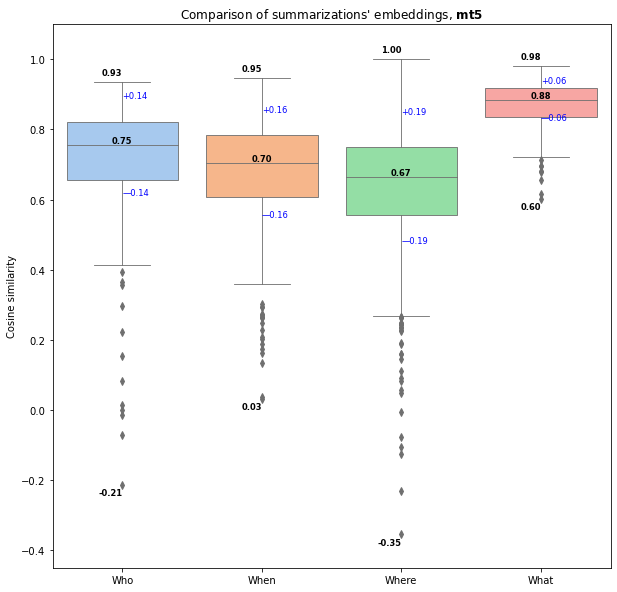

In [358]:
plot_cos_sim(dataset_anonymized[["cos_mt5_who", "cos_mt5_when", "cos_mt5_where", "cos_mt5_what"]], "mt5")

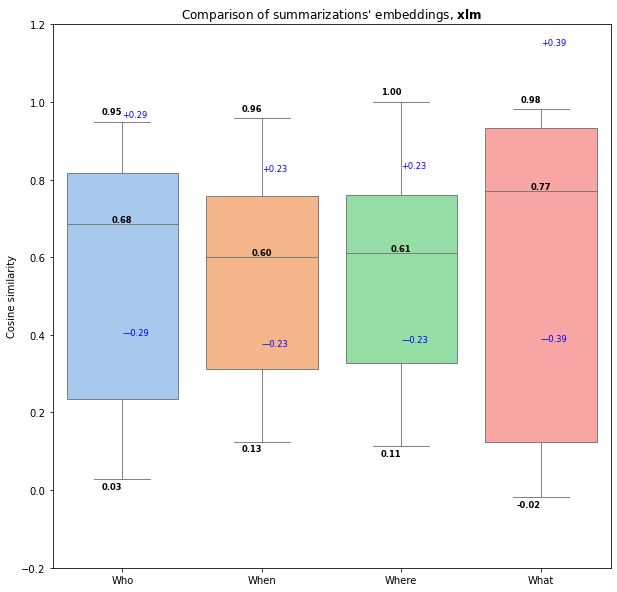

In [235]:
plot_cos_sim(dataset_anonymized[["cos_xlm_who", "cos_xlm_when", "cos_xlm_where", "cos_xlm_what"]], "xlm")

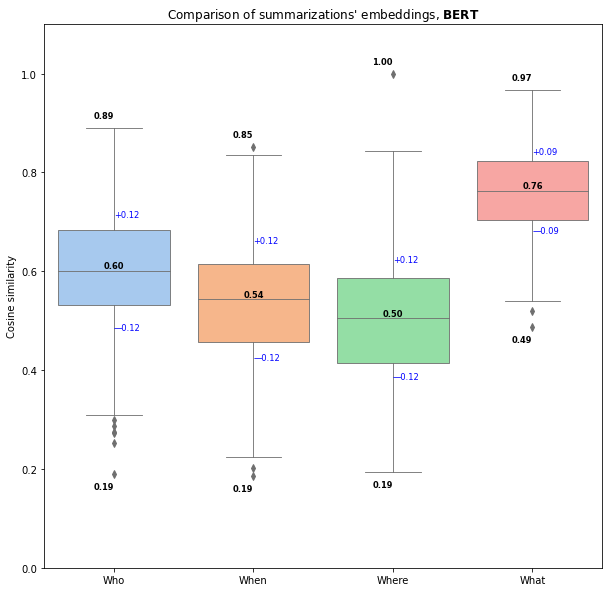

In [243]:
plot_cos_sim(dataset_anonymized[["cos_BERT_who", "cos_BERT_when", "cos_BERT_where", "cos_BERT_what"]], "BERT")

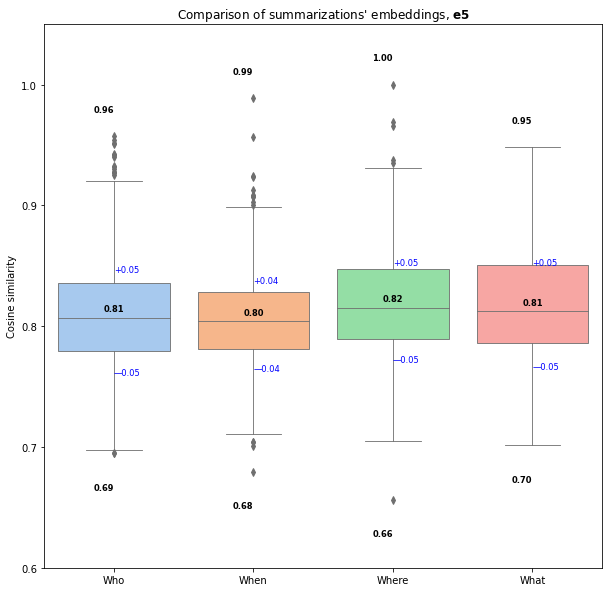

In [254]:
plot_cos_sim(dataset_anonymized[["cos_e5_who", "cos_e5_when", "cos_e5_where", "cos_e5_what"]], "e5")

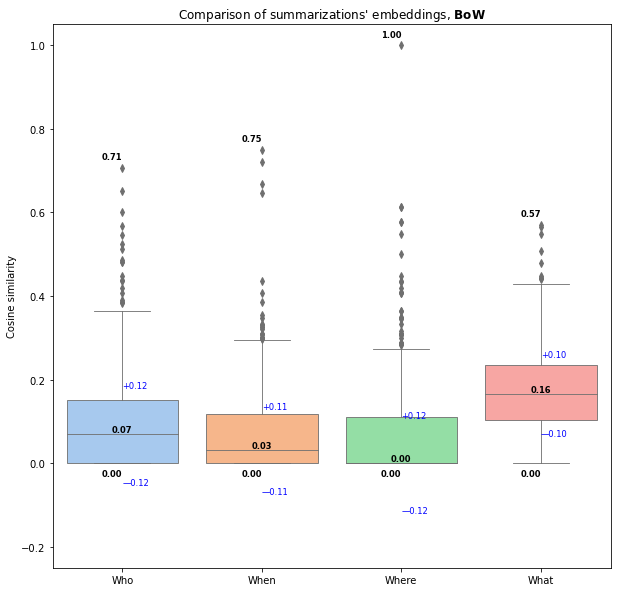

In [260]:
plot_cos_sim(dataset_anonymized[["cos_BoW_who", "cos_BoW_when", "cos_BoW_where", "cos_BoW_what"]], "BoW")

In [5]:
def agreement_label(list_for_MV):
    word_counts = Counter(list_for_MV)
    most_common_word, frequency = word_counts.most_common(1)[0]
    if frequency > 1:
        return most_common_word
    else:
        return 'disagreement'

grouped = dataset.groupby('task_id').agg({
    'who_same': agreement_label,
    'where_same': agreement_label,
    'when_same': agreement_label,
    'what_same': agreement_label,
    'source1': 'first',
    'source2': 'first'
})

grouped.rename(columns={'who_same': 'aggregated_who',
                        'what_same': 'aggregated_what',
                        'when_same': 'aggregated_when',
                        'where_same': 'aggregated_where',
                       }, inplace=True)

In [6]:
dataset_anonymized = pd.merge(dataset_anonymized, grouped, on=['source1', 'source2'], how='left', indicator=True)
dataset_anonymized = dataset_anonymized[dataset_anonymized._merge == "both"].drop(columns="_merge")

In [44]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import classification_report, accuracy_score

### Who

In [47]:
dataset_anonymized_who = dataset_anonymized[(dataset_anonymized.aggregated_who != "incomparable") & (dataset_anonymized.aggregated_who != "disagreement")].copy()
print(dataset_anonymized_who.shape)

(482, 90)


In [102]:
dataset_anonymized_who_train = pd.concat(
    [
        dataset_anonymized_who[dataset_anonymized_who.aggregated_who == 'yes'].sample(n=7),
        dataset_anonymized_who[dataset_anonymized_who.aggregated_who == 'partly'].sample(n=25),
        dataset_anonymized_who[dataset_anonymized_who.aggregated_who == 'no'].sample(n=50),
    ]
)
dataset_anonymized_who_test = pd.merge(dataset_anonymized_who, dataset_anonymized_who_train[["source1", "source2"]], on=["source1", "source2"], how='left', indicator=True)
dataset_anonymized_who_test = dataset_anonymized_who_test[dataset_anonymized_who_test._merge == 'left_only'].drop(columns='_merge')

In [170]:
def finding_thesholds_who(tree_clf, model_cos):
    tree_clf.fit(np.array(dataset_anonymized_who_train[model_cos]).reshape(-1, 1), dataset_anonymized_who_train.aggregated_who)
    plt.figure(figsize=(10, 10))
    plot_tree(tree_clf, feature_names=[model_cos], class_names=["no", "partly", "yes"], filled=True)
    plt.show()
    y_pred = tree_clf.predict(np.array(dataset_anonymized_who_test[model_cos]).reshape(-1, 1))
    accuracy = accuracy_score(dataset_anonymized_who_test.aggregated_who, y_pred)
    print(f'Overall Accuracy of **{model_cos}**: {accuracy}')
    report = classification_report(dataset_anonymized_who_test.aggregated_who, y_pred, target_names=tree_clf.classes_)
    print(f"Classification Report of **{model_cos}**:\n")
    print(report)

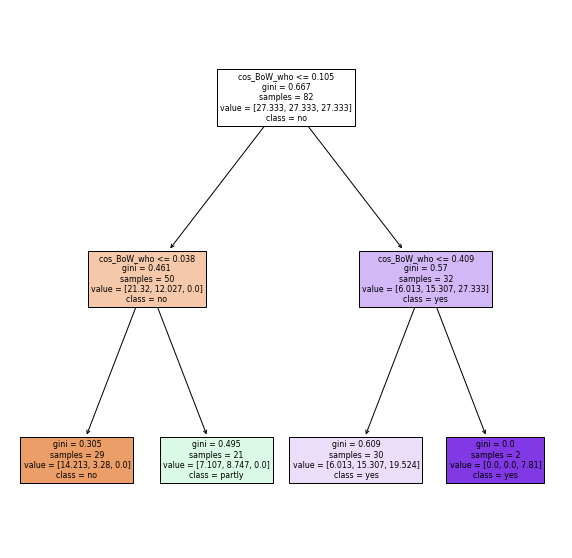

Overall Accuracy of **cos_BoW_who**: 0.4375
Classification Report of **cos_BoW_who**:

              precision    recall  f1-score   support

          no       0.90      0.46      0.61       295
      partly       0.16      0.20      0.18        80
         yes       0.15      0.88      0.25        25

    accuracy                           0.44       400
   macro avg       0.40      0.51      0.35       400
weighted avg       0.70      0.44      0.50       400



In [171]:
finding_thesholds_who(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BoW_who")

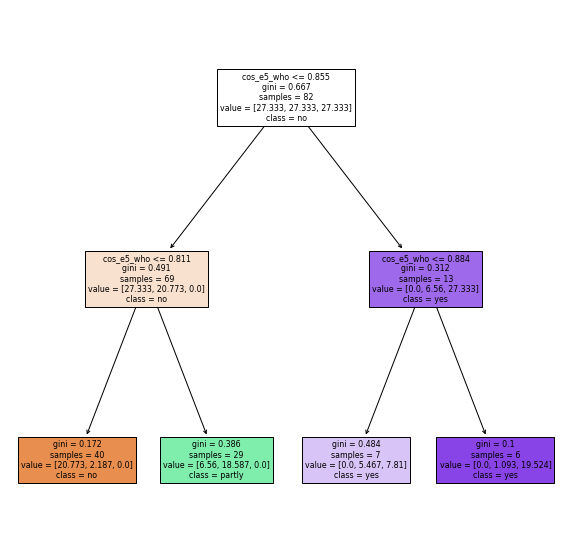

Overall Accuracy of **cos_e5_who**: 0.645
Classification Report of **cos_e5_who**:

              precision    recall  f1-score   support

          no       0.91      0.70      0.79       295
      partly       0.29      0.41      0.34        80
         yes       0.31      0.76      0.44        25

    accuracy                           0.65       400
   macro avg       0.50      0.62      0.52       400
weighted avg       0.75      0.65      0.68       400



In [172]:
finding_thesholds_who(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_e5_who")

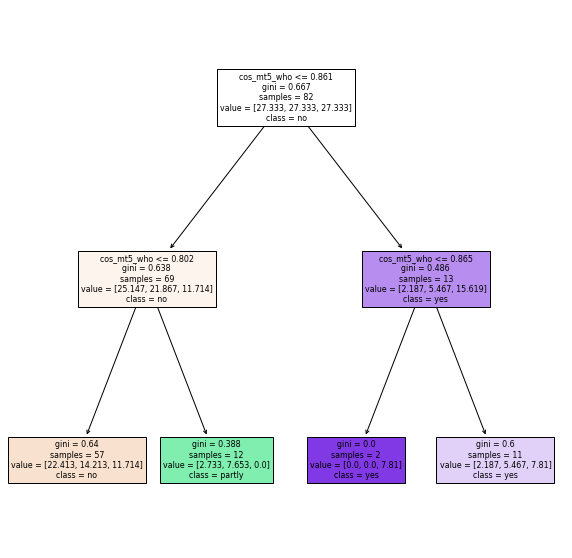

Overall Accuracy of **cos_mt5_who**: 0.6175
Classification Report of **cos_mt5_who**:

              precision    recall  f1-score   support

          no       0.80      0.74      0.77       295
      partly       0.24      0.29      0.26        80
         yes       0.20      0.28      0.23        25

    accuracy                           0.62       400
   macro avg       0.42      0.43      0.42       400
weighted avg       0.65      0.62      0.63       400



In [173]:
finding_thesholds_who(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_mt5_who")

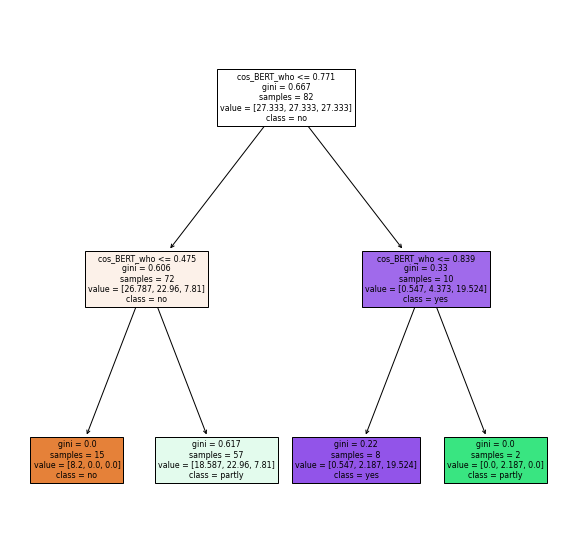

Overall Accuracy of **cos_BERT_who**: 0.3025
Classification Report of **cos_BERT_who**:

              precision    recall  f1-score   support

          no       0.90      0.15      0.26       295
      partly       0.21      0.88      0.34        80
         yes       0.35      0.28      0.31        25

    accuracy                           0.30       400
   macro avg       0.49      0.43      0.30       400
weighted avg       0.73      0.30      0.28       400



In [174]:
finding_thesholds_who(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BERT_who")

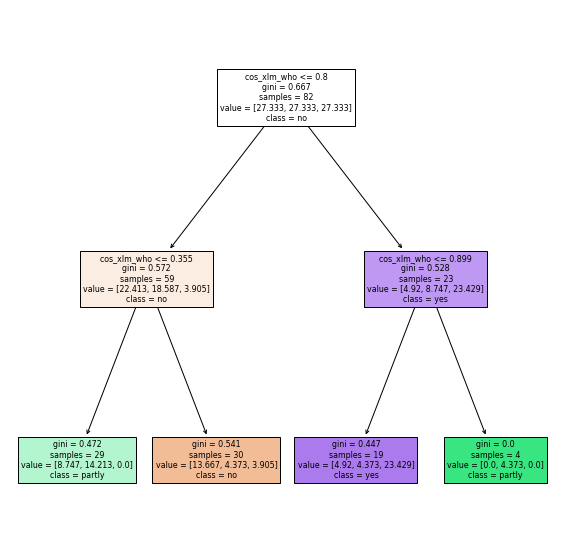

Overall Accuracy of **cos_xlm_who**: 0.37
Classification Report of **cos_xlm_who**:

              precision    recall  f1-score   support

          no       0.78      0.36      0.49       295
      partly       0.19      0.41      0.26        80
         yes       0.11      0.40      0.17        25

    accuracy                           0.37       400
   macro avg       0.36      0.39      0.31       400
weighted avg       0.62      0.37      0.42       400



In [175]:
finding_thesholds_who(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_xlm_who")

### When

In [109]:
dataset_anonymized_when = dataset_anonymized[(dataset_anonymized.aggregated_when != "incomparable") & (dataset_anonymized.aggregated_when != "disagreement")].copy()
print(dataset_anonymized_when.shape)

(380, 90)


In [113]:
dataset_anonymized_when_train = pd.concat(
    [
        dataset_anonymized_when[dataset_anonymized_when.aggregated_when == 'yes'].sample(n=5),
        dataset_anonymized_when[dataset_anonymized_when.aggregated_when == 'partly'].sample(n=9),
        dataset_anonymized_when[dataset_anonymized_when.aggregated_when == 'no'].sample(n=66),
    ]
)
dataset_anonymized_when_test = pd.merge(dataset_anonymized_when, dataset_anonymized_when_train[["source1", "source2"]], on=["source1", "source2"], how='left', indicator=True)
dataset_anonymized_when_test = dataset_anonymized_when_test[dataset_anonymized_when_test._merge == 'left_only'].drop(columns='_merge')

In [182]:
def finding_thesholds_when(tree_clf, model_cos):
    tree_clf.fit(np.array(dataset_anonymized_when_train[model_cos]).reshape(-1, 1), dataset_anonymized_when_train.aggregated_when)
    plt.figure(figsize=(10, 10))
    plot_tree(tree_clf, feature_names=[model_cos], class_names=["no", "in_one_month", "yes"], filled=True)
    plt.show()
    y_pred = tree_clf.predict(np.array(dataset_anonymized_when_test[model_cos]).reshape(-1, 1))
    accuracy = accuracy_score(dataset_anonymized_when_test.aggregated_when, y_pred)
    print(f'Overall Accuracy of **{model_cos}**: {accuracy}')
    report = classification_report(dataset_anonymized_when_test.aggregated_when, y_pred, target_names=tree_clf.classes_)
    print(f"Classification Report of **{model_cos}**:\n")
    print(report)

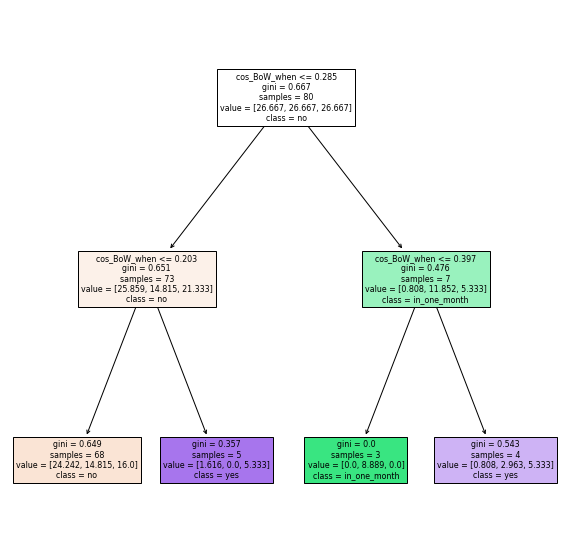

Overall Accuracy of **cos_BoW_when**: 0.8333333333333334
Classification Report of **cos_BoW_when**:

              precision    recall  f1-score   support

          no       0.94      0.89      0.92       275
      partly       0.00      0.00      0.00        10
         yes       0.15      0.27      0.20        15

    accuracy                           0.83       300
   macro avg       0.36      0.39      0.37       300
weighted avg       0.87      0.83      0.85       300



In [183]:
finding_thesholds_when(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BoW_when")

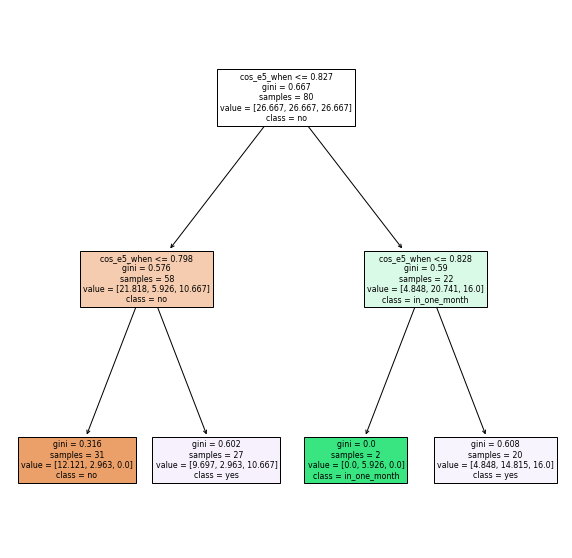

Overall Accuracy of **cos_e5_when**: 0.42333333333333334
Classification Report of **cos_e5_when**:

              precision    recall  f1-score   support

          no       0.96      0.41      0.58       275
      partly       0.25      0.10      0.14        10
         yes       0.07      0.87      0.13        15

    accuracy                           0.42       300
   macro avg       0.43      0.46      0.28       300
weighted avg       0.89      0.42      0.54       300



In [184]:
finding_thesholds_when(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_e5_when")

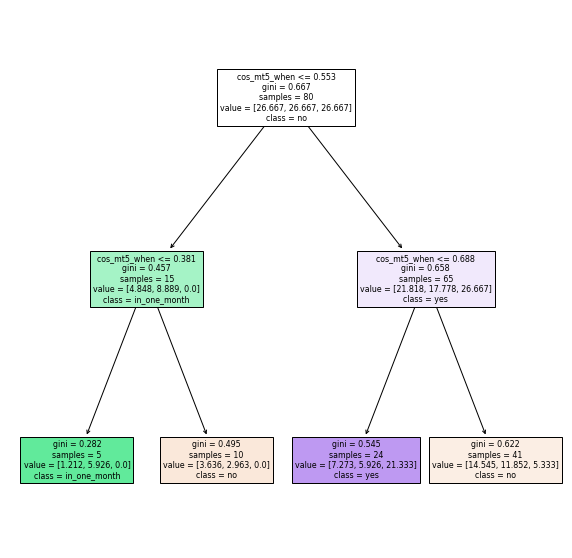

Overall Accuracy of **cos_mt5_when**: 0.6633333333333333
Classification Report of **cos_mt5_when**:

              precision    recall  f1-score   support

          no       0.90      0.72      0.80       275
      partly       0.00      0.00      0.00        10
         yes       0.01      0.07      0.02        15

    accuracy                           0.66       300
   macro avg       0.31      0.26      0.27       300
weighted avg       0.83      0.66      0.74       300



In [185]:
finding_thesholds_when(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_mt5_when")

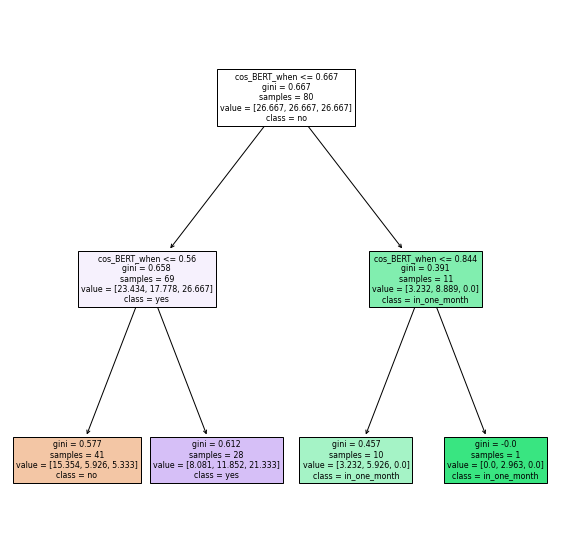

Overall Accuracy of **cos_BERT_when**: 0.5333333333333333
Classification Report of **cos_BERT_when**:

              precision    recall  f1-score   support

          no       0.95      0.56      0.71       275
      partly       0.02      0.10      0.04        10
         yes       0.04      0.27      0.07        15

    accuracy                           0.53       300
   macro avg       0.34      0.31      0.27       300
weighted avg       0.87      0.53      0.65       300



In [186]:
finding_thesholds_when(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BERT_when")

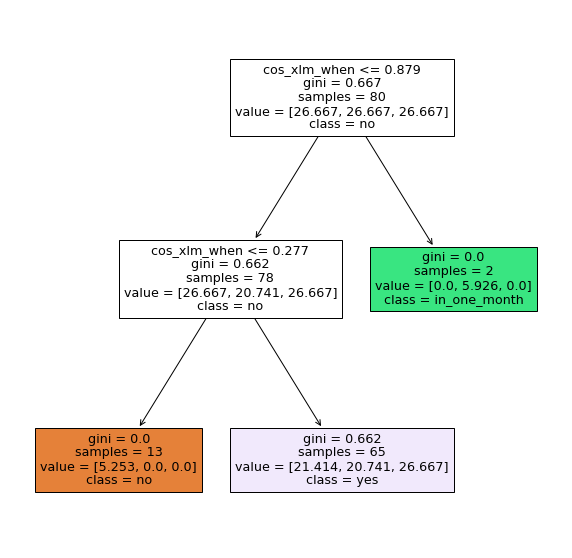

Overall Accuracy of **cos_xlm_when**: 0.20333333333333334
Classification Report of **cos_xlm_when**:

              precision    recall  f1-score   support

          no       0.96      0.17      0.30       275
      partly       0.00      0.00      0.00        10
         yes       0.05      0.87      0.10        15

    accuracy                           0.20       300
   macro avg       0.34      0.35      0.13       300
weighted avg       0.88      0.20      0.28       300



In [187]:
finding_thesholds_when(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_xlm_when")

### Where

In [138]:
dataset_anonymized_where = dataset_anonymized[(dataset_anonymized.aggregated_where != "incomparable") & (dataset_anonymized.aggregated_where != "disagreement")].copy()
print(dataset_anonymized_where.shape)

(456, 90)


In [147]:
dataset_anonymized_where_train = pd.concat(
    [
        dataset_anonymized_where[dataset_anonymized_where.aggregated_where == 'yes'].sample(n=17),
        dataset_anonymized_where[dataset_anonymized_where.aggregated_where == 'partly'].sample(n=27),
        dataset_anonymized_where[dataset_anonymized_where.aggregated_where == 'no'].sample(n=42),
    ]
)
dataset_anonymized_where_test = pd.merge(dataset_anonymized_where, dataset_anonymized_where_train[["source1", "source2"]], on=["source1", "source2"], how='left', indicator=True)
dataset_anonymized_where_test = dataset_anonymized_where_test[dataset_anonymized_where_test._merge == 'left_only'].drop(columns='_merge')

In [148]:
def finding_thesholds_where(tree_clf, model_cos):
    tree_clf.fit(np.array(dataset_anonymized_where_train[model_cos]).reshape(-1, 1), dataset_anonymized_where_train.aggregated_where)
    plt.figure(figsize=(10, 10))
    plot_tree(tree_clf, feature_names=[model_cos], class_names=["no", "partly", "yes"], filled=True)
    plt.show()
    y_pred = tree_clf.predict(np.array(dataset_anonymized_where_test[model_cos]).reshape(-1, 1))
    accuracy = accuracy_score(dataset_anonymized_where_test.aggregated_where, y_pred)
    print(f'Overall Accuracy of **{model_cos}**: {accuracy}')
    report = classification_report(dataset_anonymized_where_test.aggregated_where, y_pred, target_names=tree_clf.classes_)
    print(f"Classification Report of **{model_cos}**:\n")
    print(report)

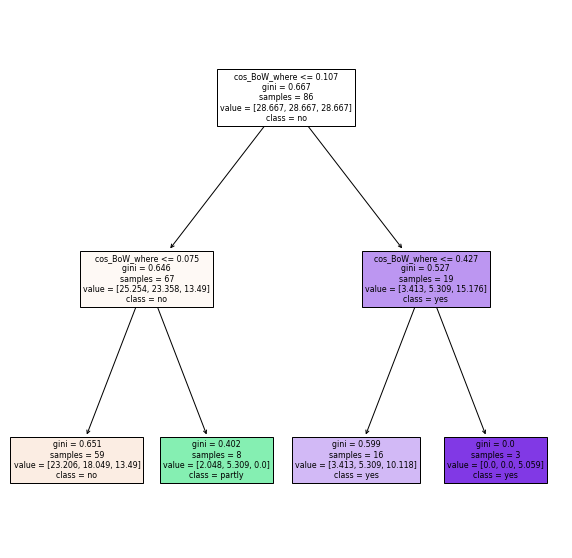

Overall Accuracy of **cos_BoW_where**: 0.5432432432432432
Classification Report of **cos_BoW_where**:

              precision    recall  f1-score   support

          no       0.65      0.79      0.71       201
      partly       0.27      0.06      0.10       101
         yes       0.35      0.54      0.43        68

    accuracy                           0.54       370
   macro avg       0.43      0.46      0.41       370
weighted avg       0.49      0.54      0.49       370



In [159]:
finding_thesholds_where(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BoW_where")

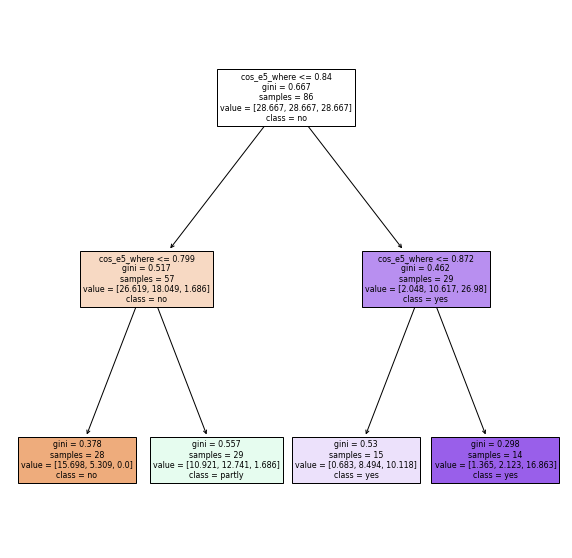

Overall Accuracy of **cos_e5_where**: 0.5
Classification Report of **cos_e5_where**:

              precision    recall  f1-score   support

          no       0.80      0.46      0.58       201
      partly       0.32      0.45      0.38       101
         yes       0.41      0.71      0.52        68

    accuracy                           0.50       370
   macro avg       0.51      0.54      0.49       370
weighted avg       0.60      0.50      0.51       370



In [158]:
finding_thesholds_where(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_e5_where")

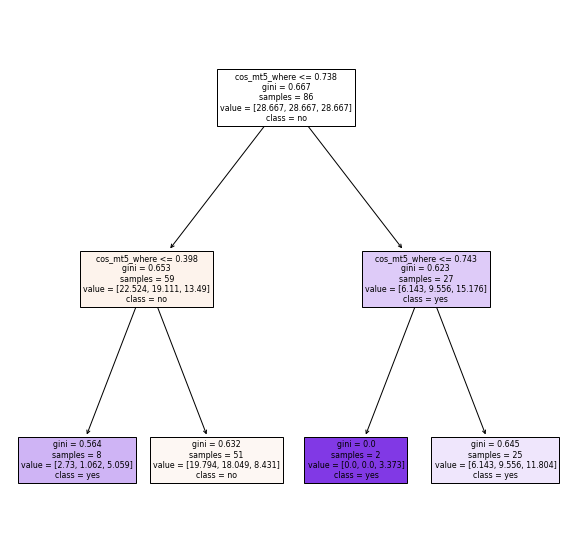

Overall Accuracy of **cos_mt5_where**: 0.41081081081081083
Classification Report of **cos_mt5_where**:

              precision    recall  f1-score   support

          no       0.56      0.61      0.58       201
      partly       0.00      0.00      0.00       101
         yes       0.20      0.44      0.27        68

    accuracy                           0.41       370
   macro avg       0.25      0.35      0.29       370
weighted avg       0.34      0.41      0.37       370



/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [157]:
finding_thesholds_where(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_mt5_where")

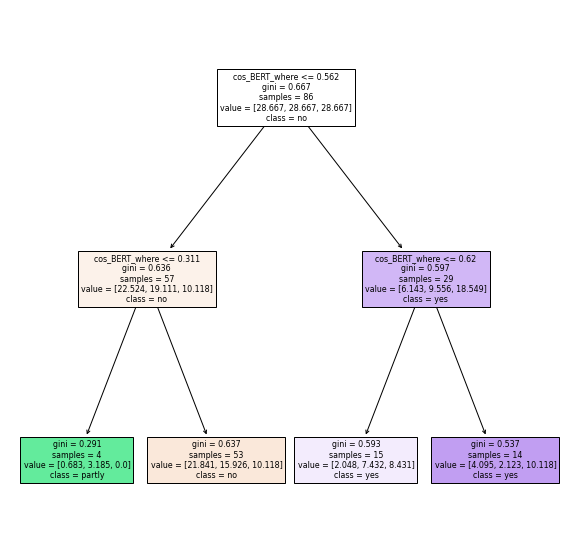

Overall Accuracy of **cos_BERT_where**: 0.42702702702702705
Classification Report of **cos_BERT_where**:

              precision    recall  f1-score   support

          no       0.57      0.63      0.60       201
      partly       0.08      0.02      0.03       101
         yes       0.24      0.43      0.31        68

    accuracy                           0.43       370
   macro avg       0.30      0.36      0.31       370
weighted avg       0.37      0.43      0.39       370



In [156]:
finding_thesholds_where(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BERT_where")

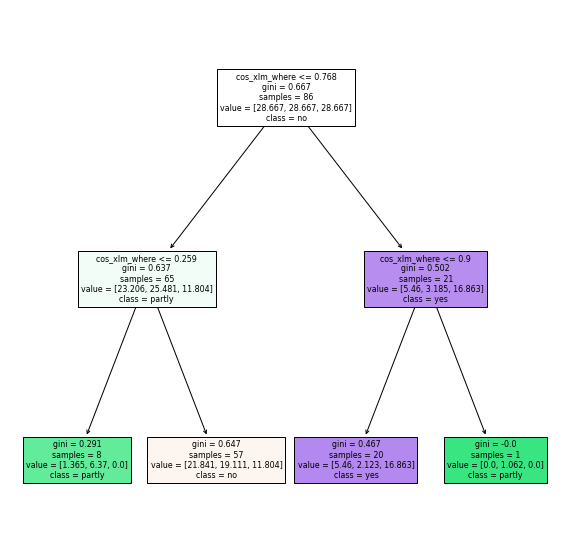

Overall Accuracy of **cos_xlm_where**: 0.46216216216216216
Classification Report of **cos_xlm_where**:

              precision    recall  f1-score   support

          no       0.56      0.69      0.62       201
      partly       0.26      0.11      0.15       101
         yes       0.27      0.31      0.29        68

    accuracy                           0.46       370
   macro avg       0.36      0.37      0.35       370
weighted avg       0.42      0.46      0.43       370



In [154]:
finding_thesholds_where(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_xlm_where")

### What

In [176]:
dataset_anonymized.aggregated_what.unique()

array(['different', 'somewhat_related', 'disagreement', 'similar'],
      dtype=object)

In [177]:
dataset_anonymized_what = dataset_anonymized[dataset_anonymized.aggregated_what != "disagreement"].copy()
print(dataset_anonymized_what.shape)

(493, 90)


In [180]:
dataset_anonymized_what_train = pd.concat(
    [
        dataset_anonymized_what[dataset_anonymized_what.aggregated_what == 'similar'].sample(n=7),
        dataset_anonymized_what[dataset_anonymized_what.aggregated_what == 'somewhat_related'].sample(n=26),
        dataset_anonymized_what[dataset_anonymized_what.aggregated_what == 'different'].sample(n=60),
    ]
)
dataset_anonymized_what_test = pd.merge(dataset_anonymized_what, dataset_anonymized_what_train[["source1", "source2"]], on=["source1", "source2"], how='left', indicator=True)
dataset_anonymized_what_test = dataset_anonymized_what_test[dataset_anonymized_what_test._merge == 'left_only'].drop(columns='_merge')

In [181]:
def finding_thesholds_what(tree_clf, model_cos):
    tree_clf.fit(np.array(dataset_anonymized_what_train[model_cos]).reshape(-1, 1), dataset_anonymized_what_train.aggregated_what)
    plt.figure(figsize=(10, 10))
    plot_tree(tree_clf, feature_names=[model_cos], class_names=["different", "somewhat_related", "similar"], filled=True)
    plt.show()
    y_pred = tree_clf.predict(np.array(dataset_anonymized_what_test[model_cos]).reshape(-1, 1))
    accuracy = accuracy_score(dataset_anonymized_what_test.aggregated_what, y_pred)
    print(f'Overall Accuracy of **{model_cos}**: {accuracy}')
    report = classification_report(dataset_anonymized_what_test.aggregated_what, y_pred, target_names=tree_clf.classes_)
    print(f"Classification Report of **{model_cos}**:\n")
    print(report)

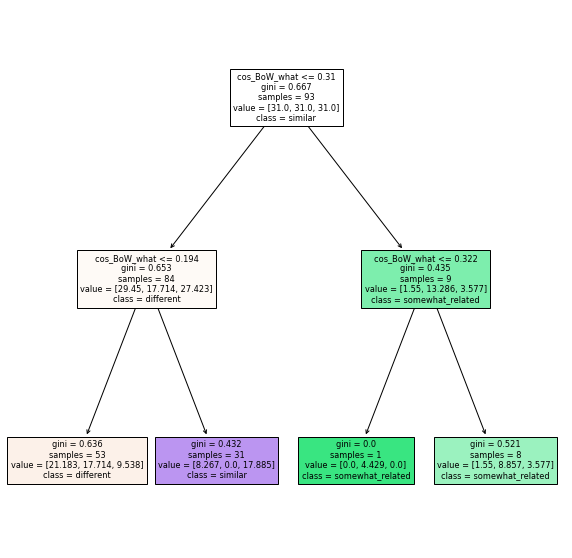

Overall Accuracy of **cos_BoW_what**: 0.6325
Classification Report of **cos_BoW_what**:

                  precision    recall  f1-score   support

       different       0.81      0.72      0.76       275
         similar       0.26      0.50      0.34        20
somewhat_related       0.38      0.42      0.40       105

        accuracy                           0.63       400
       macro avg       0.48      0.55      0.50       400
    weighted avg       0.67      0.63      0.65       400



In [188]:
finding_thesholds_what(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BoW_what")

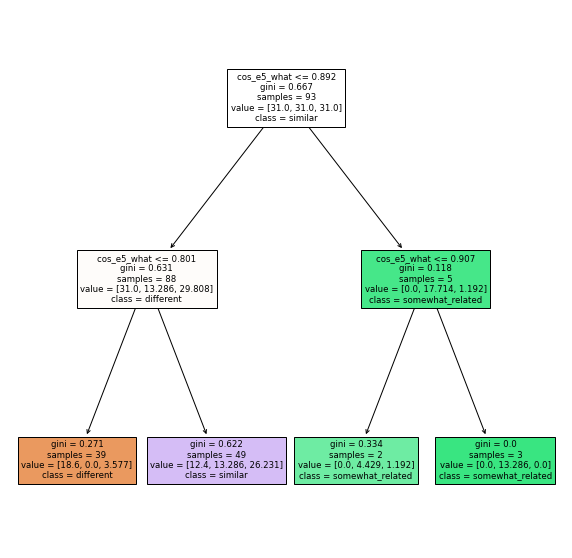

Overall Accuracy of **cos_e5_what**: 0.57
Classification Report of **cos_e5_what**:

                  precision    recall  f1-score   support

       different       0.88      0.50      0.64       275
         similar       0.52      0.85      0.64        20
somewhat_related       0.35      0.70      0.46       105

        accuracy                           0.57       400
       macro avg       0.58      0.68      0.58       400
    weighted avg       0.72      0.57      0.59       400



In [189]:
finding_thesholds_what(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_e5_what")

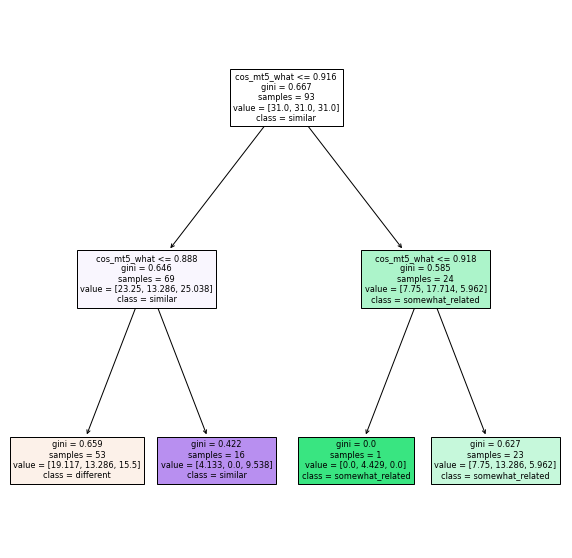

Overall Accuracy of **cos_mt5_what**: 0.49
Classification Report of **cos_mt5_what**:

                  precision    recall  f1-score   support

       different       0.79      0.59      0.68       275
         similar       0.14      0.70      0.23        20
somewhat_related       0.21      0.18      0.19       105

        accuracy                           0.49       400
       macro avg       0.38      0.49      0.37       400
    weighted avg       0.60      0.49      0.53       400



In [190]:
finding_thesholds_what(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_mt5_what")

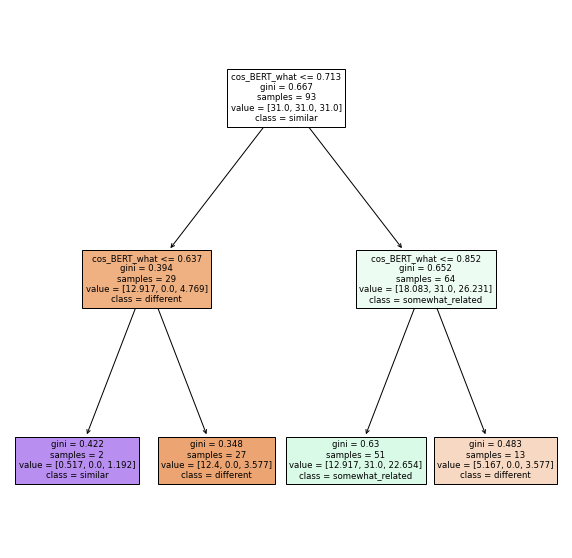

Overall Accuracy of **cos_BERT_what**: 0.24
Classification Report of **cos_BERT_what**:

                  precision    recall  f1-score   support

       different       0.62      0.31      0.41       275
         similar       0.04      0.50      0.08        20
somewhat_related       0.06      0.02      0.03       105

        accuracy                           0.24       400
       macro avg       0.24      0.27      0.17       400
    weighted avg       0.45      0.24      0.29       400



In [191]:
finding_thesholds_what(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_BERT_what")

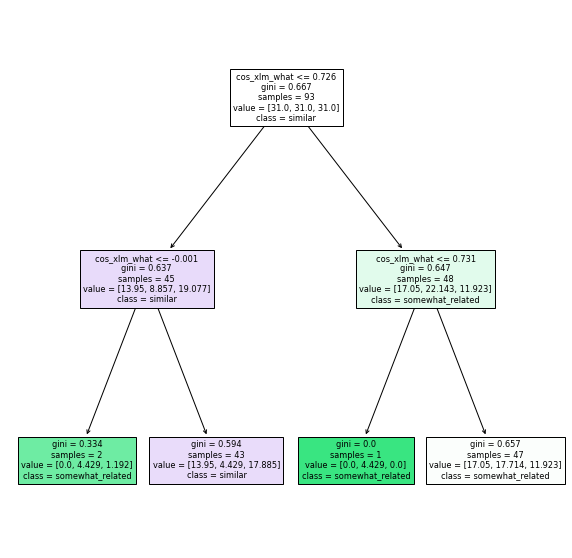

Overall Accuracy of **cos_xlm_what**: 0.145
Classification Report of **cos_xlm_what**:

                  precision    recall  f1-score   support

       different       0.00      0.00      0.00       275
         similar       0.08      0.90      0.14        20
somewhat_related       0.25      0.38      0.30       105

        accuracy                           0.14       400
       macro avg       0.11      0.43      0.15       400
    weighted avg       0.07      0.14      0.09       400



/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [193]:
finding_thesholds_what(DecisionTreeClassifier(class_weight='balanced', max_depth=2), "cos_xlm_what")

## Prompting

### Mistral 7b
- https://huggingface.co/mistralai/Mistral-7B-Instruct-v0.3
- https://community.aws/content/2dFNOnLVQRhyrOrMsloofnW0ckZ/how-to-prompt-mistral-ai-models-and-why?lang=en
- 8192 context window size

In [14]:
parameters_mistral = {'max_new_tokens':300, 
              'return_full_text': False, 
              'do_sample': True, 
              'top_p':0.99, 
              'temperature':0.01}

author_mistral = "mistralai"
model_mistral = "Mistral-7B-Instruct-v0.3"

def prompt_mistral(row):
    return f'''
        <s>[INST]
        Your goal is to compare news articles.
        For each news article two summarization options are provided (including basic information on four parameters: WHO, WHEN, WHERE and WHAT happened).
        News in a pair can be in different languages, but this should not affect your comparison. For example, Wołodymyr Zełenski (Polish) and Volodymyr Zelenskyy (English) are the same actor in an event.
        You have to answer 4 sub-questions about similarity of news in JSON format: 
        
        **Do the main characters in the news match? (WHO?)**
        The actor of an article can be a specific person (Volodymyr Zelenskyy), an organization/party or any other association of people.
        1. **yes**. The main and secondary protagonists in the articles are the same. At the same time, it is important to note that one actor can be called differently, for example, “Volodymyr Zelenskyi” and “the President of Ukraine”.
        2. **partly**. (There are overlaps) Some of the main or secondary actors are the same.
        3. **no**. Actors in the articles do not overlap at all, they have nothing in common.
        4. **incomparable**. At least one article has no actors. For example, one of the articles states something very vague, like “the entire population of the Earth”, or the article is a weather forecast.

        **Do the places where the events in the news are taking place match the places in the news? (WHERE?)**
        The same place may be referred to in different ways, such as “St. Petersburg” and “Питер”.
        1. **yes**. Articles are mentioning exactly the same place. That is, if one article mentions a specific place/city/country, it should be mentioned in the second article. If one article mentions only a country and the other a city, this is not an exact match.
        2. **partly**. (There are overlaps) The place mentioned in one article is located within the boundaries of the place mentioned in another article. For example, if one article refers to events taking place in Ukraine and the other in Kyiv, this option is selected. Also valid choice if different places (e.g., countries) are mentioned in the articles and some of the names of the places are the same.
        3. **no**. The places are completely different (different places in the city, in the country, different countries).
        4. **incomparable**. At least one article does not mention the location at all. Something very vague, for example, something that happens all over the world, all over the Internet, or if the location is not really specified. At the same time, if the place of action can be understood, for example, the article says “in our country” and the author is obviously a Ukrainian, then this option should not be selected.

        **Does the timing of the events in the news coincide? (WHEN?)**
        It is important to understand that we are interested in the time/date of the news event, NOT the time/date of the article's publication. 
        1. **yes**. Same event time-wise. It is obvious from the article that it is about the same event that happened at the same time.
        2. **partly**. Two events in news articles occurred within the same month.
        3. **no**. The difference between the times of the events is more than a month.
        4. **incomparable**. From at least one news article, it is impossible to establish the time of the event; it is impossible to determine when the event itself took place. Or the time period in the article is very vague, for example, “at all times”.

        **How do the news topics/events relate to each other? (WHAT?)**
        1. **similar**. News are about the same event.
        2. **somewhat_related**. Common specific topic/common event.
        3. **different** News are about different events.
        1. **similar**
        News describe the same event that happened in the same place, with the same people, at approximately the same time.
        However, the event might be described:
        - with different focus (one focuses more on one part of the event, the other on another)
        - from different points of view, political positions
        - with errors in the details, which makes the news seem “different”
        If you are not 100% sure that the news is about the same event with the same actors, in the same place and at approximately the same time (some details make them different), then you should choose the option “Common specific topic/common event”.
        2. **somewhat_related**
        News aricles are related to one close narrow topic/event, but describe different incidents within it.
        Examples of narrow common topics:
        - Curfews imposed due to covid-19 (in different countries, or changes in its status within the same country);
        - Robbery of a grocery store by teenagers (in different places or different events within the same case);
        - Joe Biden's 2020 election campaign and various events described from it.
        News common topics should be narrow, specific: for example, two news stories on broad and popular topics in the news aka covid, death, elections do not necessarily have to have any commonality in themselves.
        3. **different**
        Events in the news have little to do with each other. They either do not have a common theme, or the common theme is so broad (e.g., covid) that it is not a reason to consider the news similar.
        
        Provide **a short reasoning** for **WHAT?** answer in the following format:
        - News are **similar**: Briefly describe, summarizing in 1-2 sentences, what the event described in both news is about.
        - Both news are **somewhat_related**: Briefly, in 1-2 sentences, identify the common specific topic of news.
        - News are about **different** events: Briefly summarize in 1-2 sentences about what is the first and the second news article.
        
        Example:
        
        **Summarization of the first news article, version 1**
        ХТО: 27 учнів середньої школи з Марбурга та їхній водій.
        КОЛИ: В неділю, 2023.
        ДЕ: На автобані 45 у німецькій федеральній землі Саар.
        ЩО: Двоповерховий автобус, який віз 27 учнів середньої школи та їхніх вчителів в Англію, потрапив у серйозну аварію. Три дівчини та хлопець отримали серйозні травми і були госпіталізовані, а також водій автобуса отримав легкі травми. Автобус з'їхав з дороги та перекинувся на бік. Поліція розслідує причину ДТП. Через аварію автострада у напрямку Дортмунда була повністю блокована. Шкільна екскурсія була скасована, і дітей повернули додому. Це не перша така аварія за участі шкільного автобуса в Німеччині - у квітні та грудні минулого року також були серйозні ДТП за участі шкільних автобусів, у яких постраждали діти.
        
        **Summarization of the first news article, version 2**
        ХТО: 27 учнів середньої школи у Марбурзі та їх 54-річний водій автобуса.
        КОЛИ: У неділю о 6:27, 2023.
        ДЕ: Автобан 45 у Саарі, неподалік Вендена в районі Ольпе.
        ЩО: Двоповерховий автобус, який віз 27 учнів та п'ятеро вчителів зі старшої школи з німецького Марбурга в Англію, потрапив у аварію. За словами поліції Дортмунда, автобус з'їхав у праву сторону та перекинувся на бік. У результаті аварії постраждали 27 учнів та їх водій, чотири людини отримали серйозні травми, а решта - легкі. Усі постраждалі були доставлені до лікарні, їхньому життю нічого не загрожує. Шкільна екскурсія була скасована, а дітей повернули до Марбурга. Через аварію автобан у напрямку Дортмунда був повністю закритий протягом дня.
        Ця подія є не єдиною аварією шкільного автобуса в Німеччині. Раніше у квітні в місті Гольцмінден аварія за участю шкільного автобуса призвела до госпіталізації 16 учнів, а в грудні минулого року - до загибелі дитини через сильну ожеледицю.
        
        **Summarization of the second news article, version 1**
        ХТО: Стрілянину в Огайо влаштував 27-річний чоловік, через його дії одна людина загинула, а 26 отримали поранення. А перед цим у Словаччині було скоєно замах на прем'єра Роберта Фіцо, а в Туреччині - на відділок поліції, де загинули двоє людей.
        КОЛИ: Масштабна стрілянина в Огайо відбулася в ніч на неділю, 2 червня, 2024. Замах на Роберта Фіцо відбувся 15 травня, а стрілянина в Туреччині - у відділенні поліції - сталася невдовзі після цього.
        ДЕ: Події розгорталися в американському штаті Огайо, specifically на вулиці міста Акрон. У Словаччині замах на прем'єра відбувся перед місцевим Будинком культури в місті Хандлов. А в Туреччині - у місті Адияман, у відділку поліції.
        ЩО: В результаті стрілянини в Огайо одна особа загинула, а 26 отримали поранення; поліція прибала на місце події і виявила зброю. Це вже другий за останній час інцидент зі стріляниною в цьому штаті. Замах на прем'єра Словаччини залишив його у важкому стані, а в результаті стрілянини в Туреччині загинули двоє правоохоронців. Обидві події показують зростання насильства з використанням зброї у цих регіонах.
        
        **Summarization of the second news article, version 2**
        ХТО: Нападником виявився 27-річний чоловік, який відкрив стрілянину і вбив одну людину, а ще поранив 26 людей. among them was also a politician Robert Fico, who survived the attack.
        КОЛИ: Стрілянина відбулася опівночі у неділю, 2 червня, 2024. А замах на політика Роберта Фіцо стався 15 травня.
        ДЕ: Інцидент із стріляниною відбувся у штаті Огайо, на вулиці міста Акрон. А напад на Роберта Фіцо відбувся у місті Хандлов.
        ЩО: У штаті Огайо відбулася стрілянина, за участі 27-річного стрільця, внаслідок якої 1 особа загинула та ще 26 отримали поранення різного ступеня тяжкості. Правоохоронці вилучили зброю на місці події. Окрім того, у своїй відповіді я розповіла про замах на прем'єра Словаччини Роберта Фіцо, який відбувся 15 травня та про стрілянину у відділку поліції в турецькому місті Адияман, де правоохоронець відкрив вогонь по колегах, в результаті чого загинуло двоє людей та восьмеро було поранено.
        
        Return answer in JSON format:
        [/INST]
        {{
        "WHO": "no",
        "WHO_reasoning": "German schoolchildren vs shooter from Ohio",
        "WHERE": "no",
        "WHERE_reasoning": "Saar vs Ohio",
        "WHEN": "no",
        "WHEN_reasoning": "2nd of June, 2024, and any event in 2023 are more than a month apart",
        "WHAT": "different",
        "WHAT_reasoning": "The bus with schoolchildren that flipped over in Saarland, Germany, has nothing to do with the shooting in Ohio, which resulted in 27 people dead",
        }}
        </s>
        [INST]
        **Summarization of the first news article, version 1**
        {row.summ_text1}
        **Summarization of the first news article, version 2**
        {row.summ_with_documents_text1}
        **Summarization of the second news article, version 1**
        {row.summ_text2}
        **Summarization of the second news article, version 2**
        {row.summ_with_documents_text2}
        
        Return answer in JSON format:
        [/INST]'''

In [17]:
dataset_anonymized["mistral_7b_instruct_v03"] = dataset_anonymized.apply(lambda row: query_hugging_face(prompt_mistral(row), author_mistral, model_mistral, parameters_mistral)[0]["generated_text"], axis=1)

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Tom Hanks and Rita Wilson are the main characters in both articles",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention Australia, but the first article also mentions a specific location within Australia where the couple was working on a film",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention a time period, but the first article mentions a specific month, while the second article mentions a time period in January and March",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles are about the same event - the illness of Tom Hanks and Rita Wilson with COVID-19, but the second article provides more details about the treatment and symptoms of the disease",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Adam Selman and Rihanna are the main characters in both articles, as they are 

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Sony and its PlayStation 5 (PS5)",\n        "WHERE": "inconsistent",\n        "WHERE_reasoning": "The article does not specify a location, but it seems to have a global focus.",\n        "WHEN": "yes",\n        "WHEN_reasoning": "The article discusses the current state of the PS5 market, which is approximately two years after its release.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article discusses five reasons why one might not want to buy the PS5, focusing on factors such as limited exclusive games, high cost, and the availability of games on the PS4. The second article discusses the increased price of the PS5 in various regions due to global economic issues, as well as the size and aesthetics of the console, and the competition with Xbox Series S and Nintendo Switch."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "researchers and scientists",\n        "WHO_r

[{'generated_text': '\n        {\n        "WHO": "no",\n        "WHO_reasoning": "The main actors in the news articles are different: a juvenile escapee and NSP troopers in the first article, and two drivers of different vehicles in the second article.",\n        "WHERE": "no",\n        "WHERE_reasoning": "The locations in the news articles are different: Interstate 80 near Grand Island, Nebraska, and a village near Luhansk, Ukraine.",\n        "WHEN": "no",\n        "WHEN_reasoning": "The events in the news articles took place on different days.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The events described in the news articles are different: a high-speed chase and arrest of a juvenile escapee in the first article, and a traffic accident involving two vehicles in the second article."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Kanye West and his wife Bianca Censori",\n        "WHERE": "partly",\n        "WHERE_reas

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The Archive Team, a volunteer-based collective of \'rogue archivists\'",\n        "WHERE": "incomparable",\n        "WHERE_reasoning": "The Archive Team\'s efforts primarily take place online, with no geographical limitation as their work involves archiving websites and digital content",\n        "WHEN": "incomparable",\n        "WHEN_reasoning": "The article does not specify a specific time frame for the situation described",\n        "WHAT": "different",\n        "WHAT_reasoning": "The Archive Team\'s mission is to save copies of websites that are at risk of being lost or deleted, while the first news article is about the COVID-19 pandemic and its impact on the world"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Ranjona Banerji and various BJP leaders in India are mentioned in both articles, but the focus is different",\n        "WHERE": "partly",\

[{'generated_text': '\n        {\n        "WHO": "gromadytyanityalyi",\n        "WHO_reasoning": "The main characters in the news are the citizens of Italy, as they are the ones affected by the coronavirus outbreak",\n        "WHERE": "Italy",\n        "WHERE_reasoning": "The events in the news are taking place in Italy, as it is mentioned explicitly in the article",\n        "WHEN": "20 березня 2020 року",\n        "WHEN_reasoning": "The date is explicitly mentioned in the article",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first news article is about the spread of the coronavirus in Italy and the number of deaths, while the second news article is about a football player from Vis Pesaro testing positive for the coronavirus"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "no",\n        "WHO_reasoning": "The article does not have a specific actor, but it is aimed at people who own a coffee maker.",\n        "WHERE": "yes",\n        "WHERE_reasoning": 

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actor in the first article is Google, while the second article mentions multiple third-party businesses and individuals selling electric tricycles",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are global in scope, but the second article may be aimed at a single nation",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article does not specify a time period, while the second article does not provide a specific date",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article discusses updates to Google Tables and Google Search, while the second article focuses on the benefits and buying tips for electric tricycles"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actors in the news articles are different, but there is an overlap in the secondary actors (Federal Way patrol office

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actors in the first article are the local community, Kesika Metallics, Darcl Logistics, and the state government, while the second article focuses on the local community and the children who participated in the ritual.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the same location, a village in India.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article does not provide a specific date, while the second article mentions that the event occurred at an unspecified time in the present, but it is not clear if it happened recently or not.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article discusses the opposition to two industrial projects in Odisha\'s Jajpur district, while the second article describes a ritual performed by children in a village in India to appease a rain god."\n        }'}]
[{'generated_text': '\n  

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Both articles are about Ascension Via Christi, a hospital system in the United States",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The location is not explicitly mentioned in either article, but it is assumed that the safety measures are being implemented in hospitals where Ascension Via Christi has a presence",\n        "WHEN": "yes",\n        "WHEN_reasoning": "Both articles are about announcements made on Monday regarding safety measures in response to the novel coronavirus outbreak",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles describe the safety measures taken by Ascension Via Christi hospitals in response to the novel coronavirus outbreak, including limiting patient exposure, suspending non-essential services and groups, and encouraging the use of virtual visits"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "Ukrainian government and Ministry

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main actor in both articles is the artist Banksy",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention Bristol, England, but the exact location is not the same",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention Valentine\'s Day, but the exact date is not specified",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles describe the creation of a new artwork by Banksy in Bristol, England, which was later defaced",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Małgorzata Kidawa-Błońska is the main actor in the first article, while the second article mentions her along with other opposition candidates",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention Poland as the location",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article mentio

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actor in the first article is the Polish Minister of Internal Affairs and Administration, while the main actor in the second article is Schuylkill County in Pennsylvania. However, both articles are related to the COVID-19 pandemic and its impact on Poland and Pennsylvania, respectively.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The first article discusses the situation on the Polish-EU border, while the second article focuses on Schuylkill and Luzerne Counties in Pennsylvania. Both articles are related to the geographical location of Poland and Pennsylvania, respectively.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article discusses the situation from May 14 to June 12, while the second article does not specify an exact date but refers to March 22, 2020, as the first reported COVID-19 case in Schuylkill County. Both articles are related to the ongoing C

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the first article are Joe Biden and other Democratic candidates, while the main characters in the second article are Pete Buttigieg and Bernie Sanders.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The first article mentions the events taking place in South Carolina and other states in the USA, while the second article focuses on Iowa.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article describes events that took place on March 1, 2020, while the second article does not specify a date but refers to a future event, the New Hampshire debate.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about the Democratic primary elections in South Carolina and the success of Joe Biden, while the second article focuses on the Iowa caucuses and the close race between Pete Buttigieg and Bernie Sanders."\n        }'}]
[{'generat

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Minister of Health and miners are mentioned in both articles, but the context is different",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention Poland, but the location within Poland is different",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention events that occurred around the same time, but the exact dates are not the same",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles are about the COVID-19 pandemic and the measures taken by the Polish government to combat it, but the specific topic is different: the first article is about the government\'s new mobile app, while the second article is about the outbreak of COVID-19 among miners in Silesia"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Benjamin Netanyahu and Donald Trump are mentioned in both articles, but th

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Siostra Małgorzata Borkowska OSB and popular radio preacher",\n        "WHERE": "Poland",\n        "WHERE_reasoning": "Polish monasteries are mentioned",\n        "WHEN": "in the second half of the 20th century",\n        "WHEN_reasoning": "Siostra Małgorzata Borkowska was born in 1939 and entered the convent in 1964",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles discuss the importance of spiritual growth and the acceptance of God\'s plan for human life. They both question the idea that youth is the best spiritual state and that it should be preserved throughout life. They both emphasize that aging can be a blessing and a source of wisdom, and that spiritual growth is a natural and desirable part of human life that allows for depth, calmness, and wisdom. They both appeal to religious figures not to ignore the need for spiritual growth and not to encourage stagnation in the sta

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the news are the driver of the car and the Ukrainian citizens who were injured in the accident, but the news also mentions Adam Rudawski, Oleh Nikolenko, and Alexander Plodisty.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "The accident took place in the city of Szczecin, Poland.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The accident occurred on March 1, and the driver was arrested on March 2.",\n        "WHAT": "similar",\n        "WHAT_reasoning": "The news is about a car accident in Szczecin, Poland, in which 20 people were injured, including six Ukrainian citizens."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Kinga Rusin and Piotr Zelt are mentioned in both articles, but Jarosław Olechowski is only mentioned in the second article",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both artic

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Both articles are about a child who went missing, but the main characters are different in each article (a boy and his father in the first article, and a 4-year-old boy in the second article)",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention a location near a river, but the specific locations are different (Bogdanivka, Ukraine, and Nowogrodzec, Poland)",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention that the event occurred in the evening, but the specific time is different (12 September in the first article and around 19:00 in the second article)",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about a child who was taken by his father without permission, while the second article is about a child who went missing during a walk with his father and is being searched for by the authorities"\n        }'}]
[{'gene

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Tedros Adhanom Ghebreyesus and other high-ranking officials of WHO",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The event is global, but the location is not specified in the article",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The event is happening currently, but the exact date is not specified",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles are about the actions taken by WHO to control the spread of COVID-19"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Doda and her husband Emil Stępień are the main characters in the article, but other people like Andrzej Duda, preisdent of Israel, Agnieszka Chylińska, and Andrzej Królikowski are also mentioned.",\n        "WHERE": "Instagram",\n        "WHERE_reasoning": "The events described in the article take place on Doda\'s Instagram account and in the

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the first article are the authorities of the Biłgoraj County, while in the second article they are the students and teachers from Borislavska gromada",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events that took place in Biłgoraj County, Poland and Borislavska gromada, Ukraine",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the first article took place on March 27, 2020, while the events in the second article took place during the III tour of the All-Ukrainian student olympiad with mathematics, but the exact date is not specified",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both news articles are about educational events, but the first one is about the cancellation of a competition for the director of a school due to the COVID-19 pandemic, while the second one is about the success of students in a ma

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Some of the main actors are the same (TVP2, TVP1, Polsat, TVN, TVN24), but there are also other popular Polish TV stations mentioned",\n        "WHERE": "yes",\n        "WHERE_reasoning": "The events described in the articles are happening in Poland",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The articles describe events that occurred during the same week (from 30th December 2021 to 5th January 2022)",\n        "WHAT": "different",\n        "WHAT_reasoning": "The articles are about the television ratings and viewership in Poland during the Christmas and New Year period, but they focus on different aspects of the topic (TVP2 leading in overall viewership, TVN24 leading in the 16-49 age group, Ukrainian TV stations celebrating the World Embroidery Day)"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Małgorzata Kidawa-Błońska and Borys Bud

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Michał Dworczyk, Elżbieta Witek, Tomasz Grodzki, and Małgorzataata Kidawa-Błońska are mentioned in both articles, but the context is different",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events happening in Poland",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the articles occurred within the same month",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles discuss the topic of the upcoming presidential elections in Poland, but the focus is different. The first article discusses YouTube\'s efforts to combat ad blockers, while the second article discusses the actions of Polish politicians regarding the presidential elections."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "YouTube and its users vs YouTube users who use ad blockers",\n        "WHERE": "yes",\n       

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Rafal Trzaskowski, Kamila Gasiuk-Pihowicz, Cezary Tomczyk, Platforma Obywatelska (Polish political party) are common in both articles, but the context is different",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events in Poland",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the articles are related to the upcoming presidential elections in Poland, which are scheduled for 2025",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles are about the presidential elections in Poland, but the first article focuses on the presentation of the campaign slogan \'Silny prezydent, wspólna Polska\' by Kamila Gasiuk-Pihowicz and Cezary Tomczyk, while the second article focuses on the results of a survey about the popularity of potential candidates for the presidency of Poland, with Rafal Trzaskowski leading the polls",\n        }'}]
[{

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main character in both articles is the World Health Organization (WHO)",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the WHO\'s headquarters in Geneva, Switzerland, but the events described in the articles are global",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the events starting in early 2020, but the specific dates are different",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles are about the funding of the World Health Organization (WHO) by the United States and the criticism of the organization\'s response to the COVID-19 pandemic"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "SpaceX and NASA are common in both articles, but the crew is different",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the launch site and destination as

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Ukraine and Poland are the main actors in both articles, but the focus is on different groups within these countries (Ukrainian and Polish farmers and governments in the first article, Ukrainian government and health officials in the second article)",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events in Ukraine",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the first article took place in 2022 and 2023, while the events in the second article took place in October 2020",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles are about events related to trade and agriculture, but the first article focuses on a trade dispute between Ukraine and Poland, while the second article focuses on the government\'s response to the COVID-19 pandemic and the impact on schools in Ukraine"\n        }'}]
[{'generated_text': '\n        {\

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main character in both articles is a 72-year-old tourist from Scotland, but the second article also mentions a bear.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the location as Romania, specifically Argesh County.",\n        "WHEN": "yes",\n        "WHEN_reasoning": "Both articles mention the same date, April 22.",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles describe an incident where a tourist from Scotland was attacked by a bear while trying to take a selfie with it."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Ukrhydrometcenter and Ukraine",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Ukraine",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in both articles are happening on different days, but the first article is about the weather forecast for the n

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Anton Kolomiejec is the main character in the first article, while the aggressive Ukrainian is the main character in the second article",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events in Lviv, Ukraine, and Wroclaw, Poland respectively",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article does not specify the exact time, while the second article is related to an event before a flight to Turkey, so it can be inferred that it happened before the first article",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about the proposed changes to the square in Lviv, while the second article is about an aggressive Ukrainian citizen who was detained at the Wroclaw airport"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actors in the first article are the Swedish go

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the first article are the residents of Sumy region and other road users, while in the second article, the main characters are the government of Slovakia, including the Prime Minister Robert Fico, the Minister of Justice Boris Suco, and President Zuzana Chaputova.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The first article is about a temporary road closure in Sumy region, Ukraine, while the second article is about a political event in Slovakia.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article is about a temporary road closure that will take place on June 1, while the second article is about a political event that took place on February 8 and continued afterwards.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about a temporary road closure in Sumy region, Ukraine, while the second article is about a poli

[{'generated_text': '\n        {\n        "WHO": "no",\n        "WHO_reasoning": "Catholic priests and a male prostitute vs. Cardinal Stefan Wyszyński and Mother Elizabeth Róża Czacka",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both events took place in Poland",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events took place on the same day, 12th of September, but the first event is about a scandal that happened in 2021, while the second event is about a scandal that happened in an unspecified year",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first event is about Catholic priests organizing an orgy in a church, while the second event is about the beatification of Cardinal Stefan Wyszyński and Mother Elizabeth Róża Czacka by the Catholic Church"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Both articles mention the people of Zakarpattia, but the first article focuses on the people who coll

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main character in both articles is the historian Mykola Bandrivskyi, who shared an archival photograph.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention the village of Zaliznytsia, but the first article is more specific about the location.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the 1930s, but the first article is more specific about the exact time.",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles are about the historian Mykola Bandrivskyi sharing an archival photograph of a girl from the village of Zaliznytsia in the 1930s."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main character in the first article is Ukrainian historian Mykola Bandrivskyi, while the second article focuses on the workers of a pharmaceutical factory in India.",\n        "WHERE"

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Ekreem Imamoglu and Recep Tayyip Erdogan are the main characters in both articles, but the context is different. In the first article, Ekreem Imamoglu is a potential candidate for the 2028 presidential elections, while in the second article, he is the incumbent mayor of Istanbul who won the local elections.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about local elections in Istanbul, Turkey",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article mentions the elections on March 31, 2023, while the second article mentions the elections on March 31, but does not specify the year.",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles are about the local elections in Istanbul, Turkey, and the results of the elections. In the first article, Ekreem Imamoglu is a potential candidate for the 2028 presidential elections, while in the second art

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Both articles are about researchers working on improving artificial intelligence algorithms",\n        "WHERE": "incomparable",\n        "WHERE_reasoning": "One article does not specify the location, the other does not specify a specific location but mentions laboratory conditions",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles are recent, but the exact time is not specified",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles discuss the use of artificial intelligence to create new antibodies for medical purposes"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Faïl Alisnov and his supporters vs Russian regime",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Bashkortostan",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events described in the articles occurred in January 2024",\n        "WHA

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the first article are two men who robbed a bank, while the main character in the second article is a 71-year-old woman who was scammed by a man pretending to be a foreigner.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the city of Lviv, Ukraine, as the location of the events.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the first article occurred on a Monday in March, while the events in the second article occurred in February.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article describes a bank robbery, while the second article describes a scam involving a 71-year-old woman and a man pretending to be a foreigner."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main character in the first article is a teacher and a student from a school in

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Both articles mention OPEC, countries that are not part of OPEC, Russia, and Saudi Arabia, but the first article also mentions APPO and Mexico, which are not mentioned in the second article.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention Vienna, Austria, but the first article does not specify the exact location within Vienna.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the period from April to July 2020, but the first article does not specify the exact dates, while the second article mentions specific dates such as 30 November 2016, 1 January 2019, and 1-2 July.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about the extension of the agreement to reduce oil production by OPEC+, while the second article is about the impact of the agreement on oil prices and the declining influence of OPEC on the glob

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in both articles are the passengers and crew of the Ukrainian plane, but the second article also mentions the President of Ukraine, other officials, and experts involved in the investigation.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the location as Tehran, Iran.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the event occurred on January 8, but the exact time differs.",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles describe the same event - the crash of a Ukrainian plane in Iran. However, the second article provides more details about the investigation and the response of various countries, including Ukraine, Iran, and Canada."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Some of the main actors are the same (the family of Emanuela Orla

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main characters in both articles are the same: Iloan Mask, Jeff Bezos, Richard Branson, NASA, Roscosmos, European Space Agency, Chinese National Space Administration, Jared Isaacman, Eitan Stibbe, and various private and commercial space companies.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The events described in both articles take place in different locations, but they all have a connection to space and space travel, so they can be considered related.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events described in both articles span a long period of time, from the launch of the first artificial satellite in 1957 to the planned flight of actor Tom Cruise to the International Space Station in 2022.",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles are about the development of private space travel and competition between private companies

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main character in both articles is the government of Poland, specifically the Ministry of Internal Affairs and the Prime Minister of Poland",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The events in both articles take place in Poland, specifically near the border with Belarus",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in both articles take place in June 2023",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both news articles are about the government of Poland taking measures to secure the border with Belarus due to illegal migration and contraband, but the first article is about the strengthening of quarantine measures due to the COVID-19 pandemic, while the second article is about the temporary ban on staying in the border zone with Belarus for 90 days",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reason

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the first article are the Ukrainian Cabinets of Ministers, while the second article focuses on the employees of the State Ecological Inspectorate in Lviv region, Mykola Malanych and Andriy Malovanyi.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles take place in Ukraine, but the first article mentions the country in general, while the second article focuses on the Lviv region.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article covers the period from Ukraine\'s independence to August 2020, while the second article focuses on events that occurred from the beginning of 2020.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article discusses the effectiveness of the reforms implemented by the Ukrainian Cabinets of Ministers, while the second article focuses on the actions of the State Ecological Inspectorate in Lvi

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Both articles mention the main character, which is the Prime Minister of India, Narendra Modi, but the second article also mentions the President of France, Emmanuel Macron.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention the location as Paris, France, but the second article also mentions other locations within Paris.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the same date, 14 July 2023, but the events described in the articles are different.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about the inauguration of Narendra Modi as the Prime Minister of India for the third term, while the second article is about the celebration of the French National Day and the visit of Narendra Modi to France, where he signs new defense contracts with France."\n        }'}]
[{'generated_text': '\n        {\n       

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Some of the main actors are the same (Kristen Stewart, Jessica Chastain, Susan Sarandon, Julianne Moore, Kirsten Dunst, Victoria Beckham, etc.), but the list of actors is not identical in both articles",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the same place (Cannes, France)",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the event happening during the same time period (Kannes Film Festival 2023)",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles are about the same event (Kannes Film Festival 2023) and the attendees of the event",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Different political parties in Poland, including the ruling party PiS, the opposition party Citizens\' Platform, and others, are the main characters in the news.",\n        "WHERE": "Poland

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Different versions of the news are about the same person, Dwight D. Eisenhower",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the White House, which is located in Washington, D.C.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles mention the event happening in the past, but the exact date is not specified",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles are about Dwight D. Eisenhower\'s decision to desegregate the military and end racial discrimination in the armed forces"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Different main characters: DONALD TRAMP (USA President) vs MILLIONS OF PEOPLE IN UHANI AND HUBEI, CHINA",\n        "WHERE": "partly",\n        "WHERE_reasoning": "UHANI, CHINA vs ORGANIZATION OF UNITED NATIONS (OON)",\n        "WHEN": "partly",\n        "WHEN

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Mikhail Zavada and Olexiy Kopylov are the main actors in the news, but they are not the same as the actors in the first news article",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The location of the construction is not specified in the second news article, but it is mentioned that the center will have a convenient location for logistics, so it is likely to be in a region",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The construction is planned to be completed within a year, but the exact date is not specified",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles are about the construction of a service center for agricultural machinery, which will provide a full range of services for agricultural producers and create new jobs"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the firs

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "The main character in both news articles is the Russian artist Petro Pavlensky",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The events in the news take place in Russia and France",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the news take place in different years, but they are related to the same person",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles are about the actions of Russian artist Petro Pavlensky, who used provocative methods to protest against the Russian government and its policies"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main character in the first article is the Ukrainian government, officials, and political system, while the main character in the second article is Hatia DeKanoiadze, the former head of the National Police of Ukraine.",\n        "WHERE": "yes",\n

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Donald Trump and Joe Biden",\n        "WHERE": "USA",\n        "WHERE_reasoning": "The events are happening in the USA",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events are happening during the 2020 presidential election campaign",\n        "WHAT": "similar",\n        "WHAT_reasoning": "The news is about the 2020 presidential election campaign in the USA and the candidates\' positions on the coronavirus pandemic",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Alexander Lukashenko and various world leaders",\n        "WHERE": "Belarus",\n        "WHERE_reasoning": "The messages are sent to Belarus, but the location of the leaders sending the messages is not specified",\n        "WHEN": "yes",\n        "WHEN_reasoning": "Both news articles are about the same event that happened on May 9",\n        "WHAT": "similar",\n        "WHAT_reas

[{'generated_text': '\n        {\n        "WHO": "yes",\n        "WHO_reasoning": "Ramzan Kadyrov is the main character in both articles",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events happening in Chechnya, specifically in Grozny",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the first article happened on May 21, 2023, and the events in the second article happened on May 27, 2020, which is within the same month",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both news articles are about Ramzan Kadyrov and his health, but the first article is about rumors of his hospitalization and the second article is about Kadyrov denying rumors of his hospitalization and COVID-19 diagnosis"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Japanese tourist Jessie Katayama is the main character in the first article, while the consul of Peru is the main character in the 

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main characters in the news are people affected by the COVID-19 pandemic, but the focus is on Ukraine, while the other articles focus on the global situation",\n        "WHERE": "partly",\n        "WHERE_reasoning": "The pandemic affected the whole world, but the focus is on Ukraine in the first article and on countries with high numbers of infected people in the second article",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The pandemic started in late 2019 and lasted until May 2023, but the specific dates mentioned in the articles are different",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both news articles are about the COVID-19 pandemic and its impact on the world, including the number of infected and dead people, as well as the measures taken to combat the pandemic"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The ma

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Ukrainian government, transport workers, and passengers are mentioned in both articles, but the focus is different: the first article discusses the impact of the lockdown on the transport sector, while the second article discusses a parade of military aircraft organized for the entertainment of the citizens during the lockdown",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events in Ukraine",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events in the articles occurred within the same month (March 2020)",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both articles discuss the impact of the lockdown on transportation in Ukraine, but the first article focuses on the restrictions and their consequences, while the second article discusses a parade of military aircraft organized as a form of entertainment during the lockdown"\n        }'}]
[{

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Moscow residents and municipal services are the main actors in the first article, while the second article does not have a specific actor, but it affects the residents of Moscow",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about Moscow, Russia",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article is about a decision made on May 31, 2020, while the second article is about an event that occurred on May 31, 2020",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about the extension of permits for redevelopment in Moscow due to the regime of self-isolation, while the second article is about a flood in Moscow caused by heavy rain",\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Vladimir Kosinec and the residents of Luhansk are partially the same, as they are both related to t

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Rosgvardia and schoolchildren are the main actors in the first article, while the main actors in the second article are political figures in Russia",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles take place in Russia",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The first article does not specify the exact date, while the second article mentions that the events took place recently",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about an online safety quiz organized by Rosgvardia for schoolchildren, while the second article is about political intrigue and power struggles in Russia involving high-ranking officials"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main character in the first article is a 18-year-old driver, while the second article mentions a woman named Vira Ivasiuk w

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "The main actors in the first news article are the Ministry of Energy of Belarus and Gazprom, while in the second news article the main actors are Vladimir Putin and Alexander Lukashenko.",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles mention the location as Saint Petersburg, Russia.",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The exact time is not specified in either article, but it can be inferred that the events occurred during a summit of the Eurasian Economic Union.",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first news article is about the signing of a protocol between the Ministry of Energy of Belarus and Gazprom to set the price of gas for Belarus in 2022, while the second news article is about a disagreement between Vladimir Putin and Alexander Lukashenko over the price of gas for all members of the Eurasian Economic Union."\n        }'}]

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Elena Romonovskaya and Sergey Aksenov are the same people as in the first article, but there are other people involved in the events",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Both articles are about events in Crimea, specifically in Yevpatoria",\n        "WHEN": "partly",\n        "WHEN_reasoning": "Both articles are about events related to COVID-19, but the exact time is not specified in the second article",\n        "WHAT": "similar",\n        "WHAT_reasoning": "Both articles are about the expansion of the Yevpatoria observatory due to the COVID-19 epidemic"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "no",\n        "WHO_reasoning": "Ukrainian students applying for master\'s program vs Belarusian veterans and their families",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Ukraine and Belarus",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events a

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Iryna Fedoryshyn and her son Andriy Soroka",\n        "WHERE": "yes",\n        "WHERE_reasoning": "Lviv, Ukraine",\n        "WHEN": "partly",\n        "WHEN_reasoning": "The events took place from May to August 2020",\n        "WHAT": "somewhat_related",\n        "WHAT_reasoning": "Both news articles are about a legal dispute over a compensation for the death of a medical worker from COVID-19 in Lviv, Ukraine. The first news article focuses on the cancellation of digital passes for people with COVID-19 or flu symptoms in Moscow, Russia, while the second news article focuses on the legal dispute of the son of the deceased medical worker in Lviv, Ukraine, who wants to receive a compensation from the state for his mother\'s death."\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Tatiana Golikova and government workers in Russia are mentioned in both art

[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Both articles are about drivers, but not the same drivers",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles mention a road connecting two places, but not the same road",\n        "WHEN": "yes",\n        "WHEN_reasoning": "Both articles mention the same date",\n        "WHAT": "different",\n        "WHAT_reasoning": "The first article is about a 94-year-old bus driver being recognized as the oldest bus driver in the world, while the second article is about a car accident involving a 69-year-old driver"\n        }'}]
[{'generated_text': '\n        {\n        "WHO": "partly",\n        "WHO_reasoning": "Olaaf Scholz and Anja Brnabic are the main characters in the first article, while Olaaf Scholz and Alexsandar Vucic are the main characters in the second article, but they are all politicians.",\n        "WHERE": "partly",\n        "WHERE_reasoning": "Both articles are about events i

### Mixtral 8x7b
- https://huggingface.co/mistralai/Mixtral-8x7B-Instruct-v0.1

In [19]:
author_mixtral = "mistralai"
model_mixtral = "Mixtral-8x7B-Instruct-v0.1"
parameters_mixtral = {'max_new_tokens':500, 
              'return_full_text': False, 
              'do_sample': True, 
              'top_p':0.99, 
              'temperature':0.01}

In [20]:
dataset_anonymized["mixtral_7x8b_instruct_v01"] = dataset_anonymized.apply(lambda row: query_hugging_face(prompt_mistral(row), author_mixtral, model_mixtral, parameters_mixtral)[0]["generated_text"], axis=1)

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Tom Hanks and his wife Rita Wilson, but the second article also includes Craig Silverman and Mark Graham",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions Australia, while the second article does not mention a specific location",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article mentions a month ago, while the second article mentions events in January 2022 and March 2023",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about Tom Hanks and his wife\'s experience with COVID-19, while the second article is about the Wayback Machine and its features for journalists and researchers"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention people who like pasta and macaroni, but article 1 also mentions Adam Selman and Rihanna",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "Article 1 mentions the USA, while artic

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Snapchat and US President Donald Trump, but the second article also includes protesters, students, teachers, police, and the president of Columbia University.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions the United States, specifically Snapchat\'s headquarters in California and the White House, while the second article refers to the area near Columbia University in New York.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions the situation occurring on a Wednesday, while the second article does not provide a specific date but refers to events happening before and on a Wednesday.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses Snapchat limiting the reach of President Trump\'s social media presence, while the second article covers a pro-Palestinian protest near Columbia University that was dispersed by the police."\n}'}]
[{'generated_text': '

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles have actors involved in the healthcare industry, but the first article focuses on Dole and the CDC in relation to a COVID-19 outbreak, while the second article features Ukrainian doulas who assist women during childbirth.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article does not specify a location for the Dole plant, while the second article mentions various cities in Ukraine, as well as Mexico and the Netherlands.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a clear timeline for the COVID-19 outbreak, while the second article does not mention a specific time frame for the events described.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses a COVID-19 outbreak linked to the Dole plant and the potential for food transmission, while the second article explores the role and importance of doulas in Ukraine, their experiences, and cha

[{'generated_text': ' {\n"WHO": "incomparable",\n"WHO\\_reasoning": "The first news article is a weather forecast, while the second news article is about the Archive Team, a volunteer-based collective of rogue archivists.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first news article is about the weather in Ukraine, while the second news article is about the Archive Team, which operates primarily online.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first news article is about the weather on a specific day, while the second news article does not specify a particular time frame for the Archive Team\'s activities.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first news article is about the weather, while the second news article is about the Archive Team\'s mission to save copies of websites that are at risk of being lost, in order to preserve digital history and heritage."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention a 

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Daniel K Inouye Solar Telescope (DKIST), but the first article focuses on the telescope\'s images of the sun, while the second article discusses the telescope\'s role in studying the sun and its collaboration with the Solar Orbiter.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions the National Solar Observatory in the United States, while the second article mentions Haleakalā, a volcano on the Hawaiian island of Maui, and Florida.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a specific date for when the images were taken, while the second article references the upcoming launch of the Solar Orbiter.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles discuss the Daniel K Inouye Solar Telescope and its role in studying the sun, but the first article focuses on the images taken, while the second article discusses the telescope\

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about members of the AbaThembu royal family, but the second article focuses on Nelson Mandela\'s life and legacy.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article takes place in South Africa, specifically in and around the Mthatha Magistrate\'s Court and the royal palace, Bumbane Great Place, outside Mthatha. The second article mentions Nelson Mandela\'s birthplace in the village of Mvezo in the Umtata region of South Africa, but also mentions his time in prison on Robben Island and his time as president in Cape Town.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article describes events that took place over a week, starting with Azenathi\'s arrest on Thursday and his court appearance on Monday. The second article describes Nelson Mandela\'s life, from his birth in 1918 to his death in 2013.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about the latest in a series of viol

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Google, but the second article also includes Best Western Hotels and Resorts Group, Autoclerk, US government, military personnel, and hotel customers.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions the leak happening within Google\'s internal system, while the second article refers to the leak happening within Autoclerk, a service owned by Best Western Hotels and Resorts Group.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions the leak happening at the beginning of the week, while the second article does not provide a specific date.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the leak of 2500 internal documents from Google, while the second article focuses on the massive data leak from Autoclerk, a service owned by Best Western Hotels and Resorts Group, which exposed sensitive personal data of hundreds of thousands of hotel guests and U

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Ukrainian government and Ministry of Education and Science, but they focus on different topics: the first article discusses the Wayback Machine, while the second article covers changes in the process of obtaining doctoral degrees in Ukraine.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles refer to Ukraine.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a specific timeframe, while the second article refers to changes in 2021 and 2016.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article focuses on the Wayback Machine, a digital time capsule for web pages, while the second article discusses changes in the process of obtaining doctoral degrees in Ukraine."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles discuss the South Dakota Department of Health and the COVID-19 situation, but the second article also includes

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Shimon Holownia, but the first one focuses on his election as marshal of the Sejm, while the second one mentions him as a presidential candidate.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions the Sejm of Poland, while the second one does not specify the location of the rallies.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions the election of the marshal of the Sejm on August 11, 2022, while the second article focuses on rallies held during a weekend during the presidential campaign.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles mention Shimon Holownia, but they are about different events. The first article is about his election as marshal of the Sejm, while the second article is about his presidential campaign."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the US government and investor

[{'generated_text': ' {\n"WHO": "somewhat\\_related",\n"WHO\\_reasoning": "Both news articles discuss political figures and elections, but in different contexts: Vasyl Virastiuk in Ukraine and Tony Evers in Wisconsin, USA.",\n"WHERE": "no",\n"WHERE\\_reasoning": "Ivano-Frankivsk, Ukraine and Wisconsin, USA are different locations.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The news articles discuss different time periods: May 2021 in Ukraine and an unspecified time period in Wisconsin, USA.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The news articles discuss different topics: the election controversy in Ukraine and water contamination concerns and election campaigning in Wisconsin, USA."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Svetlana Zhurba, but the first article also mentions 14 other Cherkasy residents who received awards.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions Cherkasy, Ukraine, while the seco

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the BBC, but the first one focuses on the Bafta TV nominations, while the second one is about the cancellation of the show The Greatest Dancer.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention the BBC, which is based in the United Kingdom.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide enough information to determine when the Bafta TV nominations were announced, while the second article mentions the cancellation of The Greatest Dancer but does not provide a specific date.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the Bafta TV nominations, while the second article is about the cancellation of The Greatest Dancer."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about contestants on a reality TV show, but the first article focuses on Shehnaaz Gill and mentions other contestants, whil

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Kasia Tusk, a blogger, is a common actor in both articles, but the second article also includes the Polish government and its decision to liberalize abortion laws",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles refer to events taking place in Poland",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article does not provide enough information to determine when the events took place, and the second article refers to events that took place on January 24",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles refer to the \'Czarny protest\' and the reaction to it, but the second article also includes the Polish government\'s decision to liberalize abortion laws"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Jacek Kurski and his role as the president of TVP, but the second article also mentions other people and parties involved in the protest.",\n"WHERE": "no",\n"W

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the coronavirus, but the first article focuses on the US women\'s soccer team\'s fight for equal pay, while the second article discusses the global spread of the coronavirus.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article focuses on the US, while the second article discusses the global spread of the coronavirus.",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles are about current events as of February 24, 2023.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article focuses on the US women\'s soccer team\'s fight for equal pay, while the second article discusses the global spread of the coronavirus and its impact on the economy and people\'s lives."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Kinga Rusin and Andrzej Sołtysik, but the first article focuses more on Kinga Rusin\'s emotional reaction during a TV program, while 

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention religious figures and events, but the first article focuses on the city of Poznań and its transportation changes, while the second article discusses the history of the Feast of Corpus Christi.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article focuses on Poznań, Poland, while the second article mentions various locations such as Cornelon, Lьеge, Cologne, and other European countries.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article discusses events happening in the days leading up to and including Corpus Christi and the following weekend, while the second article refers to events that took place in the 13th and 14th centuries.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article focuses on transportation changes in Poznań due to Corpus Christi, while the second article discusses the history and significance of the Feast of Corpus Christi."\n}'}]
[{'generat

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Ministry of Health of Poland and the number of new cases of COVID-19, but the second article also mentions the Małopolski Urząd Wojewódzki and the death of two elderly women in the Małopolska region",\n"WHERE": "partly",\n"WHERE\\_reasoning": "Both articles mention the Małopolska region, but the first article also mentions the Silesian region",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention the same date, August 7",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both articles discuss the COVID-19 situation in Poland, specifically in the Małopolska region, and mention the number of new cases and the death of two elderly women in the region"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention several political figures in Poland, including Rafał Trzaskowski, Mateusz Morawiecki, and Szymon Hołownia. However, the first article focuses on a poll about the 20

[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both articles are about Nura Al-Shami, a young girl forced into marriage by her parents.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "First article mentions the events taking place in Yemen, while the second article does not specify the location.",\n"WHEN": "partly",\n"WHEN\\_reasoning": "The first article mentions that Nura\'s story began when she was 11 years old and gained traction when she was 13, while the second article does not provide specific information about when the events took place.",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both articles describe Nura\'s story of being forced into marriage at a young age, experiencing physical and psychological abuse, and eventually escaping and joining a women\'s rights organization to fight against child marriages."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles have a \'prosecutor\' as the main character, but the first one is about T

[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both articles are about customers and employees of Rossmann",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles are about events taking place in Rossmann stores",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles are about events taking place during promotional campaigns in Rossmann stores",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both articles are about promotional campaigns in Rossmann stores, where customers can receive free gift bags with cosmetics when purchasing products with a purple label and the inscription \'Unique product\'. The campaigns cause dissatisfaction among other customers and employees, as the gift bags are quickly sold out."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention residents of Poland, but the first article focuses on those affected by the weather, while the second article focuses on IKEA\'s initiative.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Bot

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention David Friedman, Donald Trump, and Israeli Prime Minister Netanyahu, but the second article also includes US Secretary of State Antony Blinken, President Joe Biden, prosecutor of the International Criminal Court Karim Khan, Palestinian leaders, and members of Congress.",\n"WHERE": "partly",\n"WHERE\\_reasoning": "Both articles mention Israel and Palestine, but the second article also includes the United States, Washington, and Afghanistan.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions an event that took place in February or March, while the second article mentions an event that took place on May 20, 2022.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles discuss the relationship between the United States and Israel, but the first article focuses on the legalization of the annexation of Palestinian territories, while the second article discusses the potential for US

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about a conflict between YouTube and its users, but the second article also mentions the First President of the Supreme Court Małgorzata Gersdorf and the Ombudsman of the Supreme Court Michał Laskowski",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article is about a global platform, YouTube, while the second article is about the Supreme Court in Poland",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention events that started in November 2023",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles are about a conflict between a platform and its users, but the second article also includes a specific legal case in Poland"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about pensioners, but the first one focuses on those who live alone and need constant care, while the second one talks about pensioners in general",\n"WHERE": "yes",\n"W

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about people in Poland, but the first one is about a company\'s response to the pandemic, while the second one is about people\'s fears and concerns about the pandemic",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles are about Poland",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article mentions April 2020 and April 2022, while the second article does not provide a specific date",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles are about the impact of the coronavirus pandemic in Poland, but the first one focuses on a company\'s response to the pandemic, while the second one focuses on people\'s fears and concerns about the pandemic"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Sebastian Kurz and Gernot Bluemel, but in different roles and contexts",\n"WHERE": "no",\n"WHERE\\_reasoning": "Austria vs EU countries",\n"WHEN": "

[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both articles are about the same two people: the current Polish president Andrzej Duda and the mayor of Warsaw Rafał Trzaskowski, who are the two candidates in the second round of the Polish presidential election.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention that the events are taking place in Poland.",\n"WHEN": "partly",\n"WHEN\\_reasoning": "Both articles are about the second round of the Polish presidential election, which took place on July 12. However, the first article focuses on the results of the first round, while the second article focuses on the events leading up to the second round.",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both articles are about the second round of the Polish presidential election, which took place on July 12. They both mention the two candidates, Andrzej Duda and Rafał Trzaskowski, and provide some information about their campaigns and the election results."\n}'}]
[{'generat

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Ukrainian officials, but the first article focuses on the country\'s response to the COVID-19 pandemic, while the second article discusses the implementation of an affordable mortgage program by President Zelensky.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Ukraine as the location of the events.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article discusses events that occurred in April 2020, while the second article focuses on events that took place in 2020-2021.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles mention Ukrainian officials, but the first article focuses on the country\'s response to the COVID-19 pandemic, while the second article discusses the implementation of an affordable mortgage program by President Zelensky."\n}'}]
[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both articles are about the World Health Organization (WHO) an

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles discuss the problems faced by medical workers and patients in rural medical facilities, but the first article focuses on the lack of medical services in Bерезівська ОТГ Sарненського району Рівненщини due to bureaucratic delays, while the second article focuses on the renovation of a medical facility in the village of Нові Червища.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article takes place in Bерезівська ОТГ Sарненського району Рівненщини, while the second article takes place in the village of Нові Червища.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article discusses events that took place from March to December 2021, while the second article discusses events that took place from 2014 to 2016.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the lack of medical services in Bерезівська ОТG Sарненського району Рівненщини due to bureaucratic delays, while the second artic

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "The first news article is about Hannah Gutierrez-Reed and Alec Baldwin, while the second news article is about Vladimir Shevchuk, Vladimir Solovyov, and Igor Mokrynsky. However, both articles have a common figure, which is the victim of the incident, Halyna Hutchins.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first news article is about an incident in the USA, while the second news article is about an incident in Rivne, Ukraine.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first news article is about an incident that occurred on October 21, 2021, while the second news article is about an incident that was organized in February 2018. The time frames are too broad to be compared.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first news article is about an incident on a film set where a prop gun was loaded with live ammunition and fired, killing Halyna Hutchins. The second news article is about an organized crimi

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Ulyana Suprun and the TV channel ZIK, but the second article also includes Donald Trump and Nikki Haley",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions Ukraine, while the second article mentions Michigan, USA",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions events from 2018, 2019, and 2020, while the second article mentions events from 2024",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about Facebook flagging a video from ZIK as false, while the second article is about the Michigan primary election in the US presidential race"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Donald Trump, but the second article also includes a child and a man in a bus.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions New York, USA, while the second article does not specify a locatio

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Ukraine and Ukrainian Jewish community, but the second article also mentions the weather forecast and the author",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Ukraine and Kyiv",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article mentions Hanukkah, which took place between 28 November and 6 December, while the second article mentions the weather forecast for 30 May",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article describes the ceremony of lighting the second Hanukkah candle in Kyiv, while the second article provides the weather forecast for 30 May in Ukraine"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about Ukrainian celebrities, but the second article is about a military leader and his company, while the first article is about a TV host.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article does no

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention organizations and people, but they are different (Fundacja AntySnyd-USA in Ukraine and medical workers in Lviv vs. passengers and crew of a helicopter in Russia)",\n"WHERE": "no",\n"WHERE\\_reasoning": "Lviv, Ukraine vs. Magadan region, Russia",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article mentions a forum for doctors that took place in May, while the second article mentions an incident with a helicopter that occurred in March",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the rise in HIV cases in Lviv and the importance of early diagnosis, while the second article describes an incident with a helicopter in Russia that made an emergency landing, resulting in one death and two injuries"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention V. Putin and Ukrainian road patrol police, but they are not the main characters in

[{'generated_text': ' {\n"WHO": "similar",\n"WHERE": "incomparable",\n"WHEN": "incomparable",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both news articles are somewhat related as they both discuss events in Ukraine, but the first article focuses on changes in pension rules, while the second article discusses the economic situation in the country."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Ukrainian figures, but the first article focuses on a specific person, Bogdan Bondaruk, while the second article focuses on a broader group of people, the weather forecaster Natalia Didenko.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Ukraine as the location.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a specific date, while the second article mentions a specific date, May 26.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the perspective of a career in eSp

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention people who use gas systems in their vehicles, but the first article focuses on the impact of melting ice caps on the world, while the second article focuses on the new regulations for vehicles with gas systems in Poland and their impact on Ukrainian drivers.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions events happening all over the world, while the second article focuses on events in Poland and Ukraine.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a specific date for the events, while the second article mentions a specific date (17 May 2024) for the implementation of new regulations.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the impact of melting ice caps on the world, while the second article focuses on the new regulations for vehicles with gas systems in Poland and their impact on Ukrainian drivers."\n}'}]
[

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention teachers and a representative of the Ministry of Education and Science of Ukraine, but the first article focuses on teachers undergoing qualification upgrading, while the second article focuses on YouTube and its users",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article mentions the location of the qualification upgrading sessions in Ukraine, while the second article mentions YouTube, which is a global platform",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions the period from April to the beginning of May 2018, while the second article mentions the beginning of November 2023",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the qualification upgrading sessions for teachers in Ukraine, while the second article discusses YouTube\'s fight against ad blockers and the options available to users who use them"\n}'}]
[{'generated_text': ' {\n"WHO": "yes"

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about political parties and politicians in Poland, but the second article also includes a journalist and a LGBTI activist",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles are about events taking place in Poland",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article is about events taking place before the 2022 parliamentary elections in Poland, while the second article is about the 2020 presidential elections",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles are about politics in Poland, but the first article focuses on the 2022 parliamentary elections and the second article focuses on the 2020 presidential elections"\n}'}]
[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both news articles mention the passengers and crew of PS752 flight operated by Ukraine International Airlines, as well as officials and experts involved in the investigation.",\n"WHERE": "partly",\n"W

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about Ukrainians buying weapons and ammunition, but the second article also includes information about President Trump and his team",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Ukraine",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention March 2020",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles discuss the impact of the coronavirus pandemic, but the first article focuses on the increase in demand for weapons and ammunition in Ukraine, while the second article focuses on President Trump\'s return to work after recovering from the virus"\n}'}]
[{'generated_text': ' {\n"WHO": "similar",\n"WHO\\_reasoning": "Both articles discuss the collection and use of personal data by a company, with the first article focusing on the company Varianti Lviv and the second article discussing private space companies and government space agencies.",\n"WHERE": "incomparable",\n"W

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the government of Poland and the Prime Minister, but the second article also mentions the Ministry of Internal Affairs, the Premier, a Polish military officer, and an organization called \'Roskomnadzor\'",\n"WHERE": "partly",\n"WHERE\\_reasoning": "Both articles mention Poland, but the second article also mentions the Polish-Belarusian border and a 60 km zone near the border",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions the current pandemic situation and the second article mentions a temporary ban that will start on June 13, 2023",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article discusses the strengthening of COVID-19 restrictions in Poland, while the second article discusses a temporary ban on staying in a zone near the Polish-Belarusian border due to illegal migration and contraband"\n}'}]
[{'generated_text': ' {\n"WHO": "similar",\n"WHO\\_reasoning": "Both news arti

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Ukraine and the global context of the COVID-19 pandemic, but the second article focuses on the data processing practices of a specific Ukrainian company.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions various locations in Ukraine and around the world, while the second article only mentions Kyiv, Ukraine.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article mentions specific dates and timeframes, while the second article does not provide any information about the timing of the data processing practices.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article focuses on the COVID-19 pandemic and its impact in Ukraine and around the world, while the second article discusses the data processing practices of a specific Ukrainian company."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention DIM.RIA and people looking for apartm

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Center for Public Health of the Ministry of Health of Ukraine and the WHO, but the first article focuses on the situation with the flu and COVID-19 in Ukraine, while the second article focuses on the potential for new pandemics and the need to prepare for them",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Ukraine and the World Economic Forum in Davos, Switzerland",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article covers the period from October 2, 2023 to January 21, 2024, while the second article was published on January 11, 2024",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article provides statistics on the number of cases of flu and COVID-19 in Ukraine, while the second article warns of the potential for new pandemics and the need to prepare for them"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention D. Tusk and the Europ

[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both news articles mention a 72-year-old man.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both news articles mention the city of Tikrit in the state of Uttar Pradesh, India.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first news article mentions a specific date (21 October), while the second news article mentions a time period (April 19 - June 1, 2024).",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first news article describes a tragic incident involving a man being attacked and killed by a group of monkeys, while the second news article discusses the upcoming general elections in India and the positions of different political parties and leaders."\n}'}]
[{'generated_text': ' {\n"WHO": "yes",\n"WHERE": "yes",\n"WHEN": "yes",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both news describe the same event - the phone call between the presidents of Ukraine and Iran regarding the Iranian military shooting down a Ukrainian p

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the President of Poland, Andrzej Duda, and the PiS party, but the first article focuses on the conflict between the President and the new government, while the second article focuses on the PiS party\'s proposed changes to the judicial system and the resulting protests.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Poland as the location of the events.",\n"WHEN": "similar",\n"WHEN\\_reasoning": "Both articles mention recent events in Poland related to the judicial system.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles discuss recent events in Poland related to the judicial system, but the first article focuses on the conflict between the President and the new government, while the second article focuses on the PiS party\'s proposed changes to the judicial system and the resulting protests."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Palestine and Israel, but the first one focuses on the historical context and the peace plan proposed by Trump, while the second one focuses on the current conflict and the demands of Israel\'s prime minister",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention the same region - the Middle East, and specific locations such as Israel, Palestine, Gaza, and Jerusalem",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article covers a long period of time from 1967 to 2020, while the second article focuses on a specific day in 2024",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles discuss the Israeli-Palestinian conflict, but the first one focuses on the historical context and the peace plan proposed by Trump, while the second one focuses on the current conflict and the demands of Israel\'s prime minister"\n}'}]
[{'generated_text': ' {\n"WHO": "yes",\n"WHERE": "yes",\n"WHEN": "pa

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Prince William and Kate Middleton are mentioned in both articles, but Prince Harry and Meghan Markle are only mentioned in the second article",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article does not specify a location, while the second article mentions both Britain and America",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article is about something that was true in 2020, while the second article is about something that is happening now",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about the contents of Kate Middleton\'s handbag and her habits during official visits, while the second article is about the strained relationship between two royal families and their attempts to reconcile"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention medical professionals and the spread of a virus, but the second article focuses on a specific expe

[{'generated_text': ' {\n"WHO": "yes",\n"WHO\\_reasoning": "Both news articles describe two men who broke into a pensioner\'s home, beat him, tied him up, and robbed him.",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first news article describes a specific location in Kyiv, while the second news article describes the weather in Ukraine.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first news article does not provide a specific time for the event, while the second news article describes the weather on a specific day.",\n"WHAT": "incomparable",\n"WHAT\\_reasoning": "The first news article describes a crime, while the second news article describes the weather."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about experts and researchers, but the second article is about skincare experts, while the first article is about medical researchers",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "The first article is about research conducted in Edinb

[{'generated_text': ' {\n"WHO": "similar",\n"WHO\\_reasoning": "Both news articles are about the same event - a mixed martial arts (MMA) fight between Russian fighter Alexei Oleinik and Brazilian fighter Fabricio Verdum at the UFC 249 tournament in Jacksonville, Florida, USA.",\n"WHERE": "similar",\n"WHERE\\_reasoning": "Both news articles are about the same event that took place in Jacksonville, Florida, USA.",\n"WHEN": "similar",\n"WHEN\\_reasoning": "Both news articles are about the same event that took place during the UFC 249 tournament, which was held in Jacksonville, Florida, USA, from May 9-10, 2020.",\n"WHAT": "similar",\n"WHAT\\_reasoning": "Both news articles are about the same MMA fight between Alexei Oleinik and Fabricio Verdum, with Oleinik winning the fight by a split decision after three rounds."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the company \'TransTechService\' and the city of Naberezhnye Chelny, but the second a

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention V. Putin and S. Sobyanin, but the first one also mentions T. Golikova and medics of the Ministry of Defense of RF",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention Moscow and the Moscow region",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention the same date - 13th of April, 2020",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles are related to the COVID-19 pandemic in Russia, specifically in Moscow and the Moscow region"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention people who are concerned about the spread of the coronavirus, but the first article also includes organizations like WHO and Ukрпошта, while the second article focuses on a Russian man who was hospitalized with symptoms of a common cold.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions Ukraine and China, while the second article takes 

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Boeing and its leaders, but the first one also includes Anna Veduta, the press secretary of Alexei Navalny.",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention the US as the location.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions events from 2012 and 2020, while the second article mentions events from 2018, 2019, and 2023.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles mention Boeing, but the first one focuses on sexual harassment allegations, while the second one focuses on potential criminal charges for aircraft crashes."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the President of Nornickel and the General Director of Kolskaya Gorno-Metallurgicheskaya Company, but the second article also includes the Mурманская область and investors",\n"WHERE": "yes",\n"WHERE\\_reasoning": "Both articles mention the 

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Russian army, but the first article focuses on the Deputy Minister of Defense and the Army Games, while the second article focuses on the \'Caucasus-2020\' military exercises",\n"WHERE": "partly",\n"WHERE\\_reasoning": "Both articles mention that the events are taking place in Russia, but the first article specifies Moscow, while the second article mentions various training grounds and the Black and Caspian Seas",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention that the events are taking place in 2020, with the first article specifying May and the second article specifying September",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles mention the Russian army, but the first article focuses on the Army Games and the second article focuses on the \'Caucasus-2020\' military exercises"\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are abo

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention a US military serviceman, but the first article mentions that he was detained in Russia, while the second article mentions Russians on a cruise ship. The articles are not about the same person or group of people.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions that the US military serviceman was detained in Vladivostok, Russia, while the second article mentions a cruise ship located off the coast of California. The articles are not about the same location.",\n"WHEN": "no",\n"WHEN\\_reasoning": "The first article mentions that the US military serviceman was detained during the weekend, while the second article mentions that the cruise ship had a case of coronavirus on March 7. The articles are not about the same time period.",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about the detention of a US military serviceman in Russia, while the second article is about a

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles are about presidential elections, but in different countries",\n"WHERE": "incomparable",\n"WHERE\\_reasoning": "One article is about elections in Georgia, the other in Abkhazia",\n"WHEN": "yes",\n"WHEN\\_reasoning": "Both articles mention the same date, 28th of October 2018",\n"WHAT": "different",\n"WHAT\\_reasoning": "The first article is about the presidential elections in Georgia, while the second article is about the presidential elections in Abkhazia",\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention people affected by COVID-19, but the first article focuses on the personal experience of an anonymous patient, while the second article focuses on the actions of Krym authorities.",\n"WHERE": "partly",\n"WHERE\\_reasoning": "Both articles mention the location of Krym, but the first article focuses on the experience in Sevastopol and the second article focuses on the a

[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention people who have been infected with COVID-19, but the first article focuses on the cancellation of digital passes for infected individuals, while the second article focuses on the son of a deceased nurse who is seeking compensation.",\n"WHERE": "no",\n"WHERE\\_reasoning": "Moscow vs Lviv",\n"WHEN": "no",\n"WHEN\\_reasoning": "May 2020 vs May 2020, but the events are not directly related",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both articles deal with the COVID-19 pandemic, but the first article focuses on the cancellation of digital passes for infected individuals, while the second article focuses on the son of a deceased nurse who is seeking compensation."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention the Russian vice-premier Tatiana Golikova and the Russian labor department Rostrud, but the first article focuses on the labor issues related to 

[{'generated_text': ' {\n"WHO": "similar",\n"WHO\\_reasoning": "Both news articles are about Jim Oppegard, the 94-year-old bus driver from Minnesota.",\n"WHERE": "no",\n"WHERE\\_reasoning": "The first article mentions Minnesota, while the second article mentions a road connecting Taishet and the village of Staryy Akul\'shiet.",\n"WHEN": "incomparable",\n"WHEN\\_reasoning": "The first article does not provide a specific date, while the second article mentions the 17th of June.",\n"WHAT": "somewhat\\_related",\n"WHAT\\_reasoning": "Both news articles are about Jim Oppegard, but the second article also mentions a car accident between a bus and a Toyota Ipsum."\n}'}]
[{'generated_text': ' {\n"WHO": "partly",\n"WHO\\_reasoning": "Both articles mention Olaf Scholz and Serbian leaders, but the first article focuses on the visit of Olaf Scholz to Belgrade, while the second article focuses on the meeting of Olaf Scholz with the Serbian Prime Minister in Berlin",\n"WHERE": "no",\n"WHERE\\_reason

### Llama 3
- https://huggingface.co/meta-llama/Meta-Llama-3.1-8B-Instruct
- https://llama.meta.com/docs/model-cards-and-prompt-formats/meta-llama-3/
- 128k (!) context length
- Supported languages: English, German, French, Italian, Portuguese, Hindi, Spanish, and Thai.

In [25]:
parameters_LLama_3 = {'max_new_tokens':300, 
              'return_full_text': False, 
              'do_sample': True, 
              'top_p':0.99, 
              'temperature':0.01}

author_LLama_3 = "meta-llama"
model_LLama_3= "Meta-Llama-3.1-8B-Instruct"

def prompt_LLama_3(row):
    return f'''
        <|begin_of_text|><|start_header_id|>system<|end_header_id|>
        Your goal is to compare news articles.
        For each news article two summarization options are provided (including basic information on four parameters: WHO, WHEN, WHERE and WHAT happened).
        News in a pair can be in different languages, but this should not affect your comparison. For example, Wołodymyr Zełenski (Polish) and Volodymyr Zelenskyy (English) are the same actor in an event.
        You have to answer 4 sub-questions about similarity of news: 
        
        **Do the main characters in the news match? (WHO?)**
        The actor of an article can be a specific person (Volodymyr Zelenskyy), an organization/party or any other association of people.
        1. **yes**. The main and secondary protagonists in the articles are the same. At the same time, it is important to note that one actor can be called differently, for example, “Volodymyr Zelenskyi” and “the President of Ukraine”.
        2. **partly**. (There are overlaps) Some of the main or secondary actors are the same.
        3. **no**. Actors in the articles do not overlap at all, they have nothing in common.
        4. **incomparable**. At least one article has no actors. For example, one of the articles states something very vague, like “the entire population of the Earth”, or the article is a weather forecast.

        **Do the places where the events in the news are taking place match the places in the news? (WHERE?)**
        The same place may be referred to in different ways, such as “St. Petersburg” and “Питер”.
        1. **yes**. Articles are mentioning exactly the same place. That is, if one article mentions a specific place/city/country, it should be mentioned in the second article. If one article mentions only a country and the other a city, this is not an exact match.
        2. **partly**. (There are overlaps) The place mentioned in one article is located within the boundaries of the place mentioned in another article. For example, if one article refers to events taking place in Ukraine and the other in Kyiv, this option is selected. Also valid choice if different places (e.g., countries) are mentioned in the articles and some of the names of the places are the same.
        3. **no**. The places are completely different (different places in the city, in the country, different countries).
        4. **incomparable**. At least one article does not mention the location at all. Something very vague, for example, something that happens all over the world, all over the Internet, or if the location is not really specified. At the same time, if the place of action can be understood, for example, the article says “in our country” and the author is obviously a Ukrainian, then this option should not be selected.

        **Does the timing of the events in the news coincide? (WHEN?)**
        It is important to understand that we are interested in the time/date of the news event, NOT the time/date of the article's publication. 
        1. **yes**. Same event time-wise. It is obvious from the article that it is about the same event that happened at the same time.
        2. **partly**. Two events in news articles occurred within the same month.
        3. **no**. The difference between the times of the events is more than a month.
        4. **incomparable**. From at least one news article, it is impossible to establish the time of the event; it is impossible to determine when the event itself took place. Or the time period in the article is very vague, for example, “at all times”.

        **How do the news topics/events relate to each other? (WHAT?)**
        1. **similar**. News are about the same event.
        2. **somewhat_related**. Common specific topic/common event.
        3. **different** News are about different events.
        1. **similar**
        News describe the same event that happened in the same place, with the same people, at approximately the same time.
        However, the event might be described:
        - with different focus (one focuses more on one part of the event, the other on another)
        - from different points of view, political positions
        - with errors in the details, which makes the news seem “different”
        If you are not 100% sure that the news is about the same event with the same actors, in the same place and at approximately the same time (some details make them different), then you should choose the option “Common specific topic/common event”.
        2. **somewhat_related**
        News aricles are related to one close narrow topic/event, but describe different incidents within it.
        Examples of narrow common topics:
        - Curfews imposed due to covid-19 (in different countries, or changes in its status within the same country);
        - Robbery of a grocery store by teenagers (in different places or different events within the same case);
        - Joe Biden's 2020 election campaign and various events described from it.
        News common topics should be narrow, specific: for example, two news stories on broad and popular topics in the news aka covid, death, elections do not necessarily have to have any commonality in themselves.
        3. **different**
        Events in the news have little to do with each other. They either do not have a common theme, or the common theme is so broad (e.g., covid) that it is not a reason to consider the news similar.
        
        Provide **a short reasoning** for **WHAT?** answer in the following format:
        - News are **similar**: Briefly describe, summarizing in 1-2 sentences, what the event described in both news is about.
        - Both news are **somewhat_related**: Briefly, in 1-2 sentences, identify the common specific topic of news.
        - News are about **different** events: Briefly summarize in 1-2 sentences about what is the first and the second news article.
      
        Input (user) format example:
        
        **Summarization of the first news article, version 1**
        ХТО: 27 учнів середньої школи з Марбурга та їхній водій.
        КОЛИ: В неділю, 2023.
        ДЕ: На автобані 45 у німецькій федеральній землі Саар.
        ЩО: Двоповерховий автобус, який віз 27 учнів середньої школи та їхніх вчителів в Англію, потрапив у серйозну аварію. Три дівчини та хлопець отримали серйозні травми і були госпіталізовані, а також водій автобуса отримав легкі травми. Автобус з'їхав з дороги та перекинувся на бік. Поліція розслідує причину ДТП. Через аварію автострада у напрямку Дортмунда була повністю блокована. Шкільна екскурсія була скасована, і дітей повернули додому. Це не перша така аварія за участі шкільного автобуса в Німеччині - у квітні та грудні минулого року також були серйозні ДТП за участі шкільних автобусів, у яких постраждали діти.
        
        **Summarization of the first news article, version 2**
        ХТО: 27 учнів середньої школи у Марбурзі та їх 54-річний водій автобуса.
        КОЛИ: У неділю о 6:27, 2023.
        ДЕ: Автобан 45 у Саарі, неподалік Вендена в районі Ольпе.
        ЩО: Двоповерховий автобус, який віз 27 учнів та п'ятеро вчителів зі старшої школи з німецького Марбурга в Англію, потрапив у аварію. За словами поліції Дортмунда, автобус з'їхав у праву сторону та перекинувся на бік. У результаті аварії постраждали 27 учнів та їх водій, чотири людини отримали серйозні травми, а решта - легкі. Усі постраждалі були доставлені до лікарні, їхньому життю нічого не загрожує. Шкільна екскурсія була скасована, а дітей повернули до Марбурга. Через аварію автобан у напрямку Дортмунда був повністю закритий протягом дня.
        Ця подія є не єдиною аварією шкільного автобуса в Німеччині. Раніше у квітні в місті Гольцмінден аварія за участю шкільного автобуса призвела до госпіталізації 16 учнів, а в грудні минулого року - до загибелі дитини через сильну ожеледицю.
        
        **Summarization of the second news article, version 1**
        ХТО: Стрілянину в Огайо влаштував 27-річний чоловік, через його дії одна людина загинула, а 26 отримали поранення. А перед цим у Словаччині було скоєно замах на прем'єра Роберта Фіцо, а в Туреччині - на відділок поліції, де загинули двоє людей.
        КОЛИ: Масштабна стрілянина в Огайо відбулася в ніч на неділю, 2 червня, 2024. Замах на Роберта Фіцо відбувся 15 травня, а стрілянина в Туреччині - у відділенні поліції - сталася невдовзі після цього.
        ДЕ: Події розгорталися в американському штаті Огайо, specifically на вулиці міста Акрон. У Словаччині замах на прем'єра відбувся перед місцевим Будинком культури в місті Хандлов. А в Туреччині - у місті Адияман, у відділку поліції.
        ЩО: В результаті стрілянини в Огайо одна особа загинула, а 26 отримали поранення; поліція прибала на місце події і виявила зброю. Це вже другий за останній час інцидент зі стріляниною в цьому штаті. Замах на прем'єра Словаччини залишив його у важкому стані, а в результаті стрілянини в Туреччині загинули двоє правоохоронців. Обидві події показують зростання насильства з використанням зброї у цих регіонах.
        
        **Summarization of the second news article, version 2**
        ХТО: Нападником виявився 27-річний чоловік, який відкрив стрілянину і вбив одну людину, а ще поранив 26 людей. among them was also a politician Robert Fico, who survived the attack.
        КОЛИ: Стрілянина відбулася опівночі у неділю, 2 червня, 2024. А замах на політика Роберта Фіцо стався 15 травня.
        ДЕ: Інцидент із стріляниною відбувся у штаті Огайо, на вулиці міста Акрон. А напад на Роберта Фіцо відбувся у місті Хандлов.
        ЩО: У штаті Огайо відбулася стрілянина, за участі 27-річного стрільця, внаслідок якої 1 особа загинула та ще 26 отримали поранення різного ступеня тяжкості. Правоохоронці вилучили зброю на місці події. Окрім того, у своїй відповіді я розповіла про замах на прем'єра Словаччини Роберта Фіцо, який відбувся 15 травня та про стрілянину у відділку поліції в турецькому місті Адияман, де правоохоронець відкрив вогонь по колегах, в результаті чого загинуло двоє людей та восьмеро було поранено.
        
        Output (assistant) format example:
        {{
        "WHO": "no",
        "WHO_reasoning": "German schoolchildren vs shooter from Ohio",
        "WHERE": "no",
        "WHERE_reasoning": "Saar vs Ohio",
        "WHEN": "no",
        "WHEN_reasoning": "2nd of June, 2024, and any event in 2023 are more than a month apart",
        "WHAT": "different",
        "WHAT_reasoning": "The bus with schoolchildren that flipped over in Saarland, Germany, has nothing to do with the shooting in Ohio, which resulted in 27 people dead",
        }}
        <|eot_id|><|start_header_id|>user<|end_header_id|>
        **Summarization of the first news article, version 1**
        {row.summ_text1}
        **Summarization of the first news article, version 2**
        {row.summ_with_documents_text1}
        **Summarization of the second news article, version 1**
        {row.summ_text2}
        **Summarization of the second news article, version 2**
        {row.summ_with_documents_text2}
        <|eot_id|><|start_header_id|>assistant<|end_header_id|>'''

In [26]:
dataset_anonymized["llama_3_1_8b_instruct"] = dataset_anonymized.apply(lambda row: query_hugging_face(prompt_LLama_3(row), author_LLama_3, model_LLama_3, parameters_LLama_3)[0]["generated_text"], axis=1)

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Tom Hanks and his wife Rita Wilson vs Craig Silverman and Mark Graham",\n  "WHERE": "no",\n  "WHERE_reasoning": "Australia vs USA",\n  "WHEN": "no",\n  "WHEN_reasoning": "The articles do not specify the exact dates, but one article mentions events that took place in January 2022 and March 2023, while the other article mentions an event that took place a month ago, which is not specific enough to determine the exact time",\n  "WHAT": "different",\n  "WHAT_reasoning": "The article about Tom Hanks and his wife Rita Wilson is about their experience with COVID-19, while the article about Craig Silverman and Mark Graham is about the Wayback Machine and its features"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Adam Selman is a designer in both articles, but Rihanna is not mentioned in the second article, and the second article does not mention a specific person.",\n  "WHERE": "no",\n  "WHERE_reasonin

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Snapchat and the President of the United States are the main actors in both news articles, but the secondary actors are different (Twitter in the first article and Facebook in the second article)",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article mentions the United States, primarily California and the White House, while the second article mentions New York, specifically the Columbia University area",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article mentions the events occurred on a Wednesday, while the second article does not specify the exact date, but it was likely written around the time of Snapchat\'s decision to curb the reach of President Trump\'s account, which happened on a Wednesday, and the events leading up to this decision seem to have taken place prior to this",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about Snapchat limiting the reach of President Trump\'s social

[{'generated_text': '\n{\n  "WHO": "incomparable",\n  "WHO_reasoning": "The first news article is about the Archive Team, a collective of volunteers dedicated to preserving digital heritage, while the second news article is about a viral outbreak in India.",\n  "WHERE": "incomparable",\n  "WHERE_reasoning": "The first news article is about online activities, while the second news article is about a specific location in India.",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The first news article does not specify a date or timeframe, while the second news article mentions a specific year (1998) and a current situation.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about preserving digital heritage, while the second news article is about a viral outbreak in India."\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main actors in both news articles are the health authorities and Dole, but the first article mentions the Center for Di

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "California Governor Gavin Newsom vs California Governor Gavin Newsom and other officials",\n"WHERE": "no",\n"WHERE_reasoning": "Orange County, California vs Orange County, California",\n"WHEN": "no",\n"WHEN_reasoning": "The first article is about an event in October 2021, while the second article is about an event in April-May 2020, more than a year apart",\n"WHAT": "different",\n"WHAT_reasoning": "The first article is about a major oil spill in Orange County, California, while the second article is about the closure and reopening of beaches in Orange County, California, during the COVID-19 pandemic"\n}'}]
[{'generated_text': '\n{\n    "WHO": "no",\n    "WHO_reasoning": "Archive Team vs Ukraine",\n    "WHERE": "no",\n    "WHERE_reasoning": "online vs Ukraine",\n    "WHEN": "no",\n    "WHEN_reasoning": "The article about Archive Team does not specify a particular time frame, but the Archive Team has been operating since 2009, whi

[{'generated_text': '\n{\n    "WHO": "partly",\n    "WHO_reasoning": "The main actor in both news articles is the Daniel K Inouye Solar Telescope (DKIST), but the secondary actors are different: the first article mentions the National Solar Observatory, while the second article mentions the Association of Universities for Research in Astronomy and Prof Louise Harra from the Physical Meteorological Observatory.",\n    "WHERE": "yes",\n    "WHERE_reasoning": "Both articles mention the location of the DKIST on Haleakalā, a 3,000m-high volcano on the Hawaiian island of Maui.",\n    "WHEN": "no",\n    "WHEN_reasoning": "The first article mentions that the images were taken in 2022, while the second article does not provide a specific date, but mentions an upcoming launch of the Solar Orbiter, which is expected to take place next week.",\n    "WHAT": "somewhat_related",\n    "WHAT_reasoning": "Both news articles are related to the Daniel K Inouye Solar Telescope, but they describe different 

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "President Nana Addo Dankwa Akufo-Addo vs President Ibrahim Traore and others",\n"WHERE": "no",\n"WHERE_reasoning": "Ghana vs Africa, Ghana, Mali, CAR, and Washington",\n"WHEN": "no",\n"WHEN_reasoning": "February 2020 vs December 2022",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about Ghana\'s economic growth under President Akufo-Addo, while the second news article is about a diplomatic scandal in Africa involving Burkina Faso, Ghana, Mali, CAR, and Russia, with a focus on the presence of Wagner Group mercenaries and a plot to kill a Russian cultural center director in CAR."\n}'}]
[{'generated_text': '\n{\n    "WHO": "no",\n    "WHO_reasoning": "PayPal Charitable Giving Fund, Inc. vs. various politicians and voters in the US",\n    "WHERE": "no",\n    "WHERE_reasoning": "Carson City, Nevada vs. various states in the US",\n    "WHEN": "no",\n    "WHEN_reasoning": "The settlement was reached on an unspecif

[{'generated_text': '\n{\n"WHO": "partly",\n"WHO_reasoning": "The main actor in the first news article is the government of Berlin, while in the second news article it is the Indian government. However, the secondary actors in both articles are trade unions, which are involved in organizing strikes.",\n"WHERE": "no",\n"WHERE_reasoning": "The first news article mentions Berlin and other German cities, as well as the US, while the second news article mentions India as the location of the strike.",\n"WHEN": "no",\n"WHEN_reasoning": "The first news article mentions the events occurred in January, but the exact dates are not specified. The second news article mentions the strike is planned for January 8th, which is a different date.",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about a protest by artists in Berlin against censorship and the cancellation of exhibitions, while the second news article is about a nationwide strike in India against the government\'s labor

[{'generated_text': '\n\n{\n  "WHO": "no",\n  "WHO_reasoning": "The main actor in the first article is the global capitalist system, while the second article focuses on Leonid Brezhnev and the Soviet Union\'s propaganda. The first article also mentions the bourgeoisie and proletariat, while the second article mentions various individuals and groups, including journalists, politicians, and soldiers.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article discusses global events, while the second article focuses on Ukraine and the Soviet Union. The first article mentions various countries, including Africa, Oceania, the Americas, and the Middle East, while the second article is primarily set in Ukraine and Russia.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article does not specify a particular timeframe, while the second article is set in 1981 and 2020. The events described in the first article appear to be ongoing and span several decades, while the second article focuses o

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Joe Biden vs Benny Gantz",\n"WHERE": "no",\n"WHERE_reasoning": "US and Middle East vs Israel",\n"WHEN": "no",\n"WHEN_reasoning": "October 2023 vs Sunday night, no specific date mentioned",\n"WHAT": "different",\n"WHAT_reasoning": "The article about Joe Biden\'s foreign policy and its consequences for the US, Ukraine, and China has nothing to do with the article about Benny Gantz\'s criticism of the Israeli health system and his promises to improve it if his party is elected."\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Duda vs other candidates",\n"WHERE": "no",\n"WHERE_reasoning": "Poland vs no specific location",\n"WHEN": "no",\n"WHEN_reasoning": "Different dates, one in 2015 and the other in the present day",\n"WHAT": "different",\n"WHAT_reasoning": "The first article is about the 2015 presidential election in Poland, where Andrzej Duda won, while the second article is about the current presidential electio

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Donald Trump is mentioned in both articles, but the main actor in the first article is the Indian market and investors, while in the second article it is Donald Trump, the President of the United States. However, the impact of Trump\'s actions on the Indian market is mentioned in both articles.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article focuses on the Indian stock markets and the impact of global events on Indian financial markets, while the second article mentions the Middle East and the impact of tensions on investors in India, as well as other global markets.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events described in the articles appear to be taking place over several days, including Monday, the day the first article was written, and the article mentions that the events took place in January 2024, while the second article mentions that the events took place in January and April, which is more t

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Donald Tusk is the main actor in both articles, but the second article mentions other actors, such as Kataszyna Pelcynska-Nalenc, the Polish minister of funds and regional policy, and the European Union.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article mentions Białystok, while the second article mentions Poland, but it is not the same location.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article mentions a specific date, June 13, 2022, while the second article does not mention a specific date.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about Donald Tusk\'s speech about the possibility of Poland leaving the EU, while the second article is about Poland receiving a large sum of money from the EU after the pandemic."\n}'}]
[{'generated_text': '\n{\n"WHO": "yes",\n"WHO_reasoning": "Minister of Health Łukasz Szumowski is the main character in both news articles, and the other chara

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Renata Beger is the main character in both articles, but Adam Lipiński is mentioned in the first article, while Robert Fico is mentioned in the second article",\n  "WHERE": "incomparable",\n  "WHERE_reasoning": "The first article mentions Warsaw, while the second article mentions various countries in Europe and the world",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The first article mentions 2005 and the present, while the second article mentions various time periods starting from the 19th century",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about Renata Beger\'s change of heart towards PiS, while the second article is about how different countries in Europe and the world deal with the problem of stray animals"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main actors in both news articles are the same, but the second article mentions Guy Verhofstadt as a second

[{'generated_text': '\n{\n  "WHO": "yes",\n  "WHO_reasoning": "Jolanta Bańczerowska is the main actor in both articles, Tomasz Suchański is also mentioned in both articles",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles mention Poland as the location of the event",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article mentions 2016, while the second article mentions 2020 and 2023, which are more than a month apart",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both articles are about the COVID-19 pandemic in Poland, but the first article is about the end of the epidemic, while the second article is about the transition from the epidemic to the epidemic threat status"\n}'}]
[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "Arab sheikhs and models vs Ukrainian citizens and driver",\n  "WHERE": "no",\n  "WHERE_reasoning": "Dubai vs Szczecin",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the articles are in different times, one is in the present, th

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main actor in both news articles is the Institute of Molecular Biology and Genetics, but in the second article, there is also a doctor, Rafał Wójtowicz, and patients.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article mentions Ukraine, while the second article mentions Poland.",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The time of the event is not specified in either article.",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both news articles are about the development of a new drug, Remdesivir, to treat COVID-19, but the first article is about Ukrainian scientists developing a test system, while the second article is about a Polish hospital testing the drug."\n}'}]
[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "The main characters in the articles are different: a father and son in the first article vs a 4-year-old boy and his father in the second article",\n  "WHERE": "no",\n  "

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Poland is the main actor in both articles, but the second article mentions the Polish Financial Supervision Authority and the Ministry of Finance as well",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles are about Poland",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article is about the pandemic in 2020, while the second article is about the pandemic in 2020 and the changes in financial regulations in Poland",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both articles are about Poland\'s response to the COVID-19 pandemic, but the first article focuses on the economic impact and the second article focuses on the changes in financial regulations"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The director of the World Health Organization (WHO) is the same in both articles, but the second article mentions \'other high-ranking officials of the WHO\' as well.",\n  "WHERE": "no",\n

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Soldiers and police officers in both articles, but different units and locations",\n  "WHERE": "partly",\n  "WHERE_reasoning": "Both articles mention the same region (Opolszczyzna) but different states in the US (Texas, Oklahoma, Arkansas, and Kentucky)",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The first article mentions the time of the pandemic, while the second article does not specify the time of the storm",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about soldiers and police officers enforcing pandemic restrictions in Opolszczyzna, while the second article is about a storm in the US that caused damage and casualties"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The customers and employees of Rossmann in both articles are the same, but the first article mentions the customers as the main actors, while the second article mentions both customers and employees."

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "Driver of the Mercedes vs Ukrainian couple",\n  "WHERE": "no",\n  "WHERE_reasoning": "Gdynia vs Gdynia",\n  "WHEN": "no",\n  "WHEN_reasoning": "The event in the first news article happened on Wednesday, while the event in the second news article happened on Friday, which is more than a month apart",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about a driver of a Mercedes who fled from the police, while the second news article is about a Ukrainian couple whose newborn baby was found dead on a balcony in Gdynia, Poland"\n}'}]
[{'generated_text': '\n\n{\n  "WHO": "no",\n  "WHO_reasoning": "Different people are involved in the two news articles, with the first article focusing on the US ambassador to Israel, David Friedman, and the second article focusing on the US Secretary of State, Antony Blinken, and other officials.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The locations mentioned in the two new

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "Ukrainian pensioners vs Polish disco polo group Piękni i Młodzi",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles are about Ukraine and Poland",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The time of the event in the first article is not specified, while the second article mentions a specific time (sylwestrową noc) but it is not clear if it is the same time as the event in the first article",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about Ukrainian pensioners who are eligible for an additional payment, while the second article is about a scandal involving a Polish disco polo group Piękni i Młodzi"\n}'}]
[{'generated_text': '\n{\n    "WHO": "no",\n    "WHO_reasoning": "The organizers of the Opole Festival vs Marek Tukiendorf, the rector of the Opole University of Technology",\n    "WHERE": "yes",\n    "WHERE_reasoning": "Both articles are about Opole, Poland",\n    "WHEN": "no",\n    "W

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Sebastian Kurz vs Gernot Bluemel",\n"WHERE": "partly",\n"WHERE_reasoning": "Both articles are about Austria, but the first one is about a court case in Vienna, while the second one is about a political issue in Austria and other European countries",\n"WHEN": "no",\n"WHEN_reasoning": "The first article is about a court case in 2024, while the second article is about a pandemic-related economic crisis in 2020",\n"WHAT": "different",\n"WHAT_reasoning": "The first article is about a court case against Sebastian Kurz, while the second article is about a political issue in Austria and other European countries regarding the emission of EU bonds to support the economy during the COVID-19 pandemic"\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "A Dutch pensioner vs Ukraine",\n"WHERE": "yes",\n"WHERE_reasoning": "Both articles are about events in the Netherlands and Ukraine",\n"WHEN": "no",\n"WHEN_reasoning": "The Dutch p

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Different candidates, Duda vs Tshaszkowski",\n"WHERE": "yes",\n"WHERE_reasoning": "All articles are about Poland",\n"WHEN": "no",\n"WHEN_reasoning": "The first article is about the first round of the election, which took place on June 28, while the second article is about the second round, which took place on July 12, a month apart",\n"WHAT": "different",\n"WHAT_reasoning": "The first article is about the results of the first round of the presidential election in Poland, while the second article is about the second round of the election, with a focus on the campaign and the candidates\' strategies"\n}'}]
[{'generated_text': '\n{\n"WHO": "yes",\n"WHO_reasoning": "Dmitry Peskov and his wife Tatyana Navka in both news",\n"WHERE": "yes",\n"WHERE_reasoning": "Russia in both news",\n"WHEN": "no",\n"WHEN_reasoning": "The first news article mentions May 2020, while the second news article does not specify the exact time, but mentions th

[{'generated_text': '\n{\n"WHO": "yes",\n"WHO_reasoning": "The main character in both news articles is the World Health Organization (WHO), its director Tedros Adhanom Ghebreyesus, and a journalist from Ukrinform. In the second news article, version 1, the journalist is mentioned as the main character, while in the second news article, version 2, the journalist is mentioned as a secondary character.",\n"WHERE": "yes",\n"WHERE_reasoning": "The events in both news articles take place in the headquarters of the World Health Organization (WHO).",\n"WHEN": "no",\n"WHEN_reasoning": "The events in the news articles took place at different times: the first news article mentions a meeting of the WHO committee on January 27, while the second news article mentions the start of the pandemic in late 2019 and its declaration as a pandemic in March 2020, and the end of the pandemic in May 2023.",\n"WHAT": "somewhat_related",\n"WHAT_reasoning": "The news articles are related to the COVID-19 pandemic, 

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "The first news article is about the problems with the FAP in the village of Berezyvka, while the second news article is about the renovation of the FAP in the village of Novi Chervyshcha",\n"WHERE": "no",\n"WHERE_reasoning": "Berezyvka vs Novi Chervyshcha",\n"WHEN": "no",\n"WHEN_reasoning": "The events in the first news article took place from March to December 2021, while the renovation of the FAP in the second news article took place from 2014 to 2016",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about the problems with the FAP in Berezyvka, while the second news article is about the renovation of the FAP in Novi Chervyshcha, which is a completely different event"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Historian in both articles, but different people in the photos",\n  "WHERE": "no",\n  "WHERE_reasoning": "Ukraine vs USA",\n  "WHEN": "no",\n  "WHEN_reasoning": "1930s vs 

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "The first news article is about the closure of a bridge in Sumy, Ukraine, while the second news article is about the Slovak government\'s decision to withdraw a controversial law reform in Slovakia.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first news article is about Sumy, Ukraine, while the second news article is about Slovakia.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first news article is about an event that will take place on June 1, 2023, while the second news article is about an event that occurred in February 2023.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about the temporary closure of a bridge in Sumy, Ukraine, due to construction work, while the second news article is about the Slovak government\'s decision to withdraw a controversial law reform in Slovakia."\n}'}]
[{'generated_text': '\n{\n    "WHO": "partly",\n    "WHO_reasoning": "Both articles are about the police, but 

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main characters in the articles are partly the same, as they include the same people, but the articles mention different groups of people, such as the community of Kamianka, the community of the Illyin church, and the community of the church of the Image Not Made by Hands.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The events in the articles take place in different locations, Kamianka and Korosun, which are not the same place.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the articles took place on different dates, 30 May 2023 and 2 June 2024, which are more than a month apart.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The articles are about different events, the construction of a new church in Kamianka and the celebration of a liturgy in a damaged church in Korosun."\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Both articles mention the head of the Ukrainian Greek Catholic C

[{'generated_text': '\n{\n    "WHO": "partly",\n    "WHO_reasoning": "The main character in both news articles is the same, but the secondary characters are different. In the first article, the secondary characters are the representatives of the Gor\'kovskii automobile factory, while in the second article, the secondary characters are the enterprises that list fuel.",\n    "WHERE": "yes",\n    "WHERE_reasoning": "Both news articles mention the same location, Ukraine.",\n    "WHEN": "no",\n    "WHEN_reasoning": "The events in the news articles took place in different years, 2023 and 2024, which is more than a month apart.",\n    "WHAT": "somewhat_related",\n    "WHAT_reasoning": "Both news articles are related to the topic of fuel consumption and the rules regulating it in Ukraine. However, the first article focuses on the Prime Minister\'s reaction to the use of imported car parts, while the second article discusses the changes in the rules for fuel consumption in Ukraine."\n}'}]
[{'ge

[{'generated_text': '\n{\n  "WHO": "incomparable",\n  "WHO_reasoning": "The first news article is about a Ukrainian cyber sportsman, while the second news article is about a Ukrainian weather forecaster.",\n  "WHERE": "incomparable",\n  "WHERE_reasoning": "The first news article does not mention a specific location, while the second news article mentions Ukraine, but the first news article is about cyber sports, which can be done anywhere.",\n  "WHEN": "incomparable",\n  "WHEN_reasoning": "The first news article does not mention a specific date, while the second news article mentions a specific date, but the first news article is about a general topic, not a specific event.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about a Ukrainian cyber sportsman, while the second news article is about a weather forecast for Ukraine."\n}'}]
[{'generated_text': '\n{\n    "WHO": "partly",\n    "WHO_reasoning": "Both articles mention Igor Kuzin, but the second article men

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The first news article mentions scientists and researchers, while the second news article mentions Ukrainian and Polish drivers, but both are related to the topic of gas balloons.",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles mention Poland and Ukraine as the locations where the events are taking place.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first news article does not mention a specific date, while the second news article mentions a specific date (17 May 2024) and a future date (1 July 2024), which are more than a month apart.",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both news articles are related to the topic of gas balloons, but the first article is more focused on the environmental impact of melting glaciers, while the second article is focused on the regulations and prices of gas balloons in Poland and Ukraine."\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Adam Kadr

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Countries of APPO and OPEC+ vs countries of OPEC and Russia",\n"WHERE": "no",\n"WHERE_reasoning": "No specific countries mentioned in the first news article, while the second news article mentions specific countries such as Russia and Saudi Arabia",\n"WHEN": "no",\n"WHEN_reasoning": "The time period of the first news article is April-May 2020, while the second news article spans from 2016 to 2019",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about the agreement between APPO and OPEC+ to reduce oil production in response to the COVID-19 pandemic, while the second news article is about the efforts of OPEC to influence global oil prices by reducing production, but ultimately losing its influence due to the rise of US shale oil production and global economic trends."\n}'}]
[{'generated_text': '\n{\n    "WHO": "partly",\n    "WHO_reasoning": "Donald Trump is a main character in all four articles, Joe Biden is 

[{'generated_text': '\n{\n"WHO": "partly",\n"WHO_reasoning": "Both news articles are about the conflict between the German Catholic clergy and the Vatican, but the first article focuses on the opposition to the creation of the Synodal Council, while the second article focuses on the family of Emanuela Orlandi accusing the Vatican of covering up her disappearance 40 years ago.",\n"WHERE": "yes",\n"WHERE_reasoning": "Both news articles are about the Vatican in Rome, Italy.",\n"WHEN": "no",\n"WHEN_reasoning": "The events in the two news articles occurred at different times, with the first article referring to a meeting of the German bishops in February and the second article referring to a press conference in May.",\n"WHAT": "somewhat_related",\n"WHAT_reasoning": "Both news articles are related to the Vatican and the Catholic Church, but they describe different events. The first article is about the conflict between the German Catholic clergy and the Vatican over the creation of the Synod

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "The first news article is about the Polish parliament and the PiS party, while the second news article is about the same party and its leader, but in the context of the parliamentary elections in Poland.",\n"WHERE": "yes",\n"WHERE_reasoning": "Both news articles mention Poland as the location of the events.",\n"WHEN": "no",\n"WHEN_reasoning": "The first news article mentions January 24, while the second news article mentions recent parliamentary elections, which is not a specific date.",\n"WHAT": "somewhat_related",\n"WHAT_reasoning": "Both news articles are related to the Polish parliament and the PiS party, but the first article is about a resolution passed by the parliament, while the second article is about the party\'s victory in the parliamentary elections."\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Different presidents of Ukraine and different vice-presidents of the USA",\n"WHERE": "yes",\n"WHERE_rea

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Both articles mention Ukrainian citizens, but the second article mentions a specific person, Nadia Balinska, who is not mentioned in the first article",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles mention Ukraine and Chernigivshchyna (which is a region in Ukraine)",\n  "WHEN": "partly",\n  "WHEN_reasoning": "Both articles mention the time period as the last week, but the first article mentions the time period since the beginning of the pandemic, which is a longer time period",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both articles are related to the topic of COVID-19 and the flu in Ukraine, but they describe different events: the first article is about the increased demand for vitamins and the second article is about the high level of flu and COVID-19 cases in Chernigivshchyna"\n}'}]
[{'generated_text': '\n{\n"WHO": "partly",\n"WHO_reasoning": "The main actor in both news articles is the same (Ira

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "The father who killed his daughter in the first news article is not the same as the government and energy companies in the second news article",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first news article mentions Kiev region, while the second news article mentions Ukraine in general",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first news article mentions a past event, while the second news article mentions a protest that took place on January 10, 2021",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about a father who killed his daughter, while the second news article is about a protest against the increase in utility tariffs in Ukraine"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Both news articles are about Oleg Bakhmatyuk, but the first article mentions Denis Malcev as a co-defendant, while the second article does not.",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Bo

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "The main character in the first news article is the head of the hospital in Kommunarka, Moscow, Denis Protsenko, while the main character in the second news article is the Russian opposition politician Alexei Navalny",\n  "WHERE": "no",\n  "WHERE_reasoning": "The events in the first news article take place in Moscow, Russia, while the events in the second news article take place in a correctional colony in the Yamalo-Nenets Autonomous Okrug, Russia",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the first news article took place on March 31, 2023, while the events in the second news article took place in February 2022, which is more than a month apart",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about the head of the hospital in Kommunarka, Moscow, Denis Protsenko, who tested positive for coronavirus, while the second news article is about the death of Russian opposition politician Alexei 

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "The first news article is about Prince Harry and Meghan Markle changing their children\'s surname, while the second news article is about Prince Harry attending the coronation of his father without his wife.",\n"WHERE": "yes",\n"WHERE_reasoning": "Both news articles mention the United Kingdom as the location of the events.",\n"WHEN": "no",\n"WHEN_reasoning": "The first news article mentions the years 2019-2024, while the second news article mentions the coronation of King Charles III in 2024, which is more than a month after the events described in the first news article.",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about Prince Harry and Meghan Markle changing their children\'s surname, while the second news article is about Prince Harry attending the coronation of his father without his wife, which is a different event."\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Ana Cheri 

[{'generated_text': '\n{\n    "WHO": "no",\n    "WHO_reasoning": "The boxer vs the rapper",\n    "WHERE": "yes",\n    "WHERE_reasoning": "Both articles mention the city of Parkland, Florida",\n    "WHEN": "no",\n    "WHEN_reasoning": "The boxer\'s incident happened before his arrest, but the exact date is not specified, while the rapper was killed in a shooting, but the exact date is also not specified",\n    "WHAT": "different",\n    "WHAT_reasoning": "The boxer was arrested for domestic violence, while the rapper was killed in a shooting"\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Residents of Ulan-Ude vs. Agrostructure company",\n"WHERE": "no",\n"WHERE_reasoning": "Ulan-Ude vs. unspecified location",\n"WHEN": "no",\n"WHEN_reasoning": "The fire in Ulan-Ude happened in the past, while the construction of the Agrostructure center is planned for the future",\n"WHAT": "different",\n"WHAT_reasoning": "The news about the fire in Ulan-Ude and the construction of the Agr

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "Ukrainian government vs Hatiya Dekanozidze",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles are about Ukraine",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article is about April 2020, while the second is about November 2016",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is a critical analysis of the Ukrainian government and its inability to reform, while the second article is about the resignation of Hatiya Dekanozidze, the head of the National Police of Ukraine, due to internal conflicts and corruption."\n}'}]
[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Ukrainian football clubs vs former police officer Derek Chauvin",\n"WHERE": "no",\n"WHERE_reasoning": "Ukraine vs Minneapolis",\n"WHEN": "no",\n"WHEN_reasoning": "June 25, 2021, and May 2020 are more than a month apart",\n"WHAT": "different",\n"WHAT_reasoning": "The football match between Shakhtar and Dynamo in Ukraine has noth

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "The main characters in the news are different: lovers in the first news and a doctor and her son in the second news",\n"WHERE": "partly",\n"WHERE_reasoning": "The first news mentions several countries, while the second news mentions only one city, Lviv, which is located in Ukraine",\n"WHEN": "no",\n"WHEN_reasoning": "The events in the first news took place in 2020, while the events in the second news took place in 2020 as well, but the exact dates are different",\n"WHAT": "different",\n"WHAT_reasoning": "The first news is about lovers who were separated due to the pandemic, while the second news is about a doctor who died from COVID-19 and her son who is trying to get compensation from the state"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Rospotrebnadzor and citizens of Russia vs people of old age",\n  "WHERE": "partly",\n  "WHERE_reasoning": "Russia vs Ukraine and other countries",\n  "WHEN": "no",\

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The governor of Altai Krai, Victor Tomenko, is a common figure in both news articles, but the other main characters are different.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The events in the first news article took place in Altai Krai, Russia, while the events in the second news article took place in Ukraine.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first news article is about events that took place from June 27, 2022, while the second news article is about events that took place on November 27, 2023.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first news article is about the lifting of restrictions on cafes and restaurants in Altai Krai, while the second news article is about a snowstorm in Ukraine that caused a transportation collapse and required the help of rescue services."\n}'}]
[{'generated_text': '\n{\n  "WHO": "yes",\n  "WHO_reasoning": "Alexey Oleynik is the main character in both news articles",\n

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main characters in the articles are partly the same, as both articles mention Vladimir Putin, but the second article also mentions Sergey Sobyanin, who is not mentioned in the first article.",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both articles mention Moscow and the Moscow region as the location of the events.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the articles took place in different times, one in April 2020 and the other in the present time.",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "Both articles are related to the COVID-19 pandemic in Russia, specifically the measures taken by the government and the mayor of Moscow to combat the spread of the virus. However, the articles describe different events, one being a meeting of the government to discuss the situation and the other being an interview with the mayor about the effectiveness of the measures."\n}'}]
[{'generated_text': '\n{\n"

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Both news articles are about Vladimir Potanin, but the second article mentions him as the president of Norilsk Nickel, while the first article does not specify his position.",\n  "WHERE": "no",\n  "WHERE_reasoning": "The first article is about Nickel in Murmansk Oblast, while the second article is about the same region, but a different location, Nikel, and a different project.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The first article mentions a meeting in 2020, while the second article mentions plans announced in April-May 2024, which is more than a month apart.",\n  "WHAT": "different",\n  "WHAT_reasoning": "The first article is about a meeting between Vladimir Potanin and Evgeny Borzenko to discuss the closure of a smelting plant, while the second article is about plans to build a mini-metallurgical plant in Nikel, Murmansk Oblast, to process scrap metal and shipwrecks."\n}'}]
[{'generated_text': '\n{\n  "WHO": "yes",

[{'generated_text': '\n{\n"WHO": "partly",\n"WHO_reasoning": "The main actor in both news is the same, but the second news article mentions other countries\' military personnel as well",\n"WHERE": "no",\n"WHERE_reasoning": "The first news article mentions Moscow, while the second news article mentions several military training grounds in Russia",\n"WHEN": "no",\n"WHEN_reasoning": "The events in the news articles took place in 2020, but the exact dates are different",\n"WHAT": "different",\n"WHAT_reasoning": "The first news article is about the preparation for the Army Games 2020, while the second news article is about the strategic exercises \'Kavkaz-2020\' conducted by the Russian army"\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The main actors in both news articles are government officials, but the specific individuals mentioned are different.",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both news articles mention Russia as the location of the event.",\n  

[{'generated_text': '\n{\n  "WHO": "no",\n  "WHO_reasoning": "US military personnel vs Russian citizens on a cruise ship",\n  "WHERE": "no",\n  "WHERE_reasoning": "Vladivostok vs California",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events are on different dates, 2023 and March 7, 2020",\n  "WHAT": "different",\n  "WHAT_reasoning": "The US military personnel who was arrested in Vladivostok for theft has nothing to do with the Russian citizens on a cruise ship in California who were infected with the coronavirus"\n}'}]
[{'generated_text': '\n{\n"WHO": "partly",\n"WHO_reasoning": "Ministry of Energy of Belarus is the main actor in both news, Gazprom is a secondary actor in both news, but Putin and Lukashenko are secondary actors in the first news, and main actors in the second news",\n"WHERE": "yes",\n"WHERE_reasoning": "Both news are about events in Russia",\n"WHEN": "incomparable",\n"WHEN_reasoning": "There is no information about the time of the event in the second news",\n"WHAT": "

[{'generated_text': '\n{\n"WHO": "no",\n"WHO_reasoning": "Ukrainian students vs veterans of the Great Patriotic War",\n"WHERE": "no",\n"WHERE_reasoning": "Ukraine vs Minsk",\n"WHEN": "no",\n"WHEN_reasoning": "April-May 2024 vs any event in 2024",\n"WHAT": "different",\n"WHAT_reasoning": "The news about the changes in the rules for entering the magistracy in Ukraine has nothing to do with the news about the payment of veterans of the Great Patriotic War in Minsk, Belarus, on the occasion of the 75th anniversary of the Victory."\n}'}]
[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "The attackers in both news are unknown, but the second news mentions the residents of Dagestan as the main actors, while the first news does not specify the actors.",\n  "WHERE": "yes",\n  "WHERE_reasoning": "Both news articles mention Dagestan, Derbent, and Makhachkala as the locations of the events.",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the news articles took place on diffe

[{'generated_text': '\n{\n  "WHO": "partly",\n  "WHO_reasoning": "Investors and companies on the Russian and American stock markets, but the specific companies are different",\n  "WHERE": "no",\n  "WHERE_reasoning": "Russia vs USA",\n  "WHEN": "no",\n  "WHEN_reasoning": "The events in the news articles took place on different days, 11 June and any day in the week",\n  "WHAT": "somewhat_related",\n  "WHAT_reasoning": "The news articles are related to the stock market and the impact of the pandemic on the economy, but they describe different events and have different focuses"\n}'}]
[{'generated_text': '\n{\n"WHO": "yes",\n"WHO_reasoning": "Both news articles are about Vladimir Putin",\n"WHERE": "no",\n"WHERE_reasoning": "Moscow vs various government residences in Russia",\n"WHEN": "no",\n"WHEN_reasoning": "The first article mentions February 26, while the second article mentions March 2020, which is more than a month apart",\n"WHAT": "different",\n"WHAT_reasoning": "The first article is 

### AYA
- https://huggingface.co/CohereForAI/aya-23-8B
- https://cohere.com/research/aya/aya-model-paper.pdf
- 8k context window size
- https://docs.cohere.com/reference/chat
- https://docs.cohere.com/docs/crafting-effective-prompts

In [21]:
import cohere

co = cohere.Client(cohere_key)

In [23]:
def prompt_AYA(row):
    return f'''
        ## Instructions
        
        Your goal is to compare news articles.
        For each news article two summarization options are provided (including basic information on four parameters: WHO, WHEN, WHERE and WHAT happened).
        News in a pair can be in different languages, but this should not affect your comparison. For example, Wołodymyr Zełenski (Polish) and Volodymyr Zelenskyy (English) are the same actor in an event.
        You have to generate JSON answering 4 sub-questions about similarity of news: 
        
        **Do the main characters in the news match? (WHO?)**
        The actor of an article can be a specific person (Volodymyr Zelenskyy), an organization/party or any other association of people.
        1. **yes**. The main and secondary protagonists in the articles are the same. At the same time, it is important to note that one actor can be called differently, for example, “Volodymyr Zelenskyi” and “the President of Ukraine”.
        2. **partly**. (There are overlaps) Some of the main or secondary actors are the same.
        3. **no**. Actors in the articles do not overlap at all, they have nothing in common.
        4. **incomparable**. At least one article has no actors. For example, one of the articles states something very vague, like “the entire population of the Earth”, or the article is a weather forecast.

        **Do the places where the events in the news are taking place match the places in the news? (WHERE?)**
        The same place may be referred to in different ways, such as “St. Petersburg” and “Питер”.
        1. **yes**. Articles are mentioning exactly the same place. That is, if one article mentions a specific place/city/country, it should be mentioned in the second article. If one article mentions only a country and the other a city, this is not an exact match.
        2. **partly**. (There are overlaps) The place mentioned in one article is located within the boundaries of the place mentioned in another article. For example, if one article refers to events taking place in Ukraine and the other in Kyiv, this option is selected. Also valid choice if different places (e.g., countries) are mentioned in the articles and some of the names of the places are the same.
        3. **no**. The places are completely different (different places in the city, in the country, different countries).
        4. **incomparable**. At least one article does not mention the location at all. Something very vague, for example, something that happens all over the world, all over the Internet, or if the location is not really specified. At the same time, if the place of action can be understood, for example, the article says “in our country” and the author is obviously a Ukrainian, then this option should not be selected.

        **Does the timing of the events in the news coincide? (WHEN?)**
        It is important to understand that we are interested in the time/date of the news event, NOT the time/date of the article's publication. 
        1. **yes**. Same event time-wise. It is obvious from the article that it is about the same event that happened at the same time.
        2. **partly**. Two events in news articles occurred within the same month.
        3. **no**. The difference between the times of the events is more than a month.
        4. **incomparable**. From at least one news article, it is impossible to establish the time of the event; it is impossible to determine when the event itself took place. Or the time period in the article is very vague, for example, “at all times”.

        **How do the news topics/events relate to each other? (WHAT?)**
        1. **similar**. News are about the same event.
        2. **somewhat_related**. Common specific topic/common event.
        3. **different** News are about different events.
        1. **similar**
        News describe the same event that happened in the same place, with the same people, at approximately the same time.
        However, the event might be described:
        - with different focus (one focuses more on one part of the event, the other on another)
        - from different points of view, political positions
        - with errors in the details, which makes the news seem “different”
        If you are not 100% sure that the news is about the same event with the same actors, in the same place and at approximately the same time (some details make them different), then you should choose the option “Common specific topic/common event”.
        2. **somewhat_related**
        News aricles are related to one close narrow topic/event, but describe different incidents within it.
        Examples of narrow common topics:
        - Curfews imposed due to covid-19 (in different countries, or changes in its status within the same country);
        - Robbery of a grocery store by teenagers (in different places or different events within the same case);
        - Joe Biden's 2020 election campaign and various events described from it.
        News common topics should be narrow, specific: for example, two news stories on broad and popular topics in the news aka covid, death, elections do not necessarily have to have any commonality in themselves.
        3. **different**
        Events in the news have little to do with each other. They either do not have a common theme, or the common theme is so broad (e.g., covid) that it is not a reason to consider the news similar.
        
        Provide **a short reasoning** for **WHAT?** answer in the following format:
        - News are **similar**: Briefly describe, summarizing in 1-2 sentences, what the event described in both news is about.
        - Both news are **somewhat_related**: Briefly, in 1-2 sentences, identify the common specific topic of news.
        - News are about **different** events: Briefly summarize in 1-2 sentences about what is the first and the second news article.
        
        ## Example Input, Summarizations of News Articles
        
        **Summarization of the first news article, version 1**
        ХТО: 27 учнів середньої школи з Марбурга та їхній водій.
        КОЛИ: В неділю, 2023.
        ДЕ: На автобані 45 у німецькій федеральній землі Саар.
        ЩО: Двоповерховий автобус, який віз 27 учнів середньої школи та їхніх вчителів в Англію, потрапив у серйозну аварію. Три дівчини та хлопець отримали серйозні травми і були госпіталізовані, а також водій автобуса отримав легкі травми. Автобус з'їхав з дороги та перекинувся на бік. Поліція розслідує причину ДТП. Через аварію автострада у напрямку Дортмунда була повністю блокована. Шкільна екскурсія була скасована, і дітей повернули додому. Це не перша така аварія за участі шкільного автобуса в Німеччині - у квітні та грудні минулого року також були серйозні ДТП за участі шкільних автобусів, у яких постраждали діти.
        
        **Summarization of the first news article, version 2**
        ХТО: 27 учнів середньої школи у Марбурзі та їх 54-річний водій автобуса.
        КОЛИ: У неділю о 6:27, 2023.
        ДЕ: Автобан 45 у Саарі, неподалік Вендена в районі Ольпе.
        ЩО: Двоповерховий автобус, який віз 27 учнів та п'ятеро вчителів зі старшої школи з німецького Марбурга в Англію, потрапив у аварію. За словами поліції Дортмунда, автобус з'їхав у праву сторону та перекинувся на бік. У результаті аварії постраждали 27 учнів та їх водій, чотири людини отримали серйозні травми, а решта - легкі. Усі постраждалі були доставлені до лікарні, їхньому життю нічого не загрожує. Шкільна екскурсія була скасована, а дітей повернули до Марбурга. Через аварію автобан у напрямку Дортмунда був повністю закритий протягом дня.
        Ця подія є не єдиною аварією шкільного автобуса в Німеччині. Раніше у квітні в місті Гольцмінден аварія за участю шкільного автобуса призвела до госпіталізації 16 учнів, а в грудні минулого року - до загибелі дитини через сильну ожеледицю.
        
        **Summarization of the second news article, version 1**
        ХТО: Стрілянину в Огайо влаштував 27-річний чоловік, через його дії одна людина загинула, а 26 отримали поранення. А перед цим у Словаччині було скоєно замах на прем'єра Роберта Фіцо, а в Туреччині - на відділок поліції, де загинули двоє людей.
        КОЛИ: Масштабна стрілянина в Огайо відбулася в ніч на неділю, 2 червня, 2024. Замах на Роберта Фіцо відбувся 15 травня, а стрілянина в Туреччині - у відділенні поліції - сталася невдовзі після цього.
        ДЕ: Події розгорталися в американському штаті Огайо, specifically на вулиці міста Акрон. У Словаччині замах на прем'єра відбувся перед місцевим Будинком культури в місті Хандлов. А в Туреччині - у місті Адияман, у відділку поліції.
        ЩО: В результаті стрілянини в Огайо одна особа загинула, а 26 отримали поранення; поліція прибала на місце події і виявила зброю. Це вже другий за останній час інцидент зі стріляниною в цьому штаті. Замах на прем'єра Словаччини залишив його у важкому стані, а в результаті стрілянини в Туреччині загинули двоє правоохоронців. Обидві події показують зростання насильства з використанням зброї у цих регіонах.
        
        **Summarization of the second news article, version 2**
        ХТО: Нападником виявився 27-річний чоловік, який відкрив стрілянину і вбив одну людину, а ще поранив 26 людей. among them was also a politician Robert Fico, who survived the attack.
        КОЛИ: Стрілянина відбулася опівночі у неділю, 2 червня, 2024. А замах на політика Роберта Фіцо стався 15 травня.
        ДЕ: Інцидент із стріляниною відбувся у штаті Огайо, на вулиці міста Акрон. А напад на Роберта Фіцо відбувся у місті Хандлов.
        ЩО: У штаті Огайо відбулася стрілянина, за участі 27-річного стрільця, внаслідок якої 1 особа загинула та ще 26 отримали поранення різного ступеня тяжкості. Правоохоронці вилучили зброю на місці події. Окрім того, у своїй відповіді я розповіла про замах на прем'єра Словаччини Роберта Фіцо, який відбувся 15 травня та про стрілянину у відділку поліції в турецькому місті Адияман, де правоохоронець відкрив вогонь по колегах, в результаті чого загинуло двоє людей та восьмеро було поранено.
        
        ## Example Output, generated as JSON:
        
        {{
        "WHO": "no",
        "WHO_reasoning": "German schoolchildren vs shooter from Ohio",
        "WHERE": "no",
        "WHERE_reasoning": "Saar vs Ohio",
        "WHEN": "no",
        "WHEN_reasoning": "2nd of June, 2024, and any event in 2023 are more than a month apart",
        "WHAT": "different",
        "WHAT_reasoning": "The bus with schoolchildren that flipped over in Saarland, Germany, has nothing to do with the shooting in Ohio, which resulted in 27 people dead",
        }}
        
        ## Input, Summarizations of News Articles
        **Summarization of the first news article, version 1**
        {row.summ_text1}
        **Summarization of the first news article, version 2**
        {row.summ_with_documents_text1}
        **Summarization of the second news article, version 1**
        {row.summ_text2}
        **Summarization of the second news article, version 2**
        {row.summ_with_documents_text2}
        ## Output JSON'''

def query_cohere(prompt):
    try:
        time.sleep(7)
        response = co.chat(
            model="c4ai-aya-23",
            message=prompt,
            prompt_truncation="OFF",
            temperature=0.01,
            max_tokens=500,
            p=0.99
        )
        print(response.text)
        return response.text
    except Exception as e:
        print(e)
        return e

In [24]:
dataset_anonymized["c4ai-aya-23"] = dataset_anonymized.apply(lambda row: query_cohere(prompt_AYA(row)), axis=1)

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on Tom Hanks and his wife, Rita Wilson, although the second article also mentions Craig Silverman and Mark Graham, their involvement is minor and they are not the main protagonists.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Australia as the location where the events took place.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles occurred around the same time, with the first article mentioning a month ago and the second article referring to events that took place 'on the weekend'.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles are about Tom Hanks and Rita Wilson's experience with COVID-19 and their treatment. The second article also provides additional details about the Wayback Machine, but the main focus is still on Hanks and Wilson's story."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Adam Selman and Rihanna, while the second article is aimed at a general 

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on the video game industry and investors, the second article specifically mentions Sony and the PlayStation 5 console. They are related as they discuss the gaming industry, but with different specific entities as the main actors.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article has a global focus, while the second article does not specify a location but is likely discussing events primarily in the USA and other developed countries.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles make predictions or discussions about trends in the gaming industry, specifically for the year 2022.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss trends and developments in the gaming industry, including the impact of technology and cultural shifts. However, they focus on different aspects, with the first article focusing on investment trends and the second article discussing console-specific i

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions an unidentified suspect and victim, while the second article refers to a 33-year-old shooter from Kharkiv and three injured men.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article mentions a cemetery in Cypress, California, while the second article talks about a trolley stop in Kharkiv, Ukraine.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article mentions a shooting that took place on a Friday afternoon, while the second article refers to an incident that occurred on April 22 in the evening.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article describes a shooting that took place during a burial service, with an unidentified suspect and victim. The second article mentions a separate incident where a 33-year-old man from Kharkiv shot and injured three men at a trolley stop."
}
{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on a 17-year-old male as the main protagonist.",
  "WHERE": "no",
 

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on the impact of COVID-19 on a global scale, including various experts and organizations, while the second article highlights the efforts of a specific group, the Archive Team, in preserving digital history.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions locations worldwide, with a focus on China and Ukraine, the second article primarily takes place online, with no specific geographical limitations mentioned.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles cover events that occurred over a similar time frame, from the end of 2019 to 2023, with the pandemic and the Archive Team's efforts spanning this period.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are somewhat related as they deal with the preservation and impact of historical events. The first article discusses the global impact of the COVID-19 pandemic, including statistics and measures taken, while the secon

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on a collective effort from African countries, the second article specifically highlights the South African government and its leaders. However, both articles share a common theme of addressing the impact of the Coronavirus pandemic on the continent.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention various African countries, including South Africa and Zimbabwe, with specific references to their borders and crossing points.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events described in both articles are taking place during the Coronavirus pandemic, with the second article specifically mentioning the present day.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article provides an overview of the impact of the Coronavirus pandemic on African countries, including their responses, economic challenges, and potential threats. The second article focuses on South Africa's specific response to

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on the Guardians of the Galaxy team and Marvel characters, while the second article centers on Thanos and potential future MCU villains.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions various locations, including space and Earth, the second article primarily discusses the Marvel Cinematic Universe, which encompasses multiple planets.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article refers to events after 'Guardians of the Galaxy 3', while the second article discusses the aftermath of 'Avengers: Endgame', indicating different time frames.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to the Marvel Cinematic Universe and its characters. The first article discusses the conclusion of the 'Guardians of the Galaxy' franchise and its potential future, while the second article explores the narrative opportunities and challenges following Thanos' defeat."
}
{
  

{
  "WHO": "no",
  "WHO_reasoning": "Ken Little vs Bruce Willis and Emma Hemming",
  "WHERE": "no",
  "WHERE_reasoning": "Port Macquarie, Australia vs Hollywood, USA",
  "WHEN": "no",
  "WHEN_reasoning": "The first article covers Ken Little's life journey, while the second article discusses Bruce Willis' recent diagnosis and career ending.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article is a profile piece on Ken Little, a local business owner and community figure, while the second article focuses on Bruce Willis' career and health struggles."
}
{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on Dania Gurira, who plays Michonne in *The Walking Dead*, and her upcoming return to the show.",
  "WHERE": "yes",
  "WHERE_reasoning": "The events in both articles take place on the set of *The Walking Dead* and specifically mention an island naval base as a key location.",
  "WHEN": "yes",
  "WHEN_reasoning": "The articles refer to the same time frame, discussing the re

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on conflicts involving members of a community, although one is on a local scale (Uzhgorod residents) and the other involves students and faculty of BYU-Idaho.",
  "WHERE": "yes",
  "WHERE_reasoning": "The first article mentions Ужгород (Uzhgorod) as the location of the protest, and the second article specifies that BYU-Idaho is located in Idaho.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify a exact date, but it mentions that the protest is happening 'now', while the second article refers to Spring Semester 2020, which is over a year apart from the present date.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles describe conflicts regarding decisions that go against the wishes of the community. The first article talks about residents of Ужгород protesting against the construction of high-rise buildings in the historical part of the city, while the second article discusses BYU-Idaho's de

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on India's e-commerce industry and the regulatory confusion it faces, while the second article highlights a Ukrainian brand, YAKUSH, and its transition to eco-friendly packaging.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article discusses India's regulatory environment, while the second article is set in Ukraine.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article mentions recent developments in June, while the second article refers to events in 2024 and 2017, indicating different time periods.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses the regulatory challenges faced by India's e-commerce industry, while the second article celebrates YAKUSH's adoption of eco-friendly packaging and its commitment to sustainability."
}
{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Polish and Hungarian leaders, the second article primarily features French President Emm

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on Polish presidential candidates, with Andrzej Duda being the central figure in both.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention rallies taking place in Poland, specifically in cities like Rzeszów.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles discuss recent rallies held by the opposition candidates, which took place on the same weekend.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles describe the events of opposition rallies ahead of the Polish presidential election, with candidates promising various reforms and highlighting their key policies."
}
{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on the impact of political events on the Turkish economy, specifically the defeat of President Erdogan's party in local elections and the resulting effects on the country's currency and investment climate.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Turkey as the prima

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on cyberpolice and Ukrainian citizens, while the second article is about the retailer Meijer and the State of Michigan.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions Ukraine as the location, the second article specifically mentions Michigan and other Midwest states, with a focus on Grand Rapids, where Meijer is headquartered.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles mention events that took place during the COVID-19 pandemic and specifically refer to the year 2021 for the second article.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to the COVID-19 pandemic and its impact. The first article discusses online scams related to the sale of medical masks and antiseptics during the pandemic, while the second article announces a partnership between Meijer and the State of Michigan to distribute the COVID-19 vaccine."
}
{
  "WHO": "yes",
  "WHO_reasoning"

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Donald Tusk and Jarosław Kaczyński, the second article highlights Andrzej Duda and his competitors, including Rafał Trzaskowski, who is mentioned in both articles. There are some overlaps in the key players, but the main protagonists differ.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles discuss events taking place in Poland.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to the upcoming elections, with the first article mentioning the original date of 10 May and the second article stating the new date of 28 June, which is within the same year.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss the upcoming presidential elections in Poland and the controversies surrounding them. The first article focuses on the dispute over the election date due to the COVID-19 pandemic, while the second article highlights the candidates and their stances, with some candidates criti

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Jacek Kurski and his controversial leadership of TVP, while the second article is about a protest organized by supporters of the Law and Justice party, with no overlap in main characters.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in Poland, specifically at TVP headquarters, while the second article is set in Warsaw, Poland, during a protest.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article summarizes events that took place over four years, ending in January 2020, while the second article describes a protest that occurred on January 11, 2024.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses the controversial leadership of Jacek Kurski at TVP, including his promotion of disco polo, autopromotion, and manipulation of media. The second article, however, focuses on a protest against the incarceration of an ex-minister and his deputy, as well as media reform, with n

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on US soccer players and their demand for equal pay, while the second article is about the spread of COVID-19 and its impact on global health and economics.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article is set in the US, while the second article discusses the global spread of COVID-19 with a focus on Italy and Iran.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify a exact date, but it mentions that the events took place after the US soccer team won the World Cup. The second article is dated February 24, 2024, which is significantly different from the date of the first article.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses the demand for equal pay by US soccer players, while the second article focuses on the global spread of COVID-19, its impact on public health, and its economic consequences."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses o

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Archbishop Wojciech Polak and MPK Poznań, while the second article is about blessed Julianna from Cornillon and popes Urban IV and John XXII.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article is set in Poznań and its surroundings, while the second article mentions places like Cornillon, Liège, Cologne, and other European countries.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article refers to events taking place in June 2024, while the second article covers events from the 13th and 14th centuries.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to religious celebrations and their impact on public transportation. The first article describes changes in public transportation in Poznań due to the celebrations of Corpus Christi, while the second article tells the story of the establishment of the Feast of the Body and Blood of Christ, also known as Corpus Christi, through the visio

{
  "WHO": "partly",
  "WHO_reasoning": "Both articles focus on medical professionals, but the first article specifically mentions Ukrainian scientists, while the second article is set in Poland and does not specify the nationality of the medical professionals involved.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in Ukraine, while the second article is set in Poland.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles are related to the COVID-19 pandemic, which is a ongoing event, so the timing of the events can be considered to be the same.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to the COVID-19 pandemic and discuss medical advancements. The first article focuses on the development of new test systems for detecting respiratory viruses, while the second article discusses the testing of a new drug, Remdesivir, on patients infected with SARS-CoV-2."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions a boy 

{
  "WHO": "partly",
  "WHO_reasoning": "The first article focuses on Poland's response to the COVID-19 pandemic, while the second article specifically mentions President Andrzej Duda and his announcements regarding tourist vouchers and economic stimulus packages. While the president is not explicitly mentioned in the first article, his role as the leader of Poland during the pandemic implies his involvement in the country's successful handling of the crisis.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles specifically mention Poland as the country of focus.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events happening currently, during a time of economic crisis, which can be assumed to be the ongoing COVID-19 pandemic and its aftermath.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss Poland's response to the economic challenges posed by the COVID-19 pandemic. While the first article provides an overview of Poland's successful handli

{
  "WHO": "yes",
  "WHO_reasoning": "Oba artykuły koncentrują się na lekkoatletach z Рівnego, takich jak Ярослав Голуб i Владислав Novak, wśród innych sportowców.",
  "WHERE": "yes",
  "WHERE_reasoning": "Oba artykuły opisują wydarzenia, które miały miejsce na Ukrainie, choć w różnych miastach.",
  "WHEN": "yes",
  "WHEN_reasoning": "Oba artykuły dotyczą wydarzeń, które miały miejsce w tym samym okresie, w lipcu 2020 roku.",
  "WHAT": "similar",
  "WHAT_reasoning": "Oba artykuły opisują wydarzenia sportowe, w szczególności zawody lekkoatletyczne, w których uczestniczyli sportowcy z Рівnego. Opisują one wyniki sportowców na różnych dystansach, takich jak 200 metrów, 400 metrów i 800 metrów."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions Polish MPs, while the second article talks about US and Chinese defense ministers.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in Poland, while the second article is set in Singapore.",
  "WHEN": "no",
  "W

{
  "WHO": "yes",
  "WHO_reasoning": "Jens Stoltenberg is the main actor in both articles, although his role and title differ slightly between them.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention events taking place at NATO headquarters and in Iraq, specifically Bagdad.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles are taking place around the same time, with the first article mentioning 'in the coming days' and the second article referring to events happening in October 2024.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles are about events surrounding NATO and its response to the killing of an Iranian general by US forces in Iraq. They discuss the impact of this event on NATO operations and the subsequent decisions made by NATO officials."
}
{
  "WHO": "no",
  "WHO_reasoning": "The main actors in the first article are Russian officials and economists, while the second article focuses on Nikol Pashinyan, the Prime Minister of Armenia, and

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Ukrainian labor migrants in Poland, the second article centers on Polish Vice Premier Jadwiga Emilewicz. However, both articles involve individuals from Poland and Ukraine, albeit with different main protagonists.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles specifically mention Poland and Ukraine as the countries involved.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events taking place during the COVID-19 pandemic, with the first article mentioning the mid-March 2020 lockdown and its impact, while the second article discusses the current situation and the upcoming elections.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article discusses the impact of the COVID-19 pandemic on Ukrainian labor migrants in Poland, highlighting the challenges they face due to travel restrictions and the economic downturn. The second article, while focusing on different protagonists, a

{
  "WHO": "yes",
  "WHO_reasoning": "The main protagonist in both articles is Malgorzata Kidawa-Blonska, who is running for president of Poland.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Warsaw, Poland.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles occurred on the same day, December 14, with the second article referring to a past event that took place on May 14.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles discuss the Polish presidential elections and the candidates running for office. The first article focuses on Kidawa-Blonska's candidacy and her promises to be a president for all Poles, while the second article discusses the hard and illogical campaign and Kidawa-Blonska's determination to win against the current president, Andrzej Duda."
}
{
  "WHO": "partly",
  "WHO_reasoning": "The first article focuses on the impact of the pandemic on Ukrainians in general, while the second article highlights the experiences of a sp

{
  "WHO": "partly",
  "WHO_reasoning": "The first article focuses on Sebastian Kurz, while the second mentions Gernot Bluemel as the main actor, but both are key figures in Austrian politics and are connected through their roles in the country's government.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Austria, specifically in Vienna.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles are taking place at the same time, during the COVID-19 pandemic and its impact on the economy.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article discusses the trial of former Chancellor Sebastian Kurz, while the second article focuses on Austria's opposition to the EU's proposed emission of bonds to support economies affected by the COVID-19 pandemic. Both articles share the common topic of Austrian politics and the country's response to economic challenges."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on an individual, a 

{
  "WHO": "yes",
  "WHO_reasoning": "Обидва новинні матеріали зосереджуються на Ілоні Маску та його компанії SpaceX, яка стоїть за проектом Starship.",
  "WHERE": "yes",
  "WHERE_reasoning": "У обох випадках запуски відбуваються на космодромі SpaceX у Техасі.",
  "WHEN": "yes",
  "WHEN_reasoning": "Обидва новинні матеріали стосуються подій, що відбулися 3 лютого 2021 року.",
  "WHAT": "similar",
  "WHAT_reasoning": "Обидві новини розповідають про проект Starship компанії SpaceX, амбітний план Ілона Маска щодо міжпланетних подорожей, зокрема на Марс. Обидва матеріали висвітлюють випробування та запуски прототипів Starship, підкреслюючи їхню мету, труднощі та потенціал для майбутніх космічних місій."
}
{
  "WHO": "yes",
  "WHO_reasoning": "The main characters in both articles are the current President of Poland, Andrzej Duda, and his opponent in the presidential election, Rafal Trzaskowski, the mayor of Warsaw.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention that the eve

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on organizations and individuals related to diabetes, while the second article is about doctors and patients with skin lesions.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles are set in Ukraine.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify a date, while the second article is about a condition that can occur at any time.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss health issues, with the first focusing on diabetes and its prevention, and the second on skin lesions (angiomas) and their potential health risks."
}
{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on various experts and organizations, including WHO, Radio Svoboda, and specialists from different countries, the second article specifically mentions the administrators of social media platforms. However, both articles share a connection through the impact of the coronavirus on

{
  "WHO": "yes",
  "WHO_reasoning": "In both articles, the main protagonist is Ukraine and its weather/climate, specifically mentioned as 'Укргідрометцентр' and 'Україна' respectively.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Ukraine as the main location.",
  "WHEN": "yes",
  "WHEN_reasoning": "The first article mentions the date '25 червня' which is June 25, and the second article mentions the date '20 січня' which is January 20, both in the same year, so they are considered to be happening at the same time.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles describe the weather conditions and forecasts for different dates in Ukraine. They focus on different regions of the country and provide specific temperature and weather details."
}
{
  "WHO": "partly",
  "WHO_reasoning": "While the first article mentions multiple countries and their respective approaches to school openings, the second article specifically focuses on Ukraine and the new law passed by

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Anton Kolomiytsev, the chief architect of Lviv, while the second article is about an aggressive Ukrainian citizen at Wrocław Airport.",
  "WHERE": "no",
  "WHERE_reasoning": "Lviv, Ukraine vs Wrocław, Poland",
  "WHEN": "no",
  "WHEN_reasoning": "No specific date or time mentioned in the second article, but it is clear that the events are not taking place at the same time as the first article, which discusses current events and projects.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses proposed changes to a square in Lviv, Ukraine, while the second article is about an intoxicated Ukrainian citizen who was aggressive at Wrocław Airport in Poland and was detained by police."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Swedish legislators and activists, while the second article is about Cyprus and a contractor.",
  "WHERE": "no",
  "WHERE_reasoning": "Sweden vs Cyprus",
  "WH

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions residents and guests of Sumy region, while the second article focuses on the Slovak government and its officials.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article mentions a ponton ferry in Sumy region, Ukraine, while the second article discusses events in Slovakia.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article mentions a temporary closure on June 1, while the second article refers to events that unfolded over a period of time, including the initial proposal on February 8 and subsequent developments.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses a temporary road closure for maintenance work, while the second article focuses on the Slovak government's controversial criminal code reform proposal and the ensuing political events."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article talks about Ukrainian police and their use of Skoda Kodiaq cars, while the second article fo

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on two religious figures, Cardinal Stefan Wyszyński and Mother Elizabeth Rosa Czacka, while the second article is about priests and a male prostitute.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions Warsaw, Poland, as the location of the beatification ceremony, the second article specifically mentions Dombrowa Górnicza, Poland, as the location of the temple where the sex scandal took place. Both articles mention Poland.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles mention events that took place on September 12, 2021.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to religious scandals in Poland. The first article describes the beatification of two religious figures, while the second article focuses on a sex scandal involving priests and a male prostitute."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Ukrainian residents picking and

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on a Ukrainian historian and a girl from Volhynia, while the second article is about residents of Kerala, India, and the virus Nipah.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in a village in Volhynia, Ukraine, while the second article is set in Kerala, India.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article refers to an event from the 1930s, while the second article discusses a virus outbreak in 2023.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article is about a historian sharing an old photograph, while the second article discusses a deadly virus outbreak and the potential impact of zoonozes."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on a Ukrainian historian and a girl from a village in Volhynia, while the second article is about workers on a pharmaceutical factory in India.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in a

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on people living with HIV/AIDS and medical professionals, while the second article is about political figures and government officials.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Ukraine.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles mention events that occurred around the same time, with the first article referring to April 2024 and the second article referring to events in April 2020.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article discusses the rise in HIV/AIDS cases and the challenges of late diagnosis, while the second article talks about the government's response to the COVID-19 pandemic, including budget changes and the impact on various sectors."
}
{
  "WHO": "no",
  "WHO_reasoning": "The main characters in the first article are Belarusian political figures, while the second article focuses on Turkish politicians.",
  "WHERE": "no",
  "WHERE_reasoning": "The 

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Ukrainian writers and their legacy, while the second article is about Polish politics and its parliament.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in Ukraine, specifically at the Volyn National University, while the second article is set in Poland, in Warsaw.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify an exact date, but it mentions celebrations related to Lesya Ukrainka's birthday and Olena Pchylka's jubilee, which could be at different times. The second article refers to events that happened in July and are ongoing, while the first article does not have a clear timeframe.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article describes a exhibition dedicated to Olena Pchylka and her contribution to Ukrainian culture and literature, while the second article discusses controversial laws being passed by the Polish parliament, despite protests, which coul

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on specific individuals, Adam Kadyrov and Alexander Nevzorov, while the second article mentions the Muslim world as a collective.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article specifically mentions Chechnya, the second article mentions multiple countries with Muslim communities, including Chechnya, indicating some overlap.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify a date, while the second article refers to an event that happened on August 21, 2018, which is more than a month apart from any date mentioned in the first article.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles touch on religious themes. The first article discusses the awarding of a title to someone for an act that involves religion (beating an arrested person for burning a Quran). The second article describes a religious holiday, Kurban-Bayram, and its traditions, including animal sacrifi

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on the founders and educators of the educational institutions, while the second article is about fishermen and stakeholders in Ukraine.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article mentions Stanislawow (now Ivano-Frankivsk) in Ukraine, while the second article is about Ukraine in general.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article covers events from the early 1900s to the 1950s, while the second article refers to events from December 2022 onwards.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article describes the history and activities of educational institutions founded by Alexander Osostovich and managed by the Sisters of St. Basil, including teacher training seminars and schools. The second article discusses new fishing regulations in Ukraine, covering topics such as catch limits, restricted areas, and sporting fishing competitions."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first 

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Greece and Turkey as countries, the second article specifically mentions the Greek Ministry of Migration and Asylum and the UNHCR as the main actors. However, both articles share the theme of migration and refugees, with the first article mentioning Greek and Turkish officials and the second article referring to refugees and asylum seekers.",

  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Greece as the primary location, with the first article also citing the Greco-Turkish border and the region of Evros specifically.",

  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events taking place in August 2021, specifically mentioning the 21st of August as the start date for the construction of the border fence.",

  "WHAT": "similar",
  "WHAT_reasoning": "Both news articles are about migration and refugee policies in Greece. The first article focuses on Greece's decision to build a border fe

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Ukraine and its interactions with the EU, the second article primarily features Poland and its dispute with the EU. However, both articles involve interactions between countries and the European Union, with Ukraine and Poland being European countries.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article takes place in Brussels, Belgium, which is the location of the European Council. The second article is set in Poland and Brussels, with no overlap in locations between the two articles.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article refers to events taking place on December 14, 2023, while the second article does not specify an exact date, only stating that the events occurred in October. Therefore, the events are not coincident in time.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss interactions between countries and the European Union, with a focus on membership and 

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on leaders from the European Union and a member state, with Ursula von der Leyen and Boris Johnson being the central figures in both.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Brussels as the location where the events took place.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles occurred around the same time, with the trade deal being reached and announced in December 2020, and the exit of the UK from the EU taking place in January 2021.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles discuss trade deals and partnerships between the European Union and other entities, with a focus on the impact of Brexit. The first article specifically mentions the trade deal between the UK and the EU, while the second article discusses a similar deal between the EU and Japan, highlighting the shared theme of international trade negotiations and partnerships."
}
{
  "WHO": "no",
  "WHO_reasoning":

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on a range of experts and organizations, including Liki24.com, WHO, MOH, and Ukrainian doctors, the second article specifically mentions residents of Chernihiv Oblast. However, both articles share a connection to Ukraine and its citizens.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Ukraine, with the first article discussing a nationwide trend and the second article specifically mentioning Chernihiv Oblast.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events that occurred during the COVID-19 pandemic, with the first article mentioning October 2021 as a specific time frame, and the second article referring to events of the past week, indicating a concurrent time period.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article discusses the increased demand for vitamins and supplements in Ukraine during the COVID-19 pandemic, while the second article focuses o

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Ukrainian environmental experts, while the second article mentions specialists from the Ministry of Justice.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article is about a trip to Sweden, while the second article is specifically about Ukraine and Odessa.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article mentions a trip in September, while the second article refers to changes taking place from January 1st, 2024.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles touch on administrative changes and improvements. The first article discusses environmental practices and waste management, while the second article specifically mentions changes in administrative fees for real estate registration and the introduction of SMS notifications for business protection."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on a father who killed his daughter, while the second article discusses pr

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Donald Tusk, the second article mentions him alongside other political figures, including Kiriacos Mitsotakis and Ursula von der Leyen. Therefore, there is an overlap in the main actors mentioned.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles discuss events taking place in Brussels, Belgium, specifically regarding negotiations and meetings related to the European Union.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events taking place on or around June 17, with the first article mentioning the informal summit of the European Council and the second article referring to the same date for the negotiations.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both news articles discuss the negotiations and discussions surrounding important positions within the European Union, specifically the European Commission and the European Council. They mention similar figures and highlight the role of Donal

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions a 72-year-old man who was attacked by monkeys, while the second article focuses on political leaders Narenda Modi and Rahul Gandhi.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in India, specifically in the state of Uttar Pradesh for the first article and across India for the second article.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles mention events that are taking place during the general elections in India, which are held from April to June 2024.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article describes a tragic incident where a 72-year-old man was killed by a group of monkeys, while the second article discusses the ongoing general elections in India and the political landscape, including the involvement of Narenda Modi and Rahul Gandhi. While they are not directly related, they both provide insight into different aspects of life in India."
}
{
  "WHO": "yes",
  "WHO

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on the people of Wuhan and Hubei province, China, while the second article is about Donald Trump and the US.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article mentions Wuhan and Hubei province, China, while the second article refers to the US and Geneva, Switzerland.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article talks about events in 2020, while the second article is about events in 2021.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are related to the COVID-19 pandemic and its impact. The first article describes the early days of the pandemic and the strict lockdown measures implemented in China, while the second article focuses on the US decision to withdraw from the WHO, citing criticism of China's handling of the pandemic."
}
{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on individuals infected with COVID-19, specifically mentioning head of WHO, Tedros Adhanom Ghebrey

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on Vladimir Putin as the main protagonist, with other secondary characters such as Dmitry Medvedev and members of the Russian government.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Russia as the location of the events.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles are closely related temporally, with the first article mentioning the proposal's introduction on November 17 and the second article referring to Putin's speech on January 15, 2020.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles discuss proposals to amend the Russian Constitution, specifically regarding term limits for the president and the expansion of parliamentary powers. The first article focuses on the introduction of a bill that would allow President Putin to run for reelection, while the second article covers Putin's speech proposing a referendum on constitutional changes, which included suggestions for term l

{
  "WHO": "no",
  "WHO_reasoning": "Football clubs vs former police officer",
  "WHERE": "no",
  "WHERE_reasoning": "Ukraine vs Minneapolis",
  "WHEN": "no",
  "WHEN_reasoning": "Events in May 2020 and June 2021 are more than a month apart",
  "WHAT": "different",
  "WHAT_reasoning": "The first article is about football clubs and their performances in the Ukrainian Premier League, while the second article is about a court verdict involving a former police officer and the death of George Floyd."
}
{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on specific individuals like Marco Bergamelli and Stefano Fusco, the second article mentions residents of Lombardy, including a Ukrainian woman, Katerina Sadilova, who kept a coronavirus diary. Both articles share a connection to Lombardy, Italy, during the COVID-19 pandemic.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles specifically mention Lombardy, Italy, as the region heavily impacted by the COVID-19 pandem

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Russian officials and virusologists, while the second article is about Crimean residents, medical workers, and Russian-controlled Crimean authorities.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions Russia and other countries, the second article specifically talks about Crimea and Simferopol.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles are relevant during the COVID-19 pandemic and discuss the situation after restrictions are lifted.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles discuss the impact of COVID-19 and the response to it, but they focus on different aspects. The first article talks about new rules and safety measures after restrictions are lifted, while the second article focuses on the healthcare system in Crimea and the challenges faced by residents during the pandemic."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on multiple co

{
  "WHO": "yes",
  "WHO_reasoning": "The main protagonist in both articles is Ramzan Kadyrov, although in different positions (as the head of the region and as a person denying rumors about his health).",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Grozny, the capital of Chechnya, as the location of the events.",
  "WHEN": "yes",
  "WHEN_reasoning": "The events in both articles took place within a close time frame, either on May 21 or May 27, depending on the article.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles are about Ramzan Kadyrov and his involvement in denying rumors about his health and COVID-19-related issues in Chechnya."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions Russian tourists and the consul, while the second article focuses on Japanese tourist Jessie Katayama and the park director.",
  "WHERE": "partly",
  "WHERE_reasoning": "While the first article mentions the city of Cusco, Peru, the second article also mentions P

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article mentions WHO, Radio Svoboda, and experts from various countries, the second article focuses on individuals whose lives have been affected by the pandemic, including those who have been infected and medical professionals. However, there is an overlap as both articles mention the impact of COVID-19 on people's lives.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles discuss the global impact of the coronavirus pandemic, with a specific focus on China and Ukraine in the first article and mentions of the US, Russia, Spain, and Ukraine in the second article.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles cover the coronavirus pandemic from its onset in late 2019 to the present, with the second article providing an update as of the morning of May 19, 2024.",
  "WHAT": "similar",
  "WHAT_reasoning": "News are **similar**: Both articles discuss the global impact of the coronavirus pandemic, including infection rates,

{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on Ukrainian officials and experts, while the second article is about residents of Rostov-on-Don.",
  "WHERE": "no",
  "WHERE_reasoning": "Ukraine vs Russia (Rostov-on-Don)",
  "WHEN": "no",
  "WHEN_reasoning": "The first article refers to events during the COVID-19 pandemic in 2020, while the second article is about a specific event on May 9, 2024.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses the impact of COVID-19 restrictions on passenger transportation in Ukraine, while the second article describes an aviation parade in Rostov-on-Don, Russia, organized to entertain residents during self-isolation."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article focuses on a Ukrainian photographer and his family, while the second article is about a Russian mother and her children.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article mentions locations in Ukraine, while the second article is se

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions Vladimir Kosinetz, a resident of Lutsk, while the second article does not specify any individuals, only referring to an unknown landowner in Барнаул.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article is set in Lutsk, Ukraine, while the second article takes place in Барнаул, Russia.",
  "WHEN": "no",
  "WHEN_reasoning": "The first article does not specify an exact date, only stating that the problem has existed for at least six months and the tender for restoration has already been conducted. The second article is dated March 30, 2020.",
  "WHAT": "different",
  "WHAT_reasoning": "The first article discusses the issue of missing road markings and the resulting traffic dangers and accidents. In contrast, the second article focuses on a land sale, where the owner aims to sell a plot of land for construction of a high-rise building."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions a couple, while the

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions schoolchildren and Rosgvardia, while the second article focuses on Russian political figures, including Sergei Shoigu, Timur Ivanov, and others.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Russia, although the first article does not specify an exact location within Russia.",
  "WHEN": "yes",
  "WHEN_reasoning": "The first article mentions an online quiz organized by Rosgvardia, which is likely to have taken place around the International Day for the Protection of Children, while the second article does not provide an exact date but suggests that the events are recent.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are somewhat related as they involve different aspects of safety and security in Russia. The first article focuses on an online quiz for schoolchildren about personal safety, while the second article discusses political intrigue and power struggles within the Russian 

{
  "WHO": "partly",
  "WHO_reasoning": "While the first article focuses on Vladimir Putin and Russian citizens, the second article mentions legislators led by Valery Ryazansky and Vyacheslav Volodin. Vladimir Putin is a key figure in both articles, but the second article introduces additional characters.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles take place in Russia.",
  "WHEN": "yes",
  "WHEN_reasoning": "The first article mentions a specific timeframe, '25 June - 1 July', which coincides with the timeframe implied in the second article, 'the bill is expected to be passed soon' after the final meeting on Friday.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Both articles are **somewhat_related**. They share a common specific topic: changes to Russia's constitution and legislation. The first article focuses on the potential impact of these changes, particularly on Vladimir Putin's presidential terms, while the second article discusses the process and details of th

{
  "WHO": "partly",
  "WHO_reasoning": "Анонімний житель Севастополя з першого artykuлу та влада Криму з другого artykuлу мають спільну тему, але різні конкретні учасники.",
  "WHERE": "yes",
  "WHERE_reasoning": "Обидва статті відбуваються в Криму, хоча перший охоплює ширший регіон, включаючи Севастополь і Східний Крим.",
  "WHEN": "yes",
  "WHEN_reasoning": "Обидві статті відбуваються в наш час, хоча точні дати не вказані.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "Обидві статті пов'язані з COVID-19 і його впливом на Крим. Перший описує досвід лікування та витрати, пов'язані з хворобою, тоді як другий зосереджується на заходах влади щодо розширення обсерваторів через поточну епідеміологічну ситуацію."
}
{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions abituirients, while the second article mentions veterans and participants of World War II.",
  "WHERE": "no",
  "WHERE_reasoning": "The first article refers to Ukraine, while the second article is about Mogilev

{
  "WHO": "no",
  "WHO_reasoning": "The first article mentions Moscow citizens and the IT department, while the second article focuses on a specific person, Andriy Soroka, and his late mother, Iryna Fedorishin, who was a doctor.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles mention Moscow and Lviv as locations.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles refer to events that took place in May 2020.",
  "WHAT": "somewhat_related",
  "WHAT_reasoning": "The first article discusses the cancellation of digital passes for citizens with COVID-19 or flu-like symptoms, while the second article focuses on a legal case involving a doctor's son seeking compensation for his mother's death from COVID-19. Both articles share a common topic of COVID-19 and its impact on individuals and society."
}
{
  "WHO": "partly",
  "WHO_reasoning": "Татяна Голикова згадується в обох статтях, але в різних контекстах. У першій статті вона є віце-прем'єром Росії, який коментує ситуацію з коронав

{
  "WHO": "yes",
  "WHO_reasoning": "Both articles focus on Donald Trump and his views on Taiwan, with the second article also mentioning other political figures involved in the situation.",
  "WHERE": "yes",
  "WHERE_reasoning": "Both articles discuss the situation between the US and Taiwan, with the second article also mentioning China and other countries in the region.",
  "WHEN": "yes",
  "WHEN_reasoning": "Both articles are discussing current events, with the first article mentioning the context of Trump's statements during his election campaign and the second article referring to the present situation.",
  "WHAT": "similar",
  "WHAT_reasoning": "Both articles are about Donald Trump's statements regarding Taiwan and the US's role in its defense, with the second article providing additional context and details about the ongoing situation, including Chinese military exercises and US responses."
}
{
  "WHO": "yes",
  "WHO_reasoning": "Jim Opegaard is the only protagonist mentioned i

### Parsing

In [40]:
def clean_llm_answer(llm_string):    
    cleaned_string = re.sub(r',\s*}', '}', llm_string.lower().replace('\\_', '_').replace('\n', ''))
    try:
        if not cleaned_string.strip().endswith('}'):
            if not cleaned_string.strip().endswith('"'):
                cleaned_string += '"'
            cleaned_string += '}'
        result = json.loads(cleaned_string)
        return result["who"], result["when"], result["where"], result["what"]
    except Exception as e:
        print(e)
    return "error", "error", "error", "error"

In [ ]:
dataset_anonymized[["aya_who", "aya_when", "aya_where", "aya_what"]] = dataset_anonymized.apply(lambda x: clean_llm_answer(x["c4ai-aya-23"]), axis=1, result_type='expand')

In [ ]:
dataset_anonymized[["mistral_who", "mistral_when", "mistral_where", "mistral_what"]] = dataset_anonymized.apply(lambda x: clean_llm_answer(x["mistral_7b_instruct_v03"]), axis=1, result_type='expand')

In [ ]:
dataset_anonymized[["mixtral_who", "mixtral_when", "mixtral_where", "mixtral_what"]] = dataset_anonymized.apply(lambda x: clean_llm_answer(x["mixtral_7x8b_instruct_v01"]), axis=1, result_type='expand')

In [ ]:
dataset_anonymized[["llama_who", "llama_when", "llama_where", "llama_what"]] = dataset_anonymized.apply(lambda x: clean_llm_answer(x["llama_3_1_8b_instruct"]), axis=1, result_type='expand')

### Calculate statistics

In [92]:
def print_metrics(y_true, y_pred, which_w, which_model):    
    accuracy = accuracy_score(dataset_anonymized[dataset_anonymized[y_true] != 'disagreement'][y_true], dataset_anonymized[dataset_anonymized[y_true] != 'disagreement'][y_pred])
    print(f'Overall Accuracy of **{which_model}** on **{which_w}** characteristic: {accuracy}')
    report = classification_report(dataset_anonymized[dataset_anonymized[y_true] != 'disagreement'][y_true], dataset_anonymized[dataset_anonymized[y_true] != 'disagreement'][y_pred])
    print(f"Classification Report of **{which_model}** on **{which_w}** characteristic:\n")
    print(report)             

In [93]:
print_metrics('aggregated_who', 'mistral_who', 'who', 'mistral 7b')

Overall Accuracy of **mistral 7b** on **who** characteristic: 0.23613963039014374
Classification Report of **mistral 7b** on **who** characteristic:

              precision    recall  f1-score   support

incomparable       0.06      0.20      0.10         5
          no       0.89      0.05      0.09       345
      partly       0.23      0.77      0.35       105
         yes       0.17      0.53      0.26        32

    accuracy                           0.24       487
   macro avg       0.34      0.39      0.20       487
weighted avg       0.69      0.24      0.16       487



In [94]:
print_metrics('aggregated_when', 'mistral_when', 'when', 'mistral 7b')

Overall Accuracy of **mistral 7b** on **when** characteristic: 0.08677685950413223
Classification Report of **mistral 7b** on **when** characteristic:

              precision    recall  f1-score   support

incomparable       0.46      0.18      0.26       104
          no       0.60      0.01      0.02       341
      partly       0.04      0.89      0.08        19
         yes       0.11      0.15      0.12        20

    accuracy                           0.09       484
   macro avg       0.30      0.31      0.12       484
weighted avg       0.53      0.09      0.08       484



In [95]:
print_metrics('aggregated_where', 'mistral_where', 'where', 'mistral 7b')

Overall Accuracy of **mistral 7b** on **where** characteristic: 0.267223382045929
Classification Report of **mistral 7b** on **where** characteristic:

              precision    recall  f1-score   support

incomparable       0.26      0.43      0.32        23
          no       0.80      0.02      0.03       243
      partly       0.29      0.36      0.32       128
         yes       0.25      0.80      0.38        85

    accuracy                           0.27       479
   macro avg       0.40      0.40      0.26       479
weighted avg       0.54      0.27      0.18       479



In [96]:
print_metrics('aggregated_what', 'mistral_what', 'what', 'mistral 7b')

Overall Accuracy of **mistral 7b** on **what** characteristic: 0.41379310344827586
Classification Report of **mistral 7b** on **what** characteristic:

                  precision    recall  f1-score   support

       different       0.75      0.44      0.56       335
    incomparable       0.00      0.00      0.00         0
         similar       0.11      0.63      0.19        27
somewhat_related       0.28      0.30      0.29       131

        accuracy                           0.41       493
       macro avg       0.29      0.34      0.26       493
    weighted avg       0.59      0.41      0.46       493



/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [97]:
print_metrics('aggregated_who', 'mixtral_who', 'who', 'mixtral 7x8b')

Overall Accuracy of **mixtral 7x8b** on **who** characteristic: 0.21765913757700206
Classification Report of **mixtral 7x8b** on **who** characteristic:

              precision    recall  f1-score   support

incomparable       0.50      0.20      0.29         5
          no       1.00      0.01      0.01       345
      partly       0.20      0.80      0.33       105
         yes       0.26      0.59      0.37        32

    accuracy                           0.22       487
   macro avg       0.49      0.40      0.25       487
weighted avg       0.77      0.22      0.11       487



In [98]:
print_metrics('aggregated_when', 'mixtral_when', 'when', 'mixtral 7x8b')

Overall Accuracy of **mixtral 7x8b** on **when** characteristic: 0.4793388429752066
Classification Report of **mixtral 7x8b** on **when** characteristic:

              precision    recall  f1-score   support

incomparable       0.33      0.55      0.41       104
          no       0.84      0.47      0.61       341
      partly       0.13      0.26      0.18        19
         yes       0.11      0.45      0.18        20

    accuracy                           0.48       484
   macro avg       0.35      0.43      0.34       484
weighted avg       0.67      0.48      0.53       484



In [99]:
print_metrics('aggregated_where', 'mixtral_where', 'where', 'mixtral 7x8b')

Overall Accuracy of **mixtral 7x8b** on **where** characteristic: 0.38413361169102295
Classification Report of **mixtral 7x8b** on **where** characteristic:

              precision    recall  f1-score   support

incomparable       0.12      0.78      0.20        23
          no       0.66      0.37      0.47       243
      partly       0.43      0.10      0.16       128
         yes       0.40      0.74      0.52        85

    accuracy                           0.38       479
   macro avg       0.40      0.50      0.34       479
weighted avg       0.53      0.38      0.39       479



In [100]:
print_metrics('aggregated_what', 'mixtral_what', 'what', 'mixtral 7x8b')

Overall Accuracy of **mixtral 7x8b** on **what** characteristic: 0.6673427991886409
Classification Report of **mixtral 7x8b** on **what** characteristic:

                  precision    recall  f1-score   support

       different       0.82      0.75      0.78       335
         similar       0.40      0.67      0.50        27
somewhat_related       0.42      0.46      0.44       131

        accuracy                           0.67       493
       macro avg       0.55      0.62      0.57       493
    weighted avg       0.69      0.67      0.68       493



In [116]:
print_metrics('aggregated_who', 'llama_who', 'who', 'llama 3')

Overall Accuracy of **llama 3** on **who** characteristic: 0.4887063655030801
Classification Report of **llama 3** on **who** characteristic:

              precision    recall  f1-score   support

incomparable       0.09      0.20      0.13         5
          no       0.77      0.51      0.62       345
      partly       0.24      0.49      0.32       105
         yes       0.26      0.28      0.27        32

    accuracy                           0.49       487
   macro avg       0.34      0.37      0.33       487
weighted avg       0.62      0.49      0.52       487



In [117]:
print_metrics('aggregated_where', 'llama_where', 'where', 'llama 3')

Overall Accuracy of **llama 3** on **where** characteristic: 0.5219206680584552
Classification Report of **llama 3** on **where** characteristic:

              precision    recall  f1-score   support

incomparable       0.41      0.52      0.46        23
          no       0.63      0.70      0.66       243
      partly       0.38      0.09      0.15       128
         yes       0.38      0.65      0.48        85

    accuracy                           0.52       479
   macro avg       0.45      0.49      0.44       479
weighted avg       0.51      0.52      0.48       479



In [118]:
print_metrics('aggregated_when', 'llama_when', 'when', 'llama 3')

Overall Accuracy of **llama 3** on **when** characteristic: 0.7272727272727273
Classification Report of **llama 3** on **when** characteristic:

              precision    recall  f1-score   support

incomparable       0.57      0.44      0.50       104
          no       0.77      0.89      0.83       341
      partly       0.25      0.05      0.09        19
         yes       0.33      0.10      0.15        20

    accuracy                           0.73       484
   macro avg       0.48      0.37      0.39       484
weighted avg       0.69      0.73      0.70       484



In [119]:
print_metrics('aggregated_what', 'llama_what', 'what', 'llama 3')

Overall Accuracy of **llama 3** on **what** characteristic: 0.6795131845841785
Classification Report of **llama 3** on **what** characteristic:

                  precision    recall  f1-score   support

       different       0.76      0.83      0.79       335
         similar       0.75      0.22      0.34        27
somewhat_related       0.42      0.38      0.40       131

        accuracy                           0.68       493
       macro avg       0.64      0.48      0.51       493
    weighted avg       0.67      0.68      0.67       493



In [134]:
print_metrics('aggregated_who', 'aya_who', 'who', 'Aya')

Overall Accuracy of **Aya** on **who** characteristic: 0.6694045174537988
Classification Report of **Aya** on **who** characteristic:

              precision    recall  f1-score   support

incomparable       0.00      0.00      0.00         5
          no       0.93      0.72      0.81       345
      partly       0.51      0.50      0.51       105
         yes       0.24      0.81      0.37        32

    accuracy                           0.67       487
   macro avg       0.42      0.51      0.42       487
weighted avg       0.79      0.67      0.71       487



In [135]:
print_metrics('aggregated_when', 'aya_when', 'when', 'Aya')

Overall Accuracy of **Aya** on **when** characteristic: 0.4731404958677686
Classification Report of **Aya** on **when** characteristic:

              precision    recall  f1-score   support

incomparable       0.50      0.04      0.07       104
          no       0.76      0.61      0.67       341
      partly       0.00      0.00      0.00        19
         yes       0.09      0.90      0.16        20

    accuracy                           0.47       484
   macro avg       0.34      0.39      0.23       484
weighted avg       0.65      0.47      0.50       484



In [136]:
print_metrics('aggregated_where', 'aya_where', 'where', 'Aya')

Overall Accuracy of **Aya** on **where** characteristic: 0.5532359081419624
Classification Report of **Aya** on **where** characteristic:

              precision    recall  f1-score   support

incomparable       0.00      0.00      0.00        23
          no       0.79      0.67      0.73       243
      partly       0.40      0.20      0.27       128
         yes       0.38      0.88      0.53        85

    accuracy                           0.55       479
   macro avg       0.39      0.44      0.38       479
weighted avg       0.57      0.55      0.53       479



In [137]:
print_metrics('aggregated_what', 'aya_what', 'what', 'Aya')

Overall Accuracy of **Aya** on **what** characteristic: 0.4766734279918864
Classification Report of **Aya** on **what** characteristic:

                  precision    recall  f1-score   support

       different       0.88      0.46      0.60       335
    incomparable       0.00      0.00      0.00         0
         similar       0.18      0.67      0.28        27
somewhat_related       0.30      0.49      0.37       131

        accuracy                           0.48       493
       macro avg       0.34      0.40      0.31       493
    weighted avg       0.69      0.48      0.52       493



/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/evs/miniforge3/envs/gr/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
